In [1]:
import sys
#sys.path.append('../models')

import datetime
import os
import sys
import traceback
import torch
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
import pandas as pd
#import pytorch_lightning as pl
import numpy as np

from networks import *
from datasets import *
from util import *

from matplotlib import pyplot as plt
# from torch.nn import Conv1d, Dropout, MaxPool1d, Flatten
from torch.utils.data.sampler import SubsetRandomSampler
from tqdm import tqdm
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.metrics import log_loss, mean_squared_error

if torch.cuda.is_available():  
    device = torch.device('cuda:0')
    print('Using GPU')
else:
    device = torch.device('cpu')
    print('Using CPU')

Using CPU


## Data loading for preprocessing

In [2]:
class StocksDataTransformer(object):
    def __init__(self):
        self.seven_delta = datetime.timedelta(days = 7)
        self.thirty_delta = datetime.timedelta(days = 30)

    def __call__(self, df, index):
        # Create transformed dataframe that has the close price 7/30 days ago as features
        transformed_df = pd.DataFrame(columns = ['Date', 'Close', 'Close_7', 'Close_30'], index=['Date'])
        
        transformed_df = transformed_df.iloc[1: , :]

        date_col = df.index.unique()

        for date_index, row in df.iterrows():
            seven_days_ago = date_index - self.seven_delta
            thirty_days_ago = date_index - self.thirty_delta

            close = row['Close']

            if seven_days_ago in date_col and thirty_days_ago in date_col:
                seven_days_ago_row = df.loc[seven_days_ago]
                thirty_days_ago_row = df.loc[thirty_days_ago]
                
                pd.to_datetime(transformed_df['Date'])
                
                # Transform datetime object to timestamp
                #print(date_index)
                date_timestamp = pd.to_datetime(date_index).value / 10**9
                #print(date_timestamp)
                
                #print(transformed_df.head())

                transformed_df = transformed_df.append({'Index': index, 'Date': date_timestamp, 'Close': close, 'Close_7': seven_days_ago_row['Close'], 'Close_30': thirty_days_ago_row['Close']}, ignore_index=True)
                
        return transformed_df


In [11]:
filepath = 'data/indexData.csv'
df = pd.read_csv(filepath)

df['Date'] = pd.to_datetime(df['Date'])

print('Indexes: {}'.format(pd.unique(df['Index'])))

df.head()

Indexes: ['NYA' 'IXIC' 'HSI' '000001.SS' 'GSPTSE' '399001.SZ' 'NSEI' 'GDAXI' 'KS11'
 'SSMI' 'TWII' 'J203.JO' 'N225' 'N100']


,Index,Date,Open,High,Low,Close,Adj Close,Volume
0,NYA,1965-12-31,528.690002,528.690002,528.690002,528.690002,528.690002,0.0
1,NYA,1966-01-03,527.210022,527.210022,527.210022,527.210022,527.210022,0.0
2,NYA,1966-01-04,527.840027,527.840027,527.840027,527.840027,527.840027,0.0
3,NYA,1966-01-05,531.119995,531.119995,531.119995,531.119995,531.119995,0.0
4,NYA,1966-01-06,532.070007,532.070007,532.070007,532.070007,532.070007,0.0


### Transform data and save it

In [ ]:
index_list = pd.unique(df['Index'])

transformer = StocksDataTransformer()

transformed_df = pd.DataFrame(columns = ['Date', 'Close', 'Close_7', 'Close_30'], index=['Date'])

# Process data by index so that interpolation is specific to an index
for index in index_list:
    df_index = df[df['Index'] == index]
    df_index = df_index.set_index('Date')

    new_date_idx = pd.date_range(start=df_index.index.min(), end=df_index.index.max(), closed=None)

    curr_date_idx = pd.DatetimeIndex(df_index.index)

    df_index_ri = df_index.reindex(new_date_idx, fill_value=None)

    df_index_ri[['Index']] = df_index_ri[['Index']].fillna(value=index)
    
    # Interpolate missing dates
    df_index_ri = df_index_ri.interpolate(method='polynomial', order=5)
    
    transformed_df_index = transformer(df_index_ri, index)
    
    transformed_df = transformed_df.append(transformed_df_index)
    
transformed_df.to_csv('data/transformed_indexData.csv')

## Data Analysis

No handles with labels found to put in legend.


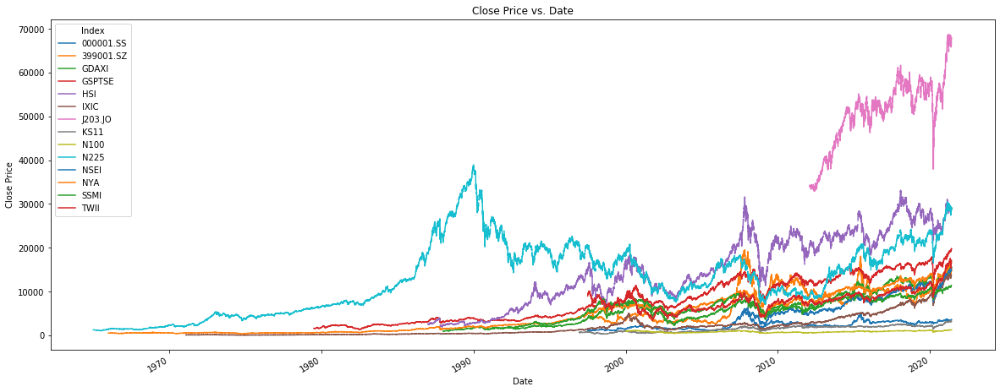

<Figure size 1440x576 with 0 Axes>

In [45]:
#df = df.set_index('Date')
pivot_df = df.pivot_table(values='Close', index='Date', columns='Index')
#print(pivot_df.head(100))

# Graph close amount per index over time (pre-interpolation)
fig, ax = plt.subplots(nrows=1, ncols=1)
plt.rcParams["figure.figsize"] = (20,8);
fig = plt.figure();
ax.legend(loc = "upper left");
ax.set_title("Close Price vs. Date")
ax.set_ylabel("Close Price")
pivot_df.plot(ax=ax);

# Graph close amount per index over time (post-interpolation)

## Data Cleansing

# Method 1: predict the closing prices of all 14 indexes on a day

# Method 2: predict the closing prices of 1 stock on a day

## Data loading for experiment

In [2]:
data_perc = 1.0

#labeled_dataset = CreditCardFraudDataset(filepath, data_perc)

dataset = 'Stocks'

if dataset is 'Stocks':
    label_type = 'discrete'
    filepath = 'data/transformed_indexData.csv'
    label_name = 'Close'
    train_dataset = StocksDataset(filepath, data_perc, label_name=label_name)
    test_dataset = StocksDataset(filepath, data_perc, label_name=label_name)
    num_classes = 2
    #loss_func = F.mean_squared_error
    bl_loss_func = mean_squared_error

# Load data into pandas, find average of each column
mean = train_dataset.mean()
feature_mean = mean.drop(label_name).to_numpy()

# Data loading params
batch_size = 10
shuffle = True
random_seed = 32
train_ratio = 0.7
data_size = len(train_dataset)

train_size = int(np.floor(data_size * train_ratio))

indices = list(range(data_size))

if shuffle:
    np.random.seed(random_seed)
    np.random.shuffle(indices)
    
train_indices, test_indices = indices[:train_size], indices[train_size:]

print(len(train_indices))
print(len(test_indices))
print(len(train_dataset))
print(len(test_dataset))

train_sampler = SubsetRandomSampler(train_indices)

test_sampler = SubsetRandomSampler(test_indices)

# Create dataloaders
train_loader = torch.utils.data.DataLoader(train_dataset, 
                                           batch_size=batch_size, 
                                           sampler=train_sampler)
test_loader = torch.utils.data.DataLoader(test_dataset, 
                                           batch_size=batch_size, 
                                           sampler=test_sampler)

print(next(iter(train_loader)))

       Date     Close   Close_7  Close_30  Index
0 -2.671422 -0.794310 -0.794218 -0.794836     11
1 -2.671221 -0.794728 -0.794152 -0.792760     11
2 -2.671020 -0.795198 -0.794104 -0.794050     11
3 -2.670819 -0.794939 -0.794163 -0.795001     11
4 -2.670618 -0.794869 -0.794187 -0.794931     11
Date        float64
Close       float64
Close_7     float64
Close_30    float64
Index          int8
dtype: object
[11  5  4  0  3  1 10  2  7 12 13  6  9  8]
Date        0
Close       3
Close_7     0
Close_30    0
Index       0
dtype: int64
161378
Date        0
Close       0
Close_7     0
Close_30    0
Index       0
dtype: int64
161375
       Date     Close   Close_7  Close_30  Index
0 -2.671422 -0.794310 -0.794218 -0.794836     11
1 -2.671221 -0.794728 -0.794152 -0.792760     11
2 -2.671020 -0.795198 -0.794104 -0.794050     11
3 -2.670819 -0.794939 -0.794163 -0.795001     11
4 -2.670618 -0.794869 -0.794187 -0.794931     11
Date        float64
Close       float64
Close_7     float64
Close_30    fl

# Experiments

### Parameters

In [11]:
epochs = 20
epoch_list = list(range(1, epochs+1))

n_feature = train_dataset[0][0].size()[1]

n_classes = 1

wdecay = 5e-4
lr = 0.03
nesterov = True
no_decay = ['bias', 'bn']

loss_func = F.mse_loss

## Baseline Experiment

In [8]:
def train_baseline(model, train_loader, test_loader, loss_func, epochs=10):
    train_loss_list = []
    test_loss_list = []
    
    for epoch in range(epochs):
        #losses_train = AverageMeter()
        #losses_test = AverageMeter()

        progress_bar = tqdm(enumerate(train_loader))
        
        y_true_train = []
        y_pred_train = []

        try:
            for batch_index, (features, targets) in enumerate(train_loader):
                try:
                    features = features.squeeze().data.detach().numpy()
                    targets = targets.squeeze().data.detach().numpy()

                    model.fit(features, targets)

                    pred = model.predict(features)

                    y_true_train = np.hstack((y_true_train, targets))
                    y_pred_train = np.hstack((y_pred_train, pred))

                except RuntimeError as error:
                    print('RuntimeError: {}'.format(error))
        except KeyError as error:
            print('KeyError: {}'.format(error))
            print(batch_index)
            print(features)
            print(targets)
                
        train_loss = loss_func(y_true_train, y_pred_train)
        
        y_true_test = []
        y_pred_test = []
        
        print('Epoch: {}'.format(epoch))
        
        for batch_index, (features, targets) in enumerate(test_loader):
            try:
                features = features.squeeze().data.detach().numpy()
                targets = targets.squeeze().data.detach().numpy()
                
                if len(features.shape) == 1:
                    features = np.expand_dims(features, axis=0)
                    targets = np.expand_dims(targets, axis=0)

                pred = model.predict(features)
                
                y_true_test = np.hstack((y_true_test, targets)).astype(float)
                y_pred_test = np.hstack((y_pred_test, pred)).astype(float)

            except ValueError as error:
                print('ValueError: {}'.format(error))
                print(batch_index)
                print(features)
                print(targets)
        try:
            test_loss = loss_func(y_true_test, y_pred_test)
        except ValueError as error:
            print(y_true_test)
            print(y_pred_test)

        train_loss_list.append(train_loss)
        test_loss_list.append(test_loss)
        
    return train_loss_list, test_loss_list 

Train Epoch: 10/  10. Loss: 0.4668.: : 0it [18:36:01, ?it/s]


Error in dataloader
Epoch: 0
Error in dataloader
Error in dataloader



0it [36:38, ?it/s]


Error in dataloader
Epoch: 1
Error in dataloader
Error in dataloader


0it [35:41, ?it/s]


Error in dataloader
Epoch: 2
Error in dataloader
Error in dataloader



0it [36:24, ?it/s]


Error in dataloader
Epoch: 3
Error in dataloader
Error in dataloader


0it [42:14, ?it/s]


Error in dataloader
Epoch: 4
Error in dataloader
Error in dataloader



0it [34:28, ?it/s]


Error in dataloader
Epoch: 5
Error in dataloader
Error in dataloader


0it [33:42, ?it/s]


Error in dataloader
Epoch: 6
Error in dataloader
Error in dataloader



0it [34:03, ?it/s]


Error in dataloader
Epoch: 7
Error in dataloader
Error in dataloader


0it [33:49, ?it/s]


Error in dataloader
Epoch: 8
Error in dataloader
Error in dataloader



0it [56:56, ?it/s]


Error in dataloader
Epoch: 9
Error in dataloader
Error in dataloader


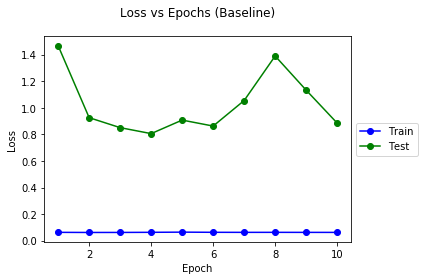

In [9]:
baseline_model = RandomForestRegressor(max_depth=2, random_state=0)

baseline_train_loss_list, baseline_test_loss_list = train_baseline(baseline_model, train_loader, test_loader, bl_loss_func, epochs=10)

plot_multi_curves(epoch_list, [baseline_train_loss_list, baseline_test_loss_list], 'Epoch', 'Loss', ['Train', 'Test'], 'Loss vs Epochs (Baseline)')


## Simple Neural Network

In [12]:
def train_supervised(model, train_loader, test_loader, opt, loss_func, epochs=10):
    train_loss_list = []
    test_loss_list = []
    
    for epoch in range(epochs):
        losses = AverageMeter()

        progress_bar = tqdm(enumerate(train_loader))
        
        for batch_index, (features, targets) in enumerate(train_loader):
            #if features is None or target
            
            try:
                features = features.to(device)
                targets = targets.to(device)

                pred = model(features)
                
                pred = pred.squeeze()
                
#                 print(targets)
#                 print(pred)

                loss = loss_func(pred, targets)

                losses.update(loss)

                # Update progress bar
                progress_bar.set_description("Train Epoch: {epoch}/{epochs:4}. Loss: {loss:.4f}.".format(
                            epoch=epoch + 1,
                            epochs=epochs,
                            batch=batch_index + 1,
                            loss=losses.avg))

                opt.zero_grad()
                loss.backward()
                opt.step()

            except RuntimeError as error:
                print('RuntimeError: {}'.format(error))
                traceback.print_exc()
        
        test_loss = test(test_loader, model, loss_func, epoch)
        
        train_loss_list.append(losses.avg.detach().numpy())
        test_loss_list.append(test_loss.data.detach().numpy())
        
        
    return train_loss_list, test_loss_list 

In [13]:
def test(test_loader, model, loss_func, epoch):
    losses = AverageMeter()
    
    test_loader = tqdm(test_loader)
    
    with torch.no_grad():
        for batch_index, (features, targets) in enumerate(test_loader):
            try:
                features = features.to(device)
                targets = targets.to(device)

                targets = targets.squeeze()

                pred = model(features)
                
                pred = pred.squeeze()

                loss = loss_func(pred, targets)

                losses.update(loss)

                test_loader.set_description("Test Iter: {batch:4}/{iter:4}. Loss: {loss:.4f}.".format(
                    batch=batch_index + 1,
                    iter=len(test_loader),
                    loss=losses.avg))
            except IndexError as error:
                print('IndexError: {}'.format(error))
                print(traceback.format_exc())
                print(batch_index)
                print(features)
                print(targets)
    return losses.avg

In [14]:
supervised_model = SimpleNetwork(n_feature=n_feature,
                                 n_hidden=5,
                                 n_classes=n_classes)

grouped_parameters = [
        {'params': [p for n, p in supervised_model.named_parameters() if not any(
            nd in n for nd in no_decay)], 'weight_decay': wdecay},
        {'params': [p for n, p in supervised_model.named_parameters() if any(
            nd in n for nd in no_decay)], 'weight_decay': 0.0}
]

# opt_supervised = optim.SGD(grouped_parameters, lr=lr,
#                           momentum=0.9, nesterov=nesterov)

opt_supervised = torch.optim.SGD(supervised_model.parameters(), lr = 0.00001)

supervised_train_loss_list, supervised_test_loss_list = train_supervised(supervised_model, train_loader, test_loader, opt_supervised, loss_func, epochs=epochs)

Train Epoch: 10/  10. Loss: 0.7169.: : 0it [358:33:44, ?it/s]
Train Epoch: 1/  20. Loss: 0.8383.: : 0it [00:16, ?it/s]

Error in dataloader


Train Epoch: 1/  20. Loss: 0.4701.: : 0it [01:41, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1958.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1958.:   0%|          | 1/4842 [00:00<16:02,  5.03it/s]

Test Iter:    2/4842. Loss: 0.2070.:   0%|          | 1/4842 [00:00<16:02,  5.03it/s]

Test Iter:    3/4842. Loss: 0.2661.:   0%|          | 1/4842 [00:00<16:02,  5.03it/s]

Test Iter:    3/4842. Loss: 0.2661.:   0%|          | 3/4842 [00:00<07:51, 10.25it/s]

Test Iter:    4/4842. Loss: 0.2470.:   0%|          | 3/4842 [00:00<07:51, 10.25it/s]

Test Iter:    5/4842. Loss: 0.2360.:   0%|          | 3/4842 [00:00<07:51, 10.25it/s]

Test Iter:    6/4842. Loss: 0.2276.:   0%|          | 3/4842 [00:00<07:51, 10.25it/s]

Test Iter:    7/4842. Loss: 0.2173.:   0%|          | 3/4842 [00:00<07:51, 10.25it/s]

Test Iter:    7/4842. Loss: 0.2173.:   0%|          | 7/4842 [00:00<04:05, 19.73it/s]

Test Iter:    8/4842. Loss: 0.2156.:  

Test Iter:   75/4842. Loss: 0.2799.:   1%|▏         | 70/4842 [00:01<01:05, 72.87it/s]

Test Iter:   76/4842. Loss: 0.2781.:   1%|▏         | 70/4842 [00:01<01:05, 72.87it/s]

Test Iter:   77/4842. Loss: 0.2765.:   1%|▏         | 70/4842 [00:01<01:05, 72.87it/s]

Test Iter:   78/4842. Loss: 0.2746.:   1%|▏         | 70/4842 [00:01<01:05, 72.87it/s]

Test Iter:   79/4842. Loss: 0.2727.:   1%|▏         | 70/4842 [00:01<01:05, 72.87it/s]

Test Iter:   79/4842. Loss: 0.2727.:   2%|▏         | 79/4842 [00:01<01:01, 77.32it/s]

Test Iter:   80/4842. Loss: 0.2717.:   2%|▏         | 79/4842 [00:01<01:01, 77.32it/s]

Test Iter:   81/4842. Loss: 0.2744.:   2%|▏         | 79/4842 [00:01<01:01, 77.32it/s]

Test Iter:   82/4842. Loss: 0.2741.:   2%|▏         | 79/4842 [00:01<01:01, 77.32it/s]

Test Iter:   83/4842. Loss: 0.2728.:   2%|▏         | 79/4842 [00:01<01:01, 77.32it/s]

Test Iter:   84/4842. Loss: 0.2719.:   2%|▏         | 79/4842 [00:01<01:01, 77.32it/s]

Test Iter:   85/4842. Loss: 0.28

Test Iter:  153/4842. Loss: 0.2889.:   3%|▎         | 148/4842 [00:02<00:51, 91.30it/s]

Test Iter:  154/4842. Loss: 0.2891.:   3%|▎         | 148/4842 [00:02<00:51, 91.30it/s]

Test Iter:  155/4842. Loss: 0.2885.:   3%|▎         | 148/4842 [00:02<00:51, 91.30it/s]

Test Iter:  156/4842. Loss: 0.2874.:   3%|▎         | 148/4842 [00:02<00:51, 91.30it/s]

Test Iter:  157/4842. Loss: 0.2870.:   3%|▎         | 148/4842 [00:02<00:51, 91.30it/s]

Test Iter:  158/4842. Loss: 0.2877.:   3%|▎         | 148/4842 [00:02<00:51, 91.30it/s]

Test Iter:  158/4842. Loss: 0.2877.:   3%|▎         | 158/4842 [00:02<00:50, 92.16it/s]

Test Iter:  159/4842. Loss: 0.2873.:   3%|▎         | 158/4842 [00:02<00:50, 92.16it/s]

Test Iter:  160/4842. Loss: 0.2872.:   3%|▎         | 158/4842 [00:02<00:50, 92.16it/s]

Test Iter:  161/4842. Loss: 0.2875.:   3%|▎         | 158/4842 [00:02<00:50, 92.16it/s]

Test Iter:  162/4842. Loss: 0.2874.:   3%|▎         | 158/4842 [00:02<00:50, 92.16it/s]

Test Iter:  163/4842.

Error in dataloader




Test Iter:  186/4842. Loss: 0.2942.:   4%|▎         | 178/4842 [00:02<00:49, 93.93it/s]

Test Iter:  187/4842. Loss: 0.2949.:   4%|▎         | 178/4842 [00:02<00:49, 93.93it/s]

Test Iter:  188/4842. Loss: 0.2958.:   4%|▎         | 178/4842 [00:02<00:49, 93.93it/s]

Test Iter:  188/4842. Loss: 0.2958.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  189/4842. Loss: 0.2952.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  190/4842. Loss: 0.2984.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  191/4842. Loss: 0.2977.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  192/4842. Loss: 0.2972.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  193/4842. Loss: 0.2987.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  194/4842. Loss: 0.2979.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  195/4842. Loss: 0.2972.:   4%|▍         | 188/4842 [00:02<00:49, 94.20it/s]

Test Iter:  196/484

Test Iter:  264/4842. Loss: 0.3005.:   5%|▌         | 258/4842 [00:03<00:47, 95.61it/s]

Test Iter:  265/4842. Loss: 0.3002.:   5%|▌         | 258/4842 [00:03<00:47, 95.61it/s]

Test Iter:  266/4842. Loss: 0.3019.:   5%|▌         | 258/4842 [00:03<00:47, 95.61it/s]

Test Iter:  267/4842. Loss: 0.3018.:   5%|▌         | 258/4842 [00:03<00:47, 95.61it/s]

Test Iter:  268/4842. Loss: 0.3016.:   5%|▌         | 258/4842 [00:03<00:47, 95.61it/s]

Test Iter:  268/4842. Loss: 0.3016.:   6%|▌         | 268/4842 [00:03<00:47, 95.81it/s]

Test Iter:  269/4842. Loss: 0.3010.:   6%|▌         | 268/4842 [00:03<00:47, 95.81it/s]

Test Iter:  270/4842. Loss: 0.3018.:   6%|▌         | 268/4842 [00:03<00:47, 95.81it/s]

Test Iter:  271/4842. Loss: 0.3012.:   6%|▌         | 268/4842 [00:03<00:47, 95.81it/s]

Test Iter:  272/4842. Loss: 0.3049.:   6%|▌         | 268/4842 [00:03<00:47, 95.81it/s]

Test Iter:  273/4842. Loss: 0.3044.:   6%|▌         | 268/4842 [00:03<00:47, 95.81it/s]

Test Iter:  274/4842.

Test Iter:  342/4842. Loss: 0.3048.:   7%|▋         | 338/4842 [00:04<00:47, 95.58it/s]

Test Iter:  343/4842. Loss: 0.3054.:   7%|▋         | 338/4842 [00:04<00:47, 95.58it/s]

Test Iter:  344/4842. Loss: 0.3052.:   7%|▋         | 338/4842 [00:04<00:47, 95.58it/s]

Test Iter:  345/4842. Loss: 0.3047.:   7%|▋         | 338/4842 [00:04<00:47, 95.58it/s]

Test Iter:  346/4842. Loss: 0.3072.:   7%|▋         | 338/4842 [00:04<00:47, 95.58it/s]

Test Iter:  347/4842. Loss: 0.3067.:   7%|▋         | 338/4842 [00:04<00:47, 95.58it/s]

Test Iter:  348/4842. Loss: 0.3090.:   7%|▋         | 338/4842 [00:04<00:47, 95.58it/s]

Test Iter:  348/4842. Loss: 0.3090.:   7%|▋         | 348/4842 [00:04<00:47, 95.49it/s]

Test Iter:  349/4842. Loss: 0.3085.:   7%|▋         | 348/4842 [00:04<00:47, 95.49it/s]

Test Iter:  350/4842. Loss: 0.3080.:   7%|▋         | 348/4842 [00:04<00:47, 95.49it/s]

Test Iter:  351/4842. Loss: 0.3079.:   7%|▋         | 348/4842 [00:04<00:47, 95.49it/s]

Test Iter:  352/4842.

Test Iter:  420/4842. Loss: 0.3030.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  421/4842. Loss: 0.3032.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  422/4842. Loss: 0.3030.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  423/4842. Loss: 0.3026.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  424/4842. Loss: 0.3022.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  425/4842. Loss: 0.3020.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  426/4842. Loss: 0.3018.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  427/4842. Loss: 0.3022.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  428/4842. Loss: 0.3019.:   9%|▊         | 418/4842 [00:05<00:46, 95.95it/s]

Test Iter:  428/4842. Loss: 0.3019.:   9%|▉         | 428/4842 [00:05<00:45, 95.98it/s]

Test Iter:  429/4842. Loss: 0.3017.:   9%|▉         | 428/4842 [00:05<00:45, 95.98it/s]

Test Iter:  430/4842.

Test Iter:  498/4842. Loss: 0.3028.:  10%|█         | 498/4842 [00:05<00:45, 95.23it/s]

Test Iter:  499/4842. Loss: 0.3026.:  10%|█         | 498/4842 [00:05<00:45, 95.23it/s]

Test Iter:  500/4842. Loss: 0.3025.:  10%|█         | 498/4842 [00:05<00:45, 95.23it/s]

Test Iter:  501/4842. Loss: 0.3024.:  10%|█         | 498/4842 [00:05<00:45, 95.23it/s]

Test Iter:  502/4842. Loss: 0.3023.:  10%|█         | 498/4842 [00:05<00:45, 95.23it/s]

Test Iter:  503/4842. Loss: 0.3021.:  10%|█         | 498/4842 [00:06<00:45, 95.23it/s]

Test Iter:  504/4842. Loss: 0.3018.:  10%|█         | 498/4842 [00:06<00:45, 95.23it/s]

Test Iter:  505/4842. Loss: 0.3017.:  10%|█         | 498/4842 [00:06<00:45, 95.23it/s]

Test Iter:  506/4842. Loss: 0.3013.:  10%|█         | 498/4842 [00:06<00:45, 95.23it/s]

Test Iter:  507/4842. Loss: 0.3013.:  10%|█         | 498/4842 [00:06<00:45, 95.23it/s]

Test Iter:  508/4842. Loss: 0.3012.:  10%|█         | 498/4842 [00:06<00:45, 95.23it/s]

Test Iter:  508/4842.

Test Iter:  577/4842. Loss: 0.3104.:  12%|█▏        | 568/4842 [00:06<00:44, 96.17it/s]

Test Iter:  578/4842. Loss: 0.3103.:  12%|█▏        | 568/4842 [00:06<00:44, 96.17it/s]

Test Iter:  578/4842. Loss: 0.3103.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  579/4842. Loss: 0.3101.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  580/4842. Loss: 0.3103.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  581/4842. Loss: 0.3101.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  582/4842. Loss: 0.3098.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  583/4842. Loss: 0.3099.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  584/4842. Loss: 0.3098.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  585/4842. Loss: 0.3095.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  586/4842. Loss: 0.3096.:  12%|█▏        | 578/4842 [00:06<00:44, 95.97it/s]

Test Iter:  587/4842.

Test Iter:  655/4842. Loss: 0.3145.:  13%|█▎        | 648/4842 [00:07<00:43, 95.39it/s]

Test Iter:  656/4842. Loss: 0.3143.:  13%|█▎        | 648/4842 [00:07<00:43, 95.39it/s]

Test Iter:  657/4842. Loss: 0.3144.:  13%|█▎        | 648/4842 [00:07<00:43, 95.39it/s]

Test Iter:  658/4842. Loss: 0.3143.:  13%|█▎        | 648/4842 [00:07<00:43, 95.39it/s]

Test Iter:  658/4842. Loss: 0.3143.:  14%|█▎        | 658/4842 [00:07<00:43, 95.50it/s]

Test Iter:  659/4842. Loss: 0.3142.:  14%|█▎        | 658/4842 [00:07<00:43, 95.50it/s]

Test Iter:  660/4842. Loss: 0.3144.:  14%|█▎        | 658/4842 [00:07<00:43, 95.50it/s]

Test Iter:  661/4842. Loss: 0.3143.:  14%|█▎        | 658/4842 [00:07<00:43, 95.50it/s]

Test Iter:  662/4842. Loss: 0.3143.:  14%|█▎        | 658/4842 [00:07<00:43, 95.50it/s]

Test Iter:  663/4842. Loss: 0.3142.:  14%|█▎        | 658/4842 [00:07<00:43, 95.50it/s]

Test Iter:  664/4842. Loss: 0.3140.:  14%|█▎        | 658/4842 [00:07<00:43, 95.50it/s]

Test Iter:  665/4842.

Test Iter:  733/4842. Loss: 0.3145.:  15%|█▌        | 728/4842 [00:08<00:43, 95.61it/s]

Test Iter:  734/4842. Loss: 0.3143.:  15%|█▌        | 728/4842 [00:08<00:43, 95.61it/s]

Test Iter:  735/4842. Loss: 0.3150.:  15%|█▌        | 728/4842 [00:08<00:43, 95.61it/s]

Test Iter:  736/4842. Loss: 0.3150.:  15%|█▌        | 728/4842 [00:08<00:43, 95.61it/s]

Test Iter:  737/4842. Loss: 0.3149.:  15%|█▌        | 728/4842 [00:08<00:43, 95.61it/s]

Test Iter:  738/4842. Loss: 0.3148.:  15%|█▌        | 728/4842 [00:08<00:43, 95.61it/s]

Test Iter:  738/4842. Loss: 0.3148.:  15%|█▌        | 738/4842 [00:08<00:42, 95.67it/s]

Test Iter:  739/4842. Loss: 0.3147.:  15%|█▌        | 738/4842 [00:08<00:42, 95.67it/s]

Test Iter:  740/4842. Loss: 0.3146.:  15%|█▌        | 738/4842 [00:08<00:42, 95.67it/s]

Test Iter:  741/4842. Loss: 0.3153.:  15%|█▌        | 738/4842 [00:08<00:42, 95.67it/s]

Test Iter:  742/4842. Loss: 0.3153.:  15%|█▌        | 738/4842 [00:08<00:42, 95.67it/s]

Test Iter:  743/4842.

Test Iter:  811/4842. Loss: 0.3200.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  812/4842. Loss: 0.3206.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  813/4842. Loss: 0.3205.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  814/4842. Loss: 0.3205.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  815/4842. Loss: 0.3207.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  816/4842. Loss: 0.3206.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  817/4842. Loss: 0.3203.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  818/4842. Loss: 0.3203.:  17%|█▋        | 808/4842 [00:09<00:42, 95.92it/s]

Test Iter:  818/4842. Loss: 0.3203.:  17%|█▋        | 818/4842 [00:09<00:41, 96.02it/s]

Test Iter:  819/4842. Loss: 0.3210.:  17%|█▋        | 818/4842 [00:09<00:41, 96.02it/s]

Test Iter:  820/4842. Loss: 0.3209.:  17%|█▋        | 818/4842 [00:09<00:41, 96.02it/s]

Test Iter:  821/4842.

Test Iter:  889/4842. Loss: 0.3176.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  890/4842. Loss: 0.3174.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  891/4842. Loss: 0.3171.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  892/4842. Loss: 0.3170.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  893/4842. Loss: 0.3169.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  894/4842. Loss: 0.3171.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  895/4842. Loss: 0.3171.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  896/4842. Loss: 0.3170.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  897/4842. Loss: 0.3170.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  898/4842. Loss: 0.3168.:  18%|█▊        | 888/4842 [00:10<00:41, 96.00it/s]

Test Iter:  898/4842. Loss: 0.3168.:  19%|█▊        | 898/4842 [00:10<00:41, 95.64it/s]

Test Iter:  899/4842.

Test Iter:  968/4842. Loss: 0.3154.:  20%|█▉        | 958/4842 [00:10<00:40, 95.58it/s]

Test Iter:  968/4842. Loss: 0.3154.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  969/4842. Loss: 0.3154.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  970/4842. Loss: 0.3153.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  971/4842. Loss: 0.3153.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  972/4842. Loss: 0.3151.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  973/4842. Loss: 0.3150.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  974/4842. Loss: 0.3156.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  975/4842. Loss: 0.3157.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  976/4842. Loss: 0.3154.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  977/4842. Loss: 0.3154.:  20%|█▉        | 968/4842 [00:10<00:40, 95.49it/s]

Test Iter:  978/4842.

Test Iter: 1045/4842. Loss: 0.3117.:  21%|██▏       | 1038/4842 [00:11<00:39, 95.97it/s]

Test Iter: 1046/4842. Loss: 0.3116.:  21%|██▏       | 1038/4842 [00:11<00:39, 95.97it/s]

Test Iter: 1047/4842. Loss: 0.3115.:  21%|██▏       | 1038/4842 [00:11<00:39, 95.97it/s]

Test Iter: 1048/4842. Loss: 0.3113.:  21%|██▏       | 1038/4842 [00:11<00:39, 95.97it/s]

Test Iter: 1048/4842. Loss: 0.3113.:  22%|██▏       | 1048/4842 [00:11<00:39, 95.64it/s]

Test Iter: 1049/4842. Loss: 0.3116.:  22%|██▏       | 1048/4842 [00:11<00:39, 95.64it/s]

Test Iter: 1050/4842. Loss: 0.3116.:  22%|██▏       | 1048/4842 [00:11<00:39, 95.64it/s]

Test Iter: 1051/4842. Loss: 0.3115.:  22%|██▏       | 1048/4842 [00:11<00:39, 95.64it/s]

Test Iter: 1052/4842. Loss: 0.3114.:  22%|██▏       | 1048/4842 [00:11<00:39, 95.64it/s]

Test Iter: 1053/4842. Loss: 0.3113.:  22%|██▏       | 1048/4842 [00:11<00:39, 95.64it/s]

Test Iter: 1054/4842. Loss: 0.3114.:  22%|██▏       | 1048/4842 [00:11<00:39, 95.64it/s]

Test Iter:

Test Iter: 1122/4842. Loss: 0.3135.:  23%|██▎       | 1118/4842 [00:12<00:38, 95.56it/s]

Test Iter: 1123/4842. Loss: 0.3133.:  23%|██▎       | 1118/4842 [00:12<00:38, 95.56it/s]

Test Iter: 1124/4842. Loss: 0.3132.:  23%|██▎       | 1118/4842 [00:12<00:38, 95.56it/s]

Test Iter: 1125/4842. Loss: 0.3133.:  23%|██▎       | 1118/4842 [00:12<00:38, 95.56it/s]

Test Iter: 1126/4842. Loss: 0.3154.:  23%|██▎       | 1118/4842 [00:12<00:38, 95.56it/s]

Test Iter: 1127/4842. Loss: 0.3153.:  23%|██▎       | 1118/4842 [00:12<00:38, 95.56it/s]

Test Iter: 1128/4842. Loss: 0.3153.:  23%|██▎       | 1118/4842 [00:12<00:38, 95.56it/s]

Test Iter: 1128/4842. Loss: 0.3153.:  23%|██▎       | 1128/4842 [00:12<00:39, 92.95it/s]

Test Iter: 1129/4842. Loss: 0.3153.:  23%|██▎       | 1128/4842 [00:12<00:39, 92.95it/s]

Test Iter: 1130/4842. Loss: 0.3153.:  23%|██▎       | 1128/4842 [00:12<00:39, 92.95it/s]

Test Iter: 1131/4842. Loss: 0.3152.:  23%|██▎       | 1128/4842 [00:12<00:39, 92.95it/s]

Test Iter:

Test Iter: 1199/4842. Loss: 0.3149.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1200/4842. Loss: 0.3149.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1201/4842. Loss: 0.3149.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1202/4842. Loss: 0.3151.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1203/4842. Loss: 0.3151.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1204/4842. Loss: 0.3153.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1205/4842. Loss: 0.3152.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1206/4842. Loss: 0.3152.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1207/4842. Loss: 0.3156.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1208/4842. Loss: 0.3155.:  25%|██▍       | 1198/4842 [00:13<00:38, 95.44it/s]

Test Iter: 1208/4842. Loss: 0.3155.:  25%|██▍       | 1208/4842 [00:13<00:38, 94.84it/s]

Test Iter:

Test Iter: 1277/4842. Loss: 0.3135.:  26%|██▌       | 1268/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1278/4842. Loss: 0.3139.:  26%|██▌       | 1268/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1278/4842. Loss: 0.3139.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1279/4842. Loss: 0.3137.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1280/4842. Loss: 0.3136.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1281/4842. Loss: 0.3139.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1282/4842. Loss: 0.3140.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1283/4842. Loss: 0.3138.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1284/4842. Loss: 0.3137.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1285/4842. Loss: 0.3137.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter: 1286/4842. Loss: 0.3135.:  26%|██▋       | 1278/4842 [00:14<00:37, 95.11it/s]

Test Iter:

Test Iter: 1354/4842. Loss: 0.3131.:  28%|██▊       | 1348/4842 [00:14<00:37, 92.87it/s]

Test Iter: 1355/4842. Loss: 0.3131.:  28%|██▊       | 1348/4842 [00:14<00:37, 92.87it/s]

Test Iter: 1356/4842. Loss: 0.3130.:  28%|██▊       | 1348/4842 [00:14<00:37, 92.87it/s]

Test Iter: 1357/4842. Loss: 0.3129.:  28%|██▊       | 1348/4842 [00:14<00:37, 92.87it/s]

Test Iter: 1358/4842. Loss: 0.3128.:  28%|██▊       | 1348/4842 [00:14<00:37, 92.87it/s]

Test Iter: 1358/4842. Loss: 0.3128.:  28%|██▊       | 1358/4842 [00:14<00:37, 93.49it/s]

Test Iter: 1359/4842. Loss: 0.3128.:  28%|██▊       | 1358/4842 [00:14<00:37, 93.49it/s]

Test Iter: 1360/4842. Loss: 0.3127.:  28%|██▊       | 1358/4842 [00:15<00:37, 93.49it/s]

Test Iter: 1361/4842. Loss: 0.3126.:  28%|██▊       | 1358/4842 [00:15<00:37, 93.49it/s]

Test Iter: 1362/4842. Loss: 0.3128.:  28%|██▊       | 1358/4842 [00:15<00:37, 93.49it/s]

Test Iter: 1363/4842. Loss: 0.3128.:  28%|██▊       | 1358/4842 [00:15<00:37, 93.49it/s]

Test Iter:

Test Iter: 1431/4842. Loss: 0.3125.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Test Iter: 1432/4842. Loss: 0.3124.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Test Iter: 1433/4842. Loss: 0.3125.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Test Iter: 1434/4842. Loss: 0.3125.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Error in dataloader




Test Iter: 1435/4842. Loss: 0.3124.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Test Iter: 1436/4842. Loss: 0.3124.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Test Iter: 1437/4842. Loss: 0.3125.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Test Iter: 1438/4842. Loss: 0.3123.:  29%|██▉       | 1428/4842 [00:15<00:36, 93.39it/s]

Test Iter: 1438/4842. Loss: 0.3123.:  30%|██▉       | 1438/4842 [00:15<00:36, 93.36it/s]

Test Iter: 1439/4842. Loss: 0.3122.:  30%|██▉       | 1438/4842 [00:15<00:36, 93.36it/s]

Test Iter: 1440/4842. Loss: 0.3124.:  30%|██▉       | 1438/4842 [00:15<00:36, 93.36it/s]

Test Iter: 1441/4842. Loss: 0.3123.:  30%|██▉       | 1438/4842 [00:15<00:36, 93.36it/s]

Test Iter: 1442/4842. Loss: 0.3123.:  30%|██▉       | 1438/4842 [00:15<00:36, 93.36it/s]

Test Iter: 1443/4842. Loss: 0.3123.:  30%|██▉       | 1438/4842 [00:15<00:36, 93.36it/s]

Test Iter: 1444/4842. Loss: 0.3122.:  30%|██▉       | 1438/4842 [00:15<00:36, 93.36it/s]

Test Ite

Test Iter: 1512/4842. Loss: 0.3127.:  31%|███       | 1508/4842 [00:16<00:34, 95.87it/s]

Test Iter: 1513/4842. Loss: 0.3127.:  31%|███       | 1508/4842 [00:16<00:34, 95.87it/s]

Test Iter: 1514/4842. Loss: 0.3126.:  31%|███       | 1508/4842 [00:16<00:34, 95.87it/s]

Test Iter: 1515/4842. Loss: 0.3126.:  31%|███       | 1508/4842 [00:16<00:34, 95.87it/s]

Test Iter: 1516/4842. Loss: 0.3126.:  31%|███       | 1508/4842 [00:16<00:34, 95.87it/s]

Test Iter: 1517/4842. Loss: 0.3125.:  31%|███       | 1508/4842 [00:16<00:34, 95.87it/s]

Test Iter: 1518/4842. Loss: 0.3123.:  31%|███       | 1508/4842 [00:16<00:34, 95.87it/s]

Test Iter: 1518/4842. Loss: 0.3123.:  31%|███▏      | 1518/4842 [00:16<00:34, 96.13it/s]

Test Iter: 1519/4842. Loss: 0.3123.:  31%|███▏      | 1518/4842 [00:16<00:34, 96.13it/s]

Test Iter: 1520/4842. Loss: 0.3121.:  31%|███▏      | 1518/4842 [00:16<00:34, 96.13it/s]

Test Iter: 1521/4842. Loss: 0.3121.:  31%|███▏      | 1518/4842 [00:16<00:34, 96.13it/s]

Test Iter:

Test Iter: 1589/4842. Loss: 0.3125.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1590/4842. Loss: 0.3123.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1591/4842. Loss: 0.3124.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1592/4842. Loss: 0.3126.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1593/4842. Loss: 0.3127.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1594/4842. Loss: 0.3126.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1595/4842. Loss: 0.3126.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1596/4842. Loss: 0.3125.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1597/4842. Loss: 0.3125.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1598/4842. Loss: 0.3124.:  33%|███▎      | 1588/4842 [00:17<00:34, 94.93it/s]

Test Iter: 1598/4842. Loss: 0.3124.:  33%|███▎      | 1598/4842 [00:17<00:34, 95.31it/s]

Test Iter:

Test Iter: 1667/4842. Loss: 0.3138.:  34%|███▍      | 1658/4842 [00:18<00:33, 94.44it/s]

Test Iter: 1668/4842. Loss: 0.3137.:  34%|███▍      | 1658/4842 [00:18<00:33, 94.44it/s]

Test Iter: 1668/4842. Loss: 0.3137.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1669/4842. Loss: 0.3136.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1670/4842. Loss: 0.3135.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1671/4842. Loss: 0.3134.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1672/4842. Loss: 0.3136.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1673/4842. Loss: 0.3136.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1674/4842. Loss: 0.3137.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1675/4842. Loss: 0.3137.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter: 1676/4842. Loss: 0.3136.:  34%|███▍      | 1668/4842 [00:18<00:33, 94.70it/s]

Test Iter:

Test Iter: 1744/4842. Loss: 0.3150.:  36%|███▌      | 1738/4842 [00:19<00:32, 95.51it/s]

Test Iter: 1745/4842. Loss: 0.3150.:  36%|███▌      | 1738/4842 [00:19<00:32, 95.51it/s]

Test Iter: 1746/4842. Loss: 0.3149.:  36%|███▌      | 1738/4842 [00:19<00:32, 95.51it/s]

Test Iter: 1747/4842. Loss: 0.3149.:  36%|███▌      | 1738/4842 [00:19<00:32, 95.51it/s]

Test Iter: 1748/4842. Loss: 0.3151.:  36%|███▌      | 1738/4842 [00:19<00:32, 95.51it/s]

Test Iter: 1748/4842. Loss: 0.3151.:  36%|███▌      | 1748/4842 [00:19<00:32, 95.54it/s]

Test Iter: 1749/4842. Loss: 0.3155.:  36%|███▌      | 1748/4842 [00:19<00:32, 95.54it/s]

Test Iter: 1750/4842. Loss: 0.3155.:  36%|███▌      | 1748/4842 [00:19<00:32, 95.54it/s]

Test Iter: 1751/4842. Loss: 0.3153.:  36%|███▌      | 1748/4842 [00:19<00:32, 95.54it/s]

Test Iter: 1752/4842. Loss: 0.3155.:  36%|███▌      | 1748/4842 [00:19<00:32, 95.54it/s]

Test Iter: 1753/4842. Loss: 0.3154.:  36%|███▌      | 1748/4842 [00:19<00:32, 95.54it/s]

Test Iter:

Test Iter: 1821/4842. Loss: 0.3168.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1822/4842. Loss: 0.3167.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1823/4842. Loss: 0.3171.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1824/4842. Loss: 0.3170.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1825/4842. Loss: 0.3170.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1826/4842. Loss: 0.3169.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1827/4842. Loss: 0.3169.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1828/4842. Loss: 0.3168.:  38%|███▊      | 1818/4842 [00:19<00:31, 95.98it/s]

Test Iter: 1828/4842. Loss: 0.3168.:  38%|███▊      | 1828/4842 [00:19<00:31, 95.96it/s]

Test Iter: 1829/4842. Loss: 0.3168.:  38%|███▊      | 1828/4842 [00:19<00:31, 95.96it/s]

Test Iter: 1830/4842. Loss: 0.3171.:  38%|███▊      | 1828/4842 [00:19<00:31, 95.96it/s]

Test Iter:

Test Iter: 1898/4842. Loss: 0.3146.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1899/4842. Loss: 0.3145.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1900/4842. Loss: 0.3145.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1901/4842. Loss: 0.3145.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1902/4842. Loss: 0.3144.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1903/4842. Loss: 0.3144.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1904/4842. Loss: 0.3143.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1905/4842. Loss: 0.3143.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1906/4842. Loss: 0.3142.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1907/4842. Loss: 0.3142.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter: 1908/4842. Loss: 0.3141.:  39%|███▉      | 1898/4842 [00:20<00:30, 96.00it/s]

Test Iter:

Test Iter: 1976/4842. Loss: 0.3133.:  41%|████      | 1968/4842 [00:21<00:29, 95.85it/s]

Test Iter: 1977/4842. Loss: 0.3132.:  41%|████      | 1968/4842 [00:21<00:29, 95.85it/s]

Test Iter: 1978/4842. Loss: 0.3131.:  41%|████      | 1968/4842 [00:21<00:29, 95.85it/s]

Test Iter: 1978/4842. Loss: 0.3131.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter: 1979/4842. Loss: 0.3129.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter: 1980/4842. Loss: 0.3130.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter: 1981/4842. Loss: 0.3130.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter: 1982/4842. Loss: 0.3129.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter: 1983/4842. Loss: 0.3128.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter: 1984/4842. Loss: 0.3127.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter: 1985/4842. Loss: 0.3127.:  41%|████      | 1978/4842 [00:21<00:29, 96.22it/s]

Test Iter:

Test Iter: 2053/4842. Loss: 0.3137.:  42%|████▏     | 2048/4842 [00:22<00:29, 95.96it/s]

Test Iter: 2054/4842. Loss: 0.3137.:  42%|████▏     | 2048/4842 [00:22<00:29, 95.96it/s]

Test Iter: 2055/4842. Loss: 0.3136.:  42%|████▏     | 2048/4842 [00:22<00:29, 95.96it/s]

Test Iter: 2056/4842. Loss: 0.3136.:  42%|████▏     | 2048/4842 [00:22<00:29, 95.96it/s]

Test Iter: 2057/4842. Loss: 0.3136.:  42%|████▏     | 2048/4842 [00:22<00:29, 95.96it/s]

Test Iter: 2058/4842. Loss: 0.3136.:  42%|████▏     | 2048/4842 [00:22<00:29, 95.96it/s]

Test Iter: 2058/4842. Loss: 0.3136.:  43%|████▎     | 2058/4842 [00:22<00:29, 95.83it/s]

Test Iter: 2059/4842. Loss: 0.3135.:  43%|████▎     | 2058/4842 [00:22<00:29, 95.83it/s]

Test Iter: 2060/4842. Loss: 0.3135.:  43%|████▎     | 2058/4842 [00:22<00:29, 95.83it/s]

Test Iter: 2061/4842. Loss: 0.3134.:  43%|████▎     | 2058/4842 [00:22<00:29, 95.83it/s]

Test Iter: 2062/4842. Loss: 0.3135.:  43%|████▎     | 2058/4842 [00:22<00:29, 95.83it/s]

Test Iter:

Test Iter: 2130/4842. Loss: 0.3127.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2131/4842. Loss: 0.3127.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2132/4842. Loss: 0.3126.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2133/4842. Loss: 0.3126.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2134/4842. Loss: 0.3127.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2135/4842. Loss: 0.3127.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2136/4842. Loss: 0.3126.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2137/4842. Loss: 0.3126.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2138/4842. Loss: 0.3126.:  44%|████▍     | 2128/4842 [00:23<00:28, 94.31it/s]

Test Iter: 2138/4842. Loss: 0.3126.:  44%|████▍     | 2138/4842 [00:23<00:28, 94.92it/s]

Test Iter: 2139/4842. Loss: 0.3125.:  44%|████▍     | 2138/4842 [00:23<00:28, 94.92it/s]

Test Iter:

Test Iter: 2208/4842. Loss: 0.3123.:  45%|████▌     | 2198/4842 [00:23<00:27, 94.91it/s]

Test Iter: 2208/4842. Loss: 0.3123.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2209/4842. Loss: 0.3123.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2210/4842. Loss: 0.3122.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2211/4842. Loss: 0.3122.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2212/4842. Loss: 0.3121.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2213/4842. Loss: 0.3121.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2214/4842. Loss: 0.3122.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2215/4842. Loss: 0.3121.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2216/4842. Loss: 0.3120.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter: 2217/4842. Loss: 0.3120.:  46%|████▌     | 2208/4842 [00:23<00:27, 94.80it/s]

Test Iter:

Test Iter: 2285/4842. Loss: 0.3113.:  47%|████▋     | 2278/4842 [00:24<00:27, 94.89it/s]

Test Iter: 2286/4842. Loss: 0.3113.:  47%|████▋     | 2278/4842 [00:24<00:27, 94.89it/s]

Test Iter: 2287/4842. Loss: 0.3115.:  47%|████▋     | 2278/4842 [00:24<00:27, 94.89it/s]

Test Iter: 2288/4842. Loss: 0.3115.:  47%|████▋     | 2278/4842 [00:24<00:27, 94.89it/s]

Test Iter: 2288/4842. Loss: 0.3115.:  47%|████▋     | 2288/4842 [00:24<00:26, 95.03it/s]

Test Iter: 2289/4842. Loss: 0.3115.:  47%|████▋     | 2288/4842 [00:24<00:26, 95.03it/s]

Test Iter: 2290/4842. Loss: 0.3115.:  47%|████▋     | 2288/4842 [00:24<00:26, 95.03it/s]

Test Iter: 2291/4842. Loss: 0.3115.:  47%|████▋     | 2288/4842 [00:24<00:26, 95.03it/s]

Test Iter: 2292/4842. Loss: 0.3116.:  47%|████▋     | 2288/4842 [00:24<00:26, 95.03it/s]

Test Iter: 2293/4842. Loss: 0.3117.:  47%|████▋     | 2288/4842 [00:24<00:26, 95.03it/s]

Test Iter: 2294/4842. Loss: 0.3116.:  47%|████▋     | 2288/4842 [00:24<00:26, 95.03it/s]

Test Iter:

Test Iter: 2362/4842. Loss: 0.3099.:  49%|████▊     | 2358/4842 [00:25<00:25, 95.91it/s]

Test Iter: 2363/4842. Loss: 0.3100.:  49%|████▊     | 2358/4842 [00:25<00:25, 95.91it/s]

Test Iter: 2364/4842. Loss: 0.3099.:  49%|████▊     | 2358/4842 [00:25<00:25, 95.91it/s]

Test Iter: 2365/4842. Loss: 0.3099.:  49%|████▊     | 2358/4842 [00:25<00:25, 95.91it/s]

Test Iter: 2366/4842. Loss: 0.3098.:  49%|████▊     | 2358/4842 [00:25<00:25, 95.91it/s]

Test Iter: 2367/4842. Loss: 0.3098.:  49%|████▊     | 2358/4842 [00:25<00:25, 95.91it/s]

Test Iter: 2368/4842. Loss: 0.3097.:  49%|████▊     | 2358/4842 [00:25<00:25, 95.91it/s]

Test Iter: 2368/4842. Loss: 0.3097.:  49%|████▉     | 2368/4842 [00:25<00:25, 95.78it/s]

Test Iter: 2369/4842. Loss: 0.3097.:  49%|████▉     | 2368/4842 [00:25<00:25, 95.78it/s]

Test Iter: 2370/4842. Loss: 0.3096.:  49%|████▉     | 2368/4842 [00:25<00:25, 95.78it/s]

Test Iter: 2371/4842. Loss: 0.3095.:  49%|████▉     | 2368/4842 [00:25<00:25, 95.78it/s]

Test Iter:

Test Iter: 2439/4842. Loss: 0.3093.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2440/4842. Loss: 0.3092.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2441/4842. Loss: 0.3098.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2442/4842. Loss: 0.3098.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2443/4842. Loss: 0.3099.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2444/4842. Loss: 0.3100.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2445/4842. Loss: 0.3099.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2446/4842. Loss: 0.3099.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2447/4842. Loss: 0.3098.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2448/4842. Loss: 0.3098.:  50%|█████     | 2438/4842 [00:26<00:25, 95.00it/s]

Test Iter: 2448/4842. Loss: 0.3098.:  51%|█████     | 2448/4842 [00:26<00:25, 94.67it/s]

Test Iter:

Test Iter: 2517/4842. Loss: 0.3093.:  52%|█████▏    | 2508/4842 [00:27<00:24, 96.11it/s]

Test Iter: 2518/4842. Loss: 0.3093.:  52%|█████▏    | 2508/4842 [00:27<00:24, 96.11it/s]

Test Iter: 2518/4842. Loss: 0.3093.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2519/4842. Loss: 0.3094.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2520/4842. Loss: 0.3094.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2521/4842. Loss: 0.3094.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2522/4842. Loss: 0.3093.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2523/4842. Loss: 0.3092.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2524/4842. Loss: 0.3092.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2525/4842. Loss: 0.3092.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter: 2526/4842. Loss: 0.3091.:  52%|█████▏    | 2518/4842 [00:27<00:24, 96.10it/s]

Test Iter:

Test Iter: 2594/4842. Loss: 0.3097.:  53%|█████▎    | 2588/4842 [00:27<00:24, 93.80it/s]

Test Iter: 2595/4842. Loss: 0.3096.:  53%|█████▎    | 2588/4842 [00:27<00:24, 93.80it/s]

Test Iter: 2596/4842. Loss: 0.3095.:  53%|█████▎    | 2588/4842 [00:27<00:24, 93.80it/s]

Test Iter: 2597/4842. Loss: 0.3096.:  53%|█████▎    | 2588/4842 [00:27<00:24, 93.80it/s]

Test Iter: 2598/4842. Loss: 0.3096.:  53%|█████▎    | 2588/4842 [00:27<00:24, 93.80it/s]

Test Iter: 2598/4842. Loss: 0.3096.:  54%|█████▎    | 2598/4842 [00:27<00:23, 94.39it/s]

Test Iter: 2599/4842. Loss: 0.3095.:  54%|█████▎    | 2598/4842 [00:28<00:23, 94.39it/s]

Test Iter: 2600/4842. Loss: 0.3097.:  54%|█████▎    | 2598/4842 [00:28<00:23, 94.39it/s]

Test Iter: 2601/4842. Loss: 0.3096.:  54%|█████▎    | 2598/4842 [00:28<00:23, 94.39it/s]

Test Iter: 2602/4842. Loss: 0.3096.:  54%|█████▎    | 2598/4842 [00:28<00:23, 94.39it/s]

Test Iter: 2603/4842. Loss: 0.3097.:  54%|█████▎    | 2598/4842 [00:28<00:23, 94.39it/s]

Test Iter:

Test Iter: 2671/4842. Loss: 0.3095.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2672/4842. Loss: 0.3096.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2673/4842. Loss: 0.3097.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2674/4842. Loss: 0.3096.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2675/4842. Loss: 0.3095.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2676/4842. Loss: 0.3095.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2677/4842. Loss: 0.3094.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2678/4842. Loss: 0.3094.:  55%|█████▌    | 2668/4842 [00:28<00:22, 95.82it/s]

Test Iter: 2678/4842. Loss: 0.3094.:  55%|█████▌    | 2678/4842 [00:28<00:23, 93.89it/s]

Test Iter: 2679/4842. Loss: 0.3095.:  55%|█████▌    | 2678/4842 [00:28<00:23, 93.89it/s]

Test Iter: 2680/4842. Loss: 0.3094.:  55%|█████▌    | 2678/4842 [00:28<00:23, 93.89it/s]

Test Iter:

Test Iter: 2748/4842. Loss: 0.3087.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2749/4842. Loss: 0.3094.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2750/4842. Loss: 0.3094.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2751/4842. Loss: 0.3094.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2752/4842. Loss: 0.3093.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2753/4842. Loss: 0.3098.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2754/4842. Loss: 0.3098.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2755/4842. Loss: 0.3097.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2756/4842. Loss: 0.3097.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2757/4842. Loss: 0.3096.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter: 2758/4842. Loss: 0.3097.:  57%|█████▋    | 2748/4842 [00:29<00:21, 95.33it/s]

Test Iter:

Test Iter: 2826/4842. Loss: 0.3093.:  58%|█████▊    | 2818/4842 [00:30<00:21, 95.54it/s]

Test Iter: 2827/4842. Loss: 0.3092.:  58%|█████▊    | 2818/4842 [00:30<00:21, 95.54it/s]

Test Iter: 2828/4842. Loss: 0.3092.:  58%|█████▊    | 2818/4842 [00:30<00:21, 95.54it/s]

Test Iter: 2828/4842. Loss: 0.3092.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter: 2829/4842. Loss: 0.3091.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter: 2830/4842. Loss: 0.3091.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter: 2831/4842. Loss: 0.3090.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter: 2832/4842. Loss: 0.3090.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter: 2833/4842. Loss: 0.3089.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter: 2834/4842. Loss: 0.3090.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter: 2835/4842. Loss: 0.3089.:  58%|█████▊    | 2828/4842 [00:30<00:21, 95.56it/s]

Test Iter:

Test Iter: 2903/4842. Loss: 0.3086.:  60%|█████▉    | 2898/4842 [00:31<00:20, 95.50it/s]

Test Iter: 2904/4842. Loss: 0.3086.:  60%|█████▉    | 2898/4842 [00:31<00:20, 95.50it/s]

Test Iter: 2905/4842. Loss: 0.3086.:  60%|█████▉    | 2898/4842 [00:31<00:20, 95.50it/s]

Test Iter: 2906/4842. Loss: 0.3086.:  60%|█████▉    | 2898/4842 [00:31<00:20, 95.50it/s]

Test Iter: 2907/4842. Loss: 0.3085.:  60%|█████▉    | 2898/4842 [00:31<00:20, 95.50it/s]

Test Iter: 2908/4842. Loss: 0.3085.:  60%|█████▉    | 2898/4842 [00:31<00:20, 95.50it/s]

Test Iter: 2908/4842. Loss: 0.3085.:  60%|██████    | 2908/4842 [00:31<00:20, 95.72it/s]

Test Iter: 2909/4842. Loss: 0.3084.:  60%|██████    | 2908/4842 [00:31<00:20, 95.72it/s]

Test Iter: 2910/4842. Loss: 0.3084.:  60%|██████    | 2908/4842 [00:31<00:20, 95.72it/s]

Test Iter: 2911/4842. Loss: 0.3084.:  60%|██████    | 2908/4842 [00:31<00:20, 95.72it/s]

Test Iter: 2912/4842. Loss: 0.3083.:  60%|██████    | 2908/4842 [00:31<00:20, 95.72it/s]

Test Iter:

Test Iter: 2980/4842. Loss: 0.3086.:  62%|██████▏   | 2978/4842 [00:31<00:19, 93.91it/s]

Test Iter: 2981/4842. Loss: 0.3085.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2982/4842. Loss: 0.3085.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2983/4842. Loss: 0.3084.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2984/4842. Loss: 0.3084.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2985/4842. Loss: 0.3083.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2986/4842. Loss: 0.3086.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2987/4842. Loss: 0.3088.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2988/4842. Loss: 0.3087.:  62%|██████▏   | 2978/4842 [00:32<00:19, 93.91it/s]

Test Iter: 2988/4842. Loss: 0.3087.:  62%|██████▏   | 2988/4842 [00:32<00:20, 92.59it/s]

Test Iter: 2989/4842. Loss: 0.3087.:  62%|██████▏   | 2988/4842 [00:32<00:20, 92.59it/s]

Test Iter:

Test Iter: 3058/4842. Loss: 0.3077.:  63%|██████▎   | 3048/4842 [00:32<00:18, 95.13it/s]

Test Iter: 3058/4842. Loss: 0.3077.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3059/4842. Loss: 0.3077.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3060/4842. Loss: 0.3078.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3061/4842. Loss: 0.3078.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3062/4842. Loss: 0.3078.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3063/4842. Loss: 0.3077.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3064/4842. Loss: 0.3077.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3065/4842. Loss: 0.3077.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3066/4842. Loss: 0.3076.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter: 3067/4842. Loss: 0.3076.:  63%|██████▎   | 3058/4842 [00:32<00:18, 95.27it/s]

Test Iter:

Test Iter: 3135/4842. Loss: 0.3071.:  65%|██████▍   | 3128/4842 [00:33<00:17, 95.42it/s]

Test Iter: 3136/4842. Loss: 0.3071.:  65%|██████▍   | 3128/4842 [00:33<00:17, 95.42it/s]

Test Iter: 3137/4842. Loss: 0.3071.:  65%|██████▍   | 3128/4842 [00:33<00:17, 95.42it/s]

Test Iter: 3138/4842. Loss: 0.3072.:  65%|██████▍   | 3128/4842 [00:33<00:17, 95.42it/s]

Test Iter: 3138/4842. Loss: 0.3072.:  65%|██████▍   | 3138/4842 [00:33<00:17, 95.55it/s]

Test Iter: 3139/4842. Loss: 0.3072.:  65%|██████▍   | 3138/4842 [00:33<00:17, 95.55it/s]

Test Iter: 3140/4842. Loss: 0.3072.:  65%|██████▍   | 3138/4842 [00:33<00:17, 95.55it/s]

Test Iter: 3141/4842. Loss: 0.3071.:  65%|██████▍   | 3138/4842 [00:33<00:17, 95.55it/s]

Test Iter: 3142/4842. Loss: 0.3071.:  65%|██████▍   | 3138/4842 [00:33<00:17, 95.55it/s]

Test Iter: 3143/4842. Loss: 0.3071.:  65%|██████▍   | 3138/4842 [00:33<00:17, 95.55it/s]

Test Iter: 3144/4842. Loss: 0.3071.:  65%|██████▍   | 3138/4842 [00:33<00:17, 95.55it/s]

Test Iter:

Test Iter: 3212/4842. Loss: 0.3071.:  66%|██████▋   | 3208/4842 [00:34<00:17, 95.97it/s]

Test Iter: 3213/4842. Loss: 0.3071.:  66%|██████▋   | 3208/4842 [00:34<00:17, 95.97it/s]

Test Iter: 3214/4842. Loss: 0.3071.:  66%|██████▋   | 3208/4842 [00:34<00:17, 95.97it/s]

Test Iter: 3215/4842. Loss: 0.3071.:  66%|██████▋   | 3208/4842 [00:34<00:17, 95.97it/s]

Test Iter: 3216/4842. Loss: 0.3070.:  66%|██████▋   | 3208/4842 [00:34<00:17, 95.97it/s]

Test Iter: 3217/4842. Loss: 0.3069.:  66%|██████▋   | 3208/4842 [00:34<00:17, 95.97it/s]

Test Iter: 3218/4842. Loss: 0.3069.:  66%|██████▋   | 3208/4842 [00:34<00:17, 95.97it/s]

Test Iter: 3218/4842. Loss: 0.3069.:  66%|██████▋   | 3218/4842 [00:34<00:16, 96.08it/s]

Test Iter: 3219/4842. Loss: 0.3069.:  66%|██████▋   | 3218/4842 [00:34<00:16, 96.08it/s]

Test Iter: 3220/4842. Loss: 0.3069.:  66%|██████▋   | 3218/4842 [00:34<00:16, 96.08it/s]

Test Iter: 3221/4842. Loss: 0.3069.:  66%|██████▋   | 3218/4842 [00:34<00:16, 96.08it/s]

Test Iter:

Test Iter: 3289/4842. Loss: 0.3077.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3290/4842. Loss: 0.3078.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3291/4842. Loss: 0.3078.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3292/4842. Loss: 0.3078.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3293/4842. Loss: 0.3077.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3294/4842. Loss: 0.3078.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3295/4842. Loss: 0.3078.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3296/4842. Loss: 0.3077.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3297/4842. Loss: 0.3078.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3298/4842. Loss: 0.3080.:  68%|██████▊   | 3288/4842 [00:35<00:16, 95.83it/s]

Test Iter: 3298/4842. Loss: 0.3080.:  68%|██████▊   | 3298/4842 [00:35<00:16, 95.87it/s]

Test Iter:

Test Iter: 3367/4842. Loss: 0.3088.:  69%|██████▉   | 3358/4842 [00:36<00:15, 96.23it/s]

Test Iter: 3368/4842. Loss: 0.3094.:  69%|██████▉   | 3358/4842 [00:36<00:15, 96.23it/s]

Test Iter: 3368/4842. Loss: 0.3094.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3369/4842. Loss: 0.3093.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3370/4842. Loss: 0.3093.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3371/4842. Loss: 0.3093.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3372/4842. Loss: 0.3093.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3373/4842. Loss: 0.3093.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3374/4842. Loss: 0.3093.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3375/4842. Loss: 0.3092.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter: 3376/4842. Loss: 0.3092.:  70%|██████▉   | 3368/4842 [00:36<00:15, 92.28it/s]

Test Iter:

Test Iter: 3444/4842. Loss: 0.3094.:  71%|███████   | 3438/4842 [00:36<00:14, 93.93it/s]

Test Iter: 3445/4842. Loss: 0.3093.:  71%|███████   | 3438/4842 [00:36<00:14, 93.93it/s]

Test Iter: 3446/4842. Loss: 0.3093.:  71%|███████   | 3438/4842 [00:36<00:14, 93.93it/s]

Test Iter: 3447/4842. Loss: 0.3093.:  71%|███████   | 3438/4842 [00:36<00:14, 93.93it/s]

Test Iter: 3448/4842. Loss: 0.3104.:  71%|███████   | 3438/4842 [00:36<00:14, 93.93it/s]

Test Iter: 3448/4842. Loss: 0.3104.:  71%|███████   | 3448/4842 [00:36<00:14, 94.24it/s]

Test Iter: 3449/4842. Loss: 0.3104.:  71%|███████   | 3448/4842 [00:36<00:14, 94.24it/s]

Test Iter: 3450/4842. Loss: 0.3104.:  71%|███████   | 3448/4842 [00:36<00:14, 94.24it/s]

Test Iter: 3451/4842. Loss: 0.3103.:  71%|███████   | 3448/4842 [00:36<00:14, 94.24it/s]

Test Iter: 3452/4842. Loss: 0.3103.:  71%|███████   | 3448/4842 [00:36<00:14, 94.24it/s]

Test Iter: 3453/4842. Loss: 0.3103.:  71%|███████   | 3448/4842 [00:36<00:14, 94.24it/s]

Test Iter:

Test Iter: 3521/4842. Loss: 0.3106.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3522/4842. Loss: 0.3106.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3523/4842. Loss: 0.3105.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3524/4842. Loss: 0.3105.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3525/4842. Loss: 0.3105.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3526/4842. Loss: 0.3105.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3527/4842. Loss: 0.3106.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3528/4842. Loss: 0.3106.:  73%|███████▎  | 3518/4842 [00:37<00:13, 95.77it/s]

Test Iter: 3528/4842. Loss: 0.3106.:  73%|███████▎  | 3528/4842 [00:37<00:13, 95.78it/s]

Test Iter: 3529/4842. Loss: 0.3105.:  73%|███████▎  | 3528/4842 [00:37<00:13, 95.78it/s]

Test Iter: 3530/4842. Loss: 0.3106.:  73%|███████▎  | 3528/4842 [00:37<00:13, 95.78it/s]

Test Iter:

Test Iter: 3598/4842. Loss: 0.3107.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3599/4842. Loss: 0.3107.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3600/4842. Loss: 0.3106.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3601/4842. Loss: 0.3106.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3602/4842. Loss: 0.3106.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3603/4842. Loss: 0.3106.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3604/4842. Loss: 0.3105.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3605/4842. Loss: 0.3105.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3606/4842. Loss: 0.3105.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3607/4842. Loss: 0.3105.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter: 3608/4842. Loss: 0.3105.:  74%|███████▍  | 3598/4842 [00:38<00:12, 96.01it/s]

Test Iter:

Test Iter: 3676/4842. Loss: 0.3101.:  76%|███████▌  | 3668/4842 [00:39<00:12, 95.84it/s]

Test Iter: 3677/4842. Loss: 0.3105.:  76%|███████▌  | 3668/4842 [00:39<00:12, 95.84it/s]

Test Iter: 3678/4842. Loss: 0.3105.:  76%|███████▌  | 3668/4842 [00:39<00:12, 95.84it/s]

Test Iter: 3678/4842. Loss: 0.3105.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter: 3679/4842. Loss: 0.3104.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter: 3680/4842. Loss: 0.3104.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter: 3681/4842. Loss: 0.3104.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter: 3682/4842. Loss: 0.3103.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter: 3683/4842. Loss: 0.3103.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter: 3684/4842. Loss: 0.3103.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter: 3685/4842. Loss: 0.3103.:  76%|███████▌  | 3678/4842 [00:39<00:12, 95.85it/s]

Test Iter:

Test Iter: 3753/4842. Loss: 0.3107.:  77%|███████▋  | 3748/4842 [00:40<00:11, 95.42it/s]

Test Iter: 3754/4842. Loss: 0.3106.:  77%|███████▋  | 3748/4842 [00:40<00:11, 95.42it/s]

Test Iter: 3755/4842. Loss: 0.3106.:  77%|███████▋  | 3748/4842 [00:40<00:11, 95.42it/s]

Test Iter: 3756/4842. Loss: 0.3106.:  77%|███████▋  | 3748/4842 [00:40<00:11, 95.42it/s]

Test Iter: 3757/4842. Loss: 0.3105.:  77%|███████▋  | 3748/4842 [00:40<00:11, 95.42it/s]

Test Iter: 3758/4842. Loss: 0.3105.:  77%|███████▋  | 3748/4842 [00:40<00:11, 95.42it/s]

Test Iter: 3758/4842. Loss: 0.3105.:  78%|███████▊  | 3758/4842 [00:40<00:11, 95.47it/s]

Test Iter: 3759/4842. Loss: 0.3105.:  78%|███████▊  | 3758/4842 [00:40<00:11, 95.47it/s]

Test Iter: 3760/4842. Loss: 0.3104.:  78%|███████▊  | 3758/4842 [00:40<00:11, 95.47it/s]

Test Iter: 3761/4842. Loss: 0.3104.:  78%|███████▊  | 3758/4842 [00:40<00:11, 95.47it/s]

Test Iter: 3762/4842. Loss: 0.3104.:  78%|███████▊  | 3758/4842 [00:40<00:11, 95.47it/s]

Test Iter:

Test Iter: 3830/4842. Loss: 0.3096.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3831/4842. Loss: 0.3096.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3832/4842. Loss: 0.3097.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3833/4842. Loss: 0.3096.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3834/4842. Loss: 0.3096.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3835/4842. Loss: 0.3098.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3836/4842. Loss: 0.3098.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3837/4842. Loss: 0.3097.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3838/4842. Loss: 0.3097.:  79%|███████▉  | 3828/4842 [00:40<00:10, 95.16it/s]

Test Iter: 3838/4842. Loss: 0.3097.:  79%|███████▉  | 3838/4842 [00:40<00:10, 95.83it/s]

Test Iter: 3839/4842. Loss: 0.3098.:  79%|███████▉  | 3838/4842 [00:40<00:10, 95.83it/s]

Test Iter:

Test Iter: 3908/4842. Loss: 0.3096.:  81%|████████  | 3898/4842 [00:41<00:09, 95.57it/s]

Test Iter: 3908/4842. Loss: 0.3096.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3909/4842. Loss: 0.3096.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3910/4842. Loss: 0.3096.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3911/4842. Loss: 0.3097.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3912/4842. Loss: 0.3097.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3913/4842. Loss: 0.3097.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3914/4842. Loss: 0.3096.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3915/4842. Loss: 0.3096.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3916/4842. Loss: 0.3096.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter: 3917/4842. Loss: 0.3097.:  81%|████████  | 3908/4842 [00:41<00:09, 95.39it/s]

Test Iter:

Test Iter: 3985/4842. Loss: 0.3097.:  82%|████████▏ | 3978/4842 [00:42<00:09, 95.87it/s]

Test Iter: 3986/4842. Loss: 0.3097.:  82%|████████▏ | 3978/4842 [00:42<00:09, 95.87it/s]

Test Iter: 3987/4842. Loss: 0.3097.:  82%|████████▏ | 3978/4842 [00:42<00:09, 95.87it/s]

Test Iter: 3988/4842. Loss: 0.3097.:  82%|████████▏ | 3978/4842 [00:42<00:09, 95.87it/s]

Test Iter: 3988/4842. Loss: 0.3097.:  82%|████████▏ | 3988/4842 [00:42<00:08, 95.76it/s]

Test Iter: 3989/4842. Loss: 0.3098.:  82%|████████▏ | 3988/4842 [00:42<00:08, 95.76it/s]

Test Iter: 3990/4842. Loss: 0.3098.:  82%|████████▏ | 3988/4842 [00:42<00:08, 95.76it/s]

Test Iter: 3991/4842. Loss: 0.3098.:  82%|████████▏ | 3988/4842 [00:42<00:08, 95.76it/s]

Test Iter: 3992/4842. Loss: 0.3097.:  82%|████████▏ | 3988/4842 [00:42<00:08, 95.76it/s]

Test Iter: 3993/4842. Loss: 0.3097.:  82%|████████▏ | 3988/4842 [00:42<00:08, 95.76it/s]

Test Iter: 3994/4842. Loss: 0.3097.:  82%|████████▏ | 3988/4842 [00:42<00:08, 95.76it/s]

Test Iter:

Test Iter: 4062/4842. Loss: 0.3101.:  84%|████████▍ | 4058/4842 [00:43<00:08, 95.25it/s]

Test Iter: 4063/4842. Loss: 0.3101.:  84%|████████▍ | 4058/4842 [00:43<00:08, 95.25it/s]

Test Iter: 4064/4842. Loss: 0.3104.:  84%|████████▍ | 4058/4842 [00:43<00:08, 95.25it/s]

Test Iter: 4065/4842. Loss: 0.3105.:  84%|████████▍ | 4058/4842 [00:43<00:08, 95.25it/s]

Test Iter: 4066/4842. Loss: 0.3104.:  84%|████████▍ | 4058/4842 [00:43<00:08, 95.25it/s]

Test Iter: 4067/4842. Loss: 0.3104.:  84%|████████▍ | 4058/4842 [00:43<00:08, 95.25it/s]

Test Iter: 4068/4842. Loss: 0.3105.:  84%|████████▍ | 4058/4842 [00:43<00:08, 95.25it/s]

Test Iter: 4068/4842. Loss: 0.3105.:  84%|████████▍ | 4068/4842 [00:43<00:08, 95.64it/s]

Test Iter: 4069/4842. Loss: 0.3106.:  84%|████████▍ | 4068/4842 [00:43<00:08, 95.64it/s]

Test Iter: 4070/4842. Loss: 0.3106.:  84%|████████▍ | 4068/4842 [00:43<00:08, 95.64it/s]

Test Iter: 4071/4842. Loss: 0.3105.:  84%|████████▍ | 4068/4842 [00:43<00:08, 95.64it/s]

Test Iter:

Test Iter: 4139/4842. Loss: 0.3104.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4140/4842. Loss: 0.3103.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4141/4842. Loss: 0.3106.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4142/4842. Loss: 0.3106.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4143/4842. Loss: 0.3107.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4144/4842. Loss: 0.3107.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4145/4842. Loss: 0.3106.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4146/4842. Loss: 0.3106.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4147/4842. Loss: 0.3106.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4148/4842. Loss: 0.3105.:  85%|████████▌ | 4138/4842 [00:44<00:07, 95.72it/s]

Test Iter: 4148/4842. Loss: 0.3105.:  86%|████████▌ | 4148/4842 [00:44<00:07, 95.94it/s]

Test Iter:

Test Iter: 4217/4842. Loss: 0.3108.:  87%|████████▋ | 4208/4842 [00:44<00:06, 93.92it/s]

Test Iter: 4218/4842. Loss: 0.3108.:  87%|████████▋ | 4208/4842 [00:44<00:06, 93.92it/s]

Test Iter: 4218/4842. Loss: 0.3108.:  87%|████████▋ | 4218/4842 [00:44<00:06, 94.26it/s]

Test Iter: 4219/4842. Loss: 0.3108.:  87%|████████▋ | 4218/4842 [00:44<00:06, 94.26it/s]

Test Iter: 4220/4842. Loss: 0.3108.:  87%|████████▋ | 4218/4842 [00:44<00:06, 94.26it/s]

Test Iter: 4221/4842. Loss: 0.3109.:  87%|████████▋ | 4218/4842 [00:44<00:06, 94.26it/s]

Test Iter: 4222/4842. Loss: 0.3109.:  87%|████████▋ | 4218/4842 [00:45<00:06, 94.26it/s]

Test Iter: 4223/4842. Loss: 0.3109.:  87%|████████▋ | 4218/4842 [00:45<00:06, 94.26it/s]

Test Iter: 4224/4842. Loss: 0.3109.:  87%|████████▋ | 4218/4842 [00:45<00:06, 94.26it/s]

Test Iter: 4225/4842. Loss: 0.3109.:  87%|████████▋ | 4218/4842 [00:45<00:06, 94.26it/s]

Test Iter: 4226/4842. Loss: 0.3108.:  87%|████████▋ | 4218/4842 [00:45<00:06, 94.26it/s]

Test Iter:

Test Iter: 4294/4842. Loss: 0.3100.:  89%|████████▊ | 4288/4842 [00:45<00:05, 95.55it/s]

Test Iter: 4295/4842. Loss: 0.3100.:  89%|████████▊ | 4288/4842 [00:45<00:05, 95.55it/s]

Test Iter: 4296/4842. Loss: 0.3099.:  89%|████████▊ | 4288/4842 [00:45<00:05, 95.55it/s]

Test Iter: 4297/4842. Loss: 0.3099.:  89%|████████▊ | 4288/4842 [00:45<00:05, 95.55it/s]

Test Iter: 4298/4842. Loss: 0.3099.:  89%|████████▊ | 4288/4842 [00:45<00:05, 95.55it/s]

Test Iter: 4298/4842. Loss: 0.3099.:  89%|████████▉ | 4298/4842 [00:45<00:05, 95.65it/s]

Test Iter: 4299/4842. Loss: 0.3099.:  89%|████████▉ | 4298/4842 [00:45<00:05, 95.65it/s]

Test Iter: 4300/4842. Loss: 0.3098.:  89%|████████▉ | 4298/4842 [00:45<00:05, 95.65it/s]

Test Iter: 4301/4842. Loss: 0.3098.:  89%|████████▉ | 4298/4842 [00:45<00:05, 95.65it/s]

Test Iter: 4302/4842. Loss: 0.3098.:  89%|████████▉ | 4298/4842 [00:45<00:05, 95.65it/s]

Test Iter: 4303/4842. Loss: 0.3098.:  89%|████████▉ | 4298/4842 [00:45<00:05, 95.65it/s]

Test Iter:

Test Iter: 4371/4842. Loss: 0.3088.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4372/4842. Loss: 0.3088.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4373/4842. Loss: 0.3088.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4374/4842. Loss: 0.3088.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4375/4842. Loss: 0.3088.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4376/4842. Loss: 0.3088.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4377/4842. Loss: 0.3089.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4378/4842. Loss: 0.3088.:  90%|█████████ | 4368/4842 [00:46<00:05, 93.17it/s]

Test Iter: 4378/4842. Loss: 0.3088.:  90%|█████████ | 4378/4842 [00:46<00:04, 93.68it/s]

Test Iter: 4379/4842. Loss: 0.3088.:  90%|█████████ | 4378/4842 [00:46<00:04, 93.68it/s]

Test Iter: 4380/4842. Loss: 0.3089.:  90%|█████████ | 4378/4842 [00:46<00:04, 93.68it/s]

Test Iter:

Test Iter: 4448/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4449/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4450/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4451/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4452/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4453/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4454/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4455/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4456/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4457/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter: 4458/4842. Loss: 0.3085.:  92%|█████████▏| 4448/4842 [00:47<00:04, 92.91it/s]

Test Iter:

Test Iter: 4526/4842. Loss: 0.3081.:  93%|█████████▎| 4518/4842 [00:48<00:03, 95.11it/s]

Test Iter: 4527/4842. Loss: 0.3081.:  93%|█████████▎| 4518/4842 [00:48<00:03, 95.11it/s]

Test Iter: 4528/4842. Loss: 0.3081.:  93%|█████████▎| 4518/4842 [00:48<00:03, 95.11it/s]

Test Iter: 4528/4842. Loss: 0.3081.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter: 4529/4842. Loss: 0.3081.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter: 4530/4842. Loss: 0.3081.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter: 4531/4842. Loss: 0.3081.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter: 4532/4842. Loss: 0.3081.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter: 4533/4842. Loss: 0.3081.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter: 4534/4842. Loss: 0.3081.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter: 4535/4842. Loss: 0.3080.:  94%|█████████▎| 4528/4842 [00:48<00:03, 95.19it/s]

Test Iter:

Test Iter: 4603/4842. Loss: 0.3087.:  95%|█████████▍| 4598/4842 [00:49<00:02, 95.86it/s]

Test Iter: 4604/4842. Loss: 0.3087.:  95%|█████████▍| 4598/4842 [00:49<00:02, 95.86it/s]

Test Iter: 4605/4842. Loss: 0.3088.:  95%|█████████▍| 4598/4842 [00:49<00:02, 95.86it/s]

Test Iter: 4606/4842. Loss: 0.3088.:  95%|█████████▍| 4598/4842 [00:49<00:02, 95.86it/s]

Test Iter: 4607/4842. Loss: 0.3088.:  95%|█████████▍| 4598/4842 [00:49<00:02, 95.86it/s]

Test Iter: 4608/4842. Loss: 0.3088.:  95%|█████████▍| 4598/4842 [00:49<00:02, 95.86it/s]

Test Iter: 4608/4842. Loss: 0.3088.:  95%|█████████▌| 4608/4842 [00:49<00:02, 95.62it/s]

Test Iter: 4609/4842. Loss: 0.3087.:  95%|█████████▌| 4608/4842 [00:49<00:02, 95.62it/s]

Test Iter: 4610/4842. Loss: 0.3088.:  95%|█████████▌| 4608/4842 [00:49<00:02, 95.62it/s]

Test Iter: 4611/4842. Loss: 0.3088.:  95%|█████████▌| 4608/4842 [00:49<00:02, 95.62it/s]

Test Iter: 4612/4842. Loss: 0.3088.:  95%|█████████▌| 4608/4842 [00:49<00:02, 95.62it/s]

Test Iter:

Test Iter: 4680/4842. Loss: 0.3084.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4681/4842. Loss: 0.3084.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4682/4842. Loss: 0.3084.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4683/4842. Loss: 0.3084.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4684/4842. Loss: 0.3084.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4685/4842. Loss: 0.3084.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4686/4842. Loss: 0.3084.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4687/4842. Loss: 0.3089.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4688/4842. Loss: 0.3089.:  97%|█████████▋| 4678/4842 [00:49<00:01, 95.80it/s]

Test Iter: 4688/4842. Loss: 0.3089.:  97%|█████████▋| 4688/4842 [00:49<00:01, 96.10it/s]

Test Iter: 4689/4842. Loss: 0.3089.:  97%|█████████▋| 4688/4842 [00:49<00:01, 96.10it/s]

Test Iter:

Test Iter: 4758/4842. Loss: 0.3089.:  98%|█████████▊| 4748/4842 [00:50<00:00, 95.97it/s]

Test Iter: 4758/4842. Loss: 0.3089.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4759/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4760/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4761/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4762/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4763/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4764/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4765/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4766/4842. Loss: 0.3089.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter: 4767/4842. Loss: 0.3088.:  98%|█████████▊| 4758/4842 [00:50<00:00, 96.00it/s]

Test Iter:

Test Iter: 4835/4842. Loss: 0.3083.: 100%|█████████▉| 4828/4842 [00:51<00:00, 95.98it/s]

Test Iter: 4836/4842. Loss: 0.3084.: 100%|█████████▉| 4828/4842 [00:51<00:00, 95.98it/s]

Test Iter: 4837/4842. Loss: 0.3084.: 100%|█████████▉| 4828/4842 [00:51<00:00, 95.98it/s]

Test Iter: 4838/4842. Loss: 0.3084.: 100%|█████████▉| 4828/4842 [00:51<00:00, 95.98it/s]

Test Iter: 4838/4842. Loss: 0.3084.: 100%|█████████▉| 4838/4842 [00:51<00:00, 95.76it/s]

Test Iter: 4839/4842. Loss: 0.3084.: 100%|█████████▉| 4838/4842 [00:51<00:00, 95.76it/s]

Test Iter: 4840/4842. Loss: 0.3084.: 100%|█████████▉| 4838/4842 [00:51<00:00, 95.76it/s]

Test Iter: 4841/4842. Loss: 0.3083.: 100%|█████████▉| 4838/4842 [00:51<00:00, 95.76it/s]

Test Iter: 4842/4842. Loss: 0.3084.: 100%|██████████| 4842/4842 [00:51<00:00, 93.99it/s]


Train Epoch: 1/  20. Loss: 0.4701.: : 0it [02:33, ?it/s]


Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2984.: : 0it [00:00, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2874.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2867.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2872.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2867.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2869.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2915.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2930.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2928.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2944.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2932.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2928.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2931.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2933.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2932.: : 0it [00:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2930.: : 0it [00:01, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2921.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2912.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2913.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2908.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2907.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2916.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2916.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2915.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:02, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2987.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.3006.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.3007.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.3006.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2995.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2988.: : 0it [00:04, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3036.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3032.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3034.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3035.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3036.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3037.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3035.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3033.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3029.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3027.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3025.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3027.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3024.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3021.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3021.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3018.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.3016.: : 0it [00:05, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3014.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3016.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3016.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3016.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3013.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3007.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3007.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3008.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3006.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3018.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3015.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3015.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3013.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:06, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2967.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2969.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2968.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2968.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2984.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2984.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2983.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2981.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:08, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2978.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2978.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2983.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2983.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2981.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2981.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2982.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2983.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2982.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2982.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2981.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:09, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3012.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3008.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3006.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3006.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3007.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3006.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3006.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3005.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3004.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.3004.: : 0it [00:10, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3004.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.3005.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.3005.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.3004.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.3003.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2996.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2996.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2995.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2993.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:11, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2996.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2995.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2994.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2993.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2993.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2993.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2988.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2988.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2987.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:13, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3003.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.3001.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2996.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:14, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3013.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3012.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3012.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3012.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3012.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3011.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3010.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3009.: : 0it [00:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.3008.: : 0it [00:15, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3001.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.2998.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2996.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2997.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2995.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2995.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2996.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2996.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2995.: : 0it [00:17, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3001.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3001.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3000.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2999.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3001.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3003.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.3002.: : 0it [00:18, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2983.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2982.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2995.: : 0it [00:19, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2984.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2984.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2983.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2982.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2982.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2981.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:20, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2975.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2976.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2975.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2978.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2978.: : 0it [00:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:22, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2970.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2970.: : 0it [00:23, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2972.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2971.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2975.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2975.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2975.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2974.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2973.: : 0it [00:24, ?it/s]

Train Epoch: 2

Error in dataloader




Train Epoch: 2/  20. Loss: 0.2981.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2981.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2987.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2984.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2984.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2986.: : 0it [00:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2985.: : 0it [00:25, ?it/s]

Train Epoch:

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2988.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2988.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2988.: : 0it [00:26, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2993.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2993.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2993.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2992.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2991.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2990.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2989.: : 0it [00:27, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2980.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2979.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2978.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2978.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2976.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2977.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2976.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2976.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2976.: : 0it [00:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.2975.: : 0it [00:29, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2963.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2963.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2962.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2962.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2967.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2967.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2968.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2967.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2967.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2966.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2965.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2965.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2965.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2965.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2965.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2965.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2964.: : 0it [00:30, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2957.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2957.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2957.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:31, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2952.: : 0it [00:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2952.: : 0it [00:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2956.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2955.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2954.: : 0it [00:33, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2937.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2937.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2936.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2936.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2937.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2936.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2936.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2936.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2935.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2936.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2935.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2935.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2935.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2935.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2935.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2936.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2935.: : 0it [00:34, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2924.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2924.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2924.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2924.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2924.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2922.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2923.: : 0it [00:35, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2920.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2917.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2917.: : 0it [00:37, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:38, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2905.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2906.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2907.: : 0it [00:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2907.: : 0it [00:39, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2911.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:40, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2921.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2921.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2921.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2921.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2921.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2920.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2920.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2920.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2920.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2919.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.2918.: : 0it [00:42, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2908.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2909.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2911.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2912.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2911.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2911.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2911.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2910.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2911.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2911.: : 0it [00:43, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2904.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2903.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2903.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2903.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2903.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2903.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2902.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2902.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2902.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2902.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2902.: : 0it [00:44, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2894.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2894.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2894.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2894.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2894.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2893.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2895.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2895.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2894.: : 0it [00:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2894.: : 0it [00:46, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2889.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2888.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2888.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2888.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2888.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2888.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2887.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2887.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2887.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2887.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2887.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2889.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2890.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2890.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2890.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2890.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2890.: : 0it [00:47, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2881.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2881.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2881.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2880.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2880.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2880.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2880.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2880.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2879.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2879.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2879.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2879.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2879.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2879.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2878.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2878.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2878.: : 0it [00:48, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2874.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2876.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2876.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2876.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2876.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2876.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2875.: : 0it [00:49, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2866.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2866.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2866.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2865.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2865.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2865.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2865.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2865.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2863.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2864.: : 0it [00:51, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2858.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2858.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2857.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2858.: : 0it [00:52, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2861.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2861.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2861.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2861.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2861.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2860.: : 0it [00:53, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2855.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2856.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2855.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2855.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2855.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2855.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2855.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.2854.: : 0it [00:55, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2854.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2854.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2854.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2853.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2853.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2853.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2853.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2853.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2853.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2852.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2852.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2853.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2852.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2852.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2852.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2852.: : 0it [00:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.2851.: : 0it [00:56, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2847.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2847.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2845.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2845.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2847.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.2846.: : 0it [00:57, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2841.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2840.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2842.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2842.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2841.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2841.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2842.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2841.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2841.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.2841.: : 0it [00:59, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2839.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2838.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.2838.: : 0it [01:00, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2837.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2837.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2837.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2837.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2837.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2837.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2836.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2838.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.2838.: : 0it [01:01, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2833.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2833.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.2832.: : 0it [01:02, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:04, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2823.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2823.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2823.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2823.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2823.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:05, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2822.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2822.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2822.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2822.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2822.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.2822.: : 0it [01:06, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2821.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:08, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:09, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.2824.: : 0it [01:10, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2825.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.2826.: : 0it [01:12, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2820.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.2819.: : 0it [01:13, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2818.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:14, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2817.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2815.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.2816.: : 0it [01:15, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2808.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2809.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2810.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2810.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2810.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2810.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2809.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2809.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2809.: : 0it [01:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.2809.: : 0it [01:17, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:18, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:19, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2807.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.2806.: : 0it [01:21, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:22, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:23, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.2805.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:25, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2802.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2800.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2800.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2800.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2801.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.2800.: : 0it [01:26, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2803.: : 0it [01:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.2804.: : 0it [01:27, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:28, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2796.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2799.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:30, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2797.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.2798.: : 0it [01:31, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2794.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2794.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2794.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2794.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:32, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2791.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2793.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.2792.: : 0it [01:34, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.2789.: : 0it [01:35, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2786.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2784.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2784.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.2784.: : 0it [01:36, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.2785.: : 0it [01:38, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2780.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2780.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2780.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2780.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2780.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2780.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.2779.: : 0it [01:39, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2778.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.2777.: : 0it [01:40, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2775.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2775.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2775.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2775.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2775.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2775.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2775.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2773.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.2774.: : 0it [01:41, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2769.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.2770.: : 0it [01:43, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2766.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2767.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2766.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2766.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2766.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.2766.: : 0it [01:44, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2760.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2758.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2758.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2758.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2758.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2758.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2758.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2758.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.2759.: : 0it [01:45, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2753.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.2752.: : 0it [01:47, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2749.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2749.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2749.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2749.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2749.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:48, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2747.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2747.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2747.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2747.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2747.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.2748.: : 0it [01:49, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2746.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2745.: : 0it [01:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.2744.: : 0it [01:51, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2741.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2741.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:52, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2740.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2738.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2738.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.2739.: : 0it [01:53, ?it/s]

Train Epoch: 2

Test Iter: 1463/4842. Loss: 0.2447.:  30%|███       | 1457/4842 [00:11<00:26, 125.57it/s]

Error in dataloader


Test Iter: 3439/4842. Loss: 0.2445.:  71%|███████   | 3433/4842 [00:27<00:11, 126.12it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.2500.: 100%|██████████| 4842/4842 [00:38<00:00, 126.17it/s]
Train Epoch: 2/  20. Loss: 0.2738.: : 0it [02:33, ?it/s]
Train Epoch: 3/  20. Loss: 0.2431.: : 0it [00:04, ?it/s]

Error in dataloader


Train Epoch: 3/  20. Loss: 0.2301.: : 0it [01:30, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.2509.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.2615.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.2383.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.2138.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.2218.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.2218.:   0%|          | 5/4842 [00:00<01:44, 46.28it/s]

Test Iter:    6/4842. Loss: 0.2057.:   0%|          | 5/4842 [00:00<01:44, 46.28it/s]

Test Iter:    7/4842. Loss: 0.2004.:   0%|          | 5/4842 [00:00<01:44, 46.28it/s]

Test Iter:    8/4842. Loss: 0.1883.:   0%|          | 5/4842 [00:00<01:44, 46.28it/s]

Test Iter:    9/4842. Loss: 0.1858.:   0%|          | 5/4842 [00:00<01:44, 46.28it/s]

Test Iter:   10/4842. Loss: 0.1901.:   0%|          | 5/4842 [00:00<01

Test Iter:   79/4842. Loss: 0.1877.:   2%|▏         | 75/4842 [00:00<00:50, 94.14it/s]

Test Iter:   80/4842. Loss: 0.1862.:   2%|▏         | 75/4842 [00:00<00:50, 94.14it/s]

Test Iter:   81/4842. Loss: 0.1872.:   2%|▏         | 75/4842 [00:00<00:50, 94.14it/s]

Test Iter:   82/4842. Loss: 0.1895.:   2%|▏         | 75/4842 [00:00<00:50, 94.14it/s]

Test Iter:   83/4842. Loss: 0.1891.:   2%|▏         | 75/4842 [00:00<00:50, 94.14it/s]

Test Iter:   84/4842. Loss: 0.1910.:   2%|▏         | 75/4842 [00:00<00:50, 94.14it/s]

Test Iter:   85/4842. Loss: 0.1898.:   2%|▏         | 75/4842 [00:00<00:50, 94.14it/s]

Test Iter:   85/4842. Loss: 0.1898.:   2%|▏         | 85/4842 [00:00<00:50, 94.20it/s]

Test Iter:   86/4842. Loss: 0.1895.:   2%|▏         | 85/4842 [00:00<00:50, 94.20it/s]

Test Iter:   87/4842. Loss: 0.1882.:   2%|▏         | 85/4842 [00:00<00:50, 94.20it/s]

Test Iter:   88/4842. Loss: 0.1882.:   2%|▏         | 85/4842 [00:00<00:50, 94.20it/s]

Test Iter:   89/4842. Loss: 0.18

Test Iter:  157/4842. Loss: 0.1969.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  158/4842. Loss: 0.2026.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  159/4842. Loss: 0.2026.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  160/4842. Loss: 0.2024.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  161/4842. Loss: 0.2024.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  162/4842. Loss: 0.2020.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  163/4842. Loss: 0.2011.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  164/4842. Loss: 0.2008.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  165/4842. Loss: 0.2020.:   3%|▎         | 155/4842 [00:01<00:49, 95.47it/s]

Test Iter:  165/4842. Loss: 0.2020.:   3%|▎         | 165/4842 [00:01<00:48, 95.59it/s]

Test Iter:  166/4842. Loss: 0.2015.:   3%|▎         | 165/4842 [00:01<00:48, 95.59it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.2133.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  236/4842. Loss: 0.2129.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  237/4842. Loss: 0.2127.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  238/4842. Loss: 0.2125.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  239/4842. Loss: 0.2119.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  240/4842. Loss: 0.2114.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  241/4842. Loss: 0.2109.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  242/4842. Loss: 0.2116.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  243/4842. Loss: 0.2117.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  244/4842. Loss: 0.2114.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  245/4842. Loss: 0.2110.:   5%|▍         | 235/4842 [00:02<00:47, 96.00it/s]

Test Iter:  245/4842.

Test Iter:  314/4842. Loss: 0.2142.:   6%|▋         | 305/4842 [00:03<00:47, 96.45it/s]

Test Iter:  315/4842. Loss: 0.2142.:   6%|▋         | 305/4842 [00:03<00:47, 96.45it/s]

Test Iter:  315/4842. Loss: 0.2142.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  316/4842. Loss: 0.2140.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  317/4842. Loss: 0.2138.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  318/4842. Loss: 0.2138.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  319/4842. Loss: 0.2136.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  320/4842. Loss: 0.2133.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  321/4842. Loss: 0.2137.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  322/4842. Loss: 0.2135.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  323/4842. Loss: 0.2131.:   7%|▋         | 315/4842 [00:03<00:46, 96.36it/s]

Test Iter:  324/4842.

Test Iter:  392/4842. Loss: 0.2175.:   8%|▊         | 385/4842 [00:04<00:47, 94.09it/s]

Test Iter:  393/4842. Loss: 0.2173.:   8%|▊         | 385/4842 [00:04<00:47, 94.09it/s]

Test Iter:  394/4842. Loss: 0.2171.:   8%|▊         | 385/4842 [00:04<00:47, 94.09it/s]

Test Iter:  395/4842. Loss: 0.2170.:   8%|▊         | 385/4842 [00:04<00:47, 94.09it/s]

Test Iter:  395/4842. Loss: 0.2170.:   8%|▊         | 395/4842 [00:04<00:46, 94.72it/s]

Test Iter:  396/4842. Loss: 0.2167.:   8%|▊         | 395/4842 [00:04<00:46, 94.72it/s]

Test Iter:  397/4842. Loss: 0.2164.:   8%|▊         | 395/4842 [00:04<00:46, 94.72it/s]

Test Iter:  398/4842. Loss: 0.2165.:   8%|▊         | 395/4842 [00:04<00:46, 94.72it/s]

Test Iter:  399/4842. Loss: 0.2190.:   8%|▊         | 395/4842 [00:04<00:46, 94.72it/s]

Test Iter:  400/4842. Loss: 0.2189.:   8%|▊         | 395/4842 [00:04<00:46, 94.72it/s]

Test Iter:  401/4842. Loss: 0.2187.:   8%|▊         | 395/4842 [00:04<00:46, 94.72it/s]

Test Iter:  402/4842.

Test Iter:  470/4842. Loss: 0.2120.:  10%|▉         | 465/4842 [00:04<00:45, 95.86it/s]

Test Iter:  471/4842. Loss: 0.2139.:  10%|▉         | 465/4842 [00:04<00:45, 95.86it/s]

Test Iter:  472/4842. Loss: 0.2137.:  10%|▉         | 465/4842 [00:04<00:45, 95.86it/s]

Test Iter:  473/4842. Loss: 0.2135.:  10%|▉         | 465/4842 [00:04<00:45, 95.86it/s]

Test Iter:  474/4842. Loss: 0.2134.:  10%|▉         | 465/4842 [00:05<00:45, 95.86it/s]

Test Iter:  475/4842. Loss: 0.2136.:  10%|▉         | 465/4842 [00:05<00:45, 95.86it/s]

Test Iter:  475/4842. Loss: 0.2136.:  10%|▉         | 475/4842 [00:05<00:45, 95.79it/s]

Test Iter:  476/4842. Loss: 0.2135.:  10%|▉         | 475/4842 [00:05<00:45, 95.79it/s]

Test Iter:  477/4842. Loss: 0.2134.:  10%|▉         | 475/4842 [00:05<00:45, 95.79it/s]

Test Iter:  478/4842. Loss: 0.2133.:  10%|▉         | 475/4842 [00:05<00:45, 95.79it/s]

Test Iter:  479/4842. Loss: 0.2134.:  10%|▉         | 475/4842 [00:05<00:45, 95.79it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.2123.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  549/4842. Loss: 0.2124.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  550/4842. Loss: 0.2126.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  551/4842. Loss: 0.2123.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  552/4842. Loss: 0.2121.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  553/4842. Loss: 0.2119.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  554/4842. Loss: 0.2121.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  555/4842. Loss: 0.2119.:  11%|█▏        | 545/4842 [00:05<00:45, 93.44it/s]

Test Iter:  555/4842. Loss: 0.2119.:  11%|█▏        | 555/4842 [00:05<00:45, 94.20it/s]

Test Iter:  556/4842. Loss: 0.2118.:  11%|█▏        | 555/4842 [00:05<00:45, 94.20it/s]

Test Iter:  557/4842. Loss: 0.2117.:  11%|█▏        | 555/4842 [00:05<00:45, 94.20it/s]

Test Iter:  558/4842.

Test Iter:  627/4842. Loss: 0.2114.:  13%|█▎        | 617/4842 [00:06<00:44, 94.09it/s]

Test Iter:  627/4842. Loss: 0.2114.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  628/4842. Loss: 0.2113.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  629/4842. Loss: 0.2113.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  630/4842. Loss: 0.2114.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  631/4842. Loss: 0.2114.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  632/4842. Loss: 0.2116.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  633/4842. Loss: 0.2114.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  634/4842. Loss: 0.2114.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  635/4842. Loss: 0.2113.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  636/4842. Loss: 0.2114.:  13%|█▎        | 627/4842 [00:06<00:44, 93.67it/s]

Test Iter:  637/4842.

Error in dataloader




Test Iter:  659/4842. Loss: 0.2116.:  14%|█▎        | 657/4842 [00:06<00:44, 93.80it/s]

Test Iter:  660/4842. Loss: 0.2116.:  14%|█▎        | 657/4842 [00:06<00:44, 93.80it/s]

Test Iter:  661/4842. Loss: 0.2114.:  14%|█▎        | 657/4842 [00:06<00:44, 93.80it/s]

Test Iter:  662/4842. Loss: 0.2112.:  14%|█▎        | 657/4842 [00:07<00:44, 93.80it/s]

Test Iter:  663/4842. Loss: 0.2110.:  14%|█▎        | 657/4842 [00:07<00:44, 93.80it/s]

Test Iter:  664/4842. Loss: 0.2111.:  14%|█▎        | 657/4842 [00:07<00:44, 93.80it/s]

Test Iter:  665/4842. Loss: 0.2109.:  14%|█▎        | 657/4842 [00:07<00:44, 93.80it/s]

Test Iter:  666/4842. Loss: 0.2111.:  14%|█▎        | 657/4842 [00:07<00:44, 93.80it/s]

Test Iter:  667/4842. Loss: 0.2111.:  14%|█▎        | 657/4842 [00:07<00:44, 93.80it/s]

Test Iter:  667/4842. Loss: 0.2111.:  14%|█▍        | 667/4842 [00:07<00:44, 94.11it/s]

Test Iter:  668/4842. Loss: 0.2109.:  14%|█▍        | 667/4842 [00:07<00:44, 94.11it/s]

Test Iter:  669/484

Error in dataloader


Test Iter:  696/4842. Loss: 0.2105.:  14%|█▍        | 687/4842 [00:07<00:43, 94.66it/s]

Test Iter:  697/4842. Loss: 0.2105.:  14%|█▍        | 687/4842 [00:07<00:43, 94.66it/s]

Test Iter:  697/4842. Loss: 0.2105.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  698/4842. Loss: 0.2105.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  699/4842. Loss: 0.2104.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  700/4842. Loss: 0.2103.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  701/4842. Loss: 0.2104.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  702/4842. Loss: 0.2103.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  703/4842. Loss: 0.2100.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  704/4842. Loss: 0.2099.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  705/4842. Loss: 0.2098.:  14%|█▍        | 697/4842 [00:07<00:43, 94.75it/s]

Test Iter:  706/4842.

Test Iter:  774/4842. Loss: 0.2106.:  16%|█▌        | 767/4842 [00:08<00:43, 94.17it/s]

Test Iter:  775/4842. Loss: 0.2105.:  16%|█▌        | 767/4842 [00:08<00:43, 94.17it/s]

Test Iter:  776/4842. Loss: 0.2105.:  16%|█▌        | 767/4842 [00:08<00:43, 94.17it/s]

Test Iter:  777/4842. Loss: 0.2104.:  16%|█▌        | 767/4842 [00:08<00:43, 94.17it/s]

Test Iter:  777/4842. Loss: 0.2104.:  16%|█▌        | 777/4842 [00:08<00:42, 94.60it/s]

Test Iter:  778/4842. Loss: 0.2103.:  16%|█▌        | 777/4842 [00:08<00:42, 94.60it/s]

Test Iter:  779/4842. Loss: 0.2102.:  16%|█▌        | 777/4842 [00:08<00:42, 94.60it/s]

Test Iter:  780/4842. Loss: 0.2101.:  16%|█▌        | 777/4842 [00:08<00:42, 94.60it/s]

Test Iter:  781/4842. Loss: 0.2099.:  16%|█▌        | 777/4842 [00:08<00:42, 94.60it/s]

Test Iter:  782/4842. Loss: 0.2098.:  16%|█▌        | 777/4842 [00:08<00:42, 94.60it/s]

Test Iter:  783/4842. Loss: 0.2097.:  16%|█▌        | 777/4842 [00:08<00:42, 94.60it/s]

Test Iter:  784/4842.

Test Iter:  852/4842. Loss: 0.2109.:  17%|█▋        | 847/4842 [00:09<00:41, 95.83it/s]

Test Iter:  853/4842. Loss: 0.2108.:  17%|█▋        | 847/4842 [00:09<00:41, 95.83it/s]

Test Iter:  854/4842. Loss: 0.2107.:  17%|█▋        | 847/4842 [00:09<00:41, 95.83it/s]

Test Iter:  855/4842. Loss: 0.2106.:  17%|█▋        | 847/4842 [00:09<00:41, 95.83it/s]

Test Iter:  856/4842. Loss: 0.2105.:  17%|█▋        | 847/4842 [00:09<00:41, 95.83it/s]

Test Iter:  857/4842. Loss: 0.2104.:  17%|█▋        | 847/4842 [00:09<00:41, 95.83it/s]

Test Iter:  857/4842. Loss: 0.2104.:  18%|█▊        | 857/4842 [00:09<00:41, 95.99it/s]

Test Iter:  858/4842. Loss: 0.2105.:  18%|█▊        | 857/4842 [00:09<00:41, 95.99it/s]

Test Iter:  859/4842. Loss: 0.2103.:  18%|█▊        | 857/4842 [00:09<00:41, 95.99it/s]

Test Iter:  860/4842. Loss: 0.2103.:  18%|█▊        | 857/4842 [00:09<00:41, 95.99it/s]

Test Iter:  861/4842. Loss: 0.2103.:  18%|█▊        | 857/4842 [00:09<00:41, 95.99it/s]

Test Iter:  862/4842.

Test Iter:  930/4842. Loss: 0.2073.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  931/4842. Loss: 0.2072.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  932/4842. Loss: 0.2072.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  933/4842. Loss: 0.2075.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  934/4842. Loss: 0.2075.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  935/4842. Loss: 0.2074.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  936/4842. Loss: 0.2074.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  937/4842. Loss: 0.2072.:  19%|█▉        | 927/4842 [00:09<00:40, 95.83it/s]

Test Iter:  937/4842. Loss: 0.2072.:  19%|█▉        | 937/4842 [00:09<00:40, 95.96it/s]

Test Iter:  938/4842. Loss: 0.2072.:  19%|█▉        | 937/4842 [00:09<00:40, 95.96it/s]

Test Iter:  939/4842. Loss: 0.2072.:  19%|█▉        | 937/4842 [00:09<00:40, 95.96it/s]

Test Iter:  940/4842.

Test Iter: 1008/4842. Loss: 0.2059.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1009/4842. Loss: 0.2066.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1010/4842. Loss: 0.2066.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1011/4842. Loss: 0.2067.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1012/4842. Loss: 0.2066.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1013/4842. Loss: 0.2066.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1014/4842. Loss: 0.2067.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1015/4842. Loss: 0.2067.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1016/4842. Loss: 0.2066.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1017/4842. Loss: 0.2065.:  21%|██        | 1007/4842 [00:10<00:40, 95.68it/s]

Test Iter: 1017/4842. Loss: 0.2065.:  21%|██        | 1017/4842 [00:10<00:39, 95.88it/s]

Test Iter:

Test Iter: 1086/4842. Loss: 0.2089.:  22%|██▏       | 1077/4842 [00:11<00:40, 93.97it/s]

Test Iter: 1087/4842. Loss: 0.2088.:  22%|██▏       | 1077/4842 [00:11<00:40, 93.97it/s]

Test Iter: 1087/4842. Loss: 0.2088.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1088/4842. Loss: 0.2087.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1089/4842. Loss: 0.2085.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1090/4842. Loss: 0.2085.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1091/4842. Loss: 0.2084.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1092/4842. Loss: 0.2083.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1093/4842. Loss: 0.2097.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1094/4842. Loss: 0.2097.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter: 1095/4842. Loss: 0.2097.:  22%|██▏       | 1087/4842 [00:11<00:40, 93.25it/s]

Test Iter:

Test Iter: 1163/4842. Loss: 0.2086.:  24%|██▍       | 1157/4842 [00:12<00:38, 95.86it/s]

Test Iter: 1164/4842. Loss: 0.2085.:  24%|██▍       | 1157/4842 [00:12<00:38, 95.86it/s]

Test Iter: 1165/4842. Loss: 0.2084.:  24%|██▍       | 1157/4842 [00:12<00:38, 95.86it/s]

Test Iter: 1166/4842. Loss: 0.2084.:  24%|██▍       | 1157/4842 [00:12<00:38, 95.86it/s]

Test Iter: 1167/4842. Loss: 0.2085.:  24%|██▍       | 1157/4842 [00:12<00:38, 95.86it/s]

Test Iter: 1167/4842. Loss: 0.2085.:  24%|██▍       | 1167/4842 [00:12<00:38, 95.80it/s]

Test Iter: 1168/4842. Loss: 0.2084.:  24%|██▍       | 1167/4842 [00:12<00:38, 95.80it/s]

Test Iter: 1169/4842. Loss: 0.2083.:  24%|██▍       | 1167/4842 [00:12<00:38, 95.80it/s]

Test Iter: 1170/4842. Loss: 0.2083.:  24%|██▍       | 1167/4842 [00:12<00:38, 95.80it/s]

Test Iter: 1171/4842. Loss: 0.2082.:  24%|██▍       | 1167/4842 [00:12<00:38, 95.80it/s]

Test Iter: 1172/4842. Loss: 0.2081.:  24%|██▍       | 1167/4842 [00:12<00:38, 95.80it/s]

Test Iter:

Test Iter: 1240/4842. Loss: 0.2072.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1241/4842. Loss: 0.2071.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1242/4842. Loss: 0.2071.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1243/4842. Loss: 0.2071.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1244/4842. Loss: 0.2074.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1245/4842. Loss: 0.2073.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1246/4842. Loss: 0.2073.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1247/4842. Loss: 0.2072.:  26%|██▌       | 1237/4842 [00:13<00:37, 95.93it/s]

Test Iter: 1247/4842. Loss: 0.2072.:  26%|██▌       | 1247/4842 [00:13<00:37, 96.00it/s]

Test Iter: 1248/4842. Loss: 0.2071.:  26%|██▌       | 1247/4842 [00:13<00:37, 96.00it/s]

Test Iter: 1249/4842. Loss: 0.2072.:  26%|██▌       | 1247/4842 [00:13<00:37, 96.00it/s]

Test Iter:

Test Iter: 1317/4842. Loss: 0.2092.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1318/4842. Loss: 0.2091.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1319/4842. Loss: 0.2090.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1320/4842. Loss: 0.2091.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1321/4842. Loss: 0.2091.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1322/4842. Loss: 0.2090.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1323/4842. Loss: 0.2090.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1324/4842. Loss: 0.2090.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1325/4842. Loss: 0.2090.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1326/4842. Loss: 0.2088.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter: 1327/4842. Loss: 0.2088.:  27%|██▋       | 1317/4842 [00:13<00:36, 95.61it/s]

Test Iter:

Test Iter: 1395/4842. Loss: 0.2124.:  29%|██▊       | 1387/4842 [00:14<00:36, 95.75it/s]

Test Iter: 1396/4842. Loss: 0.2124.:  29%|██▊       | 1387/4842 [00:14<00:36, 95.75it/s]

Test Iter: 1397/4842. Loss: 0.2123.:  29%|██▊       | 1387/4842 [00:14<00:36, 95.75it/s]

Test Iter: 1397/4842. Loss: 0.2123.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter: 1398/4842. Loss: 0.2123.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter: 1399/4842. Loss: 0.2125.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter: 1400/4842. Loss: 0.2126.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter: 1401/4842. Loss: 0.2125.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter: 1402/4842. Loss: 0.2124.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter: 1403/4842. Loss: 0.2125.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter: 1404/4842. Loss: 0.2125.:  29%|██▉       | 1397/4842 [00:14<00:35, 95.78it/s]

Test Iter:

Test Iter: 1472/4842. Loss: 0.2122.:  30%|███       | 1467/4842 [00:15<00:35, 94.70it/s]

Test Iter: 1473/4842. Loss: 0.2122.:  30%|███       | 1467/4842 [00:15<00:35, 94.70it/s]

Test Iter: 1474/4842. Loss: 0.2122.:  30%|███       | 1467/4842 [00:15<00:35, 94.70it/s]

Test Iter: 1475/4842. Loss: 0.2126.:  30%|███       | 1467/4842 [00:15<00:35, 94.70it/s]

Test Iter: 1476/4842. Loss: 0.2126.:  30%|███       | 1467/4842 [00:15<00:35, 94.70it/s]

Test Iter: 1477/4842. Loss: 0.2127.:  30%|███       | 1467/4842 [00:15<00:35, 94.70it/s]

Test Iter: 1477/4842. Loss: 0.2127.:  31%|███       | 1477/4842 [00:15<00:35, 95.03it/s]

Test Iter: 1478/4842. Loss: 0.2127.:  31%|███       | 1477/4842 [00:15<00:35, 95.03it/s]

Test Iter: 1479/4842. Loss: 0.2126.:  31%|███       | 1477/4842 [00:15<00:35, 95.03it/s]

Test Iter: 1480/4842. Loss: 0.2125.:  31%|███       | 1477/4842 [00:15<00:35, 95.03it/s]

Test Iter: 1481/4842. Loss: 0.2126.:  31%|███       | 1477/4842 [00:15<00:35, 95.03it/s]

Test Iter:

Test Iter: 1549/4842. Loss: 0.2119.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1550/4842. Loss: 0.2121.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1551/4842. Loss: 0.2120.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1552/4842. Loss: 0.2120.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1553/4842. Loss: 0.2126.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1554/4842. Loss: 0.2126.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1555/4842. Loss: 0.2126.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1556/4842. Loss: 0.2125.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1557/4842. Loss: 0.2125.:  32%|███▏      | 1547/4842 [00:16<00:34, 94.83it/s]

Test Iter: 1557/4842. Loss: 0.2125.:  32%|███▏      | 1557/4842 [00:16<00:34, 94.97it/s]

Test Iter: 1558/4842. Loss: 0.2124.:  32%|███▏      | 1557/4842 [00:16<00:34, 94.97it/s]

Test Iter:

Test Iter: 1627/4842. Loss: 0.2118.:  33%|███▎      | 1617/4842 [00:17<00:33, 96.09it/s]

Test Iter: 1627/4842. Loss: 0.2118.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1628/4842. Loss: 0.2118.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1629/4842. Loss: 0.2118.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1630/4842. Loss: 0.2117.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1631/4842. Loss: 0.2116.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1632/4842. Loss: 0.2119.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1633/4842. Loss: 0.2120.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1634/4842. Loss: 0.2120.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1635/4842. Loss: 0.2120.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter: 1636/4842. Loss: 0.2120.:  34%|███▎      | 1627/4842 [00:17<00:33, 96.02it/s]

Test Iter:

Test Iter: 1704/4842. Loss: 0.2115.:  35%|███▌      | 1697/4842 [00:17<00:32, 95.81it/s]

Test Iter: 1705/4842. Loss: 0.2115.:  35%|███▌      | 1697/4842 [00:17<00:32, 95.81it/s]

Test Iter: 1706/4842. Loss: 0.2115.:  35%|███▌      | 1697/4842 [00:17<00:32, 95.81it/s]

Test Iter: 1707/4842. Loss: 0.2119.:  35%|███▌      | 1697/4842 [00:17<00:32, 95.81it/s]

Test Iter: 1707/4842. Loss: 0.2119.:  35%|███▌      | 1707/4842 [00:17<00:32, 95.90it/s]

Test Iter: 1708/4842. Loss: 0.2120.:  35%|███▌      | 1707/4842 [00:17<00:32, 95.90it/s]

Test Iter: 1709/4842. Loss: 0.2119.:  35%|███▌      | 1707/4842 [00:17<00:32, 95.90it/s]

Test Iter: 1710/4842. Loss: 0.2119.:  35%|███▌      | 1707/4842 [00:17<00:32, 95.90it/s]

Test Iter: 1711/4842. Loss: 0.2118.:  35%|███▌      | 1707/4842 [00:18<00:32, 95.90it/s]

Test Iter: 1712/4842. Loss: 0.2118.:  35%|███▌      | 1707/4842 [00:18<00:32, 95.90it/s]

Test Iter: 1713/4842. Loss: 0.2118.:  35%|███▌      | 1707/4842 [00:18<00:32, 95.90it/s]

Test Iter:

Test Iter: 1781/4842. Loss: 0.2121.:  37%|███▋      | 1777/4842 [00:18<00:32, 94.08it/s]

Test Iter: 1782/4842. Loss: 0.2120.:  37%|███▋      | 1777/4842 [00:18<00:32, 94.08it/s]

Test Iter: 1783/4842. Loss: 0.2121.:  37%|███▋      | 1777/4842 [00:18<00:32, 94.08it/s]

Test Iter: 1784/4842. Loss: 0.2121.:  37%|███▋      | 1777/4842 [00:18<00:32, 94.08it/s]

Test Iter: 1785/4842. Loss: 0.2121.:  37%|███▋      | 1777/4842 [00:18<00:32, 94.08it/s]

Test Iter: 1786/4842. Loss: 0.2120.:  37%|███▋      | 1777/4842 [00:18<00:32, 94.08it/s]

Test Iter: 1787/4842. Loss: 0.2120.:  37%|███▋      | 1777/4842 [00:18<00:32, 94.08it/s]

Test Iter: 1787/4842. Loss: 0.2120.:  37%|███▋      | 1787/4842 [00:18<00:32, 94.53it/s]

Test Iter: 1788/4842. Loss: 0.2137.:  37%|███▋      | 1787/4842 [00:18<00:32, 94.53it/s]

Test Iter: 1789/4842. Loss: 0.2136.:  37%|███▋      | 1787/4842 [00:18<00:32, 94.53it/s]

Test Iter: 1790/4842. Loss: 0.2135.:  37%|███▋      | 1787/4842 [00:18<00:32, 94.53it/s]

Test Iter:

Test Iter: 1858/4842. Loss: 0.2140.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1859/4842. Loss: 0.2139.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1860/4842. Loss: 0.2139.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1861/4842. Loss: 0.2139.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1862/4842. Loss: 0.2140.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1863/4842. Loss: 0.2141.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1864/4842. Loss: 0.2140.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1865/4842. Loss: 0.2140.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1866/4842. Loss: 0.2139.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1867/4842. Loss: 0.2140.:  38%|███▊      | 1857/4842 [00:19<00:31, 95.36it/s]

Test Iter: 1867/4842. Loss: 0.2140.:  39%|███▊      | 1867/4842 [00:19<00:31, 95.43it/s]

Test Iter:

Test Iter: 1936/4842. Loss: 0.2144.:  40%|███▉      | 1927/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1937/4842. Loss: 0.2144.:  40%|███▉      | 1927/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1937/4842. Loss: 0.2144.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1938/4842. Loss: 0.2143.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1939/4842. Loss: 0.2143.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1940/4842. Loss: 0.2144.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1941/4842. Loss: 0.2143.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1942/4842. Loss: 0.2143.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1943/4842. Loss: 0.2144.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1944/4842. Loss: 0.2144.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter: 1945/4842. Loss: 0.2143.:  40%|████      | 1937/4842 [00:20<00:30, 95.64it/s]

Test Iter:

Test Iter: 2013/4842. Loss: 0.2137.:  41%|████▏     | 2007/4842 [00:21<00:29, 95.77it/s]

Test Iter: 2014/4842. Loss: 0.2136.:  41%|████▏     | 2007/4842 [00:21<00:29, 95.77it/s]

Test Iter: 2015/4842. Loss: 0.2136.:  41%|████▏     | 2007/4842 [00:21<00:29, 95.77it/s]

Test Iter: 2016/4842. Loss: 0.2136.:  41%|████▏     | 2007/4842 [00:21<00:29, 95.77it/s]

Test Iter: 2017/4842. Loss: 0.2136.:  41%|████▏     | 2007/4842 [00:21<00:29, 95.77it/s]

Test Iter: 2017/4842. Loss: 0.2136.:  42%|████▏     | 2017/4842 [00:21<00:29, 95.70it/s]

Test Iter: 2018/4842. Loss: 0.2136.:  42%|████▏     | 2017/4842 [00:21<00:29, 95.70it/s]

Test Iter: 2019/4842. Loss: 0.2135.:  42%|████▏     | 2017/4842 [00:21<00:29, 95.70it/s]

Test Iter: 2020/4842. Loss: 0.2135.:  42%|████▏     | 2017/4842 [00:21<00:29, 95.70it/s]

Test Iter: 2021/4842. Loss: 0.2136.:  42%|████▏     | 2017/4842 [00:21<00:29, 95.70it/s]

Test Iter: 2022/4842. Loss: 0.2136.:  42%|████▏     | 2017/4842 [00:21<00:29, 95.70it/s]

Test Iter:

Test Iter: 2090/4842. Loss: 0.2132.:  43%|████▎     | 2087/4842 [00:21<00:28, 95.25it/s]

Test Iter: 2091/4842. Loss: 0.2134.:  43%|████▎     | 2087/4842 [00:21<00:28, 95.25it/s]

Test Iter: 2092/4842. Loss: 0.2133.:  43%|████▎     | 2087/4842 [00:21<00:28, 95.25it/s]

Test Iter: 2093/4842. Loss: 0.2133.:  43%|████▎     | 2087/4842 [00:22<00:28, 95.25it/s]

Test Iter: 2094/4842. Loss: 0.2133.:  43%|████▎     | 2087/4842 [00:22<00:28, 95.25it/s]

Test Iter: 2095/4842. Loss: 0.2133.:  43%|████▎     | 2087/4842 [00:22<00:28, 95.25it/s]

Test Iter: 2096/4842. Loss: 0.2133.:  43%|████▎     | 2087/4842 [00:22<00:28, 95.25it/s]

Test Iter: 2097/4842. Loss: 0.2132.:  43%|████▎     | 2087/4842 [00:22<00:28, 95.25it/s]

Test Iter: 2097/4842. Loss: 0.2132.:  43%|████▎     | 2097/4842 [00:22<00:29, 93.79it/s]

Test Iter: 2098/4842. Loss: 0.2135.:  43%|████▎     | 2097/4842 [00:22<00:29, 93.79it/s]

Test Iter: 2099/4842. Loss: 0.2134.:  43%|████▎     | 2097/4842 [00:22<00:29, 93.79it/s]

Test Iter:

Test Iter: 2167/4842. Loss: 0.2144.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2168/4842. Loss: 0.2143.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2169/4842. Loss: 0.2143.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2170/4842. Loss: 0.2143.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2171/4842. Loss: 0.2142.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2172/4842. Loss: 0.2142.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2173/4842. Loss: 0.2146.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2174/4842. Loss: 0.2145.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2175/4842. Loss: 0.2147.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2176/4842. Loss: 0.2147.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter: 2177/4842. Loss: 0.2146.:  45%|████▍     | 2167/4842 [00:22<00:28, 95.27it/s]

Test Iter:

Test Iter: 2245/4842. Loss: 0.2162.:  46%|████▌     | 2237/4842 [00:23<00:27, 95.77it/s]

Test Iter: 2246/4842. Loss: 0.2163.:  46%|████▌     | 2237/4842 [00:23<00:27, 95.77it/s]

Test Iter: 2247/4842. Loss: 0.2162.:  46%|████▌     | 2237/4842 [00:23<00:27, 95.77it/s]

Test Iter: 2247/4842. Loss: 0.2162.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter: 2248/4842. Loss: 0.2163.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter: 2249/4842. Loss: 0.2163.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter: 2250/4842. Loss: 0.2163.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter: 2251/4842. Loss: 0.2163.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter: 2252/4842. Loss: 0.2163.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter: 2253/4842. Loss: 0.2163.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter: 2254/4842. Loss: 0.2162.:  46%|████▋     | 2247/4842 [00:23<00:27, 95.99it/s]

Test Iter:

Test Iter: 2322/4842. Loss: 0.2161.:  48%|████▊     | 2317/4842 [00:24<00:26, 95.78it/s]

Test Iter: 2323/4842. Loss: 0.2161.:  48%|████▊     | 2317/4842 [00:24<00:26, 95.78it/s]

Test Iter: 2324/4842. Loss: 0.2160.:  48%|████▊     | 2317/4842 [00:24<00:26, 95.78it/s]

Test Iter: 2325/4842. Loss: 0.2160.:  48%|████▊     | 2317/4842 [00:24<00:26, 95.78it/s]

Test Iter: 2326/4842. Loss: 0.2159.:  48%|████▊     | 2317/4842 [00:24<00:26, 95.78it/s]

Test Iter: 2327/4842. Loss: 0.2159.:  48%|████▊     | 2317/4842 [00:24<00:26, 95.78it/s]

Test Iter: 2327/4842. Loss: 0.2159.:  48%|████▊     | 2327/4842 [00:24<00:26, 96.17it/s]

Test Iter: 2328/4842. Loss: 0.2158.:  48%|████▊     | 2327/4842 [00:24<00:26, 96.17it/s]

Test Iter: 2329/4842. Loss: 0.2158.:  48%|████▊     | 2327/4842 [00:24<00:26, 96.17it/s]

Test Iter: 2330/4842. Loss: 0.2158.:  48%|████▊     | 2327/4842 [00:24<00:26, 96.17it/s]

Test Iter: 2331/4842. Loss: 0.2157.:  48%|████▊     | 2327/4842 [00:24<00:26, 96.17it/s]

Test Iter:

Test Iter: 2399/4842. Loss: 0.2158.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2400/4842. Loss: 0.2158.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2401/4842. Loss: 0.2157.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2402/4842. Loss: 0.2157.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2403/4842. Loss: 0.2157.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2404/4842. Loss: 0.2161.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2405/4842. Loss: 0.2160.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2406/4842. Loss: 0.2161.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2407/4842. Loss: 0.2161.:  50%|████▉     | 2397/4842 [00:25<00:25, 94.67it/s]

Test Iter: 2407/4842. Loss: 0.2161.:  50%|████▉     | 2407/4842 [00:25<00:25, 95.03it/s]

Test Iter: 2408/4842. Loss: 0.2161.:  50%|████▉     | 2407/4842 [00:25<00:25, 95.03it/s]

Test Iter:

Test Iter: 2477/4842. Loss: 0.2159.:  51%|█████     | 2467/4842 [00:26<00:25, 94.92it/s]

Test Iter: 2477/4842. Loss: 0.2159.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2478/4842. Loss: 0.2159.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2479/4842. Loss: 0.2159.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2480/4842. Loss: 0.2164.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2481/4842. Loss: 0.2164.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2482/4842. Loss: 0.2163.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2483/4842. Loss: 0.2163.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2484/4842. Loss: 0.2166.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2485/4842. Loss: 0.2165.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter: 2486/4842. Loss: 0.2166.:  51%|█████     | 2477/4842 [00:26<00:25, 94.48it/s]

Test Iter:

Test Iter: 2554/4842. Loss: 0.2167.:  53%|█████▎    | 2547/4842 [00:26<00:24, 94.68it/s]

Test Iter: 2555/4842. Loss: 0.2168.:  53%|█████▎    | 2547/4842 [00:26<00:24, 94.68it/s]

Test Iter: 2556/4842. Loss: 0.2167.:  53%|█████▎    | 2547/4842 [00:26<00:24, 94.68it/s]

Test Iter: 2557/4842. Loss: 0.2167.:  53%|█████▎    | 2547/4842 [00:26<00:24, 94.68it/s]

Test Iter: 2557/4842. Loss: 0.2167.:  53%|█████▎    | 2557/4842 [00:26<00:24, 94.91it/s]

Test Iter: 2558/4842. Loss: 0.2167.:  53%|█████▎    | 2557/4842 [00:26<00:24, 94.91it/s]

Test Iter: 2559/4842. Loss: 0.2167.:  53%|█████▎    | 2557/4842 [00:26<00:24, 94.91it/s]

Test Iter: 2560/4842. Loss: 0.2167.:  53%|█████▎    | 2557/4842 [00:26<00:24, 94.91it/s]

Test Iter: 2561/4842. Loss: 0.2167.:  53%|█████▎    | 2557/4842 [00:26<00:24, 94.91it/s]

Test Iter: 2562/4842. Loss: 0.2167.:  53%|█████▎    | 2557/4842 [00:26<00:24, 94.91it/s]

Test Iter: 2563/4842. Loss: 0.2167.:  53%|█████▎    | 2557/4842 [00:26<00:24, 94.91it/s]

Test Iter:

Test Iter: 2631/4842. Loss: 0.2172.:  54%|█████▍    | 2627/4842 [00:27<00:23, 95.94it/s]

Test Iter: 2632/4842. Loss: 0.2172.:  54%|█████▍    | 2627/4842 [00:27<00:23, 95.94it/s]

Test Iter: 2633/4842. Loss: 0.2172.:  54%|█████▍    | 2627/4842 [00:27<00:23, 95.94it/s]

Test Iter: 2634/4842. Loss: 0.2174.:  54%|█████▍    | 2627/4842 [00:27<00:23, 95.94it/s]

Test Iter: 2635/4842. Loss: 0.2174.:  54%|█████▍    | 2627/4842 [00:27<00:23, 95.94it/s]

Test Iter: 2636/4842. Loss: 0.2174.:  54%|█████▍    | 2627/4842 [00:27<00:23, 95.94it/s]

Test Iter: 2637/4842. Loss: 0.2173.:  54%|█████▍    | 2627/4842 [00:27<00:23, 95.94it/s]

Test Iter: 2637/4842. Loss: 0.2173.:  54%|█████▍    | 2637/4842 [00:27<00:22, 96.10it/s]

Test Iter: 2638/4842. Loss: 0.2173.:  54%|█████▍    | 2637/4842 [00:27<00:22, 96.10it/s]

Test Iter: 2639/4842. Loss: 0.2173.:  54%|█████▍    | 2637/4842 [00:27<00:22, 96.10it/s]

Test Iter: 2640/4842. Loss: 0.2177.:  54%|█████▍    | 2637/4842 [00:27<00:22, 96.10it/s]

Test Iter:

Test Iter: 2708/4842. Loss: 0.2175.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2709/4842. Loss: 0.2175.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2710/4842. Loss: 0.2175.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2711/4842. Loss: 0.2176.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2712/4842. Loss: 0.2176.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2713/4842. Loss: 0.2176.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2714/4842. Loss: 0.2175.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2715/4842. Loss: 0.2175.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2716/4842. Loss: 0.2175.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2717/4842. Loss: 0.2175.:  56%|█████▌    | 2707/4842 [00:28<00:22, 94.95it/s]

Test Iter: 2717/4842. Loss: 0.2175.:  56%|█████▌    | 2717/4842 [00:28<00:22, 95.00it/s]

Test Iter:

Test Iter: 2786/4842. Loss: 0.2173.:  57%|█████▋    | 2777/4842 [00:29<00:21, 95.98it/s]

Test Iter: 2787/4842. Loss: 0.2173.:  57%|█████▋    | 2777/4842 [00:29<00:21, 95.98it/s]

Test Iter: 2787/4842. Loss: 0.2173.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2788/4842. Loss: 0.2173.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2789/4842. Loss: 0.2174.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2790/4842. Loss: 0.2174.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2791/4842. Loss: 0.2174.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2792/4842. Loss: 0.2173.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2793/4842. Loss: 0.2177.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2794/4842. Loss: 0.2178.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter: 2795/4842. Loss: 0.2178.:  58%|█████▊    | 2787/4842 [00:29<00:21, 95.95it/s]

Test Iter:

Test Iter: 2863/4842. Loss: 0.2170.:  59%|█████▉    | 2857/4842 [00:30<00:20, 95.79it/s]

Test Iter: 2864/4842. Loss: 0.2173.:  59%|█████▉    | 2857/4842 [00:30<00:20, 95.79it/s]

Test Iter: 2865/4842. Loss: 0.2173.:  59%|█████▉    | 2857/4842 [00:30<00:20, 95.79it/s]

Test Iter: 2866/4842. Loss: 0.2172.:  59%|█████▉    | 2857/4842 [00:30<00:20, 95.79it/s]

Test Iter: 2867/4842. Loss: 0.2172.:  59%|█████▉    | 2857/4842 [00:30<00:20, 95.79it/s]

Test Iter: 2867/4842. Loss: 0.2172.:  59%|█████▉    | 2867/4842 [00:30<00:20, 95.56it/s]

Test Iter: 2868/4842. Loss: 0.2172.:  59%|█████▉    | 2867/4842 [00:30<00:20, 95.56it/s]

Test Iter: 2869/4842. Loss: 0.2173.:  59%|█████▉    | 2867/4842 [00:30<00:20, 95.56it/s]

Test Iter: 2870/4842. Loss: 0.2172.:  59%|█████▉    | 2867/4842 [00:30<00:20, 95.56it/s]

Test Iter: 2871/4842. Loss: 0.2172.:  59%|█████▉    | 2867/4842 [00:30<00:20, 95.56it/s]

Test Iter: 2872/4842. Loss: 0.2172.:  59%|█████▉    | 2867/4842 [00:30<00:20, 95.56it/s]

Test Iter:

Test Iter: 2940/4842. Loss: 0.2180.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2941/4842. Loss: 0.2180.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2942/4842. Loss: 0.2180.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2943/4842. Loss: 0.2180.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2944/4842. Loss: 0.2180.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2945/4842. Loss: 0.2179.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2946/4842. Loss: 0.2187.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2947/4842. Loss: 0.2187.:  61%|██████    | 2937/4842 [00:30<00:20, 93.67it/s]

Test Iter: 2947/4842. Loss: 0.2187.:  61%|██████    | 2947/4842 [00:30<00:20, 94.11it/s]

Test Iter: 2948/4842. Loss: 0.2187.:  61%|██████    | 2947/4842 [00:30<00:20, 94.11it/s]

Test Iter: 2949/4842. Loss: 0.2187.:  61%|██████    | 2947/4842 [00:30<00:20, 94.11it/s]

Test Iter:

Test Iter: 3017/4842. Loss: 0.2192.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3018/4842. Loss: 0.2192.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3019/4842. Loss: 0.2192.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3020/4842. Loss: 0.2192.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3021/4842. Loss: 0.2192.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3022/4842. Loss: 0.2192.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3023/4842. Loss: 0.2193.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3024/4842. Loss: 0.2193.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3025/4842. Loss: 0.2193.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3026/4842. Loss: 0.2193.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter: 3027/4842. Loss: 0.2193.:  62%|██████▏   | 3017/4842 [00:31<00:19, 95.36it/s]

Test Iter:

Test Iter: 3095/4842. Loss: 0.2196.:  64%|██████▍   | 3087/4842 [00:32<00:18, 95.81it/s]

Test Iter: 3096/4842. Loss: 0.2196.:  64%|██████▍   | 3087/4842 [00:32<00:18, 95.81it/s]

Test Iter: 3097/4842. Loss: 0.2195.:  64%|██████▍   | 3087/4842 [00:32<00:18, 95.81it/s]

Test Iter: 3097/4842. Loss: 0.2195.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter: 3098/4842. Loss: 0.2195.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter: 3099/4842. Loss: 0.2195.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter: 3100/4842. Loss: 0.2195.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter: 3101/4842. Loss: 0.2195.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter: 3102/4842. Loss: 0.2194.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter: 3103/4842. Loss: 0.2194.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter: 3104/4842. Loss: 0.2194.:  64%|██████▍   | 3097/4842 [00:32<00:18, 95.57it/s]

Test Iter:

Test Iter: 3172/4842. Loss: 0.2185.:  65%|██████▌   | 3167/4842 [00:33<00:17, 95.61it/s]

Test Iter: 3173/4842. Loss: 0.2184.:  65%|██████▌   | 3167/4842 [00:33<00:17, 95.61it/s]

Test Iter: 3174/4842. Loss: 0.2185.:  65%|██████▌   | 3167/4842 [00:33<00:17, 95.61it/s]

Test Iter: 3175/4842. Loss: 0.2184.:  65%|██████▌   | 3167/4842 [00:33<00:17, 95.61it/s]

Test Iter: 3176/4842. Loss: 0.2184.:  65%|██████▌   | 3167/4842 [00:33<00:17, 95.61it/s]

Test Iter: 3177/4842. Loss: 0.2184.:  65%|██████▌   | 3167/4842 [00:33<00:17, 95.61it/s]

Test Iter: 3177/4842. Loss: 0.2184.:  66%|██████▌   | 3177/4842 [00:33<00:17, 95.44it/s]

Test Iter: 3178/4842. Loss: 0.2184.:  66%|██████▌   | 3177/4842 [00:33<00:17, 95.44it/s]

Test Iter: 3179/4842. Loss: 0.2184.:  66%|██████▌   | 3177/4842 [00:33<00:17, 95.44it/s]

Test Iter: 3180/4842. Loss: 0.2184.:  66%|██████▌   | 3177/4842 [00:33<00:17, 95.44it/s]

Test Iter: 3181/4842. Loss: 0.2183.:  66%|██████▌   | 3177/4842 [00:33<00:17, 95.44it/s]

Test Iter:

Test Iter: 3249/4842. Loss: 0.2179.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3250/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3251/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3252/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3253/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3254/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3255/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3256/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3257/4842. Loss: 0.2178.:  67%|██████▋   | 3247/4842 [00:34<00:16, 94.52it/s]

Test Iter: 3257/4842. Loss: 0.2178.:  67%|██████▋   | 3257/4842 [00:34<00:16, 94.82it/s]

Test Iter: 3258/4842. Loss: 0.2178.:  67%|██████▋   | 3257/4842 [00:34<00:16, 94.82it/s]

Test Iter:

Test Iter: 3327/4842. Loss: 0.2181.:  69%|██████▊   | 3317/4842 [00:34<00:16, 95.16it/s]

Test Iter: 3327/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:34<00:15, 94.99it/s]

Test Iter: 3328/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:34<00:15, 94.99it/s]

Test Iter: 3329/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:34<00:15, 94.99it/s]

Test Iter: 3330/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:34<00:15, 94.99it/s]

Test Iter: 3331/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:34<00:15, 94.99it/s]

Test Iter: 3332/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:35<00:15, 94.99it/s]

Test Iter: 3333/4842. Loss: 0.2180.:  69%|██████▊   | 3327/4842 [00:35<00:15, 94.99it/s]

Test Iter: 3334/4842. Loss: 0.2180.:  69%|██████▊   | 3327/4842 [00:35<00:15, 94.99it/s]

Test Iter: 3335/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:35<00:15, 94.99it/s]

Test Iter: 3336/4842. Loss: 0.2181.:  69%|██████▊   | 3327/4842 [00:35<00:15, 94.99it/s]

Test Iter:

Test Iter: 3404/4842. Loss: 0.2173.:  70%|███████   | 3397/4842 [00:35<00:15, 95.28it/s]

Test Iter: 3405/4842. Loss: 0.2172.:  70%|███████   | 3397/4842 [00:35<00:15, 95.28it/s]

Test Iter: 3406/4842. Loss: 0.2172.:  70%|███████   | 3397/4842 [00:35<00:15, 95.28it/s]

Test Iter: 3407/4842. Loss: 0.2172.:  70%|███████   | 3397/4842 [00:35<00:15, 95.28it/s]

Test Iter: 3407/4842. Loss: 0.2172.:  70%|███████   | 3407/4842 [00:35<00:15, 95.26it/s]

Test Iter: 3408/4842. Loss: 0.2172.:  70%|███████   | 3407/4842 [00:35<00:15, 95.26it/s]

Test Iter: 3409/4842. Loss: 0.2172.:  70%|███████   | 3407/4842 [00:35<00:15, 95.26it/s]

Test Iter: 3410/4842. Loss: 0.2172.:  70%|███████   | 3407/4842 [00:35<00:15, 95.26it/s]

Test Iter: 3411/4842. Loss: 0.2172.:  70%|███████   | 3407/4842 [00:35<00:15, 95.26it/s]

Test Iter: 3412/4842. Loss: 0.2172.:  70%|███████   | 3407/4842 [00:35<00:15, 95.26it/s]

Test Iter: 3413/4842. Loss: 0.2172.:  70%|███████   | 3407/4842 [00:35<00:15, 95.26it/s]

Test Iter:

Test Iter: 3481/4842. Loss: 0.2178.:  72%|███████▏  | 3477/4842 [00:36<00:14, 92.98it/s]

Test Iter: 3482/4842. Loss: 0.2178.:  72%|███████▏  | 3477/4842 [00:36<00:14, 92.98it/s]

Test Iter: 3483/4842. Loss: 0.2178.:  72%|███████▏  | 3477/4842 [00:36<00:14, 92.98it/s]

Test Iter: 3484/4842. Loss: 0.2178.:  72%|███████▏  | 3477/4842 [00:36<00:14, 92.98it/s]

Test Iter: 3485/4842. Loss: 0.2177.:  72%|███████▏  | 3477/4842 [00:36<00:14, 92.98it/s]

Test Iter: 3486/4842. Loss: 0.2177.:  72%|███████▏  | 3477/4842 [00:36<00:14, 92.98it/s]

Test Iter: 3487/4842. Loss: 0.2177.:  72%|███████▏  | 3477/4842 [00:36<00:14, 92.98it/s]

Test Iter: 3487/4842. Loss: 0.2177.:  72%|███████▏  | 3487/4842 [00:36<00:14, 93.36it/s]

Test Iter: 3488/4842. Loss: 0.2177.:  72%|███████▏  | 3487/4842 [00:36<00:14, 93.36it/s]

Test Iter: 3489/4842. Loss: 0.2176.:  72%|███████▏  | 3487/4842 [00:36<00:14, 93.36it/s]

Test Iter: 3490/4842. Loss: 0.2176.:  72%|███████▏  | 3487/4842 [00:36<00:14, 93.36it/s]

Test Iter:

Test Iter: 3558/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3559/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3560/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3561/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3562/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3563/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3564/4842. Loss: 0.2180.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3565/4842. Loss: 0.2180.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3566/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3567/4842. Loss: 0.2181.:  73%|███████▎  | 3557/4842 [00:37<00:13, 95.06it/s]

Test Iter: 3567/4842. Loss: 0.2181.:  74%|███████▎  | 3567/4842 [00:37<00:13, 95.10it/s]

Test Iter:

Test Iter: 3636/4842. Loss: 0.2180.:  75%|███████▍  | 3627/4842 [00:38<00:12, 95.28it/s]

Test Iter: 3637/4842. Loss: 0.2180.:  75%|███████▍  | 3627/4842 [00:38<00:12, 95.28it/s]

Test Iter: 3637/4842. Loss: 0.2180.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3638/4842. Loss: 0.2180.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3639/4842. Loss: 0.2180.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3640/4842. Loss: 0.2179.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3641/4842. Loss: 0.2180.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3642/4842. Loss: 0.2180.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3643/4842. Loss: 0.2180.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3644/4842. Loss: 0.2179.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter: 3645/4842. Loss: 0.2179.:  75%|███████▌  | 3637/4842 [00:38<00:12, 95.14it/s]

Test Iter:

Test Iter: 3713/4842. Loss: 0.2183.:  77%|███████▋  | 3707/4842 [00:39<00:11, 95.12it/s]

Test Iter: 3714/4842. Loss: 0.2183.:  77%|███████▋  | 3707/4842 [00:39<00:11, 95.12it/s]

Test Iter: 3715/4842. Loss: 0.2183.:  77%|███████▋  | 3707/4842 [00:39<00:11, 95.12it/s]

Test Iter: 3716/4842. Loss: 0.2183.:  77%|███████▋  | 3707/4842 [00:39<00:11, 95.12it/s]

Test Iter: 3717/4842. Loss: 0.2183.:  77%|███████▋  | 3707/4842 [00:39<00:11, 95.12it/s]

Test Iter: 3717/4842. Loss: 0.2183.:  77%|███████▋  | 3717/4842 [00:39<00:11, 95.04it/s]

Test Iter: 3718/4842. Loss: 0.2182.:  77%|███████▋  | 3717/4842 [00:39<00:11, 95.04it/s]

Test Iter: 3719/4842. Loss: 0.2182.:  77%|███████▋  | 3717/4842 [00:39<00:11, 95.04it/s]

Test Iter: 3720/4842. Loss: 0.2182.:  77%|███████▋  | 3717/4842 [00:39<00:11, 95.04it/s]

Test Iter: 3721/4842. Loss: 0.2182.:  77%|███████▋  | 3717/4842 [00:39<00:11, 95.04it/s]

Test Iter: 3722/4842. Loss: 0.2182.:  77%|███████▋  | 3717/4842 [00:39<00:11, 95.04it/s]

Test Iter:

Test Iter: 3790/4842. Loss: 0.2177.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3791/4842. Loss: 0.2177.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3792/4842. Loss: 0.2177.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3793/4842. Loss: 0.2177.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3794/4842. Loss: 0.2176.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3795/4842. Loss: 0.2176.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3796/4842. Loss: 0.2176.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3797/4842. Loss: 0.2176.:  78%|███████▊  | 3787/4842 [00:39<00:11, 95.41it/s]

Test Iter: 3797/4842. Loss: 0.2176.:  78%|███████▊  | 3797/4842 [00:39<00:10, 95.20it/s]

Test Iter: 3798/4842. Loss: 0.2175.:  78%|███████▊  | 3797/4842 [00:39<00:10, 95.20it/s]

Test Iter: 3799/4842. Loss: 0.2177.:  78%|███████▊  | 3797/4842 [00:39<00:10, 95.20it/s]

Test Iter:

Test Iter: 3867/4842. Loss: 0.2182.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3868/4842. Loss: 0.2182.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3869/4842. Loss: 0.2182.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3870/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3871/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3872/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3873/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3874/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3875/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3876/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter: 3877/4842. Loss: 0.2181.:  80%|███████▉  | 3867/4842 [00:40<00:10, 94.75it/s]

Test Iter:

Test Iter: 3945/4842. Loss: 0.2181.:  81%|████████▏ | 3937/4842 [00:41<00:09, 94.95it/s]

Test Iter: 3946/4842. Loss: 0.2181.:  81%|████████▏ | 3937/4842 [00:41<00:09, 94.95it/s]

Test Iter: 3947/4842. Loss: 0.2182.:  81%|████████▏ | 3937/4842 [00:41<00:09, 94.95it/s]

Test Iter: 3947/4842. Loss: 0.2182.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter: 3948/4842. Loss: 0.2182.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter: 3949/4842. Loss: 0.2182.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter: 3950/4842. Loss: 0.2182.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter: 3951/4842. Loss: 0.2182.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter: 3952/4842. Loss: 0.2181.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter: 3953/4842. Loss: 0.2181.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter: 3954/4842. Loss: 0.2181.:  82%|████████▏ | 3947/4842 [00:41<00:09, 95.15it/s]

Test Iter:

Test Iter: 4022/4842. Loss: 0.2179.:  83%|████████▎ | 4017/4842 [00:42<00:08, 95.28it/s]

Test Iter: 4023/4842. Loss: 0.2180.:  83%|████████▎ | 4017/4842 [00:42<00:08, 95.28it/s]

Test Iter: 4024/4842. Loss: 0.2179.:  83%|████████▎ | 4017/4842 [00:42<00:08, 95.28it/s]

Test Iter: 4025/4842. Loss: 0.2179.:  83%|████████▎ | 4017/4842 [00:42<00:08, 95.28it/s]

Test Iter: 4026/4842. Loss: 0.2181.:  83%|████████▎ | 4017/4842 [00:42<00:08, 95.28it/s]

Test Iter: 4027/4842. Loss: 0.2181.:  83%|████████▎ | 4017/4842 [00:42<00:08, 95.28it/s]

Test Iter: 4027/4842. Loss: 0.2181.:  83%|████████▎ | 4027/4842 [00:42<00:08, 95.01it/s]

Test Iter: 4028/4842. Loss: 0.2181.:  83%|████████▎ | 4027/4842 [00:42<00:08, 95.01it/s]

Test Iter: 4029/4842. Loss: 0.2181.:  83%|████████▎ | 4027/4842 [00:42<00:08, 95.01it/s]

Test Iter: 4030/4842. Loss: 0.2182.:  83%|████████▎ | 4027/4842 [00:42<00:08, 95.01it/s]

Test Iter: 4031/4842. Loss: 0.2181.:  83%|████████▎ | 4027/4842 [00:42<00:08, 95.01it/s]

Test Iter:

Test Iter: 4099/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4100/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4101/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4102/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4103/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4104/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4105/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4106/4842. Loss: 0.2181.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4107/4842. Loss: 0.2180.:  85%|████████▍ | 4097/4842 [00:43<00:07, 95.75it/s]

Test Iter: 4107/4842. Loss: 0.2180.:  85%|████████▍ | 4107/4842 [00:43<00:07, 95.91it/s]

Test Iter: 4108/4842. Loss: 0.2180.:  85%|████████▍ | 4107/4842 [00:43<00:07, 95.91it/s]

Test Iter:

Test Iter: 4177/4842. Loss: 0.2176.:  86%|████████▌ | 4167/4842 [00:43<00:07, 95.23it/s]

Test Iter: 4177/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4178/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4179/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4180/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4181/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4182/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4183/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4184/4842. Loss: 0.2176.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4185/4842. Loss: 0.2175.:  86%|████████▋ | 4177/4842 [00:43<00:06, 95.22it/s]

Test Iter: 4186/4842. Loss: 0.2175.:  86%|████████▋ | 4177/4842 [00:44<00:06, 95.22it/s]

Test Iter:

Test Iter: 4254/4842. Loss: 0.2172.:  88%|████████▊ | 4247/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4255/4842. Loss: 0.2172.:  88%|████████▊ | 4247/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4256/4842. Loss: 0.2172.:  88%|████████▊ | 4247/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4257/4842. Loss: 0.2172.:  88%|████████▊ | 4247/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4257/4842. Loss: 0.2172.:  88%|████████▊ | 4257/4842 [00:44<00:06, 95.63it/s]

Test Iter: 4258/4842. Loss: 0.2172.:  88%|████████▊ | 4257/4842 [00:44<00:06, 95.63it/s]

Test Iter: 4259/4842. Loss: 0.2172.:  88%|████████▊ | 4257/4842 [00:44<00:06, 95.63it/s]

Test Iter: 4260/4842. Loss: 0.2171.:  88%|████████▊ | 4257/4842 [00:44<00:06, 95.63it/s]

Test Iter: 4261/4842. Loss: 0.2171.:  88%|████████▊ | 4257/4842 [00:44<00:06, 95.63it/s]

Test Iter: 4262/4842. Loss: 0.2171.:  88%|████████▊ | 4257/4842 [00:44<00:06, 95.63it/s]

Test Iter: 4263/4842. Loss: 0.2171.:  88%|████████▊ | 4257/4842 [00:44<00:06, 95.63it/s]

Test Iter:

Test Iter: 4331/4842. Loss: 0.2166.:  89%|████████▉ | 4327/4842 [00:45<00:05, 95.10it/s]

Test Iter: 4332/4842. Loss: 0.2166.:  89%|████████▉ | 4327/4842 [00:45<00:05, 95.10it/s]

Test Iter: 4333/4842. Loss: 0.2165.:  89%|████████▉ | 4327/4842 [00:45<00:05, 95.10it/s]

Test Iter: 4334/4842. Loss: 0.2165.:  89%|████████▉ | 4327/4842 [00:45<00:05, 95.10it/s]

Test Iter: 4335/4842. Loss: 0.2165.:  89%|████████▉ | 4327/4842 [00:45<00:05, 95.10it/s]

Test Iter: 4336/4842. Loss: 0.2165.:  89%|████████▉ | 4327/4842 [00:45<00:05, 95.10it/s]

Test Iter: 4337/4842. Loss: 0.2165.:  89%|████████▉ | 4327/4842 [00:45<00:05, 95.10it/s]

Test Iter: 4337/4842. Loss: 0.2165.:  90%|████████▉ | 4337/4842 [00:45<00:05, 95.20it/s]

Test Iter: 4338/4842. Loss: 0.2166.:  90%|████████▉ | 4337/4842 [00:45<00:05, 95.20it/s]

Test Iter: 4339/4842. Loss: 0.2165.:  90%|████████▉ | 4337/4842 [00:45<00:05, 95.20it/s]

Test Iter: 4340/4842. Loss: 0.2165.:  90%|████████▉ | 4337/4842 [00:45<00:05, 95.20it/s]

Test Iter:

Test Iter: 4408/4842. Loss: 0.2166.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4409/4842. Loss: 0.2166.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4410/4842. Loss: 0.2166.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4411/4842. Loss: 0.2165.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4412/4842. Loss: 0.2166.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4413/4842. Loss: 0.2165.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4414/4842. Loss: 0.2165.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4415/4842. Loss: 0.2165.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4416/4842. Loss: 0.2165.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4417/4842. Loss: 0.2164.:  91%|█████████ | 4407/4842 [00:46<00:04, 94.77it/s]

Test Iter: 4417/4842. Loss: 0.2164.:  91%|█████████ | 4417/4842 [00:46<00:04, 94.60it/s]

Test Iter:

Test Iter: 4486/4842. Loss: 0.2173.:  92%|█████████▏| 4477/4842 [00:47<00:03, 95.12it/s]

Test Iter: 4487/4842. Loss: 0.2172.:  92%|█████████▏| 4477/4842 [00:47<00:03, 95.12it/s]

Test Iter: 4487/4842. Loss: 0.2172.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4488/4842. Loss: 0.2172.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4489/4842. Loss: 0.2172.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4490/4842. Loss: 0.2172.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4491/4842. Loss: 0.2171.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4492/4842. Loss: 0.2171.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4493/4842. Loss: 0.2172.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4494/4842. Loss: 0.2171.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter: 4495/4842. Loss: 0.2171.:  93%|█████████▎| 4487/4842 [00:47<00:03, 95.32it/s]

Test Iter:

Test Iter: 4563/4842. Loss: 0.2168.:  94%|█████████▍| 4557/4842 [00:47<00:02, 96.34it/s]

Test Iter: 4564/4842. Loss: 0.2168.:  94%|█████████▍| 4557/4842 [00:47<00:02, 96.34it/s]

Test Iter: 4565/4842. Loss: 0.2167.:  94%|█████████▍| 4557/4842 [00:47<00:02, 96.34it/s]

Test Iter: 4566/4842. Loss: 0.2168.:  94%|█████████▍| 4557/4842 [00:47<00:02, 96.34it/s]

Test Iter: 4567/4842. Loss: 0.2168.:  94%|█████████▍| 4557/4842 [00:48<00:02, 96.34it/s]

Test Iter: 4567/4842. Loss: 0.2168.:  94%|█████████▍| 4567/4842 [00:48<00:02, 96.16it/s]

Test Iter: 4568/4842. Loss: 0.2167.:  94%|█████████▍| 4567/4842 [00:48<00:02, 96.16it/s]

Test Iter: 4569/4842. Loss: 0.2168.:  94%|█████████▍| 4567/4842 [00:48<00:02, 96.16it/s]

Test Iter: 4570/4842. Loss: 0.2168.:  94%|█████████▍| 4567/4842 [00:48<00:02, 96.16it/s]

Test Iter: 4571/4842. Loss: 0.2167.:  94%|█████████▍| 4567/4842 [00:48<00:02, 96.16it/s]

Test Iter: 4572/4842. Loss: 0.2167.:  94%|█████████▍| 4567/4842 [00:48<00:02, 96.16it/s]

Test Iter:

Test Iter: 4640/4842. Loss: 0.2169.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4641/4842. Loss: 0.2171.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4642/4842. Loss: 0.2170.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4643/4842. Loss: 0.2171.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4644/4842. Loss: 0.2170.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4645/4842. Loss: 0.2171.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4646/4842. Loss: 0.2171.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4647/4842. Loss: 0.2171.:  96%|█████████▌| 4637/4842 [00:48<00:02, 95.71it/s]

Test Iter: 4647/4842. Loss: 0.2171.:  96%|█████████▌| 4647/4842 [00:48<00:02, 95.81it/s]

Test Iter: 4648/4842. Loss: 0.2171.:  96%|█████████▌| 4647/4842 [00:48<00:02, 95.81it/s]

Test Iter: 4649/4842. Loss: 0.2171.:  96%|█████████▌| 4647/4842 [00:48<00:02, 95.81it/s]

Test Iter:

Test Iter: 4717/4842. Loss: 0.2167.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4718/4842. Loss: 0.2167.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4719/4842. Loss: 0.2167.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4720/4842. Loss: 0.2167.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4721/4842. Loss: 0.2167.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4722/4842. Loss: 0.2166.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4723/4842. Loss: 0.2166.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4724/4842. Loss: 0.2166.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4725/4842. Loss: 0.2166.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4726/4842. Loss: 0.2166.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter: 4727/4842. Loss: 0.2166.:  97%|█████████▋| 4717/4842 [00:49<00:01, 95.61it/s]

Test Iter:

Test Iter: 4795/4842. Loss: 0.2161.:  99%|█████████▉| 4787/4842 [00:50<00:00, 95.37it/s]

Test Iter: 4796/4842. Loss: 0.2161.:  99%|█████████▉| 4787/4842 [00:50<00:00, 95.37it/s]

Test Iter: 4797/4842. Loss: 0.2161.:  99%|█████████▉| 4787/4842 [00:50<00:00, 95.37it/s]

Test Iter: 4797/4842. Loss: 0.2161.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter: 4798/4842. Loss: 0.2162.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter: 4799/4842. Loss: 0.2161.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter: 4800/4842. Loss: 0.2161.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter: 4801/4842. Loss: 0.2161.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter: 4802/4842. Loss: 0.2162.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter: 4803/4842. Loss: 0.2161.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter: 4804/4842. Loss: 0.2161.:  99%|█████████▉| 4797/4842 [00:50<00:00, 95.47it/s]

Test Iter:

Train Epoch: 4/  20. Loss: 0.1982.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2030.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2013.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1969.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1950.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1930.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1909.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1897.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1908.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1895.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1951.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1940.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1938.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1925.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1902.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.1884.: : 0it [00:00, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2080.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2084.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2085.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2083.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2128.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2120.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2120.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2117.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2113.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2113.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2110.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2107.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2104.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2102.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2099.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2100.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.2110.: : 0it [00:02, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2076.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2074.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2071.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2076.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2078.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2077.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2077.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2079.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2084.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2092.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2088.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2099.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2097.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2094.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2094.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2094.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2092.: : 0it [00:03, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2082.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2080.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2079.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2082.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2079.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2078.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2079.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2078.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2078.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2078.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2077.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2076.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2074.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2080.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2079.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2078.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2076.: : 0it [00:04, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2023.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [00:06, ?it/s]

Train Epoch: 4/  20. Loss: 0.2018.: : 0it [00:06, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2018.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2016.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2013.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2013.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2010.: : 0it [00:07, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2030.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2030.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2030.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2023.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2023.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [00:08, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:10, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2056.: : 0it [00:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:11, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2024.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2024.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2024.: : 0it [00:12, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [00:14, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:15, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:16, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:17, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:19, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:20, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:21, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [00:23, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:24, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:25, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:27, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:28, ?it/s]

Train Epoch: 4

Error in dataloader




Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:28, ?it/s]

Train Epoch:

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:30, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2045.: : 0it [00:31, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:32, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2044.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:34, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:35, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:36, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2046.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:38, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2047.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2050.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:39, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:40, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2051.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2050.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2050.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2050.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2050.: : 0it [00:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.2050.: : 0it [00:42, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2055.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2054.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2053.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.2052.: : 0it [00:43, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2049.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.2048.: : 0it [00:44, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2043.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:46, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:47, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:48, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:50, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:51, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2040.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:52, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.2041.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.2042.: : 0it [00:54, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:55, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2038.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.2039.: : 0it [00:56, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:58, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [00:59, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:00, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:01, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:03, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2037.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:04, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.2036.: : 0it [01:05, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.2035.: : 0it [01:07, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:08, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:09, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2034.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:11, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:12, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2030.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:13, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:15, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.2031.: : 0it [01:16, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2033.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.2032.: : 0it [01:17, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2027.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:19, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.2029.: : 0it [01:20, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.2028.: : 0it [01:21, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2025.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.2026.: : 0it [01:23, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2022.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:24, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:25, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2021.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.2020.: : 0it [01:27, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2018.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2019.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2018.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.2018.: : 0it [01:28, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:29, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2018.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2018.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:31, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.2017.: : 0it [01:32, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2015.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.2014.: : 0it [01:33, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2010.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2010.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2010.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2010.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.2011.: : 0it [01:34, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.2007.: : 0it [01:36, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.2003.: : 0it [01:37, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2002.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:38, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2001.: : 0it [01:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:40, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.2000.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.1999.: : 0it [01:41, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.1997.: : 0it [01:42, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1994.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1994.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1994.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1994.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1994.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1994.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:44, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1993.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:45, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:46, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1991.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.1992.: : 0it [01:48, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1989.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1989.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1990.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.1989.: : 0it [01:49, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1988.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:50, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.1987.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.1986.: : 0it [01:52, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1984.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.1983.: : 0it [01:53, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1981.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.1980.: : 0it [01:54, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.1978.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1978.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1978.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1978.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.1979.: : 0it [01:56, ?it/s]

Train Epoch: 4

Error in dataloader


Test Iter: 2617/4842. Loss: 0.1883.:  54%|█████▍    | 2608/4842 [00:20<00:17, 126.98it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.1846.: 100%|██████████| 4842/4842 [00:38<00:00, 126.01it/s]
Train Epoch: 4/  20. Loss: 0.1979.: : 0it [02:35, ?it/s]
Train Epoch: 5/  20. Loss: 0.1785.: : 0it [00:46, ?it/s]

Error in dataloader


Train Epoch: 5/  20. Loss: 0.1762.: : 0it [01:30, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1831.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1831.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    2/4842. Loss: 0.1546.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    3/4842. Loss: 0.1391.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    4/4842. Loss: 0.1333.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    5/4842. Loss: 0.1229.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    6/4842. Loss: 0.1256.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    7/4842. Loss: 0.1343.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    8/4842. Loss: 0.1332.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:    9/4842. Loss: 0.1269.:   0%|          | 1/4842 [00:00<08:49,  9.14it/s]

Test Iter:   10/4842. Loss: 0.1272.:  

Test Iter:   79/4842. Loss: 0.1671.:   1%|▏         | 71/4842 [00:00<00:51, 93.14it/s]

Test Iter:   80/4842. Loss: 0.1661.:   1%|▏         | 71/4842 [00:00<00:51, 93.14it/s]

Test Iter:   81/4842. Loss: 0.1655.:   1%|▏         | 71/4842 [00:00<00:51, 93.14it/s]

Test Iter:   81/4842. Loss: 0.1655.:   2%|▏         | 81/4842 [00:00<00:50, 93.83it/s]

Test Iter:   82/4842. Loss: 0.1648.:   2%|▏         | 81/4842 [00:00<00:50, 93.83it/s]

Test Iter:   83/4842. Loss: 0.1633.:   2%|▏         | 81/4842 [00:00<00:50, 93.83it/s]

Test Iter:   84/4842. Loss: 0.1627.:   2%|▏         | 81/4842 [00:00<00:50, 93.83it/s]

Test Iter:   85/4842. Loss: 0.1620.:   2%|▏         | 81/4842 [00:00<00:50, 93.83it/s]

Test Iter:   86/4842. Loss: 0.1616.:   2%|▏         | 81/4842 [00:01<00:50, 93.83it/s]

Test Iter:   87/4842. Loss: 0.1607.:   2%|▏         | 81/4842 [00:01<00:50, 93.83it/s]

Test Iter:   88/4842. Loss: 0.1603.:   2%|▏         | 81/4842 [00:01<00:50, 93.83it/s]

Test Iter:   89/4842. Loss: 0.16

Test Iter:  157/4842. Loss: 0.1535.:   3%|▎         | 151/4842 [00:01<00:49, 94.72it/s]

Test Iter:  158/4842. Loss: 0.1537.:   3%|▎         | 151/4842 [00:01<00:49, 94.72it/s]

Test Iter:  159/4842. Loss: 0.1530.:   3%|▎         | 151/4842 [00:01<00:49, 94.72it/s]

Test Iter:  160/4842. Loss: 0.1527.:   3%|▎         | 151/4842 [00:01<00:49, 94.72it/s]

Test Iter:  161/4842. Loss: 0.1524.:   3%|▎         | 151/4842 [00:01<00:49, 94.72it/s]

Test Iter:  161/4842. Loss: 0.1524.:   3%|▎         | 161/4842 [00:01<00:49, 94.69it/s]

Test Iter:  162/4842. Loss: 0.1519.:   3%|▎         | 161/4842 [00:01<00:49, 94.69it/s]

Test Iter:  163/4842. Loss: 0.1514.:   3%|▎         | 161/4842 [00:01<00:49, 94.69it/s]

Test Iter:  164/4842. Loss: 0.1516.:   3%|▎         | 161/4842 [00:01<00:49, 94.69it/s]

Test Iter:  165/4842. Loss: 0.1516.:   3%|▎         | 161/4842 [00:01<00:49, 94.69it/s]

Test Iter:  166/4842. Loss: 0.1510.:   3%|▎         | 161/4842 [00:01<00:49, 94.69it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.1718.:   5%|▍         | 231/4842 [00:02<00:48, 94.96it/s]

Test Iter:  236/4842. Loss: 0.1718.:   5%|▍         | 231/4842 [00:02<00:48, 94.96it/s]

Test Iter:  237/4842. Loss: 0.1720.:   5%|▍         | 231/4842 [00:02<00:48, 94.96it/s]

Test Iter:  238/4842. Loss: 0.1725.:   5%|▍         | 231/4842 [00:02<00:48, 94.96it/s]

Test Iter:  239/4842. Loss: 0.1725.:   5%|▍         | 231/4842 [00:02<00:48, 94.96it/s]

Test Iter:  240/4842. Loss: 0.1726.:   5%|▍         | 231/4842 [00:02<00:48, 94.96it/s]

Test Iter:  241/4842. Loss: 0.1736.:   5%|▍         | 231/4842 [00:02<00:48, 94.96it/s]

Test Iter:  241/4842. Loss: 0.1736.:   5%|▍         | 241/4842 [00:02<00:48, 95.19it/s]

Test Iter:  242/4842. Loss: 0.1732.:   5%|▍         | 241/4842 [00:02<00:48, 95.19it/s]

Test Iter:  243/4842. Loss: 0.1728.:   5%|▍         | 241/4842 [00:02<00:48, 95.19it/s]

Test Iter:  244/4842. Loss: 0.1762.:   5%|▍         | 241/4842 [00:02<00:48, 95.19it/s]

Test Iter:  245/4842.

Test Iter:  313/4842. Loss: 0.1749.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  314/4842. Loss: 0.1766.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  315/4842. Loss: 0.1763.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  316/4842. Loss: 0.1763.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  317/4842. Loss: 0.1761.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  318/4842. Loss: 0.1757.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  319/4842. Loss: 0.1755.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  320/4842. Loss: 0.1760.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  321/4842. Loss: 0.1756.:   6%|▋         | 311/4842 [00:03<00:47, 94.95it/s]

Test Iter:  321/4842. Loss: 0.1756.:   7%|▋         | 321/4842 [00:03<00:47, 95.24it/s]

Test Iter:  322/4842. Loss: 0.1754.:   7%|▋         | 321/4842 [00:03<00:47, 95.24it/s]

Test Iter:  323/4842.

Test Iter:  391/4842. Loss: 0.1710.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  392/4842. Loss: 0.1709.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  393/4842. Loss: 0.1707.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  394/4842. Loss: 0.1705.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  395/4842. Loss: 0.1703.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  396/4842. Loss: 0.1703.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  397/4842. Loss: 0.1707.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  398/4842. Loss: 0.1711.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  399/4842. Loss: 0.1709.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  400/4842. Loss: 0.1708.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  401/4842. Loss: 0.1704.:   8%|▊         | 391/4842 [00:04<00:46, 95.92it/s]

Test Iter:  401/4842.

Test Iter:  470/4842. Loss: 0.1699.:  10%|▉         | 461/4842 [00:05<00:47, 93.17it/s]

Test Iter:  471/4842. Loss: 0.1700.:  10%|▉         | 461/4842 [00:05<00:47, 93.17it/s]

Test Iter:  471/4842. Loss: 0.1700.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  472/4842. Loss: 0.1699.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  473/4842. Loss: 0.1697.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  474/4842. Loss: 0.1701.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  475/4842. Loss: 0.1701.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  476/4842. Loss: 0.1701.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  477/4842. Loss: 0.1702.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  478/4842. Loss: 0.1702.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  479/4842. Loss: 0.1702.:  10%|▉         | 471/4842 [00:05<00:47, 92.73it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.1712.:  11%|█         | 541/4842 [00:05<00:46, 93.06it/s]

Test Iter:  549/4842. Loss: 0.1712.:  11%|█         | 541/4842 [00:05<00:46, 93.06it/s]

Test Iter:  550/4842. Loss: 0.1710.:  11%|█         | 541/4842 [00:05<00:46, 93.06it/s]

Test Iter:  551/4842. Loss: 0.1709.:  11%|█         | 541/4842 [00:05<00:46, 93.06it/s]

Test Iter:  551/4842. Loss: 0.1709.:  11%|█▏        | 551/4842 [00:05<00:45, 93.79it/s]

Test Iter:  552/4842. Loss: 0.1708.:  11%|█▏        | 551/4842 [00:05<00:45, 93.79it/s]

Test Iter:  553/4842. Loss: 0.1706.:  11%|█▏        | 551/4842 [00:05<00:45, 93.79it/s]

Test Iter:  554/4842. Loss: 0.1706.:  11%|█▏        | 551/4842 [00:05<00:45, 93.79it/s]

Test Iter:  555/4842. Loss: 0.1703.:  11%|█▏        | 551/4842 [00:05<00:45, 93.79it/s]

Test Iter:  556/4842. Loss: 0.1701.:  11%|█▏        | 551/4842 [00:05<00:45, 93.79it/s]

Test Iter:  557/4842. Loss: 0.1700.:  11%|█▏        | 551/4842 [00:05<00:45, 93.79it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.1665.:  13%|█▎        | 621/4842 [00:06<00:44, 95.67it/s]

Test Iter:  627/4842. Loss: 0.1664.:  13%|█▎        | 621/4842 [00:06<00:44, 95.67it/s]

Test Iter:  628/4842. Loss: 0.1665.:  13%|█▎        | 621/4842 [00:06<00:44, 95.67it/s]

Test Iter:  629/4842. Loss: 0.1663.:  13%|█▎        | 621/4842 [00:06<00:44, 95.67it/s]

Test Iter:  630/4842. Loss: 0.1662.:  13%|█▎        | 621/4842 [00:06<00:44, 95.67it/s]

Test Iter:  631/4842. Loss: 0.1670.:  13%|█▎        | 621/4842 [00:06<00:44, 95.67it/s]

Test Iter:  631/4842. Loss: 0.1670.:  13%|█▎        | 631/4842 [00:06<00:44, 95.65it/s]

Test Iter:  632/4842. Loss: 0.1669.:  13%|█▎        | 631/4842 [00:06<00:44, 95.65it/s]

Test Iter:  633/4842. Loss: 0.1672.:  13%|█▎        | 631/4842 [00:06<00:44, 95.65it/s]

Test Iter:  634/4842. Loss: 0.1674.:  13%|█▎        | 631/4842 [00:06<00:44, 95.65it/s]

Test Iter:  635/4842. Loss: 0.1672.:  13%|█▎        | 631/4842 [00:06<00:44, 95.65it/s]

Test Iter:  636/4842.

Test Iter:  704/4842. Loss: 0.1679.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  705/4842. Loss: 0.1678.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  706/4842. Loss: 0.1677.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  707/4842. Loss: 0.1680.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  708/4842. Loss: 0.1681.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  709/4842. Loss: 0.1680.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  710/4842. Loss: 0.1678.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  711/4842. Loss: 0.1677.:  14%|█▍        | 701/4842 [00:07<00:43, 96.12it/s]

Test Iter:  711/4842. Loss: 0.1677.:  15%|█▍        | 711/4842 [00:07<00:43, 96.00it/s]

Test Iter:  712/4842. Loss: 0.1676.:  15%|█▍        | 711/4842 [00:07<00:43, 96.00it/s]

Test Iter:  713/4842. Loss: 0.1676.:  15%|█▍        | 711/4842 [00:07<00:43, 96.00it/s]

Test Iter:  714/4842.

Test Iter:  782/4842. Loss: 0.1657.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  783/4842. Loss: 0.1656.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  784/4842. Loss: 0.1655.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  785/4842. Loss: 0.1654.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  786/4842. Loss: 0.1653.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  787/4842. Loss: 0.1656.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  788/4842. Loss: 0.1654.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  789/4842. Loss: 0.1655.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  790/4842. Loss: 0.1654.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  791/4842. Loss: 0.1653.:  16%|█▌        | 781/4842 [00:08<00:42, 95.39it/s]

Test Iter:  791/4842. Loss: 0.1653.:  16%|█▋        | 791/4842 [00:08<00:42, 94.22it/s]

Test Iter:  792/4842.

Test Iter:  861/4842. Loss: 0.1689.:  18%|█▊        | 851/4842 [00:09<00:43, 92.60it/s]

Test Iter:  861/4842. Loss: 0.1689.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  862/4842. Loss: 0.1689.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  863/4842. Loss: 0.1688.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  864/4842. Loss: 0.1690.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  865/4842. Loss: 0.1688.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  866/4842. Loss: 0.1688.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  867/4842. Loss: 0.1689.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  868/4842. Loss: 0.1702.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  869/4842. Loss: 0.1701.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  870/4842. Loss: 0.1700.:  18%|█▊        | 861/4842 [00:09<00:42, 93.12it/s]

Test Iter:  871/4842.

Test Iter:  939/4842. Loss: 0.1693.:  19%|█▉        | 931/4842 [00:09<00:41, 94.78it/s]

Test Iter:  940/4842. Loss: 0.1693.:  19%|█▉        | 931/4842 [00:09<00:41, 94.78it/s]

Test Iter:  941/4842. Loss: 0.1692.:  19%|█▉        | 931/4842 [00:10<00:41, 94.78it/s]

Test Iter:  941/4842. Loss: 0.1692.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  942/4842. Loss: 0.1694.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  943/4842. Loss: 0.1694.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  944/4842. Loss: 0.1694.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  945/4842. Loss: 0.1694.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  946/4842. Loss: 0.1693.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  947/4842. Loss: 0.1692.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  948/4842. Loss: 0.1691.:  19%|█▉        | 941/4842 [00:10<00:41, 94.18it/s]

Test Iter:  949/4842.

Test Iter: 1017/4842. Loss: 0.1716.:  21%|██        | 1011/4842 [00:10<00:40, 94.54it/s]

Test Iter: 1018/4842. Loss: 0.1715.:  21%|██        | 1011/4842 [00:10<00:40, 94.54it/s]

Test Iter: 1019/4842. Loss: 0.1714.:  21%|██        | 1011/4842 [00:10<00:40, 94.54it/s]

Test Iter: 1020/4842. Loss: 0.1714.:  21%|██        | 1011/4842 [00:10<00:40, 94.54it/s]

Test Iter: 1021/4842. Loss: 0.1713.:  21%|██        | 1011/4842 [00:10<00:40, 94.54it/s]

Test Iter: 1021/4842. Loss: 0.1713.:  21%|██        | 1021/4842 [00:10<00:40, 95.05it/s]

Test Iter: 1022/4842. Loss: 0.1714.:  21%|██        | 1021/4842 [00:10<00:40, 95.05it/s]

Test Iter: 1023/4842. Loss: 0.1714.:  21%|██        | 1021/4842 [00:10<00:40, 95.05it/s]

Test Iter: 1024/4842. Loss: 0.1713.:  21%|██        | 1021/4842 [00:10<00:40, 95.05it/s]

Test Iter: 1025/4842. Loss: 0.1712.:  21%|██        | 1021/4842 [00:10<00:40, 95.05it/s]

Test Iter: 1026/4842. Loss: 0.1711.:  21%|██        | 1021/4842 [00:10<00:40, 95.05it/s]

Test Iter:

Test Iter: 1094/4842. Loss: 0.1701.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1095/4842. Loss: 0.1700.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1096/4842. Loss: 0.1699.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1097/4842. Loss: 0.1699.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1098/4842. Loss: 0.1699.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1099/4842. Loss: 0.1698.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1100/4842. Loss: 0.1697.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1101/4842. Loss: 0.1697.:  23%|██▎       | 1091/4842 [00:11<00:39, 95.02it/s]

Test Iter: 1101/4842. Loss: 0.1697.:  23%|██▎       | 1101/4842 [00:11<00:39, 95.34it/s]

Test Iter: 1102/4842. Loss: 0.1697.:  23%|██▎       | 1101/4842 [00:11<00:39, 95.34it/s]

Test Iter: 1103/4842. Loss: 0.1696.:  23%|██▎       | 1101/4842 [00:11<00:39, 95.34it/s]

Test Iter:

Test Iter: 1171/4842. Loss: 0.1691.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1172/4842. Loss: 0.1691.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1173/4842. Loss: 0.1691.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1174/4842. Loss: 0.1692.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1175/4842. Loss: 0.1691.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1176/4842. Loss: 0.1691.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1177/4842. Loss: 0.1691.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1178/4842. Loss: 0.1690.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1179/4842. Loss: 0.1690.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1180/4842. Loss: 0.1691.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter: 1181/4842. Loss: 0.1690.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.17it/s]

Test Iter:

Test Iter: 1249/4842. Loss: 0.1673.:  26%|██▌       | 1241/4842 [00:13<00:37, 95.63it/s]

Test Iter: 1250/4842. Loss: 0.1672.:  26%|██▌       | 1241/4842 [00:13<00:37, 95.63it/s]

Test Iter: 1251/4842. Loss: 0.1672.:  26%|██▌       | 1241/4842 [00:13<00:37, 95.63it/s]

Test Iter: 1251/4842. Loss: 0.1672.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter: 1252/4842. Loss: 0.1673.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter: 1253/4842. Loss: 0.1673.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter: 1254/4842. Loss: 0.1672.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter: 1255/4842. Loss: 0.1671.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter: 1256/4842. Loss: 0.1671.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter: 1257/4842. Loss: 0.1670.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter: 1258/4842. Loss: 0.1669.:  26%|██▌       | 1251/4842 [00:13<00:37, 95.85it/s]

Test Iter:

Test Iter: 1326/4842. Loss: 0.1664.:  27%|██▋       | 1321/4842 [00:14<00:36, 95.46it/s]

Test Iter: 1327/4842. Loss: 0.1663.:  27%|██▋       | 1321/4842 [00:14<00:36, 95.46it/s]

Test Iter: 1328/4842. Loss: 0.1663.:  27%|██▋       | 1321/4842 [00:14<00:36, 95.46it/s]

Test Iter: 1329/4842. Loss: 0.1663.:  27%|██▋       | 1321/4842 [00:14<00:36, 95.46it/s]

Test Iter: 1330/4842. Loss: 0.1663.:  27%|██▋       | 1321/4842 [00:14<00:36, 95.46it/s]

Test Iter: 1331/4842. Loss: 0.1662.:  27%|██▋       | 1321/4842 [00:14<00:36, 95.46it/s]

Test Iter: 1331/4842. Loss: 0.1662.:  27%|██▋       | 1331/4842 [00:14<00:36, 95.92it/s]

Test Iter: 1332/4842. Loss: 0.1662.:  27%|██▋       | 1331/4842 [00:14<00:36, 95.92it/s]

Test Iter: 1333/4842. Loss: 0.1661.:  27%|██▋       | 1331/4842 [00:14<00:36, 95.92it/s]

Test Iter: 1334/4842. Loss: 0.1661.:  27%|██▋       | 1331/4842 [00:14<00:36, 95.92it/s]

Test Iter: 1335/4842. Loss: 0.1660.:  27%|██▋       | 1331/4842 [00:14<00:36, 95.92it/s]

Test Iter:

Test Iter: 1403/4842. Loss: 0.1655.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1404/4842. Loss: 0.1655.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1405/4842. Loss: 0.1654.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1406/4842. Loss: 0.1655.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1407/4842. Loss: 0.1654.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1408/4842. Loss: 0.1654.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1409/4842. Loss: 0.1654.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1410/4842. Loss: 0.1654.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1411/4842. Loss: 0.1654.:  29%|██▉       | 1401/4842 [00:14<00:36, 93.77it/s]

Test Iter: 1411/4842. Loss: 0.1654.:  29%|██▉       | 1411/4842 [00:14<00:36, 94.43it/s]

Test Iter: 1412/4842. Loss: 0.1654.:  29%|██▉       | 1411/4842 [00:14<00:36, 94.43it/s]

Test Iter:

Test Iter: 1481/4842. Loss: 0.1645.:  30%|███       | 1471/4842 [00:15<00:35, 94.21it/s]

Test Iter: 1481/4842. Loss: 0.1645.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1482/4842. Loss: 0.1644.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1483/4842. Loss: 0.1644.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1484/4842. Loss: 0.1644.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1485/4842. Loss: 0.1644.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1486/4842. Loss: 0.1644.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1487/4842. Loss: 0.1644.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1488/4842. Loss: 0.1643.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1489/4842. Loss: 0.1644.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter: 1490/4842. Loss: 0.1643.:  31%|███       | 1481/4842 [00:15<00:35, 94.54it/s]

Test Iter:

Test Iter: 1558/4842. Loss: 0.1638.:  32%|███▏      | 1551/4842 [00:16<00:34, 95.02it/s]

Test Iter: 1559/4842. Loss: 0.1638.:  32%|███▏      | 1551/4842 [00:16<00:34, 95.02it/s]

Test Iter: 1560/4842. Loss: 0.1638.:  32%|███▏      | 1551/4842 [00:16<00:34, 95.02it/s]

Test Iter: 1561/4842. Loss: 0.1638.:  32%|███▏      | 1551/4842 [00:16<00:34, 95.02it/s]

Test Iter: 1561/4842. Loss: 0.1638.:  32%|███▏      | 1561/4842 [00:16<00:34, 95.04it/s]

Test Iter: 1562/4842. Loss: 0.1637.:  32%|███▏      | 1561/4842 [00:16<00:34, 95.04it/s]

Test Iter: 1563/4842. Loss: 0.1637.:  32%|███▏      | 1561/4842 [00:16<00:34, 95.04it/s]

Test Iter: 1564/4842. Loss: 0.1636.:  32%|███▏      | 1561/4842 [00:16<00:34, 95.04it/s]

Test Iter: 1565/4842. Loss: 0.1636.:  32%|███▏      | 1561/4842 [00:16<00:34, 95.04it/s]

Test Iter: 1566/4842. Loss: 0.1636.:  32%|███▏      | 1561/4842 [00:16<00:34, 95.04it/s]

Test Iter: 1567/4842. Loss: 0.1636.:  32%|███▏      | 1561/4842 [00:16<00:34, 95.04it/s]

Test Iter:

Test Iter: 1635/4842. Loss: 0.1628.:  34%|███▎      | 1631/4842 [00:17<00:33, 95.31it/s]

Test Iter: 1636/4842. Loss: 0.1627.:  34%|███▎      | 1631/4842 [00:17<00:33, 95.31it/s]

Test Iter: 1637/4842. Loss: 0.1626.:  34%|███▎      | 1631/4842 [00:17<00:33, 95.31it/s]

Test Iter: 1638/4842. Loss: 0.1626.:  34%|███▎      | 1631/4842 [00:17<00:33, 95.31it/s]

Test Iter: 1639/4842. Loss: 0.1626.:  34%|███▎      | 1631/4842 [00:17<00:33, 95.31it/s]

Test Iter: 1640/4842. Loss: 0.1626.:  34%|███▎      | 1631/4842 [00:17<00:33, 95.31it/s]

Test Iter: 1641/4842. Loss: 0.1626.:  34%|███▎      | 1631/4842 [00:17<00:33, 95.31it/s]

Test Iter: 1641/4842. Loss: 0.1626.:  34%|███▍      | 1641/4842 [00:17<00:33, 95.38it/s]

Test Iter: 1642/4842. Loss: 0.1625.:  34%|███▍      | 1641/4842 [00:17<00:33, 95.38it/s]

Test Iter: 1643/4842. Loss: 0.1625.:  34%|███▍      | 1641/4842 [00:17<00:33, 95.38it/s]

Test Iter: 1644/4842. Loss: 0.1625.:  34%|███▍      | 1641/4842 [00:17<00:33, 95.38it/s]

Test Iter:

Test Iter: 1712/4842. Loss: 0.1623.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1713/4842. Loss: 0.1622.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1714/4842. Loss: 0.1622.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1715/4842. Loss: 0.1622.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1716/4842. Loss: 0.1622.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1717/4842. Loss: 0.1621.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1718/4842. Loss: 0.1621.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1719/4842. Loss: 0.1621.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1720/4842. Loss: 0.1621.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1721/4842. Loss: 0.1621.:  35%|███▌      | 1711/4842 [00:18<00:32, 95.53it/s]

Test Iter: 1721/4842. Loss: 0.1621.:  36%|███▌      | 1721/4842 [00:18<00:32, 95.47it/s]

Test Iter:

Test Iter: 1790/4842. Loss: 0.1621.:  37%|███▋      | 1781/4842 [00:18<00:32, 94.33it/s]

Test Iter: 1791/4842. Loss: 0.1621.:  37%|███▋      | 1781/4842 [00:18<00:32, 94.33it/s]

Test Iter: 1791/4842. Loss: 0.1621.:  37%|███▋      | 1791/4842 [00:18<00:32, 94.66it/s]

Test Iter: 1792/4842. Loss: 0.1621.:  37%|███▋      | 1791/4842 [00:18<00:32, 94.66it/s]

Test Iter: 1793/4842. Loss: 0.1620.:  37%|███▋      | 1791/4842 [00:18<00:32, 94.66it/s]

Test Iter: 1794/4842. Loss: 0.1622.:  37%|███▋      | 1791/4842 [00:18<00:32, 94.66it/s]

Test Iter: 1795/4842. Loss: 0.1622.:  37%|███▋      | 1791/4842 [00:19<00:32, 94.66it/s]

Test Iter: 1796/4842. Loss: 0.1621.:  37%|███▋      | 1791/4842 [00:19<00:32, 94.66it/s]

Test Iter: 1797/4842. Loss: 0.1621.:  37%|███▋      | 1791/4842 [00:19<00:32, 94.66it/s]

Test Iter: 1798/4842. Loss: 0.1621.:  37%|███▋      | 1791/4842 [00:19<00:32, 94.66it/s]

Test Iter: 1799/4842. Loss: 0.1620.:  37%|███▋      | 1791/4842 [00:19<00:32, 94.66it/s]

Test Iter:

Test Iter: 1867/4842. Loss: 0.1628.:  38%|███▊      | 1861/4842 [00:19<00:31, 95.71it/s]

Test Iter: 1868/4842. Loss: 0.1628.:  38%|███▊      | 1861/4842 [00:19<00:31, 95.71it/s]

Test Iter: 1869/4842. Loss: 0.1627.:  38%|███▊      | 1861/4842 [00:19<00:31, 95.71it/s]

Test Iter: 1870/4842. Loss: 0.1627.:  38%|███▊      | 1861/4842 [00:19<00:31, 95.71it/s]

Test Iter: 1871/4842. Loss: 0.1627.:  38%|███▊      | 1861/4842 [00:19<00:31, 95.71it/s]

Test Iter: 1871/4842. Loss: 0.1627.:  39%|███▊      | 1871/4842 [00:19<00:31, 95.80it/s]

Test Iter: 1872/4842. Loss: 0.1626.:  39%|███▊      | 1871/4842 [00:19<00:31, 95.80it/s]

Test Iter: 1873/4842. Loss: 0.1626.:  39%|███▊      | 1871/4842 [00:19<00:31, 95.80it/s]

Test Iter: 1874/4842. Loss: 0.1626.:  39%|███▊      | 1871/4842 [00:19<00:31, 95.80it/s]

Test Iter: 1875/4842. Loss: 0.1625.:  39%|███▊      | 1871/4842 [00:19<00:31, 95.80it/s]

Test Iter: 1876/4842. Loss: 0.1626.:  39%|███▊      | 1871/4842 [00:19<00:31, 95.80it/s]

Test Iter:

Test Iter: 1944/4842. Loss: 0.1627.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1945/4842. Loss: 0.1626.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1946/4842. Loss: 0.1626.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1947/4842. Loss: 0.1627.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1948/4842. Loss: 0.1627.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1949/4842. Loss: 0.1627.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1950/4842. Loss: 0.1627.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1951/4842. Loss: 0.1627.:  40%|████      | 1941/4842 [00:20<00:30, 95.69it/s]

Test Iter: 1951/4842. Loss: 0.1627.:  40%|████      | 1951/4842 [00:20<00:30, 95.58it/s]

Test Iter: 1952/4842. Loss: 0.1626.:  40%|████      | 1951/4842 [00:20<00:30, 95.58it/s]

Test Iter: 1953/4842. Loss: 0.1626.:  40%|████      | 1951/4842 [00:20<00:30, 95.58it/s]

Test Iter:

Test Iter: 2021/4842. Loss: 0.1628.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2022/4842. Loss: 0.1627.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2023/4842. Loss: 0.1627.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2024/4842. Loss: 0.1627.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2025/4842. Loss: 0.1627.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2026/4842. Loss: 0.1627.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2027/4842. Loss: 0.1627.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2028/4842. Loss: 0.1626.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2029/4842. Loss: 0.1626.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2030/4842. Loss: 0.1625.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter: 2031/4842. Loss: 0.1625.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.96it/s]

Test Iter:

Test Iter: 2099/4842. Loss: 0.1652.:  43%|████▎     | 2091/4842 [00:22<00:28, 95.20it/s]

Test Iter: 2100/4842. Loss: 0.1652.:  43%|████▎     | 2091/4842 [00:22<00:28, 95.20it/s]

Test Iter: 2101/4842. Loss: 0.1652.:  43%|████▎     | 2091/4842 [00:22<00:28, 95.20it/s]

Test Iter: 2101/4842. Loss: 0.1652.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter: 2102/4842. Loss: 0.1652.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter: 2103/4842. Loss: 0.1651.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter: 2104/4842. Loss: 0.1651.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter: 2105/4842. Loss: 0.1650.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter: 2106/4842. Loss: 0.1650.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter: 2107/4842. Loss: 0.1650.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter: 2108/4842. Loss: 0.1650.:  43%|████▎     | 2101/4842 [00:22<00:28, 95.33it/s]

Test Iter:

Test Iter: 2176/4842. Loss: 0.1645.:  45%|████▍     | 2171/4842 [00:23<00:27, 95.94it/s]

Test Iter: 2177/4842. Loss: 0.1644.:  45%|████▍     | 2171/4842 [00:23<00:27, 95.94it/s]

Test Iter: 2178/4842. Loss: 0.1643.:  45%|████▍     | 2171/4842 [00:23<00:27, 95.94it/s]

Test Iter: 2179/4842. Loss: 0.1643.:  45%|████▍     | 2171/4842 [00:23<00:27, 95.94it/s]

Test Iter: 2180/4842. Loss: 0.1643.:  45%|████▍     | 2171/4842 [00:23<00:27, 95.94it/s]

Test Iter: 2181/4842. Loss: 0.1643.:  45%|████▍     | 2171/4842 [00:23<00:27, 95.94it/s]

Test Iter: 2181/4842. Loss: 0.1643.:  45%|████▌     | 2181/4842 [00:23<00:27, 95.61it/s]

Test Iter: 2182/4842. Loss: 0.1642.:  45%|████▌     | 2181/4842 [00:23<00:27, 95.61it/s]

Test Iter: 2183/4842. Loss: 0.1642.:  45%|████▌     | 2181/4842 [00:23<00:27, 95.61it/s]

Test Iter: 2184/4842. Loss: 0.1642.:  45%|████▌     | 2181/4842 [00:23<00:27, 95.61it/s]

Test Iter: 2185/4842. Loss: 0.1642.:  45%|████▌     | 2181/4842 [00:23<00:27, 95.61it/s]

Test Iter:

Test Iter: 2253/4842. Loss: 0.1632.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2254/4842. Loss: 0.1631.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2255/4842. Loss: 0.1631.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2256/4842. Loss: 0.1631.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2257/4842. Loss: 0.1631.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2258/4842. Loss: 0.1631.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2259/4842. Loss: 0.1630.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2260/4842. Loss: 0.1630.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2261/4842. Loss: 0.1631.:  46%|████▋     | 2251/4842 [00:23<00:27, 95.56it/s]

Test Iter: 2261/4842. Loss: 0.1631.:  47%|████▋     | 2261/4842 [00:23<00:27, 93.91it/s]

Test Iter: 2262/4842. Loss: 0.1630.:  47%|████▋     | 2261/4842 [00:23<00:27, 93.91it/s]

Test Iter:

Test Iter: 2331/4842. Loss: 0.1637.:  48%|████▊     | 2321/4842 [00:24<00:26, 94.94it/s]

Test Iter: 2331/4842. Loss: 0.1637.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2332/4842. Loss: 0.1637.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2333/4842. Loss: 0.1637.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2334/4842. Loss: 0.1637.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2335/4842. Loss: 0.1636.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2336/4842. Loss: 0.1636.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2337/4842. Loss: 0.1636.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2338/4842. Loss: 0.1636.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2339/4842. Loss: 0.1636.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter: 2340/4842. Loss: 0.1635.:  48%|████▊     | 2331/4842 [00:24<00:26, 94.98it/s]

Test Iter:

Test Iter: 2408/4842. Loss: 0.1629.:  50%|████▉     | 2401/4842 [00:25<00:25, 94.68it/s]

Test Iter: 2409/4842. Loss: 0.1629.:  50%|████▉     | 2401/4842 [00:25<00:25, 94.68it/s]

Test Iter: 2410/4842. Loss: 0.1629.:  50%|████▉     | 2401/4842 [00:25<00:25, 94.68it/s]

Test Iter: 2411/4842. Loss: 0.1629.:  50%|████▉     | 2401/4842 [00:25<00:25, 94.68it/s]

Test Iter: 2411/4842. Loss: 0.1629.:  50%|████▉     | 2411/4842 [00:25<00:25, 95.03it/s]

Test Iter: 2412/4842. Loss: 0.1629.:  50%|████▉     | 2411/4842 [00:25<00:25, 95.03it/s]

Test Iter: 2413/4842. Loss: 0.1629.:  50%|████▉     | 2411/4842 [00:25<00:25, 95.03it/s]

Test Iter: 2414/4842. Loss: 0.1629.:  50%|████▉     | 2411/4842 [00:25<00:25, 95.03it/s]

Test Iter: 2415/4842. Loss: 0.1629.:  50%|████▉     | 2411/4842 [00:25<00:25, 95.03it/s]

Test Iter: 2416/4842. Loss: 0.1628.:  50%|████▉     | 2411/4842 [00:25<00:25, 95.03it/s]

Test Iter: 2417/4842. Loss: 0.1628.:  50%|████▉     | 2411/4842 [00:25<00:25, 95.03it/s]

Test Iter:

Test Iter: 2485/4842. Loss: 0.1624.:  51%|█████     | 2481/4842 [00:26<00:24, 95.28it/s]

Test Iter: 2486/4842. Loss: 0.1624.:  51%|█████     | 2481/4842 [00:26<00:24, 95.28it/s]

Test Iter: 2487/4842. Loss: 0.1624.:  51%|█████     | 2481/4842 [00:26<00:24, 95.28it/s]

Test Iter: 2488/4842. Loss: 0.1623.:  51%|█████     | 2481/4842 [00:26<00:24, 95.28it/s]

Test Iter: 2489/4842. Loss: 0.1623.:  51%|█████     | 2481/4842 [00:26<00:24, 95.28it/s]

Test Iter: 2490/4842. Loss: 0.1623.:  51%|█████     | 2481/4842 [00:26<00:24, 95.28it/s]

Test Iter: 2491/4842. Loss: 0.1623.:  51%|█████     | 2481/4842 [00:26<00:24, 95.28it/s]

Test Iter: 2491/4842. Loss: 0.1623.:  51%|█████▏    | 2491/4842 [00:26<00:24, 95.60it/s]

Test Iter: 2492/4842. Loss: 0.1623.:  51%|█████▏    | 2491/4842 [00:26<00:24, 95.60it/s]

Test Iter: 2493/4842. Loss: 0.1623.:  51%|█████▏    | 2491/4842 [00:26<00:24, 95.60it/s]

Test Iter: 2494/4842. Loss: 0.1623.:  51%|█████▏    | 2491/4842 [00:26<00:24, 95.60it/s]

Test Iter:

Test Iter: 2562/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2563/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2564/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2565/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2566/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2567/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2568/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2569/4842. Loss: 0.1623.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2570/4842. Loss: 0.1622.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2571/4842. Loss: 0.1622.:  53%|█████▎    | 2561/4842 [00:27<00:24, 94.69it/s]

Test Iter: 2571/4842. Loss: 0.1622.:  53%|█████▎    | 2571/4842 [00:27<00:23, 94.75it/s]

Test Iter:

Test Iter: 2640/4842. Loss: 0.1614.:  54%|█████▍    | 2631/4842 [00:27<00:23, 95.40it/s]

Test Iter: 2641/4842. Loss: 0.1614.:  54%|█████▍    | 2631/4842 [00:27<00:23, 95.40it/s]

Test Iter: 2641/4842. Loss: 0.1614.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2642/4842. Loss: 0.1614.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2643/4842. Loss: 0.1617.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2644/4842. Loss: 0.1617.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2645/4842. Loss: 0.1617.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2646/4842. Loss: 0.1617.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2647/4842. Loss: 0.1616.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2648/4842. Loss: 0.1616.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter: 2649/4842. Loss: 0.1616.:  55%|█████▍    | 2641/4842 [00:27<00:23, 95.29it/s]

Test Iter:

Error in dataloader




Test Iter: 2691/4842. Loss: 0.1610.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2692/4842. Loss: 0.1610.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2693/4842. Loss: 0.1613.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2694/4842. Loss: 0.1614.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2695/4842. Loss: 0.1614.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2696/4842. Loss: 0.1613.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2697/4842. Loss: 0.1613.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2698/4842. Loss: 0.1613.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2699/4842. Loss: 0.1614.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2700/4842. Loss: 0.1614.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Iter: 2701/4842. Loss: 0.1614.:  56%|█████▌    | 2691/4842 [00:28<00:22, 95.23it/s]

Test Ite

Test Iter: 2769/4842. Loss: 0.1610.:  57%|█████▋    | 2761/4842 [00:29<00:22, 94.37it/s]

Test Iter: 2770/4842. Loss: 0.1610.:  57%|█████▋    | 2761/4842 [00:29<00:22, 94.37it/s]

Test Iter: 2771/4842. Loss: 0.1610.:  57%|█████▋    | 2761/4842 [00:29<00:22, 94.37it/s]

Test Iter: 2771/4842. Loss: 0.1610.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter: 2772/4842. Loss: 0.1610.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter: 2773/4842. Loss: 0.1610.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter: 2774/4842. Loss: 0.1609.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter: 2775/4842. Loss: 0.1609.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter: 2776/4842. Loss: 0.1609.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter: 2777/4842. Loss: 0.1609.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter: 2778/4842. Loss: 0.1608.:  57%|█████▋    | 2771/4842 [00:29<00:21, 94.67it/s]

Test Iter:

Test Iter: 2846/4842. Loss: 0.1607.:  59%|█████▊    | 2841/4842 [00:30<00:21, 95.23it/s]

Test Iter: 2847/4842. Loss: 0.1607.:  59%|█████▊    | 2841/4842 [00:30<00:21, 95.23it/s]

Test Iter: 2848/4842. Loss: 0.1611.:  59%|█████▊    | 2841/4842 [00:30<00:21, 95.23it/s]

Test Iter: 2849/4842. Loss: 0.1611.:  59%|█████▊    | 2841/4842 [00:30<00:21, 95.23it/s]

Test Iter: 2850/4842. Loss: 0.1611.:  59%|█████▊    | 2841/4842 [00:30<00:21, 95.23it/s]

Test Iter: 2851/4842. Loss: 0.1611.:  59%|█████▊    | 2841/4842 [00:30<00:21, 95.23it/s]

Test Iter: 2851/4842. Loss: 0.1611.:  59%|█████▉    | 2851/4842 [00:30<00:20, 95.16it/s]

Test Iter: 2852/4842. Loss: 0.1610.:  59%|█████▉    | 2851/4842 [00:30<00:20, 95.16it/s]

Test Iter: 2853/4842. Loss: 0.1610.:  59%|█████▉    | 2851/4842 [00:30<00:20, 95.16it/s]

Test Iter: 2854/4842. Loss: 0.1610.:  59%|█████▉    | 2851/4842 [00:30<00:20, 95.16it/s]

Test Iter: 2855/4842. Loss: 0.1610.:  59%|█████▉    | 2851/4842 [00:30<00:20, 95.16it/s]

Test Iter:

Test Iter: 2923/4842. Loss: 0.1606.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2924/4842. Loss: 0.1606.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2925/4842. Loss: 0.1606.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2926/4842. Loss: 0.1606.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2927/4842. Loss: 0.1606.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2928/4842. Loss: 0.1605.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2929/4842. Loss: 0.1605.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2930/4842. Loss: 0.1605.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2931/4842. Loss: 0.1605.:  60%|██████    | 2921/4842 [00:30<00:20, 95.77it/s]

Test Iter: 2931/4842. Loss: 0.1605.:  61%|██████    | 2931/4842 [00:30<00:19, 96.03it/s]

Test Iter: 2932/4842. Loss: 0.1605.:  61%|██████    | 2931/4842 [00:30<00:19, 96.03it/s]

Test Iter:

Test Iter: 3001/4842. Loss: 0.1602.:  62%|██████▏   | 2991/4842 [00:31<00:19, 94.62it/s]

Test Iter: 3001/4842. Loss: 0.1602.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3002/4842. Loss: 0.1602.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3003/4842. Loss: 0.1602.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3004/4842. Loss: 0.1601.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3005/4842. Loss: 0.1601.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3006/4842. Loss: 0.1601.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3007/4842. Loss: 0.1601.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3008/4842. Loss: 0.1600.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3009/4842. Loss: 0.1600.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter: 3010/4842. Loss: 0.1600.:  62%|██████▏   | 3001/4842 [00:31<00:19, 95.01it/s]

Test Iter:

Test Iter: 3078/4842. Loss: 0.1598.:  63%|██████▎   | 3071/4842 [00:32<00:18, 95.50it/s]

Test Iter: 3079/4842. Loss: 0.1598.:  63%|██████▎   | 3071/4842 [00:32<00:18, 95.50it/s]

Test Iter: 3080/4842. Loss: 0.1597.:  63%|██████▎   | 3071/4842 [00:32<00:18, 95.50it/s]

Test Iter: 3081/4842. Loss: 0.1598.:  63%|██████▎   | 3071/4842 [00:32<00:18, 95.50it/s]

Test Iter: 3081/4842. Loss: 0.1598.:  64%|██████▎   | 3081/4842 [00:32<00:18, 95.62it/s]

Test Iter: 3082/4842. Loss: 0.1598.:  64%|██████▎   | 3081/4842 [00:32<00:18, 95.62it/s]

Test Iter: 3083/4842. Loss: 0.1597.:  64%|██████▎   | 3081/4842 [00:32<00:18, 95.62it/s]

Test Iter: 3084/4842. Loss: 0.1597.:  64%|██████▎   | 3081/4842 [00:32<00:18, 95.62it/s]

Test Iter: 3085/4842. Loss: 0.1597.:  64%|██████▎   | 3081/4842 [00:32<00:18, 95.62it/s]

Test Iter: 3086/4842. Loss: 0.1597.:  64%|██████▎   | 3081/4842 [00:32<00:18, 95.62it/s]

Test Iter: 3087/4842. Loss: 0.1597.:  64%|██████▎   | 3081/4842 [00:32<00:18, 95.62it/s]

Test Iter:

Test Iter: 3155/4842. Loss: 0.1594.:  65%|██████▌   | 3151/4842 [00:33<00:17, 95.65it/s]

Test Iter: 3156/4842. Loss: 0.1593.:  65%|██████▌   | 3151/4842 [00:33<00:17, 95.65it/s]

Test Iter: 3157/4842. Loss: 0.1593.:  65%|██████▌   | 3151/4842 [00:33<00:17, 95.65it/s]

Test Iter: 3158/4842. Loss: 0.1594.:  65%|██████▌   | 3151/4842 [00:33<00:17, 95.65it/s]

Test Iter: 3159/4842. Loss: 0.1593.:  65%|██████▌   | 3151/4842 [00:33<00:17, 95.65it/s]

Test Iter: 3160/4842. Loss: 0.1593.:  65%|██████▌   | 3151/4842 [00:33<00:17, 95.65it/s]

Test Iter: 3161/4842. Loss: 0.1594.:  65%|██████▌   | 3151/4842 [00:33<00:17, 95.65it/s]

Test Iter: 3161/4842. Loss: 0.1594.:  65%|██████▌   | 3161/4842 [00:33<00:17, 95.39it/s]

Test Iter: 3162/4842. Loss: 0.1593.:  65%|██████▌   | 3161/4842 [00:33<00:17, 95.39it/s]

Test Iter: 3163/4842. Loss: 0.1593.:  65%|██████▌   | 3161/4842 [00:33<00:17, 95.39it/s]

Test Iter: 3164/4842. Loss: 0.1593.:  65%|██████▌   | 3161/4842 [00:33<00:17, 95.39it/s]

Test Iter:

Test Iter: 3232/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3233/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3234/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3235/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3236/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3237/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3238/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3239/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3240/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3241/4842. Loss: 0.1591.:  67%|██████▋   | 3231/4842 [00:34<00:16, 95.65it/s]

Test Iter: 3241/4842. Loss: 0.1591.:  67%|██████▋   | 3241/4842 [00:34<00:16, 95.44it/s]

Test Iter:

Test Iter: 3310/4842. Loss: 0.1591.:  68%|██████▊   | 3301/4842 [00:34<00:16, 95.58it/s]

Test Iter: 3311/4842. Loss: 0.1591.:  68%|██████▊   | 3301/4842 [00:34<00:16, 95.58it/s]

Test Iter: 3311/4842. Loss: 0.1591.:  68%|██████▊   | 3311/4842 [00:34<00:16, 95.46it/s]

Test Iter: 3312/4842. Loss: 0.1591.:  68%|██████▊   | 3311/4842 [00:34<00:16, 95.46it/s]

Test Iter: 3313/4842. Loss: 0.1591.:  68%|██████▊   | 3311/4842 [00:34<00:16, 95.46it/s]

Test Iter: 3314/4842. Loss: 0.1591.:  68%|██████▊   | 3311/4842 [00:34<00:16, 95.46it/s]

Test Iter: 3315/4842. Loss: 0.1590.:  68%|██████▊   | 3311/4842 [00:34<00:16, 95.46it/s]

Test Iter: 3316/4842. Loss: 0.1590.:  68%|██████▊   | 3311/4842 [00:34<00:16, 95.46it/s]

Test Iter: 3317/4842. Loss: 0.1590.:  68%|██████▊   | 3311/4842 [00:34<00:16, 95.46it/s]

Test Iter: 3318/4842. Loss: 0.1590.:  68%|██████▊   | 3311/4842 [00:35<00:16, 95.46it/s]

Test Iter: 3319/4842. Loss: 0.1590.:  68%|██████▊   | 3311/4842 [00:35<00:16, 95.46it/s]

Test Iter:

Test Iter: 3387/4842. Loss: 0.1592.:  70%|██████▉   | 3381/4842 [00:35<00:15, 92.63it/s]

Test Iter: 3388/4842. Loss: 0.1592.:  70%|██████▉   | 3381/4842 [00:35<00:15, 92.63it/s]

Test Iter: 3389/4842. Loss: 0.1592.:  70%|██████▉   | 3381/4842 [00:35<00:15, 92.63it/s]

Test Iter: 3390/4842. Loss: 0.1592.:  70%|██████▉   | 3381/4842 [00:35<00:15, 92.63it/s]

Test Iter: 3391/4842. Loss: 0.1592.:  70%|██████▉   | 3381/4842 [00:35<00:15, 92.63it/s]

Test Iter: 3391/4842. Loss: 0.1592.:  70%|███████   | 3391/4842 [00:35<00:15, 93.32it/s]

Test Iter: 3392/4842. Loss: 0.1592.:  70%|███████   | 3391/4842 [00:35<00:15, 93.32it/s]

Test Iter: 3393/4842. Loss: 0.1592.:  70%|███████   | 3391/4842 [00:35<00:15, 93.32it/s]

Test Iter: 3394/4842. Loss: 0.1592.:  70%|███████   | 3391/4842 [00:35<00:15, 93.32it/s]

Test Iter: 3395/4842. Loss: 0.1592.:  70%|███████   | 3391/4842 [00:35<00:15, 93.32it/s]

Test Iter: 3396/4842. Loss: 0.1591.:  70%|███████   | 3391/4842 [00:35<00:15, 93.32it/s]

Test Iter:

Test Iter: 3464/4842. Loss: 0.1590.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3465/4842. Loss: 0.1590.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3466/4842. Loss: 0.1590.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3467/4842. Loss: 0.1590.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3468/4842. Loss: 0.1590.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3469/4842. Loss: 0.1591.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3470/4842. Loss: 0.1591.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3471/4842. Loss: 0.1591.:  71%|███████▏  | 3461/4842 [00:36<00:14, 94.59it/s]

Test Iter: 3471/4842. Loss: 0.1591.:  72%|███████▏  | 3471/4842 [00:36<00:14, 94.92it/s]

Test Iter: 3472/4842. Loss: 0.1590.:  72%|███████▏  | 3471/4842 [00:36<00:14, 94.92it/s]

Test Iter: 3473/4842. Loss: 0.1590.:  72%|███████▏  | 3471/4842 [00:36<00:14, 94.92it/s]

Test Iter:

Test Iter: 3541/4842. Loss: 0.1587.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3542/4842. Loss: 0.1587.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3543/4842. Loss: 0.1587.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3544/4842. Loss: 0.1587.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3545/4842. Loss: 0.1587.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3546/4842. Loss: 0.1586.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3547/4842. Loss: 0.1586.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3548/4842. Loss: 0.1586.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3549/4842. Loss: 0.1586.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3550/4842. Loss: 0.1586.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter: 3551/4842. Loss: 0.1586.:  73%|███████▎  | 3541/4842 [00:37<00:13, 95.26it/s]

Test Iter:

Test Iter: 3619/4842. Loss: 0.1587.:  75%|███████▍  | 3611/4842 [00:38<00:12, 94.72it/s]

Test Iter: 3620/4842. Loss: 0.1587.:  75%|███████▍  | 3611/4842 [00:38<00:12, 94.72it/s]

Test Iter: 3621/4842. Loss: 0.1587.:  75%|███████▍  | 3611/4842 [00:38<00:12, 94.72it/s]

Test Iter: 3621/4842. Loss: 0.1587.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter: 3622/4842. Loss: 0.1588.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter: 3623/4842. Loss: 0.1588.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter: 3624/4842. Loss: 0.1588.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter: 3625/4842. Loss: 0.1588.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter: 3626/4842. Loss: 0.1588.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter: 3627/4842. Loss: 0.1588.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter: 3628/4842. Loss: 0.1589.:  75%|███████▍  | 3621/4842 [00:38<00:12, 95.10it/s]

Test Iter:

Test Iter: 3696/4842. Loss: 0.1589.:  76%|███████▌  | 3691/4842 [00:39<00:12, 94.84it/s]

Test Iter: 3697/4842. Loss: 0.1591.:  76%|███████▌  | 3691/4842 [00:39<00:12, 94.84it/s]

Test Iter: 3698/4842. Loss: 0.1591.:  76%|███████▌  | 3691/4842 [00:39<00:12, 94.84it/s]

Test Iter: 3699/4842. Loss: 0.1591.:  76%|███████▌  | 3691/4842 [00:39<00:12, 94.84it/s]

Test Iter: 3700/4842. Loss: 0.1591.:  76%|███████▌  | 3691/4842 [00:39<00:12, 94.84it/s]

Test Iter: 3701/4842. Loss: 0.1591.:  76%|███████▌  | 3691/4842 [00:39<00:12, 94.84it/s]

Test Iter: 3701/4842. Loss: 0.1591.:  76%|███████▋  | 3701/4842 [00:39<00:12, 94.81it/s]

Test Iter: 3702/4842. Loss: 0.1591.:  76%|███████▋  | 3701/4842 [00:39<00:12, 94.81it/s]

Test Iter: 3703/4842. Loss: 0.1591.:  76%|███████▋  | 3701/4842 [00:39<00:12, 94.81it/s]

Test Iter: 3704/4842. Loss: 0.1591.:  76%|███████▋  | 3701/4842 [00:39<00:12, 94.81it/s]

Test Iter: 3705/4842. Loss: 0.1591.:  76%|███████▋  | 3701/4842 [00:39<00:12, 94.81it/s]

Test Iter:

Test Iter: 3773/4842. Loss: 0.1593.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3774/4842. Loss: 0.1593.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3775/4842. Loss: 0.1593.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3776/4842. Loss: 0.1592.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3777/4842. Loss: 0.1593.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3778/4842. Loss: 0.1593.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3779/4842. Loss: 0.1593.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3780/4842. Loss: 0.1593.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3781/4842. Loss: 0.1594.:  78%|███████▊  | 3771/4842 [00:39<00:11, 95.83it/s]

Test Iter: 3781/4842. Loss: 0.1594.:  78%|███████▊  | 3781/4842 [00:39<00:11, 95.59it/s]

Test Iter: 3782/4842. Loss: 0.1594.:  78%|███████▊  | 3781/4842 [00:39<00:11, 95.59it/s]

Test Iter:

Test Iter: 3851/4842. Loss: 0.1590.:  79%|███████▉  | 3841/4842 [00:40<00:10, 94.49it/s]

Test Iter: 3851/4842. Loss: 0.1590.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3852/4842. Loss: 0.1590.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3853/4842. Loss: 0.1590.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3854/4842. Loss: 0.1590.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3855/4842. Loss: 0.1590.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3856/4842. Loss: 0.1590.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3857/4842. Loss: 0.1590.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3858/4842. Loss: 0.1589.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3859/4842. Loss: 0.1589.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter: 3860/4842. Loss: 0.1589.:  80%|███████▉  | 3851/4842 [00:40<00:10, 94.71it/s]

Test Iter:

Test Iter: 3928/4842. Loss: 0.1593.:  81%|████████  | 3921/4842 [00:41<00:09, 95.69it/s]

Test Iter: 3929/4842. Loss: 0.1593.:  81%|████████  | 3921/4842 [00:41<00:09, 95.69it/s]

Test Iter: 3930/4842. Loss: 0.1593.:  81%|████████  | 3921/4842 [00:41<00:09, 95.69it/s]

Test Iter: 3931/4842. Loss: 0.1593.:  81%|████████  | 3921/4842 [00:41<00:09, 95.69it/s]

Test Iter: 3931/4842. Loss: 0.1593.:  81%|████████  | 3931/4842 [00:41<00:09, 95.51it/s]

Test Iter: 3932/4842. Loss: 0.1593.:  81%|████████  | 3931/4842 [00:41<00:09, 95.51it/s]

Test Iter: 3933/4842. Loss: 0.1592.:  81%|████████  | 3931/4842 [00:41<00:09, 95.51it/s]

Test Iter: 3934/4842. Loss: 0.1592.:  81%|████████  | 3931/4842 [00:41<00:09, 95.51it/s]

Test Iter: 3935/4842. Loss: 0.1592.:  81%|████████  | 3931/4842 [00:41<00:09, 95.51it/s]

Test Iter: 3936/4842. Loss: 0.1593.:  81%|████████  | 3931/4842 [00:41<00:09, 95.51it/s]

Test Iter: 3937/4842. Loss: 0.1593.:  81%|████████  | 3931/4842 [00:41<00:09, 95.51it/s]

Test Iter:

Test Iter: 4005/4842. Loss: 0.1595.:  83%|████████▎ | 4001/4842 [00:42<00:08, 93.94it/s]

Test Iter: 4006/4842. Loss: 0.1596.:  83%|████████▎ | 4001/4842 [00:42<00:08, 93.94it/s]

Test Iter: 4007/4842. Loss: 0.1596.:  83%|████████▎ | 4001/4842 [00:42<00:08, 93.94it/s]

Test Iter: 4008/4842. Loss: 0.1596.:  83%|████████▎ | 4001/4842 [00:42<00:08, 93.94it/s]

Test Iter: 4009/4842. Loss: 0.1596.:  83%|████████▎ | 4001/4842 [00:42<00:08, 93.94it/s]

Test Iter: 4010/4842. Loss: 0.1595.:  83%|████████▎ | 4001/4842 [00:42<00:08, 93.94it/s]

Test Iter: 4011/4842. Loss: 0.1595.:  83%|████████▎ | 4001/4842 [00:42<00:08, 93.94it/s]

Test Iter: 4011/4842. Loss: 0.1595.:  83%|████████▎ | 4011/4842 [00:42<00:08, 94.31it/s]

Test Iter: 4012/4842. Loss: 0.1598.:  83%|████████▎ | 4011/4842 [00:42<00:08, 94.31it/s]

Test Iter: 4013/4842. Loss: 0.1598.:  83%|████████▎ | 4011/4842 [00:42<00:08, 94.31it/s]

Test Iter: 4014/4842. Loss: 0.1598.:  83%|████████▎ | 4011/4842 [00:42<00:08, 94.31it/s]

Test Iter:

Test Iter: 4082/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4083/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4084/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4085/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4086/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4087/4842. Loss: 0.1597.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4088/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4089/4842. Loss: 0.1597.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4090/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4091/4842. Loss: 0.1598.:  84%|████████▍ | 4081/4842 [00:43<00:07, 95.83it/s]

Test Iter: 4091/4842. Loss: 0.1598.:  84%|████████▍ | 4091/4842 [00:43<00:07, 95.75it/s]

Test Iter:

Test Iter: 4160/4842. Loss: 0.1600.:  86%|████████▌ | 4151/4842 [00:43<00:07, 94.41it/s]

Test Iter: 4161/4842. Loss: 0.1600.:  86%|████████▌ | 4151/4842 [00:43<00:07, 94.41it/s]

Test Iter: 4161/4842. Loss: 0.1600.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4162/4842. Loss: 0.1599.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4163/4842. Loss: 0.1600.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4164/4842. Loss: 0.1600.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4165/4842. Loss: 0.1600.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4166/4842. Loss: 0.1599.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4167/4842. Loss: 0.1600.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4168/4842. Loss: 0.1600.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter: 4169/4842. Loss: 0.1600.:  86%|████████▌ | 4161/4842 [00:43<00:07, 94.50it/s]

Test Iter:

Test Iter: 4237/4842. Loss: 0.1599.:  87%|████████▋ | 4231/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4238/4842. Loss: 0.1599.:  87%|████████▋ | 4231/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4239/4842. Loss: 0.1599.:  87%|████████▋ | 4231/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4240/4842. Loss: 0.1599.:  87%|████████▋ | 4231/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4241/4842. Loss: 0.1599.:  87%|████████▋ | 4231/4842 [00:44<00:06, 95.71it/s]

Test Iter: 4241/4842. Loss: 0.1599.:  88%|████████▊ | 4241/4842 [00:44<00:06, 95.50it/s]

Test Iter: 4242/4842. Loss: 0.1600.:  88%|████████▊ | 4241/4842 [00:44<00:06, 95.50it/s]

Test Iter: 4243/4842. Loss: 0.1599.:  88%|████████▊ | 4241/4842 [00:44<00:06, 95.50it/s]

Test Iter: 4244/4842. Loss: 0.1599.:  88%|████████▊ | 4241/4842 [00:44<00:06, 95.50it/s]

Test Iter: 4245/4842. Loss: 0.1599.:  88%|████████▊ | 4241/4842 [00:44<00:06, 95.50it/s]

Test Iter: 4246/4842. Loss: 0.1599.:  88%|████████▊ | 4241/4842 [00:44<00:06, 95.50it/s]

Test Iter:

Test Iter: 4314/4842. Loss: 0.1599.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4315/4842. Loss: 0.1600.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4316/4842. Loss: 0.1600.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4317/4842. Loss: 0.1600.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4318/4842. Loss: 0.1600.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4319/4842. Loss: 0.1599.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4320/4842. Loss: 0.1599.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4321/4842. Loss: 0.1600.:  89%|████████▉ | 4311/4842 [00:45<00:05, 92.30it/s]

Test Iter: 4321/4842. Loss: 0.1600.:  89%|████████▉ | 4321/4842 [00:45<00:05, 92.96it/s]

Test Iter: 4322/4842. Loss: 0.1600.:  89%|████████▉ | 4321/4842 [00:45<00:05, 92.96it/s]

Test Iter: 4323/4842. Loss: 0.1600.:  89%|████████▉ | 4321/4842 [00:45<00:05, 92.96it/s]

Test Iter:

Test Iter: 4391/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4392/4842. Loss: 0.1598.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4393/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4394/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4395/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4396/4842. Loss: 0.1598.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4397/4842. Loss: 0.1600.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4398/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4399/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4400/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter: 4401/4842. Loss: 0.1599.:  91%|█████████ | 4391/4842 [00:46<00:04, 94.49it/s]

Test Iter:

Error in dataloader




Test Iter: 4424/4842. Loss: 0.1598.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4425/4842. Loss: 0.1598.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4426/4842. Loss: 0.1598.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4427/4842. Loss: 0.1597.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4428/4842. Loss: 0.1597.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4429/4842. Loss: 0.1597.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4430/4842. Loss: 0.1597.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4431/4842. Loss: 0.1597.:  91%|█████████▏| 4421/4842 [00:46<00:04, 94.70it/s]

Test Iter: 4431/4842. Loss: 0.1597.:  92%|█████████▏| 4431/4842 [00:46<00:04, 94.93it/s]

Test Iter: 4432/4842. Loss: 0.1597.:  92%|█████████▏| 4431/4842 [00:46<00:04, 94.93it/s]

Test Iter: 4433/4842. Loss: 0.1597.:  92%|█████████▏| 4431/4842 [00:46<00:04, 94.93it/s]

Test Ite

Test Iter: 4501/4842. Loss: 0.1595.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4502/4842. Loss: 0.1595.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4503/4842. Loss: 0.1595.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4504/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4505/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4506/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4507/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4508/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4509/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4510/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter: 4511/4842. Loss: 0.1596.:  93%|█████████▎| 4501/4842 [00:47<00:03, 93.92it/s]

Test Iter:

Test Iter: 4579/4842. Loss: 0.1598.:  94%|█████████▍| 4571/4842 [00:48<00:02, 95.46it/s]

Test Iter: 4580/4842. Loss: 0.1597.:  94%|█████████▍| 4571/4842 [00:48<00:02, 95.46it/s]

Test Iter: 4581/4842. Loss: 0.1597.:  94%|█████████▍| 4571/4842 [00:48<00:02, 95.46it/s]

Test Iter: 4581/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter: 4582/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter: 4583/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter: 4584/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter: 4585/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter: 4586/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter: 4587/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter: 4588/4842. Loss: 0.1597.:  95%|█████████▍| 4581/4842 [00:48<00:02, 95.27it/s]

Test Iter:

Test Iter: 4656/4842. Loss: 0.1600.:  96%|█████████▌| 4651/4842 [00:49<00:01, 95.53it/s]

Test Iter: 4657/4842. Loss: 0.1600.:  96%|█████████▌| 4651/4842 [00:49<00:01, 95.53it/s]

Test Iter: 4658/4842. Loss: 0.1600.:  96%|█████████▌| 4651/4842 [00:49<00:01, 95.53it/s]

Test Iter: 4659/4842. Loss: 0.1600.:  96%|█████████▌| 4651/4842 [00:49<00:01, 95.53it/s]

Test Iter: 4660/4842. Loss: 0.1600.:  96%|█████████▌| 4651/4842 [00:49<00:01, 95.53it/s]

Test Iter: 4661/4842. Loss: 0.1600.:  96%|█████████▌| 4651/4842 [00:49<00:01, 95.53it/s]

Test Iter: 4661/4842. Loss: 0.1600.:  96%|█████████▋| 4661/4842 [00:49<00:01, 95.22it/s]

Test Iter: 4662/4842. Loss: 0.1600.:  96%|█████████▋| 4661/4842 [00:49<00:01, 95.22it/s]

Test Iter: 4663/4842. Loss: 0.1599.:  96%|█████████▋| 4661/4842 [00:49<00:01, 95.22it/s]

Test Iter: 4664/4842. Loss: 0.1599.:  96%|█████████▋| 4661/4842 [00:49<00:01, 95.22it/s]

Test Iter: 4665/4842. Loss: 0.1599.:  96%|█████████▋| 4661/4842 [00:49<00:01, 95.22it/s]

Test Iter:

Test Iter: 4733/4842. Loss: 0.1597.:  98%|█████████▊| 4731/4842 [00:49<00:01, 95.17it/s]

Test Iter: 4734/4842. Loss: 0.1597.:  98%|█████████▊| 4731/4842 [00:49<00:01, 95.17it/s]

Test Iter: 4735/4842. Loss: 0.1597.:  98%|█████████▊| 4731/4842 [00:49<00:01, 95.17it/s]

Test Iter: 4736/4842. Loss: 0.1597.:  98%|█████████▊| 4731/4842 [00:49<00:01, 95.17it/s]

Test Iter: 4737/4842. Loss: 0.1597.:  98%|█████████▊| 4731/4842 [00:49<00:01, 95.17it/s]

Test Iter: 4738/4842. Loss: 0.1597.:  98%|█████████▊| 4731/4842 [00:50<00:01, 95.17it/s]

Test Iter: 4739/4842. Loss: 0.1597.:  98%|█████████▊| 4731/4842 [00:50<00:01, 95.17it/s]

Test Iter: 4740/4842. Loss: 0.1596.:  98%|█████████▊| 4731/4842 [00:50<00:01, 95.17it/s]

Test Iter: 4741/4842. Loss: 0.1596.:  98%|█████████▊| 4731/4842 [00:50<00:01, 95.17it/s]

Test Iter: 4741/4842. Loss: 0.1596.:  98%|█████████▊| 4741/4842 [00:50<00:01, 95.18it/s]

Test Iter: 4742/4842. Loss: 0.1596.:  98%|█████████▊| 4741/4842 [00:50<00:01, 95.18it/s]

Test Iter:

Test Iter: 4811/4842. Loss: 0.1602.:  99%|█████████▉| 4801/4842 [00:50<00:00, 95.23it/s]

Test Iter: 4811/4842. Loss: 0.1602.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4812/4842. Loss: 0.1604.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4813/4842. Loss: 0.1604.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4814/4842. Loss: 0.1604.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4815/4842. Loss: 0.1604.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4816/4842. Loss: 0.1604.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4817/4842. Loss: 0.1604.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4818/4842. Loss: 0.1603.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4819/4842. Loss: 0.1604.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter: 4820/4842. Loss: 0.1603.:  99%|█████████▉| 4811/4842 [00:50<00:00, 95.09it/s]

Test Iter:

Train Epoch: 6/  20. Loss: 0.1670.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1668.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1656.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1667.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1653.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1688.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1689.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1692.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1704.: : 0it [00:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1698.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1689.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1684.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1670.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1660.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1645.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1644.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1635.: : 0it [00:01, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1600.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1598.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1599.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1598.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1594.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1593.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1590.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1586.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1584.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1590.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1587.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1588.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1585.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1580.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1575.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1573.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.1573.: : 0it [00:02, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1522.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1519.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1521.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1519.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1514.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1514.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1515.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1519.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1519.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1516.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1519.: : 0it [00:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:03, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1534.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1533.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1534.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1533.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1531.: : 0it [00:05, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1521.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1521.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1521.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1520.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1520.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1519.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1519.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1516.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1515.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1514.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:06, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1516.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1516.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1516.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1516.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1515.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1515.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1514.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1515.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1516.: : 0it [00:07, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1569.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1568.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1567.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1566.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1565.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1565.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1565.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1565.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1564.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1566.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1565.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1564.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1563.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1562.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1560.: : 0it [00:08, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1546.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1546.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1546.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1545.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1545.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1556.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1555.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1554.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1554.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1553.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1553.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1552.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1552.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1551.: : 0it [00:10, ?it/s]

Train Epoch: 6/  20. Loss: 0.1551.: : 0it [00:10, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:11, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1545.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1543.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1543.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1546.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1545.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1545.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1545.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1545.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1543.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1544.: : 0it [00:12, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1568.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1567.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1567.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1566.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1566.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1565.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1564.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1564.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1564.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1564.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1563.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1563.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1566.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1567.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1570.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1569.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1569.: : 0it [00:14, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1560.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:15, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:16, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:18, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:19, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1543.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1550.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1554.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1554.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1554.: : 0it [00:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1554.: : 0it [00:20, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1562.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1560.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:22, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1561.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1560.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1560.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1560.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1560.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:23, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1574.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1574.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1573.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1573.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1573.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1573.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1572.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1572.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1572.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1572.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1571.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1571.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1571.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1571.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1571.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1571.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1571.: : 0it [00:24, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1559.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1558.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1557.: : 0it [00:26, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1549.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1548.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1547.: : 0it [00:27, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:28, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1534.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:30, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1534.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1534.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1535.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:31, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:32, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:34, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:35, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:36, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.1541.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:38, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1539.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1540.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1542.: : 0it [00:39, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1538.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1537.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1536.: : 0it [00:40, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1526.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1525.: : 0it [00:42, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1524.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1523.: : 0it [00:43, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1518.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1517.: : 0it [00:44, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1513.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1512.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:46, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1508.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1508.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1509.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1511.: : 0it [00:47, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1504.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1505.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1504.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1504.: : 0it [00:48, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1507.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1506.: : 0it [00:50, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1500.: : 0it [00:51, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1494.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1495.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1496.: : 0it [00:52, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1492.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1492.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1492.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1492.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1492.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.1492.: : 0it [00:54, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1493.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1492.: : 0it [00:55, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1487.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:56, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:57, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1486.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1488.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1488.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.1488.: : 0it [00:59, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1485.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.1484.: : 0it [01:00, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1481.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1481.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1481.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.1480.: : 0it [01:01, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1478.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1477.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1477.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1477.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1477.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1477.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.1477.: : 0it [01:03, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:04, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1475.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1475.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1475.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1475.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1475.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.1475.: : 0it [01:05, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1474.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.1473.: : 0it [01:07, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.1472.: : 0it [01:08, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.1471.: : 0it [01:09, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1468.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1468.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1469.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1469.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1468.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1468.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1468.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.1468.: : 0it [01:11, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1466.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.1467.: : 0it [01:12, ?it/s]

Train Epoch: 6

Error in dataloader




Train Epoch: 6/  20. Loss: 0.1464.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1464.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1464.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1464.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1463.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1462.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.1462.: : 0it [01:13, ?it/s]

Train Epoch:

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1458.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:14, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1456.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1457.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1456.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1456.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1456.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.1456.: : 0it [01:15, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1453.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1453.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1453.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1453.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1453.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1453.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.1452.: : 0it [01:17, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:18, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.1450.: : 0it [01:19, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:21, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:22, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:23, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1448.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.1449.: : 0it [01:25, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:26, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:27, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:29, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1446.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1445.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.1447.: : 0it [01:30, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.1444.: : 0it [01:31, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.1440.: : 0it [01:33, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1439.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:34, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.1441.: : 0it [01:35, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.1437.: : 0it [01:36, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.1438.: : 0it [01:38, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:39, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1434.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.1433.: : 0it [01:40, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1432.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1432.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1432.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:42, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.1429.: : 0it [01:43, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1432.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:44, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1431.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.1430.: : 0it [01:46, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1427.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1427.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1427.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1427.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.1428.: : 0it [01:47, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.1425.: : 0it [01:48, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1424.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.1423.: : 0it [01:50, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1420.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1420.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1420.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.1421.: : 0it [01:51, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1420.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1420.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.1419.: : 0it [01:52, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1418.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1418.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1418.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1418.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1418.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1418.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1418.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.1417.: : 0it [01:54, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1416.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.1415.: : 0it [01:55, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.1414.: : 0it [01:56, ?it/s]

Train Epoch: 6

Error in dataloader


Test Iter: 3524/4842. Loss: 0.1293.:  73%|███████▎  | 3524/4842 [00:28<00:10, 126.24it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.1275.: 100%|██████████| 4842/4842 [00:38<00:00, 125.85it/s]
Train Epoch: 6/  20. Loss: 0.1414.: : 0it [02:35, ?it/s]
Train Epoch: 7/  20. Loss: 0.1173.: : 0it [01:22, ?it/s]

Error in dataloader


Train Epoch: 7/  20. Loss: 0.1166.: : 0it [01:31, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0375.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.0364.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.0541.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.0606.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.0907.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.0851.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.0851.:   0%|          | 6/4842 [00:00<01:24, 57.17it/s]

Test Iter:    7/4842. Loss: 0.0785.:   0%|          | 6/4842 [00:00<01:24, 57.17it/s]

Test Iter:    8/4842. Loss: 0.1100.:   0%|          | 6/4842 [00:00<01:24, 57.17it/s]

Test Iter:    9/4842. Loss: 0.1111.:   0%|          | 6/4842 [00:00<01:24, 57.17it/s]

Test Iter:   10/4842. Loss: 0.1030.:   0%|          | 6/4842 [00:00<01:24, 57.

Test Iter:   79/4842. Loss: 0.1346.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   80/4842. Loss: 0.1336.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   81/4842. Loss: 0.1333.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   82/4842. Loss: 0.1321.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   83/4842. Loss: 0.1307.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   84/4842. Loss: 0.1299.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   85/4842. Loss: 0.1293.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   86/4842. Loss: 0.1291.:   2%|▏         | 76/4842 [00:00<00:50, 94.55it/s]

Test Iter:   86/4842. Loss: 0.1291.:   2%|▏         | 86/4842 [00:00<00:50, 94.89it/s]

Test Iter:   87/4842. Loss: 0.1280.:   2%|▏         | 86/4842 [00:00<00:50, 94.89it/s]

Test Iter:   88/4842. Loss: 0.1267.:   2%|▏         | 86/4842 [00:00<00:50, 94.89it/s]

Test Iter:   89/4842. Loss: 0.12

Test Iter:  157/4842. Loss: 0.1240.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  158/4842. Loss: 0.1264.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  159/4842. Loss: 0.1260.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  160/4842. Loss: 0.1259.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  161/4842. Loss: 0.1255.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  162/4842. Loss: 0.1321.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  163/4842. Loss: 0.1316.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  164/4842. Loss: 0.1314.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  165/4842. Loss: 0.1310.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  166/4842. Loss: 0.1312.:   3%|▎         | 156/4842 [00:01<00:49, 94.07it/s]

Test Iter:  166/4842. Loss: 0.1312.:   3%|▎         | 166/4842 [00:01<00:49, 94.12it/s]

Test Iter:  167/4842.

Test Iter:  236/4842. Loss: 0.1257.:   5%|▍         | 226/4842 [00:02<00:48, 95.08it/s]

Test Iter:  236/4842. Loss: 0.1257.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  237/4842. Loss: 0.1256.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  238/4842. Loss: 0.1253.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  239/4842. Loss: 0.1250.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  240/4842. Loss: 0.1254.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  241/4842. Loss: 0.1249.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  242/4842. Loss: 0.1246.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  243/4842. Loss: 0.1245.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  244/4842. Loss: 0.1244.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  245/4842. Loss: 0.1242.:   5%|▍         | 236/4842 [00:02<00:48, 94.64it/s]

Test Iter:  246/4842.

Test Iter:  314/4842. Loss: 0.1169.:   6%|▋         | 306/4842 [00:03<00:47, 94.62it/s]

Test Iter:  315/4842. Loss: 0.1167.:   6%|▋         | 306/4842 [00:03<00:47, 94.62it/s]

Test Iter:  316/4842. Loss: 0.1164.:   6%|▋         | 306/4842 [00:03<00:47, 94.62it/s]

Test Iter:  316/4842. Loss: 0.1164.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  317/4842. Loss: 0.1163.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  318/4842. Loss: 0.1166.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  319/4842. Loss: 0.1164.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  320/4842. Loss: 0.1162.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  321/4842. Loss: 0.1160.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  322/4842. Loss: 0.1159.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  323/4842. Loss: 0.1157.:   7%|▋         | 316/4842 [00:03<00:47, 94.57it/s]

Test Iter:  324/4842.

Test Iter:  392/4842. Loss: 0.1119.:   8%|▊         | 386/4842 [00:04<00:46, 95.22it/s]

Test Iter:  393/4842. Loss: 0.1117.:   8%|▊         | 386/4842 [00:04<00:46, 95.22it/s]

Test Iter:  394/4842. Loss: 0.1116.:   8%|▊         | 386/4842 [00:04<00:46, 95.22it/s]

Test Iter:  395/4842. Loss: 0.1114.:   8%|▊         | 386/4842 [00:04<00:46, 95.22it/s]

Test Iter:  396/4842. Loss: 0.1118.:   8%|▊         | 386/4842 [00:04<00:46, 95.22it/s]

Test Iter:  396/4842. Loss: 0.1118.:   8%|▊         | 396/4842 [00:04<00:48, 92.54it/s]

Test Iter:  397/4842. Loss: 0.1117.:   8%|▊         | 396/4842 [00:04<00:48, 92.54it/s]

Test Iter:  398/4842. Loss: 0.1120.:   8%|▊         | 396/4842 [00:04<00:48, 92.54it/s]

Test Iter:  399/4842. Loss: 0.1118.:   8%|▊         | 396/4842 [00:04<00:48, 92.54it/s]

Test Iter:  400/4842. Loss: 0.1120.:   8%|▊         | 396/4842 [00:04<00:48, 92.54it/s]

Test Iter:  401/4842. Loss: 0.1119.:   8%|▊         | 396/4842 [00:04<00:48, 92.54it/s]

Test Iter:  402/4842.

Test Iter:  470/4842. Loss: 0.1093.:  10%|▉         | 466/4842 [00:05<00:46, 95.13it/s]

Test Iter:  471/4842. Loss: 0.1092.:  10%|▉         | 466/4842 [00:05<00:46, 95.13it/s]

Test Iter:  472/4842. Loss: 0.1092.:  10%|▉         | 466/4842 [00:05<00:46, 95.13it/s]

Test Iter:  473/4842. Loss: 0.1091.:  10%|▉         | 466/4842 [00:05<00:46, 95.13it/s]

Test Iter:  474/4842. Loss: 0.1089.:  10%|▉         | 466/4842 [00:05<00:46, 95.13it/s]

Test Iter:  475/4842. Loss: 0.1090.:  10%|▉         | 466/4842 [00:05<00:46, 95.13it/s]

Test Iter:  476/4842. Loss: 0.1090.:  10%|▉         | 466/4842 [00:05<00:46, 95.13it/s]

Test Iter:  476/4842. Loss: 0.1090.:  10%|▉         | 476/4842 [00:05<00:45, 95.20it/s]

Test Iter:  477/4842. Loss: 0.1089.:  10%|▉         | 476/4842 [00:05<00:45, 95.20it/s]

Test Iter:  478/4842. Loss: 0.1087.:  10%|▉         | 476/4842 [00:05<00:45, 95.20it/s]

Test Iter:  479/4842. Loss: 0.1087.:  10%|▉         | 476/4842 [00:05<00:45, 95.20it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.1112.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  549/4842. Loss: 0.1112.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  550/4842. Loss: 0.1111.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  551/4842. Loss: 0.1110.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  552/4842. Loss: 0.1111.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  553/4842. Loss: 0.1111.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  554/4842. Loss: 0.1112.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  555/4842. Loss: 0.1112.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  556/4842. Loss: 0.1111.:  11%|█▏        | 546/4842 [00:05<00:45, 95.15it/s]

Test Iter:  556/4842. Loss: 0.1111.:  11%|█▏        | 556/4842 [00:05<00:45, 95.01it/s]

Test Iter:  557/4842. Loss: 0.1110.:  11%|█▏        | 556/4842 [00:05<00:45, 95.01it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.1103.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  627/4842. Loss: 0.1102.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  628/4842. Loss: 0.1102.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  629/4842. Loss: 0.1102.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  630/4842. Loss: 0.1103.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  631/4842. Loss: 0.1102.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  632/4842. Loss: 0.1102.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  633/4842. Loss: 0.1101.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  634/4842. Loss: 0.1100.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  635/4842. Loss: 0.1101.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  636/4842. Loss: 0.1100.:  13%|█▎        | 626/4842 [00:06<00:44, 95.14it/s]

Test Iter:  636/4842.

Test Iter:  705/4842. Loss: 0.1103.:  14%|█▍        | 696/4842 [00:07<00:44, 94.06it/s]

Test Iter:  706/4842. Loss: 0.1103.:  14%|█▍        | 696/4842 [00:07<00:44, 94.06it/s]

Test Iter:  706/4842. Loss: 0.1103.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  707/4842. Loss: 0.1102.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  708/4842. Loss: 0.1101.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  709/4842. Loss: 0.1101.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  710/4842. Loss: 0.1100.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  711/4842. Loss: 0.1099.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  712/4842. Loss: 0.1098.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  713/4842. Loss: 0.1098.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  714/4842. Loss: 0.1097.:  15%|█▍        | 706/4842 [00:07<00:43, 94.42it/s]

Test Iter:  715/4842.

Test Iter:  783/4842. Loss: 0.1092.:  16%|█▌        | 776/4842 [00:08<00:43, 93.86it/s]

Test Iter:  784/4842. Loss: 0.1092.:  16%|█▌        | 776/4842 [00:08<00:43, 93.86it/s]

Test Iter:  785/4842. Loss: 0.1092.:  16%|█▌        | 776/4842 [00:08<00:43, 93.86it/s]

Test Iter:  786/4842. Loss: 0.1092.:  16%|█▌        | 776/4842 [00:08<00:43, 93.86it/s]

Test Iter:  786/4842. Loss: 0.1092.:  16%|█▌        | 786/4842 [00:08<00:43, 93.95it/s]

Test Iter:  787/4842. Loss: 0.1092.:  16%|█▌        | 786/4842 [00:08<00:43, 93.95it/s]

Test Iter:  788/4842. Loss: 0.1091.:  16%|█▌        | 786/4842 [00:08<00:43, 93.95it/s]

Test Iter:  789/4842. Loss: 0.1092.:  16%|█▌        | 786/4842 [00:08<00:43, 93.95it/s]

Test Iter:  790/4842. Loss: 0.1091.:  16%|█▌        | 786/4842 [00:08<00:43, 93.95it/s]

Test Iter:  791/4842. Loss: 0.1090.:  16%|█▌        | 786/4842 [00:08<00:43, 93.95it/s]

Test Iter:  792/4842. Loss: 0.1090.:  16%|█▌        | 786/4842 [00:08<00:43, 93.95it/s]

Test Iter:  793/4842.

Test Iter:  861/4842. Loss: 0.1070.:  18%|█▊        | 856/4842 [00:09<00:41, 95.12it/s]

Test Iter:  862/4842. Loss: 0.1071.:  18%|█▊        | 856/4842 [00:09<00:41, 95.12it/s]

Test Iter:  863/4842. Loss: 0.1071.:  18%|█▊        | 856/4842 [00:09<00:41, 95.12it/s]

Test Iter:  864/4842. Loss: 0.1070.:  18%|█▊        | 856/4842 [00:09<00:41, 95.12it/s]

Test Iter:  865/4842. Loss: 0.1070.:  18%|█▊        | 856/4842 [00:09<00:41, 95.12it/s]

Test Iter:  866/4842. Loss: 0.1069.:  18%|█▊        | 856/4842 [00:09<00:41, 95.12it/s]

Test Iter:  866/4842. Loss: 0.1069.:  18%|█▊        | 866/4842 [00:09<00:41, 95.11it/s]

Test Iter:  867/4842. Loss: 0.1068.:  18%|█▊        | 866/4842 [00:09<00:41, 95.11it/s]

Test Iter:  868/4842. Loss: 0.1068.:  18%|█▊        | 866/4842 [00:09<00:41, 95.11it/s]

Test Iter:  869/4842. Loss: 0.1067.:  18%|█▊        | 866/4842 [00:09<00:41, 95.11it/s]

Test Iter:  870/4842. Loss: 0.1067.:  18%|█▊        | 866/4842 [00:09<00:41, 95.11it/s]

Test Iter:  871/4842.

Test Iter:  939/4842. Loss: 0.1062.:  19%|█▉        | 936/4842 [00:09<00:41, 93.07it/s]

Test Iter:  940/4842. Loss: 0.1062.:  19%|█▉        | 936/4842 [00:09<00:41, 93.07it/s]

Test Iter:  941/4842. Loss: 0.1062.:  19%|█▉        | 936/4842 [00:09<00:41, 93.07it/s]

Test Iter:  942/4842. Loss: 0.1061.:  19%|█▉        | 936/4842 [00:09<00:41, 93.07it/s]

Test Iter:  943/4842. Loss: 0.1061.:  19%|█▉        | 936/4842 [00:10<00:41, 93.07it/s]

Test Iter:  944/4842. Loss: 0.1060.:  19%|█▉        | 936/4842 [00:10<00:41, 93.07it/s]

Test Iter:  945/4842. Loss: 0.1060.:  19%|█▉        | 936/4842 [00:10<00:41, 93.07it/s]

Test Iter:  946/4842. Loss: 0.1060.:  19%|█▉        | 936/4842 [00:10<00:41, 93.07it/s]

Test Iter:  946/4842. Loss: 0.1060.:  20%|█▉        | 946/4842 [00:10<00:41, 93.68it/s]

Test Iter:  947/4842. Loss: 0.1060.:  20%|█▉        | 946/4842 [00:10<00:41, 93.68it/s]

Test Iter:  948/4842. Loss: 0.1059.:  20%|█▉        | 946/4842 [00:10<00:41, 93.68it/s]

Test Iter:  949/4842.

Error in dataloader




Test Iter:  979/4842. Loss: 0.1064.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  980/4842. Loss: 0.1066.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  981/4842. Loss: 0.1065.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  982/4842. Loss: 0.1065.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  983/4842. Loss: 0.1065.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  984/4842. Loss: 0.1064.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  985/4842. Loss: 0.1064.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  986/4842. Loss: 0.1064.:  20%|██        | 976/4842 [00:10<00:41, 93.58it/s]

Test Iter:  986/4842. Loss: 0.1064.:  20%|██        | 986/4842 [00:10<00:40, 94.07it/s]

Test Iter:  987/4842. Loss: 0.1064.:  20%|██        | 986/4842 [00:10<00:40, 94.07it/s]

Test Iter:  988/4842. Loss: 0.1063.:  20%|██        | 986/4842 [00:10<00:40, 94.07it/s]

Test Iter:  989/484

Test Iter: 1056/4842. Loss: 0.1078.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1057/4842. Loss: 0.1078.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1058/4842. Loss: 0.1077.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1059/4842. Loss: 0.1076.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1060/4842. Loss: 0.1076.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1061/4842. Loss: 0.1076.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1062/4842. Loss: 0.1076.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1063/4842. Loss: 0.1075.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1064/4842. Loss: 0.1075.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1065/4842. Loss: 0.1075.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter: 1066/4842. Loss: 0.1074.:  22%|██▏       | 1056/4842 [00:11<00:39, 94.70it/s]

Test Iter:

Test Iter: 1134/4842. Loss: 0.1078.:  23%|██▎       | 1126/4842 [00:12<00:38, 95.31it/s]

Test Iter: 1135/4842. Loss: 0.1077.:  23%|██▎       | 1126/4842 [00:12<00:38, 95.31it/s]

Test Iter: 1136/4842. Loss: 0.1077.:  23%|██▎       | 1126/4842 [00:12<00:38, 95.31it/s]

Test Iter: 1136/4842. Loss: 0.1077.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter: 1137/4842. Loss: 0.1077.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter: 1138/4842. Loss: 0.1076.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter: 1139/4842. Loss: 0.1076.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter: 1140/4842. Loss: 0.1075.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter: 1141/4842. Loss: 0.1075.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter: 1142/4842. Loss: 0.1074.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter: 1143/4842. Loss: 0.1074.:  23%|██▎       | 1136/4842 [00:12<00:39, 95.02it/s]

Test Iter:

Test Iter: 1211/4842. Loss: 0.1073.:  25%|██▍       | 1206/4842 [00:12<00:39, 92.41it/s]

Test Iter: 1212/4842. Loss: 0.1074.:  25%|██▍       | 1206/4842 [00:12<00:39, 92.41it/s]

Test Iter: 1213/4842. Loss: 0.1073.:  25%|██▍       | 1206/4842 [00:12<00:39, 92.41it/s]

Test Iter: 1214/4842. Loss: 0.1073.:  25%|██▍       | 1206/4842 [00:12<00:39, 92.41it/s]

Test Iter: 1215/4842. Loss: 0.1074.:  25%|██▍       | 1206/4842 [00:12<00:39, 92.41it/s]

Test Iter: 1216/4842. Loss: 0.1073.:  25%|██▍       | 1206/4842 [00:12<00:39, 92.41it/s]

Test Iter: 1216/4842. Loss: 0.1073.:  25%|██▌       | 1216/4842 [00:12<00:39, 91.85it/s]

Test Iter: 1217/4842. Loss: 0.1073.:  25%|██▌       | 1216/4842 [00:12<00:39, 91.85it/s]

Test Iter: 1218/4842. Loss: 0.1072.:  25%|██▌       | 1216/4842 [00:12<00:39, 91.85it/s]

Test Iter: 1219/4842. Loss: 0.1072.:  25%|██▌       | 1216/4842 [00:12<00:39, 91.85it/s]

Test Iter: 1220/4842. Loss: 0.1071.:  25%|██▌       | 1216/4842 [00:12<00:39, 91.85it/s]

Test Iter:

Error in dataloader




Test Iter: 1256/4842. Loss: 0.1076.:  26%|██▌       | 1246/4842 [00:13<00:38, 93.76it/s]

Test Iter: 1256/4842. Loss: 0.1076.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1257/4842. Loss: 0.1076.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1258/4842. Loss: 0.1076.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1259/4842. Loss: 0.1075.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1260/4842. Loss: 0.1075.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1261/4842. Loss: 0.1074.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1262/4842. Loss: 0.1074.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1263/4842. Loss: 0.1074.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1264/4842. Loss: 0.1074.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Iter: 1265/4842. Loss: 0.1073.:  26%|██▌       | 1256/4842 [00:13<00:38, 94.00it/s]

Test Ite

Test Iter: 1333/4842. Loss: 0.1070.:  27%|██▋       | 1326/4842 [00:14<00:36, 95.28it/s]

Test Iter: 1334/4842. Loss: 0.1070.:  27%|██▋       | 1326/4842 [00:14<00:36, 95.28it/s]

Test Iter: 1335/4842. Loss: 0.1069.:  27%|██▋       | 1326/4842 [00:14<00:36, 95.28it/s]

Test Iter: 1336/4842. Loss: 0.1070.:  27%|██▋       | 1326/4842 [00:14<00:36, 95.28it/s]

Test Iter: 1336/4842. Loss: 0.1070.:  28%|██▊       | 1336/4842 [00:14<00:36, 94.90it/s]

Test Iter: 1337/4842. Loss: 0.1069.:  28%|██▊       | 1336/4842 [00:14<00:36, 94.90it/s]

Test Iter: 1338/4842. Loss: 0.1069.:  28%|██▊       | 1336/4842 [00:14<00:36, 94.90it/s]

Test Iter: 1339/4842. Loss: 0.1070.:  28%|██▊       | 1336/4842 [00:14<00:36, 94.90it/s]

Test Iter: 1340/4842. Loss: 0.1070.:  28%|██▊       | 1336/4842 [00:14<00:36, 94.90it/s]

Test Iter: 1341/4842. Loss: 0.1070.:  28%|██▊       | 1336/4842 [00:14<00:36, 94.90it/s]

Test Iter: 1342/4842. Loss: 0.1070.:  28%|██▊       | 1336/4842 [00:14<00:36, 94.90it/s]

Test Iter:

Test Iter: 1410/4842. Loss: 0.1062.:  29%|██▉       | 1406/4842 [00:14<00:36, 94.85it/s]

Test Iter: 1411/4842. Loss: 0.1062.:  29%|██▉       | 1406/4842 [00:14<00:36, 94.85it/s]

Test Iter: 1412/4842. Loss: 0.1062.:  29%|██▉       | 1406/4842 [00:14<00:36, 94.85it/s]

Test Iter: 1413/4842. Loss: 0.1063.:  29%|██▉       | 1406/4842 [00:14<00:36, 94.85it/s]

Test Iter: 1414/4842. Loss: 0.1063.:  29%|██▉       | 1406/4842 [00:14<00:36, 94.85it/s]

Test Iter: 1415/4842. Loss: 0.1063.:  29%|██▉       | 1406/4842 [00:14<00:36, 94.85it/s]

Test Iter: 1416/4842. Loss: 0.1064.:  29%|██▉       | 1406/4842 [00:15<00:36, 94.85it/s]

Test Iter: 1416/4842. Loss: 0.1064.:  29%|██▉       | 1416/4842 [00:15<00:36, 92.96it/s]

Test Iter: 1417/4842. Loss: 0.1064.:  29%|██▉       | 1416/4842 [00:15<00:36, 92.96it/s]

Test Iter: 1418/4842. Loss: 0.1063.:  29%|██▉       | 1416/4842 [00:15<00:36, 92.96it/s]

Test Iter: 1419/4842. Loss: 0.1063.:  29%|██▉       | 1416/4842 [00:15<00:36, 92.96it/s]

Test Iter:

Test Iter: 1487/4842. Loss: 0.1056.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1488/4842. Loss: 0.1056.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1489/4842. Loss: 0.1061.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1490/4842. Loss: 0.1062.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1491/4842. Loss: 0.1063.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1492/4842. Loss: 0.1063.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1493/4842. Loss: 0.1064.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1494/4842. Loss: 0.1063.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1495/4842. Loss: 0.1063.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1496/4842. Loss: 0.1063.:  31%|███       | 1486/4842 [00:15<00:35, 94.86it/s]

Test Iter: 1496/4842. Loss: 0.1063.:  31%|███       | 1496/4842 [00:15<00:35, 95.16it/s]

Test Iter:

Test Iter: 1565/4842. Loss: 0.1068.:  32%|███▏      | 1556/4842 [00:16<00:34, 95.26it/s]

Test Iter: 1566/4842. Loss: 0.1069.:  32%|███▏      | 1556/4842 [00:16<00:34, 95.26it/s]

Test Iter: 1566/4842. Loss: 0.1069.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1567/4842. Loss: 0.1069.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1568/4842. Loss: 0.1069.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1569/4842. Loss: 0.1069.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1570/4842. Loss: 0.1068.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1571/4842. Loss: 0.1068.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1572/4842. Loss: 0.1067.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1573/4842. Loss: 0.1067.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter: 1574/4842. Loss: 0.1067.:  32%|███▏      | 1566/4842 [00:16<00:34, 95.28it/s]

Test Iter:

Test Iter: 1642/4842. Loss: 0.1087.:  34%|███▍      | 1636/4842 [00:17<00:34, 92.92it/s]

Test Iter: 1643/4842. Loss: 0.1087.:  34%|███▍      | 1636/4842 [00:17<00:34, 92.92it/s]

Test Iter: 1644/4842. Loss: 0.1087.:  34%|███▍      | 1636/4842 [00:17<00:34, 92.92it/s]

Test Iter: 1645/4842. Loss: 0.1087.:  34%|███▍      | 1636/4842 [00:17<00:34, 92.92it/s]

Test Iter: 1646/4842. Loss: 0.1086.:  34%|███▍      | 1636/4842 [00:17<00:34, 92.92it/s]

Test Iter: 1646/4842. Loss: 0.1086.:  34%|███▍      | 1646/4842 [00:17<00:34, 93.70it/s]

Test Iter: 1647/4842. Loss: 0.1086.:  34%|███▍      | 1646/4842 [00:17<00:34, 93.70it/s]

Test Iter: 1648/4842. Loss: 0.1086.:  34%|███▍      | 1646/4842 [00:17<00:34, 93.70it/s]

Test Iter: 1649/4842. Loss: 0.1085.:  34%|███▍      | 1646/4842 [00:17<00:34, 93.70it/s]

Test Iter: 1650/4842. Loss: 0.1085.:  34%|███▍      | 1646/4842 [00:17<00:34, 93.70it/s]

Test Iter: 1651/4842. Loss: 0.1084.:  34%|███▍      | 1646/4842 [00:17<00:34, 93.70it/s]

Test Iter:

Test Iter: 1719/4842. Loss: 0.1087.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1720/4842. Loss: 0.1088.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1721/4842. Loss: 0.1087.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1722/4842. Loss: 0.1087.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1723/4842. Loss: 0.1086.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1724/4842. Loss: 0.1086.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1725/4842. Loss: 0.1086.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1726/4842. Loss: 0.1086.:  35%|███▌      | 1716/4842 [00:18<00:33, 94.29it/s]

Test Iter: 1726/4842. Loss: 0.1086.:  36%|███▌      | 1726/4842 [00:18<00:33, 94.17it/s]

Test Iter: 1727/4842. Loss: 0.1086.:  36%|███▌      | 1726/4842 [00:18<00:33, 94.17it/s]

Test Iter: 1728/4842. Loss: 0.1086.:  36%|███▌      | 1726/4842 [00:18<00:33, 94.17it/s]

Test Iter:

Test Iter: 1796/4842. Loss: 0.1093.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1797/4842. Loss: 0.1092.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1798/4842. Loss: 0.1092.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1799/4842. Loss: 0.1092.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1800/4842. Loss: 0.1091.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1801/4842. Loss: 0.1093.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1802/4842. Loss: 0.1094.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1803/4842. Loss: 0.1094.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1804/4842. Loss: 0.1093.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1805/4842. Loss: 0.1093.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter: 1806/4842. Loss: 0.1093.:  37%|███▋      | 1796/4842 [00:19<00:32, 94.91it/s]

Test Iter:

Test Iter: 1874/4842. Loss: 0.1083.:  39%|███▊      | 1866/4842 [00:19<00:31, 93.69it/s]

Test Iter: 1875/4842. Loss: 0.1083.:  39%|███▊      | 1866/4842 [00:19<00:31, 93.69it/s]

Test Iter: 1876/4842. Loss: 0.1082.:  39%|███▊      | 1866/4842 [00:19<00:31, 93.69it/s]

Test Iter: 1876/4842. Loss: 0.1082.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter: 1877/4842. Loss: 0.1082.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter: 1878/4842. Loss: 0.1082.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter: 1879/4842. Loss: 0.1082.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter: 1880/4842. Loss: 0.1081.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter: 1881/4842. Loss: 0.1082.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter: 1882/4842. Loss: 0.1082.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter: 1883/4842. Loss: 0.1081.:  39%|███▊      | 1876/4842 [00:19<00:32, 91.30it/s]

Test Iter:

Test Iter: 1951/4842. Loss: 0.1083.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1952/4842. Loss: 0.1083.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1953/4842. Loss: 0.1083.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1954/4842. Loss: 0.1083.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1955/4842. Loss: 0.1083.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1956/4842. Loss: 0.1083.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1957/4842. Loss: 0.1084.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1958/4842. Loss: 0.1083.:  40%|████      | 1947/4842 [00:20<00:30, 95.60it/s]

Test Iter: 1958/4842. Loss: 0.1083.:  40%|████      | 1958/4842 [00:20<00:29, 98.48it/s]

Test Iter: 1959/4842. Loss: 0.1083.:  40%|████      | 1958/4842 [00:20<00:29, 98.48it/s]

Test Iter: 1960/4842. Loss: 0.1083.:  40%|████      | 1958/4842 [00:20<00:29, 98.48it/s]

Test Iter:

Test Iter: 2028/4842. Loss: 0.1080.:  42%|████▏     | 2023/4842 [00:21<00:29, 95.79it/s]

Test Iter: 2029/4842. Loss: 0.1079.:  42%|████▏     | 2023/4842 [00:21<00:29, 95.79it/s]

Test Iter: 2030/4842. Loss: 0.1079.:  42%|████▏     | 2023/4842 [00:21<00:29, 95.79it/s]

Test Iter: 2031/4842. Loss: 0.1079.:  42%|████▏     | 2023/4842 [00:21<00:29, 95.79it/s]

Test Iter: 2032/4842. Loss: 0.1080.:  42%|████▏     | 2023/4842 [00:21<00:29, 95.79it/s]

Test Iter: 2033/4842. Loss: 0.1079.:  42%|████▏     | 2023/4842 [00:21<00:29, 95.79it/s]

Test Iter: 2033/4842. Loss: 0.1079.:  42%|████▏     | 2033/4842 [00:21<00:29, 94.82it/s]

Test Iter: 2034/4842. Loss: 0.1079.:  42%|████▏     | 2033/4842 [00:21<00:29, 94.82it/s]

Test Iter: 2035/4842. Loss: 0.1079.:  42%|████▏     | 2033/4842 [00:21<00:29, 94.82it/s]

Test Iter: 2036/4842. Loss: 0.1079.:  42%|████▏     | 2033/4842 [00:21<00:29, 94.82it/s]

Test Iter: 2037/4842. Loss: 0.1083.:  42%|████▏     | 2033/4842 [00:21<00:29, 94.82it/s]

Test Iter:

Test Iter: 2105/4842. Loss: 0.1085.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2106/4842. Loss: 0.1084.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2107/4842. Loss: 0.1084.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2108/4842. Loss: 0.1084.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2109/4842. Loss: 0.1084.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2110/4842. Loss: 0.1085.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2111/4842. Loss: 0.1085.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2112/4842. Loss: 0.1087.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2113/4842. Loss: 0.1086.:  43%|████▎     | 2103/4842 [00:22<00:29, 91.94it/s]

Test Iter: 2113/4842. Loss: 0.1086.:  44%|████▎     | 2113/4842 [00:22<00:29, 92.29it/s]

Test Iter: 2114/4842. Loss: 0.1086.:  44%|████▎     | 2113/4842 [00:22<00:29, 92.29it/s]

Test Iter:

Test Iter: 2183/4842. Loss: 0.1082.:  45%|████▍     | 2173/4842 [00:23<00:29, 90.62it/s]

Test Iter: 2183/4842. Loss: 0.1082.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2184/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2185/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2186/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2187/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2188/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2189/4842. Loss: 0.1080.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2190/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2191/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter: 2192/4842. Loss: 0.1081.:  45%|████▌     | 2183/4842 [00:23<00:29, 91.50it/s]

Test Iter:

Test Iter: 2260/4842. Loss: 0.1072.:  47%|████▋     | 2253/4842 [00:23<00:27, 94.16it/s]

Test Iter: 2261/4842. Loss: 0.1073.:  47%|████▋     | 2253/4842 [00:23<00:27, 94.16it/s]

Test Iter: 2262/4842. Loss: 0.1073.:  47%|████▋     | 2253/4842 [00:23<00:27, 94.16it/s]

Test Iter: 2263/4842. Loss: 0.1073.:  47%|████▋     | 2253/4842 [00:23<00:27, 94.16it/s]

Test Iter: 2263/4842. Loss: 0.1073.:  47%|████▋     | 2263/4842 [00:23<00:27, 94.37it/s]

Test Iter: 2264/4842. Loss: 0.1072.:  47%|████▋     | 2263/4842 [00:23<00:27, 94.37it/s]

Test Iter: 2265/4842. Loss: 0.1072.:  47%|████▋     | 2263/4842 [00:24<00:27, 94.37it/s]

Test Iter: 2266/4842. Loss: 0.1072.:  47%|████▋     | 2263/4842 [00:24<00:27, 94.37it/s]

Test Iter: 2267/4842. Loss: 0.1072.:  47%|████▋     | 2263/4842 [00:24<00:27, 94.37it/s]

Test Iter: 2268/4842. Loss: 0.1072.:  47%|████▋     | 2263/4842 [00:24<00:27, 94.37it/s]

Test Iter: 2269/4842. Loss: 0.1072.:  47%|████▋     | 2263/4842 [00:24<00:27, 94.37it/s]

Test Iter:

Test Iter: 2337/4842. Loss: 0.1066.:  48%|████▊     | 2333/4842 [00:24<00:26, 94.70it/s]

Test Iter: 2338/4842. Loss: 0.1066.:  48%|████▊     | 2333/4842 [00:24<00:26, 94.70it/s]

Test Iter: 2339/4842. Loss: 0.1066.:  48%|████▊     | 2333/4842 [00:24<00:26, 94.70it/s]

Test Iter: 2340/4842. Loss: 0.1066.:  48%|████▊     | 2333/4842 [00:24<00:26, 94.70it/s]

Test Iter: 2341/4842. Loss: 0.1067.:  48%|████▊     | 2333/4842 [00:24<00:26, 94.70it/s]

Test Iter: 2342/4842. Loss: 0.1066.:  48%|████▊     | 2333/4842 [00:24<00:26, 94.70it/s]

Test Iter: 2343/4842. Loss: 0.1067.:  48%|████▊     | 2333/4842 [00:24<00:26, 94.70it/s]

Test Iter: 2343/4842. Loss: 0.1067.:  48%|████▊     | 2343/4842 [00:24<00:26, 94.56it/s]

Test Iter: 2344/4842. Loss: 0.1067.:  48%|████▊     | 2343/4842 [00:24<00:26, 94.56it/s]

Test Iter: 2345/4842. Loss: 0.1067.:  48%|████▊     | 2343/4842 [00:24<00:26, 94.56it/s]

Test Iter: 2346/4842. Loss: 0.1070.:  48%|████▊     | 2343/4842 [00:24<00:26, 94.56it/s]

Test Iter:

Test Iter: 2414/4842. Loss: 0.1074.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2415/4842. Loss: 0.1074.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2416/4842. Loss: 0.1074.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2417/4842. Loss: 0.1073.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2418/4842. Loss: 0.1073.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2419/4842. Loss: 0.1073.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2420/4842. Loss: 0.1074.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2421/4842. Loss: 0.1074.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2422/4842. Loss: 0.1074.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2423/4842. Loss: 0.1073.:  50%|████▉     | 2413/4842 [00:25<00:25, 94.51it/s]

Test Iter: 2423/4842. Loss: 0.1073.:  50%|█████     | 2423/4842 [00:25<00:25, 94.91it/s]

Test Iter:

Test Iter: 2492/4842. Loss: 0.1064.:  51%|█████▏    | 2483/4842 [00:26<00:24, 95.02it/s]

Test Iter: 2493/4842. Loss: 0.1064.:  51%|█████▏    | 2483/4842 [00:26<00:24, 95.02it/s]

Test Iter: 2493/4842. Loss: 0.1064.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2494/4842. Loss: 0.1063.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2495/4842. Loss: 0.1063.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2496/4842. Loss: 0.1063.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2497/4842. Loss: 0.1063.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2498/4842. Loss: 0.1063.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2499/4842. Loss: 0.1065.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2500/4842. Loss: 0.1065.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter: 2501/4842. Loss: 0.1065.:  51%|█████▏    | 2493/4842 [00:26<00:24, 95.17it/s]

Test Iter:

Test Iter: 2569/4842. Loss: 0.1058.:  53%|█████▎    | 2563/4842 [00:27<00:24, 93.97it/s]

Test Iter: 2570/4842. Loss: 0.1057.:  53%|█████▎    | 2563/4842 [00:27<00:24, 93.97it/s]

Test Iter: 2571/4842. Loss: 0.1057.:  53%|█████▎    | 2563/4842 [00:27<00:24, 93.97it/s]

Test Iter: 2572/4842. Loss: 0.1057.:  53%|█████▎    | 2563/4842 [00:27<00:24, 93.97it/s]

Test Iter: 2573/4842. Loss: 0.1058.:  53%|█████▎    | 2563/4842 [00:27<00:24, 93.97it/s]

Test Iter: 2573/4842. Loss: 0.1058.:  53%|█████▎    | 2573/4842 [00:27<00:24, 93.68it/s]

Test Iter: 2574/4842. Loss: 0.1058.:  53%|█████▎    | 2573/4842 [00:27<00:24, 93.68it/s]

Test Iter: 2575/4842. Loss: 0.1058.:  53%|█████▎    | 2573/4842 [00:27<00:24, 93.68it/s]

Test Iter: 2576/4842. Loss: 0.1058.:  53%|█████▎    | 2573/4842 [00:27<00:24, 93.68it/s]

Test Iter: 2577/4842. Loss: 0.1061.:  53%|█████▎    | 2573/4842 [00:27<00:24, 93.68it/s]

Test Iter: 2578/4842. Loss: 0.1061.:  53%|█████▎    | 2573/4842 [00:27<00:24, 93.68it/s]

Test Iter:

Test Iter: 2646/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2647/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2648/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2649/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2650/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2651/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2652/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2653/4842. Loss: 0.1064.:  55%|█████▍    | 2643/4842 [00:28<00:23, 95.14it/s]

Test Iter: 2653/4842. Loss: 0.1064.:  55%|█████▍    | 2653/4842 [00:28<00:22, 95.34it/s]

Test Iter: 2654/4842. Loss: 0.1063.:  55%|█████▍    | 2653/4842 [00:28<00:22, 95.34it/s]

Test Iter: 2655/4842. Loss: 0.1063.:  55%|█████▍    | 2653/4842 [00:28<00:22, 95.34it/s]

Test Iter:

Test Iter: 2723/4842. Loss: 0.1067.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2724/4842. Loss: 0.1067.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2725/4842. Loss: 0.1068.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2726/4842. Loss: 0.1069.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2727/4842. Loss: 0.1068.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2728/4842. Loss: 0.1070.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2729/4842. Loss: 0.1070.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2730/4842. Loss: 0.1070.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2731/4842. Loss: 0.1070.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2732/4842. Loss: 0.1070.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter: 2733/4842. Loss: 0.1070.:  56%|█████▌    | 2723/4842 [00:28<00:22, 95.06it/s]

Test Iter:

Test Iter: 2801/4842. Loss: 0.1067.:  58%|█████▊    | 2793/4842 [00:29<00:21, 94.63it/s]

Test Iter: 2802/4842. Loss: 0.1066.:  58%|█████▊    | 2793/4842 [00:29<00:21, 94.63it/s]

Test Iter: 2803/4842. Loss: 0.1066.:  58%|█████▊    | 2793/4842 [00:29<00:21, 94.63it/s]

Test Iter: 2803/4842. Loss: 0.1066.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter: 2804/4842. Loss: 0.1066.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter: 2805/4842. Loss: 0.1066.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter: 2806/4842. Loss: 0.1067.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter: 2807/4842. Loss: 0.1067.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter: 2808/4842. Loss: 0.1067.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter: 2809/4842. Loss: 0.1066.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter: 2810/4842. Loss: 0.1066.:  58%|█████▊    | 2803/4842 [00:29<00:21, 94.51it/s]

Test Iter:

Test Iter: 2878/4842. Loss: 0.1069.:  59%|█████▉    | 2873/4842 [00:30<00:20, 94.85it/s]

Test Iter: 2879/4842. Loss: 0.1069.:  59%|█████▉    | 2873/4842 [00:30<00:20, 94.85it/s]

Test Iter: 2880/4842. Loss: 0.1069.:  59%|█████▉    | 2873/4842 [00:30<00:20, 94.85it/s]

Test Iter: 2881/4842. Loss: 0.1069.:  59%|█████▉    | 2873/4842 [00:30<00:20, 94.85it/s]

Test Iter: 2882/4842. Loss: 0.1069.:  59%|█████▉    | 2873/4842 [00:30<00:20, 94.85it/s]

Test Iter: 2883/4842. Loss: 0.1069.:  59%|█████▉    | 2873/4842 [00:30<00:20, 94.85it/s]

Test Iter: 2883/4842. Loss: 0.1069.:  60%|█████▉    | 2883/4842 [00:30<00:20, 94.88it/s]

Test Iter: 2884/4842. Loss: 0.1069.:  60%|█████▉    | 2883/4842 [00:30<00:20, 94.88it/s]

Test Iter: 2885/4842. Loss: 0.1068.:  60%|█████▉    | 2883/4842 [00:30<00:20, 94.88it/s]

Test Iter: 2886/4842. Loss: 0.1068.:  60%|█████▉    | 2883/4842 [00:30<00:20, 94.88it/s]

Test Iter: 2887/4842. Loss: 0.1068.:  60%|█████▉    | 2883/4842 [00:30<00:20, 94.88it/s]

Test Iter:

Test Iter: 2955/4842. Loss: 0.1065.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2956/4842. Loss: 0.1065.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2957/4842. Loss: 0.1065.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2958/4842. Loss: 0.1064.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2959/4842. Loss: 0.1064.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2960/4842. Loss: 0.1064.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2961/4842. Loss: 0.1064.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2962/4842. Loss: 0.1064.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2963/4842. Loss: 0.1064.:  61%|██████    | 2953/4842 [00:31<00:20, 93.72it/s]

Test Iter: 2963/4842. Loss: 0.1064.:  61%|██████    | 2963/4842 [00:31<00:19, 94.15it/s]

Test Iter: 2964/4842. Loss: 0.1064.:  61%|██████    | 2963/4842 [00:31<00:19, 94.15it/s]

Test Iter:

Test Iter: 3033/4842. Loss: 0.1070.:  62%|██████▏   | 3023/4842 [00:32<00:19, 94.95it/s]

Test Iter: 3033/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3034/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3035/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3036/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3037/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3038/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3039/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3040/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3041/4842. Loss: 0.1069.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter: 3042/4842. Loss: 0.1070.:  63%|██████▎   | 3033/4842 [00:32<00:19, 94.93it/s]

Test Iter:

Test Iter: 3110/4842. Loss: 0.1067.:  64%|██████▍   | 3103/4842 [00:32<00:18, 94.40it/s]

Test Iter: 3111/4842. Loss: 0.1067.:  64%|██████▍   | 3103/4842 [00:32<00:18, 94.40it/s]

Test Iter: 3112/4842. Loss: 0.1067.:  64%|██████▍   | 3103/4842 [00:32<00:18, 94.40it/s]

Test Iter: 3113/4842. Loss: 0.1068.:  64%|██████▍   | 3103/4842 [00:32<00:18, 94.40it/s]

Test Iter: 3113/4842. Loss: 0.1068.:  64%|██████▍   | 3113/4842 [00:32<00:18, 94.62it/s]

Test Iter: 3114/4842. Loss: 0.1068.:  64%|██████▍   | 3113/4842 [00:32<00:18, 94.62it/s]

Test Iter: 3115/4842. Loss: 0.1068.:  64%|██████▍   | 3113/4842 [00:32<00:18, 94.62it/s]

Test Iter: 3116/4842. Loss: 0.1067.:  64%|██████▍   | 3113/4842 [00:32<00:18, 94.62it/s]

Test Iter: 3117/4842. Loss: 0.1067.:  64%|██████▍   | 3113/4842 [00:32<00:18, 94.62it/s]

Test Iter: 3118/4842. Loss: 0.1067.:  64%|██████▍   | 3113/4842 [00:33<00:18, 94.62it/s]

Test Iter: 3119/4842. Loss: 0.1067.:  64%|██████▍   | 3113/4842 [00:33<00:18, 94.62it/s]

Test Iter:

Test Iter: 3187/4842. Loss: 0.1078.:  66%|██████▌   | 3183/4842 [00:33<00:17, 94.41it/s]

Test Iter: 3188/4842. Loss: 0.1077.:  66%|██████▌   | 3183/4842 [00:33<00:17, 94.41it/s]

Test Iter: 3189/4842. Loss: 0.1077.:  66%|██████▌   | 3183/4842 [00:33<00:17, 94.41it/s]

Test Iter: 3190/4842. Loss: 0.1077.:  66%|██████▌   | 3183/4842 [00:33<00:17, 94.41it/s]

Test Iter: 3191/4842. Loss: 0.1077.:  66%|██████▌   | 3183/4842 [00:33<00:17, 94.41it/s]

Test Iter: 3192/4842. Loss: 0.1077.:  66%|██████▌   | 3183/4842 [00:33<00:17, 94.41it/s]

Test Iter: 3193/4842. Loss: 0.1077.:  66%|██████▌   | 3183/4842 [00:33<00:17, 94.41it/s]

Test Iter: 3193/4842. Loss: 0.1077.:  66%|██████▌   | 3193/4842 [00:33<00:17, 94.60it/s]

Test Iter: 3194/4842. Loss: 0.1077.:  66%|██████▌   | 3193/4842 [00:33<00:17, 94.60it/s]

Test Iter: 3195/4842. Loss: 0.1077.:  66%|██████▌   | 3193/4842 [00:33<00:17, 94.60it/s]

Test Iter: 3196/4842. Loss: 0.1076.:  66%|██████▌   | 3193/4842 [00:33<00:17, 94.60it/s]

Test Iter:

Test Iter: 3264/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3265/4842. Loss: 0.1076.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3266/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3267/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3268/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3269/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3270/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3271/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3272/4842. Loss: 0.1077.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3273/4842. Loss: 0.1076.:  67%|██████▋   | 3263/4842 [00:34<00:16, 93.85it/s]

Test Iter: 3273/4842. Loss: 0.1076.:  68%|██████▊   | 3273/4842 [00:34<00:16, 94.26it/s]

Test Iter:

Test Iter: 3342/4842. Loss: 0.1074.:  69%|██████▉   | 3333/4842 [00:35<00:15, 94.56it/s]

Test Iter: 3343/4842. Loss: 0.1073.:  69%|██████▉   | 3333/4842 [00:35<00:15, 94.56it/s]

Test Iter: 3343/4842. Loss: 0.1073.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3344/4842. Loss: 0.1073.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3345/4842. Loss: 0.1073.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3346/4842. Loss: 0.1073.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3347/4842. Loss: 0.1073.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3348/4842. Loss: 0.1073.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3349/4842. Loss: 0.1072.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3350/4842. Loss: 0.1072.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter: 3351/4842. Loss: 0.1072.:  69%|██████▉   | 3343/4842 [00:35<00:15, 94.44it/s]

Test Iter:

Test Iter: 3419/4842. Loss: 0.1071.:  70%|███████   | 3413/4842 [00:36<00:14, 95.30it/s]

Test Iter: 3420/4842. Loss: 0.1071.:  70%|███████   | 3413/4842 [00:36<00:14, 95.30it/s]

Test Iter: 3421/4842. Loss: 0.1071.:  70%|███████   | 3413/4842 [00:36<00:14, 95.30it/s]

Test Iter: 3422/4842. Loss: 0.1072.:  70%|███████   | 3413/4842 [00:36<00:14, 95.30it/s]

Test Iter: 3423/4842. Loss: 0.1072.:  70%|███████   | 3413/4842 [00:36<00:14, 95.30it/s]

Test Iter: 3423/4842. Loss: 0.1072.:  71%|███████   | 3423/4842 [00:36<00:15, 94.00it/s]

Test Iter: 3424/4842. Loss: 0.1072.:  71%|███████   | 3423/4842 [00:36<00:15, 94.00it/s]

Test Iter: 3425/4842. Loss: 0.1071.:  71%|███████   | 3423/4842 [00:36<00:15, 94.00it/s]

Test Iter: 3426/4842. Loss: 0.1071.:  71%|███████   | 3423/4842 [00:36<00:15, 94.00it/s]

Test Iter: 3427/4842. Loss: 0.1071.:  71%|███████   | 3423/4842 [00:36<00:15, 94.00it/s]

Test Iter: 3428/4842. Loss: 0.1071.:  71%|███████   | 3423/4842 [00:36<00:15, 94.00it/s]

Test Iter:

Test Iter: 3496/4842. Loss: 0.1068.:  72%|███████▏  | 3493/4842 [00:36<00:14, 94.84it/s]

Test Iter: 3497/4842. Loss: 0.1068.:  72%|███████▏  | 3493/4842 [00:37<00:14, 94.84it/s]

Test Iter: 3498/4842. Loss: 0.1068.:  72%|███████▏  | 3493/4842 [00:37<00:14, 94.84it/s]

Test Iter: 3499/4842. Loss: 0.1068.:  72%|███████▏  | 3493/4842 [00:37<00:14, 94.84it/s]

Test Iter: 3500/4842. Loss: 0.1068.:  72%|███████▏  | 3493/4842 [00:37<00:14, 94.84it/s]

Test Iter: 3501/4842. Loss: 0.1068.:  72%|███████▏  | 3493/4842 [00:37<00:14, 94.84it/s]

Test Iter: 3502/4842. Loss: 0.1069.:  72%|███████▏  | 3493/4842 [00:37<00:14, 94.84it/s]

Test Iter: 3503/4842. Loss: 0.1070.:  72%|███████▏  | 3493/4842 [00:37<00:14, 94.84it/s]

Test Iter: 3503/4842. Loss: 0.1070.:  72%|███████▏  | 3503/4842 [00:37<00:14, 95.31it/s]

Test Iter: 3504/4842. Loss: 0.1070.:  72%|███████▏  | 3503/4842 [00:37<00:14, 95.31it/s]

Test Iter: 3505/4842. Loss: 0.1069.:  72%|███████▏  | 3503/4842 [00:37<00:14, 95.31it/s]

Test Iter:

Test Iter: 3573/4842. Loss: 0.1066.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3574/4842. Loss: 0.1066.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3575/4842. Loss: 0.1066.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3576/4842. Loss: 0.1066.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3577/4842. Loss: 0.1065.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3578/4842. Loss: 0.1065.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3579/4842. Loss: 0.1065.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3580/4842. Loss: 0.1065.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3581/4842. Loss: 0.1065.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3582/4842. Loss: 0.1065.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter: 3583/4842. Loss: 0.1065.:  74%|███████▍  | 3573/4842 [00:37<00:13, 94.96it/s]

Test Iter:

Test Iter: 3651/4842. Loss: 0.1063.:  75%|███████▌  | 3643/4842 [00:38<00:12, 93.98it/s]

Test Iter: 3652/4842. Loss: 0.1063.:  75%|███████▌  | 3643/4842 [00:38<00:12, 93.98it/s]

Test Iter: 3653/4842. Loss: 0.1063.:  75%|███████▌  | 3643/4842 [00:38<00:12, 93.98it/s]

Test Iter: 3653/4842. Loss: 0.1063.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter: 3654/4842. Loss: 0.1062.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter: 3655/4842. Loss: 0.1063.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter: 3656/4842. Loss: 0.1063.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter: 3657/4842. Loss: 0.1062.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter: 3658/4842. Loss: 0.1062.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter: 3659/4842. Loss: 0.1062.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter: 3660/4842. Loss: 0.1063.:  75%|███████▌  | 3653/4842 [00:38<00:12, 94.19it/s]

Test Iter:

Test Iter: 3728/4842. Loss: 0.1066.:  77%|███████▋  | 3723/4842 [00:39<00:11, 94.40it/s]

Test Iter: 3729/4842. Loss: 0.1066.:  77%|███████▋  | 3723/4842 [00:39<00:11, 94.40it/s]

Test Iter: 3730/4842. Loss: 0.1067.:  77%|███████▋  | 3723/4842 [00:39<00:11, 94.40it/s]

Test Iter: 3731/4842. Loss: 0.1066.:  77%|███████▋  | 3723/4842 [00:39<00:11, 94.40it/s]

Test Iter: 3732/4842. Loss: 0.1066.:  77%|███████▋  | 3723/4842 [00:39<00:11, 94.40it/s]

Test Iter: 3733/4842. Loss: 0.1068.:  77%|███████▋  | 3723/4842 [00:39<00:11, 94.40it/s]

Test Iter: 3733/4842. Loss: 0.1068.:  77%|███████▋  | 3733/4842 [00:39<00:11, 94.47it/s]

Test Iter: 3734/4842. Loss: 0.1068.:  77%|███████▋  | 3733/4842 [00:39<00:11, 94.47it/s]

Test Iter: 3735/4842. Loss: 0.1068.:  77%|███████▋  | 3733/4842 [00:39<00:11, 94.47it/s]

Test Iter: 3736/4842. Loss: 0.1068.:  77%|███████▋  | 3733/4842 [00:39<00:11, 94.47it/s]

Test Iter: 3737/4842. Loss: 0.1068.:  77%|███████▋  | 3733/4842 [00:39<00:11, 94.47it/s]

Test Iter:

Test Iter: 3805/4842. Loss: 0.1064.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3806/4842. Loss: 0.1065.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3807/4842. Loss: 0.1065.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3808/4842. Loss: 0.1066.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3809/4842. Loss: 0.1067.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3810/4842. Loss: 0.1067.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3811/4842. Loss: 0.1066.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3812/4842. Loss: 0.1066.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3813/4842. Loss: 0.1066.:  79%|███████▊  | 3803/4842 [00:40<00:11, 93.42it/s]

Test Iter: 3813/4842. Loss: 0.1066.:  79%|███████▊  | 3813/4842 [00:40<00:11, 93.32it/s]

Test Iter: 3814/4842. Loss: 0.1066.:  79%|███████▊  | 3813/4842 [00:40<00:11, 93.32it/s]

Test Iter:

Test Iter: 3883/4842. Loss: 0.1064.:  80%|███████▉  | 3873/4842 [00:41<00:10, 94.87it/s]

Test Iter: 3883/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3884/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3885/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3886/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3887/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3888/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3889/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3890/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3891/4842. Loss: 0.1064.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter: 3892/4842. Loss: 0.1063.:  80%|████████  | 3883/4842 [00:41<00:10, 95.13it/s]

Test Iter:

Test Iter: 3960/4842. Loss: 0.1062.:  82%|████████▏ | 3953/4842 [00:41<00:09, 93.88it/s]

Test Iter: 3961/4842. Loss: 0.1062.:  82%|████████▏ | 3953/4842 [00:41<00:09, 93.88it/s]

Test Iter: 3962/4842. Loss: 0.1062.:  82%|████████▏ | 3953/4842 [00:41<00:09, 93.88it/s]

Test Iter: 3963/4842. Loss: 0.1062.:  82%|████████▏ | 3953/4842 [00:41<00:09, 93.88it/s]

Test Iter: 3963/4842. Loss: 0.1062.:  82%|████████▏ | 3963/4842 [00:41<00:09, 94.40it/s]

Test Iter: 3964/4842. Loss: 0.1061.:  82%|████████▏ | 3963/4842 [00:41<00:09, 94.40it/s]

Test Iter: 3965/4842. Loss: 0.1062.:  82%|████████▏ | 3963/4842 [00:41<00:09, 94.40it/s]

Test Iter: 3966/4842. Loss: 0.1061.:  82%|████████▏ | 3963/4842 [00:41<00:09, 94.40it/s]

Test Iter: 3967/4842. Loss: 0.1061.:  82%|████████▏ | 3963/4842 [00:41<00:09, 94.40it/s]

Test Iter: 3968/4842. Loss: 0.1061.:  82%|████████▏ | 3963/4842 [00:41<00:09, 94.40it/s]

Test Iter: 3969/4842. Loss: 0.1061.:  82%|████████▏ | 3963/4842 [00:42<00:09, 94.40it/s]

Test Iter:

Test Iter: 4037/4842. Loss: 0.1060.:  83%|████████▎ | 4033/4842 [00:42<00:08, 94.69it/s]

Test Iter: 4038/4842. Loss: 0.1060.:  83%|████████▎ | 4033/4842 [00:42<00:08, 94.69it/s]

Test Iter: 4039/4842. Loss: 0.1060.:  83%|████████▎ | 4033/4842 [00:42<00:08, 94.69it/s]

Test Iter: 4040/4842. Loss: 0.1059.:  83%|████████▎ | 4033/4842 [00:42<00:08, 94.69it/s]

Test Iter: 4041/4842. Loss: 0.1059.:  83%|████████▎ | 4033/4842 [00:42<00:08, 94.69it/s]

Test Iter: 4042/4842. Loss: 0.1059.:  83%|████████▎ | 4033/4842 [00:42<00:08, 94.69it/s]

Test Iter: 4043/4842. Loss: 0.1059.:  83%|████████▎ | 4033/4842 [00:42<00:08, 94.69it/s]

Test Iter: 4043/4842. Loss: 0.1059.:  83%|████████▎ | 4043/4842 [00:42<00:08, 94.73it/s]

Test Iter: 4044/4842. Loss: 0.1059.:  83%|████████▎ | 4043/4842 [00:42<00:08, 94.73it/s]

Test Iter: 4045/4842. Loss: 0.1059.:  83%|████████▎ | 4043/4842 [00:42<00:08, 94.73it/s]

Test Iter: 4046/4842. Loss: 0.1059.:  83%|████████▎ | 4043/4842 [00:42<00:08, 94.73it/s]

Test Iter:

Test Iter: 4114/4842. Loss: 0.1061.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4115/4842. Loss: 0.1061.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4116/4842. Loss: 0.1061.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4117/4842. Loss: 0.1061.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4118/4842. Loss: 0.1060.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4119/4842. Loss: 0.1060.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4120/4842. Loss: 0.1060.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4121/4842. Loss: 0.1060.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4122/4842. Loss: 0.1060.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4123/4842. Loss: 0.1060.:  85%|████████▍ | 4113/4842 [00:43<00:07, 91.95it/s]

Test Iter: 4123/4842. Loss: 0.1060.:  85%|████████▌ | 4123/4842 [00:43<00:07, 92.73it/s]

Test Iter:

Test Iter: 4192/4842. Loss: 0.1066.:  86%|████████▋ | 4183/4842 [00:44<00:06, 94.50it/s]

Test Iter: 4193/4842. Loss: 0.1066.:  86%|████████▋ | 4183/4842 [00:44<00:06, 94.50it/s]

Test Iter: 4193/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4194/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4195/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4196/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4197/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4198/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4199/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4200/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter: 4201/4842. Loss: 0.1066.:  87%|████████▋ | 4193/4842 [00:44<00:06, 94.65it/s]

Test Iter:

Test Iter: 4269/4842. Loss: 0.1069.:  88%|████████▊ | 4263/4842 [00:45<00:06, 92.91it/s]

Test Iter: 4270/4842. Loss: 0.1069.:  88%|████████▊ | 4263/4842 [00:45<00:06, 92.91it/s]

Test Iter: 4271/4842. Loss: 0.1069.:  88%|████████▊ | 4263/4842 [00:45<00:06, 92.91it/s]

Test Iter: 4272/4842. Loss: 0.1069.:  88%|████████▊ | 4263/4842 [00:45<00:06, 92.91it/s]

Test Iter: 4273/4842. Loss: 0.1069.:  88%|████████▊ | 4263/4842 [00:45<00:06, 92.91it/s]

Test Iter: 4273/4842. Loss: 0.1069.:  88%|████████▊ | 4273/4842 [00:45<00:06, 93.75it/s]

Test Iter: 4274/4842. Loss: 0.1069.:  88%|████████▊ | 4273/4842 [00:45<00:06, 93.75it/s]

Test Iter: 4275/4842. Loss: 0.1068.:  88%|████████▊ | 4273/4842 [00:45<00:06, 93.75it/s]

Test Iter: 4276/4842. Loss: 0.1069.:  88%|████████▊ | 4273/4842 [00:45<00:06, 93.75it/s]

Test Iter: 4277/4842. Loss: 0.1068.:  88%|████████▊ | 4273/4842 [00:45<00:06, 93.75it/s]

Test Iter: 4278/4842. Loss: 0.1068.:  88%|████████▊ | 4273/4842 [00:45<00:06, 93.75it/s]

Test Iter:

Test Iter: 4346/4842. Loss: 0.1074.:  90%|████████▉ | 4343/4842 [00:45<00:05, 95.07it/s]

Test Iter: 4347/4842. Loss: 0.1074.:  90%|████████▉ | 4343/4842 [00:46<00:05, 95.07it/s]

Test Iter: 4348/4842. Loss: 0.1074.:  90%|████████▉ | 4343/4842 [00:46<00:05, 95.07it/s]

Test Iter: 4349/4842. Loss: 0.1074.:  90%|████████▉ | 4343/4842 [00:46<00:05, 95.07it/s]

Test Iter: 4350/4842. Loss: 0.1074.:  90%|████████▉ | 4343/4842 [00:46<00:05, 95.07it/s]

Test Iter: 4351/4842. Loss: 0.1074.:  90%|████████▉ | 4343/4842 [00:46<00:05, 95.07it/s]

Test Iter: 4352/4842. Loss: 0.1074.:  90%|████████▉ | 4343/4842 [00:46<00:05, 95.07it/s]

Test Iter: 4353/4842. Loss: 0.1073.:  90%|████████▉ | 4343/4842 [00:46<00:05, 95.07it/s]

Test Iter: 4353/4842. Loss: 0.1073.:  90%|████████▉ | 4353/4842 [00:46<00:05, 95.10it/s]

Test Iter: 4354/4842. Loss: 0.1073.:  90%|████████▉ | 4353/4842 [00:46<00:05, 95.10it/s]

Test Iter: 4355/4842. Loss: 0.1074.:  90%|████████▉ | 4353/4842 [00:46<00:05, 95.10it/s]

Test Iter:

Test Iter: 4423/4842. Loss: 0.1074.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4424/4842. Loss: 0.1073.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4425/4842. Loss: 0.1073.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4426/4842. Loss: 0.1073.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4427/4842. Loss: 0.1074.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4428/4842. Loss: 0.1074.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4429/4842. Loss: 0.1074.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4430/4842. Loss: 0.1074.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4431/4842. Loss: 0.1074.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4432/4842. Loss: 0.1076.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter: 4433/4842. Loss: 0.1076.:  91%|█████████▏| 4423/4842 [00:46<00:04, 93.91it/s]

Test Iter:

Test Iter: 4501/4842. Loss: 0.1076.:  93%|█████████▎| 4493/4842 [00:47<00:03, 94.87it/s]

Test Iter: 4502/4842. Loss: 0.1076.:  93%|█████████▎| 4493/4842 [00:47<00:03, 94.87it/s]

Test Iter: 4503/4842. Loss: 0.1076.:  93%|█████████▎| 4493/4842 [00:47<00:03, 94.87it/s]

Test Iter: 4503/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter: 4504/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter: 4505/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter: 4506/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter: 4507/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter: 4508/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter: 4509/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter: 4510/4842. Loss: 0.1076.:  93%|█████████▎| 4503/4842 [00:47<00:03, 95.07it/s]

Test Iter:

Test Iter: 4578/4842. Loss: 0.1077.:  94%|█████████▍| 4573/4842 [00:48<00:02, 92.98it/s]

Test Iter: 4579/4842. Loss: 0.1076.:  94%|█████████▍| 4573/4842 [00:48<00:02, 92.98it/s]

Test Iter: 4580/4842. Loss: 0.1076.:  94%|█████████▍| 4573/4842 [00:48<00:02, 92.98it/s]

Test Iter: 4581/4842. Loss: 0.1076.:  94%|█████████▍| 4573/4842 [00:48<00:02, 92.98it/s]

Test Iter: 4582/4842. Loss: 0.1076.:  94%|█████████▍| 4573/4842 [00:48<00:02, 92.98it/s]

Test Iter: 4583/4842. Loss: 0.1076.:  94%|█████████▍| 4573/4842 [00:48<00:02, 92.98it/s]

Test Iter: 4583/4842. Loss: 0.1076.:  95%|█████████▍| 4583/4842 [00:48<00:02, 93.10it/s]

Test Iter: 4584/4842. Loss: 0.1076.:  95%|█████████▍| 4583/4842 [00:48<00:02, 93.10it/s]

Test Iter: 4585/4842. Loss: 0.1076.:  95%|█████████▍| 4583/4842 [00:48<00:02, 93.10it/s]

Test Iter: 4586/4842. Loss: 0.1076.:  95%|█████████▍| 4583/4842 [00:48<00:02, 93.10it/s]

Test Iter: 4587/4842. Loss: 0.1076.:  95%|█████████▍| 4583/4842 [00:48<00:02, 93.10it/s]

Test Iter:

Test Iter: 4655/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4656/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4657/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4658/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4659/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4660/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4661/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4662/4842. Loss: 0.1075.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4663/4842. Loss: 0.1074.:  96%|█████████▌| 4653/4842 [00:49<00:02, 93.80it/s]

Test Iter: 4663/4842. Loss: 0.1074.:  96%|█████████▋| 4663/4842 [00:49<00:01, 93.88it/s]

Test Iter: 4664/4842. Loss: 0.1074.:  96%|█████████▋| 4663/4842 [00:49<00:01, 93.88it/s]

Test Iter:

Test Iter: 4733/4842. Loss: 0.1074.:  98%|█████████▊| 4723/4842 [00:50<00:01, 93.80it/s]

Test Iter: 4733/4842. Loss: 0.1074.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4734/4842. Loss: 0.1074.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4735/4842. Loss: 0.1074.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4736/4842. Loss: 0.1074.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4737/4842. Loss: 0.1073.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4738/4842. Loss: 0.1073.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4739/4842. Loss: 0.1073.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4740/4842. Loss: 0.1073.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4741/4842. Loss: 0.1073.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4742/4842. Loss: 0.1073.:  98%|█████████▊| 4733/4842 [00:50<00:01, 93.69it/s]

Test Iter:

Test Iter: 4810/4842. Loss: 0.1071.:  99%|█████████▉| 4803/4842 [00:50<00:00, 94.53it/s]

Test Iter: 4811/4842. Loss: 0.1071.:  99%|█████████▉| 4803/4842 [00:50<00:00, 94.53it/s]

Test Iter: 4812/4842. Loss: 0.1071.:  99%|█████████▉| 4803/4842 [00:50<00:00, 94.53it/s]

Test Iter: 4813/4842. Loss: 0.1071.:  99%|█████████▉| 4803/4842 [00:50<00:00, 94.53it/s]

Test Iter: 4813/4842. Loss: 0.1071.:  99%|█████████▉| 4813/4842 [00:50<00:00, 94.86it/s]

Test Iter: 4814/4842. Loss: 0.1070.:  99%|█████████▉| 4813/4842 [00:50<00:00, 94.86it/s]

Test Iter: 4815/4842. Loss: 0.1071.:  99%|█████████▉| 4813/4842 [00:50<00:00, 94.86it/s]

Test Iter: 4816/4842. Loss: 0.1070.:  99%|█████████▉| 4813/4842 [00:50<00:00, 94.86it/s]

Test Iter: 4817/4842. Loss: 0.1071.:  99%|█████████▉| 4813/4842 [00:50<00:00, 94.86it/s]

Test Iter: 4818/4842. Loss: 0.1071.:  99%|█████████▉| 4813/4842 [00:51<00:00, 94.86it/s]

Test Iter: 4819/4842. Loss: 0.1071.:  99%|█████████▉| 4813/4842 [00:51<00:00, 94.86it/s]

Test Iter:

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1131.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1127.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1125.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1118.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1107.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1103.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1098.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1084.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1078.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1071.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1067.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.1054.: : 0it [00:01, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1166.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1166.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1169.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1171.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1183.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1182.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1179.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1177.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1175.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1174.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1177.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1174.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1173.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1170.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1167.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1165.: : 0it [00:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1163.: : 0it [00:02, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1148.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1146.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1145.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1143.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1149.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1156.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1155.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1155.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1154.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1151.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1149.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1149.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1147.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1144.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1143.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1140.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1138.: : 0it [00:03, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1104.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1103.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1101.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1101.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1098.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1098.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1097.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1096.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1095.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1096.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1099.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1112.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1112.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1111.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1124.: : 0it [00:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.1123.: : 0it [00:05, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1105.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1113.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1111.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1108.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1108.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1106.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1105.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1108.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1107.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1106.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1107.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1105.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1104.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1103.: : 0it [00:06, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1136.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1135.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1134.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1135.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1133.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1132.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1132.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1131.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1131.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1130.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1130.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1129.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1128.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1129.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1129.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1130.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1129.: : 0it [00:07, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1145.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1145.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1152.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1153.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1153.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1152.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1151.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1151.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1150.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1150.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1150.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1150.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1149.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1148.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1147.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1148.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.1148.: : 0it [00:09, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1157.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1157.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1157.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1157.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1157.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1159.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1159.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1158.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1157.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1157.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1156.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1156.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1155.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1155.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1154.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1154.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1153.: : 0it [00:10, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1140.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1139.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1139.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1138.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1138.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1137.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1136.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1136.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1135.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1134.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1134.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1134.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1134.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1134.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1133.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1133.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1133.: : 0it [00:11, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1119.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1118.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1119.: : 0it [00:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1119.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1118.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1118.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:13, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1118.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1118.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1117.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1117.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1117.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1114.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1114.: : 0it [00:14, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1117.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1117.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1117.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1114.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1114.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1114.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1113.: : 0it [00:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1113.: : 0it [00:15, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1122.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1121.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1120.: : 0it [00:17, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1115.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1114.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1114.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1113.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1113.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1113.: : 0it [00:18, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1103.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1104.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1104.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1104.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1108.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1108.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1108.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1111.: : 0it [00:19, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1108.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1109.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1110.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1116.: : 0it [00:21, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1103.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1102.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1102.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1102.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1101.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1101.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1099.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1099.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1101.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1100.: : 0it [00:22, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:23, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1074.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:25, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:26, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:27, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1083.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1082.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1082.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1082.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1082.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1082.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1082.: : 0it [00:29, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1089.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:30, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1085.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1088.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1087.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1086.: : 0it [00:31, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1080.: : 0it [00:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1080.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1080.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1080.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1080.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1080.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1080.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1079.: : 0it [00:33, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1073.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1071.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:34, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1071.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1071.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1071.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1072.: : 0it [00:35, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1076.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1075.: : 0it [00:37, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1065.: : 0it [00:38, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:39, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1064.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1063.: : 0it [00:41, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.1057.: : 0it [00:42, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1058.: : 0it [00:43, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1060.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1059.: : 0it [00:44, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:46, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1053.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1052.: : 0it [00:47, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:48, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1050.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1050.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1050.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1050.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1050.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:50, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1049.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:51, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:52, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:54, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:55, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1048.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:56, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1047.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.1046.: : 0it [00:58, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1044.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1044.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1044.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1044.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1044.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1044.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1044.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.1045.: : 0it [00:59, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1040.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1040.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1040.: : 0it [01:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.1040.: : 0it [01:00, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:02, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.1039.: : 0it [01:03, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1041.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.1042.: : 0it [01:04, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.1038.: : 0it [01:06, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1037.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.1036.: : 0it [01:07, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:08, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:10, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1035.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.1034.: : 0it [01:11, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:12, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1033.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.1032.: : 0it [01:14, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1030.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.1029.: : 0it [01:15, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:16, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:18, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1026.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.1027.: : 0it [01:19, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:20, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.1025.: : 0it [01:22, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.1023.: : 0it [01:23, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.1024.: : 0it [01:24, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:26, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1022.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.1021.: : 0it [01:27, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1019.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.1020.: : 0it [01:28, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1019.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1019.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1019.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1019.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1019.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1019.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:30, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:31, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:32, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:34, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:35, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:36, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1018.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:38, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:39, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.1017.: : 0it [01:40, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1016.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:42, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:43, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1015.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:44, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1014.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:45, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:47, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:48, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:49, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:51, ?it/s]

Train Epoch: 8

Error in dataloader




Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:52, ?it/s]

Train Epoch:

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1013.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.1012.: : 0it [01:53, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.1011.: : 0it [01:55, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.1010.: : 0it [01:56, ?it/s]

Train Epoch: 8

Error in dataloader


Test Iter: 1976/4842. Loss: 0.0975.:  41%|████      | 1970/4842 [00:15<00:22, 125.82it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.0965.: 100%|██████████| 4842/4842 [00:38<00:00, 125.85it/s]
Train Epoch: 8/  20. Loss: 0.1009.: : 0it [02:36, ?it/s]
Train Epoch: 9/  20. Loss: 0.0954.: : 0it [00:17, ?it/s]

Error in dataloader


Train Epoch: 9/  20. Loss: 0.0899.: : 0it [01:30, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0541.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0541.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    2/4842. Loss: 0.3173.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    3/4842. Loss: 0.2330.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    4/4842. Loss: 0.1940.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    5/4842. Loss: 0.1979.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    6/4842. Loss: 0.1706.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    7/4842. Loss: 0.1512.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    8/4842. Loss: 0.1396.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:    9/4842. Loss: 0.1309.:   0%|          | 1/4842 [00:00<08:06,  9.95it/s]

Test Iter:   10/4842. Loss: 0.1798.:  

Test Iter:   79/4842. Loss: 0.0849.:   1%|▏         | 69/4842 [00:00<00:52, 91.13it/s]

Test Iter:   79/4842. Loss: 0.0849.:   2%|▏         | 79/4842 [00:00<00:51, 92.29it/s]

Test Iter:   80/4842. Loss: 0.0860.:   2%|▏         | 79/4842 [00:00<00:51, 92.29it/s]

Test Iter:   81/4842. Loss: 0.0859.:   2%|▏         | 79/4842 [00:00<00:51, 92.29it/s]

Test Iter:   82/4842. Loss: 0.0856.:   2%|▏         | 79/4842 [00:00<00:51, 92.29it/s]

Test Iter:   83/4842. Loss: 0.0852.:   2%|▏         | 79/4842 [00:00<00:51, 92.29it/s]

Test Iter:   84/4842. Loss: 0.0856.:   2%|▏         | 79/4842 [00:00<00:51, 92.29it/s]

Test Iter:   85/4842. Loss: 0.0859.:   2%|▏         | 79/4842 [00:01<00:51, 92.29it/s]

Test Iter:   86/4842. Loss: 0.0855.:   2%|▏         | 79/4842 [00:01<00:51, 92.29it/s]

Test Iter:   87/4842. Loss: 0.0851.:   2%|▏         | 79/4842 [00:01<00:51, 92.29it/s]

Test Iter:   88/4842. Loss: 0.0849.:   2%|▏         | 79/4842 [00:01<00:51, 92.29it/s]

Test Iter:   89/4842. Loss: 0.08

Test Iter:  157/4842. Loss: 0.0838.:   3%|▎         | 149/4842 [00:01<00:49, 94.43it/s]

Test Iter:  158/4842. Loss: 0.0843.:   3%|▎         | 149/4842 [00:01<00:49, 94.43it/s]

Test Iter:  159/4842. Loss: 0.0840.:   3%|▎         | 149/4842 [00:01<00:49, 94.43it/s]

Test Iter:  159/4842. Loss: 0.0840.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  160/4842. Loss: 0.0837.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  161/4842. Loss: 0.0841.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  162/4842. Loss: 0.0841.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  163/4842. Loss: 0.0838.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  164/4842. Loss: 0.0840.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  165/4842. Loss: 0.0836.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  166/4842. Loss: 0.0834.:   3%|▎         | 159/4842 [00:01<00:49, 94.41it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.0834.:   5%|▍         | 229/4842 [00:02<00:48, 94.17it/s]

Test Iter:  236/4842. Loss: 0.0834.:   5%|▍         | 229/4842 [00:02<00:48, 94.17it/s]

Test Iter:  237/4842. Loss: 0.0832.:   5%|▍         | 229/4842 [00:02<00:48, 94.17it/s]

Test Iter:  238/4842. Loss: 0.0833.:   5%|▍         | 229/4842 [00:02<00:48, 94.17it/s]

Test Iter:  239/4842. Loss: 0.0832.:   5%|▍         | 229/4842 [00:02<00:48, 94.17it/s]

Test Iter:  239/4842. Loss: 0.0832.:   5%|▍         | 239/4842 [00:02<00:48, 94.14it/s]

Test Iter:  240/4842. Loss: 0.0836.:   5%|▍         | 239/4842 [00:02<00:48, 94.14it/s]

Test Iter:  241/4842. Loss: 0.0833.:   5%|▍         | 239/4842 [00:02<00:48, 94.14it/s]

Test Iter:  242/4842. Loss: 0.0833.:   5%|▍         | 239/4842 [00:02<00:48, 94.14it/s]

Test Iter:  243/4842. Loss: 0.0830.:   5%|▍         | 239/4842 [00:02<00:48, 94.14it/s]

Test Iter:  244/4842. Loss: 0.0828.:   5%|▍         | 239/4842 [00:02<00:48, 94.14it/s]

Test Iter:  245/4842.

Test Iter:  313/4842. Loss: 0.0814.:   6%|▋         | 309/4842 [00:03<00:47, 94.71it/s]

Test Iter:  314/4842. Loss: 0.0813.:   6%|▋         | 309/4842 [00:03<00:47, 94.71it/s]

Test Iter:  315/4842. Loss: 0.0812.:   6%|▋         | 309/4842 [00:03<00:47, 94.71it/s]

Test Iter:  316/4842. Loss: 0.0811.:   6%|▋         | 309/4842 [00:03<00:47, 94.71it/s]

Test Iter:  317/4842. Loss: 0.0810.:   6%|▋         | 309/4842 [00:03<00:47, 94.71it/s]

Test Iter:  318/4842. Loss: 0.0808.:   6%|▋         | 309/4842 [00:03<00:47, 94.71it/s]

Test Iter:  319/4842. Loss: 0.0814.:   6%|▋         | 309/4842 [00:03<00:47, 94.71it/s]

Test Iter:  319/4842. Loss: 0.0814.:   7%|▋         | 319/4842 [00:03<00:47, 94.68it/s]

Test Iter:  320/4842. Loss: 0.0813.:   7%|▋         | 319/4842 [00:03<00:47, 94.68it/s]

Test Iter:  321/4842. Loss: 0.0814.:   7%|▋         | 319/4842 [00:03<00:47, 94.68it/s]

Test Iter:  322/4842. Loss: 0.0812.:   7%|▋         | 319/4842 [00:03<00:47, 94.68it/s]

Test Iter:  323/4842.

Test Iter:  391/4842. Loss: 0.0827.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  392/4842. Loss: 0.0826.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  393/4842. Loss: 0.0826.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  394/4842. Loss: 0.0827.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  395/4842. Loss: 0.0825.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  396/4842. Loss: 0.0829.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  397/4842. Loss: 0.0828.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  398/4842. Loss: 0.0827.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  399/4842. Loss: 0.0829.:   8%|▊         | 389/4842 [00:04<00:47, 94.19it/s]

Test Iter:  399/4842. Loss: 0.0829.:   8%|▊         | 399/4842 [00:04<00:47, 94.26it/s]

Test Iter:  400/4842. Loss: 0.0828.:   8%|▊         | 399/4842 [00:04<00:47, 94.26it/s]

Test Iter:  401/4842.

Test Iter:  469/4842. Loss: 0.0847.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  470/4842. Loss: 0.0851.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  471/4842. Loss: 0.0852.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  472/4842. Loss: 0.0851.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  473/4842. Loss: 0.0850.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  474/4842. Loss: 0.0849.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  475/4842. Loss: 0.0849.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  476/4842. Loss: 0.0856.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  477/4842. Loss: 0.0856.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  478/4842. Loss: 0.0855.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  479/4842. Loss: 0.0867.:  10%|▉         | 469/4842 [00:05<00:46, 94.60it/s]

Test Iter:  479/4842.

Test Iter:  548/4842. Loss: 0.0837.:  11%|█         | 539/4842 [00:05<00:46, 93.29it/s]

Test Iter:  549/4842. Loss: 0.0837.:  11%|█         | 539/4842 [00:05<00:46, 93.29it/s]

Test Iter:  549/4842. Loss: 0.0837.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  550/4842. Loss: 0.0836.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  551/4842. Loss: 0.0839.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  552/4842. Loss: 0.0838.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  553/4842. Loss: 0.0837.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  554/4842. Loss: 0.0836.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  555/4842. Loss: 0.0837.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  556/4842. Loss: 0.0838.:  11%|█▏        | 549/4842 [00:05<00:45, 93.68it/s]

Test Iter:  557/4842. Loss: 0.0838.:  11%|█▏        | 549/4842 [00:06<00:45, 93.68it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.0831.:  13%|█▎        | 619/4842 [00:06<00:44, 94.15it/s]

Test Iter:  627/4842. Loss: 0.0830.:  13%|█▎        | 619/4842 [00:06<00:44, 94.15it/s]

Test Iter:  628/4842. Loss: 0.0836.:  13%|█▎        | 619/4842 [00:06<00:44, 94.15it/s]

Test Iter:  629/4842. Loss: 0.0836.:  13%|█▎        | 619/4842 [00:06<00:44, 94.15it/s]

Test Iter:  629/4842. Loss: 0.0836.:  13%|█▎        | 629/4842 [00:06<00:44, 94.31it/s]

Test Iter:  630/4842. Loss: 0.0838.:  13%|█▎        | 629/4842 [00:06<00:44, 94.31it/s]

Test Iter:  631/4842. Loss: 0.0838.:  13%|█▎        | 629/4842 [00:06<00:44, 94.31it/s]

Test Iter:  632/4842. Loss: 0.0838.:  13%|█▎        | 629/4842 [00:06<00:44, 94.31it/s]

Test Iter:  633/4842. Loss: 0.0838.:  13%|█▎        | 629/4842 [00:06<00:44, 94.31it/s]

Test Iter:  634/4842. Loss: 0.0837.:  13%|█▎        | 629/4842 [00:06<00:44, 94.31it/s]

Test Iter:  635/4842. Loss: 0.0837.:  13%|█▎        | 629/4842 [00:06<00:44, 94.31it/s]

Test Iter:  636/4842.

Test Iter:  704/4842. Loss: 0.0832.:  14%|█▍        | 699/4842 [00:07<00:43, 95.10it/s]

Test Iter:  705/4842. Loss: 0.0832.:  14%|█▍        | 699/4842 [00:07<00:43, 95.10it/s]

Test Iter:  706/4842. Loss: 0.0831.:  14%|█▍        | 699/4842 [00:07<00:43, 95.10it/s]

Test Iter:  707/4842. Loss: 0.0831.:  14%|█▍        | 699/4842 [00:07<00:43, 95.10it/s]

Test Iter:  708/4842. Loss: 0.0831.:  14%|█▍        | 699/4842 [00:07<00:43, 95.10it/s]

Test Iter:  709/4842. Loss: 0.0830.:  14%|█▍        | 699/4842 [00:07<00:43, 95.10it/s]

Test Iter:  709/4842. Loss: 0.0830.:  15%|█▍        | 709/4842 [00:07<00:44, 93.06it/s]

Test Iter:  710/4842. Loss: 0.0829.:  15%|█▍        | 709/4842 [00:07<00:44, 93.06it/s]

Test Iter:  711/4842. Loss: 0.0828.:  15%|█▍        | 709/4842 [00:07<00:44, 93.06it/s]

Test Iter:  712/4842. Loss: 0.0828.:  15%|█▍        | 709/4842 [00:07<00:44, 93.06it/s]

Test Iter:  713/4842. Loss: 0.0827.:  15%|█▍        | 709/4842 [00:07<00:44, 93.06it/s]

Test Iter:  714/4842.

Test Iter:  782/4842. Loss: 0.0826.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  783/4842. Loss: 0.0826.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  784/4842. Loss: 0.0825.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  785/4842. Loss: 0.0827.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  786/4842. Loss: 0.0827.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  787/4842. Loss: 0.0826.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  788/4842. Loss: 0.0825.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  789/4842. Loss: 0.0825.:  16%|█▌        | 779/4842 [00:08<00:43, 93.61it/s]

Test Iter:  789/4842. Loss: 0.0825.:  16%|█▋        | 789/4842 [00:08<00:43, 93.87it/s]

Test Iter:  790/4842. Loss: 0.0840.:  16%|█▋        | 789/4842 [00:08<00:43, 93.87it/s]

Test Iter:  791/4842. Loss: 0.0839.:  16%|█▋        | 789/4842 [00:08<00:43, 93.87it/s]

Test Iter:  792/4842.

Test Iter:  860/4842. Loss: 0.0853.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  861/4842. Loss: 0.0853.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  862/4842. Loss: 0.0854.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  863/4842. Loss: 0.0854.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  864/4842. Loss: 0.0853.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  865/4842. Loss: 0.0854.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  866/4842. Loss: 0.0854.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  867/4842. Loss: 0.0872.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  868/4842. Loss: 0.0872.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  869/4842. Loss: 0.0872.:  18%|█▊        | 859/4842 [00:09<00:43, 92.62it/s]

Test Iter:  869/4842. Loss: 0.0872.:  18%|█▊        | 869/4842 [00:09<00:42, 93.41it/s]

Test Iter:  870/4842.

Test Iter:  939/4842. Loss: 0.0879.:  19%|█▉        | 929/4842 [00:10<00:41, 94.59it/s]

Test Iter:  939/4842. Loss: 0.0879.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  940/4842. Loss: 0.0879.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  941/4842. Loss: 0.0880.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  942/4842. Loss: 0.0879.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  943/4842. Loss: 0.0879.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  944/4842. Loss: 0.0878.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  945/4842. Loss: 0.0879.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  946/4842. Loss: 0.0878.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  947/4842. Loss: 0.0878.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  948/4842. Loss: 0.0877.:  19%|█▉        | 939/4842 [00:10<00:41, 94.57it/s]

Test Iter:  949/4842.

Test Iter: 1017/4842. Loss: 0.0867.:  21%|██        | 1009/4842 [00:10<00:41, 92.05it/s]

Test Iter: 1018/4842. Loss: 0.0871.:  21%|██        | 1009/4842 [00:10<00:41, 92.05it/s]

Test Iter: 1019/4842. Loss: 0.0870.:  21%|██        | 1009/4842 [00:10<00:41, 92.05it/s]

Test Iter: 1019/4842. Loss: 0.0870.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter: 1020/4842. Loss: 0.0871.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter: 1021/4842. Loss: 0.0871.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter: 1022/4842. Loss: 0.0871.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter: 1023/4842. Loss: 0.0871.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter: 1024/4842. Loss: 0.0871.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter: 1025/4842. Loss: 0.0870.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter: 1026/4842. Loss: 0.0870.:  21%|██        | 1019/4842 [00:10<00:42, 91.00it/s]

Test Iter:

Test Iter: 1094/4842. Loss: 0.0871.:  22%|██▏       | 1089/4842 [00:11<00:39, 94.14it/s]

Test Iter: 1095/4842. Loss: 0.0871.:  22%|██▏       | 1089/4842 [00:11<00:39, 94.14it/s]

Test Iter: 1096/4842. Loss: 0.0872.:  22%|██▏       | 1089/4842 [00:11<00:39, 94.14it/s]

Test Iter: 1097/4842. Loss: 0.0872.:  22%|██▏       | 1089/4842 [00:11<00:39, 94.14it/s]

Test Iter: 1098/4842. Loss: 0.0871.:  22%|██▏       | 1089/4842 [00:11<00:39, 94.14it/s]

Test Iter: 1099/4842. Loss: 0.0871.:  22%|██▏       | 1089/4842 [00:11<00:39, 94.14it/s]

Test Iter: 1099/4842. Loss: 0.0871.:  23%|██▎       | 1099/4842 [00:11<00:39, 93.62it/s]

Test Iter: 1100/4842. Loss: 0.0870.:  23%|██▎       | 1099/4842 [00:11<00:39, 93.62it/s]

Test Iter: 1101/4842. Loss: 0.0870.:  23%|██▎       | 1099/4842 [00:11<00:39, 93.62it/s]

Test Iter: 1102/4842. Loss: 0.0870.:  23%|██▎       | 1099/4842 [00:11<00:39, 93.62it/s]

Test Iter: 1103/4842. Loss: 0.0869.:  23%|██▎       | 1099/4842 [00:11<00:39, 93.62it/s]

Test Iter:

Test Iter: 1171/4842. Loss: 0.0888.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1172/4842. Loss: 0.0888.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1173/4842. Loss: 0.0887.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1174/4842. Loss: 0.0888.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1175/4842. Loss: 0.0887.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1176/4842. Loss: 0.0887.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1177/4842. Loss: 0.0886.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1178/4842. Loss: 0.0886.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1179/4842. Loss: 0.0885.:  24%|██▍       | 1169/4842 [00:12<00:38, 94.46it/s]

Test Iter: 1179/4842. Loss: 0.0885.:  24%|██▍       | 1179/4842 [00:12<00:39, 92.72it/s]

Test Iter: 1180/4842. Loss: 0.0885.:  24%|██▍       | 1179/4842 [00:12<00:39, 92.72it/s]

Test Iter:

Test Iter: 1249/4842. Loss: 0.0883.:  26%|██▌       | 1239/4842 [00:13<00:38, 94.68it/s]

Test Iter: 1249/4842. Loss: 0.0883.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1250/4842. Loss: 0.0882.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1251/4842. Loss: 0.0883.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1252/4842. Loss: 0.0883.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1253/4842. Loss: 0.0882.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1254/4842. Loss: 0.0885.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1255/4842. Loss: 0.0885.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1256/4842. Loss: 0.0885.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1257/4842. Loss: 0.0884.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter: 1258/4842. Loss: 0.0884.:  26%|██▌       | 1249/4842 [00:13<00:37, 94.81it/s]

Test Iter:

Test Iter: 1326/4842. Loss: 0.0874.:  27%|██▋       | 1319/4842 [00:14<00:37, 94.42it/s]

Test Iter: 1327/4842. Loss: 0.0874.:  27%|██▋       | 1319/4842 [00:14<00:37, 94.42it/s]

Test Iter: 1328/4842. Loss: 0.0873.:  27%|██▋       | 1319/4842 [00:14<00:37, 94.42it/s]

Test Iter: 1329/4842. Loss: 0.0873.:  27%|██▋       | 1319/4842 [00:14<00:37, 94.42it/s]

Test Iter: 1329/4842. Loss: 0.0873.:  27%|██▋       | 1329/4842 [00:14<00:37, 94.26it/s]

Test Iter: 1330/4842. Loss: 0.0873.:  27%|██▋       | 1329/4842 [00:14<00:37, 94.26it/s]

Test Iter: 1331/4842. Loss: 0.0873.:  27%|██▋       | 1329/4842 [00:14<00:37, 94.26it/s]

Test Iter: 1332/4842. Loss: 0.0872.:  27%|██▋       | 1329/4842 [00:14<00:37, 94.26it/s]

Test Iter: 1333/4842. Loss: 0.0872.:  27%|██▋       | 1329/4842 [00:14<00:37, 94.26it/s]

Test Iter: 1334/4842. Loss: 0.0873.:  27%|██▋       | 1329/4842 [00:14<00:37, 94.26it/s]

Test Iter: 1335/4842. Loss: 0.0873.:  27%|██▋       | 1329/4842 [00:14<00:37, 94.26it/s]

Test Iter:

Test Iter: 1403/4842. Loss: 0.0872.:  29%|██▉       | 1399/4842 [00:14<00:36, 94.65it/s]

Test Iter: 1404/4842. Loss: 0.0872.:  29%|██▉       | 1399/4842 [00:15<00:36, 94.65it/s]

Test Iter: 1405/4842. Loss: 0.0872.:  29%|██▉       | 1399/4842 [00:15<00:36, 94.65it/s]

Test Iter: 1406/4842. Loss: 0.0872.:  29%|██▉       | 1399/4842 [00:15<00:36, 94.65it/s]

Test Iter: 1407/4842. Loss: 0.0872.:  29%|██▉       | 1399/4842 [00:15<00:36, 94.65it/s]

Test Iter: 1408/4842. Loss: 0.0871.:  29%|██▉       | 1399/4842 [00:15<00:36, 94.65it/s]

Test Iter: 1409/4842. Loss: 0.0871.:  29%|██▉       | 1399/4842 [00:15<00:36, 94.65it/s]

Test Iter: 1409/4842. Loss: 0.0871.:  29%|██▉       | 1409/4842 [00:15<00:36, 94.66it/s]

Test Iter: 1410/4842. Loss: 0.0873.:  29%|██▉       | 1409/4842 [00:15<00:36, 94.66it/s]

Test Iter: 1411/4842. Loss: 0.0873.:  29%|██▉       | 1409/4842 [00:15<00:36, 94.66it/s]

Test Iter: 1412/4842. Loss: 0.0873.:  29%|██▉       | 1409/4842 [00:15<00:36, 94.66it/s]

Test Iter:

Test Iter: 1480/4842. Loss: 0.0867.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1481/4842. Loss: 0.0866.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1482/4842. Loss: 0.0869.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1483/4842. Loss: 0.0869.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1484/4842. Loss: 0.0869.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1485/4842. Loss: 0.0868.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1486/4842. Loss: 0.0869.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1487/4842. Loss: 0.0869.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1488/4842. Loss: 0.0869.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1489/4842. Loss: 0.0872.:  31%|███       | 1479/4842 [00:15<00:35, 94.55it/s]

Test Iter: 1489/4842. Loss: 0.0872.:  31%|███       | 1489/4842 [00:15<00:36, 92.92it/s]

Test Iter:

Test Iter: 1558/4842. Loss: 0.0869.:  32%|███▏      | 1549/4842 [00:16<00:34, 94.69it/s]

Test Iter: 1559/4842. Loss: 0.0869.:  32%|███▏      | 1549/4842 [00:16<00:34, 94.69it/s]

Test Iter: 1559/4842. Loss: 0.0869.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1560/4842. Loss: 0.0869.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1561/4842. Loss: 0.0869.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1562/4842. Loss: 0.0869.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1563/4842. Loss: 0.0868.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1564/4842. Loss: 0.0868.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1565/4842. Loss: 0.0868.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1566/4842. Loss: 0.0867.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter: 1567/4842. Loss: 0.0867.:  32%|███▏      | 1559/4842 [00:16<00:34, 94.68it/s]

Test Iter:

Test Iter: 1635/4842. Loss: 0.0863.:  34%|███▎      | 1629/4842 [00:17<00:34, 94.36it/s]

Test Iter: 1636/4842. Loss: 0.0862.:  34%|███▎      | 1629/4842 [00:17<00:34, 94.36it/s]

Test Iter: 1637/4842. Loss: 0.0862.:  34%|███▎      | 1629/4842 [00:17<00:34, 94.36it/s]

Test Iter: 1638/4842. Loss: 0.0863.:  34%|███▎      | 1629/4842 [00:17<00:34, 94.36it/s]

Test Iter: 1639/4842. Loss: 0.0863.:  34%|███▎      | 1629/4842 [00:17<00:34, 94.36it/s]

Test Iter: 1639/4842. Loss: 0.0863.:  34%|███▍      | 1639/4842 [00:17<00:33, 94.37it/s]

Test Iter: 1640/4842. Loss: 0.0863.:  34%|███▍      | 1639/4842 [00:17<00:33, 94.37it/s]

Test Iter: 1641/4842. Loss: 0.0863.:  34%|███▍      | 1639/4842 [00:17<00:33, 94.37it/s]

Test Iter: 1642/4842. Loss: 0.0863.:  34%|███▍      | 1639/4842 [00:17<00:33, 94.37it/s]

Test Iter: 1643/4842. Loss: 0.0867.:  34%|███▍      | 1639/4842 [00:17<00:33, 94.37it/s]

Test Iter: 1644/4842. Loss: 0.0867.:  34%|███▍      | 1639/4842 [00:17<00:33, 94.37it/s]

Test Iter:

Test Iter: 1712/4842. Loss: 0.0860.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1713/4842. Loss: 0.0860.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1714/4842. Loss: 0.0859.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1715/4842. Loss: 0.0859.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1716/4842. Loss: 0.0859.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1717/4842. Loss: 0.0859.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1718/4842. Loss: 0.0858.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1719/4842. Loss: 0.0858.:  35%|███▌      | 1709/4842 [00:18<00:33, 93.99it/s]

Test Iter: 1719/4842. Loss: 0.0858.:  36%|███▌      | 1719/4842 [00:18<00:33, 94.43it/s]

Test Iter: 1720/4842. Loss: 0.0859.:  36%|███▌      | 1719/4842 [00:18<00:33, 94.43it/s]

Test Iter: 1721/4842. Loss: 0.0858.:  36%|███▌      | 1719/4842 [00:18<00:33, 94.43it/s]

Test Iter:

Test Iter: 1789/4842. Loss: 0.0856.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1790/4842. Loss: 0.0855.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1791/4842. Loss: 0.0855.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1792/4842. Loss: 0.0855.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1793/4842. Loss: 0.0855.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1794/4842. Loss: 0.0856.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1795/4842. Loss: 0.0856.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1796/4842. Loss: 0.0856.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1797/4842. Loss: 0.0855.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1798/4842. Loss: 0.0860.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter: 1799/4842. Loss: 0.0860.:  37%|███▋      | 1789/4842 [00:19<00:32, 94.33it/s]

Test Iter:

Test Iter: 1867/4842. Loss: 0.0853.:  38%|███▊      | 1859/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1868/4842. Loss: 0.0853.:  38%|███▊      | 1859/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1869/4842. Loss: 0.0852.:  38%|███▊      | 1859/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1869/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1870/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1871/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1872/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1873/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1874/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:19<00:31, 93.64it/s]

Test Iter: 1875/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:20<00:31, 93.64it/s]

Test Iter: 1876/4842. Loss: 0.0852.:  39%|███▊      | 1869/4842 [00:20<00:31, 93.64it/s]

Test Iter:

Test Iter: 1944/4842. Loss: 0.0861.:  40%|████      | 1939/4842 [00:20<00:30, 94.66it/s]

Test Iter: 1945/4842. Loss: 0.0861.:  40%|████      | 1939/4842 [00:20<00:30, 94.66it/s]

Test Iter: 1946/4842. Loss: 0.0861.:  40%|████      | 1939/4842 [00:20<00:30, 94.66it/s]

Test Iter: 1947/4842. Loss: 0.0860.:  40%|████      | 1939/4842 [00:20<00:30, 94.66it/s]

Test Iter: 1948/4842. Loss: 0.0861.:  40%|████      | 1939/4842 [00:20<00:30, 94.66it/s]

Test Iter: 1949/4842. Loss: 0.0860.:  40%|████      | 1939/4842 [00:20<00:30, 94.66it/s]

Test Iter: 1949/4842. Loss: 0.0860.:  40%|████      | 1949/4842 [00:20<00:30, 94.39it/s]

Test Iter: 1950/4842. Loss: 0.0860.:  40%|████      | 1949/4842 [00:20<00:30, 94.39it/s]

Test Iter: 1951/4842. Loss: 0.0860.:  40%|████      | 1949/4842 [00:20<00:30, 94.39it/s]

Test Iter: 1952/4842. Loss: 0.0860.:  40%|████      | 1949/4842 [00:20<00:30, 94.39it/s]

Test Iter: 1953/4842. Loss: 0.0860.:  40%|████      | 1949/4842 [00:20<00:30, 94.39it/s]

Test Iter:

Test Iter: 2021/4842. Loss: 0.0863.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2022/4842. Loss: 0.0863.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2023/4842. Loss: 0.0863.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2024/4842. Loss: 0.0863.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2025/4842. Loss: 0.0863.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2026/4842. Loss: 0.0862.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2027/4842. Loss: 0.0863.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2028/4842. Loss: 0.0862.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2029/4842. Loss: 0.0862.:  42%|████▏     | 2019/4842 [00:21<00:30, 93.82it/s]

Test Iter: 2029/4842. Loss: 0.0862.:  42%|████▏     | 2029/4842 [00:21<00:29, 94.19it/s]

Test Iter: 2030/4842. Loss: 0.0862.:  42%|████▏     | 2029/4842 [00:21<00:29, 94.19it/s]

Test Iter:

Test Iter: 2099/4842. Loss: 0.0869.:  43%|████▎     | 2089/4842 [00:22<00:29, 94.24it/s]

Test Iter: 2099/4842. Loss: 0.0869.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2100/4842. Loss: 0.0869.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2101/4842. Loss: 0.0869.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2102/4842. Loss: 0.0870.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2103/4842. Loss: 0.0870.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2104/4842. Loss: 0.0870.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2105/4842. Loss: 0.0870.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2106/4842. Loss: 0.0870.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2107/4842. Loss: 0.0870.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter: 2108/4842. Loss: 0.0870.:  43%|████▎     | 2099/4842 [00:22<00:29, 94.47it/s]

Test Iter:

Test Iter: 2176/4842. Loss: 0.0869.:  45%|████▍     | 2169/4842 [00:23<00:28, 94.67it/s]

Test Iter: 2177/4842. Loss: 0.0869.:  45%|████▍     | 2169/4842 [00:23<00:28, 94.67it/s]

Test Iter: 2178/4842. Loss: 0.0869.:  45%|████▍     | 2169/4842 [00:23<00:28, 94.67it/s]

Test Iter: 2179/4842. Loss: 0.0869.:  45%|████▍     | 2169/4842 [00:23<00:28, 94.67it/s]

Test Iter: 2179/4842. Loss: 0.0869.:  45%|████▌     | 2179/4842 [00:23<00:28, 94.40it/s]

Test Iter: 2180/4842. Loss: 0.0868.:  45%|████▌     | 2179/4842 [00:23<00:28, 94.40it/s]

Test Iter: 2181/4842. Loss: 0.0868.:  45%|████▌     | 2179/4842 [00:23<00:28, 94.40it/s]

Test Iter: 2182/4842. Loss: 0.0868.:  45%|████▌     | 2179/4842 [00:23<00:28, 94.40it/s]

Test Iter: 2183/4842. Loss: 0.0868.:  45%|████▌     | 2179/4842 [00:23<00:28, 94.40it/s]

Test Iter: 2184/4842. Loss: 0.0868.:  45%|████▌     | 2179/4842 [00:23<00:28, 94.40it/s]

Test Iter: 2185/4842. Loss: 0.0868.:  45%|████▌     | 2179/4842 [00:23<00:28, 94.40it/s]

Test Iter:

Test Iter: 2253/4842. Loss: 0.0869.:  46%|████▋     | 2249/4842 [00:24<00:27, 94.48it/s]

Test Iter: 2254/4842. Loss: 0.0869.:  46%|████▋     | 2249/4842 [00:24<00:27, 94.48it/s]

Test Iter: 2255/4842. Loss: 0.0869.:  46%|████▋     | 2249/4842 [00:24<00:27, 94.48it/s]

Test Iter: 2256/4842. Loss: 0.0868.:  46%|████▋     | 2249/4842 [00:24<00:27, 94.48it/s]

Test Iter: 2257/4842. Loss: 0.0869.:  46%|████▋     | 2249/4842 [00:24<00:27, 94.48it/s]

Test Iter: 2258/4842. Loss: 0.0869.:  46%|████▋     | 2249/4842 [00:24<00:27, 94.48it/s]

Test Iter: 2259/4842. Loss: 0.0868.:  46%|████▋     | 2249/4842 [00:24<00:27, 94.48it/s]

Test Iter: 2259/4842. Loss: 0.0868.:  47%|████▋     | 2259/4842 [00:24<00:27, 94.74it/s]

Test Iter: 2260/4842. Loss: 0.0868.:  47%|████▋     | 2259/4842 [00:24<00:27, 94.74it/s]

Test Iter: 2261/4842. Loss: 0.0868.:  47%|████▋     | 2259/4842 [00:24<00:27, 94.74it/s]

Test Iter: 2262/4842. Loss: 0.0868.:  47%|████▋     | 2259/4842 [00:24<00:27, 94.74it/s]

Test Iter:

Test Iter: 2330/4842. Loss: 0.0867.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2331/4842. Loss: 0.0867.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2332/4842. Loss: 0.0867.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2333/4842. Loss: 0.0871.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2334/4842. Loss: 0.0871.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2335/4842. Loss: 0.0871.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2336/4842. Loss: 0.0871.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2337/4842. Loss: 0.0870.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2338/4842. Loss: 0.0870.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2339/4842. Loss: 0.0870.:  48%|████▊     | 2329/4842 [00:24<00:26, 94.69it/s]

Test Iter: 2339/4842. Loss: 0.0870.:  48%|████▊     | 2339/4842 [00:24<00:26, 93.00it/s]

Test Iter:

Test Iter: 2408/4842. Loss: 0.0865.:  50%|████▉     | 2399/4842 [00:25<00:25, 94.38it/s]

Test Iter: 2409/4842. Loss: 0.0865.:  50%|████▉     | 2399/4842 [00:25<00:25, 94.38it/s]

Test Iter: 2409/4842. Loss: 0.0865.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2410/4842. Loss: 0.0864.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2411/4842. Loss: 0.0864.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2412/4842. Loss: 0.0864.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2413/4842. Loss: 0.0864.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2414/4842. Loss: 0.0864.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2415/4842. Loss: 0.0863.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2416/4842. Loss: 0.0863.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter: 2417/4842. Loss: 0.0863.:  50%|████▉     | 2409/4842 [00:25<00:25, 94.54it/s]

Test Iter:

Test Iter: 2485/4842. Loss: 0.0866.:  51%|█████     | 2479/4842 [00:26<00:25, 92.88it/s]

Test Iter: 2486/4842. Loss: 0.0866.:  51%|█████     | 2479/4842 [00:26<00:25, 92.88it/s]

Test Iter: 2487/4842. Loss: 0.0866.:  51%|█████     | 2479/4842 [00:26<00:25, 92.88it/s]

Test Iter: 2488/4842. Loss: 0.0866.:  51%|█████     | 2479/4842 [00:26<00:25, 92.88it/s]

Test Iter: 2489/4842. Loss: 0.0866.:  51%|█████     | 2479/4842 [00:26<00:25, 92.88it/s]

Test Iter: 2489/4842. Loss: 0.0866.:  51%|█████▏    | 2489/4842 [00:26<00:25, 93.61it/s]

Test Iter: 2490/4842. Loss: 0.0866.:  51%|█████▏    | 2489/4842 [00:26<00:25, 93.61it/s]

Test Iter: 2491/4842. Loss: 0.0866.:  51%|█████▏    | 2489/4842 [00:26<00:25, 93.61it/s]

Test Iter: 2492/4842. Loss: 0.0866.:  51%|█████▏    | 2489/4842 [00:26<00:25, 93.61it/s]

Test Iter: 2493/4842. Loss: 0.0866.:  51%|█████▏    | 2489/4842 [00:26<00:25, 93.61it/s]

Test Iter: 2494/4842. Loss: 0.0866.:  51%|█████▏    | 2489/4842 [00:26<00:25, 93.61it/s]

Test Iter:

Test Iter: 2562/4842. Loss: 0.0867.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2563/4842. Loss: 0.0867.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2564/4842. Loss: 0.0866.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2565/4842. Loss: 0.0866.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2566/4842. Loss: 0.0866.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2567/4842. Loss: 0.0866.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2568/4842. Loss: 0.0866.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2569/4842. Loss: 0.0866.:  53%|█████▎    | 2559/4842 [00:27<00:24, 93.00it/s]

Test Iter: 2569/4842. Loss: 0.0866.:  53%|█████▎    | 2569/4842 [00:27<00:24, 93.32it/s]

Test Iter: 2570/4842. Loss: 0.0866.:  53%|█████▎    | 2569/4842 [00:27<00:24, 93.32it/s]

Test Iter: 2571/4842. Loss: 0.0866.:  53%|█████▎    | 2569/4842 [00:27<00:24, 93.32it/s]

Test Iter:

Test Iter: 2639/4842. Loss: 0.0863.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2640/4842. Loss: 0.0863.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2641/4842. Loss: 0.0863.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2642/4842. Loss: 0.0862.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2643/4842. Loss: 0.0862.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2644/4842. Loss: 0.0862.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2645/4842. Loss: 0.0862.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2646/4842. Loss: 0.0861.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2647/4842. Loss: 0.0861.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2648/4842. Loss: 0.0861.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter: 2649/4842. Loss: 0.0861.:  55%|█████▍    | 2639/4842 [00:28<00:23, 94.05it/s]

Test Iter:

Test Iter: 2717/4842. Loss: 0.0868.:  56%|█████▌    | 2709/4842 [00:28<00:22, 94.53it/s]

Test Iter: 2718/4842. Loss: 0.0868.:  56%|█████▌    | 2709/4842 [00:28<00:22, 94.53it/s]

Test Iter: 2719/4842. Loss: 0.0868.:  56%|█████▌    | 2709/4842 [00:28<00:22, 94.53it/s]

Test Iter: 2719/4842. Loss: 0.0868.:  56%|█████▌    | 2719/4842 [00:28<00:22, 94.31it/s]

Test Iter: 2720/4842. Loss: 0.0867.:  56%|█████▌    | 2719/4842 [00:28<00:22, 94.31it/s]

Test Iter: 2721/4842. Loss: 0.0867.:  56%|█████▌    | 2719/4842 [00:28<00:22, 94.31it/s]

Test Iter: 2722/4842. Loss: 0.0867.:  56%|█████▌    | 2719/4842 [00:29<00:22, 94.31it/s]

Test Iter: 2723/4842. Loss: 0.0867.:  56%|█████▌    | 2719/4842 [00:29<00:22, 94.31it/s]

Test Iter: 2724/4842. Loss: 0.0867.:  56%|█████▌    | 2719/4842 [00:29<00:22, 94.31it/s]

Test Iter: 2725/4842. Loss: 0.0867.:  56%|█████▌    | 2719/4842 [00:29<00:22, 94.31it/s]

Test Iter: 2726/4842. Loss: 0.0867.:  56%|█████▌    | 2719/4842 [00:29<00:22, 94.31it/s]

Test Iter:

Test Iter: 2794/4842. Loss: 0.0865.:  58%|█████▊    | 2789/4842 [00:29<00:21, 94.90it/s]

Test Iter: 2795/4842. Loss: 0.0865.:  58%|█████▊    | 2789/4842 [00:29<00:21, 94.90it/s]

Test Iter: 2796/4842. Loss: 0.0865.:  58%|█████▊    | 2789/4842 [00:29<00:21, 94.90it/s]

Test Iter: 2797/4842. Loss: 0.0865.:  58%|█████▊    | 2789/4842 [00:29<00:21, 94.90it/s]

Test Iter: 2798/4842. Loss: 0.0864.:  58%|█████▊    | 2789/4842 [00:29<00:21, 94.90it/s]

Test Iter: 2799/4842. Loss: 0.0864.:  58%|█████▊    | 2789/4842 [00:29<00:21, 94.90it/s]

Test Iter: 2799/4842. Loss: 0.0864.:  58%|█████▊    | 2799/4842 [00:29<00:21, 94.74it/s]

Test Iter: 2800/4842. Loss: 0.0864.:  58%|█████▊    | 2799/4842 [00:29<00:21, 94.74it/s]

Test Iter: 2801/4842. Loss: 0.0864.:  58%|█████▊    | 2799/4842 [00:29<00:21, 94.74it/s]

Test Iter: 2802/4842. Loss: 0.0864.:  58%|█████▊    | 2799/4842 [00:29<00:21, 94.74it/s]

Test Iter: 2803/4842. Loss: 0.0864.:  58%|█████▊    | 2799/4842 [00:29<00:21, 94.74it/s]

Test Iter:

Error in dataloader




Test Iter: 2834/4842. Loss: 0.0867.:  58%|█████▊    | 2829/4842 [00:30<00:21, 93.95it/s]

Test Iter: 2835/4842. Loss: 0.0866.:  58%|█████▊    | 2829/4842 [00:30<00:21, 93.95it/s]

Test Iter: 2836/4842. Loss: 0.0866.:  58%|█████▊    | 2829/4842 [00:30<00:21, 93.95it/s]

Test Iter: 2837/4842. Loss: 0.0866.:  58%|█████▊    | 2829/4842 [00:30<00:21, 93.95it/s]

Test Iter: 2838/4842. Loss: 0.0866.:  58%|█████▊    | 2829/4842 [00:30<00:21, 93.95it/s]

Test Iter: 2839/4842. Loss: 0.0866.:  58%|█████▊    | 2829/4842 [00:30<00:21, 93.95it/s]

Test Iter: 2839/4842. Loss: 0.0866.:  59%|█████▊    | 2839/4842 [00:30<00:21, 93.55it/s]

Test Iter: 2840/4842. Loss: 0.0867.:  59%|█████▊    | 2839/4842 [00:30<00:21, 93.55it/s]

Test Iter: 2841/4842. Loss: 0.0867.:  59%|█████▊    | 2839/4842 [00:30<00:21, 93.55it/s]

Test Iter: 2842/4842. Loss: 0.0867.:  59%|█████▊    | 2839/4842 [00:30<00:21, 93.55it/s]

Test Iter: 2843/4842. Loss: 0.0867.:  59%|█████▊    | 2839/4842 [00:30<00:21, 93.55it/s]

Test Ite

Test Iter: 2911/4842. Loss: 0.0871.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2912/4842. Loss: 0.0871.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2913/4842. Loss: 0.0871.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2914/4842. Loss: 0.0871.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2915/4842. Loss: 0.0871.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2916/4842. Loss: 0.0871.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2917/4842. Loss: 0.0872.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2918/4842. Loss: 0.0872.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2919/4842. Loss: 0.0872.:  60%|██████    | 2909/4842 [00:31<00:20, 94.39it/s]

Test Iter: 2919/4842. Loss: 0.0872.:  60%|██████    | 2919/4842 [00:31<00:20, 93.63it/s]

Test Iter: 2920/4842. Loss: 0.0871.:  60%|██████    | 2919/4842 [00:31<00:20, 93.63it/s]

Test Iter:

Test Iter: 2989/4842. Loss: 0.0869.:  62%|██████▏   | 2979/4842 [00:31<00:19, 94.31it/s]

Test Iter: 2989/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2990/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2991/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2992/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2993/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2994/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2995/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2996/4842. Loss: 0.0869.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2997/4842. Loss: 0.0868.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter: 2998/4842. Loss: 0.0868.:  62%|██████▏   | 2989/4842 [00:31<00:19, 94.28it/s]

Test Iter:

Test Iter: 3066/4842. Loss: 0.0872.:  63%|██████▎   | 3059/4842 [00:32<00:19, 93.25it/s]

Test Iter: 3067/4842. Loss: 0.0872.:  63%|██████▎   | 3059/4842 [00:32<00:19, 93.25it/s]

Test Iter: 3068/4842. Loss: 0.0872.:  63%|██████▎   | 3059/4842 [00:32<00:19, 93.25it/s]

Test Iter: 3069/4842. Loss: 0.0872.:  63%|██████▎   | 3059/4842 [00:32<00:19, 93.25it/s]

Test Iter: 3069/4842. Loss: 0.0872.:  63%|██████▎   | 3069/4842 [00:32<00:18, 93.34it/s]

Test Iter: 3070/4842. Loss: 0.0872.:  63%|██████▎   | 3069/4842 [00:32<00:18, 93.34it/s]

Test Iter: 3071/4842. Loss: 0.0872.:  63%|██████▎   | 3069/4842 [00:32<00:18, 93.34it/s]

Test Iter: 3072/4842. Loss: 0.0872.:  63%|██████▎   | 3069/4842 [00:32<00:18, 93.34it/s]

Test Iter: 3073/4842. Loss: 0.0872.:  63%|██████▎   | 3069/4842 [00:32<00:18, 93.34it/s]

Test Iter: 3074/4842. Loss: 0.0872.:  63%|██████▎   | 3069/4842 [00:32<00:18, 93.34it/s]

Test Iter: 3075/4842. Loss: 0.0872.:  63%|██████▎   | 3069/4842 [00:32<00:18, 93.34it/s]

Test Iter:

Test Iter: 3143/4842. Loss: 0.0874.:  65%|██████▍   | 3139/4842 [00:33<00:18, 93.39it/s]

Test Iter: 3144/4842. Loss: 0.0874.:  65%|██████▍   | 3139/4842 [00:33<00:18, 93.39it/s]

Test Iter: 3145/4842. Loss: 0.0874.:  65%|██████▍   | 3139/4842 [00:33<00:18, 93.39it/s]

Test Iter: 3146/4842. Loss: 0.0874.:  65%|██████▍   | 3139/4842 [00:33<00:18, 93.39it/s]

Test Iter: 3147/4842. Loss: 0.0874.:  65%|██████▍   | 3139/4842 [00:33<00:18, 93.39it/s]

Test Iter: 3148/4842. Loss: 0.0874.:  65%|██████▍   | 3139/4842 [00:33<00:18, 93.39it/s]

Test Iter: 3149/4842. Loss: 0.0874.:  65%|██████▍   | 3139/4842 [00:33<00:18, 93.39it/s]

Test Iter: 3149/4842. Loss: 0.0874.:  65%|██████▌   | 3149/4842 [00:33<00:18, 93.58it/s]

Test Iter: 3150/4842. Loss: 0.0874.:  65%|██████▌   | 3149/4842 [00:33<00:18, 93.58it/s]

Test Iter: 3151/4842. Loss: 0.0874.:  65%|██████▌   | 3149/4842 [00:33<00:18, 93.58it/s]

Test Iter: 3152/4842. Loss: 0.0874.:  65%|██████▌   | 3149/4842 [00:33<00:18, 93.58it/s]

Test Iter:

Test Iter: 3220/4842. Loss: 0.0874.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3221/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3222/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3223/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3224/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3225/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3226/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3227/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3228/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3229/4842. Loss: 0.0873.:  66%|██████▋   | 3219/4842 [00:34<00:17, 93.10it/s]

Test Iter: 3229/4842. Loss: 0.0873.:  67%|██████▋   | 3229/4842 [00:34<00:17, 93.60it/s]

Test Iter:

Test Iter: 3298/4842. Loss: 0.0868.:  68%|██████▊   | 3289/4842 [00:35<00:16, 94.70it/s]

Test Iter: 3299/4842. Loss: 0.0868.:  68%|██████▊   | 3289/4842 [00:35<00:16, 94.70it/s]

Test Iter: 3299/4842. Loss: 0.0868.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3300/4842. Loss: 0.0868.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3301/4842. Loss: 0.0868.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3302/4842. Loss: 0.0870.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3303/4842. Loss: 0.0870.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3304/4842. Loss: 0.0870.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3305/4842. Loss: 0.0870.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3306/4842. Loss: 0.0869.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter: 3307/4842. Loss: 0.0869.:  68%|██████▊   | 3299/4842 [00:35<00:16, 94.57it/s]

Test Iter:

Test Iter: 3375/4842. Loss: 0.0868.:  70%|██████▉   | 3369/4842 [00:35<00:15, 93.76it/s]

Test Iter: 3376/4842. Loss: 0.0869.:  70%|██████▉   | 3369/4842 [00:35<00:15, 93.76it/s]

Test Iter: 3377/4842. Loss: 0.0868.:  70%|██████▉   | 3369/4842 [00:35<00:15, 93.76it/s]

Test Iter: 3378/4842. Loss: 0.0868.:  70%|██████▉   | 3369/4842 [00:35<00:15, 93.76it/s]

Test Iter: 3379/4842. Loss: 0.0868.:  70%|██████▉   | 3369/4842 [00:36<00:15, 93.76it/s]

Test Iter: 3379/4842. Loss: 0.0868.:  70%|██████▉   | 3379/4842 [00:36<00:15, 94.27it/s]

Test Iter: 3380/4842. Loss: 0.0868.:  70%|██████▉   | 3379/4842 [00:36<00:15, 94.27it/s]

Test Iter: 3381/4842. Loss: 0.0868.:  70%|██████▉   | 3379/4842 [00:36<00:15, 94.27it/s]

Test Iter: 3382/4842. Loss: 0.0868.:  70%|██████▉   | 3379/4842 [00:36<00:15, 94.27it/s]

Test Iter: 3383/4842. Loss: 0.0868.:  70%|██████▉   | 3379/4842 [00:36<00:15, 94.27it/s]

Test Iter: 3384/4842. Loss: 0.0869.:  70%|██████▉   | 3379/4842 [00:36<00:15, 94.27it/s]

Test Iter:

Test Iter: 3452/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3453/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3454/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3455/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3456/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3457/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3458/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3459/4842. Loss: 0.0868.:  71%|███████   | 3449/4842 [00:36<00:14, 94.05it/s]

Test Iter: 3459/4842. Loss: 0.0868.:  71%|███████▏  | 3459/4842 [00:36<00:14, 94.00it/s]

Test Iter: 3460/4842. Loss: 0.0868.:  71%|███████▏  | 3459/4842 [00:36<00:14, 94.00it/s]

Test Iter: 3461/4842. Loss: 0.0868.:  71%|███████▏  | 3459/4842 [00:36<00:14, 94.00it/s]

Test Iter:

Test Iter: 3529/4842. Loss: 0.0871.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3530/4842. Loss: 0.0871.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3531/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3532/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3533/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3534/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3535/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3536/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3537/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3538/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter: 3539/4842. Loss: 0.0870.:  73%|███████▎  | 3529/4842 [00:37<00:14, 92.33it/s]

Test Iter:

Test Iter: 3607/4842. Loss: 0.0874.:  74%|███████▍  | 3599/4842 [00:38<00:13, 94.12it/s]

Test Iter: 3608/4842. Loss: 0.0874.:  74%|███████▍  | 3599/4842 [00:38<00:13, 94.12it/s]

Test Iter: 3609/4842. Loss: 0.0874.:  74%|███████▍  | 3599/4842 [00:38<00:13, 94.12it/s]

Test Iter: 3609/4842. Loss: 0.0874.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter: 3610/4842. Loss: 0.0874.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter: 3611/4842. Loss: 0.0873.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter: 3612/4842. Loss: 0.0873.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter: 3613/4842. Loss: 0.0873.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter: 3614/4842. Loss: 0.0873.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter: 3615/4842. Loss: 0.0873.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter: 3616/4842. Loss: 0.0873.:  75%|███████▍  | 3609/4842 [00:38<00:13, 94.27it/s]

Test Iter:

Test Iter: 3684/4842. Loss: 0.0876.:  76%|███████▌  | 3679/4842 [00:39<00:12, 92.88it/s]

Test Iter: 3685/4842. Loss: 0.0875.:  76%|███████▌  | 3679/4842 [00:39<00:12, 92.88it/s]

Test Iter: 3686/4842. Loss: 0.0876.:  76%|███████▌  | 3679/4842 [00:39<00:12, 92.88it/s]

Test Iter: 3687/4842. Loss: 0.0876.:  76%|███████▌  | 3679/4842 [00:39<00:12, 92.88it/s]

Test Iter: 3688/4842. Loss: 0.0876.:  76%|███████▌  | 3679/4842 [00:39<00:12, 92.88it/s]

Test Iter: 3689/4842. Loss: 0.0877.:  76%|███████▌  | 3679/4842 [00:39<00:12, 92.88it/s]

Test Iter: 3689/4842. Loss: 0.0877.:  76%|███████▌  | 3689/4842 [00:39<00:12, 93.23it/s]

Test Iter: 3690/4842. Loss: 0.0877.:  76%|███████▌  | 3689/4842 [00:39<00:12, 93.23it/s]

Test Iter: 3691/4842. Loss: 0.0876.:  76%|███████▌  | 3689/4842 [00:39<00:12, 93.23it/s]

Test Iter: 3692/4842. Loss: 0.0876.:  76%|███████▌  | 3689/4842 [00:39<00:12, 93.23it/s]

Test Iter: 3693/4842. Loss: 0.0876.:  76%|███████▌  | 3689/4842 [00:39<00:12, 93.23it/s]

Test Iter:

Test Iter: 3761/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3762/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3763/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3764/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3765/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3766/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3767/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3768/4842. Loss: 0.0873.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3769/4842. Loss: 0.0874.:  78%|███████▊  | 3759/4842 [00:40<00:11, 93.27it/s]

Test Iter: 3769/4842. Loss: 0.0874.:  78%|███████▊  | 3769/4842 [00:40<00:11, 93.67it/s]

Test Iter: 3770/4842. Loss: 0.0874.:  78%|███████▊  | 3769/4842 [00:40<00:11, 93.67it/s]

Test Iter:

Test Iter: 3839/4842. Loss: 0.0880.:  79%|███████▉  | 3829/4842 [00:40<00:10, 93.98it/s]

Test Iter: 3839/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3840/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3841/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3842/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3843/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3844/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3845/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3846/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3847/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:40<00:10, 93.94it/s]

Test Iter: 3848/4842. Loss: 0.0880.:  79%|███████▉  | 3839/4842 [00:41<00:10, 93.94it/s]

Test Iter:

Test Iter: 3916/4842. Loss: 0.0886.:  81%|████████  | 3909/4842 [00:41<00:10, 92.84it/s]

Test Iter: 3917/4842. Loss: 0.0886.:  81%|████████  | 3909/4842 [00:41<00:10, 92.84it/s]

Test Iter: 3918/4842. Loss: 0.0886.:  81%|████████  | 3909/4842 [00:41<00:10, 92.84it/s]

Test Iter: 3919/4842. Loss: 0.0886.:  81%|████████  | 3909/4842 [00:41<00:10, 92.84it/s]

Test Iter: 3919/4842. Loss: 0.0886.:  81%|████████  | 3919/4842 [00:41<00:09, 92.97it/s]

Test Iter: 3920/4842. Loss: 0.0886.:  81%|████████  | 3919/4842 [00:41<00:09, 92.97it/s]

Test Iter: 3921/4842. Loss: 0.0886.:  81%|████████  | 3919/4842 [00:41<00:09, 92.97it/s]

Test Iter: 3922/4842. Loss: 0.0886.:  81%|████████  | 3919/4842 [00:41<00:09, 92.97it/s]

Test Iter: 3923/4842. Loss: 0.0886.:  81%|████████  | 3919/4842 [00:41<00:09, 92.97it/s]

Test Iter: 3924/4842. Loss: 0.0886.:  81%|████████  | 3919/4842 [00:41<00:09, 92.97it/s]

Test Iter: 3925/4842. Loss: 0.0886.:  81%|████████  | 3919/4842 [00:41<00:09, 92.97it/s]

Test Iter:

Test Iter: 3993/4842. Loss: 0.0892.:  82%|████████▏ | 3989/4842 [00:42<00:09, 92.91it/s]

Test Iter: 3994/4842. Loss: 0.0892.:  82%|████████▏ | 3989/4842 [00:42<00:09, 92.91it/s]

Test Iter: 3995/4842. Loss: 0.0892.:  82%|████████▏ | 3989/4842 [00:42<00:09, 92.91it/s]

Test Iter: 3996/4842. Loss: 0.0892.:  82%|████████▏ | 3989/4842 [00:42<00:09, 92.91it/s]

Test Iter: 3997/4842. Loss: 0.0892.:  82%|████████▏ | 3989/4842 [00:42<00:09, 92.91it/s]

Test Iter: 3998/4842. Loss: 0.0892.:  82%|████████▏ | 3989/4842 [00:42<00:09, 92.91it/s]

Test Iter: 3999/4842. Loss: 0.0892.:  82%|████████▏ | 3989/4842 [00:42<00:09, 92.91it/s]

Test Iter: 3999/4842. Loss: 0.0892.:  83%|████████▎ | 3999/4842 [00:42<00:09, 93.39it/s]

Test Iter: 4000/4842. Loss: 0.0892.:  83%|████████▎ | 3999/4842 [00:42<00:09, 93.39it/s]

Test Iter: 4001/4842. Loss: 0.0892.:  83%|████████▎ | 3999/4842 [00:42<00:09, 93.39it/s]

Test Iter: 4002/4842. Loss: 0.0892.:  83%|████████▎ | 3999/4842 [00:42<00:09, 93.39it/s]

Test Iter:

Test Iter: 4070/4842. Loss: 0.0887.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4071/4842. Loss: 0.0887.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4072/4842. Loss: 0.0888.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4073/4842. Loss: 0.0888.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4074/4842. Loss: 0.0888.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4075/4842. Loss: 0.0888.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4076/4842. Loss: 0.0888.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4077/4842. Loss: 0.0888.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4078/4842. Loss: 0.0888.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4079/4842. Loss: 0.0887.:  84%|████████▍ | 4069/4842 [00:43<00:08, 93.81it/s]

Test Iter: 4079/4842. Loss: 0.0887.:  84%|████████▍ | 4079/4842 [00:43<00:08, 94.30it/s]

Test Iter:

Error in dataloader




Test Iter: 4102/4842. Loss: 0.0887.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4103/4842. Loss: 0.0886.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4104/4842. Loss: 0.0886.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4105/4842. Loss: 0.0886.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4106/4842. Loss: 0.0886.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4107/4842. Loss: 0.0886.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4108/4842. Loss: 0.0886.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4109/4842. Loss: 0.0886.:  85%|████████▍ | 4099/4842 [00:43<00:07, 94.83it/s]

Test Iter: 4109/4842. Loss: 0.0886.:  85%|████████▍ | 4109/4842 [00:43<00:07, 94.86it/s]

Test Iter: 4110/4842. Loss: 0.0886.:  85%|████████▍ | 4109/4842 [00:43<00:07, 94.86it/s]

Test Iter: 4111/4842. Loss: 0.0886.:  85%|████████▍ | 4109/4842 [00:43<00:07, 94.86it/s]

Test Ite

Test Iter: 4179/4842. Loss: 0.0893.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4180/4842. Loss: 0.0892.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4181/4842. Loss: 0.0893.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4182/4842. Loss: 0.0892.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4183/4842. Loss: 0.0892.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4184/4842. Loss: 0.0893.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4185/4842. Loss: 0.0893.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4186/4842. Loss: 0.0895.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4187/4842. Loss: 0.0895.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4188/4842. Loss: 0.0895.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter: 4189/4842. Loss: 0.0895.:  86%|████████▋ | 4179/4842 [00:44<00:07, 94.33it/s]

Test Iter:

Test Iter: 4257/4842. Loss: 0.0892.:  88%|████████▊ | 4249/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4258/4842. Loss: 0.0892.:  88%|████████▊ | 4249/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4259/4842. Loss: 0.0892.:  88%|████████▊ | 4249/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4259/4842. Loss: 0.0892.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4260/4842. Loss: 0.0892.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4261/4842. Loss: 0.0892.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4262/4842. Loss: 0.0892.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4263/4842. Loss: 0.0891.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4264/4842. Loss: 0.0892.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4265/4842. Loss: 0.0892.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter: 4266/4842. Loss: 0.0893.:  88%|████████▊ | 4259/4842 [00:45<00:06, 94.13it/s]

Test Iter:

Test Iter: 4334/4842. Loss: 0.0891.:  89%|████████▉ | 4329/4842 [00:46<00:05, 93.86it/s]

Test Iter: 4335/4842. Loss: 0.0891.:  89%|████████▉ | 4329/4842 [00:46<00:05, 93.86it/s]

Test Iter: 4336/4842. Loss: 0.0891.:  89%|████████▉ | 4329/4842 [00:46<00:05, 93.86it/s]

Test Iter: 4337/4842. Loss: 0.0891.:  89%|████████▉ | 4329/4842 [00:46<00:05, 93.86it/s]

Test Iter: 4338/4842. Loss: 0.0891.:  89%|████████▉ | 4329/4842 [00:46<00:05, 93.86it/s]

Test Iter: 4339/4842. Loss: 0.0891.:  89%|████████▉ | 4329/4842 [00:46<00:05, 93.86it/s]

Test Iter: 4339/4842. Loss: 0.0891.:  90%|████████▉ | 4339/4842 [00:46<00:05, 93.19it/s]

Test Iter: 4340/4842. Loss: 0.0890.:  90%|████████▉ | 4339/4842 [00:46<00:05, 93.19it/s]

Test Iter: 4341/4842. Loss: 0.0891.:  90%|████████▉ | 4339/4842 [00:46<00:05, 93.19it/s]

Test Iter: 4342/4842. Loss: 0.0890.:  90%|████████▉ | 4339/4842 [00:46<00:05, 93.19it/s]

Test Iter: 4343/4842. Loss: 0.0890.:  90%|████████▉ | 4339/4842 [00:46<00:05, 93.19it/s]

Test Iter:

Test Iter: 4411/4842. Loss: 0.0893.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4412/4842. Loss: 0.0893.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4413/4842. Loss: 0.0892.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4414/4842. Loss: 0.0892.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4415/4842. Loss: 0.0892.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4416/4842. Loss: 0.0892.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4417/4842. Loss: 0.0893.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4418/4842. Loss: 0.0893.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4419/4842. Loss: 0.0893.:  91%|█████████ | 4409/4842 [00:47<00:04, 94.93it/s]

Test Iter: 4419/4842. Loss: 0.0893.:  91%|█████████▏| 4419/4842 [00:47<00:04, 95.23it/s]

Test Iter: 4420/4842. Loss: 0.0893.:  91%|█████████▏| 4419/4842 [00:47<00:04, 95.23it/s]

Test Iter:

Test Iter: 4489/4842. Loss: 0.0894.:  93%|█████████▎| 4479/4842 [00:47<00:03, 94.41it/s]

Test Iter: 4489/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4490/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4491/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4492/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4493/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4494/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4495/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4496/4842. Loss: 0.0894.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4497/4842. Loss: 0.0893.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter: 4498/4842. Loss: 0.0893.:  93%|█████████▎| 4489/4842 [00:47<00:03, 94.16it/s]

Test Iter:

Test Iter: 4566/4842. Loss: 0.0893.:  94%|█████████▍| 4559/4842 [00:48<00:02, 94.41it/s]

Test Iter: 4567/4842. Loss: 0.0893.:  94%|█████████▍| 4559/4842 [00:48<00:02, 94.41it/s]

Test Iter: 4568/4842. Loss: 0.0893.:  94%|█████████▍| 4559/4842 [00:48<00:02, 94.41it/s]

Test Iter: 4569/4842. Loss: 0.0893.:  94%|█████████▍| 4559/4842 [00:48<00:02, 94.41it/s]

Test Iter: 4569/4842. Loss: 0.0893.:  94%|█████████▍| 4569/4842 [00:48<00:02, 94.56it/s]

Test Iter: 4570/4842. Loss: 0.0893.:  94%|█████████▍| 4569/4842 [00:48<00:02, 94.56it/s]

Test Iter: 4571/4842. Loss: 0.0892.:  94%|█████████▍| 4569/4842 [00:48<00:02, 94.56it/s]

Test Iter: 4572/4842. Loss: 0.0892.:  94%|█████████▍| 4569/4842 [00:48<00:02, 94.56it/s]

Test Iter: 4573/4842. Loss: 0.0893.:  94%|█████████▍| 4569/4842 [00:48<00:02, 94.56it/s]

Test Iter: 4574/4842. Loss: 0.0893.:  94%|█████████▍| 4569/4842 [00:48<00:02, 94.56it/s]

Test Iter: 4575/4842. Loss: 0.0893.:  94%|█████████▍| 4569/4842 [00:48<00:02, 94.56it/s]

Test Iter:

Test Iter: 4643/4842. Loss: 0.0895.:  96%|█████████▌| 4639/4842 [00:49<00:02, 94.19it/s]

Test Iter: 4644/4842. Loss: 0.0895.:  96%|█████████▌| 4639/4842 [00:49<00:02, 94.19it/s]

Test Iter: 4645/4842. Loss: 0.0895.:  96%|█████████▌| 4639/4842 [00:49<00:02, 94.19it/s]

Test Iter: 4646/4842. Loss: 0.0895.:  96%|█████████▌| 4639/4842 [00:49<00:02, 94.19it/s]

Test Iter: 4647/4842. Loss: 0.0895.:  96%|█████████▌| 4639/4842 [00:49<00:02, 94.19it/s]

Test Iter: 4648/4842. Loss: 0.0894.:  96%|█████████▌| 4639/4842 [00:49<00:02, 94.19it/s]

Test Iter: 4649/4842. Loss: 0.0894.:  96%|█████████▌| 4639/4842 [00:49<00:02, 94.19it/s]

Test Iter: 4649/4842. Loss: 0.0894.:  96%|█████████▌| 4649/4842 [00:49<00:02, 94.40it/s]

Test Iter: 4650/4842. Loss: 0.0895.:  96%|█████████▌| 4649/4842 [00:49<00:02, 94.40it/s]

Test Iter: 4651/4842. Loss: 0.0895.:  96%|█████████▌| 4649/4842 [00:49<00:02, 94.40it/s]

Test Iter: 4652/4842. Loss: 0.0894.:  96%|█████████▌| 4649/4842 [00:49<00:02, 94.40it/s]

Test Iter:

Test Iter: 4720/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4721/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4722/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4723/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4724/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4725/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4726/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4727/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4728/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4729/4842. Loss: 0.0894.:  97%|█████████▋| 4719/4842 [00:50<00:01, 94.48it/s]

Test Iter: 4729/4842. Loss: 0.0894.:  98%|█████████▊| 4729/4842 [00:50<00:01, 92.87it/s]

Test Iter:

Test Iter: 4798/4842. Loss: 0.0894.:  99%|█████████▉| 4789/4842 [00:51<00:00, 93.42it/s]

Test Iter: 4799/4842. Loss: 0.0894.:  99%|█████████▉| 4789/4842 [00:51<00:00, 93.42it/s]

Test Iter: 4799/4842. Loss: 0.0894.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4800/4842. Loss: 0.0894.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4801/4842. Loss: 0.0894.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4802/4842. Loss: 0.0894.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4803/4842. Loss: 0.0894.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4804/4842. Loss: 0.0894.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4805/4842. Loss: 0.0893.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4806/4842. Loss: 0.0893.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter: 4807/4842. Loss: 0.0893.:  99%|█████████▉| 4799/4842 [00:51<00:00, 93.19it/s]

Test Iter:

Train Epoch: 10/  20. Loss: 0.0664.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0660.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0659.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0658.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0649.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0646.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0641.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0633.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0631.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0644.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0640.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0634.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0637.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0637.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0633.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0639.: : 0it [00:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0636.: : 0it [00:00, ?it/s

Train Epoch: 10/  20. Loss: 0.0874.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0871.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0869.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0867.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0864.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0865.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0866.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0863.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0860.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0861.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0858.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0854.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0852.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0850.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0855.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0852.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0849.: : 0it [00:02, ?it/s

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0847.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0851.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0852.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0851.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0851.: : 0it [00:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.0850.: : 0it [00:03, ?it/s

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0845.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [00:04, ?it/s

Train Epoch: 10/  20. Loss: 0.0799.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0798.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0797.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0796.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0795.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0794.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0794.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0793.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0792.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0794.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0794.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0793.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0793.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0793.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0792.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0790.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0790.: : 0it [00:06, ?it/s

Error in dataloader




Train Epoch: 10/  20. Loss: 0.0781.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0782.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0782.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0781.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0780.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0780.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0782.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0802.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0804.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0805.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0804.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0805.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0805.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0805.: : 0it [00:06, ?it

Train Epoch: 10/  20. Loss: 0.0808.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0808.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0808.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0807.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0806.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0805.: : 0it [00:08, ?it/s

Train Epoch: 10/  20. Loss: 0.0805.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0804.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0803.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0803.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0804.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0804.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0803.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0803.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0803.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0802.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0802.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0802.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0814.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0815.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0815.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0815.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0814.: : 0it [00:09, ?it/s

Train Epoch: 10/  20. Loss: 0.0814.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0812.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0812.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0813.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0815.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0815.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0815.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [00:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [00:10, ?it/s

Train Epoch: 10/  20. Loss: 0.0810.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:11, ?it/s

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0842.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0842.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0842.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0842.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0842.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0841.: : 0it [00:13, ?it/s

Train Epoch: 10/  20. Loss: 0.0845.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0847.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0845.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0845.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0846.: : 0it [00:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0845.: : 0it [00:14, ?it/s

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0844.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0843.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0842.: : 0it [00:15, ?it/s

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0840.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:17, ?it/s

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:18, ?it/s

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:19, ?it/s

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:21, ?it/s

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:22, ?it/s

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [00:23, ?it/s

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:25, ?it/s

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:26, ?it/s

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:27, ?it/s

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:28, ?it/s

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:30, ?it/s

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:31, ?it/s

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [00:32, ?it/s

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:34, ?it/s

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0822.: : 0it [00:35, ?it/s

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:36, ?it/s

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:38, ?it/s

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:39, ?it/s

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:40, ?it/s

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:42, ?it/s

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:43, ?it/s

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [00:44, ?it/s

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:45, ?it/s

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [00:47, ?it/s

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [00:48, ?it/s

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [00:49, ?it/s

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:51, ?it/s

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:52, ?it/s

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0839.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [00:53, ?it/s

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:55, ?it/s

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:56, ?it/s

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [00:57, ?it/s

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [00:58, ?it/s

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:00, ?it/s

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0838.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:01, ?it/s

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:02, ?it/s

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:04, ?it/s

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:05, ?it/s

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0836.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.0837.: : 0it [01:06, ?it/s

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:07, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:08, ?it/s

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.0835.: : 0it [01:09, ?it/s

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:10, ?it/s

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:12, ?it/s

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:13, ?it/s

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0832.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0833.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.0834.: : 0it [01:14, ?it/s

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:15, ?it/s

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:17, ?it/s

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:18, ?it/s

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.0829.: : 0it [01:19, ?it/s

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:21, ?it/s

Train Epoch: 10/  20. Loss: 0.0831.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.0830.: : 0it [01:22, ?it/s

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:23, ?it/s

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:24, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0828.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.0827.: : 0it [01:25, ?it/s

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0826.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.0825.: : 0it [01:26, ?it/s

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:27, ?it/s

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0824.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:29, ?it/s

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.0823.: : 0it [01:30, ?it/s

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:31, ?it/s

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:32, ?it/s

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0821.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:34, ?it/s

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:35, ?it/s

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:36, ?it/s

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.0820.: : 0it [01:38, ?it/s

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:39, ?it/s

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:40, ?it/s

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:42, ?it/s

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:43, ?it/s

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:44, ?it/s

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:46, ?it/s

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:47, ?it/s

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:48, ?it/s

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:49, ?it/s

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:51, ?it/s

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:52, ?it/s

Train Epoch: 10/  20. Loss: 0.0818.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.0819.: : 0it [01:53, ?it/s

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.0817.: : 0it [01:55, ?it/s

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0815.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.0816.: : 0it [01:56, ?it/s

Error in dataloader


Test Iter:  324/4842. Loss: 0.0783.:   6%|▋         | 313/4842 [00:02<00:35, 126.51it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.0797.: 100%|██████████| 4842/4842 [00:38<00:00, 125.27it/s]
Train Epoch: 10/  20. Loss: 0.0815.: : 0it [02:36, ?it/s]
Train Epoch: 11/  20. Loss: 0.0798.: : 0it [00:16, ?it/s]

Error in dataloader


Train Epoch: 11/  20. Loss: 0.0763.: : 0it [01:30, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0285.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0285.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    2/4842. Loss: 0.0390.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    3/4842. Loss: 0.0461.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    4/4842. Loss: 0.0440.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    5/4842. Loss: 0.0635.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    6/4842. Loss: 0.0606.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    7/4842. Loss: 0.0588.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    8/4842. Loss: 0.0596.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:    9/4842. Loss: 0.0589.:   0%|          | 1/4842 [00:00<08:51,  9.11it/s]

Test Iter:   10/4842. Loss: 0.0552.: 

Test Iter:   79/4842. Loss: 0.0635.:   1%|▏         | 71/4842 [00:00<00:52, 90.38it/s]

Test Iter:   80/4842. Loss: 0.0636.:   1%|▏         | 71/4842 [00:00<00:52, 90.38it/s]

Test Iter:   81/4842. Loss: 0.0632.:   1%|▏         | 71/4842 [00:00<00:52, 90.38it/s]

Test Iter:   81/4842. Loss: 0.0632.:   2%|▏         | 81/4842 [00:00<00:51, 91.60it/s]

Test Iter:   82/4842. Loss: 0.0628.:   2%|▏         | 81/4842 [00:00<00:51, 91.60it/s]

Test Iter:   83/4842. Loss: 0.0622.:   2%|▏         | 81/4842 [00:00<00:51, 91.60it/s]

Test Iter:   84/4842. Loss: 0.0622.:   2%|▏         | 81/4842 [00:00<00:51, 91.60it/s]

Test Iter:   85/4842. Loss: 0.0619.:   2%|▏         | 81/4842 [00:01<00:51, 91.60it/s]

Test Iter:   86/4842. Loss: 0.0616.:   2%|▏         | 81/4842 [00:01<00:51, 91.60it/s]

Test Iter:   87/4842. Loss: 0.0615.:   2%|▏         | 81/4842 [00:01<00:51, 91.60it/s]

Test Iter:   88/4842. Loss: 0.0623.:   2%|▏         | 81/4842 [00:01<00:51, 91.60it/s]

Test Iter:   89/4842. Loss: 0.06

Test Iter:  157/4842. Loss: 0.0705.:   3%|▎         | 151/4842 [00:01<00:50, 93.58it/s]

Test Iter:  158/4842. Loss: 0.0707.:   3%|▎         | 151/4842 [00:01<00:50, 93.58it/s]

Test Iter:  159/4842. Loss: 0.0703.:   3%|▎         | 151/4842 [00:01<00:50, 93.58it/s]

Test Iter:  160/4842. Loss: 0.0700.:   3%|▎         | 151/4842 [00:01<00:50, 93.58it/s]

Test Iter:  161/4842. Loss: 0.0700.:   3%|▎         | 151/4842 [00:01<00:50, 93.58it/s]

Test Iter:  161/4842. Loss: 0.0700.:   3%|▎         | 161/4842 [00:01<00:49, 93.91it/s]

Test Iter:  162/4842. Loss: 0.0710.:   3%|▎         | 161/4842 [00:01<00:49, 93.91it/s]

Test Iter:  163/4842. Loss: 0.0707.:   3%|▎         | 161/4842 [00:01<00:49, 93.91it/s]

Test Iter:  164/4842. Loss: 0.0707.:   3%|▎         | 161/4842 [00:01<00:49, 93.91it/s]

Test Iter:  165/4842. Loss: 0.0705.:   3%|▎         | 161/4842 [00:01<00:49, 93.91it/s]

Test Iter:  166/4842. Loss: 0.0707.:   3%|▎         | 161/4842 [00:01<00:49, 93.91it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.0719.:   5%|▍         | 231/4842 [00:02<00:48, 94.17it/s]

Test Iter:  236/4842. Loss: 0.0718.:   5%|▍         | 231/4842 [00:02<00:48, 94.17it/s]

Test Iter:  237/4842. Loss: 0.0727.:   5%|▍         | 231/4842 [00:02<00:48, 94.17it/s]

Test Iter:  238/4842. Loss: 0.0726.:   5%|▍         | 231/4842 [00:02<00:48, 94.17it/s]

Test Iter:  239/4842. Loss: 0.0725.:   5%|▍         | 231/4842 [00:02<00:48, 94.17it/s]

Test Iter:  240/4842. Loss: 0.0723.:   5%|▍         | 231/4842 [00:02<00:48, 94.17it/s]

Test Iter:  241/4842. Loss: 0.0721.:   5%|▍         | 231/4842 [00:02<00:48, 94.17it/s]

Test Iter:  241/4842. Loss: 0.0721.:   5%|▍         | 241/4842 [00:02<00:48, 94.25it/s]

Test Iter:  242/4842. Loss: 0.0721.:   5%|▍         | 241/4842 [00:02<00:48, 94.25it/s]

Test Iter:  243/4842. Loss: 0.0727.:   5%|▍         | 241/4842 [00:02<00:48, 94.25it/s]

Test Iter:  244/4842. Loss: 0.0726.:   5%|▍         | 241/4842 [00:02<00:48, 94.25it/s]

Test Iter:  245/4842.

Test Iter:  313/4842. Loss: 0.0700.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  314/4842. Loss: 0.0701.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  315/4842. Loss: 0.0701.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  316/4842. Loss: 0.0700.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  317/4842. Loss: 0.0699.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  318/4842. Loss: 0.0698.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  319/4842. Loss: 0.0698.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  320/4842. Loss: 0.0738.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  321/4842. Loss: 0.0758.:   6%|▋         | 311/4842 [00:03<00:48, 93.46it/s]

Test Iter:  321/4842. Loss: 0.0758.:   7%|▋         | 321/4842 [00:03<00:48, 93.50it/s]

Test Iter:  322/4842. Loss: 0.0757.:   7%|▋         | 321/4842 [00:03<00:48, 93.50it/s]

Test Iter:  323/4842.

Test Iter:  391/4842. Loss: 0.0763.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  392/4842. Loss: 0.0763.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  393/4842. Loss: 0.0761.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  394/4842. Loss: 0.0760.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  395/4842. Loss: 0.0758.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  396/4842. Loss: 0.0759.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  397/4842. Loss: 0.0758.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  398/4842. Loss: 0.0758.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  399/4842. Loss: 0.0757.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  400/4842. Loss: 0.0756.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  401/4842. Loss: 0.0755.:   8%|▊         | 391/4842 [00:04<00:47, 94.04it/s]

Test Iter:  401/4842.

Test Iter:  470/4842. Loss: 0.0752.:  10%|▉         | 461/4842 [00:05<00:47, 92.39it/s]

Test Iter:  471/4842. Loss: 0.0752.:  10%|▉         | 461/4842 [00:05<00:47, 92.39it/s]

Test Iter:  471/4842. Loss: 0.0752.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  472/4842. Loss: 0.0751.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  473/4842. Loss: 0.0752.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  474/4842. Loss: 0.0751.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  475/4842. Loss: 0.0750.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  476/4842. Loss: 0.0749.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  477/4842. Loss: 0.0748.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  478/4842. Loss: 0.0750.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  479/4842. Loss: 0.0749.:  10%|▉         | 471/4842 [00:05<00:47, 91.97it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.0727.:  11%|█         | 540/4842 [00:05<00:47, 90.52it/s]

Test Iter:  549/4842. Loss: 0.0726.:  11%|█         | 540/4842 [00:05<00:47, 90.52it/s]

Test Iter:  550/4842. Loss: 0.0725.:  11%|█         | 540/4842 [00:05<00:47, 90.52it/s]

Test Iter:  550/4842. Loss: 0.0725.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  551/4842. Loss: 0.0724.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  552/4842. Loss: 0.0726.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  553/4842. Loss: 0.0725.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  554/4842. Loss: 0.0725.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  555/4842. Loss: 0.0726.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  556/4842. Loss: 0.0727.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  557/4842. Loss: 0.0726.:  11%|█▏        | 550/4842 [00:06<00:47, 90.51it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.0746.:  13%|█▎        | 620/4842 [00:06<00:46, 90.64it/s]

Test Iter:  627/4842. Loss: 0.0747.:  13%|█▎        | 620/4842 [00:06<00:46, 90.64it/s]

Test Iter:  628/4842. Loss: 0.0746.:  13%|█▎        | 620/4842 [00:06<00:46, 90.64it/s]

Test Iter:  629/4842. Loss: 0.0746.:  13%|█▎        | 620/4842 [00:06<00:46, 90.64it/s]

Test Iter:  630/4842. Loss: 0.0748.:  13%|█▎        | 620/4842 [00:06<00:46, 90.64it/s]

Test Iter:  630/4842. Loss: 0.0748.:  13%|█▎        | 630/4842 [00:06<00:46, 91.08it/s]

Test Iter:  631/4842. Loss: 0.0748.:  13%|█▎        | 630/4842 [00:06<00:46, 91.08it/s]

Test Iter:  632/4842. Loss: 0.0751.:  13%|█▎        | 630/4842 [00:06<00:46, 91.08it/s]

Test Iter:  633/4842. Loss: 0.0753.:  13%|█▎        | 630/4842 [00:06<00:46, 91.08it/s]

Test Iter:  634/4842. Loss: 0.0752.:  13%|█▎        | 630/4842 [00:06<00:46, 91.08it/s]

Test Iter:  635/4842. Loss: 0.0752.:  13%|█▎        | 630/4842 [00:06<00:46, 91.08it/s]

Test Iter:  636/4842.

Test Iter:  704/4842. Loss: 0.0743.:  14%|█▍        | 700/4842 [00:07<00:44, 93.24it/s]

Test Iter:  705/4842. Loss: 0.0748.:  14%|█▍        | 700/4842 [00:07<00:44, 93.24it/s]

Test Iter:  706/4842. Loss: 0.0747.:  14%|█▍        | 700/4842 [00:07<00:44, 93.24it/s]

Test Iter:  707/4842. Loss: 0.0747.:  14%|█▍        | 700/4842 [00:07<00:44, 93.24it/s]

Test Iter:  708/4842. Loss: 0.0746.:  14%|█▍        | 700/4842 [00:07<00:44, 93.24it/s]

Test Iter:  709/4842. Loss: 0.0746.:  14%|█▍        | 700/4842 [00:07<00:44, 93.24it/s]

Test Iter:  710/4842. Loss: 0.0746.:  14%|█▍        | 700/4842 [00:07<00:44, 93.24it/s]

Test Iter:  710/4842. Loss: 0.0746.:  15%|█▍        | 710/4842 [00:07<00:44, 93.45it/s]

Test Iter:  711/4842. Loss: 0.0746.:  15%|█▍        | 710/4842 [00:07<00:44, 93.45it/s]

Test Iter:  712/4842. Loss: 0.0746.:  15%|█▍        | 710/4842 [00:07<00:44, 93.45it/s]

Test Iter:  713/4842. Loss: 0.0746.:  15%|█▍        | 710/4842 [00:07<00:44, 93.45it/s]

Test Iter:  714/4842.

Test Iter:  782/4842. Loss: 0.0740.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  783/4842. Loss: 0.0739.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  784/4842. Loss: 0.0739.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  785/4842. Loss: 0.0739.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  786/4842. Loss: 0.0739.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  787/4842. Loss: 0.0738.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  788/4842. Loss: 0.0738.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  789/4842. Loss: 0.0740.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  790/4842. Loss: 0.0740.:  16%|█▌        | 780/4842 [00:08<00:43, 93.18it/s]

Test Iter:  790/4842. Loss: 0.0740.:  16%|█▋        | 790/4842 [00:08<00:43, 93.68it/s]

Test Iter:  791/4842. Loss: 0.0741.:  16%|█▋        | 790/4842 [00:08<00:43, 93.68it/s]

Test Iter:  792/4842.

Test Iter:  860/4842. Loss: 0.0741.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  861/4842. Loss: 0.0743.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  862/4842. Loss: 0.0742.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  863/4842. Loss: 0.0742.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  864/4842. Loss: 0.0742.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  865/4842. Loss: 0.0743.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  866/4842. Loss: 0.0744.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  867/4842. Loss: 0.0744.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  868/4842. Loss: 0.0744.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  869/4842. Loss: 0.0744.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  870/4842. Loss: 0.0743.:  18%|█▊        | 860/4842 [00:09<00:42, 93.99it/s]

Test Iter:  870/4842.

Test Iter:  939/4842. Loss: 0.0752.:  19%|█▉        | 930/4842 [00:10<00:42, 92.98it/s]

Test Iter:  940/4842. Loss: 0.0753.:  19%|█▉        | 930/4842 [00:10<00:42, 92.98it/s]

Test Iter:  940/4842. Loss: 0.0753.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  941/4842. Loss: 0.0753.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  942/4842. Loss: 0.0752.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  943/4842. Loss: 0.0751.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  944/4842. Loss: 0.0751.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  945/4842. Loss: 0.0750.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  946/4842. Loss: 0.0753.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  947/4842. Loss: 0.0753.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  948/4842. Loss: 0.0753.:  19%|█▉        | 940/4842 [00:10<00:41, 93.13it/s]

Test Iter:  949/4842.

Test Iter: 1017/4842. Loss: 0.0743.:  21%|██        | 1010/4842 [00:11<00:40, 94.48it/s]

Test Iter: 1018/4842. Loss: 0.0743.:  21%|██        | 1010/4842 [00:11<00:40, 94.48it/s]

Test Iter: 1019/4842. Loss: 0.0742.:  21%|██        | 1010/4842 [00:11<00:40, 94.48it/s]

Test Iter: 1020/4842. Loss: 0.0742.:  21%|██        | 1010/4842 [00:11<00:40, 94.48it/s]

Test Iter: 1020/4842. Loss: 0.0742.:  21%|██        | 1020/4842 [00:11<00:40, 94.28it/s]

Test Iter: 1021/4842. Loss: 0.0742.:  21%|██        | 1020/4842 [00:11<00:40, 94.28it/s]

Test Iter: 1022/4842. Loss: 0.0742.:  21%|██        | 1020/4842 [00:11<00:40, 94.28it/s]

Test Iter: 1023/4842. Loss: 0.0741.:  21%|██        | 1020/4842 [00:11<00:40, 94.28it/s]

Test Iter: 1024/4842. Loss: 0.0741.:  21%|██        | 1020/4842 [00:11<00:40, 94.28it/s]

Test Iter: 1025/4842. Loss: 0.0741.:  21%|██        | 1020/4842 [00:11<00:40, 94.28it/s]

Test Iter: 1026/4842. Loss: 0.0741.:  21%|██        | 1020/4842 [00:11<00:40, 94.28it/s]

Test Iter:

Test Iter: 1094/4842. Loss: 0.0735.:  23%|██▎       | 1090/4842 [00:11<00:40, 93.63it/s]

Test Iter: 1095/4842. Loss: 0.0735.:  23%|██▎       | 1090/4842 [00:11<00:40, 93.63it/s]

Test Iter: 1096/4842. Loss: 0.0735.:  23%|██▎       | 1090/4842 [00:11<00:40, 93.63it/s]

Test Iter: 1097/4842. Loss: 0.0734.:  23%|██▎       | 1090/4842 [00:11<00:40, 93.63it/s]

Test Iter: 1098/4842. Loss: 0.0734.:  23%|██▎       | 1090/4842 [00:11<00:40, 93.63it/s]

Test Iter: 1099/4842. Loss: 0.0734.:  23%|██▎       | 1090/4842 [00:11<00:40, 93.63it/s]

Test Iter: 1100/4842. Loss: 0.0734.:  23%|██▎       | 1090/4842 [00:11<00:40, 93.63it/s]

Test Iter: 1100/4842. Loss: 0.0734.:  23%|██▎       | 1100/4842 [00:11<00:39, 93.82it/s]

Test Iter: 1101/4842. Loss: 0.0734.:  23%|██▎       | 1100/4842 [00:11<00:39, 93.82it/s]

Test Iter: 1102/4842. Loss: 0.0733.:  23%|██▎       | 1100/4842 [00:11<00:39, 93.82it/s]

Test Iter: 1103/4842. Loss: 0.0733.:  23%|██▎       | 1100/4842 [00:11<00:39, 93.82it/s]

Test Iter:

Test Iter: 1171/4842. Loss: 0.0727.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1172/4842. Loss: 0.0727.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1173/4842. Loss: 0.0727.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1174/4842. Loss: 0.0726.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1175/4842. Loss: 0.0726.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1176/4842. Loss: 0.0726.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1177/4842. Loss: 0.0725.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1178/4842. Loss: 0.0725.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1179/4842. Loss: 0.0725.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1180/4842. Loss: 0.0726.:  24%|██▍       | 1170/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1180/4842. Loss: 0.0726.:  24%|██▍       | 1180/4842 [00:12<00:38, 94.31it/s]

Test Iter:

Test Iter: 1249/4842. Loss: 0.0711.:  26%|██▌       | 1240/4842 [00:13<00:39, 92.11it/s]

Test Iter: 1250/4842. Loss: 0.0711.:  26%|██▌       | 1240/4842 [00:13<00:39, 92.11it/s]

Test Iter: 1250/4842. Loss: 0.0711.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1251/4842. Loss: 0.0711.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1252/4842. Loss: 0.0711.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1253/4842. Loss: 0.0711.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1254/4842. Loss: 0.0712.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1255/4842. Loss: 0.0712.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1256/4842. Loss: 0.0712.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1257/4842. Loss: 0.0712.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter: 1258/4842. Loss: 0.0711.:  26%|██▌       | 1250/4842 [00:13<00:38, 92.96it/s]

Test Iter:

Test Iter: 1326/4842. Loss: 0.0714.:  27%|██▋       | 1320/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1327/4842. Loss: 0.0714.:  27%|██▋       | 1320/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1328/4842. Loss: 0.0714.:  27%|██▋       | 1320/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1329/4842. Loss: 0.0713.:  27%|██▋       | 1320/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1330/4842. Loss: 0.0713.:  27%|██▋       | 1320/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1330/4842. Loss: 0.0713.:  27%|██▋       | 1330/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1331/4842. Loss: 0.0713.:  27%|██▋       | 1330/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1332/4842. Loss: 0.0714.:  27%|██▋       | 1330/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1333/4842. Loss: 0.0713.:  27%|██▋       | 1330/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1334/4842. Loss: 0.0713.:  27%|██▋       | 1330/4842 [00:14<00:37, 94.33it/s]

Test Iter: 1335/4842. Loss: 0.0713.:  27%|██▋       | 1330/4842 [00:14<00:37, 94.33it/s]

Test Iter:

Test Iter: 1403/4842. Loss: 0.0737.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1404/4842. Loss: 0.0736.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1405/4842. Loss: 0.0738.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1406/4842. Loss: 0.0738.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1407/4842. Loss: 0.0738.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1408/4842. Loss: 0.0738.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1409/4842. Loss: 0.0738.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1410/4842. Loss: 0.0738.:  29%|██▉       | 1400/4842 [00:15<00:36, 94.94it/s]

Test Iter: 1410/4842. Loss: 0.0738.:  29%|██▉       | 1410/4842 [00:15<00:36, 94.44it/s]

Test Iter: 1411/4842. Loss: 0.0738.:  29%|██▉       | 1410/4842 [00:15<00:36, 94.44it/s]

Test Iter: 1412/4842. Loss: 0.0738.:  29%|██▉       | 1410/4842 [00:15<00:36, 94.44it/s]

Test Iter:

Test Iter: 1480/4842. Loss: 0.0735.:  31%|███       | 1480/4842 [00:15<00:35, 93.64it/s]

Test Iter: 1481/4842. Loss: 0.0734.:  31%|███       | 1480/4842 [00:15<00:35, 93.64it/s]

Test Iter: 1482/4842. Loss: 0.0734.:  31%|███       | 1480/4842 [00:15<00:35, 93.64it/s]

Test Iter: 1483/4842. Loss: 0.0734.:  31%|███       | 1480/4842 [00:15<00:35, 93.64it/s]

Test Iter: 1484/4842. Loss: 0.0733.:  31%|███       | 1480/4842 [00:15<00:35, 93.64it/s]

Test Iter: 1485/4842. Loss: 0.0733.:  31%|███       | 1480/4842 [00:16<00:35, 93.64it/s]

Test Iter: 1486/4842. Loss: 0.0733.:  31%|███       | 1480/4842 [00:16<00:35, 93.64it/s]

Test Iter: 1487/4842. Loss: 0.0734.:  31%|███       | 1480/4842 [00:16<00:35, 93.64it/s]

Test Iter: 1488/4842. Loss: 0.0734.:  31%|███       | 1480/4842 [00:16<00:35, 93.64it/s]

Test Iter: 1489/4842. Loss: 0.0734.:  31%|███       | 1480/4842 [00:16<00:35, 93.64it/s]

Test Iter: 1490/4842. Loss: 0.0733.:  31%|███       | 1480/4842 [00:16<00:35, 93.64it/s]

Test Iter:

Test Iter: 1558/4842. Loss: 0.0731.:  32%|███▏      | 1550/4842 [00:16<00:35, 93.99it/s]

Test Iter: 1559/4842. Loss: 0.0732.:  32%|███▏      | 1550/4842 [00:16<00:35, 93.99it/s]

Test Iter: 1560/4842. Loss: 0.0733.:  32%|███▏      | 1550/4842 [00:16<00:35, 93.99it/s]

Test Iter: 1560/4842. Loss: 0.0733.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter: 1561/4842. Loss: 0.0733.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter: 1562/4842. Loss: 0.0733.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter: 1563/4842. Loss: 0.0732.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter: 1564/4842. Loss: 0.0732.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter: 1565/4842. Loss: 0.0732.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter: 1566/4842. Loss: 0.0732.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter: 1567/4842. Loss: 0.0732.:  32%|███▏      | 1560/4842 [00:16<00:34, 93.82it/s]

Test Iter:

Test Iter: 1635/4842. Loss: 0.0728.:  34%|███▎      | 1630/4842 [00:17<00:34, 93.37it/s]

Test Iter: 1636/4842. Loss: 0.0728.:  34%|███▎      | 1630/4842 [00:17<00:34, 93.37it/s]

Test Iter: 1637/4842. Loss: 0.0728.:  34%|███▎      | 1630/4842 [00:17<00:34, 93.37it/s]

Test Iter: 1638/4842. Loss: 0.0728.:  34%|███▎      | 1630/4842 [00:17<00:34, 93.37it/s]

Test Iter: 1639/4842. Loss: 0.0728.:  34%|███▎      | 1630/4842 [00:17<00:34, 93.37it/s]

Test Iter: 1640/4842. Loss: 0.0728.:  34%|███▎      | 1630/4842 [00:17<00:34, 93.37it/s]

Test Iter: 1640/4842. Loss: 0.0728.:  34%|███▍      | 1640/4842 [00:17<00:34, 93.49it/s]

Test Iter: 1641/4842. Loss: 0.0728.:  34%|███▍      | 1640/4842 [00:17<00:34, 93.49it/s]

Test Iter: 1642/4842. Loss: 0.0727.:  34%|███▍      | 1640/4842 [00:17<00:34, 93.49it/s]

Test Iter: 1643/4842. Loss: 0.0727.:  34%|███▍      | 1640/4842 [00:17<00:34, 93.49it/s]

Test Iter: 1644/4842. Loss: 0.0728.:  34%|███▍      | 1640/4842 [00:17<00:34, 93.49it/s]

Test Iter:

Test Iter: 1712/4842. Loss: 0.0727.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1713/4842. Loss: 0.0727.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1714/4842. Loss: 0.0727.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1715/4842. Loss: 0.0727.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1716/4842. Loss: 0.0727.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1717/4842. Loss: 0.0727.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1718/4842. Loss: 0.0726.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1719/4842. Loss: 0.0726.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1720/4842. Loss: 0.0726.:  35%|███▌      | 1710/4842 [00:18<00:33, 93.21it/s]

Test Iter: 1720/4842. Loss: 0.0726.:  36%|███▌      | 1720/4842 [00:18<00:33, 91.83it/s]

Test Iter: 1721/4842. Loss: 0.0726.:  36%|███▌      | 1720/4842 [00:18<00:33, 91.83it/s]

Test Iter:

Test Iter: 1790/4842. Loss: 0.0725.:  37%|███▋      | 1780/4842 [00:19<00:32, 93.37it/s]

Test Iter: 1790/4842. Loss: 0.0725.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1791/4842. Loss: 0.0725.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1792/4842. Loss: 0.0725.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1793/4842. Loss: 0.0725.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1794/4842. Loss: 0.0725.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1795/4842. Loss: 0.0724.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1796/4842. Loss: 0.0726.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1797/4842. Loss: 0.0726.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1798/4842. Loss: 0.0725.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter: 1799/4842. Loss: 0.0725.:  37%|███▋      | 1790/4842 [00:19<00:32, 93.63it/s]

Test Iter:

Test Iter: 1867/4842. Loss: 0.0725.:  38%|███▊      | 1860/4842 [00:20<00:31, 94.75it/s]

Test Iter: 1868/4842. Loss: 0.0724.:  38%|███▊      | 1860/4842 [00:20<00:31, 94.75it/s]

Test Iter: 1869/4842. Loss: 0.0724.:  38%|███▊      | 1860/4842 [00:20<00:31, 94.75it/s]

Test Iter: 1870/4842. Loss: 0.0730.:  38%|███▊      | 1860/4842 [00:20<00:31, 94.75it/s]

Test Iter: 1870/4842. Loss: 0.0730.:  39%|███▊      | 1870/4842 [00:20<00:31, 94.66it/s]

Test Iter: 1871/4842. Loss: 0.0729.:  39%|███▊      | 1870/4842 [00:20<00:31, 94.66it/s]

Test Iter: 1872/4842. Loss: 0.0730.:  39%|███▊      | 1870/4842 [00:20<00:31, 94.66it/s]

Test Iter: 1873/4842. Loss: 0.0730.:  39%|███▊      | 1870/4842 [00:20<00:31, 94.66it/s]

Test Iter: 1874/4842. Loss: 0.0729.:  39%|███▊      | 1870/4842 [00:20<00:31, 94.66it/s]

Test Iter: 1875/4842. Loss: 0.0731.:  39%|███▊      | 1870/4842 [00:20<00:31, 94.66it/s]

Test Iter: 1876/4842. Loss: 0.0731.:  39%|███▊      | 1870/4842 [00:20<00:31, 94.66it/s]

Test Iter:

Test Iter: 1944/4842. Loss: 0.0733.:  40%|████      | 1940/4842 [00:20<00:31, 93.44it/s]

Test Iter: 1945/4842. Loss: 0.0733.:  40%|████      | 1940/4842 [00:20<00:31, 93.44it/s]

Test Iter: 1946/4842. Loss: 0.0733.:  40%|████      | 1940/4842 [00:20<00:31, 93.44it/s]

Test Iter: 1947/4842. Loss: 0.0733.:  40%|████      | 1940/4842 [00:20<00:31, 93.44it/s]

Test Iter: 1948/4842. Loss: 0.0732.:  40%|████      | 1940/4842 [00:20<00:31, 93.44it/s]

Test Iter: 1949/4842. Loss: 0.0732.:  40%|████      | 1940/4842 [00:20<00:31, 93.44it/s]

Test Iter: 1950/4842. Loss: 0.0732.:  40%|████      | 1940/4842 [00:20<00:31, 93.44it/s]

Test Iter: 1950/4842. Loss: 0.0732.:  40%|████      | 1950/4842 [00:20<00:30, 93.47it/s]

Test Iter: 1951/4842. Loss: 0.0732.:  40%|████      | 1950/4842 [00:20<00:30, 93.47it/s]

Test Iter: 1952/4842. Loss: 0.0732.:  40%|████      | 1950/4842 [00:20<00:30, 93.47it/s]

Test Iter: 1953/4842. Loss: 0.0732.:  40%|████      | 1950/4842 [00:20<00:30, 93.47it/s]

Test Iter:

Test Iter: 2021/4842. Loss: 0.0732.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2022/4842. Loss: 0.0732.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2023/4842. Loss: 0.0732.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2024/4842. Loss: 0.0732.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2025/4842. Loss: 0.0731.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2026/4842. Loss: 0.0731.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2027/4842. Loss: 0.0731.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2028/4842. Loss: 0.0731.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2029/4842. Loss: 0.0731.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2030/4842. Loss: 0.0731.:  42%|████▏     | 2020/4842 [00:21<00:29, 94.08it/s]

Test Iter: 2030/4842. Loss: 0.0731.:  42%|████▏     | 2030/4842 [00:21<00:29, 94.28it/s]

Test Iter:

Test Iter: 2099/4842. Loss: 0.0732.:  43%|████▎     | 2090/4842 [00:22<00:29, 94.00it/s]

Test Iter: 2100/4842. Loss: 0.0732.:  43%|████▎     | 2090/4842 [00:22<00:29, 94.00it/s]

Test Iter: 2100/4842. Loss: 0.0732.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2101/4842. Loss: 0.0732.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2102/4842. Loss: 0.0732.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2103/4842. Loss: 0.0732.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2104/4842. Loss: 0.0731.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2105/4842. Loss: 0.0731.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2106/4842. Loss: 0.0731.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2107/4842. Loss: 0.0731.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter: 2108/4842. Loss: 0.0731.:  43%|████▎     | 2100/4842 [00:22<00:29, 94.09it/s]

Test Iter:

Test Iter: 2176/4842. Loss: 0.0736.:  45%|████▍     | 2170/4842 [00:23<00:28, 94.03it/s]

Test Iter: 2177/4842. Loss: 0.0736.:  45%|████▍     | 2170/4842 [00:23<00:28, 94.03it/s]

Test Iter: 2178/4842. Loss: 0.0736.:  45%|████▍     | 2170/4842 [00:23<00:28, 94.03it/s]

Test Iter: 2179/4842. Loss: 0.0735.:  45%|████▍     | 2170/4842 [00:23<00:28, 94.03it/s]

Test Iter: 2180/4842. Loss: 0.0735.:  45%|████▍     | 2170/4842 [00:23<00:28, 94.03it/s]

Test Iter: 2180/4842. Loss: 0.0735.:  45%|████▌     | 2180/4842 [00:23<00:28, 93.92it/s]

Test Iter: 2181/4842. Loss: 0.0740.:  45%|████▌     | 2180/4842 [00:23<00:28, 93.92it/s]

Test Iter: 2182/4842. Loss: 0.0740.:  45%|████▌     | 2180/4842 [00:23<00:28, 93.92it/s]

Test Iter: 2183/4842. Loss: 0.0742.:  45%|████▌     | 2180/4842 [00:23<00:28, 93.92it/s]

Test Iter: 2184/4842. Loss: 0.0742.:  45%|████▌     | 2180/4842 [00:23<00:28, 93.92it/s]

Test Iter: 2185/4842. Loss: 0.0741.:  45%|████▌     | 2180/4842 [00:23<00:28, 93.92it/s]

Test Iter:

Test Iter: 2253/4842. Loss: 0.0744.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2254/4842. Loss: 0.0744.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2255/4842. Loss: 0.0743.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2256/4842. Loss: 0.0743.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2257/4842. Loss: 0.0743.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2258/4842. Loss: 0.0744.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2259/4842. Loss: 0.0744.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2260/4842. Loss: 0.0743.:  46%|████▋     | 2250/4842 [00:24<00:27, 93.51it/s]

Test Iter: 2260/4842. Loss: 0.0743.:  47%|████▋     | 2260/4842 [00:24<00:27, 93.90it/s]

Test Iter: 2261/4842. Loss: 0.0743.:  47%|████▋     | 2260/4842 [00:24<00:27, 93.90it/s]

Test Iter: 2262/4842. Loss: 0.0743.:  47%|████▋     | 2260/4842 [00:24<00:27, 93.90it/s]

Test Iter:

Test Iter: 2330/4842. Loss: 0.0740.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2331/4842. Loss: 0.0747.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2332/4842. Loss: 0.0747.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2333/4842. Loss: 0.0747.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2334/4842. Loss: 0.0746.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2335/4842. Loss: 0.0746.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2336/4842. Loss: 0.0746.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2337/4842. Loss: 0.0746.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2338/4842. Loss: 0.0746.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2339/4842. Loss: 0.0746.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter: 2340/4842. Loss: 0.0746.:  48%|████▊     | 2330/4842 [00:25<00:26, 93.76it/s]

Test Iter:

Test Iter: 2408/4842. Loss: 0.0748.:  50%|████▉     | 2400/4842 [00:25<00:26, 91.83it/s]

Test Iter: 2409/4842. Loss: 0.0747.:  50%|████▉     | 2400/4842 [00:25<00:26, 91.83it/s]

Test Iter: 2410/4842. Loss: 0.0747.:  50%|████▉     | 2400/4842 [00:25<00:26, 91.83it/s]

Test Iter: 2410/4842. Loss: 0.0747.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter: 2411/4842. Loss: 0.0747.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter: 2412/4842. Loss: 0.0747.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter: 2413/4842. Loss: 0.0747.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter: 2414/4842. Loss: 0.0746.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter: 2415/4842. Loss: 0.0746.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter: 2416/4842. Loss: 0.0746.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter: 2417/4842. Loss: 0.0746.:  50%|████▉     | 2410/4842 [00:25<00:26, 92.62it/s]

Test Iter:

Test Iter: 2485/4842. Loss: 0.0745.:  51%|█████     | 2480/4842 [00:26<00:25, 93.51it/s]

Test Iter: 2486/4842. Loss: 0.0745.:  51%|█████     | 2480/4842 [00:26<00:25, 93.51it/s]

Test Iter: 2487/4842. Loss: 0.0745.:  51%|█████     | 2480/4842 [00:26<00:25, 93.51it/s]

Test Iter: 2488/4842. Loss: 0.0744.:  51%|█████     | 2480/4842 [00:26<00:25, 93.51it/s]

Test Iter: 2489/4842. Loss: 0.0744.:  51%|█████     | 2480/4842 [00:26<00:25, 93.51it/s]

Test Iter: 2490/4842. Loss: 0.0745.:  51%|█████     | 2480/4842 [00:26<00:25, 93.51it/s]

Test Iter: 2490/4842. Loss: 0.0745.:  51%|█████▏    | 2490/4842 [00:26<00:25, 92.35it/s]

Test Iter: 2491/4842. Loss: 0.0745.:  51%|█████▏    | 2490/4842 [00:26<00:25, 92.35it/s]

Test Iter: 2492/4842. Loss: 0.0744.:  51%|█████▏    | 2490/4842 [00:26<00:25, 92.35it/s]

Test Iter: 2493/4842. Loss: 0.0744.:  51%|█████▏    | 2490/4842 [00:26<00:25, 92.35it/s]

Test Iter: 2494/4842. Loss: 0.0744.:  51%|█████▏    | 2490/4842 [00:26<00:25, 92.35it/s]

Test Iter:

Test Iter: 2562/4842. Loss: 0.0740.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2563/4842. Loss: 0.0740.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2564/4842. Loss: 0.0740.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2565/4842. Loss: 0.0740.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2566/4842. Loss: 0.0740.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2567/4842. Loss: 0.0740.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2568/4842. Loss: 0.0739.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2569/4842. Loss: 0.0739.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2570/4842. Loss: 0.0739.:  53%|█████▎    | 2560/4842 [00:27<00:24, 94.35it/s]

Test Iter: 2570/4842. Loss: 0.0739.:  53%|█████▎    | 2570/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2571/4842. Loss: 0.0739.:  53%|█████▎    | 2570/4842 [00:27<00:24, 93.96it/s]

Test Iter:

Test Iter: 2640/4842. Loss: 0.0739.:  54%|█████▍    | 2630/4842 [00:28<00:23, 94.11it/s]

Test Iter: 2640/4842. Loss: 0.0739.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2641/4842. Loss: 0.0739.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2642/4842. Loss: 0.0739.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2643/4842. Loss: 0.0739.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2644/4842. Loss: 0.0739.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2645/4842. Loss: 0.0739.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2646/4842. Loss: 0.0739.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2647/4842. Loss: 0.0738.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2648/4842. Loss: 0.0738.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter: 2649/4842. Loss: 0.0738.:  55%|█████▍    | 2640/4842 [00:28<00:23, 94.09it/s]

Test Iter:

Test Iter: 2717/4842. Loss: 0.0737.:  56%|█████▌    | 2710/4842 [00:29<00:22, 93.08it/s]

Test Iter: 2718/4842. Loss: 0.0737.:  56%|█████▌    | 2710/4842 [00:29<00:22, 93.08it/s]

Test Iter: 2719/4842. Loss: 0.0737.:  56%|█████▌    | 2710/4842 [00:29<00:22, 93.08it/s]

Test Iter: 2720/4842. Loss: 0.0737.:  56%|█████▌    | 2710/4842 [00:29<00:22, 93.08it/s]

Test Iter: 2720/4842. Loss: 0.0737.:  56%|█████▌    | 2720/4842 [00:29<00:22, 93.52it/s]

Test Iter: 2721/4842. Loss: 0.0736.:  56%|█████▌    | 2720/4842 [00:29<00:22, 93.52it/s]

Test Iter: 2722/4842. Loss: 0.0736.:  56%|█████▌    | 2720/4842 [00:29<00:22, 93.52it/s]

Test Iter: 2723/4842. Loss: 0.0736.:  56%|█████▌    | 2720/4842 [00:29<00:22, 93.52it/s]

Test Iter: 2724/4842. Loss: 0.0737.:  56%|█████▌    | 2720/4842 [00:29<00:22, 93.52it/s]

Test Iter: 2725/4842. Loss: 0.0737.:  56%|█████▌    | 2720/4842 [00:29<00:22, 93.52it/s]

Test Iter: 2726/4842. Loss: 0.0737.:  56%|█████▌    | 2720/4842 [00:29<00:22, 93.52it/s]

Test Iter:

Error in dataloader




Test Iter: 2766/4842. Loss: 0.0737.:  57%|█████▋    | 2760/4842 [00:29<00:22, 94.13it/s]

Test Iter: 2767/4842. Loss: 0.0737.:  57%|█████▋    | 2760/4842 [00:29<00:22, 94.13it/s]

Test Iter: 2768/4842. Loss: 0.0737.:  57%|█████▋    | 2760/4842 [00:29<00:22, 94.13it/s]

Test Iter: 2769/4842. Loss: 0.0736.:  57%|█████▋    | 2760/4842 [00:29<00:22, 94.13it/s]

Test Iter: 2770/4842. Loss: 0.0737.:  57%|█████▋    | 2760/4842 [00:29<00:22, 94.13it/s]

Test Iter: 2770/4842. Loss: 0.0737.:  57%|█████▋    | 2770/4842 [00:29<00:22, 93.96it/s]

Test Iter: 2771/4842. Loss: 0.0737.:  57%|█████▋    | 2770/4842 [00:29<00:22, 93.96it/s]

Test Iter: 2772/4842. Loss: 0.0737.:  57%|█████▋    | 2770/4842 [00:29<00:22, 93.96it/s]

Test Iter: 2773/4842. Loss: 0.0737.:  57%|█████▋    | 2770/4842 [00:29<00:22, 93.96it/s]

Test Iter: 2774/4842. Loss: 0.0737.:  57%|█████▋    | 2770/4842 [00:29<00:22, 93.96it/s]

Test Iter: 2775/4842. Loss: 0.0737.:  57%|█████▋    | 2770/4842 [00:29<00:22, 93.96it/s]

Test Ite

Test Iter: 2843/4842. Loss: 0.0745.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2844/4842. Loss: 0.0745.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2845/4842. Loss: 0.0744.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2846/4842. Loss: 0.0744.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2847/4842. Loss: 0.0744.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2848/4842. Loss: 0.0744.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2849/4842. Loss: 0.0744.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2850/4842. Loss: 0.0744.:  59%|█████▊    | 2840/4842 [00:30<00:21, 93.90it/s]

Test Iter: 2850/4842. Loss: 0.0744.:  59%|█████▉    | 2850/4842 [00:30<00:21, 94.10it/s]

Test Iter: 2851/4842. Loss: 0.0744.:  59%|█████▉    | 2850/4842 [00:30<00:21, 94.10it/s]

Test Iter: 2852/4842. Loss: 0.0743.:  59%|█████▉    | 2850/4842 [00:30<00:21, 94.10it/s]

Test Iter:

Error in dataloader




Test Iter: 2898/4842. Loss: 0.0740.:  60%|█████▉    | 2890/4842 [00:31<00:20, 93.85it/s]

Test Iter: 2899/4842. Loss: 0.0740.:  60%|█████▉    | 2890/4842 [00:31<00:20, 93.85it/s]

Test Iter: 2900/4842. Loss: 0.0740.:  60%|█████▉    | 2890/4842 [00:31<00:20, 93.85it/s]

Test Iter: 2900/4842. Loss: 0.0740.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Iter: 2901/4842. Loss: 0.0740.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Iter: 2902/4842. Loss: 0.0740.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Iter: 2903/4842. Loss: 0.0739.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Iter: 2904/4842. Loss: 0.0739.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Iter: 2905/4842. Loss: 0.0740.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Iter: 2906/4842. Loss: 0.0740.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Iter: 2907/4842. Loss: 0.0739.:  60%|█████▉    | 2900/4842 [00:31<00:20, 93.74it/s]

Test Ite

Test Iter: 2975/4842. Loss: 0.0739.:  61%|██████▏   | 2970/4842 [00:31<00:19, 93.77it/s]

Test Iter: 2976/4842. Loss: 0.0738.:  61%|██████▏   | 2970/4842 [00:31<00:19, 93.77it/s]

Test Iter: 2977/4842. Loss: 0.0738.:  61%|██████▏   | 2970/4842 [00:31<00:19, 93.77it/s]

Test Iter: 2978/4842. Loss: 0.0738.:  61%|██████▏   | 2970/4842 [00:31<00:19, 93.77it/s]

Test Iter: 2979/4842. Loss: 0.0738.:  61%|██████▏   | 2970/4842 [00:31<00:19, 93.77it/s]

Test Iter: 2980/4842. Loss: 0.0738.:  61%|██████▏   | 2970/4842 [00:31<00:19, 93.77it/s]

Test Iter: 2980/4842. Loss: 0.0738.:  62%|██████▏   | 2980/4842 [00:31<00:19, 93.87it/s]

Test Iter: 2981/4842. Loss: 0.0738.:  62%|██████▏   | 2980/4842 [00:31<00:19, 93.87it/s]

Test Iter: 2982/4842. Loss: 0.0738.:  62%|██████▏   | 2980/4842 [00:31<00:19, 93.87it/s]

Test Iter: 2983/4842. Loss: 0.0739.:  62%|██████▏   | 2980/4842 [00:31<00:19, 93.87it/s]

Test Iter: 2984/4842. Loss: 0.0739.:  62%|██████▏   | 2980/4842 [00:32<00:19, 93.87it/s]

Test Iter:

Test Iter: 3052/4842. Loss: 0.0737.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3053/4842. Loss: 0.0737.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3054/4842. Loss: 0.0737.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3055/4842. Loss: 0.0737.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3056/4842. Loss: 0.0737.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3057/4842. Loss: 0.0737.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3058/4842. Loss: 0.0736.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3059/4842. Loss: 0.0736.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3060/4842. Loss: 0.0736.:  63%|██████▎   | 3050/4842 [00:32<00:19, 92.19it/s]

Test Iter: 3060/4842. Loss: 0.0736.:  63%|██████▎   | 3060/4842 [00:32<00:19, 92.79it/s]

Test Iter: 3061/4842. Loss: 0.0736.:  63%|██████▎   | 3060/4842 [00:32<00:19, 92.79it/s]

Test Iter:

Test Iter: 3130/4842. Loss: 0.0735.:  64%|██████▍   | 3121/4842 [00:33<00:17, 95.79it/s]

Test Iter: 3131/4842. Loss: 0.0735.:  64%|██████▍   | 3121/4842 [00:33<00:17, 95.79it/s]

Test Iter: 3132/4842. Loss: 0.0735.:  64%|██████▍   | 3121/4842 [00:33<00:17, 95.79it/s]

Test Iter: 3132/4842. Loss: 0.0735.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter: 3133/4842. Loss: 0.0735.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter: 3134/4842. Loss: 0.0735.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter: 3135/4842. Loss: 0.0734.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter: 3136/4842. Loss: 0.0735.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter: 3137/4842. Loss: 0.0735.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter: 3138/4842. Loss: 0.0735.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter: 3139/4842. Loss: 0.0734.:  65%|██████▍   | 3132/4842 [00:33<00:17, 98.40it/s]

Test Iter:

Test Iter: 3207/4842. Loss: 0.0733.:  66%|██████▌   | 3198/4842 [00:34<00:16, 101.63it/s]

Test Iter: 3208/4842. Loss: 0.0733.:  66%|██████▌   | 3198/4842 [00:34<00:16, 101.63it/s]

Test Iter: 3209/4842. Loss: 0.0733.:  66%|██████▌   | 3198/4842 [00:34<00:16, 101.63it/s]

Test Iter: 3209/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]

Test Iter: 3210/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]

Test Iter: 3211/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]

Test Iter: 3212/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]

Test Iter: 3213/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]

Test Iter: 3214/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]

Test Iter: 3215/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]

Test Iter: 3216/4842. Loss: 0.0733.:  66%|██████▋   | 3209/4842 [00:34<00:15, 102.61it/s]


Test Iter: 3284/4842. Loss: 0.0737.:  68%|██████▊   | 3280/4842 [00:35<00:17, 91.27it/s]

Test Iter: 3285/4842. Loss: 0.0737.:  68%|██████▊   | 3280/4842 [00:35<00:17, 91.27it/s]

Test Iter: 3286/4842. Loss: 0.0737.:  68%|██████▊   | 3280/4842 [00:35<00:17, 91.27it/s]

Test Iter: 3287/4842. Loss: 0.0736.:  68%|██████▊   | 3280/4842 [00:35<00:17, 91.27it/s]

Test Iter: 3288/4842. Loss: 0.0736.:  68%|██████▊   | 3280/4842 [00:35<00:17, 91.27it/s]

Test Iter: 3289/4842. Loss: 0.0736.:  68%|██████▊   | 3280/4842 [00:35<00:17, 91.27it/s]

Test Iter: 3290/4842. Loss: 0.0736.:  68%|██████▊   | 3280/4842 [00:35<00:17, 91.27it/s]

Test Iter: 3290/4842. Loss: 0.0736.:  68%|██████▊   | 3290/4842 [00:35<00:16, 92.03it/s]

Test Iter: 3291/4842. Loss: 0.0736.:  68%|██████▊   | 3290/4842 [00:35<00:16, 92.03it/s]

Test Iter: 3292/4842. Loss: 0.0736.:  68%|██████▊   | 3290/4842 [00:35<00:16, 92.03it/s]

Test Iter: 3293/4842. Loss: 0.0736.:  68%|██████▊   | 3290/4842 [00:35<00:16, 92.03it/s]

Test Iter:

Test Iter: 3361/4842. Loss: 0.0734.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3362/4842. Loss: 0.0734.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3363/4842. Loss: 0.0734.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3364/4842. Loss: 0.0734.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3365/4842. Loss: 0.0735.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3366/4842. Loss: 0.0735.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3367/4842. Loss: 0.0735.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3368/4842. Loss: 0.0735.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3369/4842. Loss: 0.0734.:  69%|██████▉   | 3359/4842 [00:36<00:16, 91.41it/s]

Test Iter: 3369/4842. Loss: 0.0734.:  70%|██████▉   | 3369/4842 [00:36<00:16, 91.51it/s]

Test Iter: 3370/4842. Loss: 0.0734.:  70%|██████▉   | 3369/4842 [00:36<00:16, 91.51it/s]

Test Iter:

Test Iter: 3439/4842. Loss: 0.0735.:  71%|███████   | 3429/4842 [00:36<00:15, 92.91it/s]

Test Iter: 3439/4842. Loss: 0.0735.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3440/4842. Loss: 0.0735.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3441/4842. Loss: 0.0735.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3442/4842. Loss: 0.0735.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3443/4842. Loss: 0.0735.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3444/4842. Loss: 0.0735.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3445/4842. Loss: 0.0734.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3446/4842. Loss: 0.0734.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3447/4842. Loss: 0.0734.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter: 3448/4842. Loss: 0.0734.:  71%|███████   | 3439/4842 [00:36<00:15, 93.14it/s]

Test Iter:

Test Iter: 3516/4842. Loss: 0.0742.:  72%|███████▏  | 3509/4842 [00:37<00:14, 92.41it/s]

Test Iter: 3517/4842. Loss: 0.0742.:  72%|███████▏  | 3509/4842 [00:37<00:14, 92.41it/s]

Test Iter: 3518/4842. Loss: 0.0742.:  72%|███████▏  | 3509/4842 [00:37<00:14, 92.41it/s]

Test Iter: 3519/4842. Loss: 0.0742.:  72%|███████▏  | 3509/4842 [00:37<00:14, 92.41it/s]

Test Iter: 3519/4842. Loss: 0.0742.:  73%|███████▎  | 3519/4842 [00:37<00:14, 92.96it/s]

Test Iter: 3520/4842. Loss: 0.0742.:  73%|███████▎  | 3519/4842 [00:37<00:14, 92.96it/s]

Test Iter: 3521/4842. Loss: 0.0742.:  73%|███████▎  | 3519/4842 [00:37<00:14, 92.96it/s]

Test Iter: 3522/4842. Loss: 0.0742.:  73%|███████▎  | 3519/4842 [00:37<00:14, 92.96it/s]

Test Iter: 3523/4842. Loss: 0.0742.:  73%|███████▎  | 3519/4842 [00:37<00:14, 92.96it/s]

Test Iter: 3524/4842. Loss: 0.0742.:  73%|███████▎  | 3519/4842 [00:37<00:14, 92.96it/s]

Test Iter: 3525/4842. Loss: 0.0742.:  73%|███████▎  | 3519/4842 [00:37<00:14, 92.96it/s]

Test Iter:

Test Iter: 3593/4842. Loss: 0.0742.:  74%|███████▍  | 3589/4842 [00:38<00:13, 94.08it/s]

Test Iter: 3594/4842. Loss: 0.0742.:  74%|███████▍  | 3589/4842 [00:38<00:13, 94.08it/s]

Test Iter: 3595/4842. Loss: 0.0742.:  74%|███████▍  | 3589/4842 [00:38<00:13, 94.08it/s]

Test Iter: 3596/4842. Loss: 0.0742.:  74%|███████▍  | 3589/4842 [00:38<00:13, 94.08it/s]

Test Iter: 3597/4842. Loss: 0.0746.:  74%|███████▍  | 3589/4842 [00:38<00:13, 94.08it/s]

Test Iter: 3598/4842. Loss: 0.0746.:  74%|███████▍  | 3589/4842 [00:38<00:13, 94.08it/s]

Test Iter: 3599/4842. Loss: 0.0746.:  74%|███████▍  | 3589/4842 [00:38<00:13, 94.08it/s]

Test Iter: 3599/4842. Loss: 0.0746.:  74%|███████▍  | 3599/4842 [00:38<00:13, 94.21it/s]

Test Iter: 3600/4842. Loss: 0.0746.:  74%|███████▍  | 3599/4842 [00:38<00:13, 94.21it/s]

Test Iter: 3601/4842. Loss: 0.0746.:  74%|███████▍  | 3599/4842 [00:38<00:13, 94.21it/s]

Test Iter: 3602/4842. Loss: 0.0746.:  74%|███████▍  | 3599/4842 [00:38<00:13, 94.21it/s]

Test Iter:

Test Iter: 3670/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3671/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3672/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3673/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3674/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3675/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3676/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3677/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3678/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3679/4842. Loss: 0.0745.:  76%|███████▌  | 3669/4842 [00:39<00:12, 92.33it/s]

Test Iter: 3679/4842. Loss: 0.0745.:  76%|███████▌  | 3679/4842 [00:39<00:12, 92.91it/s]

Test Iter:

Test Iter: 3748/4842. Loss: 0.0742.:  77%|███████▋  | 3739/4842 [00:40<00:11, 92.45it/s]

Test Iter: 3749/4842. Loss: 0.0742.:  77%|███████▋  | 3739/4842 [00:40<00:11, 92.45it/s]

Test Iter: 3749/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3750/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3751/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3752/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3753/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3754/4842. Loss: 0.0741.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3755/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3756/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter: 3757/4842. Loss: 0.0742.:  77%|███████▋  | 3749/4842 [00:40<00:11, 92.89it/s]

Test Iter:

Test Iter: 3825/4842. Loss: 0.0740.:  79%|███████▉  | 3819/4842 [00:40<00:10, 93.93it/s]

Test Iter: 3826/4842. Loss: 0.0740.:  79%|███████▉  | 3819/4842 [00:41<00:10, 93.93it/s]

Test Iter: 3827/4842. Loss: 0.0741.:  79%|███████▉  | 3819/4842 [00:41<00:10, 93.93it/s]

Test Iter: 3828/4842. Loss: 0.0741.:  79%|███████▉  | 3819/4842 [00:41<00:10, 93.93it/s]

Test Iter: 3829/4842. Loss: 0.0740.:  79%|███████▉  | 3819/4842 [00:41<00:10, 93.93it/s]

Test Iter: 3829/4842. Loss: 0.0740.:  79%|███████▉  | 3829/4842 [00:41<00:10, 93.70it/s]

Test Iter: 3830/4842. Loss: 0.0740.:  79%|███████▉  | 3829/4842 [00:41<00:10, 93.70it/s]

Test Iter: 3831/4842. Loss: 0.0740.:  79%|███████▉  | 3829/4842 [00:41<00:10, 93.70it/s]

Test Iter: 3832/4842. Loss: 0.0740.:  79%|███████▉  | 3829/4842 [00:41<00:10, 93.70it/s]

Test Iter: 3833/4842. Loss: 0.0740.:  79%|███████▉  | 3829/4842 [00:41<00:10, 93.70it/s]

Test Iter: 3834/4842. Loss: 0.0742.:  79%|███████▉  | 3829/4842 [00:41<00:10, 93.70it/s]

Test Iter:

Test Iter: 3902/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3903/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3904/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3905/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3906/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3907/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3908/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3909/4842. Loss: 0.0742.:  81%|████████  | 3899/4842 [00:41<00:10, 93.42it/s]

Test Iter: 3909/4842. Loss: 0.0742.:  81%|████████  | 3909/4842 [00:41<00:09, 93.61it/s]

Test Iter: 3910/4842. Loss: 0.0742.:  81%|████████  | 3909/4842 [00:41<00:09, 93.61it/s]

Test Iter: 3911/4842. Loss: 0.0742.:  81%|████████  | 3909/4842 [00:41<00:09, 93.61it/s]

Test Iter:

Test Iter: 3979/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3980/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3981/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3982/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3983/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3984/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3985/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3986/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3987/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3988/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter: 3989/4842. Loss: 0.0744.:  82%|████████▏ | 3979/4842 [00:42<00:09, 93.22it/s]

Test Iter:

Test Iter: 4057/4842. Loss: 0.0741.:  84%|████████▎ | 4049/4842 [00:43<00:08, 92.70it/s]

Test Iter: 4058/4842. Loss: 0.0741.:  84%|████████▎ | 4049/4842 [00:43<00:08, 92.70it/s]

Test Iter: 4059/4842. Loss: 0.0741.:  84%|████████▎ | 4049/4842 [00:43<00:08, 92.70it/s]

Test Iter: 4059/4842. Loss: 0.0741.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter: 4060/4842. Loss: 0.0741.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter: 4061/4842. Loss: 0.0741.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter: 4062/4842. Loss: 0.0742.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter: 4063/4842. Loss: 0.0742.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter: 4064/4842. Loss: 0.0742.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter: 4065/4842. Loss: 0.0742.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter: 4066/4842. Loss: 0.0742.:  84%|████████▍ | 4059/4842 [00:43<00:08, 93.09it/s]

Test Iter:

Test Iter: 4134/4842. Loss: 0.0741.:  85%|████████▌ | 4129/4842 [00:44<00:07, 93.75it/s]

Test Iter: 4135/4842. Loss: 0.0742.:  85%|████████▌ | 4129/4842 [00:44<00:07, 93.75it/s]

Test Iter: 4136/4842. Loss: 0.0744.:  85%|████████▌ | 4129/4842 [00:44<00:07, 93.75it/s]

Test Iter: 4137/4842. Loss: 0.0744.:  85%|████████▌ | 4129/4842 [00:44<00:07, 93.75it/s]

Test Iter: 4138/4842. Loss: 0.0744.:  85%|████████▌ | 4129/4842 [00:44<00:07, 93.75it/s]

Test Iter: 4139/4842. Loss: 0.0744.:  85%|████████▌ | 4129/4842 [00:44<00:07, 93.75it/s]

Test Iter: 4139/4842. Loss: 0.0744.:  85%|████████▌ | 4139/4842 [00:44<00:07, 93.86it/s]

Test Iter: 4140/4842. Loss: 0.0744.:  85%|████████▌ | 4139/4842 [00:44<00:07, 93.86it/s]

Test Iter: 4141/4842. Loss: 0.0743.:  85%|████████▌ | 4139/4842 [00:44<00:07, 93.86it/s]

Test Iter: 4142/4842. Loss: 0.0744.:  85%|████████▌ | 4139/4842 [00:44<00:07, 93.86it/s]

Test Iter: 4143/4842. Loss: 0.0744.:  85%|████████▌ | 4139/4842 [00:44<00:07, 93.86it/s]

Test Iter:

Test Iter: 4211/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4212/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4213/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4214/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4215/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4216/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4217/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4218/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4219/4842. Loss: 0.0743.:  87%|████████▋ | 4209/4842 [00:45<00:06, 93.46it/s]

Test Iter: 4219/4842. Loss: 0.0743.:  87%|████████▋ | 4219/4842 [00:45<00:06, 93.63it/s]

Test Iter: 4220/4842. Loss: 0.0743.:  87%|████████▋ | 4219/4842 [00:45<00:06, 93.63it/s]

Test Iter:

Test Iter: 4289/4842. Loss: 0.0739.:  88%|████████▊ | 4279/4842 [00:45<00:06, 92.26it/s]

Test Iter: 4289/4842. Loss: 0.0739.:  89%|████████▊ | 4289/4842 [00:45<00:05, 92.86it/s]

Test Iter: 4290/4842. Loss: 0.0739.:  89%|████████▊ | 4289/4842 [00:45<00:05, 92.86it/s]

Test Iter: 4291/4842. Loss: 0.0739.:  89%|████████▊ | 4289/4842 [00:45<00:05, 92.86it/s]

Test Iter: 4292/4842. Loss: 0.0739.:  89%|████████▊ | 4289/4842 [00:45<00:05, 92.86it/s]

Test Iter: 4293/4842. Loss: 0.0739.:  89%|████████▊ | 4289/4842 [00:46<00:05, 92.86it/s]

Test Iter: 4294/4842. Loss: 0.0738.:  89%|████████▊ | 4289/4842 [00:46<00:05, 92.86it/s]

Test Iter: 4295/4842. Loss: 0.0738.:  89%|████████▊ | 4289/4842 [00:46<00:05, 92.86it/s]

Test Iter: 4296/4842. Loss: 0.0738.:  89%|████████▊ | 4289/4842 [00:46<00:05, 92.86it/s]

Test Iter: 4297/4842. Loss: 0.0738.:  89%|████████▊ | 4289/4842 [00:46<00:05, 92.86it/s]

Test Iter: 4298/4842. Loss: 0.0738.:  89%|████████▊ | 4289/4842 [00:46<00:05, 92.86it/s]

Test Iter:

Test Iter: 4366/4842. Loss: 0.0738.:  90%|█████████ | 4359/4842 [00:46<00:05, 93.15it/s]

Test Iter: 4367/4842. Loss: 0.0738.:  90%|█████████ | 4359/4842 [00:46<00:05, 93.15it/s]

Test Iter: 4368/4842. Loss: 0.0738.:  90%|█████████ | 4359/4842 [00:46<00:05, 93.15it/s]

Test Iter: 4369/4842. Loss: 0.0738.:  90%|█████████ | 4359/4842 [00:46<00:05, 93.15it/s]

Test Iter: 4369/4842. Loss: 0.0738.:  90%|█████████ | 4369/4842 [00:46<00:05, 93.51it/s]

Test Iter: 4370/4842. Loss: 0.0738.:  90%|█████████ | 4369/4842 [00:46<00:05, 93.51it/s]

Test Iter: 4371/4842. Loss: 0.0737.:  90%|█████████ | 4369/4842 [00:46<00:05, 93.51it/s]

Test Iter: 4372/4842. Loss: 0.0737.:  90%|█████████ | 4369/4842 [00:46<00:05, 93.51it/s]

Test Iter: 4373/4842. Loss: 0.0737.:  90%|█████████ | 4369/4842 [00:46<00:05, 93.51it/s]

Test Iter: 4374/4842. Loss: 0.0737.:  90%|█████████ | 4369/4842 [00:46<00:05, 93.51it/s]

Test Iter: 4375/4842. Loss: 0.0737.:  90%|█████████ | 4369/4842 [00:46<00:05, 93.51it/s]

Test Iter:

Test Iter: 4443/4842. Loss: 0.0738.:  92%|█████████▏| 4439/4842 [00:47<00:04, 93.60it/s]

Test Iter: 4444/4842. Loss: 0.0738.:  92%|█████████▏| 4439/4842 [00:47<00:04, 93.60it/s]

Test Iter: 4445/4842. Loss: 0.0738.:  92%|█████████▏| 4439/4842 [00:47<00:04, 93.60it/s]

Test Iter: 4446/4842. Loss: 0.0738.:  92%|█████████▏| 4439/4842 [00:47<00:04, 93.60it/s]

Test Iter: 4447/4842. Loss: 0.0738.:  92%|█████████▏| 4439/4842 [00:47<00:04, 93.60it/s]

Test Iter: 4448/4842. Loss: 0.0738.:  92%|█████████▏| 4439/4842 [00:47<00:04, 93.60it/s]

Test Iter: 4449/4842. Loss: 0.0738.:  92%|█████████▏| 4439/4842 [00:47<00:04, 93.60it/s]

Test Iter: 4449/4842. Loss: 0.0738.:  92%|█████████▏| 4449/4842 [00:47<00:04, 92.61it/s]

Test Iter: 4450/4842. Loss: 0.0738.:  92%|█████████▏| 4449/4842 [00:47<00:04, 92.61it/s]

Test Iter: 4451/4842. Loss: 0.0738.:  92%|█████████▏| 4449/4842 [00:47<00:04, 92.61it/s]

Test Iter: 4452/4842. Loss: 0.0739.:  92%|█████████▏| 4449/4842 [00:47<00:04, 92.61it/s]

Test Iter:

Test Iter: 4520/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4521/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4522/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4523/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4524/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4525/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4526/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4527/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4528/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4529/4842. Loss: 0.0739.:  93%|█████████▎| 4519/4842 [00:48<00:03, 93.65it/s]

Test Iter: 4529/4842. Loss: 0.0739.:  94%|█████████▎| 4529/4842 [00:48<00:03, 94.04it/s]

Test Iter:

Test Iter: 4598/4842. Loss: 0.0738.:  95%|█████████▍| 4589/4842 [00:49<00:02, 90.72it/s]

Test Iter: 4599/4842. Loss: 0.0738.:  95%|█████████▍| 4589/4842 [00:49<00:02, 90.72it/s]

Test Iter: 4599/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4600/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4601/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4602/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4603/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4604/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4605/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4606/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter: 4607/4842. Loss: 0.0738.:  95%|█████████▍| 4599/4842 [00:49<00:02, 91.81it/s]

Test Iter:

Test Iter: 4675/4842. Loss: 0.0736.:  96%|█████████▋| 4669/4842 [00:50<00:01, 92.71it/s]

Test Iter: 4676/4842. Loss: 0.0736.:  96%|█████████▋| 4669/4842 [00:50<00:01, 92.71it/s]

Test Iter: 4677/4842. Loss: 0.0736.:  96%|█████████▋| 4669/4842 [00:50<00:01, 92.71it/s]

Test Iter: 4678/4842. Loss: 0.0736.:  96%|█████████▋| 4669/4842 [00:50<00:01, 92.71it/s]

Test Iter: 4679/4842. Loss: 0.0736.:  96%|█████████▋| 4669/4842 [00:50<00:01, 92.71it/s]

Test Iter: 4679/4842. Loss: 0.0736.:  97%|█████████▋| 4679/4842 [00:50<00:01, 92.62it/s]

Test Iter: 4680/4842. Loss: 0.0736.:  97%|█████████▋| 4679/4842 [00:50<00:01, 92.62it/s]

Test Iter: 4681/4842. Loss: 0.0736.:  97%|█████████▋| 4679/4842 [00:50<00:01, 92.62it/s]

Test Iter: 4682/4842. Loss: 0.0737.:  97%|█████████▋| 4679/4842 [00:50<00:01, 92.62it/s]

Test Iter: 4683/4842. Loss: 0.0737.:  97%|█████████▋| 4679/4842 [00:50<00:01, 92.62it/s]

Test Iter: 4684/4842. Loss: 0.0737.:  97%|█████████▋| 4679/4842 [00:50<00:01, 92.62it/s]

Test Iter:

Test Iter: 4752/4842. Loss: 0.0737.:  98%|█████████▊| 4749/4842 [00:50<00:01, 91.65it/s]

Test Iter: 4753/4842. Loss: 0.0737.:  98%|█████████▊| 4749/4842 [00:50<00:01, 91.65it/s]

Test Iter: 4754/4842. Loss: 0.0737.:  98%|█████████▊| 4749/4842 [00:50<00:01, 91.65it/s]

Test Iter: 4755/4842. Loss: 0.0737.:  98%|█████████▊| 4749/4842 [00:50<00:01, 91.65it/s]

Test Iter: 4756/4842. Loss: 0.0737.:  98%|█████████▊| 4749/4842 [00:50<00:01, 91.65it/s]

Test Iter: 4757/4842. Loss: 0.0737.:  98%|█████████▊| 4749/4842 [00:50<00:01, 91.65it/s]

Test Iter: 4758/4842. Loss: 0.0738.:  98%|█████████▊| 4749/4842 [00:51<00:01, 91.65it/s]

Test Iter: 4759/4842. Loss: 0.0738.:  98%|█████████▊| 4749/4842 [00:51<00:01, 91.65it/s]

Test Iter: 4759/4842. Loss: 0.0738.:  98%|█████████▊| 4759/4842 [00:51<00:00, 92.59it/s]

Test Iter: 4760/4842. Loss: 0.0738.:  98%|█████████▊| 4759/4842 [00:51<00:00, 92.59it/s]

Test Iter: 4761/4842. Loss: 0.0737.:  98%|█████████▊| 4759/4842 [00:51<00:00, 92.59it/s]

Test Iter:

Test Iter: 4829/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4830/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4831/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4832/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4833/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4834/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4835/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4836/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4837/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4838/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter: 4839/4842. Loss: 0.0739.: 100%|█████████▉| 4829/4842 [00:51<00:00, 93.36it/s]

Test Iter:

Train Epoch: 12/  20. Loss: 0.0783.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0778.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0779.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0775.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0790.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0784.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0783.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0783.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0778.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0775.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0772.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0768.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0769.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0765.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0761.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0760.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0758.: : 0it [00:01, ?it/s

Train Epoch: 12/  20. Loss: 0.0693.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0691.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0691.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0689.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0689.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0689.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0687.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0687.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0685.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0684.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0684.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0683.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0682.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0679.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0679.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0678.: : 0it [00:02, ?it/s

Train Epoch: 12/  20. Loss: 0.0669.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0672.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0671.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0671.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0671.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0670.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0670.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0669.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0668.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0668.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0667.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0687.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0687.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0686.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0686.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0687.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0686.: : 0it [00:04, ?it/s

Train Epoch: 12/  20. Loss: 0.0687.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0686.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0687.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0686.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0685.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0684.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0683.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0682.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0694.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0693.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0692.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0691.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0694.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0694.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0692.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0692.: : 0it [00:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0691.: : 0it [00:05, ?it/s

Train Epoch: 12/  20. Loss: 0.0682.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0682.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0681.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0680.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0680.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0679.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0678.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0678.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0678.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0678.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0678.: : 0it [00:06, ?it/s

Train Epoch: 12/  20. Loss: 0.0679.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0679.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0679.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0678.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0677.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0676.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0676.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0675.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0675.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0674.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0675.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0675.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0681.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0682.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0682.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0683.: : 0it [00:07, ?it/s

Train Epoch: 12/  20. Loss: 0.0708.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0708.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0708.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0709.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0708.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0708.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0708.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0708.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0707.: : 0it [00:09, ?it/s

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0699.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0699.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0701.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0699.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0699.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0700.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0699.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0699.: : 0it [00:10, ?it/s

Train Epoch: 12/  20. Loss: 0.0715.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0714.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0714.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0714.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0714.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0714.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0714.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0714.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0713.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0713.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0713.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0712.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0712.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0712.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0712.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0712.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0711.: : 0it [00:11, ?it/s

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0736.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0736.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.0737.: : 0it [00:13, ?it/s

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0743.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0743.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0743.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0743.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0743.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0742.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0742.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0742.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0744.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0744.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0744.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0744.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0744.: : 0it [00:14, ?it/s

Train Epoch: 12/  20. Loss: 0.0736.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0736.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0736.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0735.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:15, ?it/s

Train Epoch: 12/  20. Loss: 0.0716.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0716.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0715.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0715.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0716.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0716.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0716.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0716.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0715.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0715.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0715.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0715.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0718.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0718.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0719.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0718.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.0718.: : 0it [00:17, ?it/s

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:18, ?it/s

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:19, ?it/s

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:21, ?it/s

Train Epoch: 12/  20. Loss: 0.0740.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0740.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:22, ?it/s

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0740.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0740.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0739.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0738.: : 0it [00:23, ?it/s

Train Epoch: 12/  20. Loss: 0.0742.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0740.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0740.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0740.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.0741.: : 0it [00:25, ?it/s

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:26, ?it/s

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:27, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:29, ?it/s

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:30, ?it/s

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:31, ?it/s

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:32, ?it/s

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:34, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:35, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:36, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:38, ?it/s

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [00:39, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:40, ?it/s

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:42, ?it/s

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0734.: : 0it [00:43, ?it/s

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0733.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0732.: : 0it [00:44, ?it/s

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:46, ?it/s

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [00:47, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:48, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:50, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:51, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:52, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:53, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:55, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:56, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:57, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [00:59, ?it/s

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:00, ?it/s

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:01, ?it/s

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:03, ?it/s

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s

Error in dataloader




Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:05, ?it

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:06, ?it/s

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0721.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.0720.: : 0it [01:07, ?it/s

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:09, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:10, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:11, ?it/s

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:12, ?it/s

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:14, ?it/s

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:15, ?it/s

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:16, ?it/s

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:18, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:19, ?it/s

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.0728.: : 0it [01:20, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:22, ?it/s

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:23, ?it/s

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:24, ?it/s

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.0729.: : 0it [01:26, ?it/s

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0731.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.0730.: : 0it [01:27, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:28, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:30, ?it/s

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:31, ?it/s

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:32, ?it/s

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:33, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:35, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:36, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:37, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:39, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:40, ?it/s

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0727.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:41, ?it/s

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:43, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:44, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:45, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:47, ?it/s

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.0722.: : 0it [01:48, ?it/s

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0725.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:49, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:50, ?it/s

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.0726.: : 0it [01:52, ?it/s

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:53, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:54, ?it/s

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.0724.: : 0it [01:56, ?it/s

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.0723.: : 0it [01:57, ?it/s

Error in dataloader


Test Iter: 3421/4842. Loss: 0.0683.:  70%|███████   | 3410/4842 [00:27<00:11, 126.31it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.0696.: 100%|██████████| 4842/4842 [00:38<00:00, 125.48it/s]
Train Epoch: 12/  20. Loss: 0.0722.: : 0it [02:36, ?it/s]
Train Epoch: 13/  20. Loss: 0.0677.: : 0it [01:23, ?it/s]

Error in dataloader


Train Epoch: 13/  20. Loss: 0.0676.: : 0it [01:31, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1188.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.0688.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.0539.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.0497.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.0446.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.0416.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.0416.:   0%|          | 6/4842 [00:00<01:23, 58.18it/s]

Test Iter:    7/4842. Loss: 0.0386.:   0%|          | 6/4842 [00:00<01:23, 58.18it/s]

Test Iter:    8/4842. Loss: 0.0435.:   0%|          | 6/4842 [00:00<01:23, 58.18it/s]

Test Iter:    9/4842. Loss: 0.0417.:   0%|          | 6/4842 [00:00<01:23, 58.18it/s]

Test Iter:   10/4842. Loss: 0.0421.:   0%|          | 6/4842 [00:00<01:23, 58

Test Iter:   79/4842. Loss: 0.0577.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   80/4842. Loss: 0.0576.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   81/4842. Loss: 0.0575.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   82/4842. Loss: 0.0573.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   83/4842. Loss: 0.0570.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   84/4842. Loss: 0.0570.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   85/4842. Loss: 0.0567.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   86/4842. Loss: 0.0563.:   2%|▏         | 76/4842 [00:00<00:51, 93.09it/s]

Test Iter:   86/4842. Loss: 0.0563.:   2%|▏         | 86/4842 [00:00<00:50, 93.72it/s]

Test Iter:   87/4842. Loss: 0.0561.:   2%|▏         | 86/4842 [00:00<00:50, 93.72it/s]

Test Iter:   88/4842. Loss: 0.0576.:   2%|▏         | 86/4842 [00:00<00:50, 93.72it/s]

Test Iter:   89/4842. Loss: 0.05

Test Iter:  157/4842. Loss: 0.0513.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  158/4842. Loss: 0.0513.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  159/4842. Loss: 0.0515.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  160/4842. Loss: 0.0516.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  161/4842. Loss: 0.0514.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  162/4842. Loss: 0.0512.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  163/4842. Loss: 0.0512.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  164/4842. Loss: 0.0515.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  165/4842. Loss: 0.0512.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  166/4842. Loss: 0.0516.:   3%|▎         | 156/4842 [00:01<00:50, 92.69it/s]

Test Iter:  166/4842. Loss: 0.0516.:   3%|▎         | 166/4842 [00:01<00:50, 93.19it/s]

Test Iter:  167/4842.

Test Iter:  236/4842. Loss: 0.0646.:   5%|▍         | 226/4842 [00:02<00:49, 93.60it/s]

Test Iter:  236/4842. Loss: 0.0646.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  237/4842. Loss: 0.0645.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  238/4842. Loss: 0.0644.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  239/4842. Loss: 0.0642.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  240/4842. Loss: 0.0645.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  241/4842. Loss: 0.0644.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  242/4842. Loss: 0.0643.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  243/4842. Loss: 0.0642.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  244/4842. Loss: 0.0640.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  245/4842. Loss: 0.0639.:   5%|▍         | 236/4842 [00:02<00:49, 93.98it/s]

Test Iter:  246/4842.

Test Iter:  314/4842. Loss: 0.0682.:   6%|▋         | 306/4842 [00:03<00:48, 93.52it/s]

Test Iter:  315/4842. Loss: 0.0681.:   6%|▋         | 306/4842 [00:03<00:48, 93.52it/s]

Test Iter:  316/4842. Loss: 0.0680.:   6%|▋         | 306/4842 [00:03<00:48, 93.52it/s]

Test Iter:  316/4842. Loss: 0.0680.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  317/4842. Loss: 0.0679.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  318/4842. Loss: 0.0678.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  319/4842. Loss: 0.0678.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  320/4842. Loss: 0.0676.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  321/4842. Loss: 0.0675.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  322/4842. Loss: 0.0674.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  323/4842. Loss: 0.0672.:   7%|▋         | 316/4842 [00:03<00:49, 91.92it/s]

Test Iter:  324/4842.

Test Iter:  392/4842. Loss: 0.0652.:   8%|▊         | 386/4842 [00:04<00:48, 92.44it/s]

Test Iter:  393/4842. Loss: 0.0651.:   8%|▊         | 386/4842 [00:04<00:48, 92.44it/s]

Test Iter:  394/4842. Loss: 0.0652.:   8%|▊         | 386/4842 [00:04<00:48, 92.44it/s]

Test Iter:  395/4842. Loss: 0.0650.:   8%|▊         | 386/4842 [00:04<00:48, 92.44it/s]

Test Iter:  396/4842. Loss: 0.0651.:   8%|▊         | 386/4842 [00:04<00:48, 92.44it/s]

Test Iter:  396/4842. Loss: 0.0651.:   8%|▊         | 396/4842 [00:04<00:48, 91.14it/s]

Test Iter:  397/4842. Loss: 0.0651.:   8%|▊         | 396/4842 [00:04<00:48, 91.14it/s]

Test Iter:  398/4842. Loss: 0.0650.:   8%|▊         | 396/4842 [00:04<00:48, 91.14it/s]

Test Iter:  399/4842. Loss: 0.0649.:   8%|▊         | 396/4842 [00:04<00:48, 91.14it/s]

Test Iter:  400/4842. Loss: 0.0648.:   8%|▊         | 396/4842 [00:04<00:48, 91.14it/s]

Test Iter:  401/4842. Loss: 0.0647.:   8%|▊         | 396/4842 [00:04<00:48, 91.14it/s]

Test Iter:  402/4842.

Test Iter:  470/4842. Loss: 0.0720.:  10%|▉         | 466/4842 [00:05<00:46, 93.46it/s]

Test Iter:  471/4842. Loss: 0.0719.:  10%|▉         | 466/4842 [00:05<00:46, 93.46it/s]

Test Iter:  472/4842. Loss: 0.0719.:  10%|▉         | 466/4842 [00:05<00:46, 93.46it/s]

Test Iter:  473/4842. Loss: 0.0718.:  10%|▉         | 466/4842 [00:05<00:46, 93.46it/s]

Test Iter:  474/4842. Loss: 0.0719.:  10%|▉         | 466/4842 [00:05<00:46, 93.46it/s]

Test Iter:  475/4842. Loss: 0.0718.:  10%|▉         | 466/4842 [00:05<00:46, 93.46it/s]

Test Iter:  476/4842. Loss: 0.0717.:  10%|▉         | 466/4842 [00:05<00:46, 93.46it/s]

Test Iter:  476/4842. Loss: 0.0717.:  10%|▉         | 476/4842 [00:05<00:47, 90.99it/s]

Test Iter:  477/4842. Loss: 0.0715.:  10%|▉         | 476/4842 [00:05<00:47, 90.99it/s]

Test Iter:  478/4842. Loss: 0.0721.:  10%|▉         | 476/4842 [00:05<00:47, 90.99it/s]

Test Iter:  479/4842. Loss: 0.0719.:  10%|▉         | 476/4842 [00:05<00:47, 90.99it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.0747.:  11%|█▏        | 546/4842 [00:05<00:46, 92.58it/s]

Test Iter:  549/4842. Loss: 0.0747.:  11%|█▏        | 546/4842 [00:05<00:46, 92.58it/s]

Test Iter:  550/4842. Loss: 0.0747.:  11%|█▏        | 546/4842 [00:05<00:46, 92.58it/s]

Test Iter:  551/4842. Loss: 0.0747.:  11%|█▏        | 546/4842 [00:05<00:46, 92.58it/s]

Test Iter:  552/4842. Loss: 0.0746.:  11%|█▏        | 546/4842 [00:05<00:46, 92.58it/s]

Test Iter:  553/4842. Loss: 0.0746.:  11%|█▏        | 546/4842 [00:05<00:46, 92.58it/s]

Test Iter:  554/4842. Loss: 0.0746.:  11%|█▏        | 546/4842 [00:05<00:46, 92.58it/s]

Test Iter:  555/4842. Loss: 0.0745.:  11%|█▏        | 546/4842 [00:06<00:46, 92.58it/s]

Test Iter:  556/4842. Loss: 0.0744.:  11%|█▏        | 546/4842 [00:06<00:46, 92.58it/s]

Test Iter:  556/4842. Loss: 0.0744.:  11%|█▏        | 556/4842 [00:06<00:46, 93.03it/s]

Test Iter:  557/4842. Loss: 0.0743.:  11%|█▏        | 556/4842 [00:06<00:46, 93.03it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.0720.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  627/4842. Loss: 0.0720.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  628/4842. Loss: 0.0719.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  629/4842. Loss: 0.0718.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  630/4842. Loss: 0.0718.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  631/4842. Loss: 0.0717.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  632/4842. Loss: 0.0719.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  633/4842. Loss: 0.0718.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  634/4842. Loss: 0.0717.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  635/4842. Loss: 0.0716.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  636/4842. Loss: 0.0715.:  13%|█▎        | 626/4842 [00:06<00:44, 93.91it/s]

Test Iter:  636/4842.

Test Iter:  705/4842. Loss: 0.0710.:  14%|█▍        | 696/4842 [00:07<00:44, 93.43it/s]

Test Iter:  706/4842. Loss: 0.0709.:  14%|█▍        | 696/4842 [00:07<00:44, 93.43it/s]

Test Iter:  706/4842. Loss: 0.0709.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  707/4842. Loss: 0.0709.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  708/4842. Loss: 0.0708.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  709/4842. Loss: 0.0707.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  710/4842. Loss: 0.0707.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  711/4842. Loss: 0.0706.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  712/4842. Loss: 0.0705.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  713/4842. Loss: 0.0705.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  714/4842. Loss: 0.0705.:  15%|█▍        | 706/4842 [00:07<00:44, 93.64it/s]

Test Iter:  715/4842.

Test Iter:  783/4842. Loss: 0.0703.:  16%|█▌        | 776/4842 [00:08<00:43, 93.89it/s]

Test Iter:  784/4842. Loss: 0.0704.:  16%|█▌        | 776/4842 [00:08<00:43, 93.89it/s]

Test Iter:  785/4842. Loss: 0.0703.:  16%|█▌        | 776/4842 [00:08<00:43, 93.89it/s]

Test Iter:  786/4842. Loss: 0.0703.:  16%|█▌        | 776/4842 [00:08<00:43, 93.89it/s]

Test Iter:  786/4842. Loss: 0.0703.:  16%|█▌        | 786/4842 [00:08<00:43, 94.26it/s]

Test Iter:  787/4842. Loss: 0.0704.:  16%|█▌        | 786/4842 [00:08<00:43, 94.26it/s]

Test Iter:  788/4842. Loss: 0.0703.:  16%|█▌        | 786/4842 [00:08<00:43, 94.26it/s]

Test Iter:  789/4842. Loss: 0.0703.:  16%|█▌        | 786/4842 [00:08<00:43, 94.26it/s]

Test Iter:  790/4842. Loss: 0.0703.:  16%|█▌        | 786/4842 [00:08<00:43, 94.26it/s]

Test Iter:  791/4842. Loss: 0.0703.:  16%|█▌        | 786/4842 [00:08<00:43, 94.26it/s]

Test Iter:  792/4842. Loss: 0.0702.:  16%|█▌        | 786/4842 [00:08<00:43, 94.26it/s]

Test Iter:  793/4842.

Test Iter:  861/4842. Loss: 0.0686.:  18%|█▊        | 854/4842 [00:09<00:45, 86.72it/s]

Test Iter:  862/4842. Loss: 0.0686.:  18%|█▊        | 854/4842 [00:09<00:45, 86.72it/s]

Test Iter:  863/4842. Loss: 0.0685.:  18%|█▊        | 854/4842 [00:09<00:45, 86.72it/s]

Test Iter:  863/4842. Loss: 0.0685.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  864/4842. Loss: 0.0684.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  865/4842. Loss: 0.0684.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  866/4842. Loss: 0.0684.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  867/4842. Loss: 0.0683.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  868/4842. Loss: 0.0682.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  869/4842. Loss: 0.0682.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  870/4842. Loss: 0.0681.:  18%|█▊        | 863/4842 [00:09<00:46, 86.36it/s]

Test Iter:  871/4842.

Test Iter:  939/4842. Loss: 0.0685.:  19%|█▉        | 932/4842 [00:10<00:42, 91.86it/s]

Test Iter:  940/4842. Loss: 0.0685.:  19%|█▉        | 932/4842 [00:10<00:42, 91.86it/s]

Test Iter:  941/4842. Loss: 0.0685.:  19%|█▉        | 932/4842 [00:10<00:42, 91.86it/s]

Test Iter:  942/4842. Loss: 0.0684.:  19%|█▉        | 932/4842 [00:10<00:42, 91.86it/s]

Test Iter:  942/4842. Loss: 0.0684.:  19%|█▉        | 942/4842 [00:10<00:41, 92.98it/s]

Test Iter:  943/4842. Loss: 0.0684.:  19%|█▉        | 942/4842 [00:10<00:41, 92.98it/s]

Test Iter:  944/4842. Loss: 0.0683.:  19%|█▉        | 942/4842 [00:10<00:41, 92.98it/s]

Test Iter:  945/4842. Loss: 0.0683.:  19%|█▉        | 942/4842 [00:10<00:41, 92.98it/s]

Test Iter:  946/4842. Loss: 0.0683.:  19%|█▉        | 942/4842 [00:10<00:41, 92.98it/s]

Test Iter:  947/4842. Loss: 0.0682.:  19%|█▉        | 942/4842 [00:10<00:41, 92.98it/s]

Test Iter:  948/4842. Loss: 0.0682.:  19%|█▉        | 942/4842 [00:10<00:41, 92.98it/s]

Test Iter:  949/4842.

Test Iter: 1017/4842. Loss: 0.0672.:  21%|██        | 1012/4842 [00:11<00:41, 93.22it/s]

Test Iter: 1018/4842. Loss: 0.0671.:  21%|██        | 1012/4842 [00:11<00:41, 93.22it/s]

Test Iter: 1019/4842. Loss: 0.0671.:  21%|██        | 1012/4842 [00:11<00:41, 93.22it/s]

Test Iter: 1020/4842. Loss: 0.0671.:  21%|██        | 1012/4842 [00:11<00:41, 93.22it/s]

Test Iter: 1021/4842. Loss: 0.0673.:  21%|██        | 1012/4842 [00:11<00:41, 93.22it/s]

Test Iter: 1022/4842. Loss: 0.0673.:  21%|██        | 1012/4842 [00:11<00:41, 93.22it/s]

Test Iter: 1022/4842. Loss: 0.0673.:  21%|██        | 1022/4842 [00:11<00:40, 93.70it/s]

Test Iter: 1023/4842. Loss: 0.0672.:  21%|██        | 1022/4842 [00:11<00:40, 93.70it/s]

Test Iter: 1024/4842. Loss: 0.0672.:  21%|██        | 1022/4842 [00:11<00:40, 93.70it/s]

Test Iter: 1025/4842. Loss: 0.0672.:  21%|██        | 1022/4842 [00:11<00:40, 93.70it/s]

Test Iter: 1026/4842. Loss: 0.0672.:  21%|██        | 1022/4842 [00:11<00:40, 93.70it/s]

Test Iter:

Test Iter: 1094/4842. Loss: 0.0662.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1095/4842. Loss: 0.0662.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1096/4842. Loss: 0.0662.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1097/4842. Loss: 0.0661.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1098/4842. Loss: 0.0662.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1099/4842. Loss: 0.0662.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1100/4842. Loss: 0.0661.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1101/4842. Loss: 0.0662.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1102/4842. Loss: 0.0661.:  23%|██▎       | 1092/4842 [00:11<00:39, 94.18it/s]

Test Iter: 1102/4842. Loss: 0.0661.:  23%|██▎       | 1102/4842 [00:11<00:39, 94.10it/s]

Test Iter: 1103/4842. Loss: 0.0661.:  23%|██▎       | 1102/4842 [00:11<00:39, 94.10it/s]

Error in dataloader




Test Iter: 1104/4842. Loss: 0.0661.:  23%|██▎       | 1102/4842 [00:11<00:39, 94.10it/s]

Test Iter: 1105/4842. Loss: 0.0660.:  23%|██▎       | 1102/4842 [00:11<00:39, 94.10it/s]

Test Iter: 1106/4842. Loss: 0.0660.:  23%|██▎       | 1102/4842 [00:11<00:39, 94.10it/s]

Test Iter: 1107/4842. Loss: 0.0660.:  23%|██▎       | 1102/4842 [00:11<00:39, 94.10it/s]

Test Iter: 1108/4842. Loss: 0.0659.:  23%|██▎       | 1102/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1109/4842. Loss: 0.0659.:  23%|██▎       | 1102/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1110/4842. Loss: 0.0659.:  23%|██▎       | 1102/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1111/4842. Loss: 0.0658.:  23%|██▎       | 1102/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1112/4842. Loss: 0.0658.:  23%|██▎       | 1102/4842 [00:12<00:39, 94.10it/s]

Test Iter: 1112/4842. Loss: 0.0658.:  23%|██▎       | 1112/4842 [00:12<00:39, 93.77it/s]

Test Iter: 1113/4842. Loss: 0.0658.:  23%|██▎       | 1112/4842 [00:12<00:39, 93.77it/s]

Test Ite

Test Iter: 1182/4842. Loss: 0.0659.:  24%|██▍       | 1172/4842 [00:12<00:39, 92.89it/s]

Test Iter: 1182/4842. Loss: 0.0659.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1183/4842. Loss: 0.0659.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1184/4842. Loss: 0.0672.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1185/4842. Loss: 0.0672.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1186/4842. Loss: 0.0673.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1187/4842. Loss: 0.0673.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1188/4842. Loss: 0.0676.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1189/4842. Loss: 0.0676.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1190/4842. Loss: 0.0675.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter: 1191/4842. Loss: 0.0675.:  24%|██▍       | 1182/4842 [00:12<00:39, 91.91it/s]

Test Iter:

Test Iter: 1259/4842. Loss: 0.0671.:  26%|██▌       | 1252/4842 [00:13<00:38, 93.15it/s]

Test Iter: 1260/4842. Loss: 0.0671.:  26%|██▌       | 1252/4842 [00:13<00:38, 93.15it/s]

Test Iter: 1261/4842. Loss: 0.0671.:  26%|██▌       | 1252/4842 [00:13<00:38, 93.15it/s]

Test Iter: 1262/4842. Loss: 0.0670.:  26%|██▌       | 1252/4842 [00:13<00:38, 93.15it/s]

Test Iter: 1262/4842. Loss: 0.0670.:  26%|██▌       | 1262/4842 [00:13<00:38, 93.38it/s]

Test Iter: 1263/4842. Loss: 0.0670.:  26%|██▌       | 1262/4842 [00:13<00:38, 93.38it/s]

Test Iter: 1264/4842. Loss: 0.0669.:  26%|██▌       | 1262/4842 [00:13<00:38, 93.38it/s]

Test Iter: 1265/4842. Loss: 0.0669.:  26%|██▌       | 1262/4842 [00:13<00:38, 93.38it/s]

Test Iter: 1266/4842. Loss: 0.0669.:  26%|██▌       | 1262/4842 [00:13<00:38, 93.38it/s]

Test Iter: 1267/4842. Loss: 0.0669.:  26%|██▌       | 1262/4842 [00:13<00:38, 93.38it/s]

Test Iter: 1268/4842. Loss: 0.0669.:  26%|██▌       | 1262/4842 [00:13<00:38, 93.38it/s]

Test Iter:

Test Iter: 1336/4842. Loss: 0.0664.:  28%|██▊       | 1332/4842 [00:14<00:37, 93.16it/s]

Test Iter: 1337/4842. Loss: 0.0664.:  28%|██▊       | 1332/4842 [00:14<00:37, 93.16it/s]

Test Iter: 1338/4842. Loss: 0.0664.:  28%|██▊       | 1332/4842 [00:14<00:37, 93.16it/s]

Test Iter: 1339/4842. Loss: 0.0663.:  28%|██▊       | 1332/4842 [00:14<00:37, 93.16it/s]

Test Iter: 1340/4842. Loss: 0.0663.:  28%|██▊       | 1332/4842 [00:14<00:37, 93.16it/s]

Test Iter: 1341/4842. Loss: 0.0663.:  28%|██▊       | 1332/4842 [00:14<00:37, 93.16it/s]

Test Iter: 1342/4842. Loss: 0.0664.:  28%|██▊       | 1332/4842 [00:14<00:37, 93.16it/s]

Test Iter: 1342/4842. Loss: 0.0664.:  28%|██▊       | 1342/4842 [00:14<00:38, 91.78it/s]

Test Iter: 1343/4842. Loss: 0.0665.:  28%|██▊       | 1342/4842 [00:14<00:38, 91.78it/s]

Test Iter: 1344/4842. Loss: 0.0664.:  28%|██▊       | 1342/4842 [00:14<00:38, 91.78it/s]

Test Iter: 1345/4842. Loss: 0.0664.:  28%|██▊       | 1342/4842 [00:14<00:38, 91.78it/s]

Test Iter:

Test Iter: 1413/4842. Loss: 0.0665.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1414/4842. Loss: 0.0665.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1415/4842. Loss: 0.0665.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1416/4842. Loss: 0.0664.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1417/4842. Loss: 0.0664.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1418/4842. Loss: 0.0664.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1419/4842. Loss: 0.0664.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1420/4842. Loss: 0.0663.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1421/4842. Loss: 0.0663.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1422/4842. Loss: 0.0663.:  29%|██▉       | 1412/4842 [00:15<00:36, 93.45it/s]

Test Iter: 1422/4842. Loss: 0.0663.:  29%|██▉       | 1422/4842 [00:15<00:36, 93.93it/s]

Test Iter:

Test Iter: 1491/4842. Loss: 0.0660.:  31%|███       | 1482/4842 [00:16<00:36, 92.70it/s]

Test Iter: 1492/4842. Loss: 0.0660.:  31%|███       | 1482/4842 [00:16<00:36, 92.70it/s]

Test Iter: 1492/4842. Loss: 0.0660.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1493/4842. Loss: 0.0660.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1494/4842. Loss: 0.0660.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1495/4842. Loss: 0.0660.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1496/4842. Loss: 0.0660.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1497/4842. Loss: 0.0660.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1498/4842. Loss: 0.0659.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1499/4842. Loss: 0.0659.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter: 1500/4842. Loss: 0.0659.:  31%|███       | 1492/4842 [00:16<00:36, 92.88it/s]

Test Iter:

Test Iter: 1568/4842. Loss: 0.0657.:  32%|███▏      | 1562/4842 [00:16<00:35, 93.58it/s]

Test Iter: 1569/4842. Loss: 0.0657.:  32%|███▏      | 1562/4842 [00:16<00:35, 93.58it/s]

Test Iter: 1570/4842. Loss: 0.0657.:  32%|███▏      | 1562/4842 [00:16<00:35, 93.58it/s]

Test Iter: 1571/4842. Loss: 0.0657.:  32%|███▏      | 1562/4842 [00:16<00:35, 93.58it/s]

Test Iter: 1572/4842. Loss: 0.0657.:  32%|███▏      | 1562/4842 [00:16<00:35, 93.58it/s]

Test Iter: 1572/4842. Loss: 0.0657.:  32%|███▏      | 1572/4842 [00:16<00:34, 93.67it/s]

Test Iter: 1573/4842. Loss: 0.0657.:  32%|███▏      | 1572/4842 [00:16<00:34, 93.67it/s]

Test Iter: 1574/4842. Loss: 0.0656.:  32%|███▏      | 1572/4842 [00:17<00:34, 93.67it/s]

Test Iter: 1575/4842. Loss: 0.0656.:  32%|███▏      | 1572/4842 [00:17<00:34, 93.67it/s]

Test Iter: 1576/4842. Loss: 0.0656.:  32%|███▏      | 1572/4842 [00:17<00:34, 93.67it/s]

Test Iter: 1577/4842. Loss: 0.0656.:  32%|███▏      | 1572/4842 [00:17<00:34, 93.67it/s]

Test Iter:

Test Iter: 1645/4842. Loss: 0.0651.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1646/4842. Loss: 0.0651.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1647/4842. Loss: 0.0651.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1648/4842. Loss: 0.0650.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1649/4842. Loss: 0.0651.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1650/4842. Loss: 0.0652.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1651/4842. Loss: 0.0651.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1652/4842. Loss: 0.0651.:  34%|███▍      | 1642/4842 [00:17<00:35, 89.46it/s]

Test Iter: 1652/4842. Loss: 0.0651.:  34%|███▍      | 1652/4842 [00:17<00:35, 90.72it/s]

Test Iter: 1653/4842. Loss: 0.0651.:  34%|███▍      | 1652/4842 [00:17<00:35, 90.72it/s]

Test Iter: 1654/4842. Loss: 0.0651.:  34%|███▍      | 1652/4842 [00:17<00:35, 90.72it/s]

Test Iter:

Test Iter: 1722/4842. Loss: 0.0652.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1723/4842. Loss: 0.0652.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1724/4842. Loss: 0.0652.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1725/4842. Loss: 0.0651.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1726/4842. Loss: 0.0652.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1727/4842. Loss: 0.0652.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1728/4842. Loss: 0.0652.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1729/4842. Loss: 0.0651.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1730/4842. Loss: 0.0651.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1731/4842. Loss: 0.0651.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter: 1732/4842. Loss: 0.0651.:  36%|███▌      | 1722/4842 [00:18<00:33, 92.28it/s]

Test Iter:

Test Iter: 1800/4842. Loss: 0.0651.:  37%|███▋      | 1792/4842 [00:19<00:32, 93.23it/s]

Test Iter: 1801/4842. Loss: 0.0651.:  37%|███▋      | 1792/4842 [00:19<00:32, 93.23it/s]

Test Iter: 1802/4842. Loss: 0.0651.:  37%|███▋      | 1792/4842 [00:19<00:32, 93.23it/s]

Test Iter: 1802/4842. Loss: 0.0651.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter: 1803/4842. Loss: 0.0651.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter: 1804/4842. Loss: 0.0651.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter: 1805/4842. Loss: 0.0651.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter: 1806/4842. Loss: 0.0650.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter: 1807/4842. Loss: 0.0650.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter: 1808/4842. Loss: 0.0650.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter: 1809/4842. Loss: 0.0650.:  37%|███▋      | 1802/4842 [00:19<00:32, 93.44it/s]

Test Iter:

Test Iter: 1877/4842. Loss: 0.0646.:  39%|███▊      | 1872/4842 [00:20<00:31, 93.77it/s]

Test Iter: 1878/4842. Loss: 0.0646.:  39%|███▊      | 1872/4842 [00:20<00:31, 93.77it/s]

Test Iter: 1879/4842. Loss: 0.0646.:  39%|███▊      | 1872/4842 [00:20<00:31, 93.77it/s]

Test Iter: 1880/4842. Loss: 0.0646.:  39%|███▊      | 1872/4842 [00:20<00:31, 93.77it/s]

Test Iter: 1881/4842. Loss: 0.0646.:  39%|███▊      | 1872/4842 [00:20<00:31, 93.77it/s]

Test Iter: 1882/4842. Loss: 0.0646.:  39%|███▊      | 1872/4842 [00:20<00:31, 93.77it/s]

Test Iter: 1882/4842. Loss: 0.0646.:  39%|███▉      | 1882/4842 [00:20<00:32, 91.83it/s]

Test Iter: 1883/4842. Loss: 0.0646.:  39%|███▉      | 1882/4842 [00:20<00:32, 91.83it/s]

Test Iter: 1884/4842. Loss: 0.0645.:  39%|███▉      | 1882/4842 [00:20<00:32, 91.83it/s]

Test Iter: 1885/4842. Loss: 0.0645.:  39%|███▉      | 1882/4842 [00:20<00:32, 91.83it/s]

Test Iter: 1886/4842. Loss: 0.0645.:  39%|███▉      | 1882/4842 [00:20<00:32, 91.83it/s]

Test Iter:

Test Iter: 1954/4842. Loss: 0.0641.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1955/4842. Loss: 0.0640.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1956/4842. Loss: 0.0641.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1957/4842. Loss: 0.0640.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1958/4842. Loss: 0.0640.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1959/4842. Loss: 0.0640.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1960/4842. Loss: 0.0640.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1961/4842. Loss: 0.0640.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1962/4842. Loss: 0.0640.:  40%|████      | 1952/4842 [00:21<00:30, 94.07it/s]

Test Iter: 1962/4842. Loss: 0.0640.:  41%|████      | 1962/4842 [00:21<00:30, 94.05it/s]

Test Iter: 1963/4842. Loss: 0.0640.:  41%|████      | 1962/4842 [00:21<00:30, 94.05it/s]

Test Iter:

Test Iter: 2032/4842. Loss: 0.0642.:  42%|████▏     | 2022/4842 [00:21<00:29, 94.40it/s]

Test Iter: 2032/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:21<00:29, 94.06it/s]

Test Iter: 2033/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:21<00:29, 94.06it/s]

Test Iter: 2034/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:21<00:29, 94.06it/s]

Test Iter: 2035/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:21<00:29, 94.06it/s]

Test Iter: 2036/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:21<00:29, 94.06it/s]

Test Iter: 2037/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:21<00:29, 94.06it/s]

Test Iter: 2038/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:22<00:29, 94.06it/s]

Test Iter: 2039/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:22<00:29, 94.06it/s]

Test Iter: 2040/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:22<00:29, 94.06it/s]

Test Iter: 2041/4842. Loss: 0.0642.:  42%|████▏     | 2032/4842 [00:22<00:29, 94.06it/s]

Test Iter:

Test Iter: 2109/4842. Loss: 0.0645.:  43%|████▎     | 2102/4842 [00:22<00:29, 93.42it/s]

Test Iter: 2110/4842. Loss: 0.0645.:  43%|████▎     | 2102/4842 [00:22<00:29, 93.42it/s]

Test Iter: 2111/4842. Loss: 0.0645.:  43%|████▎     | 2102/4842 [00:22<00:29, 93.42it/s]

Test Iter: 2112/4842. Loss: 0.0645.:  43%|████▎     | 2102/4842 [00:22<00:29, 93.42it/s]

Test Iter: 2112/4842. Loss: 0.0645.:  44%|████▎     | 2112/4842 [00:22<00:29, 93.26it/s]

Test Iter: 2113/4842. Loss: 0.0645.:  44%|████▎     | 2112/4842 [00:22<00:29, 93.26it/s]

Test Iter: 2114/4842. Loss: 0.0645.:  44%|████▎     | 2112/4842 [00:22<00:29, 93.26it/s]

Test Iter: 2115/4842. Loss: 0.0645.:  44%|████▎     | 2112/4842 [00:22<00:29, 93.26it/s]

Test Iter: 2116/4842. Loss: 0.0645.:  44%|████▎     | 2112/4842 [00:22<00:29, 93.26it/s]

Test Iter: 2117/4842. Loss: 0.0645.:  44%|████▎     | 2112/4842 [00:22<00:29, 93.26it/s]

Test Iter: 2118/4842. Loss: 0.0645.:  44%|████▎     | 2112/4842 [00:22<00:29, 93.26it/s]

Test Iter:

Test Iter: 2186/4842. Loss: 0.0644.:  45%|████▌     | 2182/4842 [00:23<00:28, 93.07it/s]

Test Iter: 2187/4842. Loss: 0.0644.:  45%|████▌     | 2182/4842 [00:23<00:28, 93.07it/s]

Test Iter: 2188/4842. Loss: 0.0644.:  45%|████▌     | 2182/4842 [00:23<00:28, 93.07it/s]

Test Iter: 2189/4842. Loss: 0.0644.:  45%|████▌     | 2182/4842 [00:23<00:28, 93.07it/s]

Test Iter: 2190/4842. Loss: 0.0644.:  45%|████▌     | 2182/4842 [00:23<00:28, 93.07it/s]

Test Iter: 2191/4842. Loss: 0.0644.:  45%|████▌     | 2182/4842 [00:23<00:28, 93.07it/s]

Test Iter: 2192/4842. Loss: 0.0644.:  45%|████▌     | 2182/4842 [00:23<00:28, 93.07it/s]

Test Iter: 2192/4842. Loss: 0.0644.:  45%|████▌     | 2192/4842 [00:23<00:28, 93.00it/s]

Test Iter: 2193/4842. Loss: 0.0644.:  45%|████▌     | 2192/4842 [00:23<00:28, 93.00it/s]

Test Iter: 2194/4842. Loss: 0.0643.:  45%|████▌     | 2192/4842 [00:23<00:28, 93.00it/s]

Test Iter: 2195/4842. Loss: 0.0643.:  45%|████▌     | 2192/4842 [00:23<00:28, 93.00it/s]

Test Iter:

Test Iter: 2263/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2264/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2265/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2266/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2267/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2268/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2269/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2270/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2271/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2272/4842. Loss: 0.0647.:  47%|████▋     | 2262/4842 [00:24<00:27, 93.75it/s]

Test Iter: 2272/4842. Loss: 0.0647.:  47%|████▋     | 2272/4842 [00:24<00:27, 93.63it/s]

Test Iter:

Test Iter: 2341/4842. Loss: 0.0643.:  48%|████▊     | 2332/4842 [00:25<00:26, 93.66it/s]

Test Iter: 2342/4842. Loss: 0.0643.:  48%|████▊     | 2332/4842 [00:25<00:26, 93.66it/s]

Test Iter: 2342/4842. Loss: 0.0643.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2343/4842. Loss: 0.0643.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2344/4842. Loss: 0.0643.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2345/4842. Loss: 0.0644.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2346/4842. Loss: 0.0644.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2347/4842. Loss: 0.0644.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2348/4842. Loss: 0.0644.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2349/4842. Loss: 0.0644.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter: 2350/4842. Loss: 0.0644.:  48%|████▊     | 2342/4842 [00:25<00:26, 93.80it/s]

Test Iter:

Test Iter: 2418/4842. Loss: 0.0643.:  50%|████▉     | 2412/4842 [00:26<00:26, 92.46it/s]

Test Iter: 2419/4842. Loss: 0.0642.:  50%|████▉     | 2412/4842 [00:26<00:26, 92.46it/s]

Test Iter: 2420/4842. Loss: 0.0644.:  50%|████▉     | 2412/4842 [00:26<00:26, 92.46it/s]

Test Iter: 2421/4842. Loss: 0.0643.:  50%|████▉     | 2412/4842 [00:26<00:26, 92.46it/s]

Test Iter: 2422/4842. Loss: 0.0643.:  50%|████▉     | 2412/4842 [00:26<00:26, 92.46it/s]

Test Iter: 2422/4842. Loss: 0.0643.:  50%|█████     | 2422/4842 [00:26<00:26, 92.82it/s]

Test Iter: 2423/4842. Loss: 0.0646.:  50%|█████     | 2422/4842 [00:26<00:26, 92.82it/s]

Test Iter: 2424/4842. Loss: 0.0646.:  50%|█████     | 2422/4842 [00:26<00:26, 92.82it/s]

Test Iter: 2425/4842. Loss: 0.0646.:  50%|█████     | 2422/4842 [00:26<00:26, 92.82it/s]

Test Iter: 2426/4842. Loss: 0.0645.:  50%|█████     | 2422/4842 [00:26<00:26, 92.82it/s]

Test Iter: 2427/4842. Loss: 0.0646.:  50%|█████     | 2422/4842 [00:26<00:26, 92.82it/s]

Test Iter:

Test Iter: 2495/4842. Loss: 0.0642.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2496/4842. Loss: 0.0641.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2497/4842. Loss: 0.0642.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2498/4842. Loss: 0.0641.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2499/4842. Loss: 0.0641.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2500/4842. Loss: 0.0641.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2501/4842. Loss: 0.0641.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2502/4842. Loss: 0.0641.:  51%|█████▏    | 2492/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2502/4842. Loss: 0.0641.:  52%|█████▏    | 2502/4842 [00:27<00:25, 93.55it/s]

Test Iter: 2503/4842. Loss: 0.0641.:  52%|█████▏    | 2502/4842 [00:27<00:25, 93.55it/s]

Test Iter: 2504/4842. Loss: 0.0641.:  52%|█████▏    | 2502/4842 [00:27<00:25, 93.55it/s]

Test Iter:

Test Iter: 2572/4842. Loss: 0.0641.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2573/4842. Loss: 0.0641.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2574/4842. Loss: 0.0641.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2575/4842. Loss: 0.0641.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2576/4842. Loss: 0.0641.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2577/4842. Loss: 0.0642.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2578/4842. Loss: 0.0642.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2579/4842. Loss: 0.0642.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2580/4842. Loss: 0.0642.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2581/4842. Loss: 0.0641.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter: 2582/4842. Loss: 0.0642.:  53%|█████▎    | 2572/4842 [00:27<00:24, 92.84it/s]

Test Iter:

Test Iter: 2650/4842. Loss: 0.0644.:  55%|█████▍    | 2642/4842 [00:28<00:23, 91.82it/s]

Test Iter: 2651/4842. Loss: 0.0644.:  55%|█████▍    | 2642/4842 [00:28<00:23, 91.82it/s]

Test Iter: 2652/4842. Loss: 0.0644.:  55%|█████▍    | 2642/4842 [00:28<00:23, 91.82it/s]

Test Iter: 2652/4842. Loss: 0.0644.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter: 2653/4842. Loss: 0.0644.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter: 2654/4842. Loss: 0.0644.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter: 2655/4842. Loss: 0.0644.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter: 2656/4842. Loss: 0.0644.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter: 2657/4842. Loss: 0.0643.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter: 2658/4842. Loss: 0.0643.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter: 2659/4842. Loss: 0.0643.:  55%|█████▍    | 2652/4842 [00:28<00:23, 92.73it/s]

Test Iter:

Test Iter: 2727/4842. Loss: 0.0639.:  56%|█████▌    | 2722/4842 [00:29<00:22, 93.81it/s]

Test Iter: 2728/4842. Loss: 0.0640.:  56%|█████▌    | 2722/4842 [00:29<00:22, 93.81it/s]

Test Iter: 2729/4842. Loss: 0.0640.:  56%|█████▌    | 2722/4842 [00:29<00:22, 93.81it/s]

Test Iter: 2730/4842. Loss: 0.0640.:  56%|█████▌    | 2722/4842 [00:29<00:22, 93.81it/s]

Test Iter: 2731/4842. Loss: 0.0640.:  56%|█████▌    | 2722/4842 [00:29<00:22, 93.81it/s]

Test Iter: 2732/4842. Loss: 0.0640.:  56%|█████▌    | 2722/4842 [00:29<00:22, 93.81it/s]

Test Iter: 2732/4842. Loss: 0.0640.:  56%|█████▋    | 2732/4842 [00:29<00:22, 93.84it/s]

Test Iter: 2733/4842. Loss: 0.0639.:  56%|█████▋    | 2732/4842 [00:29<00:22, 93.84it/s]

Test Iter: 2734/4842. Loss: 0.0639.:  56%|█████▋    | 2732/4842 [00:29<00:22, 93.84it/s]

Test Iter: 2735/4842. Loss: 0.0640.:  56%|█████▋    | 2732/4842 [00:29<00:22, 93.84it/s]

Test Iter: 2736/4842. Loss: 0.0640.:  56%|█████▋    | 2732/4842 [00:29<00:22, 93.84it/s]

Test Iter:

Test Iter: 2804/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2805/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2806/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2807/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2808/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2809/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2810/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2811/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2812/4842. Loss: 0.0645.:  58%|█████▊    | 2802/4842 [00:30<00:21, 94.36it/s]

Test Iter: 2812/4842. Loss: 0.0645.:  58%|█████▊    | 2812/4842 [00:30<00:21, 94.72it/s]

Test Iter: 2813/4842. Loss: 0.0645.:  58%|█████▊    | 2812/4842 [00:30<00:21, 94.72it/s]

Test Iter:

Test Iter: 2882/4842. Loss: 0.0642.:  59%|█████▉    | 2872/4842 [00:31<00:20, 94.18it/s]

Test Iter: 2882/4842. Loss: 0.0642.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2883/4842. Loss: 0.0642.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2884/4842. Loss: 0.0642.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2885/4842. Loss: 0.0642.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2886/4842. Loss: 0.0642.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2887/4842. Loss: 0.0642.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2888/4842. Loss: 0.0641.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2889/4842. Loss: 0.0641.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2890/4842. Loss: 0.0641.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter: 2891/4842. Loss: 0.0641.:  60%|█████▉    | 2882/4842 [00:31<00:21, 92.44it/s]

Test Iter:

Test Iter: 2959/4842. Loss: 0.0637.:  61%|██████    | 2952/4842 [00:31<00:20, 93.85it/s]

Test Iter: 2960/4842. Loss: 0.0637.:  61%|██████    | 2952/4842 [00:31<00:20, 93.85it/s]

Test Iter: 2961/4842. Loss: 0.0637.:  61%|██████    | 2952/4842 [00:31<00:20, 93.85it/s]

Test Iter: 2962/4842. Loss: 0.0637.:  61%|██████    | 2952/4842 [00:31<00:20, 93.85it/s]

Test Iter: 2962/4842. Loss: 0.0637.:  61%|██████    | 2962/4842 [00:31<00:20, 93.97it/s]

Test Iter: 2963/4842. Loss: 0.0637.:  61%|██████    | 2962/4842 [00:31<00:20, 93.97it/s]

Test Iter: 2964/4842. Loss: 0.0637.:  61%|██████    | 2962/4842 [00:31<00:20, 93.97it/s]

Test Iter: 2965/4842. Loss: 0.0637.:  61%|██████    | 2962/4842 [00:31<00:20, 93.97it/s]

Test Iter: 2966/4842. Loss: 0.0637.:  61%|██████    | 2962/4842 [00:31<00:20, 93.97it/s]

Test Iter: 2967/4842. Loss: 0.0637.:  61%|██████    | 2962/4842 [00:31<00:20, 93.97it/s]

Test Iter: 2968/4842. Loss: 0.0637.:  61%|██████    | 2962/4842 [00:31<00:20, 93.97it/s]

Test Iter:

Test Iter: 3036/4842. Loss: 0.0637.:  63%|██████▎   | 3032/4842 [00:32<00:19, 92.43it/s]

Test Iter: 3037/4842. Loss: 0.0636.:  63%|██████▎   | 3032/4842 [00:32<00:19, 92.43it/s]

Test Iter: 3038/4842. Loss: 0.0637.:  63%|██████▎   | 3032/4842 [00:32<00:19, 92.43it/s]

Test Iter: 3039/4842. Loss: 0.0637.:  63%|██████▎   | 3032/4842 [00:32<00:19, 92.43it/s]

Test Iter: 3040/4842. Loss: 0.0637.:  63%|██████▎   | 3032/4842 [00:32<00:19, 92.43it/s]

Test Iter: 3041/4842. Loss: 0.0637.:  63%|██████▎   | 3032/4842 [00:32<00:19, 92.43it/s]

Test Iter: 3042/4842. Loss: 0.0637.:  63%|██████▎   | 3032/4842 [00:32<00:19, 92.43it/s]

Test Iter: 3042/4842. Loss: 0.0637.:  63%|██████▎   | 3042/4842 [00:32<00:19, 92.85it/s]

Test Iter: 3043/4842. Loss: 0.0637.:  63%|██████▎   | 3042/4842 [00:32<00:19, 92.85it/s]

Test Iter: 3044/4842. Loss: 0.0637.:  63%|██████▎   | 3042/4842 [00:32<00:19, 92.85it/s]

Test Iter: 3045/4842. Loss: 0.0637.:  63%|██████▎   | 3042/4842 [00:32<00:19, 92.85it/s]

Test Iter:

Test Iter: 3113/4842. Loss: 0.0639.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3114/4842. Loss: 0.0640.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3115/4842. Loss: 0.0640.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3116/4842. Loss: 0.0640.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3117/4842. Loss: 0.0639.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3118/4842. Loss: 0.0639.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3119/4842. Loss: 0.0639.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3120/4842. Loss: 0.0639.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3121/4842. Loss: 0.0639.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3122/4842. Loss: 0.0639.:  64%|██████▍   | 3112/4842 [00:33<00:18, 93.64it/s]

Test Iter: 3122/4842. Loss: 0.0639.:  64%|██████▍   | 3122/4842 [00:33<00:18, 93.59it/s]

Test Iter:

Test Iter: 3191/4842. Loss: 0.0637.:  66%|██████▌   | 3182/4842 [00:34<00:17, 92.45it/s]

Test Iter: 3192/4842. Loss: 0.0637.:  66%|██████▌   | 3182/4842 [00:34<00:17, 92.45it/s]

Test Iter: 3192/4842. Loss: 0.0637.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3193/4842. Loss: 0.0637.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3194/4842. Loss: 0.0637.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3195/4842. Loss: 0.0637.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3196/4842. Loss: 0.0637.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3197/4842. Loss: 0.0637.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3198/4842. Loss: 0.0637.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3199/4842. Loss: 0.0636.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter: 3200/4842. Loss: 0.0636.:  66%|██████▌   | 3192/4842 [00:34<00:17, 92.72it/s]

Test Iter:

Test Iter: 3268/4842. Loss: 0.0638.:  67%|██████▋   | 3262/4842 [00:35<00:17, 90.40it/s]

Test Iter: 3269/4842. Loss: 0.0638.:  67%|██████▋   | 3262/4842 [00:35<00:17, 90.40it/s]

Test Iter: 3270/4842. Loss: 0.0637.:  67%|██████▋   | 3262/4842 [00:35<00:17, 90.40it/s]

Test Iter: 3271/4842. Loss: 0.0637.:  67%|██████▋   | 3262/4842 [00:35<00:17, 90.40it/s]

Test Iter: 3272/4842. Loss: 0.0638.:  67%|██████▋   | 3262/4842 [00:35<00:17, 90.40it/s]

Test Iter: 3272/4842. Loss: 0.0638.:  68%|██████▊   | 3272/4842 [00:35<00:17, 91.43it/s]

Test Iter: 3273/4842. Loss: 0.0637.:  68%|██████▊   | 3272/4842 [00:35<00:17, 91.43it/s]

Test Iter: 3274/4842. Loss: 0.0637.:  68%|██████▊   | 3272/4842 [00:35<00:17, 91.43it/s]

Test Iter: 3275/4842. Loss: 0.0637.:  68%|██████▊   | 3272/4842 [00:35<00:17, 91.43it/s]

Test Iter: 3276/4842. Loss: 0.0637.:  68%|██████▊   | 3272/4842 [00:35<00:17, 91.43it/s]

Test Iter: 3277/4842. Loss: 0.0637.:  68%|██████▊   | 3272/4842 [00:35<00:17, 91.43it/s]

Test Iter:

Test Iter: 3345/4842. Loss: 0.0636.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3346/4842. Loss: 0.0635.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3347/4842. Loss: 0.0635.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3348/4842. Loss: 0.0635.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3349/4842. Loss: 0.0635.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3350/4842. Loss: 0.0635.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3351/4842. Loss: 0.0635.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3352/4842. Loss: 0.0636.:  69%|██████▉   | 3342/4842 [00:36<00:16, 91.86it/s]

Test Iter: 3352/4842. Loss: 0.0636.:  69%|██████▉   | 3352/4842 [00:36<00:16, 92.74it/s]

Test Iter: 3353/4842. Loss: 0.0636.:  69%|██████▉   | 3352/4842 [00:36<00:16, 92.74it/s]

Test Iter: 3354/4842. Loss: 0.0636.:  69%|██████▉   | 3352/4842 [00:36<00:16, 92.74it/s]

Test Iter:

Test Iter: 3422/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3423/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3424/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3425/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3426/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3427/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3428/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3429/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3430/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3431/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter: 3432/4842. Loss: 0.0636.:  71%|███████   | 3422/4842 [00:36<00:15, 93.74it/s]

Test Iter:

Test Iter: 3500/4842. Loss: 0.0635.:  72%|███████▏  | 3492/4842 [00:37<00:14, 93.90it/s]

Test Iter: 3501/4842. Loss: 0.0635.:  72%|███████▏  | 3492/4842 [00:37<00:14, 93.90it/s]

Test Iter: 3502/4842. Loss: 0.0635.:  72%|███████▏  | 3492/4842 [00:37<00:14, 93.90it/s]

Test Iter: 3502/4842. Loss: 0.0635.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter: 3503/4842. Loss: 0.0635.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter: 3504/4842. Loss: 0.0634.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter: 3505/4842. Loss: 0.0634.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter: 3506/4842. Loss: 0.0634.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter: 3507/4842. Loss: 0.0634.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter: 3508/4842. Loss: 0.0634.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter: 3509/4842. Loss: 0.0634.:  72%|███████▏  | 3502/4842 [00:37<00:14, 94.17it/s]

Test Iter:

Test Iter: 3577/4842. Loss: 0.0638.:  74%|███████▍  | 3572/4842 [00:38<00:13, 94.29it/s]

Test Iter: 3578/4842. Loss: 0.0638.:  74%|███████▍  | 3572/4842 [00:38<00:13, 94.29it/s]

Test Iter: 3579/4842. Loss: 0.0638.:  74%|███████▍  | 3572/4842 [00:38<00:13, 94.29it/s]

Test Iter: 3580/4842. Loss: 0.0637.:  74%|███████▍  | 3572/4842 [00:38<00:13, 94.29it/s]

Test Iter: 3581/4842. Loss: 0.0637.:  74%|███████▍  | 3572/4842 [00:38<00:13, 94.29it/s]

Test Iter: 3582/4842. Loss: 0.0638.:  74%|███████▍  | 3572/4842 [00:38<00:13, 94.29it/s]

Test Iter: 3582/4842. Loss: 0.0638.:  74%|███████▍  | 3582/4842 [00:38<00:13, 92.21it/s]

Test Iter: 3583/4842. Loss: 0.0637.:  74%|███████▍  | 3582/4842 [00:38<00:13, 92.21it/s]

Test Iter: 3584/4842. Loss: 0.0637.:  74%|███████▍  | 3582/4842 [00:38<00:13, 92.21it/s]

Test Iter: 3585/4842. Loss: 0.0637.:  74%|███████▍  | 3582/4842 [00:38<00:13, 92.21it/s]

Test Iter: 3586/4842. Loss: 0.0637.:  74%|███████▍  | 3582/4842 [00:38<00:13, 92.21it/s]

Test Iter:

Test Iter: 3654/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3655/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3656/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3657/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3658/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3659/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3660/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3661/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3662/4842. Loss: 0.0636.:  75%|███████▌  | 3652/4842 [00:39<00:12, 93.70it/s]

Test Iter: 3662/4842. Loss: 0.0636.:  76%|███████▌  | 3662/4842 [00:39<00:12, 92.52it/s]

Test Iter: 3663/4842. Loss: 0.0635.:  76%|███████▌  | 3662/4842 [00:39<00:12, 92.52it/s]

Test Iter:

Test Iter: 3732/4842. Loss: 0.0637.:  77%|███████▋  | 3722/4842 [00:40<00:12, 91.81it/s]

Test Iter: 3732/4842. Loss: 0.0637.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3733/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3734/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3735/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3736/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3737/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3738/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3739/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3740/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter: 3741/4842. Loss: 0.0636.:  77%|███████▋  | 3732/4842 [00:40<00:12, 91.86it/s]

Test Iter:

Test Iter: 3809/4842. Loss: 0.0638.:  79%|███████▊  | 3802/4842 [00:41<00:11, 93.14it/s]

Test Iter: 3810/4842. Loss: 0.0638.:  79%|███████▊  | 3802/4842 [00:41<00:11, 93.14it/s]

Test Iter: 3811/4842. Loss: 0.0638.:  79%|███████▊  | 3802/4842 [00:41<00:11, 93.14it/s]

Test Iter: 3812/4842. Loss: 0.0638.:  79%|███████▊  | 3802/4842 [00:41<00:11, 93.14it/s]

Test Iter: 3812/4842. Loss: 0.0638.:  79%|███████▊  | 3812/4842 [00:41<00:11, 93.28it/s]

Test Iter: 3813/4842. Loss: 0.0639.:  79%|███████▊  | 3812/4842 [00:41<00:11, 93.28it/s]

Test Iter: 3814/4842. Loss: 0.0639.:  79%|███████▊  | 3812/4842 [00:41<00:11, 93.28it/s]

Test Iter: 3815/4842. Loss: 0.0639.:  79%|███████▊  | 3812/4842 [00:41<00:11, 93.28it/s]

Test Iter: 3816/4842. Loss: 0.0640.:  79%|███████▊  | 3812/4842 [00:41<00:11, 93.28it/s]

Test Iter: 3817/4842. Loss: 0.0640.:  79%|███████▊  | 3812/4842 [00:41<00:11, 93.28it/s]

Test Iter: 3818/4842. Loss: 0.0640.:  79%|███████▊  | 3812/4842 [00:41<00:11, 93.28it/s]

Test Iter:

Test Iter: 3886/4842. Loss: 0.0640.:  80%|████████  | 3882/4842 [00:41<00:10, 92.62it/s]

Test Iter: 3887/4842. Loss: 0.0640.:  80%|████████  | 3882/4842 [00:41<00:10, 92.62it/s]

Test Iter: 3888/4842. Loss: 0.0640.:  80%|████████  | 3882/4842 [00:41<00:10, 92.62it/s]

Test Iter: 3889/4842. Loss: 0.0640.:  80%|████████  | 3882/4842 [00:41<00:10, 92.62it/s]

Test Iter: 3890/4842. Loss: 0.0640.:  80%|████████  | 3882/4842 [00:41<00:10, 92.62it/s]

Test Iter: 3891/4842. Loss: 0.0639.:  80%|████████  | 3882/4842 [00:41<00:10, 92.62it/s]

Test Iter: 3892/4842. Loss: 0.0641.:  80%|████████  | 3882/4842 [00:41<00:10, 92.62it/s]

Test Iter: 3892/4842. Loss: 0.0641.:  80%|████████  | 3892/4842 [00:41<00:10, 93.17it/s]

Test Iter: 3893/4842. Loss: 0.0641.:  80%|████████  | 3892/4842 [00:41<00:10, 93.17it/s]

Test Iter: 3894/4842. Loss: 0.0641.:  80%|████████  | 3892/4842 [00:41<00:10, 93.17it/s]

Test Iter: 3895/4842. Loss: 0.0641.:  80%|████████  | 3892/4842 [00:41<00:10, 93.17it/s]

Test Iter:

Test Iter: 3963/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3964/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3965/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3966/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3967/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3968/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3969/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3970/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3971/4842. Loss: 0.0641.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3972/4842. Loss: 0.0642.:  82%|████████▏ | 3962/4842 [00:42<00:09, 94.08it/s]

Test Iter: 3972/4842. Loss: 0.0642.:  82%|████████▏ | 3972/4842 [00:42<00:09, 93.31it/s]

Test Iter:

Test Iter: 4041/4842. Loss: 0.0641.:  83%|████████▎ | 4032/4842 [00:43<00:08, 93.70it/s]

Test Iter: 4042/4842. Loss: 0.0641.:  83%|████████▎ | 4032/4842 [00:43<00:08, 93.70it/s]

Test Iter: 4042/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4043/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4044/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4045/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4046/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4047/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4048/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4049/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4050/4842. Loss: 0.0641.:  83%|████████▎ | 4042/4842 [00:43<00:08, 93.86it/s]

Test Iter:

Test Iter: 4118/4842. Loss: 0.0644.:  85%|████████▍ | 4112/4842 [00:44<00:07, 93.68it/s]

Test Iter: 4119/4842. Loss: 0.0643.:  85%|████████▍ | 4112/4842 [00:44<00:07, 93.68it/s]

Test Iter: 4120/4842. Loss: 0.0643.:  85%|████████▍ | 4112/4842 [00:44<00:07, 93.68it/s]

Test Iter: 4121/4842. Loss: 0.0644.:  85%|████████▍ | 4112/4842 [00:44<00:07, 93.68it/s]

Test Iter: 4122/4842. Loss: 0.0644.:  85%|████████▍ | 4112/4842 [00:44<00:07, 93.68it/s]

Test Iter: 4122/4842. Loss: 0.0644.:  85%|████████▌ | 4122/4842 [00:44<00:07, 93.80it/s]

Test Iter: 4123/4842. Loss: 0.0644.:  85%|████████▌ | 4122/4842 [00:44<00:07, 93.80it/s]

Test Iter: 4124/4842. Loss: 0.0644.:  85%|████████▌ | 4122/4842 [00:44<00:07, 93.80it/s]

Test Iter: 4125/4842. Loss: 0.0644.:  85%|████████▌ | 4122/4842 [00:44<00:07, 93.80it/s]

Test Iter: 4126/4842. Loss: 0.0644.:  85%|████████▌ | 4122/4842 [00:44<00:07, 93.80it/s]

Test Iter: 4127/4842. Loss: 0.0644.:  85%|████████▌ | 4122/4842 [00:44<00:07, 93.80it/s]

Test Iter:

Test Iter: 4195/4842. Loss: 0.0650.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4196/4842. Loss: 0.0649.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4197/4842. Loss: 0.0649.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4198/4842. Loss: 0.0650.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4199/4842. Loss: 0.0649.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4200/4842. Loss: 0.0649.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4201/4842. Loss: 0.0649.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4202/4842. Loss: 0.0649.:  87%|████████▋ | 4192/4842 [00:45<00:07, 91.63it/s]

Test Iter: 4202/4842. Loss: 0.0649.:  87%|████████▋ | 4202/4842 [00:45<00:06, 91.44it/s]

Test Iter: 4203/4842. Loss: 0.0649.:  87%|████████▋ | 4202/4842 [00:45<00:06, 91.44it/s]

Test Iter: 4204/4842. Loss: 0.0649.:  87%|████████▋ | 4202/4842 [00:45<00:06, 91.44it/s]

Test Iter:

Test Iter: 4272/4842. Loss: 0.0649.:  88%|████████▊ | 4272/4842 [00:45<00:06, 92.71it/s]

Test Iter: 4273/4842. Loss: 0.0649.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4274/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4275/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4276/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4277/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4278/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4279/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4280/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4281/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter: 4282/4842. Loss: 0.0648.:  88%|████████▊ | 4272/4842 [00:46<00:06, 92.71it/s]

Test Iter:

Test Iter: 4350/4842. Loss: 0.0648.:  90%|████████▉ | 4342/4842 [00:46<00:05, 91.90it/s]

Test Iter: 4351/4842. Loss: 0.0648.:  90%|████████▉ | 4342/4842 [00:46<00:05, 91.90it/s]

Test Iter: 4352/4842. Loss: 0.0648.:  90%|████████▉ | 4342/4842 [00:46<00:05, 91.90it/s]

Test Iter: 4352/4842. Loss: 0.0648.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter: 4353/4842. Loss: 0.0648.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter: 4354/4842. Loss: 0.0648.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter: 4355/4842. Loss: 0.0648.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter: 4356/4842. Loss: 0.0649.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter: 4357/4842. Loss: 0.0648.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter: 4358/4842. Loss: 0.0648.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter: 4359/4842. Loss: 0.0648.:  90%|████████▉ | 4352/4842 [00:46<00:05, 92.67it/s]

Test Iter:

Test Iter: 4427/4842. Loss: 0.0647.:  91%|█████████▏| 4422/4842 [00:47<00:04, 93.97it/s]

Test Iter: 4428/4842. Loss: 0.0647.:  91%|█████████▏| 4422/4842 [00:47<00:04, 93.97it/s]

Test Iter: 4429/4842. Loss: 0.0648.:  91%|█████████▏| 4422/4842 [00:47<00:04, 93.97it/s]

Test Iter: 4430/4842. Loss: 0.0647.:  91%|█████████▏| 4422/4842 [00:47<00:04, 93.97it/s]

Test Iter: 4431/4842. Loss: 0.0647.:  91%|█████████▏| 4422/4842 [00:47<00:04, 93.97it/s]

Test Iter: 4432/4842. Loss: 0.0647.:  91%|█████████▏| 4422/4842 [00:47<00:04, 93.97it/s]

Test Iter: 4432/4842. Loss: 0.0647.:  92%|█████████▏| 4432/4842 [00:47<00:04, 93.93it/s]

Test Iter: 4433/4842. Loss: 0.0647.:  92%|█████████▏| 4432/4842 [00:47<00:04, 93.93it/s]

Test Iter: 4434/4842. Loss: 0.0647.:  92%|█████████▏| 4432/4842 [00:47<00:04, 93.93it/s]

Test Iter: 4435/4842. Loss: 0.0647.:  92%|█████████▏| 4432/4842 [00:47<00:04, 93.93it/s]

Test Iter: 4436/4842. Loss: 0.0647.:  92%|█████████▏| 4432/4842 [00:47<00:04, 93.93it/s]

Test Iter:

Test Iter: 4504/4842. Loss: 0.0649.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4505/4842. Loss: 0.0649.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4506/4842. Loss: 0.0649.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4507/4842. Loss: 0.0649.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4508/4842. Loss: 0.0648.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4509/4842. Loss: 0.0648.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4510/4842. Loss: 0.0648.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4511/4842. Loss: 0.0649.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4512/4842. Loss: 0.0649.:  93%|█████████▎| 4502/4842 [00:48<00:03, 94.02it/s]

Test Iter: 4512/4842. Loss: 0.0649.:  93%|█████████▎| 4512/4842 [00:48<00:03, 94.21it/s]

Test Iter: 4513/4842. Loss: 0.0649.:  93%|█████████▎| 4512/4842 [00:48<00:03, 94.21it/s]

Test Iter:

Test Iter: 4582/4842. Loss: 0.0648.:  94%|█████████▍| 4572/4842 [00:49<00:02, 94.18it/s]

Test Iter: 4582/4842. Loss: 0.0648.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4583/4842. Loss: 0.0648.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4584/4842. Loss: 0.0648.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4585/4842. Loss: 0.0648.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4586/4842. Loss: 0.0647.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4587/4842. Loss: 0.0647.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4588/4842. Loss: 0.0647.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4589/4842. Loss: 0.0647.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4590/4842. Loss: 0.0647.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter: 4591/4842. Loss: 0.0647.:  95%|█████████▍| 4582/4842 [00:49<00:02, 94.20it/s]

Test Iter:

Test Iter: 4659/4842. Loss: 0.0648.:  96%|█████████▌| 4652/4842 [00:50<00:02, 93.58it/s]

Test Iter: 4660/4842. Loss: 0.0648.:  96%|█████████▌| 4652/4842 [00:50<00:02, 93.58it/s]

Test Iter: 4661/4842. Loss: 0.0648.:  96%|█████████▌| 4652/4842 [00:50<00:02, 93.58it/s]

Test Iter: 4662/4842. Loss: 0.0647.:  96%|█████████▌| 4652/4842 [00:50<00:02, 93.58it/s]

Test Iter: 4662/4842. Loss: 0.0647.:  96%|█████████▋| 4662/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4663/4842. Loss: 0.0647.:  96%|█████████▋| 4662/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4664/4842. Loss: 0.0647.:  96%|█████████▋| 4662/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4665/4842. Loss: 0.0647.:  96%|█████████▋| 4662/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4666/4842. Loss: 0.0647.:  96%|█████████▋| 4662/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4667/4842. Loss: 0.0647.:  96%|█████████▋| 4662/4842 [00:50<00:01, 93.69it/s]

Test Iter: 4668/4842. Loss: 0.0647.:  96%|█████████▋| 4662/4842 [00:50<00:01, 93.69it/s]

Test Iter:

Test Iter: 4736/4842. Loss: 0.0651.:  98%|█████████▊| 4732/4842 [00:50<00:01, 94.18it/s]

Test Iter: 4737/4842. Loss: 0.0651.:  98%|█████████▊| 4732/4842 [00:50<00:01, 94.18it/s]

Test Iter: 4738/4842. Loss: 0.0651.:  98%|█████████▊| 4732/4842 [00:50<00:01, 94.18it/s]

Test Iter: 4739/4842. Loss: 0.0651.:  98%|█████████▊| 4732/4842 [00:50<00:01, 94.18it/s]

Test Iter: 4740/4842. Loss: 0.0651.:  98%|█████████▊| 4732/4842 [00:51<00:01, 94.18it/s]

Test Iter: 4741/4842. Loss: 0.0651.:  98%|█████████▊| 4732/4842 [00:51<00:01, 94.18it/s]

Test Iter: 4742/4842. Loss: 0.0650.:  98%|█████████▊| 4732/4842 [00:51<00:01, 94.18it/s]

Test Iter: 4742/4842. Loss: 0.0650.:  98%|█████████▊| 4742/4842 [00:51<00:01, 94.20it/s]

Test Iter: 4743/4842. Loss: 0.0650.:  98%|█████████▊| 4742/4842 [00:51<00:01, 94.20it/s]

Test Iter: 4744/4842. Loss: 0.0650.:  98%|█████████▊| 4742/4842 [00:51<00:01, 94.20it/s]

Test Iter: 4745/4842. Loss: 0.0650.:  98%|█████████▊| 4742/4842 [00:51<00:01, 94.20it/s]

Test Iter:

Error in dataloader




Test Iter: 4779/4842. Loss: 0.0649.:  99%|█████████▊| 4772/4842 [00:51<00:00, 93.83it/s]

Test Iter: 4780/4842. Loss: 0.0649.:  99%|█████████▊| 4772/4842 [00:51<00:00, 93.83it/s]

Test Iter: 4781/4842. Loss: 0.0648.:  99%|█████████▊| 4772/4842 [00:51<00:00, 93.83it/s]

Test Iter: 4782/4842. Loss: 0.0648.:  99%|█████████▊| 4772/4842 [00:51<00:00, 93.83it/s]

Test Iter: 4782/4842. Loss: 0.0648.:  99%|█████████▉| 4782/4842 [00:51<00:00, 92.14it/s]

Test Iter: 4783/4842. Loss: 0.0648.:  99%|█████████▉| 4782/4842 [00:51<00:00, 92.14it/s]

Test Iter: 4784/4842. Loss: 0.0649.:  99%|█████████▉| 4782/4842 [00:51<00:00, 92.14it/s]

Test Iter: 4785/4842. Loss: 0.0649.:  99%|█████████▉| 4782/4842 [00:51<00:00, 92.14it/s]

Test Iter: 4786/4842. Loss: 0.0648.:  99%|█████████▉| 4782/4842 [00:51<00:00, 92.14it/s]

Test Iter: 4787/4842. Loss: 0.0648.:  99%|█████████▉| 4782/4842 [00:51<00:00, 92.14it/s]

Test Iter: 4788/4842. Loss: 0.0648.:  99%|█████████▉| 4782/4842 [00:51<00:00, 92.14it/s]

Test Ite

Train Epoch: 14/  20. Loss: 0.1135.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.1087.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.1052.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.1013.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0993.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0958.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0926.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0901.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0880.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0879.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0858.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0834.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0825.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0804.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0796.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0807.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0870.: : 0it [00:00, ?it/s

Train Epoch: 14/  20. Loss: 0.0732.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0733.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0732.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0730.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0728.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0724.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0722.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0729.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0725.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0728.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0726.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0725.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0742.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0739.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0738.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0734.: : 0it [00:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0730.: : 0it [00:01, ?it/s

Train Epoch: 14/  20. Loss: 0.0783.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0780.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0779.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0778.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0776.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0775.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0774.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0775.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0773.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0795.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0795.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0795.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0794.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0792.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0790.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0788.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0786.: : 0it [00:03, ?it/s

Train Epoch: 14/  20. Loss: 0.0732.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0731.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0730.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0729.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0728.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0728.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0727.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0726.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0726.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0725.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0725.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0724.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0726.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0726.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0725.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0724.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0723.: : 0it [00:04, ?it/s

Train Epoch: 14/  20. Loss: 0.0716.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0716.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0716.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0716.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0715.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0716.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0715.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0714.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0714.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0713.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0713.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0719.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0718.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0718.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0723.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0722.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.0722.: : 0it [00:05, ?it/s

Train Epoch: 14/  20. Loss: 0.0697.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0697.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0696.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0695.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0695.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0694.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0694.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0694.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:07, ?it/s

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:08, ?it/s

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0659.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0661.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0671.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0669.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0669.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:09, ?it/s

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0667.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0667.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0667.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0669.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0669.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0669.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0675.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:11, ?it/s

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0672.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0671.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0671.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0670.: : 0it [00:12, ?it/s

Train Epoch: 14/  20. Loss: 0.0661.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0663.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0662.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0661.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0661.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0661.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0660.: : 0it [00:13, ?it/s

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:14, ?it/s

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0677.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0677.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0677.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:16, ?it/s

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0688.: : 0it [00:17, ?it/s

Train Epoch: 14/  20. Loss: 0.0688.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0688.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0688.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0688.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0688.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0688.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0689.: : 0it [00:18, ?it/s

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0693.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0692.: : 0it [00:20, ?it/s

Error in dataloader




Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0684.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0682.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0683.: : 0it [00:21, ?it

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0679.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0678.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0678.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0678.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0678.: : 0it [00:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.0678.: : 0it [00:22, ?it/s

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0680.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0681.: : 0it [00:23, ?it/s

Train Epoch: 14/  20. Loss: 0.0677.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0677.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0677.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0677.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0676.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0675.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0675.: : 0it [00:25, ?it/s

Train Epoch: 14/  20. Loss: 0.0675.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0675.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0675.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0675.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0674.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.0673.: : 0it [00:26, ?it/s

Train Epoch: 14/  20. Loss: 0.0667.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0667.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0667.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0667.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0666.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0665.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0665.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0665.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0665.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0665.: : 0it [00:27, ?it/s

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0663.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0663.: : 0it [00:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0663.: : 0it [00:29, ?it/s

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0664.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0663.: : 0it [00:30, ?it/s

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:31, ?it/s

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0658.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0657.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:33, ?it/s

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:34, ?it/s

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:35, ?it/s

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [00:37, ?it/s

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:38, ?it/s

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:39, ?it/s

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [00:40, ?it/s

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [00:42, ?it/s

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:43, ?it/s

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:45, ?it/s

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0650.: : 0it [00:46, ?it/s

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:47, ?it/s

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:49, ?it/s

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0656.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:50, ?it/s

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:51, ?it/s

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0653.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0655.: : 0it [00:53, ?it/s

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0654.: : 0it [00:54, ?it/s

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:55, ?it/s

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [00:57, ?it/s

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0652.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.0651.: : 0it [00:58, ?it/s

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [00:59, ?it/s

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:01, ?it/s

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0643.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.0644.: : 0it [01:02, ?it/s

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:03, ?it/s

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:04, ?it/s

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:06, ?it/s

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:07, ?it/s

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:08, ?it/s

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0648.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.0649.: : 0it [01:10, ?it/s

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.0647.: : 0it [01:11, ?it/s

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:12, ?it/s

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:14, ?it/s

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.0646.: : 0it [01:15, ?it/s

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.0645.: : 0it [01:16, ?it/s

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0642.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:18, ?it/s

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:19, ?it/s

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:20, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:22, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:23, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:24, ?it/s

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:25, ?it/s

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:27, ?it/s

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:28, ?it/s

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:29, ?it/s

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.0641.: : 0it [01:31, ?it/s

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:32, ?it/s

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:33, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:35, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:36, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:37, ?it/s

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.0640.: : 0it [01:39, ?it/s

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.0639.: : 0it [01:40, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:41, ?it/s

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:42, ?it/s

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.0638.: : 0it [01:44, ?it/s

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:45, ?it/s

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.0637.: : 0it [01:46, ?it/s

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.0635.: : 0it [01:48, ?it/s

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:49, ?it/s

Train Epoch: 14/  20. Loss: 0.0634.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:50, ?it/s

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:52, ?it/s

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:53, ?it/s

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:54, ?it/s

Train Epoch: 14/  20. Loss: 0.0630.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.0631.: : 0it [01:56, ?it/s

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.0633.: : 0it [01:57, ?it/s

Error in dataloader


Test Iter: 3150/4842. Loss: 0.0646.:  65%|██████▍   | 3147/4842 [00:25<00:13, 126.44it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.0639.: 100%|██████████| 4842/4842 [00:38<00:00, 125.46it/s]
Train Epoch: 14/  20. Loss: 0.0632.: : 0it [02:37, ?it/s]
Train Epoch: 15/  20. Loss: 0.0610.: : 0it [01:20, ?it/s]

Error in dataloader


Train Epoch: 15/  20. Loss: 0.0605.: : 0it [01:31, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0312.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0312.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    2/4842. Loss: 0.0312.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    3/4842. Loss: 0.0293.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    4/4842. Loss: 0.0271.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    5/4842. Loss: 0.0267.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    6/4842. Loss: 0.0307.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    7/4842. Loss: 0.0297.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    8/4842. Loss: 0.0300.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:    9/4842. Loss: 0.0309.:   0%|          | 1/4842 [00:00<08:30,  9.49it/s]

Test Iter:   10/4842. Loss: 0.0306.: 

Test Iter:   79/4842. Loss: 0.0506.:   1%|▏         | 71/4842 [00:00<00:51, 91.75it/s]

Test Iter:   80/4842. Loss: 0.0502.:   1%|▏         | 71/4842 [00:00<00:51, 91.75it/s]

Test Iter:   81/4842. Loss: 0.0498.:   1%|▏         | 71/4842 [00:00<00:51, 91.75it/s]

Test Iter:   81/4842. Loss: 0.0498.:   2%|▏         | 81/4842 [00:00<00:51, 92.69it/s]

Test Iter:   82/4842. Loss: 0.0493.:   2%|▏         | 81/4842 [00:00<00:51, 92.69it/s]

Test Iter:   83/4842. Loss: 0.0489.:   2%|▏         | 81/4842 [00:00<00:51, 92.69it/s]

Test Iter:   84/4842. Loss: 0.0486.:   2%|▏         | 81/4842 [00:00<00:51, 92.69it/s]

Test Iter:   85/4842. Loss: 0.0492.:   2%|▏         | 81/4842 [00:00<00:51, 92.69it/s]

Test Iter:   86/4842. Loss: 0.0489.:   2%|▏         | 81/4842 [00:01<00:51, 92.69it/s]

Test Iter:   87/4842. Loss: 0.0494.:   2%|▏         | 81/4842 [00:01<00:51, 92.69it/s]

Test Iter:   88/4842. Loss: 0.0492.:   2%|▏         | 81/4842 [00:01<00:51, 92.69it/s]

Test Iter:   89/4842. Loss: 0.04

Test Iter:  157/4842. Loss: 0.0605.:   3%|▎         | 151/4842 [00:01<00:49, 94.38it/s]

Test Iter:  158/4842. Loss: 0.0602.:   3%|▎         | 151/4842 [00:01<00:49, 94.38it/s]

Test Iter:  159/4842. Loss: 0.0603.:   3%|▎         | 151/4842 [00:01<00:49, 94.38it/s]

Test Iter:  160/4842. Loss: 0.0603.:   3%|▎         | 151/4842 [00:01<00:49, 94.38it/s]

Test Iter:  161/4842. Loss: 0.0604.:   3%|▎         | 151/4842 [00:01<00:49, 94.38it/s]

Test Iter:  161/4842. Loss: 0.0604.:   3%|▎         | 161/4842 [00:01<00:51, 91.60it/s]

Test Iter:  162/4842. Loss: 0.0601.:   3%|▎         | 161/4842 [00:01<00:51, 91.60it/s]

Test Iter:  163/4842. Loss: 0.0605.:   3%|▎         | 161/4842 [00:01<00:51, 91.60it/s]

Test Iter:  164/4842. Loss: 0.0603.:   3%|▎         | 161/4842 [00:01<00:51, 91.60it/s]

Test Iter:  165/4842. Loss: 0.0601.:   3%|▎         | 161/4842 [00:01<00:51, 91.60it/s]

Test Iter:  166/4842. Loss: 0.0599.:   3%|▎         | 161/4842 [00:01<00:51, 91.60it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.0574.:   5%|▍         | 231/4842 [00:02<00:49, 93.82it/s]

Test Iter:  236/4842. Loss: 0.0574.:   5%|▍         | 231/4842 [00:02<00:49, 93.82it/s]

Test Iter:  237/4842. Loss: 0.0573.:   5%|▍         | 231/4842 [00:02<00:49, 93.82it/s]

Test Iter:  238/4842. Loss: 0.0573.:   5%|▍         | 231/4842 [00:02<00:49, 93.82it/s]

Test Iter:  239/4842. Loss: 0.0574.:   5%|▍         | 231/4842 [00:02<00:49, 93.82it/s]

Test Iter:  240/4842. Loss: 0.0575.:   5%|▍         | 231/4842 [00:02<00:49, 93.82it/s]

Test Iter:  241/4842. Loss: 0.0575.:   5%|▍         | 231/4842 [00:02<00:49, 93.82it/s]

Test Iter:  241/4842. Loss: 0.0575.:   5%|▍         | 241/4842 [00:02<00:49, 93.80it/s]

Test Iter:  242/4842. Loss: 0.0575.:   5%|▍         | 241/4842 [00:02<00:49, 93.80it/s]

Test Iter:  243/4842. Loss: 0.0573.:   5%|▍         | 241/4842 [00:02<00:49, 93.80it/s]

Test Iter:  244/4842. Loss: 0.0573.:   5%|▍         | 241/4842 [00:02<00:49, 93.80it/s]

Test Iter:  245/4842.

Test Iter:  313/4842. Loss: 0.0538.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  314/4842. Loss: 0.0537.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  315/4842. Loss: 0.0537.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  316/4842. Loss: 0.0537.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  317/4842. Loss: 0.0537.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  318/4842. Loss: 0.0535.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  319/4842. Loss: 0.0534.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  320/4842. Loss: 0.0533.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  321/4842. Loss: 0.0534.:   6%|▋         | 311/4842 [00:03<00:48, 94.01it/s]

Test Iter:  321/4842. Loss: 0.0534.:   7%|▋         | 321/4842 [00:03<00:48, 94.18it/s]

Test Iter:  322/4842. Loss: 0.0535.:   7%|▋         | 321/4842 [00:03<00:48, 94.18it/s]

Test Iter:  323/4842.

Test Iter:  391/4842. Loss: 0.0531.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  392/4842. Loss: 0.0530.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  393/4842. Loss: 0.0529.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  394/4842. Loss: 0.0528.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  395/4842. Loss: 0.0527.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  396/4842. Loss: 0.0551.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  397/4842. Loss: 0.0550.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  398/4842. Loss: 0.0553.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  399/4842. Loss: 0.0553.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  400/4842. Loss: 0.0553.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  401/4842. Loss: 0.0553.:   8%|▊         | 391/4842 [00:04<00:47, 93.42it/s]

Test Iter:  401/4842.

Test Iter:  470/4842. Loss: 0.0546.:  10%|▉         | 461/4842 [00:05<00:46, 94.25it/s]

Test Iter:  471/4842. Loss: 0.0548.:  10%|▉         | 461/4842 [00:05<00:46, 94.25it/s]

Test Iter:  471/4842. Loss: 0.0548.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  472/4842. Loss: 0.0547.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  473/4842. Loss: 0.0547.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  474/4842. Loss: 0.0546.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  475/4842. Loss: 0.0559.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  476/4842. Loss: 0.0558.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  477/4842. Loss: 0.0557.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  478/4842. Loss: 0.0557.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  479/4842. Loss: 0.0557.:  10%|▉         | 471/4842 [00:05<00:46, 94.22it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.0558.:  11%|█         | 541/4842 [00:05<00:46, 92.56it/s]

Test Iter:  549/4842. Loss: 0.0557.:  11%|█         | 541/4842 [00:05<00:46, 92.56it/s]

Test Iter:  550/4842. Loss: 0.0557.:  11%|█         | 541/4842 [00:05<00:46, 92.56it/s]

Test Iter:  551/4842. Loss: 0.0564.:  11%|█         | 541/4842 [00:05<00:46, 92.56it/s]

Test Iter:  551/4842. Loss: 0.0564.:  11%|█▏        | 551/4842 [00:05<00:46, 93.23it/s]

Test Iter:  552/4842. Loss: 0.0563.:  11%|█▏        | 551/4842 [00:05<00:46, 93.23it/s]

Test Iter:  553/4842. Loss: 0.0563.:  11%|█▏        | 551/4842 [00:06<00:46, 93.23it/s]

Test Iter:  554/4842. Loss: 0.0563.:  11%|█▏        | 551/4842 [00:06<00:46, 93.23it/s]

Test Iter:  555/4842. Loss: 0.0562.:  11%|█▏        | 551/4842 [00:06<00:46, 93.23it/s]

Test Iter:  556/4842. Loss: 0.0561.:  11%|█▏        | 551/4842 [00:06<00:46, 93.23it/s]

Test Iter:  557/4842. Loss: 0.0561.:  11%|█▏        | 551/4842 [00:06<00:46, 93.23it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.0571.:  13%|█▎        | 621/4842 [00:06<00:44, 93.93it/s]

Test Iter:  627/4842. Loss: 0.0572.:  13%|█▎        | 621/4842 [00:06<00:44, 93.93it/s]

Test Iter:  628/4842. Loss: 0.0571.:  13%|█▎        | 621/4842 [00:06<00:44, 93.93it/s]

Test Iter:  629/4842. Loss: 0.0571.:  13%|█▎        | 621/4842 [00:06<00:44, 93.93it/s]

Test Iter:  630/4842. Loss: 0.0573.:  13%|█▎        | 621/4842 [00:06<00:44, 93.93it/s]

Test Iter:  631/4842. Loss: 0.0572.:  13%|█▎        | 621/4842 [00:06<00:44, 93.93it/s]

Test Iter:  631/4842. Loss: 0.0572.:  13%|█▎        | 631/4842 [00:06<00:44, 93.98it/s]

Test Iter:  632/4842. Loss: 0.0574.:  13%|█▎        | 631/4842 [00:06<00:44, 93.98it/s]

Test Iter:  633/4842. Loss: 0.0573.:  13%|█▎        | 631/4842 [00:06<00:44, 93.98it/s]

Test Iter:  634/4842. Loss: 0.0575.:  13%|█▎        | 631/4842 [00:06<00:44, 93.98it/s]

Test Iter:  635/4842. Loss: 0.0574.:  13%|█▎        | 631/4842 [00:06<00:44, 93.98it/s]

Test Iter:  636/4842.

Test Iter:  704/4842. Loss: 0.0581.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  705/4842. Loss: 0.0581.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  706/4842. Loss: 0.0580.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  707/4842. Loss: 0.0580.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  708/4842. Loss: 0.0580.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  709/4842. Loss: 0.0580.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  710/4842. Loss: 0.0580.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  711/4842. Loss: 0.0579.:  14%|█▍        | 701/4842 [00:07<00:44, 92.25it/s]

Test Iter:  711/4842. Loss: 0.0579.:  15%|█▍        | 711/4842 [00:07<00:44, 91.82it/s]

Test Iter:  712/4842. Loss: 0.0579.:  15%|█▍        | 711/4842 [00:07<00:44, 91.82it/s]

Test Iter:  713/4842. Loss: 0.0579.:  15%|█▍        | 711/4842 [00:07<00:44, 91.82it/s]

Test Iter:  714/4842.

Test Iter:  782/4842. Loss: 0.0571.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  783/4842. Loss: 0.0571.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  784/4842. Loss: 0.0571.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  785/4842. Loss: 0.0574.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  786/4842. Loss: 0.0574.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  787/4842. Loss: 0.0574.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  788/4842. Loss: 0.0574.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  789/4842. Loss: 0.0574.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  790/4842. Loss: 0.0574.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  791/4842. Loss: 0.0574.:  16%|█▌        | 781/4842 [00:08<00:43, 94.12it/s]

Test Iter:  791/4842. Loss: 0.0574.:  16%|█▋        | 791/4842 [00:08<00:42, 94.33it/s]

Test Iter:  792/4842.

Test Iter:  861/4842. Loss: 0.0571.:  18%|█▊        | 851/4842 [00:09<00:42, 93.68it/s]

Test Iter:  861/4842. Loss: 0.0571.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  862/4842. Loss: 0.0570.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  863/4842. Loss: 0.0570.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  864/4842. Loss: 0.0570.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  865/4842. Loss: 0.0570.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  866/4842. Loss: 0.0570.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  867/4842. Loss: 0.0570.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  868/4842. Loss: 0.0570.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  869/4842. Loss: 0.0569.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  870/4842. Loss: 0.0569.:  18%|█▊        | 861/4842 [00:09<00:42, 93.59it/s]

Test Iter:  871/4842.

Test Iter:  939/4842. Loss: 0.0578.:  19%|█▉        | 931/4842 [00:10<00:42, 93.08it/s]

Test Iter:  940/4842. Loss: 0.0577.:  19%|█▉        | 931/4842 [00:10<00:42, 93.08it/s]

Test Iter:  941/4842. Loss: 0.0578.:  19%|█▉        | 931/4842 [00:10<00:42, 93.08it/s]

Test Iter:  941/4842. Loss: 0.0578.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  942/4842. Loss: 0.0579.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  943/4842. Loss: 0.0578.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  944/4842. Loss: 0.0578.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  945/4842. Loss: 0.0578.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  946/4842. Loss: 0.0578.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  947/4842. Loss: 0.0578.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  948/4842. Loss: 0.0577.:  19%|█▉        | 941/4842 [00:10<00:41, 93.66it/s]

Test Iter:  949/4842.

Test Iter: 1017/4842. Loss: 0.0566.:  21%|██        | 1011/4842 [00:10<00:40, 93.62it/s]

Test Iter: 1018/4842. Loss: 0.0566.:  21%|██        | 1011/4842 [00:10<00:40, 93.62it/s]

Test Iter: 1019/4842. Loss: 0.0566.:  21%|██        | 1011/4842 [00:10<00:40, 93.62it/s]

Test Iter: 1020/4842. Loss: 0.0566.:  21%|██        | 1011/4842 [00:10<00:40, 93.62it/s]

Test Iter: 1021/4842. Loss: 0.0566.:  21%|██        | 1011/4842 [00:11<00:40, 93.62it/s]

Test Iter: 1021/4842. Loss: 0.0566.:  21%|██        | 1021/4842 [00:11<00:40, 93.88it/s]

Test Iter: 1022/4842. Loss: 0.0565.:  21%|██        | 1021/4842 [00:11<00:40, 93.88it/s]

Test Iter: 1023/4842. Loss: 0.0565.:  21%|██        | 1021/4842 [00:11<00:40, 93.88it/s]

Test Iter: 1024/4842. Loss: 0.0566.:  21%|██        | 1021/4842 [00:11<00:40, 93.88it/s]

Test Iter: 1025/4842. Loss: 0.0566.:  21%|██        | 1021/4842 [00:11<00:40, 93.88it/s]

Test Iter: 1026/4842. Loss: 0.0566.:  21%|██        | 1021/4842 [00:11<00:40, 93.88it/s]

Test Iter:

Test Iter: 1094/4842. Loss: 0.0581.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1095/4842. Loss: 0.0580.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1096/4842. Loss: 0.0580.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1097/4842. Loss: 0.0580.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1098/4842. Loss: 0.0580.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1099/4842. Loss: 0.0579.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1100/4842. Loss: 0.0579.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1101/4842. Loss: 0.0579.:  23%|██▎       | 1091/4842 [00:11<00:40, 91.98it/s]

Test Iter: 1101/4842. Loss: 0.0579.:  23%|██▎       | 1101/4842 [00:11<00:40, 92.60it/s]

Test Iter: 1102/4842. Loss: 0.0579.:  23%|██▎       | 1101/4842 [00:11<00:40, 92.60it/s]

Test Iter: 1103/4842. Loss: 0.0579.:  23%|██▎       | 1101/4842 [00:11<00:40, 92.60it/s]

Test Iter:

Test Iter: 1171/4842. Loss: 0.0572.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1172/4842. Loss: 0.0572.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1173/4842. Loss: 0.0572.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1174/4842. Loss: 0.0571.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1175/4842. Loss: 0.0571.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1176/4842. Loss: 0.0571.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1177/4842. Loss: 0.0571.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1178/4842. Loss: 0.0571.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1179/4842. Loss: 0.0571.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1180/4842. Loss: 0.0570.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter: 1181/4842. Loss: 0.0570.:  24%|██▍       | 1171/4842 [00:12<00:39, 93.40it/s]

Test Iter:

Test Iter: 1249/4842. Loss: 0.0574.:  26%|██▌       | 1241/4842 [00:13<00:38, 92.93it/s]

Test Iter: 1250/4842. Loss: 0.0574.:  26%|██▌       | 1241/4842 [00:13<00:38, 92.93it/s]

Test Iter: 1251/4842. Loss: 0.0576.:  26%|██▌       | 1241/4842 [00:13<00:38, 92.93it/s]

Test Iter: 1251/4842. Loss: 0.0576.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter: 1252/4842. Loss: 0.0575.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter: 1253/4842. Loss: 0.0575.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter: 1254/4842. Loss: 0.0575.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter: 1255/4842. Loss: 0.0575.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter: 1256/4842. Loss: 0.0574.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter: 1257/4842. Loss: 0.0574.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter: 1258/4842. Loss: 0.0574.:  26%|██▌       | 1251/4842 [00:13<00:38, 93.69it/s]

Test Iter:

Test Iter: 1326/4842. Loss: 0.0587.:  27%|██▋       | 1321/4842 [00:14<00:37, 93.90it/s]

Test Iter: 1327/4842. Loss: 0.0587.:  27%|██▋       | 1321/4842 [00:14<00:37, 93.90it/s]

Test Iter: 1328/4842. Loss: 0.0587.:  27%|██▋       | 1321/4842 [00:14<00:37, 93.90it/s]

Test Iter: 1329/4842. Loss: 0.0588.:  27%|██▋       | 1321/4842 [00:14<00:37, 93.90it/s]

Test Iter: 1330/4842. Loss: 0.0587.:  27%|██▋       | 1321/4842 [00:14<00:37, 93.90it/s]

Test Iter: 1331/4842. Loss: 0.0587.:  27%|██▋       | 1321/4842 [00:14<00:37, 93.90it/s]

Test Iter: 1331/4842. Loss: 0.0587.:  27%|██▋       | 1331/4842 [00:14<00:37, 94.10it/s]

Test Iter: 1332/4842. Loss: 0.0587.:  27%|██▋       | 1331/4842 [00:14<00:37, 94.10it/s]

Test Iter: 1333/4842. Loss: 0.0587.:  27%|██▋       | 1331/4842 [00:14<00:37, 94.10it/s]

Test Iter: 1334/4842. Loss: 0.0587.:  27%|██▋       | 1331/4842 [00:14<00:37, 94.10it/s]

Test Iter: 1335/4842. Loss: 0.0586.:  27%|██▋       | 1331/4842 [00:14<00:37, 94.10it/s]

Test Iter:

Test Iter: 1403/4842. Loss: 0.0588.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1404/4842. Loss: 0.0587.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1405/4842. Loss: 0.0588.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1406/4842. Loss: 0.0587.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1407/4842. Loss: 0.0587.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1408/4842. Loss: 0.0587.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1409/4842. Loss: 0.0587.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1410/4842. Loss: 0.0587.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1411/4842. Loss: 0.0587.:  29%|██▉       | 1401/4842 [00:15<00:36, 93.68it/s]

Test Iter: 1411/4842. Loss: 0.0587.:  29%|██▉       | 1411/4842 [00:15<00:36, 93.25it/s]

Test Iter: 1412/4842. Loss: 0.0587.:  29%|██▉       | 1411/4842 [00:15<00:36, 93.25it/s]

Test Iter:

Test Iter: 1481/4842. Loss: 0.0582.:  30%|███       | 1471/4842 [00:15<00:36, 93.59it/s]

Test Iter: 1481/4842. Loss: 0.0582.:  31%|███       | 1481/4842 [00:15<00:35, 94.34it/s]

Test Iter: 1482/4842. Loss: 0.0582.:  31%|███       | 1481/4842 [00:15<00:35, 94.34it/s]

Test Iter: 1483/4842. Loss: 0.0582.:  31%|███       | 1481/4842 [00:15<00:35, 94.34it/s]

Test Iter: 1484/4842. Loss: 0.0581.:  31%|███       | 1481/4842 [00:15<00:35, 94.34it/s]

Test Iter: 1485/4842. Loss: 0.0581.:  31%|███       | 1481/4842 [00:15<00:35, 94.34it/s]

Test Iter: 1486/4842. Loss: 0.0581.:  31%|███       | 1481/4842 [00:15<00:35, 94.34it/s]

Test Iter: 1487/4842. Loss: 0.0581.:  31%|███       | 1481/4842 [00:16<00:35, 94.34it/s]

Test Iter: 1488/4842. Loss: 0.0581.:  31%|███       | 1481/4842 [00:16<00:35, 94.34it/s]

Test Iter: 1489/4842. Loss: 0.0580.:  31%|███       | 1481/4842 [00:16<00:35, 94.34it/s]

Test Iter: 1490/4842. Loss: 0.0581.:  31%|███       | 1481/4842 [00:16<00:35, 94.34it/s]

Test Iter:

Test Iter: 1558/4842. Loss: 0.0599.:  32%|███▏      | 1551/4842 [00:16<00:35, 93.11it/s]

Test Iter: 1559/4842. Loss: 0.0599.:  32%|███▏      | 1551/4842 [00:16<00:35, 93.11it/s]

Test Iter: 1560/4842. Loss: 0.0599.:  32%|███▏      | 1551/4842 [00:16<00:35, 93.11it/s]

Test Iter: 1561/4842. Loss: 0.0599.:  32%|███▏      | 1551/4842 [00:16<00:35, 93.11it/s]

Test Iter: 1561/4842. Loss: 0.0599.:  32%|███▏      | 1561/4842 [00:16<00:35, 93.51it/s]

Test Iter: 1562/4842. Loss: 0.0599.:  32%|███▏      | 1561/4842 [00:16<00:35, 93.51it/s]

Test Iter: 1563/4842. Loss: 0.0599.:  32%|███▏      | 1561/4842 [00:16<00:35, 93.51it/s]

Test Iter: 1564/4842. Loss: 0.0599.:  32%|███▏      | 1561/4842 [00:16<00:35, 93.51it/s]

Test Iter: 1565/4842. Loss: 0.0599.:  32%|███▏      | 1561/4842 [00:16<00:35, 93.51it/s]

Test Iter: 1566/4842. Loss: 0.0598.:  32%|███▏      | 1561/4842 [00:16<00:35, 93.51it/s]

Test Iter: 1567/4842. Loss: 0.0598.:  32%|███▏      | 1561/4842 [00:16<00:35, 93.51it/s]

Test Iter:

Test Iter: 1635/4842. Loss: 0.0595.:  34%|███▎      | 1631/4842 [00:17<00:34, 93.71it/s]

Test Iter: 1636/4842. Loss: 0.0595.:  34%|███▎      | 1631/4842 [00:17<00:34, 93.71it/s]

Test Iter: 1637/4842. Loss: 0.0596.:  34%|███▎      | 1631/4842 [00:17<00:34, 93.71it/s]

Test Iter: 1638/4842. Loss: 0.0596.:  34%|███▎      | 1631/4842 [00:17<00:34, 93.71it/s]

Test Iter: 1639/4842. Loss: 0.0596.:  34%|███▎      | 1631/4842 [00:17<00:34, 93.71it/s]

Test Iter: 1640/4842. Loss: 0.0597.:  34%|███▎      | 1631/4842 [00:17<00:34, 93.71it/s]

Test Iter: 1641/4842. Loss: 0.0596.:  34%|███▎      | 1631/4842 [00:17<00:34, 93.71it/s]

Test Iter: 1641/4842. Loss: 0.0596.:  34%|███▍      | 1641/4842 [00:17<00:33, 94.21it/s]

Test Iter: 1642/4842. Loss: 0.0597.:  34%|███▍      | 1641/4842 [00:17<00:33, 94.21it/s]

Test Iter: 1643/4842. Loss: 0.0596.:  34%|███▍      | 1641/4842 [00:17<00:33, 94.21it/s]

Test Iter: 1644/4842. Loss: 0.0596.:  34%|███▍      | 1641/4842 [00:17<00:33, 94.21it/s]

Test Iter:

Test Iter: 1712/4842. Loss: 0.0593.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1713/4842. Loss: 0.0593.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1714/4842. Loss: 0.0593.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1715/4842. Loss: 0.0593.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1716/4842. Loss: 0.0592.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1717/4842. Loss: 0.0592.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1718/4842. Loss: 0.0592.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1719/4842. Loss: 0.0592.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1720/4842. Loss: 0.0592.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1721/4842. Loss: 0.0592.:  35%|███▌      | 1711/4842 [00:18<00:33, 93.89it/s]

Test Iter: 1721/4842. Loss: 0.0592.:  36%|███▌      | 1721/4842 [00:18<00:33, 94.14it/s]

Test Iter:

Test Iter: 1790/4842. Loss: 0.0612.:  37%|███▋      | 1781/4842 [00:19<00:32, 94.47it/s]

Test Iter: 1791/4842. Loss: 0.0612.:  37%|███▋      | 1781/4842 [00:19<00:32, 94.47it/s]

Test Iter: 1791/4842. Loss: 0.0612.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1792/4842. Loss: 0.0612.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1793/4842. Loss: 0.0611.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1794/4842. Loss: 0.0611.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1795/4842. Loss: 0.0612.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1796/4842. Loss: 0.0611.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1797/4842. Loss: 0.0611.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1798/4842. Loss: 0.0611.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter: 1799/4842. Loss: 0.0611.:  37%|███▋      | 1791/4842 [00:19<00:33, 91.66it/s]

Test Iter:

Test Iter: 1867/4842. Loss: 0.0609.:  38%|███▊      | 1861/4842 [00:20<00:32, 92.54it/s]

Test Iter: 1868/4842. Loss: 0.0608.:  38%|███▊      | 1861/4842 [00:20<00:32, 92.54it/s]

Test Iter: 1869/4842. Loss: 0.0608.:  38%|███▊      | 1861/4842 [00:20<00:32, 92.54it/s]

Test Iter: 1870/4842. Loss: 0.0608.:  38%|███▊      | 1861/4842 [00:20<00:32, 92.54it/s]

Test Iter: 1871/4842. Loss: 0.0608.:  38%|███▊      | 1861/4842 [00:20<00:32, 92.54it/s]

Test Iter: 1871/4842. Loss: 0.0608.:  39%|███▊      | 1871/4842 [00:20<00:32, 91.84it/s]

Test Iter: 1872/4842. Loss: 0.0608.:  39%|███▊      | 1871/4842 [00:20<00:32, 91.84it/s]

Test Iter: 1873/4842. Loss: 0.0608.:  39%|███▊      | 1871/4842 [00:20<00:32, 91.84it/s]

Test Iter: 1874/4842. Loss: 0.0608.:  39%|███▊      | 1871/4842 [00:20<00:32, 91.84it/s]

Test Iter: 1875/4842. Loss: 0.0608.:  39%|███▊      | 1871/4842 [00:20<00:32, 91.84it/s]

Test Iter: 1876/4842. Loss: 0.0608.:  39%|███▊      | 1871/4842 [00:20<00:32, 91.84it/s]

Test Iter:

Test Iter: 1944/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1945/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1946/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1947/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1948/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1949/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1950/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1951/4842. Loss: 0.0603.:  40%|████      | 1941/4842 [00:20<00:31, 92.93it/s]

Test Iter: 1951/4842. Loss: 0.0603.:  40%|████      | 1951/4842 [00:20<00:31, 93.12it/s]

Test Iter: 1952/4842. Loss: 0.0603.:  40%|████      | 1951/4842 [00:20<00:31, 93.12it/s]

Test Iter: 1953/4842. Loss: 0.0603.:  40%|████      | 1951/4842 [00:21<00:31, 93.12it/s]

Test Iter:

Test Iter: 2021/4842. Loss: 0.0604.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2022/4842. Loss: 0.0603.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2023/4842. Loss: 0.0606.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2024/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2025/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2026/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2027/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2028/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2029/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2030/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter: 2031/4842. Loss: 0.0605.:  42%|████▏     | 2021/4842 [00:21<00:30, 93.43it/s]

Test Iter:

Test Iter: 2099/4842. Loss: 0.0605.:  43%|████▎     | 2091/4842 [00:22<00:29, 92.87it/s]

Test Iter: 2100/4842. Loss: 0.0605.:  43%|████▎     | 2091/4842 [00:22<00:29, 92.87it/s]

Test Iter: 2101/4842. Loss: 0.0605.:  43%|████▎     | 2091/4842 [00:22<00:29, 92.87it/s]

Test Iter: 2101/4842. Loss: 0.0605.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter: 2102/4842. Loss: 0.0604.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter: 2103/4842. Loss: 0.0604.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter: 2104/4842. Loss: 0.0604.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter: 2105/4842. Loss: 0.0604.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter: 2106/4842. Loss: 0.0604.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter: 2107/4842. Loss: 0.0604.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter: 2108/4842. Loss: 0.0604.:  43%|████▎     | 2101/4842 [00:22<00:29, 93.21it/s]

Test Iter:

Test Iter: 2176/4842. Loss: 0.0601.:  45%|████▍     | 2171/4842 [00:23<00:28, 93.41it/s]

Test Iter: 2177/4842. Loss: 0.0601.:  45%|████▍     | 2171/4842 [00:23<00:28, 93.41it/s]

Test Iter: 2178/4842. Loss: 0.0601.:  45%|████▍     | 2171/4842 [00:23<00:28, 93.41it/s]

Test Iter: 2179/4842. Loss: 0.0601.:  45%|████▍     | 2171/4842 [00:23<00:28, 93.41it/s]

Test Iter: 2180/4842. Loss: 0.0601.:  45%|████▍     | 2171/4842 [00:23<00:28, 93.41it/s]

Test Iter: 2181/4842. Loss: 0.0601.:  45%|████▍     | 2171/4842 [00:23<00:28, 93.41it/s]

Test Iter: 2181/4842. Loss: 0.0601.:  45%|████▌     | 2181/4842 [00:23<00:28, 93.54it/s]

Test Iter: 2182/4842. Loss: 0.0600.:  45%|████▌     | 2181/4842 [00:23<00:28, 93.54it/s]

Test Iter: 2183/4842. Loss: 0.0600.:  45%|████▌     | 2181/4842 [00:23<00:28, 93.54it/s]

Test Iter: 2184/4842. Loss: 0.0600.:  45%|████▌     | 2181/4842 [00:23<00:28, 93.54it/s]

Test Iter: 2185/4842. Loss: 0.0600.:  45%|████▌     | 2181/4842 [00:23<00:28, 93.54it/s]

Test Iter:

Test Iter: 2253/4842. Loss: 0.0602.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2254/4842. Loss: 0.0601.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2255/4842. Loss: 0.0601.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2256/4842. Loss: 0.0601.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2257/4842. Loss: 0.0601.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2258/4842. Loss: 0.0601.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2259/4842. Loss: 0.0602.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2260/4842. Loss: 0.0602.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2261/4842. Loss: 0.0601.:  46%|████▋     | 2251/4842 [00:24<00:27, 93.15it/s]

Test Iter: 2261/4842. Loss: 0.0601.:  47%|████▋     | 2261/4842 [00:24<00:27, 93.78it/s]

Test Iter: 2262/4842. Loss: 0.0601.:  47%|████▋     | 2261/4842 [00:24<00:27, 93.78it/s]

Test Iter:

Test Iter: 2331/4842. Loss: 0.0601.:  48%|████▊     | 2321/4842 [00:25<00:27, 91.89it/s]

Test Iter: 2331/4842. Loss: 0.0601.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2332/4842. Loss: 0.0600.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2333/4842. Loss: 0.0600.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2334/4842. Loss: 0.0600.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2335/4842. Loss: 0.0600.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2336/4842. Loss: 0.0600.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2337/4842. Loss: 0.0600.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2338/4842. Loss: 0.0600.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2339/4842. Loss: 0.0599.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter: 2340/4842. Loss: 0.0599.:  48%|████▊     | 2331/4842 [00:25<00:27, 92.95it/s]

Test Iter:

Test Iter: 2408/4842. Loss: 0.0600.:  50%|████▉     | 2401/4842 [00:25<00:26, 93.49it/s]

Test Iter: 2409/4842. Loss: 0.0600.:  50%|████▉     | 2401/4842 [00:25<00:26, 93.49it/s]

Test Iter: 2410/4842. Loss: 0.0600.:  50%|████▉     | 2401/4842 [00:25<00:26, 93.49it/s]

Test Iter: 2411/4842. Loss: 0.0600.:  50%|████▉     | 2401/4842 [00:25<00:26, 93.49it/s]

Test Iter: 2411/4842. Loss: 0.0600.:  50%|████▉     | 2411/4842 [00:25<00:25, 93.84it/s]

Test Iter: 2412/4842. Loss: 0.0600.:  50%|████▉     | 2411/4842 [00:25<00:25, 93.84it/s]

Test Iter: 2413/4842. Loss: 0.0600.:  50%|████▉     | 2411/4842 [00:25<00:25, 93.84it/s]

Test Iter: 2414/4842. Loss: 0.0600.:  50%|████▉     | 2411/4842 [00:25<00:25, 93.84it/s]

Test Iter: 2415/4842. Loss: 0.0600.:  50%|████▉     | 2411/4842 [00:25<00:25, 93.84it/s]

Test Iter: 2416/4842. Loss: 0.0600.:  50%|████▉     | 2411/4842 [00:25<00:25, 93.84it/s]

Test Iter: 2417/4842. Loss: 0.0600.:  50%|████▉     | 2411/4842 [00:25<00:25, 93.84it/s]

Test Iter:

Test Iter: 2485/4842. Loss: 0.0595.:  51%|█████     | 2481/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2486/4842. Loss: 0.0595.:  51%|█████     | 2481/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2487/4842. Loss: 0.0595.:  51%|█████     | 2481/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2488/4842. Loss: 0.0595.:  51%|█████     | 2481/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2489/4842. Loss: 0.0595.:  51%|█████     | 2481/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2490/4842. Loss: 0.0595.:  51%|█████     | 2481/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2491/4842. Loss: 0.0595.:  51%|█████     | 2481/4842 [00:26<00:25, 93.20it/s]

Test Iter: 2491/4842. Loss: 0.0595.:  51%|█████▏    | 2491/4842 [00:26<00:25, 93.63it/s]

Test Iter: 2492/4842. Loss: 0.0595.:  51%|█████▏    | 2491/4842 [00:26<00:25, 93.63it/s]

Test Iter: 2493/4842. Loss: 0.0596.:  51%|█████▏    | 2491/4842 [00:26<00:25, 93.63it/s]

Test Iter: 2494/4842. Loss: 0.0595.:  51%|█████▏    | 2491/4842 [00:26<00:25, 93.63it/s]

Test Iter:

Test Iter: 2562/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2563/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2564/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2565/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2566/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2567/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2568/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2569/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2570/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2571/4842. Loss: 0.0593.:  53%|█████▎    | 2561/4842 [00:27<00:24, 92.08it/s]

Test Iter: 2571/4842. Loss: 0.0593.:  53%|█████▎    | 2571/4842 [00:27<00:24, 92.86it/s]

Test Iter:

Test Iter: 2640/4842. Loss: 0.0589.:  54%|█████▍    | 2631/4842 [00:28<00:23, 93.71it/s]

Test Iter: 2641/4842. Loss: 0.0589.:  54%|█████▍    | 2631/4842 [00:28<00:23, 93.71it/s]

Test Iter: 2641/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2642/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2643/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2644/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2645/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2646/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2647/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2648/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter: 2649/4842. Loss: 0.0589.:  55%|█████▍    | 2641/4842 [00:28<00:23, 94.12it/s]

Test Iter:

Test Iter: 2717/4842. Loss: 0.0588.:  56%|█████▌    | 2711/4842 [00:29<00:22, 93.67it/s]

Test Iter: 2718/4842. Loss: 0.0590.:  56%|█████▌    | 2711/4842 [00:29<00:22, 93.67it/s]

Test Iter: 2719/4842. Loss: 0.0590.:  56%|█████▌    | 2711/4842 [00:29<00:22, 93.67it/s]

Test Iter: 2720/4842. Loss: 0.0589.:  56%|█████▌    | 2711/4842 [00:29<00:22, 93.67it/s]

Test Iter: 2721/4842. Loss: 0.0589.:  56%|█████▌    | 2711/4842 [00:29<00:22, 93.67it/s]

Test Iter: 2721/4842. Loss: 0.0589.:  56%|█████▌    | 2721/4842 [00:29<00:22, 92.69it/s]

Test Iter: 2722/4842. Loss: 0.0589.:  56%|█████▌    | 2721/4842 [00:29<00:22, 92.69it/s]

Test Iter: 2723/4842. Loss: 0.0589.:  56%|█████▌    | 2721/4842 [00:29<00:22, 92.69it/s]

Test Iter: 2724/4842. Loss: 0.0589.:  56%|█████▌    | 2721/4842 [00:29<00:22, 92.69it/s]

Test Iter: 2725/4842. Loss: 0.0589.:  56%|█████▌    | 2721/4842 [00:29<00:22, 92.69it/s]

Test Iter: 2726/4842. Loss: 0.0589.:  56%|█████▌    | 2721/4842 [00:29<00:22, 92.69it/s]

Test Iter:

Test Iter: 2794/4842. Loss: 0.0587.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2795/4842. Loss: 0.0587.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2796/4842. Loss: 0.0587.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2797/4842. Loss: 0.0587.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2798/4842. Loss: 0.0587.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2799/4842. Loss: 0.0587.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2800/4842. Loss: 0.0586.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2801/4842. Loss: 0.0586.:  58%|█████▊    | 2791/4842 [00:30<00:22, 91.14it/s]

Test Iter: 2801/4842. Loss: 0.0586.:  58%|█████▊    | 2801/4842 [00:30<00:22, 91.74it/s]

Test Iter: 2802/4842. Loss: 0.0586.:  58%|█████▊    | 2801/4842 [00:30<00:22, 91.74it/s]

Test Iter: 2803/4842. Loss: 0.0586.:  58%|█████▊    | 2801/4842 [00:30<00:22, 91.74it/s]

Test Iter:

Test Iter: 2871/4842. Loss: 0.0582.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2872/4842. Loss: 0.0582.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2873/4842. Loss: 0.0582.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2874/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2875/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2876/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2877/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2878/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2879/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2880/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter: 2881/4842. Loss: 0.0581.:  59%|█████▉    | 2871/4842 [00:30<00:21, 92.91it/s]

Test Iter:

Error in dataloader




Test Iter: 2920/4842. Loss: 0.0580.:  60%|██████    | 2911/4842 [00:31<00:21, 90.69it/s]

Test Iter: 2921/4842. Loss: 0.0580.:  60%|██████    | 2911/4842 [00:31<00:21, 90.69it/s]

Test Iter: 2921/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2922/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2923/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2924/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2925/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2926/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2927/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2928/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Iter: 2929/4842. Loss: 0.0580.:  60%|██████    | 2921/4842 [00:31<00:20, 91.76it/s]

Test Ite

Test Iter: 2997/4842. Loss: 0.0579.:  62%|██████▏   | 2991/4842 [00:32<00:19, 93.21it/s]

Test Iter: 2998/4842. Loss: 0.0579.:  62%|██████▏   | 2991/4842 [00:32<00:19, 93.21it/s]

Test Iter: 2999/4842. Loss: 0.0579.:  62%|██████▏   | 2991/4842 [00:32<00:19, 93.21it/s]

Test Iter: 3000/4842. Loss: 0.0579.:  62%|██████▏   | 2991/4842 [00:32<00:19, 93.21it/s]

Test Iter: 3001/4842. Loss: 0.0580.:  62%|██████▏   | 2991/4842 [00:32<00:19, 93.21it/s]

Test Iter: 3001/4842. Loss: 0.0580.:  62%|██████▏   | 3001/4842 [00:32<00:20, 91.29it/s]

Test Iter: 3002/4842. Loss: 0.0580.:  62%|██████▏   | 3001/4842 [00:32<00:20, 91.29it/s]

Test Iter: 3003/4842. Loss: 0.0580.:  62%|██████▏   | 3001/4842 [00:32<00:20, 91.29it/s]

Test Iter: 3004/4842. Loss: 0.0580.:  62%|██████▏   | 3001/4842 [00:32<00:20, 91.29it/s]

Test Iter: 3005/4842. Loss: 0.0580.:  62%|██████▏   | 3001/4842 [00:32<00:20, 91.29it/s]

Test Iter: 3006/4842. Loss: 0.0580.:  62%|██████▏   | 3001/4842 [00:32<00:20, 91.29it/s]

Test Iter:

Test Iter: 3074/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3075/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3076/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3077/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3078/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3079/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3080/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3081/4842. Loss: 0.0578.:  63%|██████▎   | 3071/4842 [00:33<00:18, 93.69it/s]

Test Iter: 3081/4842. Loss: 0.0578.:  64%|██████▎   | 3081/4842 [00:33<00:18, 93.71it/s]

Test Iter: 3082/4842. Loss: 0.0578.:  64%|██████▎   | 3081/4842 [00:33<00:18, 93.71it/s]

Test Iter: 3083/4842. Loss: 0.0578.:  64%|██████▎   | 3081/4842 [00:33<00:18, 93.71it/s]

Test Iter:

Test Iter: 3151/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3152/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3153/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3154/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3155/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3156/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3157/4842. Loss: 0.0572.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3158/4842. Loss: 0.0572.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3159/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3160/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter: 3161/4842. Loss: 0.0573.:  65%|██████▌   | 3151/4842 [00:33<00:18, 92.69it/s]

Test Iter:

Test Iter: 3229/4842. Loss: 0.0571.:  67%|██████▋   | 3221/4842 [00:34<00:17, 93.82it/s]

Test Iter: 3230/4842. Loss: 0.0571.:  67%|██████▋   | 3221/4842 [00:34<00:17, 93.82it/s]

Test Iter: 3231/4842. Loss: 0.0571.:  67%|██████▋   | 3221/4842 [00:34<00:17, 93.82it/s]

Test Iter: 3231/4842. Loss: 0.0571.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter: 3232/4842. Loss: 0.0571.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter: 3233/4842. Loss: 0.0571.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter: 3234/4842. Loss: 0.0571.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter: 3235/4842. Loss: 0.0571.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter: 3236/4842. Loss: 0.0571.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter: 3237/4842. Loss: 0.0571.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter: 3238/4842. Loss: 0.0572.:  67%|██████▋   | 3231/4842 [00:34<00:17, 91.54it/s]

Test Iter:

Test Iter: 3306/4842. Loss: 0.0576.:  68%|██████▊   | 3301/4842 [00:35<00:16, 93.97it/s]

Test Iter: 3307/4842. Loss: 0.0576.:  68%|██████▊   | 3301/4842 [00:35<00:16, 93.97it/s]

Test Iter: 3308/4842. Loss: 0.0576.:  68%|██████▊   | 3301/4842 [00:35<00:16, 93.97it/s]

Test Iter: 3309/4842. Loss: 0.0576.:  68%|██████▊   | 3301/4842 [00:35<00:16, 93.97it/s]

Test Iter: 3310/4842. Loss: 0.0576.:  68%|██████▊   | 3301/4842 [00:35<00:16, 93.97it/s]

Test Iter: 3311/4842. Loss: 0.0576.:  68%|██████▊   | 3301/4842 [00:35<00:16, 93.97it/s]

Test Iter: 3311/4842. Loss: 0.0576.:  68%|██████▊   | 3311/4842 [00:35<00:16, 93.82it/s]

Test Iter: 3312/4842. Loss: 0.0576.:  68%|██████▊   | 3311/4842 [00:35<00:16, 93.82it/s]

Test Iter: 3313/4842. Loss: 0.0576.:  68%|██████▊   | 3311/4842 [00:35<00:16, 93.82it/s]

Test Iter: 3314/4842. Loss: 0.0576.:  68%|██████▊   | 3311/4842 [00:35<00:16, 93.82it/s]

Test Iter: 3315/4842. Loss: 0.0576.:  68%|██████▊   | 3311/4842 [00:35<00:16, 93.82it/s]

Test Iter:

Test Iter: 3383/4842. Loss: 0.0577.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3384/4842. Loss: 0.0576.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3385/4842. Loss: 0.0577.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3386/4842. Loss: 0.0576.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3387/4842. Loss: 0.0576.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3388/4842. Loss: 0.0576.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3389/4842. Loss: 0.0576.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3390/4842. Loss: 0.0576.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3391/4842. Loss: 0.0576.:  70%|██████▉   | 3381/4842 [00:36<00:15, 93.11it/s]

Test Iter: 3391/4842. Loss: 0.0576.:  70%|███████   | 3391/4842 [00:36<00:15, 93.43it/s]

Test Iter: 3392/4842. Loss: 0.0576.:  70%|███████   | 3391/4842 [00:36<00:15, 93.43it/s]

Test Iter:

Test Iter: 3461/4842. Loss: 0.0579.:  71%|███████▏  | 3451/4842 [00:37<00:14, 94.02it/s]

Test Iter: 3461/4842. Loss: 0.0579.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3462/4842. Loss: 0.0579.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3463/4842. Loss: 0.0579.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3464/4842. Loss: 0.0578.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3465/4842. Loss: 0.0578.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3466/4842. Loss: 0.0578.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3467/4842. Loss: 0.0578.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3468/4842. Loss: 0.0578.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3469/4842. Loss: 0.0583.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter: 3470/4842. Loss: 0.0583.:  71%|███████▏  | 3461/4842 [00:37<00:14, 93.26it/s]

Test Iter:

Test Iter: 3538/4842. Loss: 0.0587.:  73%|███████▎  | 3531/4842 [00:38<00:14, 91.79it/s]

Test Iter: 3539/4842. Loss: 0.0587.:  73%|███████▎  | 3531/4842 [00:38<00:14, 91.79it/s]

Test Iter: 3540/4842. Loss: 0.0587.:  73%|███████▎  | 3531/4842 [00:38<00:14, 91.79it/s]

Test Iter: 3541/4842. Loss: 0.0587.:  73%|███████▎  | 3531/4842 [00:38<00:14, 91.79it/s]

Test Iter: 3541/4842. Loss: 0.0587.:  73%|███████▎  | 3541/4842 [00:38<00:14, 92.73it/s]

Test Iter: 3542/4842. Loss: 0.0587.:  73%|███████▎  | 3541/4842 [00:38<00:14, 92.73it/s]

Test Iter: 3543/4842. Loss: 0.0587.:  73%|███████▎  | 3541/4842 [00:38<00:14, 92.73it/s]

Test Iter: 3544/4842. Loss: 0.0587.:  73%|███████▎  | 3541/4842 [00:38<00:14, 92.73it/s]

Test Iter: 3545/4842. Loss: 0.0587.:  73%|███████▎  | 3541/4842 [00:38<00:14, 92.73it/s]

Test Iter: 3546/4842. Loss: 0.0587.:  73%|███████▎  | 3541/4842 [00:38<00:14, 92.73it/s]

Test Iter: 3547/4842. Loss: 0.0587.:  73%|███████▎  | 3541/4842 [00:38<00:14, 92.73it/s]

Test Iter:

Error in dataloader




Test Iter: 3601/4842. Loss: 0.0587.:  74%|███████▍  | 3591/4842 [00:38<00:13, 93.69it/s]

Test Iter: 3601/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3602/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3603/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3604/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3605/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3606/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3607/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3608/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3609/4842. Loss: 0.0586.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Iter: 3610/4842. Loss: 0.0587.:  74%|███████▍  | 3601/4842 [00:38<00:13, 92.99it/s]

Test Ite

Test Iter: 3678/4842. Loss: 0.0586.:  76%|███████▌  | 3671/4842 [00:39<00:12, 93.51it/s]

Test Iter: 3679/4842. Loss: 0.0586.:  76%|███████▌  | 3671/4842 [00:39<00:12, 93.51it/s]

Test Iter: 3680/4842. Loss: 0.0586.:  76%|███████▌  | 3671/4842 [00:39<00:12, 93.51it/s]

Test Iter: 3681/4842. Loss: 0.0586.:  76%|███████▌  | 3671/4842 [00:39<00:12, 93.51it/s]

Test Iter: 3681/4842. Loss: 0.0586.:  76%|███████▌  | 3681/4842 [00:39<00:12, 93.64it/s]

Test Iter: 3682/4842. Loss: 0.0586.:  76%|███████▌  | 3681/4842 [00:39<00:12, 93.64it/s]

Test Iter: 3683/4842. Loss: 0.0586.:  76%|███████▌  | 3681/4842 [00:39<00:12, 93.64it/s]

Test Iter: 3684/4842. Loss: 0.0585.:  76%|███████▌  | 3681/4842 [00:39<00:12, 93.64it/s]

Test Iter: 3685/4842. Loss: 0.0585.:  76%|███████▌  | 3681/4842 [00:39<00:12, 93.64it/s]

Test Iter: 3686/4842. Loss: 0.0585.:  76%|███████▌  | 3681/4842 [00:39<00:12, 93.64it/s]

Test Iter: 3687/4842. Loss: 0.0585.:  76%|███████▌  | 3681/4842 [00:39<00:12, 93.64it/s]

Test Iter:

Test Iter: 3755/4842. Loss: 0.0585.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3756/4842. Loss: 0.0586.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3757/4842. Loss: 0.0586.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3758/4842. Loss: 0.0586.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3759/4842. Loss: 0.0586.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3760/4842. Loss: 0.0585.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3761/4842. Loss: 0.0585.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3762/4842. Loss: 0.0585.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3763/4842. Loss: 0.0587.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3764/4842. Loss: 0.0586.:  78%|███████▊  | 3753/4842 [00:40<00:11, 98.35it/s]

Test Iter: 3764/4842. Loss: 0.0586.:  78%|███████▊  | 3764/4842 [00:40<00:10, 100.40it/s]

Test Iter

Test Iter: 3832/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3833/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3834/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3835/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3836/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3837/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3838/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3839/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3840/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3841/4842. Loss: 0.0585.:  79%|███████▉  | 3830/4842 [00:41<00:09, 101.43it/s]

Test Iter: 3841/4842. Loss: 0.0585.:  79%|███████▉  | 3841/4842 [00:41<00:09, 101.31it/s]


Test Iter: 3909/4842. Loss: 0.0590.:  81%|████████  | 3904/4842 [00:41<00:10, 91.06it/s]

Test Iter: 3910/4842. Loss: 0.0590.:  81%|████████  | 3904/4842 [00:41<00:10, 91.06it/s]

Test Iter: 3911/4842. Loss: 0.0590.:  81%|████████  | 3904/4842 [00:41<00:10, 91.06it/s]

Test Iter: 3912/4842. Loss: 0.0590.:  81%|████████  | 3904/4842 [00:41<00:10, 91.06it/s]

Test Iter: 3913/4842. Loss: 0.0590.:  81%|████████  | 3904/4842 [00:41<00:10, 91.06it/s]

Test Iter: 3914/4842. Loss: 0.0590.:  81%|████████  | 3904/4842 [00:41<00:10, 91.06it/s]

Test Iter: 3914/4842. Loss: 0.0590.:  81%|████████  | 3914/4842 [00:41<00:10, 90.89it/s]

Test Iter: 3915/4842. Loss: 0.0590.:  81%|████████  | 3914/4842 [00:41<00:10, 90.89it/s]

Test Iter: 3916/4842. Loss: 0.0590.:  81%|████████  | 3914/4842 [00:42<00:10, 90.89it/s]

Test Iter: 3917/4842. Loss: 0.0590.:  81%|████████  | 3914/4842 [00:42<00:10, 90.89it/s]

Test Iter: 3918/4842. Loss: 0.0590.:  81%|████████  | 3914/4842 [00:42<00:10, 90.89it/s]

Test Iter:

Test Iter: 3986/4842. Loss: 0.0587.:  82%|████████▏ | 3978/4842 [00:42<00:10, 85.31it/s]

Test Iter: 3987/4842. Loss: 0.0587.:  82%|████████▏ | 3978/4842 [00:42<00:10, 85.31it/s]

Test Iter: 3987/4842. Loss: 0.0587.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3988/4842. Loss: 0.0587.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3989/4842. Loss: 0.0587.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3990/4842. Loss: 0.0588.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3991/4842. Loss: 0.0587.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3992/4842. Loss: 0.0587.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3993/4842. Loss: 0.0588.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3994/4842. Loss: 0.0588.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter: 3995/4842. Loss: 0.0588.:  82%|████████▏ | 3987/4842 [00:42<00:10, 84.10it/s]

Test Iter:

Test Iter: 4063/4842. Loss: 0.0590.:  84%|████████▍ | 4056/4842 [00:43<00:08, 92.37it/s]

Test Iter: 4064/4842. Loss: 0.0590.:  84%|████████▍ | 4056/4842 [00:43<00:08, 92.37it/s]

Test Iter: 4065/4842. Loss: 0.0590.:  84%|████████▍ | 4056/4842 [00:43<00:08, 92.37it/s]

Test Iter: 4066/4842. Loss: 0.0590.:  84%|████████▍ | 4056/4842 [00:43<00:08, 92.37it/s]

Test Iter: 4066/4842. Loss: 0.0590.:  84%|████████▍ | 4066/4842 [00:43<00:08, 92.32it/s]

Test Iter: 4067/4842. Loss: 0.0590.:  84%|████████▍ | 4066/4842 [00:43<00:08, 92.32it/s]

Test Iter: 4068/4842. Loss: 0.0590.:  84%|████████▍ | 4066/4842 [00:43<00:08, 92.32it/s]

Test Iter: 4069/4842. Loss: 0.0590.:  84%|████████▍ | 4066/4842 [00:43<00:08, 92.32it/s]

Test Iter: 4070/4842. Loss: 0.0590.:  84%|████████▍ | 4066/4842 [00:43<00:08, 92.32it/s]

Test Iter: 4071/4842. Loss: 0.0590.:  84%|████████▍ | 4066/4842 [00:43<00:08, 92.32it/s]

Test Iter: 4072/4842. Loss: 0.0590.:  84%|████████▍ | 4066/4842 [00:43<00:08, 92.32it/s]

Test Iter:

Test Iter: 4140/4842. Loss: 0.0590.:  85%|████████▌ | 4136/4842 [00:44<00:07, 92.63it/s]

Test Iter: 4141/4842. Loss: 0.0590.:  85%|████████▌ | 4136/4842 [00:44<00:07, 92.63it/s]

Test Iter: 4142/4842. Loss: 0.0590.:  85%|████████▌ | 4136/4842 [00:44<00:07, 92.63it/s]

Test Iter: 4143/4842. Loss: 0.0590.:  85%|████████▌ | 4136/4842 [00:44<00:07, 92.63it/s]

Test Iter: 4144/4842. Loss: 0.0590.:  85%|████████▌ | 4136/4842 [00:44<00:07, 92.63it/s]

Test Iter: 4145/4842. Loss: 0.0590.:  85%|████████▌ | 4136/4842 [00:44<00:07, 92.63it/s]

Test Iter: 4146/4842. Loss: 0.0590.:  85%|████████▌ | 4136/4842 [00:44<00:07, 92.63it/s]

Test Iter: 4146/4842. Loss: 0.0590.:  86%|████████▌ | 4146/4842 [00:44<00:07, 92.38it/s]

Test Iter: 4147/4842. Loss: 0.0590.:  86%|████████▌ | 4146/4842 [00:44<00:07, 92.38it/s]

Test Iter: 4148/4842. Loss: 0.0590.:  86%|████████▌ | 4146/4842 [00:44<00:07, 92.38it/s]

Test Iter: 4149/4842. Loss: 0.0590.:  86%|████████▌ | 4146/4842 [00:44<00:07, 92.38it/s]

Test Iter:

Test Iter: 4217/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4218/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4219/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4220/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4221/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4222/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4223/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4224/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4225/4842. Loss: 0.0590.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4226/4842. Loss: 0.0589.:  87%|████████▋ | 4216/4842 [00:45<00:06, 93.49it/s]

Test Iter: 4226/4842. Loss: 0.0589.:  87%|████████▋ | 4226/4842 [00:45<00:06, 93.78it/s]

Test Iter:

Test Iter: 4295/4842. Loss: 0.0594.:  89%|████████▊ | 4286/4842 [00:46<00:06, 92.17it/s]

Test Iter: 4296/4842. Loss: 0.0594.:  89%|████████▊ | 4286/4842 [00:46<00:06, 92.17it/s]

Test Iter: 4296/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4297/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4298/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4299/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4300/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4301/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4302/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4303/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter: 4304/4842. Loss: 0.0594.:  89%|████████▊ | 4296/4842 [00:46<00:05, 91.84it/s]

Test Iter:

Test Iter: 4372/4842. Loss: 0.0593.:  90%|█████████ | 4366/4842 [00:47<00:05, 93.88it/s]

Test Iter: 4373/4842. Loss: 0.0593.:  90%|█████████ | 4366/4842 [00:47<00:05, 93.88it/s]

Test Iter: 4374/4842. Loss: 0.0593.:  90%|█████████ | 4366/4842 [00:47<00:05, 93.88it/s]

Test Iter: 4375/4842. Loss: 0.0593.:  90%|█████████ | 4366/4842 [00:47<00:05, 93.88it/s]

Test Iter: 4376/4842. Loss: 0.0593.:  90%|█████████ | 4366/4842 [00:47<00:05, 93.88it/s]

Test Iter: 4376/4842. Loss: 0.0593.:  90%|█████████ | 4376/4842 [00:47<00:04, 94.28it/s]

Test Iter: 4377/4842. Loss: 0.0593.:  90%|█████████ | 4376/4842 [00:47<00:04, 94.28it/s]

Test Iter: 4378/4842. Loss: 0.0593.:  90%|█████████ | 4376/4842 [00:47<00:04, 94.28it/s]

Test Iter: 4379/4842. Loss: 0.0593.:  90%|█████████ | 4376/4842 [00:47<00:04, 94.28it/s]

Test Iter: 4380/4842. Loss: 0.0593.:  90%|█████████ | 4376/4842 [00:47<00:04, 94.28it/s]

Test Iter: 4381/4842. Loss: 0.0592.:  90%|█████████ | 4376/4842 [00:47<00:04, 94.28it/s]

Test Iter:

Test Iter: 4449/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4450/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4451/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4452/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4453/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4454/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4455/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4456/4842. Loss: 0.0593.:  92%|█████████▏| 4446/4842 [00:47<00:04, 92.97it/s]

Test Iter: 4456/4842. Loss: 0.0593.:  92%|█████████▏| 4456/4842 [00:47<00:04, 93.54it/s]

Test Iter: 4457/4842. Loss: 0.0593.:  92%|█████████▏| 4456/4842 [00:47<00:04, 93.54it/s]

Test Iter: 4458/4842. Loss: 0.0593.:  92%|█████████▏| 4456/4842 [00:47<00:04, 93.54it/s]

Test Iter:

Test Iter: 4526/4842. Loss: 0.0596.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4527/4842. Loss: 0.0596.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4528/4842. Loss: 0.0596.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4529/4842. Loss: 0.0596.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4530/4842. Loss: 0.0597.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4531/4842. Loss: 0.0597.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4532/4842. Loss: 0.0597.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4533/4842. Loss: 0.0597.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4534/4842. Loss: 0.0597.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4535/4842. Loss: 0.0597.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter: 4536/4842. Loss: 0.0597.:  93%|█████████▎| 4526/4842 [00:48<00:03, 92.60it/s]

Test Iter:

Test Iter: 4604/4842. Loss: 0.0601.:  95%|█████████▍| 4596/4842 [00:49<00:02, 94.02it/s]

Test Iter: 4605/4842. Loss: 0.0601.:  95%|█████████▍| 4596/4842 [00:49<00:02, 94.02it/s]

Test Iter: 4606/4842. Loss: 0.0601.:  95%|█████████▍| 4596/4842 [00:49<00:02, 94.02it/s]

Test Iter: 4606/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter: 4607/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter: 4608/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter: 4609/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter: 4610/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter: 4611/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter: 4612/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter: 4613/4842. Loss: 0.0601.:  95%|█████████▌| 4606/4842 [00:49<00:02, 93.86it/s]

Test Iter:

Test Iter: 4681/4842. Loss: 0.0601.:  97%|█████████▋| 4676/4842 [00:50<00:01, 92.56it/s]

Test Iter: 4682/4842. Loss: 0.0601.:  97%|█████████▋| 4676/4842 [00:50<00:01, 92.56it/s]

Test Iter: 4683/4842. Loss: 0.0601.:  97%|█████████▋| 4676/4842 [00:50<00:01, 92.56it/s]

Test Iter: 4684/4842. Loss: 0.0601.:  97%|█████████▋| 4676/4842 [00:50<00:01, 92.56it/s]

Test Iter: 4685/4842. Loss: 0.0601.:  97%|█████████▋| 4676/4842 [00:50<00:01, 92.56it/s]

Test Iter: 4686/4842. Loss: 0.0601.:  97%|█████████▋| 4676/4842 [00:50<00:01, 92.56it/s]

Test Iter: 4686/4842. Loss: 0.0601.:  97%|█████████▋| 4686/4842 [00:50<00:01, 93.08it/s]

Test Iter: 4687/4842. Loss: 0.0601.:  97%|█████████▋| 4686/4842 [00:50<00:01, 93.08it/s]

Test Iter: 4688/4842. Loss: 0.0601.:  97%|█████████▋| 4686/4842 [00:50<00:01, 93.08it/s]

Test Iter: 4689/4842. Loss: 0.0601.:  97%|█████████▋| 4686/4842 [00:50<00:01, 93.08it/s]

Test Iter: 4690/4842. Loss: 0.0601.:  97%|█████████▋| 4686/4842 [00:50<00:01, 93.08it/s]

Test Iter:

Test Iter: 4758/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4759/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4760/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4761/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4762/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4763/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4764/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4765/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4766/4842. Loss: 0.0600.:  98%|█████████▊| 4756/4842 [00:51<00:00, 93.55it/s]

Test Iter: 4766/4842. Loss: 0.0600.:  98%|█████████▊| 4766/4842 [00:51<00:00, 93.16it/s]

Test Iter: 4767/4842. Loss: 0.0600.:  98%|█████████▊| 4766/4842 [00:51<00:00, 93.16it/s]

Test Iter:

Test Iter: 4836/4842. Loss: 0.0598.: 100%|█████████▉| 4826/4842 [00:51<00:00, 92.92it/s]

Test Iter: 4836/4842. Loss: 0.0598.: 100%|█████████▉| 4836/4842 [00:51<00:00, 93.28it/s]

Test Iter: 4837/4842. Loss: 0.0598.: 100%|█████████▉| 4836/4842 [00:51<00:00, 93.28it/s]

Test Iter: 4838/4842. Loss: 0.0598.: 100%|█████████▉| 4836/4842 [00:52<00:00, 93.28it/s]

Test Iter: 4839/4842. Loss: 0.0598.: 100%|█████████▉| 4836/4842 [00:52<00:00, 93.28it/s]

Test Iter: 4840/4842. Loss: 0.0598.: 100%|█████████▉| 4836/4842 [00:52<00:00, 93.28it/s]

Test Iter: 4841/4842. Loss: 0.0598.: 100%|█████████▉| 4836/4842 [00:52<00:00, 93.28it/s]

Test Iter: 4842/4842. Loss: 0.0598.: 100%|██████████| 4842/4842 [00:52<00:00, 93.01it/s]


Train Epoch: 15/  20. Loss: 0.0605.: : 0it [02:24, ?it/s]


Train Epoch: 16/  20. Loss: 0.0902.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.0567.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.0446.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.0411.: : 0it

Train Epoch: 16/  20. Loss: 0.0703.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0711.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0709.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0708.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0706.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0716.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0716.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0718.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0718.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0713.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0712.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0716.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0711.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0707.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0704.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0700.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0696.: : 0it [00:01, ?it/s

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0610.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0609.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0609.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0610.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0650.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0648.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0646.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0647.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0645.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0643.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0643.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0642.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0640.: : 0it [00:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0649.: : 0it [00:02, ?it/s

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0610.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0610.: : 0it [00:04, ?it/s

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:05, ?it/s

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0636.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0636.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0635.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0632.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0633.: : 0it [00:06, ?it/s

Train Epoch: 16/  20. Loss: 0.0646.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0645.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0644.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0645.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0645.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0644.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0643.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0643.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0643.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0644.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0644.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0644.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0644.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0643.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0642.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0642.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0642.: : 0it [00:08, ?it/s

Train Epoch: 16/  20. Loss: 0.0639.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0638.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0638.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0637.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0637.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0636.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0636.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0635.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0635.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0636.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0635.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0635.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0634.: : 0it [00:09, ?it/s

Train Epoch: 16/  20. Loss: 0.0622.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0623.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0623.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0622.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0622.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0621.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0621.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0621.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0621.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:10, ?it/s

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0609.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0609.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:11, ?it/s

Train Epoch: 16/  20. Loss: 0.0602.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0602.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0602.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0602.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0602.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0601.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:13, ?it/s

Train Epoch: 16/  20. Loss: 0.0621.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0621.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0621.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0620.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0619.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0618.: : 0it [00:14, ?it/s

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:16, ?it/s

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0617.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.0616.: : 0it [00:17, ?it/s

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0613.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:18, ?it/s

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0615.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0614.: : 0it [00:19, ?it/s

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0611.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.0612.: : 0it [00:21, ?it/s

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:22, ?it/s

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:23, ?it/s

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:25, ?it/s

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:26, ?it/s

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0605.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:27, ?it/s

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0608.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0607.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0606.: : 0it [00:29, ?it/s

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0603.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0604.: : 0it [00:30, ?it/s

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0597.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0596.: : 0it [00:31, ?it/s

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:33, ?it/s

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0595.: : 0it [00:34, ?it/s

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:35, ?it/s

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:36, ?it/s

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:38, ?it/s

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:39, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:40, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:42, ?it/s

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:43, ?it/s

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:44, ?it/s

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0589.: : 0it [00:46, ?it/s

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:47, ?it/s

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0593.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:48, ?it/s

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0595.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0595.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0595.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0595.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0595.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0594.: : 0it [00:50, ?it/s

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:51, ?it/s

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0592.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0591.: : 0it [00:52, ?it/s

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0590.: : 0it [00:54, ?it/s

Error in dataloader




Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:54, ?it

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:55, ?it/s

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [00:57, ?it/s

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [00:58, ?it/s

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [00:59, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:01, ?it/s

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:02, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:03, ?it/s

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:05, ?it/s

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:06, ?it/s

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.0581.: : 0it [01:07, ?it/s

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:09, ?it/s

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.0579.: : 0it [01:10, ?it/s

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:11, ?it/s

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0577.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:13, ?it/s

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.0578.: : 0it [01:14, ?it/s

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:15, ?it/s

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0580.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:16, ?it/s

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:18, ?it/s

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:19, ?it/s

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:20, ?it/s

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.0582.: : 0it [01:22, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:23, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:24, ?it/s

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:26, ?it/s

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.0583.: : 0it [01:27, ?it/s

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:28, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:30, ?it/s

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:31, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:32, ?it/s

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:34, ?it/s

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:35, ?it/s

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:36, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:37, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:39, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:40, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:41, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:43, ?it/s

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:44, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:45, ?it/s

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:47, ?it/s

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:48, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.0588.: : 0it [01:49, ?it/s

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.0587.: : 0it [01:51, ?it/s

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.0586.: : 0it [01:52, ?it/s

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:53, ?it/s

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:55, ?it/s

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:56, ?it/s

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0585.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.0584.: : 0it [01:57, ?it/s

Error in dataloader


Test Iter: 3873/4842. Loss: 0.0573.:  80%|███████▉  | 3868/4842 [00:30<00:07, 125.96it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.0570.: 100%|██████████| 4842/4842 [00:38<00:00, 125.86it/s]
Train Epoch: 16/  20. Loss: 0.0584.: : 0it [02:36, ?it/s]
Train Epoch: 17/  20. Loss: 0.0547.: : 0it [00:04, ?it/s]

Error in dataloader


Train Epoch: 17/  20. Loss: 0.0559.: : 0it [01:32, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0249.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.0518.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.0430.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.0375.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.0351.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.0351.:   0%|          | 5/4842 [00:00<01:36, 49.95it/s]

Test Iter:    6/4842. Loss: 0.0330.:   0%|          | 5/4842 [00:00<01:36, 49.95it/s]

Test Iter:    7/4842. Loss: 0.0334.:   0%|          | 5/4842 [00:00<01:36, 49.95it/s]

Test Iter:    8/4842. Loss: 0.0305.:   0%|          | 5/4842 [00:00<01:36, 49.95it/s]

Test Iter:    9/4842. Loss: 0.0289.:   0%|          | 5/4842 [00:00<01:36, 49.95it/s]

Test Iter:   10/4842. Loss: 0.0420.:   0%|          | 5/4842 [00:00<0

Test Iter:   79/4842. Loss: 0.0443.:   2%|▏         | 75/4842 [00:00<00:51, 93.00it/s]

Test Iter:   80/4842. Loss: 0.0440.:   2%|▏         | 75/4842 [00:00<00:51, 93.00it/s]

Test Iter:   81/4842. Loss: 0.0441.:   2%|▏         | 75/4842 [00:00<00:51, 93.00it/s]

Test Iter:   82/4842. Loss: 0.0438.:   2%|▏         | 75/4842 [00:00<00:51, 93.00it/s]

Test Iter:   83/4842. Loss: 0.0442.:   2%|▏         | 75/4842 [00:00<00:51, 93.00it/s]

Test Iter:   84/4842. Loss: 0.0445.:   2%|▏         | 75/4842 [00:00<00:51, 93.00it/s]

Test Iter:   85/4842. Loss: 0.0441.:   2%|▏         | 75/4842 [00:00<00:51, 93.00it/s]

Test Iter:   85/4842. Loss: 0.0441.:   2%|▏         | 85/4842 [00:00<00:51, 93.16it/s]

Test Iter:   86/4842. Loss: 0.0438.:   2%|▏         | 85/4842 [00:00<00:51, 93.16it/s]

Test Iter:   87/4842. Loss: 0.0437.:   2%|▏         | 85/4842 [00:00<00:51, 93.16it/s]

Test Iter:   88/4842. Loss: 0.0438.:   2%|▏         | 85/4842 [00:00<00:51, 93.16it/s]

Test Iter:   89/4842. Loss: 0.04

Test Iter:  157/4842. Loss: 0.0462.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  158/4842. Loss: 0.0461.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  159/4842. Loss: 0.0459.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  160/4842. Loss: 0.0457.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  161/4842. Loss: 0.0456.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  162/4842. Loss: 0.0455.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  163/4842. Loss: 0.0459.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  164/4842. Loss: 0.0458.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  165/4842. Loss: 0.0456.:   3%|▎         | 155/4842 [00:01<00:49, 93.88it/s]

Test Iter:  165/4842. Loss: 0.0456.:   3%|▎         | 165/4842 [00:01<00:49, 93.91it/s]

Test Iter:  166/4842. Loss: 0.0454.:   3%|▎         | 165/4842 [00:01<00:49, 93.91it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.0528.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  236/4842. Loss: 0.0528.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  237/4842. Loss: 0.0526.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  238/4842. Loss: 0.0526.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  239/4842. Loss: 0.0525.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  240/4842. Loss: 0.0524.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  241/4842. Loss: 0.0523.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  242/4842. Loss: 0.0524.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  243/4842. Loss: 0.0524.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  244/4842. Loss: 0.0525.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  245/4842. Loss: 0.0525.:   5%|▍         | 235/4842 [00:02<00:51, 89.97it/s]

Test Iter:  245/4842.

Test Iter:  314/4842. Loss: 0.0543.:   6%|▋         | 305/4842 [00:03<00:49, 91.21it/s]

Test Iter:  315/4842. Loss: 0.0543.:   6%|▋         | 305/4842 [00:03<00:49, 91.21it/s]

Test Iter:  315/4842. Loss: 0.0543.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  316/4842. Loss: 0.0542.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  317/4842. Loss: 0.0554.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  318/4842. Loss: 0.0553.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  319/4842. Loss: 0.0553.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  320/4842. Loss: 0.0552.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  321/4842. Loss: 0.0550.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  322/4842. Loss: 0.0549.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  323/4842. Loss: 0.0549.:   7%|▋         | 315/4842 [00:03<00:49, 91.78it/s]

Test Iter:  324/4842.

Test Iter:  392/4842. Loss: 0.0527.:   8%|▊         | 385/4842 [00:04<00:48, 91.68it/s]

Test Iter:  393/4842. Loss: 0.0526.:   8%|▊         | 385/4842 [00:04<00:48, 91.68it/s]

Test Iter:  394/4842. Loss: 0.0525.:   8%|▊         | 385/4842 [00:04<00:48, 91.68it/s]

Test Iter:  395/4842. Loss: 0.0524.:   8%|▊         | 385/4842 [00:04<00:48, 91.68it/s]

Test Iter:  395/4842. Loss: 0.0524.:   8%|▊         | 395/4842 [00:04<00:48, 92.48it/s]

Test Iter:  396/4842. Loss: 0.0524.:   8%|▊         | 395/4842 [00:04<00:48, 92.48it/s]

Test Iter:  397/4842. Loss: 0.0531.:   8%|▊         | 395/4842 [00:04<00:48, 92.48it/s]

Test Iter:  398/4842. Loss: 0.0530.:   8%|▊         | 395/4842 [00:04<00:48, 92.48it/s]

Test Iter:  399/4842. Loss: 0.0530.:   8%|▊         | 395/4842 [00:04<00:48, 92.48it/s]

Test Iter:  400/4842. Loss: 0.0529.:   8%|▊         | 395/4842 [00:04<00:48, 92.48it/s]

Test Iter:  401/4842. Loss: 0.0531.:   8%|▊         | 395/4842 [00:04<00:48, 92.48it/s]

Test Iter:  402/4842.

Test Iter:  470/4842. Loss: 0.0519.:  10%|▉         | 465/4842 [00:05<00:47, 92.45it/s]

Test Iter:  471/4842. Loss: 0.0518.:  10%|▉         | 465/4842 [00:05<00:47, 92.45it/s]

Test Iter:  472/4842. Loss: 0.0518.:  10%|▉         | 465/4842 [00:05<00:47, 92.45it/s]

Test Iter:  473/4842. Loss: 0.0519.:  10%|▉         | 465/4842 [00:05<00:47, 92.45it/s]

Test Iter:  474/4842. Loss: 0.0518.:  10%|▉         | 465/4842 [00:05<00:47, 92.45it/s]

Test Iter:  475/4842. Loss: 0.0517.:  10%|▉         | 465/4842 [00:05<00:47, 92.45it/s]

Test Iter:  475/4842. Loss: 0.0517.:  10%|▉         | 475/4842 [00:05<00:47, 92.29it/s]

Test Iter:  476/4842. Loss: 0.0518.:  10%|▉         | 475/4842 [00:05<00:47, 92.29it/s]

Test Iter:  477/4842. Loss: 0.0517.:  10%|▉         | 475/4842 [00:05<00:47, 92.29it/s]

Test Iter:  478/4842. Loss: 0.0517.:  10%|▉         | 475/4842 [00:05<00:47, 92.29it/s]

Test Iter:  479/4842. Loss: 0.0516.:  10%|▉         | 475/4842 [00:05<00:47, 92.29it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.0539.:  11%|█▏        | 545/4842 [00:05<00:45, 94.23it/s]

Test Iter:  549/4842. Loss: 0.0540.:  11%|█▏        | 545/4842 [00:05<00:45, 94.23it/s]

Test Iter:  550/4842. Loss: 0.0540.:  11%|█▏        | 545/4842 [00:05<00:45, 94.23it/s]

Test Iter:  551/4842. Loss: 0.0540.:  11%|█▏        | 545/4842 [00:05<00:45, 94.23it/s]

Test Iter:  552/4842. Loss: 0.0541.:  11%|█▏        | 545/4842 [00:05<00:45, 94.23it/s]

Test Iter:  553/4842. Loss: 0.0542.:  11%|█▏        | 545/4842 [00:05<00:45, 94.23it/s]

Test Iter:  554/4842. Loss: 0.0541.:  11%|█▏        | 545/4842 [00:06<00:45, 94.23it/s]

Test Iter:  555/4842. Loss: 0.0541.:  11%|█▏        | 545/4842 [00:06<00:45, 94.23it/s]

Test Iter:  555/4842. Loss: 0.0541.:  11%|█▏        | 555/4842 [00:06<00:45, 94.28it/s]

Test Iter:  556/4842. Loss: 0.0540.:  11%|█▏        | 555/4842 [00:06<00:45, 94.28it/s]

Test Iter:  557/4842. Loss: 0.0540.:  11%|█▏        | 555/4842 [00:06<00:45, 94.28it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.0547.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  627/4842. Loss: 0.0546.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  628/4842. Loss: 0.0546.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  629/4842. Loss: 0.0545.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  630/4842. Loss: 0.0545.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  631/4842. Loss: 0.0545.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  632/4842. Loss: 0.0545.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  633/4842. Loss: 0.0544.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  634/4842. Loss: 0.0544.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  635/4842. Loss: 0.0544.:  13%|█▎        | 625/4842 [00:06<00:44, 94.50it/s]

Test Iter:  635/4842. Loss: 0.0544.:  13%|█▎        | 635/4842 [00:06<00:44, 94.38it/s]

Test Iter:  636/4842.

Test Iter:  705/4842. Loss: 0.0565.:  14%|█▍        | 695/4842 [00:07<00:44, 93.48it/s]

Test Iter:  705/4842. Loss: 0.0565.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  706/4842. Loss: 0.0565.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  707/4842. Loss: 0.0565.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  708/4842. Loss: 0.0568.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  709/4842. Loss: 0.0567.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  710/4842. Loss: 0.0567.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  711/4842. Loss: 0.0567.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  712/4842. Loss: 0.0567.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  713/4842. Loss: 0.0567.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  714/4842. Loss: 0.0567.:  15%|█▍        | 705/4842 [00:07<00:44, 93.88it/s]

Test Iter:  715/4842.

Test Iter:  783/4842. Loss: 0.0564.:  16%|█▌        | 775/4842 [00:08<00:44, 92.11it/s]

Test Iter:  784/4842. Loss: 0.0564.:  16%|█▌        | 775/4842 [00:08<00:44, 92.11it/s]

Test Iter:  785/4842. Loss: 0.0564.:  16%|█▌        | 775/4842 [00:08<00:44, 92.11it/s]

Test Iter:  785/4842. Loss: 0.0564.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  786/4842. Loss: 0.0563.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  787/4842. Loss: 0.0562.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  788/4842. Loss: 0.0562.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  789/4842. Loss: 0.0562.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  790/4842. Loss: 0.0562.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  791/4842. Loss: 0.0562.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  792/4842. Loss: 0.0561.:  16%|█▌        | 785/4842 [00:08<00:43, 92.91it/s]

Test Iter:  793/4842.

Test Iter:  861/4842. Loss: 0.0572.:  18%|█▊        | 855/4842 [00:09<00:42, 94.51it/s]

Test Iter:  862/4842. Loss: 0.0571.:  18%|█▊        | 855/4842 [00:09<00:42, 94.51it/s]

Test Iter:  863/4842. Loss: 0.0570.:  18%|█▊        | 855/4842 [00:09<00:42, 94.51it/s]

Test Iter:  864/4842. Loss: 0.0570.:  18%|█▊        | 855/4842 [00:09<00:42, 94.51it/s]

Test Iter:  865/4842. Loss: 0.0571.:  18%|█▊        | 855/4842 [00:09<00:42, 94.51it/s]

Test Iter:  865/4842. Loss: 0.0571.:  18%|█▊        | 865/4842 [00:09<00:42, 94.41it/s]

Test Iter:  866/4842. Loss: 0.0570.:  18%|█▊        | 865/4842 [00:09<00:42, 94.41it/s]

Test Iter:  867/4842. Loss: 0.0570.:  18%|█▊        | 865/4842 [00:09<00:42, 94.41it/s]

Test Iter:  868/4842. Loss: 0.0570.:  18%|█▊        | 865/4842 [00:09<00:42, 94.41it/s]

Test Iter:  869/4842. Loss: 0.0571.:  18%|█▊        | 865/4842 [00:09<00:42, 94.41it/s]

Test Iter:  870/4842. Loss: 0.0570.:  18%|█▊        | 865/4842 [00:09<00:42, 94.41it/s]

Test Iter:  871/4842.

Test Iter:  939/4842. Loss: 0.0578.:  19%|█▉        | 935/4842 [00:10<00:42, 92.91it/s]

Test Iter:  940/4842. Loss: 0.0578.:  19%|█▉        | 935/4842 [00:10<00:42, 92.91it/s]

Test Iter:  941/4842. Loss: 0.0578.:  19%|█▉        | 935/4842 [00:10<00:42, 92.91it/s]

Test Iter:  942/4842. Loss: 0.0578.:  19%|█▉        | 935/4842 [00:10<00:42, 92.91it/s]

Test Iter:  943/4842. Loss: 0.0577.:  19%|█▉        | 935/4842 [00:10<00:42, 92.91it/s]

Test Iter:  944/4842. Loss: 0.0577.:  19%|█▉        | 935/4842 [00:10<00:42, 92.91it/s]

Test Iter:  945/4842. Loss: 0.0577.:  19%|█▉        | 935/4842 [00:10<00:42, 92.91it/s]

Test Iter:  945/4842. Loss: 0.0577.:  20%|█▉        | 945/4842 [00:10<00:41, 93.25it/s]

Test Iter:  946/4842. Loss: 0.0576.:  20%|█▉        | 945/4842 [00:10<00:41, 93.25it/s]

Test Iter:  947/4842. Loss: 0.0576.:  20%|█▉        | 945/4842 [00:10<00:41, 93.25it/s]

Test Iter:  948/4842. Loss: 0.0576.:  20%|█▉        | 945/4842 [00:10<00:41, 93.25it/s]

Test Iter:  949/4842.

Test Iter: 1017/4842. Loss: 0.0578.:  21%|██        | 1015/4842 [00:10<00:40, 93.46it/s]

Test Iter: 1018/4842. Loss: 0.0577.:  21%|██        | 1015/4842 [00:10<00:40, 93.46it/s]

Test Iter: 1019/4842. Loss: 0.0577.:  21%|██        | 1015/4842 [00:10<00:40, 93.46it/s]

Test Iter: 1020/4842. Loss: 0.0577.:  21%|██        | 1015/4842 [00:10<00:40, 93.46it/s]

Test Iter: 1021/4842. Loss: 0.0577.:  21%|██        | 1015/4842 [00:10<00:40, 93.46it/s]

Test Iter: 1022/4842. Loss: 0.0578.:  21%|██        | 1015/4842 [00:11<00:40, 93.46it/s]

Test Iter: 1023/4842. Loss: 0.0577.:  21%|██        | 1015/4842 [00:11<00:40, 93.46it/s]

Test Iter: 1024/4842. Loss: 0.0578.:  21%|██        | 1015/4842 [00:11<00:40, 93.46it/s]

Test Iter: 1025/4842. Loss: 0.0577.:  21%|██        | 1015/4842 [00:11<00:40, 93.46it/s]

Test Iter: 1025/4842. Loss: 0.0577.:  21%|██        | 1025/4842 [00:11<00:40, 93.26it/s]

Test Iter: 1026/4842. Loss: 0.0577.:  21%|██        | 1025/4842 [00:11<00:40, 93.26it/s]

Test Iter:

Test Iter: 1095/4842. Loss: 0.0568.:  22%|██▏       | 1085/4842 [00:11<00:40, 92.45it/s]

Test Iter: 1095/4842. Loss: 0.0568.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1096/4842. Loss: 0.0569.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1097/4842. Loss: 0.0568.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1098/4842. Loss: 0.0568.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1099/4842. Loss: 0.0572.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1100/4842. Loss: 0.0572.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1101/4842. Loss: 0.0572.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1102/4842. Loss: 0.0572.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1103/4842. Loss: 0.0571.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter: 1104/4842. Loss: 0.0571.:  23%|██▎       | 1095/4842 [00:11<00:40, 92.94it/s]

Test Iter:

Test Iter: 1172/4842. Loss: 0.0574.:  24%|██▍       | 1165/4842 [00:12<00:39, 92.04it/s]

Test Iter: 1173/4842. Loss: 0.0574.:  24%|██▍       | 1165/4842 [00:12<00:39, 92.04it/s]

Test Iter: 1174/4842. Loss: 0.0574.:  24%|██▍       | 1165/4842 [00:12<00:39, 92.04it/s]

Test Iter: 1175/4842. Loss: 0.0574.:  24%|██▍       | 1165/4842 [00:12<00:39, 92.04it/s]

Test Iter: 1175/4842. Loss: 0.0574.:  24%|██▍       | 1175/4842 [00:12<00:39, 92.84it/s]

Test Iter: 1176/4842. Loss: 0.0573.:  24%|██▍       | 1175/4842 [00:12<00:39, 92.84it/s]

Test Iter: 1177/4842. Loss: 0.0574.:  24%|██▍       | 1175/4842 [00:12<00:39, 92.84it/s]

Test Iter: 1178/4842. Loss: 0.0573.:  24%|██▍       | 1175/4842 [00:12<00:39, 92.84it/s]

Test Iter: 1179/4842. Loss: 0.0573.:  24%|██▍       | 1175/4842 [00:12<00:39, 92.84it/s]

Test Iter: 1180/4842. Loss: 0.0573.:  24%|██▍       | 1175/4842 [00:12<00:39, 92.84it/s]

Test Iter: 1181/4842. Loss: 0.0572.:  24%|██▍       | 1175/4842 [00:12<00:39, 92.84it/s]

Test Iter:

Test Iter: 1249/4842. Loss: 0.0577.:  26%|██▌       | 1245/4842 [00:13<00:38, 94.42it/s]

Test Iter: 1250/4842. Loss: 0.0577.:  26%|██▌       | 1245/4842 [00:13<00:38, 94.42it/s]

Test Iter: 1251/4842. Loss: 0.0576.:  26%|██▌       | 1245/4842 [00:13<00:38, 94.42it/s]

Test Iter: 1252/4842. Loss: 0.0576.:  26%|██▌       | 1245/4842 [00:13<00:38, 94.42it/s]

Test Iter: 1253/4842. Loss: 0.0579.:  26%|██▌       | 1245/4842 [00:13<00:38, 94.42it/s]

Test Iter: 1254/4842. Loss: 0.0581.:  26%|██▌       | 1245/4842 [00:13<00:38, 94.42it/s]

Test Iter: 1255/4842. Loss: 0.0581.:  26%|██▌       | 1245/4842 [00:13<00:38, 94.42it/s]

Test Iter: 1255/4842. Loss: 0.0581.:  26%|██▌       | 1255/4842 [00:13<00:38, 94.16it/s]

Test Iter: 1256/4842. Loss: 0.0582.:  26%|██▌       | 1255/4842 [00:13<00:38, 94.16it/s]

Test Iter: 1257/4842. Loss: 0.0583.:  26%|██▌       | 1255/4842 [00:13<00:38, 94.16it/s]

Test Iter: 1258/4842. Loss: 0.0584.:  26%|██▌       | 1255/4842 [00:13<00:38, 94.16it/s]

Test Iter:

Test Iter: 1326/4842. Loss: 0.0579.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1327/4842. Loss: 0.0579.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1328/4842. Loss: 0.0580.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1329/4842. Loss: 0.0580.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1330/4842. Loss: 0.0581.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1331/4842. Loss: 0.0580.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1332/4842. Loss: 0.0580.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1333/4842. Loss: 0.0580.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1334/4842. Loss: 0.0579.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1335/4842. Loss: 0.0579.:  27%|██▋       | 1325/4842 [00:14<00:38, 92.49it/s]

Test Iter: 1335/4842. Loss: 0.0579.:  28%|██▊       | 1335/4842 [00:14<00:37, 92.73it/s]

Test Iter:

Test Iter: 1404/4842. Loss: 0.0580.:  29%|██▉       | 1395/4842 [00:15<00:36, 93.93it/s]

Test Iter: 1405/4842. Loss: 0.0580.:  29%|██▉       | 1395/4842 [00:15<00:36, 93.93it/s]

Test Iter: 1405/4842. Loss: 0.0580.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1406/4842. Loss: 0.0580.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1407/4842. Loss: 0.0580.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1408/4842. Loss: 0.0580.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1409/4842. Loss: 0.0583.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1410/4842. Loss: 0.0583.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1411/4842. Loss: 0.0583.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1412/4842. Loss: 0.0583.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter: 1413/4842. Loss: 0.0583.:  29%|██▉       | 1405/4842 [00:15<00:37, 91.91it/s]

Test Iter:

Test Iter: 1481/4842. Loss: 0.0582.:  30%|███       | 1475/4842 [00:15<00:36, 93.00it/s]

Test Iter: 1482/4842. Loss: 0.0582.:  30%|███       | 1475/4842 [00:15<00:36, 93.00it/s]

Test Iter: 1483/4842. Loss: 0.0582.:  30%|███       | 1475/4842 [00:15<00:36, 93.00it/s]

Test Iter: 1484/4842. Loss: 0.0581.:  30%|███       | 1475/4842 [00:15<00:36, 93.00it/s]

Test Iter: 1485/4842. Loss: 0.0582.:  30%|███       | 1475/4842 [00:15<00:36, 93.00it/s]

Test Iter: 1485/4842. Loss: 0.0582.:  31%|███       | 1485/4842 [00:15<00:35, 93.62it/s]

Test Iter: 1486/4842. Loss: 0.0582.:  31%|███       | 1485/4842 [00:15<00:35, 93.62it/s]

Test Iter: 1487/4842. Loss: 0.0582.:  31%|███       | 1485/4842 [00:15<00:35, 93.62it/s]

Test Iter: 1488/4842. Loss: 0.0583.:  31%|███       | 1485/4842 [00:16<00:35, 93.62it/s]

Test Iter: 1489/4842. Loss: 0.0582.:  31%|███       | 1485/4842 [00:16<00:35, 93.62it/s]

Test Iter: 1490/4842. Loss: 0.0582.:  31%|███       | 1485/4842 [00:16<00:35, 93.62it/s]

Test Iter:

Test Iter: 1558/4842. Loss: 0.0583.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1559/4842. Loss: 0.0584.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1560/4842. Loss: 0.0585.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1561/4842. Loss: 0.0585.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1562/4842. Loss: 0.0584.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1563/4842. Loss: 0.0584.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1564/4842. Loss: 0.0584.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1565/4842. Loss: 0.0584.:  32%|███▏      | 1555/4842 [00:16<00:35, 93.57it/s]

Test Iter: 1565/4842. Loss: 0.0584.:  32%|███▏      | 1565/4842 [00:16<00:34, 93.75it/s]

Test Iter: 1566/4842. Loss: 0.0584.:  32%|███▏      | 1565/4842 [00:16<00:34, 93.75it/s]

Test Iter: 1567/4842. Loss: 0.0584.:  32%|███▏      | 1565/4842 [00:16<00:34, 93.75it/s]

Test Iter:

Test Iter: 1635/4842. Loss: 0.0577.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1636/4842. Loss: 0.0577.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1637/4842. Loss: 0.0577.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1638/4842. Loss: 0.0577.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1639/4842. Loss: 0.0577.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1640/4842. Loss: 0.0576.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1641/4842. Loss: 0.0577.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1642/4842. Loss: 0.0577.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1643/4842. Loss: 0.0576.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1644/4842. Loss: 0.0576.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter: 1645/4842. Loss: 0.0576.:  34%|███▍      | 1635/4842 [00:17<00:34, 94.14it/s]

Test Iter:

Test Iter: 1713/4842. Loss: 0.0580.:  35%|███▌      | 1705/4842 [00:18<00:33, 94.09it/s]

Test Iter: 1714/4842. Loss: 0.0580.:  35%|███▌      | 1705/4842 [00:18<00:33, 94.09it/s]

Test Iter: 1715/4842. Loss: 0.0580.:  35%|███▌      | 1705/4842 [00:18<00:33, 94.09it/s]

Test Iter: 1715/4842. Loss: 0.0580.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter: 1716/4842. Loss: 0.0580.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter: 1717/4842. Loss: 0.0579.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter: 1718/4842. Loss: 0.0579.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter: 1719/4842. Loss: 0.0579.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter: 1720/4842. Loss: 0.0579.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter: 1721/4842. Loss: 0.0579.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter: 1722/4842. Loss: 0.0579.:  35%|███▌      | 1715/4842 [00:18<00:33, 94.30it/s]

Test Iter:

Test Iter: 1790/4842. Loss: 0.0577.:  37%|███▋      | 1785/4842 [00:19<00:32, 93.78it/s]

Test Iter: 1791/4842. Loss: 0.0577.:  37%|███▋      | 1785/4842 [00:19<00:32, 93.78it/s]

Test Iter: 1792/4842. Loss: 0.0577.:  37%|███▋      | 1785/4842 [00:19<00:32, 93.78it/s]

Test Iter: 1793/4842. Loss: 0.0577.:  37%|███▋      | 1785/4842 [00:19<00:32, 93.78it/s]

Test Iter: 1794/4842. Loss: 0.0577.:  37%|███▋      | 1785/4842 [00:19<00:32, 93.78it/s]

Test Iter: 1795/4842. Loss: 0.0577.:  37%|███▋      | 1785/4842 [00:19<00:32, 93.78it/s]

Test Iter: 1795/4842. Loss: 0.0577.:  37%|███▋      | 1795/4842 [00:19<00:32, 93.95it/s]

Test Iter: 1796/4842. Loss: 0.0576.:  37%|███▋      | 1795/4842 [00:19<00:32, 93.95it/s]

Test Iter: 1797/4842. Loss: 0.0576.:  37%|███▋      | 1795/4842 [00:19<00:32, 93.95it/s]

Test Iter: 1798/4842. Loss: 0.0576.:  37%|███▋      | 1795/4842 [00:19<00:32, 93.95it/s]

Test Iter: 1799/4842. Loss: 0.0576.:  37%|███▋      | 1795/4842 [00:19<00:32, 93.95it/s]

Test Iter:

Test Iter: 1867/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1868/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1869/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1870/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1871/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1872/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1873/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1874/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1875/4842. Loss: 0.0570.:  39%|███▊      | 1865/4842 [00:20<00:31, 94.64it/s]

Test Iter: 1875/4842. Loss: 0.0570.:  39%|███▊      | 1875/4842 [00:20<00:31, 94.86it/s]

Test Iter: 1876/4842. Loss: 0.0570.:  39%|███▊      | 1875/4842 [00:20<00:31, 94.86it/s]

Test Iter:

Test Iter: 1945/4842. Loss: 0.0569.:  40%|███▉      | 1935/4842 [00:20<00:30, 93.89it/s]

Test Iter: 1945/4842. Loss: 0.0569.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1946/4842. Loss: 0.0570.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1947/4842. Loss: 0.0570.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1948/4842. Loss: 0.0569.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1949/4842. Loss: 0.0571.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1950/4842. Loss: 0.0570.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1951/4842. Loss: 0.0570.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1952/4842. Loss: 0.0570.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1953/4842. Loss: 0.0570.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter: 1954/4842. Loss: 0.0570.:  40%|████      | 1945/4842 [00:20<00:30, 94.11it/s]

Test Iter:

Test Iter: 2022/4842. Loss: 0.0564.:  42%|████▏     | 2015/4842 [00:21<00:30, 93.54it/s]

Test Iter: 2023/4842. Loss: 0.0564.:  42%|████▏     | 2015/4842 [00:21<00:30, 93.54it/s]

Test Iter: 2024/4842. Loss: 0.0564.:  42%|████▏     | 2015/4842 [00:21<00:30, 93.54it/s]

Test Iter: 2025/4842. Loss: 0.0564.:  42%|████▏     | 2015/4842 [00:21<00:30, 93.54it/s]

Test Iter: 2025/4842. Loss: 0.0564.:  42%|████▏     | 2025/4842 [00:21<00:30, 93.28it/s]

Test Iter: 2026/4842. Loss: 0.0564.:  42%|████▏     | 2025/4842 [00:21<00:30, 93.28it/s]

Test Iter: 2027/4842. Loss: 0.0564.:  42%|████▏     | 2025/4842 [00:21<00:30, 93.28it/s]

Test Iter: 2028/4842. Loss: 0.0564.:  42%|████▏     | 2025/4842 [00:21<00:30, 93.28it/s]

Test Iter: 2029/4842. Loss: 0.0564.:  42%|████▏     | 2025/4842 [00:21<00:30, 93.28it/s]

Test Iter: 2030/4842. Loss: 0.0565.:  42%|████▏     | 2025/4842 [00:21<00:30, 93.28it/s]

Test Iter: 2031/4842. Loss: 0.0564.:  42%|████▏     | 2025/4842 [00:21<00:30, 93.28it/s]

Test Iter:

Test Iter: 2099/4842. Loss: 0.0560.:  43%|████▎     | 2095/4842 [00:22<00:29, 91.82it/s]

Test Iter: 2100/4842. Loss: 0.0559.:  43%|████▎     | 2095/4842 [00:22<00:29, 91.82it/s]

Test Iter: 2101/4842. Loss: 0.0560.:  43%|████▎     | 2095/4842 [00:22<00:29, 91.82it/s]

Test Iter: 2102/4842. Loss: 0.0560.:  43%|████▎     | 2095/4842 [00:22<00:29, 91.82it/s]

Test Iter: 2103/4842. Loss: 0.0559.:  43%|████▎     | 2095/4842 [00:22<00:29, 91.82it/s]

Test Iter: 2104/4842. Loss: 0.0559.:  43%|████▎     | 2095/4842 [00:22<00:29, 91.82it/s]

Test Iter: 2105/4842. Loss: 0.0560.:  43%|████▎     | 2095/4842 [00:22<00:29, 91.82it/s]

Test Iter: 2105/4842. Loss: 0.0560.:  43%|████▎     | 2105/4842 [00:22<00:29, 92.70it/s]

Test Iter: 2106/4842. Loss: 0.0560.:  43%|████▎     | 2105/4842 [00:22<00:29, 92.70it/s]

Test Iter: 2107/4842. Loss: 0.0560.:  43%|████▎     | 2105/4842 [00:22<00:29, 92.70it/s]

Test Iter: 2108/4842. Loss: 0.0559.:  43%|████▎     | 2105/4842 [00:22<00:29, 92.70it/s]

Test Iter:

Test Iter: 2176/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2177/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2178/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2179/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2180/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2181/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2182/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2183/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2184/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2185/4842. Loss: 0.0556.:  45%|████▍     | 2175/4842 [00:23<00:28, 94.22it/s]

Test Iter: 2185/4842. Loss: 0.0556.:  45%|████▌     | 2185/4842 [00:23<00:28, 94.02it/s]

Test Iter:

Test Iter: 2254/4842. Loss: 0.0552.:  46%|████▋     | 2245/4842 [00:24<00:27, 93.20it/s]

Test Iter: 2255/4842. Loss: 0.0552.:  46%|████▋     | 2245/4842 [00:24<00:27, 93.20it/s]

Test Iter: 2255/4842. Loss: 0.0552.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2256/4842. Loss: 0.0552.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2257/4842. Loss: 0.0552.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2258/4842. Loss: 0.0551.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2259/4842. Loss: 0.0551.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2260/4842. Loss: 0.0551.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2261/4842. Loss: 0.0551.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2262/4842. Loss: 0.0551.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter: 2263/4842. Loss: 0.0552.:  47%|████▋     | 2255/4842 [00:24<00:27, 93.21it/s]

Test Iter:

Test Iter: 2331/4842. Loss: 0.0556.:  48%|████▊     | 2325/4842 [00:25<00:26, 93.47it/s]

Test Iter: 2332/4842. Loss: 0.0556.:  48%|████▊     | 2325/4842 [00:25<00:26, 93.47it/s]

Test Iter: 2333/4842. Loss: 0.0556.:  48%|████▊     | 2325/4842 [00:25<00:26, 93.47it/s]

Test Iter: 2334/4842. Loss: 0.0556.:  48%|████▊     | 2325/4842 [00:25<00:26, 93.47it/s]

Test Iter: 2335/4842. Loss: 0.0555.:  48%|████▊     | 2325/4842 [00:25<00:26, 93.47it/s]

Test Iter: 2335/4842. Loss: 0.0555.:  48%|████▊     | 2335/4842 [00:25<00:26, 93.71it/s]

Test Iter: 2336/4842. Loss: 0.0555.:  48%|████▊     | 2335/4842 [00:25<00:26, 93.71it/s]

Test Iter: 2337/4842. Loss: 0.0555.:  48%|████▊     | 2335/4842 [00:25<00:26, 93.71it/s]

Test Iter: 2338/4842. Loss: 0.0555.:  48%|████▊     | 2335/4842 [00:25<00:26, 93.71it/s]

Test Iter: 2339/4842. Loss: 0.0555.:  48%|████▊     | 2335/4842 [00:25<00:26, 93.71it/s]

Test Iter: 2340/4842. Loss: 0.0555.:  48%|████▊     | 2335/4842 [00:25<00:26, 93.71it/s]

Test Iter:

Test Iter: 2408/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2409/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2410/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2411/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2412/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2413/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2414/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2415/4842. Loss: 0.0552.:  50%|████▉     | 2405/4842 [00:25<00:26, 91.41it/s]

Test Iter: 2415/4842. Loss: 0.0552.:  50%|████▉     | 2415/4842 [00:25<00:26, 92.38it/s]

Test Iter: 2416/4842. Loss: 0.0552.:  50%|████▉     | 2415/4842 [00:25<00:26, 92.38it/s]

Test Iter: 2417/4842. Loss: 0.0552.:  50%|████▉     | 2415/4842 [00:25<00:26, 92.38it/s]

Test Iter:

Test Iter: 2485/4842. Loss: 0.0554.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2486/4842. Loss: 0.0554.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2487/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2488/4842. Loss: 0.0554.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2489/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2490/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2491/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2492/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2493/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2494/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter: 2495/4842. Loss: 0.0553.:  51%|█████▏    | 2485/4842 [00:26<00:25, 94.07it/s]

Test Iter:

Test Iter: 2563/4842. Loss: 0.0549.:  53%|█████▎    | 2555/4842 [00:27<00:24, 93.59it/s]

Test Iter: 2564/4842. Loss: 0.0549.:  53%|█████▎    | 2555/4842 [00:27<00:24, 93.59it/s]

Test Iter: 2565/4842. Loss: 0.0549.:  53%|█████▎    | 2555/4842 [00:27<00:24, 93.59it/s]

Test Iter: 2565/4842. Loss: 0.0549.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2566/4842. Loss: 0.0548.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2567/4842. Loss: 0.0548.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2568/4842. Loss: 0.0548.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2569/4842. Loss: 0.0548.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2570/4842. Loss: 0.0548.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2571/4842. Loss: 0.0548.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter: 2572/4842. Loss: 0.0549.:  53%|█████▎    | 2565/4842 [00:27<00:24, 93.96it/s]

Test Iter:

Test Iter: 2640/4842. Loss: 0.0548.:  54%|█████▍    | 2635/4842 [00:28<00:23, 93.96it/s]

Test Iter: 2641/4842. Loss: 0.0548.:  54%|█████▍    | 2635/4842 [00:28<00:23, 93.96it/s]

Test Iter: 2642/4842. Loss: 0.0548.:  54%|█████▍    | 2635/4842 [00:28<00:23, 93.96it/s]

Test Iter: 2643/4842. Loss: 0.0548.:  54%|█████▍    | 2635/4842 [00:28<00:23, 93.96it/s]

Test Iter: 2644/4842. Loss: 0.0548.:  54%|█████▍    | 2635/4842 [00:28<00:23, 93.96it/s]

Test Iter: 2645/4842. Loss: 0.0548.:  54%|█████▍    | 2635/4842 [00:28<00:23, 93.96it/s]

Test Iter: 2645/4842. Loss: 0.0548.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2646/4842. Loss: 0.0548.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2647/4842. Loss: 0.0548.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2648/4842. Loss: 0.0548.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2649/4842. Loss: 0.0548.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter:

Error in dataloader




Test Iter: 2652/4842. Loss: 0.0547.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2653/4842. Loss: 0.0547.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2654/4842. Loss: 0.0547.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2655/4842. Loss: 0.0547.:  55%|█████▍    | 2645/4842 [00:28<00:23, 94.04it/s]

Test Iter: 2655/4842. Loss: 0.0547.:  55%|█████▍    | 2655/4842 [00:28<00:23, 93.74it/s]

Test Iter: 2656/4842. Loss: 0.0547.:  55%|█████▍    | 2655/4842 [00:28<00:23, 93.74it/s]

Test Iter: 2657/4842. Loss: 0.0547.:  55%|█████▍    | 2655/4842 [00:28<00:23, 93.74it/s]

Test Iter: 2658/4842. Loss: 0.0547.:  55%|█████▍    | 2655/4842 [00:28<00:23, 93.74it/s]

Test Iter: 2659/4842. Loss: 0.0547.:  55%|█████▍    | 2655/4842 [00:28<00:23, 93.74it/s]

Test Iter: 2660/4842. Loss: 0.0547.:  55%|█████▍    | 2655/4842 [00:28<00:23, 93.74it/s]

Test Iter: 2661/4842. Loss: 0.0546.:  55%|█████▍    | 2655/4842 [00:28<00:23, 93.74it/s]

Test Ite

Test Iter: 2729/4842. Loss: 0.0547.:  56%|█████▋    | 2725/4842 [00:29<00:22, 93.74it/s]

Test Iter: 2730/4842. Loss: 0.0547.:  56%|█████▋    | 2725/4842 [00:29<00:22, 93.74it/s]

Test Iter: 2731/4842. Loss: 0.0547.:  56%|█████▋    | 2725/4842 [00:29<00:22, 93.74it/s]

Test Iter: 2732/4842. Loss: 0.0547.:  56%|█████▋    | 2725/4842 [00:29<00:22, 93.74it/s]

Test Iter: 2733/4842. Loss: 0.0547.:  56%|█████▋    | 2725/4842 [00:29<00:22, 93.74it/s]

Test Iter: 2734/4842. Loss: 0.0547.:  56%|█████▋    | 2725/4842 [00:29<00:22, 93.74it/s]

Test Iter: 2735/4842. Loss: 0.0547.:  56%|█████▋    | 2725/4842 [00:29<00:22, 93.74it/s]

Test Iter: 2735/4842. Loss: 0.0547.:  56%|█████▋    | 2735/4842 [00:29<00:22, 93.89it/s]

Test Iter: 2736/4842. Loss: 0.0547.:  56%|█████▋    | 2735/4842 [00:29<00:22, 93.89it/s]

Test Iter: 2737/4842. Loss: 0.0547.:  56%|█████▋    | 2735/4842 [00:29<00:22, 93.89it/s]

Test Iter: 2738/4842. Loss: 0.0546.:  56%|█████▋    | 2735/4842 [00:29<00:22, 93.89it/s]

Test Iter:

Test Iter: 2806/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2807/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2808/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2809/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2810/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2811/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2812/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2813/4842. Loss: 0.0546.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2814/4842. Loss: 0.0545.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2815/4842. Loss: 0.0545.:  58%|█████▊    | 2805/4842 [00:30<00:22, 92.38it/s]

Test Iter: 2815/4842. Loss: 0.0545.:  58%|█████▊    | 2815/4842 [00:30<00:21, 92.85it/s]

Test Iter:

Test Iter: 2884/4842. Loss: 0.0545.:  59%|█████▉    | 2875/4842 [00:30<00:20, 94.39it/s]

Test Iter: 2885/4842. Loss: 0.0545.:  59%|█████▉    | 2875/4842 [00:30<00:20, 94.39it/s]

Test Iter: 2885/4842. Loss: 0.0545.:  60%|█████▉    | 2885/4842 [00:30<00:20, 94.64it/s]

Test Iter: 2886/4842. Loss: 0.0545.:  60%|█████▉    | 2885/4842 [00:30<00:20, 94.64it/s]

Test Iter: 2887/4842. Loss: 0.0544.:  60%|█████▉    | 2885/4842 [00:30<00:20, 94.64it/s]

Test Iter: 2888/4842. Loss: 0.0544.:  60%|█████▉    | 2885/4842 [00:30<00:20, 94.64it/s]

Test Iter: 2889/4842. Loss: 0.0544.:  60%|█████▉    | 2885/4842 [00:30<00:20, 94.64it/s]

Test Iter: 2890/4842. Loss: 0.0548.:  60%|█████▉    | 2885/4842 [00:30<00:20, 94.64it/s]

Test Iter: 2891/4842. Loss: 0.0548.:  60%|█████▉    | 2885/4842 [00:30<00:20, 94.64it/s]

Test Iter: 2892/4842. Loss: 0.0548.:  60%|█████▉    | 2885/4842 [00:31<00:20, 94.64it/s]

Test Iter: 2893/4842. Loss: 0.0548.:  60%|█████▉    | 2885/4842 [00:31<00:20, 94.64it/s]

Test Iter:

Test Iter: 2961/4842. Loss: 0.0546.:  61%|██████    | 2955/4842 [00:31<00:20, 94.24it/s]

Test Iter: 2962/4842. Loss: 0.0546.:  61%|██████    | 2955/4842 [00:31<00:20, 94.24it/s]

Test Iter: 2963/4842. Loss: 0.0546.:  61%|██████    | 2955/4842 [00:31<00:20, 94.24it/s]

Test Iter: 2964/4842. Loss: 0.0546.:  61%|██████    | 2955/4842 [00:31<00:20, 94.24it/s]

Test Iter: 2965/4842. Loss: 0.0546.:  61%|██████    | 2955/4842 [00:31<00:20, 94.24it/s]

Test Iter: 2965/4842. Loss: 0.0546.:  61%|██████    | 2965/4842 [00:31<00:20, 91.38it/s]

Test Iter: 2966/4842. Loss: 0.0546.:  61%|██████    | 2965/4842 [00:31<00:20, 91.38it/s]

Test Iter: 2967/4842. Loss: 0.0546.:  61%|██████    | 2965/4842 [00:31<00:20, 91.38it/s]

Test Iter: 2968/4842. Loss: 0.0545.:  61%|██████    | 2965/4842 [00:31<00:20, 91.38it/s]

Test Iter: 2969/4842. Loss: 0.0545.:  61%|██████    | 2965/4842 [00:31<00:20, 91.38it/s]

Test Iter: 2970/4842. Loss: 0.0545.:  61%|██████    | 2965/4842 [00:31<00:20, 91.38it/s]

Test Iter:

Test Iter: 3038/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3039/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3040/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3041/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3042/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3043/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3044/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3045/4842. Loss: 0.0545.:  63%|██████▎   | 3035/4842 [00:32<00:19, 93.52it/s]

Test Iter: 3045/4842. Loss: 0.0545.:  63%|██████▎   | 3045/4842 [00:32<00:19, 93.74it/s]

Test Iter: 3046/4842. Loss: 0.0545.:  63%|██████▎   | 3045/4842 [00:32<00:19, 93.74it/s]

Test Iter: 3047/4842. Loss: 0.0545.:  63%|██████▎   | 3045/4842 [00:32<00:19, 93.74it/s]

Test Iter:

Test Iter: 3115/4842. Loss: 0.0544.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3116/4842. Loss: 0.0544.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3117/4842. Loss: 0.0544.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3118/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3119/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3120/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3121/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3122/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3123/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3124/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter: 3125/4842. Loss: 0.0543.:  64%|██████▍   | 3115/4842 [00:33<00:18, 94.10it/s]

Test Iter:

Test Iter: 3193/4842. Loss: 0.0544.:  66%|██████▌   | 3185/4842 [00:34<00:17, 93.83it/s]

Test Iter: 3194/4842. Loss: 0.0544.:  66%|██████▌   | 3185/4842 [00:34<00:17, 93.83it/s]

Test Iter: 3195/4842. Loss: 0.0544.:  66%|██████▌   | 3185/4842 [00:34<00:17, 93.83it/s]

Test Iter: 3195/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter: 3196/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter: 3197/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter: 3198/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter: 3199/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter: 3200/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter: 3201/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter: 3202/4842. Loss: 0.0544.:  66%|██████▌   | 3195/4842 [00:34<00:17, 93.60it/s]

Test Iter:

Test Iter: 3270/4842. Loss: 0.0548.:  67%|██████▋   | 3265/4842 [00:35<00:16, 94.52it/s]

Test Iter: 3271/4842. Loss: 0.0548.:  67%|██████▋   | 3265/4842 [00:35<00:16, 94.52it/s]

Test Iter: 3272/4842. Loss: 0.0548.:  67%|██████▋   | 3265/4842 [00:35<00:16, 94.52it/s]

Test Iter: 3273/4842. Loss: 0.0548.:  67%|██████▋   | 3265/4842 [00:35<00:16, 94.52it/s]

Test Iter: 3274/4842. Loss: 0.0548.:  67%|██████▋   | 3265/4842 [00:35<00:16, 94.52it/s]

Test Iter: 3275/4842. Loss: 0.0548.:  67%|██████▋   | 3265/4842 [00:35<00:16, 94.52it/s]

Test Iter: 3275/4842. Loss: 0.0548.:  68%|██████▊   | 3275/4842 [00:35<00:16, 94.50it/s]

Test Iter: 3276/4842. Loss: 0.0548.:  68%|██████▊   | 3275/4842 [00:35<00:16, 94.50it/s]

Test Iter: 3277/4842. Loss: 0.0548.:  68%|██████▊   | 3275/4842 [00:35<00:16, 94.50it/s]

Test Iter: 3278/4842. Loss: 0.0548.:  68%|██████▊   | 3275/4842 [00:35<00:16, 94.50it/s]

Test Iter: 3279/4842. Loss: 0.0548.:  68%|██████▊   | 3275/4842 [00:35<00:16, 94.50it/s]

Test Iter:

Test Iter: 3347/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3348/4842. Loss: 0.0549.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3349/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3350/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3351/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3352/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3353/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3354/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3355/4842. Loss: 0.0548.:  69%|██████▉   | 3345/4842 [00:35<00:16, 92.28it/s]

Test Iter: 3355/4842. Loss: 0.0548.:  69%|██████▉   | 3355/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3356/4842. Loss: 0.0548.:  69%|██████▉   | 3355/4842 [00:35<00:16, 92.82it/s]

Test Iter:

Test Iter: 3425/4842. Loss: 0.0549.:  71%|███████   | 3415/4842 [00:36<00:15, 93.87it/s]

Test Iter: 3425/4842. Loss: 0.0549.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3426/4842. Loss: 0.0549.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3427/4842. Loss: 0.0549.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3428/4842. Loss: 0.0549.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3429/4842. Loss: 0.0549.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3430/4842. Loss: 0.0548.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3431/4842. Loss: 0.0549.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3432/4842. Loss: 0.0549.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3433/4842. Loss: 0.0548.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter: 3434/4842. Loss: 0.0548.:  71%|███████   | 3425/4842 [00:36<00:15, 94.19it/s]

Test Iter:

Error in dataloader




Test Iter: 3456/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3457/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3458/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3459/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3460/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3461/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3462/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3463/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3464/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3465/4842. Loss: 0.0548.:  71%|███████▏  | 3455/4842 [00:37<00:14, 92.99it/s]

Test Iter: 3465/4842. Loss: 0.0548.:  72%|███████▏  | 3465/4842 [00:37<00:14, 93.30it/s]

Test Ite

Test Iter: 3534/4842. Loss: 0.0546.:  73%|███████▎  | 3525/4842 [00:37<00:13, 95.13it/s]

Test Iter: 3535/4842. Loss: 0.0546.:  73%|███████▎  | 3525/4842 [00:37<00:13, 95.13it/s]

Test Iter: 3535/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3536/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3537/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3538/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3539/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3540/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3541/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3542/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter: 3543/4842. Loss: 0.0546.:  73%|███████▎  | 3535/4842 [00:37<00:13, 95.04it/s]

Test Iter:

Test Iter: 3611/4842. Loss: 0.0546.:  74%|███████▍  | 3605/4842 [00:38<00:13, 93.01it/s]

Test Iter: 3612/4842. Loss: 0.0546.:  74%|███████▍  | 3605/4842 [00:38<00:13, 93.01it/s]

Test Iter: 3613/4842. Loss: 0.0546.:  74%|███████▍  | 3605/4842 [00:38<00:13, 93.01it/s]

Test Iter: 3614/4842. Loss: 0.0545.:  74%|███████▍  | 3605/4842 [00:38<00:13, 93.01it/s]

Test Iter: 3615/4842. Loss: 0.0546.:  74%|███████▍  | 3605/4842 [00:38<00:13, 93.01it/s]

Test Iter: 3615/4842. Loss: 0.0546.:  75%|███████▍  | 3615/4842 [00:38<00:13, 93.56it/s]

Test Iter: 3616/4842. Loss: 0.0546.:  75%|███████▍  | 3615/4842 [00:38<00:13, 93.56it/s]

Test Iter: 3617/4842. Loss: 0.0545.:  75%|███████▍  | 3615/4842 [00:38<00:13, 93.56it/s]

Test Iter: 3618/4842. Loss: 0.0545.:  75%|███████▍  | 3615/4842 [00:38<00:13, 93.56it/s]

Test Iter: 3619/4842. Loss: 0.0545.:  75%|███████▍  | 3615/4842 [00:38<00:13, 93.56it/s]

Test Iter: 3620/4842. Loss: 0.0545.:  75%|███████▍  | 3615/4842 [00:38<00:13, 93.56it/s]

Test Iter:

Test Iter: 3688/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3689/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3690/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3691/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3692/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3693/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3694/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3695/4842. Loss: 0.0548.:  76%|███████▌  | 3685/4842 [00:39<00:12, 94.04it/s]

Test Iter: 3695/4842. Loss: 0.0548.:  76%|███████▋  | 3695/4842 [00:39<00:12, 94.24it/s]

Test Iter: 3696/4842. Loss: 0.0548.:  76%|███████▋  | 3695/4842 [00:39<00:12, 94.24it/s]

Test Iter: 3697/4842. Loss: 0.0548.:  76%|███████▋  | 3695/4842 [00:39<00:12, 94.24it/s]

Test Iter:

Test Iter: 3765/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3766/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3767/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3768/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3769/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3770/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3771/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3772/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3773/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3774/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter: 3775/4842. Loss: 0.0546.:  78%|███████▊  | 3765/4842 [00:40<00:11, 93.52it/s]

Test Iter:

Test Iter: 3843/4842. Loss: 0.0548.:  79%|███████▉  | 3835/4842 [00:41<00:10, 94.13it/s]

Test Iter: 3844/4842. Loss: 0.0548.:  79%|███████▉  | 3835/4842 [00:41<00:10, 94.13it/s]

Test Iter: 3845/4842. Loss: 0.0548.:  79%|███████▉  | 3835/4842 [00:41<00:10, 94.13it/s]

Test Iter: 3845/4842. Loss: 0.0548.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter: 3846/4842. Loss: 0.0548.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter: 3847/4842. Loss: 0.0547.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter: 3848/4842. Loss: 0.0547.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter: 3849/4842. Loss: 0.0548.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter: 3850/4842. Loss: 0.0548.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter: 3851/4842. Loss: 0.0548.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter: 3852/4842. Loss: 0.0548.:  79%|███████▉  | 3845/4842 [00:41<00:10, 93.96it/s]

Test Iter:

Test Iter: 3920/4842. Loss: 0.0548.:  81%|████████  | 3915/4842 [00:41<00:09, 93.75it/s]

Test Iter: 3921/4842. Loss: 0.0548.:  81%|████████  | 3915/4842 [00:41<00:09, 93.75it/s]

Test Iter: 3922/4842. Loss: 0.0548.:  81%|████████  | 3915/4842 [00:42<00:09, 93.75it/s]

Test Iter: 3923/4842. Loss: 0.0548.:  81%|████████  | 3915/4842 [00:42<00:09, 93.75it/s]

Test Iter: 3924/4842. Loss: 0.0548.:  81%|████████  | 3915/4842 [00:42<00:09, 93.75it/s]

Test Iter: 3925/4842. Loss: 0.0548.:  81%|████████  | 3915/4842 [00:42<00:09, 93.75it/s]

Test Iter: 3925/4842. Loss: 0.0548.:  81%|████████  | 3925/4842 [00:42<00:09, 93.93it/s]

Test Iter: 3926/4842. Loss: 0.0548.:  81%|████████  | 3925/4842 [00:42<00:09, 93.93it/s]

Test Iter: 3927/4842. Loss: 0.0548.:  81%|████████  | 3925/4842 [00:42<00:09, 93.93it/s]

Test Iter: 3928/4842. Loss: 0.0548.:  81%|████████  | 3925/4842 [00:42<00:09, 93.93it/s]

Test Iter: 3929/4842. Loss: 0.0548.:  81%|████████  | 3925/4842 [00:42<00:09, 93.93it/s]

Test Iter:

Test Iter: 3997/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 3998/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 3999/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 4000/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 4001/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 4002/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 4003/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 4004/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 4005/4842. Loss: 0.0544.:  83%|████████▎ | 3995/4842 [00:42<00:09, 91.97it/s]

Test Iter: 4005/4842. Loss: 0.0544.:  83%|████████▎ | 4005/4842 [00:42<00:09, 92.75it/s]

Test Iter: 4006/4842. Loss: 0.0544.:  83%|████████▎ | 4005/4842 [00:42<00:09, 92.75it/s]

Test Iter:

Test Iter: 4075/4842. Loss: 0.0543.:  84%|████████▍ | 4065/4842 [00:43<00:08, 93.73it/s]

Test Iter: 4075/4842. Loss: 0.0543.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4076/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4077/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4078/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4079/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4080/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4081/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4082/4842. Loss: 0.0545.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4083/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter: 4084/4842. Loss: 0.0544.:  84%|████████▍ | 4075/4842 [00:43<00:08, 93.86it/s]

Test Iter:

Test Iter: 4152/4842. Loss: 0.0541.:  86%|████████▌ | 4145/4842 [00:44<00:07, 93.34it/s]

Test Iter: 4153/4842. Loss: 0.0541.:  86%|████████▌ | 4145/4842 [00:44<00:07, 93.34it/s]

Test Iter: 4154/4842. Loss: 0.0541.:  86%|████████▌ | 4145/4842 [00:44<00:07, 93.34it/s]

Test Iter: 4155/4842. Loss: 0.0541.:  86%|████████▌ | 4145/4842 [00:44<00:07, 93.34it/s]

Test Iter: 4155/4842. Loss: 0.0541.:  86%|████████▌ | 4155/4842 [00:44<00:07, 93.45it/s]

Test Iter: 4156/4842. Loss: 0.0541.:  86%|████████▌ | 4155/4842 [00:44<00:07, 93.45it/s]

Test Iter: 4157/4842. Loss: 0.0541.:  86%|████████▌ | 4155/4842 [00:44<00:07, 93.45it/s]

Test Iter: 4158/4842. Loss: 0.0541.:  86%|████████▌ | 4155/4842 [00:44<00:07, 93.45it/s]

Test Iter: 4159/4842. Loss: 0.0541.:  86%|████████▌ | 4155/4842 [00:44<00:07, 93.45it/s]

Test Iter: 4160/4842. Loss: 0.0541.:  86%|████████▌ | 4155/4842 [00:44<00:07, 93.45it/s]

Test Iter: 4161/4842. Loss: 0.0541.:  86%|████████▌ | 4155/4842 [00:44<00:07, 93.45it/s]

Test Iter:

Test Iter: 4229/4842. Loss: 0.0541.:  87%|████████▋ | 4225/4842 [00:45<00:06, 94.39it/s]

Test Iter: 4230/4842. Loss: 0.0541.:  87%|████████▋ | 4225/4842 [00:45<00:06, 94.39it/s]

Test Iter: 4231/4842. Loss: 0.0541.:  87%|████████▋ | 4225/4842 [00:45<00:06, 94.39it/s]

Test Iter: 4232/4842. Loss: 0.0541.:  87%|████████▋ | 4225/4842 [00:45<00:06, 94.39it/s]

Test Iter: 4233/4842. Loss: 0.0541.:  87%|████████▋ | 4225/4842 [00:45<00:06, 94.39it/s]

Test Iter: 4234/4842. Loss: 0.0541.:  87%|████████▋ | 4225/4842 [00:45<00:06, 94.39it/s]

Test Iter: 4235/4842. Loss: 0.0541.:  87%|████████▋ | 4225/4842 [00:45<00:06, 94.39it/s]

Test Iter: 4235/4842. Loss: 0.0541.:  87%|████████▋ | 4235/4842 [00:45<00:06, 92.52it/s]

Test Iter: 4236/4842. Loss: 0.0541.:  87%|████████▋ | 4235/4842 [00:45<00:06, 92.52it/s]

Test Iter: 4237/4842. Loss: 0.0541.:  87%|████████▋ | 4235/4842 [00:45<00:06, 92.52it/s]

Test Iter: 4238/4842. Loss: 0.0541.:  87%|████████▋ | 4235/4842 [00:45<00:06, 92.52it/s]

Test Iter:

Test Iter: 4306/4842. Loss: 0.0541.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4307/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4308/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4309/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4310/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4311/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4312/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4313/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4314/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4315/4842. Loss: 0.0542.:  89%|████████▉ | 4305/4842 [00:46<00:05, 91.34it/s]

Test Iter: 4315/4842. Loss: 0.0542.:  89%|████████▉ | 4315/4842 [00:46<00:05, 91.87it/s]

Test Iter:

Test Iter: 4384/4842. Loss: 0.0545.:  90%|█████████ | 4375/4842 [00:46<00:05, 91.68it/s]

Test Iter: 4385/4842. Loss: 0.0545.:  90%|█████████ | 4375/4842 [00:46<00:05, 91.68it/s]

Test Iter: 4385/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:46<00:04, 92.53it/s]

Test Iter: 4386/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:46<00:04, 92.53it/s]

Test Iter: 4387/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:47<00:04, 92.53it/s]

Test Iter: 4388/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:47<00:04, 92.53it/s]

Test Iter: 4389/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:47<00:04, 92.53it/s]

Test Iter: 4390/4842. Loss: 0.0544.:  91%|█████████ | 4385/4842 [00:47<00:04, 92.53it/s]

Test Iter: 4391/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:47<00:04, 92.53it/s]

Test Iter: 4392/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:47<00:04, 92.53it/s]

Test Iter: 4393/4842. Loss: 0.0545.:  91%|█████████ | 4385/4842 [00:47<00:04, 92.53it/s]

Test Iter:

Test Iter: 4461/4842. Loss: 0.0544.:  92%|█████████▏| 4455/4842 [00:47<00:04, 94.29it/s]

Test Iter: 4462/4842. Loss: 0.0544.:  92%|█████████▏| 4455/4842 [00:47<00:04, 94.29it/s]

Test Iter: 4463/4842. Loss: 0.0546.:  92%|█████████▏| 4455/4842 [00:47<00:04, 94.29it/s]

Test Iter: 4464/4842. Loss: 0.0546.:  92%|█████████▏| 4455/4842 [00:47<00:04, 94.29it/s]

Test Iter: 4465/4842. Loss: 0.0546.:  92%|█████████▏| 4455/4842 [00:47<00:04, 94.29it/s]

Test Iter: 4465/4842. Loss: 0.0546.:  92%|█████████▏| 4465/4842 [00:47<00:04, 93.87it/s]

Test Iter: 4466/4842. Loss: 0.0546.:  92%|█████████▏| 4465/4842 [00:47<00:04, 93.87it/s]

Test Iter: 4467/4842. Loss: 0.0546.:  92%|█████████▏| 4465/4842 [00:47<00:04, 93.87it/s]

Test Iter: 4468/4842. Loss: 0.0546.:  92%|█████████▏| 4465/4842 [00:47<00:04, 93.87it/s]

Test Iter: 4469/4842. Loss: 0.0546.:  92%|█████████▏| 4465/4842 [00:47<00:04, 93.87it/s]

Test Iter: 4470/4842. Loss: 0.0546.:  92%|█████████▏| 4465/4842 [00:47<00:04, 93.87it/s]

Test Iter:

Test Iter: 4538/4842. Loss: 0.0546.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4539/4842. Loss: 0.0546.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4540/4842. Loss: 0.0546.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4541/4842. Loss: 0.0546.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4542/4842. Loss: 0.0546.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4543/4842. Loss: 0.0546.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4544/4842. Loss: 0.0546.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4545/4842. Loss: 0.0547.:  94%|█████████▎| 4535/4842 [00:48<00:03, 94.29it/s]

Test Iter: 4545/4842. Loss: 0.0547.:  94%|█████████▍| 4545/4842 [00:48<00:03, 94.36it/s]

Test Iter: 4546/4842. Loss: 0.0547.:  94%|█████████▍| 4545/4842 [00:48<00:03, 94.36it/s]

Test Iter: 4547/4842. Loss: 0.0547.:  94%|█████████▍| 4545/4842 [00:48<00:03, 94.36it/s]

Test Iter:

Test Iter: 4615/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4616/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4617/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4618/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4619/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4620/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4621/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4622/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4623/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4624/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter: 4625/4842. Loss: 0.0548.:  95%|█████████▌| 4615/4842 [00:49<00:02, 93.25it/s]

Test Iter:

Test Iter: 4693/4842. Loss: 0.0548.:  97%|█████████▋| 4685/4842 [00:50<00:01, 94.02it/s]

Test Iter: 4694/4842. Loss: 0.0548.:  97%|█████████▋| 4685/4842 [00:50<00:01, 94.02it/s]

Test Iter: 4695/4842. Loss: 0.0548.:  97%|█████████▋| 4685/4842 [00:50<00:01, 94.02it/s]

Test Iter: 4695/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter: 4696/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter: 4697/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter: 4698/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter: 4699/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter: 4700/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter: 4701/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter: 4702/4842. Loss: 0.0548.:  97%|█████████▋| 4695/4842 [00:50<00:01, 94.11it/s]

Test Iter:

Test Iter: 4770/4842. Loss: 0.0548.:  98%|█████████▊| 4765/4842 [00:51<00:00, 93.81it/s]

Test Iter: 4771/4842. Loss: 0.0548.:  98%|█████████▊| 4765/4842 [00:51<00:00, 93.81it/s]

Test Iter: 4772/4842. Loss: 0.0548.:  98%|█████████▊| 4765/4842 [00:51<00:00, 93.81it/s]

Test Iter: 4773/4842. Loss: 0.0548.:  98%|█████████▊| 4765/4842 [00:51<00:00, 93.81it/s]

Test Iter: 4774/4842. Loss: 0.0548.:  98%|█████████▊| 4765/4842 [00:51<00:00, 93.81it/s]

Test Iter: 4775/4842. Loss: 0.0548.:  98%|█████████▊| 4765/4842 [00:51<00:00, 93.81it/s]

Test Iter: 4775/4842. Loss: 0.0548.:  99%|█████████▊| 4775/4842 [00:51<00:00, 93.92it/s]

Test Iter: 4776/4842. Loss: 0.0548.:  99%|█████████▊| 4775/4842 [00:51<00:00, 93.92it/s]

Test Iter: 4777/4842. Loss: 0.0547.:  99%|█████████▊| 4775/4842 [00:51<00:00, 93.92it/s]

Test Iter: 4778/4842. Loss: 0.0547.:  99%|█████████▊| 4775/4842 [00:51<00:00, 93.92it/s]

Test Iter: 4779/4842. Loss: 0.0547.:  99%|█████████▊| 4775/4842 [00:51<00:00, 93.92it/s]

Test Iter:

Train Epoch: 18/  20. Loss: 0.0361.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0896.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0810.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0741.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0691.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0669.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0629.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0671.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0650.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0641.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0634.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0650.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0628.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0598.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0617.: : 0it [00:00, ?it/s

Train Epoch: 18/  20. Loss: 0.0601.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0603.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0599.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0596.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0593.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0589.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0587.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0586.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0583.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0586.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0583.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0582.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0579.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:01, ?it/s

Train Epoch: 18/  20. Loss: 0.0609.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0608.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0607.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0605.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0605.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0603.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0602.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0601.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0599.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0598.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0597.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0599.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0599.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0598.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0597.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0595.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:03, ?it/s

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0579.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0578.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0579.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0578.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0578.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0577.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0579.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0579.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0578.: : 0it [00:04, ?it/s

Train Epoch: 18/  20. Loss: 0.0608.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0608.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0607.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0607.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0606.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0605.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0604.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0604.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0603.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0602.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0601.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0600.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0603.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0602.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0602.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0601.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0601.: : 0it [00:05, ?it/s

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0596.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0595.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0595.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0595.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0594.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0593.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0593.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0592.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0592.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0592.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0591.: : 0it [00:06, ?it/s

Train Epoch: 18/  20. Loss: 0.0590.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0591.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0590.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0590.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0592.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0591.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0591.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0590.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0590.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0589.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0592.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0591.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0591.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0590.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0590.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0589.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0589.: : 0it [00:08, ?it/s

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0564.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0564.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0564.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0564.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0564.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:09, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [00:10, ?it/s

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:12, ?it/s

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:13, ?it/s

Train Epoch: 18/  20. Loss: 0.0534.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0534.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0534.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0538.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0537.: : 0it [00:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0536.: : 0it [00:14, ?it/s

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0542.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0542.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0541.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0540.: : 0it [00:16, ?it/s

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [00:17, ?it/s

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:18, ?it/s

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [00:20, ?it/s

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:21, ?it/s

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0559.: : 0it [00:22, ?it/s

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.0562.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0562.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0561.: : 0it [00:24, ?it/s

Error in dataloader




Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:25, ?it

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:26, ?it/s

Train Epoch: 18/  20. Loss: 0.0577.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0577.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0577.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0577.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0577.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0577.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:27, ?it/s

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:29, ?it/s

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:30, ?it/s

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:31, ?it/s

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:33, ?it/s

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:34, ?it/s

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:35, ?it/s

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0567.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:36, ?it/s

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:38, ?it/s

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:39, ?it/s

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:40, ?it/s

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:42, ?it/s

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0575.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0576.: : 0it [00:43, ?it/s

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:44, ?it/s

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:46, ?it/s

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0574.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:47, ?it/s

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:48, ?it/s

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:50, ?it/s

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:51, ?it/s

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0570.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0571.: : 0it [00:52, ?it/s

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0573.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0572.: : 0it [00:54, ?it/s

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:55, ?it/s

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0569.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0568.: : 0it [00:56, ?it/s

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:57, ?it/s

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0566.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.0565.: : 0it [00:59, ?it/s

Train Epoch: 18/  20. Loss: 0.0564.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0564.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:00, ?it/s

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.0563.: : 0it [01:01, ?it/s

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.0560.: : 0it [01:03, ?it/s

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:04, ?it/s

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:05, ?it/s

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0556.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:07, ?it/s

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0558.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.0557.: : 0it [01:08, ?it/s

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:09, ?it/s

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.0555.: : 0it [01:11, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:12, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:13, ?it/s

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:14, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:16, ?it/s

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:17, ?it/s

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0554.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.0553.: : 0it [01:18, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:20, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:21, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:22, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:24, ?it/s

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:25, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:26, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:28, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:29, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:30, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:32, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0552.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:33, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:34, ?it/s

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.0551.: : 0it [01:36, ?it/s

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:37, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:38, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:39, ?it/s

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:41, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:42, ?it/s

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:43, ?it/s

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.0550.: : 0it [01:45, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:46, ?it/s

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:47, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:49, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:50, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:51, ?it/s

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.0548.: : 0it [01:53, ?it/s

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:54, ?it/s

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0547.: : 0it [01:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.0546.: : 0it [01:55, ?it/s

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.0549.: : 0it [01:57, ?it/s

Error in dataloader


Test Iter: 4624/4842. Loss: 0.0532.:  95%|█████████▌| 4615/4842 [00:36<00:01, 125.80it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.0533.: 100%|██████████| 4842/4842 [00:38<00:00, 125.19it/s]
Train Epoch: 18/  20. Loss: 0.0549.: : 0it [02:37, ?it/s]
Train Epoch: 19/  20. Loss: 0.0525.: : 0it [00:15, ?it/s]

Error in dataloader


Train Epoch: 19/  20. Loss: 0.0508.: : 0it [01:32, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0433.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.0433.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    2/4842. Loss: 0.0377.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    3/4842. Loss: 0.0747.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    4/4842. Loss: 0.0578.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    5/4842. Loss: 0.0515.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    6/4842. Loss: 0.0464.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    7/4842. Loss: 0.0523.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    8/4842. Loss: 0.0507.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:    9/4842. Loss: 0.0468.:   0%|          | 1/4842 [00:00<08:50,  9.13it/s]

Test Iter:   10/4842. Loss: 0.0439.: 

Test Iter:   79/4842. Loss: 0.0500.:   1%|▏         | 71/4842 [00:00<00:52, 91.68it/s]

Test Iter:   80/4842. Loss: 0.0499.:   1%|▏         | 71/4842 [00:00<00:52, 91.68it/s]

Test Iter:   81/4842. Loss: 0.0499.:   1%|▏         | 71/4842 [00:00<00:52, 91.68it/s]

Test Iter:   81/4842. Loss: 0.0499.:   2%|▏         | 81/4842 [00:00<00:52, 90.15it/s]

Test Iter:   82/4842. Loss: 0.0501.:   2%|▏         | 81/4842 [00:00<00:52, 90.15it/s]

Test Iter:   83/4842. Loss: 0.0537.:   2%|▏         | 81/4842 [00:00<00:52, 90.15it/s]

Test Iter:   84/4842. Loss: 0.0531.:   2%|▏         | 81/4842 [00:01<00:52, 90.15it/s]

Test Iter:   85/4842. Loss: 0.0526.:   2%|▏         | 81/4842 [00:01<00:52, 90.15it/s]

Test Iter:   86/4842. Loss: 0.0528.:   2%|▏         | 81/4842 [00:01<00:52, 90.15it/s]

Test Iter:   87/4842. Loss: 0.0524.:   2%|▏         | 81/4842 [00:01<00:52, 90.15it/s]

Test Iter:   88/4842. Loss: 0.0520.:   2%|▏         | 81/4842 [00:01<00:52, 90.15it/s]

Test Iter:   89/4842. Loss: 0.05

Test Iter:  157/4842. Loss: 0.0564.:   3%|▎         | 151/4842 [00:01<00:50, 93.74it/s]

Test Iter:  158/4842. Loss: 0.0569.:   3%|▎         | 151/4842 [00:01<00:50, 93.74it/s]

Test Iter:  159/4842. Loss: 0.0568.:   3%|▎         | 151/4842 [00:01<00:50, 93.74it/s]

Test Iter:  160/4842. Loss: 0.0567.:   3%|▎         | 151/4842 [00:01<00:50, 93.74it/s]

Test Iter:  161/4842. Loss: 0.0564.:   3%|▎         | 151/4842 [00:01<00:50, 93.74it/s]

Test Iter:  161/4842. Loss: 0.0564.:   3%|▎         | 161/4842 [00:01<00:49, 93.84it/s]

Test Iter:  162/4842. Loss: 0.0562.:   3%|▎         | 161/4842 [00:01<00:49, 93.84it/s]

Test Iter:  163/4842. Loss: 0.0561.:   3%|▎         | 161/4842 [00:01<00:49, 93.84it/s]

Test Iter:  164/4842. Loss: 0.0562.:   3%|▎         | 161/4842 [00:01<00:49, 93.84it/s]

Test Iter:  165/4842. Loss: 0.0564.:   3%|▎         | 161/4842 [00:01<00:49, 93.84it/s]

Test Iter:  166/4842. Loss: 0.0566.:   3%|▎         | 161/4842 [00:01<00:49, 93.84it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.0554.:   5%|▍         | 231/4842 [00:02<00:49, 93.24it/s]

Test Iter:  236/4842. Loss: 0.0552.:   5%|▍         | 231/4842 [00:02<00:49, 93.24it/s]

Test Iter:  237/4842. Loss: 0.0551.:   5%|▍         | 231/4842 [00:02<00:49, 93.24it/s]

Test Iter:  238/4842. Loss: 0.0551.:   5%|▍         | 231/4842 [00:02<00:49, 93.24it/s]

Test Iter:  239/4842. Loss: 0.0550.:   5%|▍         | 231/4842 [00:02<00:49, 93.24it/s]

Test Iter:  240/4842. Loss: 0.0555.:   5%|▍         | 231/4842 [00:02<00:49, 93.24it/s]

Test Iter:  241/4842. Loss: 0.0554.:   5%|▍         | 231/4842 [00:02<00:49, 93.24it/s]

Test Iter:  241/4842. Loss: 0.0554.:   5%|▍         | 241/4842 [00:02<00:49, 93.48it/s]

Test Iter:  242/4842. Loss: 0.0552.:   5%|▍         | 241/4842 [00:02<00:49, 93.48it/s]

Test Iter:  243/4842. Loss: 0.0551.:   5%|▍         | 241/4842 [00:02<00:49, 93.48it/s]

Test Iter:  244/4842. Loss: 0.0550.:   5%|▍         | 241/4842 [00:02<00:49, 93.48it/s]

Test Iter:  245/4842.

Test Iter:  313/4842. Loss: 0.0577.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  314/4842. Loss: 0.0575.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  315/4842. Loss: 0.0574.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  316/4842. Loss: 0.0573.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  317/4842. Loss: 0.0571.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  318/4842. Loss: 0.0570.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  319/4842. Loss: 0.0569.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  320/4842. Loss: 0.0568.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  321/4842. Loss: 0.0567.:   6%|▋         | 311/4842 [00:03<00:48, 93.27it/s]

Test Iter:  321/4842. Loss: 0.0567.:   7%|▋         | 321/4842 [00:03<00:48, 93.57it/s]

Test Iter:  322/4842. Loss: 0.0566.:   7%|▋         | 321/4842 [00:03<00:48, 93.57it/s]

Test Iter:  323/4842.

Test Iter:  391/4842. Loss: 0.0537.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  392/4842. Loss: 0.0536.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  393/4842. Loss: 0.0536.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  394/4842. Loss: 0.0535.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  395/4842. Loss: 0.0536.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  396/4842. Loss: 0.0535.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  397/4842. Loss: 0.0534.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  398/4842. Loss: 0.0534.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  399/4842. Loss: 0.0537.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  400/4842. Loss: 0.0536.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  401/4842. Loss: 0.0535.:   8%|▊         | 391/4842 [00:04<00:47, 93.99it/s]

Test Iter:  401/4842.

Test Iter:  470/4842. Loss: 0.0550.:  10%|▉         | 461/4842 [00:05<00:46, 93.91it/s]

Test Iter:  471/4842. Loss: 0.0549.:  10%|▉         | 461/4842 [00:05<00:46, 93.91it/s]

Test Iter:  471/4842. Loss: 0.0549.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  472/4842. Loss: 0.0549.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  473/4842. Loss: 0.0548.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  474/4842. Loss: 0.0548.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  475/4842. Loss: 0.0547.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  476/4842. Loss: 0.0546.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  477/4842. Loss: 0.0553.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  478/4842. Loss: 0.0552.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  479/4842. Loss: 0.0552.:  10%|▉         | 471/4842 [00:05<00:46, 94.06it/s]

Test Iter:  480/4842.

Test Iter:  548/4842. Loss: 0.0532.:  11%|█         | 541/4842 [00:05<00:46, 92.91it/s]

Test Iter:  549/4842. Loss: 0.0531.:  11%|█         | 541/4842 [00:05<00:46, 92.91it/s]

Test Iter:  550/4842. Loss: 0.0531.:  11%|█         | 541/4842 [00:05<00:46, 92.91it/s]

Test Iter:  551/4842. Loss: 0.0531.:  11%|█         | 541/4842 [00:06<00:46, 92.91it/s]

Test Iter:  551/4842. Loss: 0.0531.:  11%|█▏        | 551/4842 [00:06<00:45, 93.38it/s]

Test Iter:  552/4842. Loss: 0.0530.:  11%|█▏        | 551/4842 [00:06<00:45, 93.38it/s]

Test Iter:  553/4842. Loss: 0.0530.:  11%|█▏        | 551/4842 [00:06<00:45, 93.38it/s]

Test Iter:  554/4842. Loss: 0.0530.:  11%|█▏        | 551/4842 [00:06<00:45, 93.38it/s]

Test Iter:  555/4842. Loss: 0.0531.:  11%|█▏        | 551/4842 [00:06<00:45, 93.38it/s]

Test Iter:  556/4842. Loss: 0.0531.:  11%|█▏        | 551/4842 [00:06<00:45, 93.38it/s]

Test Iter:  557/4842. Loss: 0.0533.:  11%|█▏        | 551/4842 [00:06<00:45, 93.38it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.0518.:  13%|█▎        | 621/4842 [00:06<00:45, 92.55it/s]

Test Iter:  627/4842. Loss: 0.0518.:  13%|█▎        | 621/4842 [00:06<00:45, 92.55it/s]

Test Iter:  628/4842. Loss: 0.0518.:  13%|█▎        | 621/4842 [00:06<00:45, 92.55it/s]

Test Iter:  629/4842. Loss: 0.0517.:  13%|█▎        | 621/4842 [00:06<00:45, 92.55it/s]

Test Iter:  630/4842. Loss: 0.0517.:  13%|█▎        | 621/4842 [00:06<00:45, 92.55it/s]

Test Iter:  631/4842. Loss: 0.0517.:  13%|█▎        | 621/4842 [00:06<00:45, 92.55it/s]

Test Iter:  631/4842. Loss: 0.0517.:  13%|█▎        | 631/4842 [00:06<00:45, 92.41it/s]

Test Iter:  632/4842. Loss: 0.0516.:  13%|█▎        | 631/4842 [00:06<00:45, 92.41it/s]

Test Iter:  633/4842. Loss: 0.0516.:  13%|█▎        | 631/4842 [00:06<00:45, 92.41it/s]

Test Iter:  634/4842. Loss: 0.0516.:  13%|█▎        | 631/4842 [00:06<00:45, 92.41it/s]

Test Iter:  635/4842. Loss: 0.0517.:  13%|█▎        | 631/4842 [00:06<00:45, 92.41it/s]

Test Iter:  636/4842.

Test Iter:  704/4842. Loss: 0.0522.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  705/4842. Loss: 0.0522.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  706/4842. Loss: 0.0522.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  707/4842. Loss: 0.0523.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  708/4842. Loss: 0.0523.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  709/4842. Loss: 0.0522.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  710/4842. Loss: 0.0523.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  711/4842. Loss: 0.0522.:  14%|█▍        | 701/4842 [00:07<00:43, 94.17it/s]

Test Iter:  711/4842. Loss: 0.0522.:  15%|█▍        | 711/4842 [00:07<00:43, 94.26it/s]

Test Iter:  712/4842. Loss: 0.0523.:  15%|█▍        | 711/4842 [00:07<00:43, 94.26it/s]

Test Iter:  713/4842. Loss: 0.0523.:  15%|█▍        | 711/4842 [00:07<00:43, 94.26it/s]

Test Iter:  714/4842.

Error in dataloader




Test Iter:  731/4842. Loss: 0.0526.:  15%|█▍        | 721/4842 [00:07<00:43, 93.89it/s]

Test Iter:  731/4842. Loss: 0.0526.:  15%|█▌        | 731/4842 [00:07<00:44, 92.00it/s]

Test Iter:  732/4842. Loss: 0.0527.:  15%|█▌        | 731/4842 [00:07<00:44, 92.00it/s]

Test Iter:  733/4842. Loss: 0.0527.:  15%|█▌        | 731/4842 [00:07<00:44, 92.00it/s]

Test Iter:  734/4842. Loss: 0.0527.:  15%|█▌        | 731/4842 [00:07<00:44, 92.00it/s]

Test Iter:  735/4842. Loss: 0.0527.:  15%|█▌        | 731/4842 [00:07<00:44, 92.00it/s]

Test Iter:  736/4842. Loss: 0.0526.:  15%|█▌        | 731/4842 [00:07<00:44, 92.00it/s]

Test Iter:  737/4842. Loss: 0.0526.:  15%|█▌        | 731/4842 [00:07<00:44, 92.00it/s]

Test Iter:  738/4842. Loss: 0.0525.:  15%|█▌        | 731/4842 [00:08<00:44, 92.00it/s]

Test Iter:  739/4842. Loss: 0.0526.:  15%|█▌        | 731/4842 [00:08<00:44, 92.00it/s]

Test Iter:  740/4842. Loss: 0.0528.:  15%|█▌        | 731/4842 [00:08<00:44, 92.00it/s]

Test Iter:  741/484

Test Iter:  809/4842. Loss: 0.0523.:  17%|█▋        | 801/4842 [00:08<00:43, 93.01it/s]

Test Iter:  810/4842. Loss: 0.0523.:  17%|█▋        | 801/4842 [00:08<00:43, 93.01it/s]

Test Iter:  811/4842. Loss: 0.0522.:  17%|█▋        | 801/4842 [00:08<00:43, 93.01it/s]

Test Iter:  811/4842. Loss: 0.0522.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  812/4842. Loss: 0.0523.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  813/4842. Loss: 0.0522.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  814/4842. Loss: 0.0522.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  815/4842. Loss: 0.0521.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  816/4842. Loss: 0.0521.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  817/4842. Loss: 0.0521.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  818/4842. Loss: 0.0520.:  17%|█▋        | 811/4842 [00:08<00:43, 92.63it/s]

Test Iter:  819/4842.

Test Iter:  887/4842. Loss: 0.0518.:  18%|█▊        | 881/4842 [00:09<00:42, 93.74it/s]

Test Iter:  888/4842. Loss: 0.0523.:  18%|█▊        | 881/4842 [00:09<00:42, 93.74it/s]

Test Iter:  889/4842. Loss: 0.0523.:  18%|█▊        | 881/4842 [00:09<00:42, 93.74it/s]

Test Iter:  890/4842. Loss: 0.0524.:  18%|█▊        | 881/4842 [00:09<00:42, 93.74it/s]

Test Iter:  891/4842. Loss: 0.0524.:  18%|█▊        | 881/4842 [00:09<00:42, 93.74it/s]

Test Iter:  891/4842. Loss: 0.0524.:  18%|█▊        | 891/4842 [00:09<00:41, 94.10it/s]

Test Iter:  892/4842. Loss: 0.0523.:  18%|█▊        | 891/4842 [00:09<00:41, 94.10it/s]

Test Iter:  893/4842. Loss: 0.0523.:  18%|█▊        | 891/4842 [00:09<00:41, 94.10it/s]

Test Iter:  894/4842. Loss: 0.0523.:  18%|█▊        | 891/4842 [00:09<00:41, 94.10it/s]

Test Iter:  895/4842. Loss: 0.0523.:  18%|█▊        | 891/4842 [00:09<00:41, 94.10it/s]

Test Iter:  896/4842. Loss: 0.0522.:  18%|█▊        | 891/4842 [00:09<00:41, 94.10it/s]

Test Iter:  897/4842.

Test Iter:  965/4842. Loss: 0.0523.:  20%|█▉        | 961/4842 [00:10<00:41, 93.42it/s]

Test Iter:  966/4842. Loss: 0.0522.:  20%|█▉        | 961/4842 [00:10<00:41, 93.42it/s]

Test Iter:  967/4842. Loss: 0.0522.:  20%|█▉        | 961/4842 [00:10<00:41, 93.42it/s]

Test Iter:  968/4842. Loss: 0.0522.:  20%|█▉        | 961/4842 [00:10<00:41, 93.42it/s]

Test Iter:  969/4842. Loss: 0.0524.:  20%|█▉        | 961/4842 [00:10<00:41, 93.42it/s]

Test Iter:  970/4842. Loss: 0.0526.:  20%|█▉        | 961/4842 [00:10<00:41, 93.42it/s]

Test Iter:  971/4842. Loss: 0.0526.:  20%|█▉        | 961/4842 [00:10<00:41, 93.42it/s]

Test Iter:  971/4842. Loss: 0.0526.:  20%|██        | 971/4842 [00:10<00:41, 93.35it/s]

Test Iter:  972/4842. Loss: 0.0526.:  20%|██        | 971/4842 [00:10<00:41, 93.35it/s]

Test Iter:  973/4842. Loss: 0.0525.:  20%|██        | 971/4842 [00:10<00:41, 93.35it/s]

Test Iter:  974/4842. Loss: 0.0525.:  20%|██        | 971/4842 [00:10<00:41, 93.35it/s]

Test Iter:  975/4842.

Test Iter: 1042/4842. Loss: 0.0523.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1043/4842. Loss: 0.0523.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1044/4842. Loss: 0.0528.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1045/4842. Loss: 0.0528.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1046/4842. Loss: 0.0527.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1047/4842. Loss: 0.0527.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1048/4842. Loss: 0.0526.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1049/4842. Loss: 0.0526.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1050/4842. Loss: 0.0526.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1051/4842. Loss: 0.0525.:  21%|██▏       | 1041/4842 [00:11<00:40, 94.02it/s]

Test Iter: 1051/4842. Loss: 0.0525.:  22%|██▏       | 1051/4842 [00:11<00:40, 94.28it/s]

Test Iter:

Test Iter: 1120/4842. Loss: 0.0517.:  23%|██▎       | 1111/4842 [00:12<00:40, 92.27it/s]

Test Iter: 1121/4842. Loss: 0.0517.:  23%|██▎       | 1111/4842 [00:12<00:40, 92.27it/s]

Test Iter: 1121/4842. Loss: 0.0517.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1122/4842. Loss: 0.0516.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1123/4842. Loss: 0.0517.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1124/4842. Loss: 0.0519.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1125/4842. Loss: 0.0518.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1126/4842. Loss: 0.0519.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1127/4842. Loss: 0.0519.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1128/4842. Loss: 0.0519.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter: 1129/4842. Loss: 0.0519.:  23%|██▎       | 1121/4842 [00:12<00:40, 92.88it/s]

Test Iter:

Test Iter: 1197/4842. Loss: 0.0511.:  25%|██▍       | 1191/4842 [00:12<00:38, 94.04it/s]

Test Iter: 1198/4842. Loss: 0.0510.:  25%|██▍       | 1191/4842 [00:12<00:38, 94.04it/s]

Test Iter: 1199/4842. Loss: 0.0510.:  25%|██▍       | 1191/4842 [00:12<00:38, 94.04it/s]

Test Iter: 1200/4842. Loss: 0.0510.:  25%|██▍       | 1191/4842 [00:12<00:38, 94.04it/s]

Test Iter: 1201/4842. Loss: 0.0510.:  25%|██▍       | 1191/4842 [00:12<00:38, 94.04it/s]

Test Iter: 1201/4842. Loss: 0.0510.:  25%|██▍       | 1201/4842 [00:12<00:38, 94.22it/s]

Test Iter: 1202/4842. Loss: 0.0510.:  25%|██▍       | 1201/4842 [00:12<00:38, 94.22it/s]

Test Iter: 1203/4842. Loss: 0.0509.:  25%|██▍       | 1201/4842 [00:12<00:38, 94.22it/s]

Test Iter: 1204/4842. Loss: 0.0510.:  25%|██▍       | 1201/4842 [00:12<00:38, 94.22it/s]

Test Iter: 1205/4842. Loss: 0.0510.:  25%|██▍       | 1201/4842 [00:13<00:38, 94.22it/s]

Test Iter: 1206/4842. Loss: 0.0511.:  25%|██▍       | 1201/4842 [00:13<00:38, 94.22it/s]

Test Iter:

Test Iter: 1274/4842. Loss: 0.0514.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1275/4842. Loss: 0.0514.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1276/4842. Loss: 0.0514.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1277/4842. Loss: 0.0515.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1278/4842. Loss: 0.0515.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1279/4842. Loss: 0.0515.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1280/4842. Loss: 0.0515.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1281/4842. Loss: 0.0523.:  26%|██▌       | 1271/4842 [00:13<00:37, 94.09it/s]

Test Iter: 1281/4842. Loss: 0.0523.:  26%|██▋       | 1281/4842 [00:13<00:37, 94.24it/s]

Test Iter: 1282/4842. Loss: 0.0522.:  26%|██▋       | 1281/4842 [00:13<00:37, 94.24it/s]

Test Iter: 1283/4842. Loss: 0.0522.:  26%|██▋       | 1281/4842 [00:13<00:37, 94.24it/s]

Test Iter:

Test Iter: 1351/4842. Loss: 0.0517.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1352/4842. Loss: 0.0517.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1353/4842. Loss: 0.0517.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1354/4842. Loss: 0.0517.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1355/4842. Loss: 0.0517.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1356/4842. Loss: 0.0522.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1357/4842. Loss: 0.0521.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1358/4842. Loss: 0.0521.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1359/4842. Loss: 0.0521.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1360/4842. Loss: 0.0521.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter: 1361/4842. Loss: 0.0521.:  28%|██▊       | 1351/4842 [00:14<00:37, 93.89it/s]

Test Iter:

Test Iter: 1429/4842. Loss: 0.0523.:  29%|██▉       | 1421/4842 [00:15<00:36, 92.64it/s]

Test Iter: 1430/4842. Loss: 0.0523.:  29%|██▉       | 1421/4842 [00:15<00:36, 92.64it/s]

Test Iter: 1431/4842. Loss: 0.0523.:  29%|██▉       | 1421/4842 [00:15<00:36, 92.64it/s]

Test Iter: 1431/4842. Loss: 0.0523.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter: 1432/4842. Loss: 0.0522.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter: 1433/4842. Loss: 0.0523.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter: 1434/4842. Loss: 0.0523.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter: 1435/4842. Loss: 0.0523.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter: 1436/4842. Loss: 0.0523.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter: 1437/4842. Loss: 0.0523.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter: 1438/4842. Loss: 0.0523.:  30%|██▉       | 1431/4842 [00:15<00:36, 92.99it/s]

Test Iter:

Test Iter: 1506/4842. Loss: 0.0526.:  31%|███       | 1501/4842 [00:16<00:35, 93.24it/s]

Test Iter: 1507/4842. Loss: 0.0527.:  31%|███       | 1501/4842 [00:16<00:35, 93.24it/s]

Test Iter: 1508/4842. Loss: 0.0527.:  31%|███       | 1501/4842 [00:16<00:35, 93.24it/s]

Test Iter: 1509/4842. Loss: 0.0526.:  31%|███       | 1501/4842 [00:16<00:35, 93.24it/s]

Test Iter: 1510/4842. Loss: 0.0526.:  31%|███       | 1501/4842 [00:16<00:35, 93.24it/s]

Test Iter: 1511/4842. Loss: 0.0526.:  31%|███       | 1501/4842 [00:16<00:35, 93.24it/s]

Test Iter: 1511/4842. Loss: 0.0526.:  31%|███       | 1511/4842 [00:16<00:35, 93.68it/s]

Test Iter: 1512/4842. Loss: 0.0526.:  31%|███       | 1511/4842 [00:16<00:35, 93.68it/s]

Test Iter: 1513/4842. Loss: 0.0525.:  31%|███       | 1511/4842 [00:16<00:35, 93.68it/s]

Test Iter: 1514/4842. Loss: 0.0525.:  31%|███       | 1511/4842 [00:16<00:35, 93.68it/s]

Test Iter: 1515/4842. Loss: 0.0525.:  31%|███       | 1511/4842 [00:16<00:35, 93.68it/s]

Test Iter:

Test Iter: 1583/4842. Loss: 0.0523.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1584/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1585/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1586/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1587/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1588/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1589/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1590/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1591/4842. Loss: 0.0522.:  33%|███▎      | 1581/4842 [00:17<00:35, 92.16it/s]

Test Iter: 1591/4842. Loss: 0.0522.:  33%|███▎      | 1591/4842 [00:17<00:35, 92.74it/s]

Test Iter: 1592/4842. Loss: 0.0521.:  33%|███▎      | 1591/4842 [00:17<00:35, 92.74it/s]

Test Iter:

Test Iter: 1661/4842. Loss: 0.0519.:  34%|███▍      | 1651/4842 [00:17<00:34, 92.10it/s]

Test Iter: 1661/4842. Loss: 0.0519.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1662/4842. Loss: 0.0520.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1663/4842. Loss: 0.0520.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1664/4842. Loss: 0.0520.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1665/4842. Loss: 0.0520.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1666/4842. Loss: 0.0520.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1667/4842. Loss: 0.0520.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1668/4842. Loss: 0.0520.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1669/4842. Loss: 0.0519.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter: 1670/4842. Loss: 0.0519.:  34%|███▍      | 1661/4842 [00:17<00:34, 92.34it/s]

Test Iter:

Test Iter: 1738/4842. Loss: 0.0516.:  36%|███▌      | 1731/4842 [00:18<00:33, 91.87it/s]

Test Iter: 1739/4842. Loss: 0.0517.:  36%|███▌      | 1731/4842 [00:18<00:33, 91.87it/s]

Test Iter: 1740/4842. Loss: 0.0517.:  36%|███▌      | 1731/4842 [00:18<00:33, 91.87it/s]

Test Iter: 1741/4842. Loss: 0.0519.:  36%|███▌      | 1731/4842 [00:18<00:33, 91.87it/s]

Test Iter: 1741/4842. Loss: 0.0519.:  36%|███▌      | 1741/4842 [00:18<00:33, 92.88it/s]

Test Iter: 1742/4842. Loss: 0.0519.:  36%|███▌      | 1741/4842 [00:18<00:33, 92.88it/s]

Test Iter: 1743/4842. Loss: 0.0519.:  36%|███▌      | 1741/4842 [00:18<00:33, 92.88it/s]

Test Iter: 1744/4842. Loss: 0.0518.:  36%|███▌      | 1741/4842 [00:18<00:33, 92.88it/s]

Test Iter: 1745/4842. Loss: 0.0519.:  36%|███▌      | 1741/4842 [00:18<00:33, 92.88it/s]

Test Iter: 1746/4842. Loss: 0.0519.:  36%|███▌      | 1741/4842 [00:18<00:33, 92.88it/s]

Test Iter: 1747/4842. Loss: 0.0520.:  36%|███▌      | 1741/4842 [00:18<00:33, 92.88it/s]

Test Iter:

Test Iter: 1815/4842. Loss: 0.0521.:  37%|███▋      | 1811/4842 [00:19<00:32, 91.96it/s]

Test Iter: 1816/4842. Loss: 0.0521.:  37%|███▋      | 1811/4842 [00:19<00:32, 91.96it/s]

Test Iter: 1817/4842. Loss: 0.0521.:  37%|███▋      | 1811/4842 [00:19<00:32, 91.96it/s]

Test Iter: 1818/4842. Loss: 0.0520.:  37%|███▋      | 1811/4842 [00:19<00:32, 91.96it/s]

Test Iter: 1819/4842. Loss: 0.0520.:  37%|███▋      | 1811/4842 [00:19<00:32, 91.96it/s]

Test Iter: 1820/4842. Loss: 0.0520.:  37%|███▋      | 1811/4842 [00:19<00:32, 91.96it/s]

Test Iter: 1821/4842. Loss: 0.0520.:  37%|███▋      | 1811/4842 [00:19<00:32, 91.96it/s]

Test Iter: 1821/4842. Loss: 0.0520.:  38%|███▊      | 1821/4842 [00:19<00:32, 92.59it/s]

Test Iter: 1822/4842. Loss: 0.0520.:  38%|███▊      | 1821/4842 [00:19<00:32, 92.59it/s]

Test Iter: 1823/4842. Loss: 0.0520.:  38%|███▊      | 1821/4842 [00:19<00:32, 92.59it/s]

Test Iter: 1824/4842. Loss: 0.0519.:  38%|███▊      | 1821/4842 [00:19<00:32, 92.59it/s]

Test Iter:

Test Iter: 1892/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1893/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1894/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1895/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1896/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1897/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1898/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1899/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1900/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1901/4842. Loss: 0.0519.:  39%|███▉      | 1891/4842 [00:20<00:31, 92.74it/s]

Test Iter: 1901/4842. Loss: 0.0519.:  39%|███▉      | 1901/4842 [00:20<00:31, 93.24it/s]

Test Iter:

Test Iter: 1970/4842. Loss: 0.0522.:  40%|████      | 1961/4842 [00:21<00:30, 93.80it/s]

Test Iter: 1971/4842. Loss: 0.0522.:  40%|████      | 1961/4842 [00:21<00:30, 93.80it/s]

Test Iter: 1971/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1972/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1973/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1974/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1975/4842. Loss: 0.0523.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1976/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1977/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1978/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter: 1979/4842. Loss: 0.0522.:  41%|████      | 1971/4842 [00:21<00:30, 93.94it/s]

Test Iter:

Test Iter: 2047/4842. Loss: 0.0522.:  42%|████▏     | 2041/4842 [00:22<00:29, 94.46it/s]

Test Iter: 2048/4842. Loss: 0.0522.:  42%|████▏     | 2041/4842 [00:22<00:29, 94.46it/s]

Test Iter: 2049/4842. Loss: 0.0523.:  42%|████▏     | 2041/4842 [00:22<00:29, 94.46it/s]

Test Iter: 2050/4842. Loss: 0.0523.:  42%|████▏     | 2041/4842 [00:22<00:29, 94.46it/s]

Test Iter: 2051/4842. Loss: 0.0523.:  42%|████▏     | 2041/4842 [00:22<00:29, 94.46it/s]

Test Iter: 2051/4842. Loss: 0.0523.:  42%|████▏     | 2051/4842 [00:22<00:29, 94.53it/s]

Test Iter: 2052/4842. Loss: 0.0523.:  42%|████▏     | 2051/4842 [00:22<00:29, 94.53it/s]

Test Iter: 2053/4842. Loss: 0.0523.:  42%|████▏     | 2051/4842 [00:22<00:29, 94.53it/s]

Test Iter: 2054/4842. Loss: 0.0523.:  42%|████▏     | 2051/4842 [00:22<00:29, 94.53it/s]

Test Iter: 2055/4842. Loss: 0.0523.:  42%|████▏     | 2051/4842 [00:22<00:29, 94.53it/s]

Test Iter: 2056/4842. Loss: 0.0525.:  42%|████▏     | 2051/4842 [00:22<00:29, 94.53it/s]

Test Iter:

Test Iter: 2124/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2125/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2126/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2127/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2128/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2129/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2130/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2131/4842. Loss: 0.0524.:  44%|████▍     | 2121/4842 [00:22<00:29, 93.66it/s]

Test Iter: 2131/4842. Loss: 0.0524.:  44%|████▍     | 2131/4842 [00:22<00:28, 93.72it/s]

Test Iter: 2132/4842. Loss: 0.0523.:  44%|████▍     | 2131/4842 [00:22<00:28, 93.72it/s]

Test Iter: 2133/4842. Loss: 0.0523.:  44%|████▍     | 2131/4842 [00:22<00:28, 93.72it/s]

Test Iter:

Test Iter: 2201/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2202/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2203/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2204/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2205/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2206/4842. Loss: 0.0521.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2207/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2208/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2209/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2210/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter: 2211/4842. Loss: 0.0520.:  45%|████▌     | 2201/4842 [00:23<00:28, 93.83it/s]

Test Iter:

Test Iter: 2279/4842. Loss: 0.0524.:  47%|████▋     | 2271/4842 [00:24<00:27, 93.81it/s]

Test Iter: 2280/4842. Loss: 0.0524.:  47%|████▋     | 2271/4842 [00:24<00:27, 93.81it/s]

Test Iter: 2281/4842. Loss: 0.0524.:  47%|████▋     | 2271/4842 [00:24<00:27, 93.81it/s]

Test Iter: 2281/4842. Loss: 0.0524.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter: 2282/4842. Loss: 0.0524.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter: 2283/4842. Loss: 0.0524.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter: 2284/4842. Loss: 0.0524.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter: 2285/4842. Loss: 0.0525.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter: 2286/4842. Loss: 0.0525.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter: 2287/4842. Loss: 0.0525.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter: 2288/4842. Loss: 0.0525.:  47%|████▋     | 2281/4842 [00:24<00:27, 94.16it/s]

Test Iter:

Test Iter: 2356/4842. Loss: 0.0524.:  49%|████▊     | 2351/4842 [00:25<00:26, 93.10it/s]

Test Iter: 2357/4842. Loss: 0.0524.:  49%|████▊     | 2351/4842 [00:25<00:26, 93.10it/s]

Test Iter: 2358/4842. Loss: 0.0524.:  49%|████▊     | 2351/4842 [00:25<00:26, 93.10it/s]

Test Iter: 2359/4842. Loss: 0.0525.:  49%|████▊     | 2351/4842 [00:25<00:26, 93.10it/s]

Test Iter: 2360/4842. Loss: 0.0525.:  49%|████▊     | 2351/4842 [00:25<00:26, 93.10it/s]

Test Iter: 2361/4842. Loss: 0.0525.:  49%|████▊     | 2351/4842 [00:25<00:26, 93.10it/s]

Test Iter: 2361/4842. Loss: 0.0525.:  49%|████▉     | 2361/4842 [00:25<00:26, 93.54it/s]

Test Iter: 2362/4842. Loss: 0.0525.:  49%|████▉     | 2361/4842 [00:25<00:26, 93.54it/s]

Test Iter: 2363/4842. Loss: 0.0525.:  49%|████▉     | 2361/4842 [00:25<00:26, 93.54it/s]

Test Iter: 2364/4842. Loss: 0.0525.:  49%|████▉     | 2361/4842 [00:25<00:26, 93.54it/s]

Test Iter: 2365/4842. Loss: 0.0525.:  49%|████▉     | 2361/4842 [00:25<00:26, 93.54it/s]

Test Iter:

Test Iter: 2433/4842. Loss: 0.0521.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2434/4842. Loss: 0.0521.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2435/4842. Loss: 0.0521.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2436/4842. Loss: 0.0521.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2437/4842. Loss: 0.0521.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2438/4842. Loss: 0.0521.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2439/4842. Loss: 0.0521.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2440/4842. Loss: 0.0522.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2441/4842. Loss: 0.0522.:  50%|█████     | 2431/4842 [00:26<00:25, 94.36it/s]

Test Iter: 2441/4842. Loss: 0.0522.:  50%|█████     | 2441/4842 [00:26<00:25, 94.37it/s]

Test Iter: 2442/4842. Loss: 0.0522.:  50%|█████     | 2441/4842 [00:26<00:25, 94.37it/s]

Test Iter:

Test Iter: 2511/4842. Loss: 0.0530.:  52%|█████▏    | 2501/4842 [00:27<00:24, 94.03it/s]

Test Iter: 2511/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2512/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2513/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2514/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2515/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2516/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2517/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2518/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2519/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter: 2520/4842. Loss: 0.0530.:  52%|█████▏    | 2511/4842 [00:27<00:24, 93.99it/s]

Test Iter:

Test Iter: 2588/4842. Loss: 0.0528.:  53%|█████▎    | 2581/4842 [00:27<00:24, 93.76it/s]

Test Iter: 2589/4842. Loss: 0.0528.:  53%|█████▎    | 2581/4842 [00:27<00:24, 93.76it/s]

Test Iter: 2590/4842. Loss: 0.0527.:  53%|█████▎    | 2581/4842 [00:27<00:24, 93.76it/s]

Test Iter: 2591/4842. Loss: 0.0527.:  53%|█████▎    | 2581/4842 [00:27<00:24, 93.76it/s]

Test Iter: 2591/4842. Loss: 0.0527.:  54%|█████▎    | 2591/4842 [00:27<00:24, 93.53it/s]

Test Iter: 2592/4842. Loss: 0.0527.:  54%|█████▎    | 2591/4842 [00:27<00:24, 93.53it/s]

Test Iter: 2593/4842. Loss: 0.0527.:  54%|█████▎    | 2591/4842 [00:27<00:24, 93.53it/s]

Test Iter: 2594/4842. Loss: 0.0527.:  54%|█████▎    | 2591/4842 [00:27<00:24, 93.53it/s]

Test Iter: 2595/4842. Loss: 0.0527.:  54%|█████▎    | 2591/4842 [00:27<00:24, 93.53it/s]

Test Iter: 2596/4842. Loss: 0.0527.:  54%|█████▎    | 2591/4842 [00:27<00:24, 93.53it/s]

Test Iter: 2597/4842. Loss: 0.0527.:  54%|█████▎    | 2591/4842 [00:27<00:24, 93.53it/s]

Test Iter:

Test Iter: 2665/4842. Loss: 0.0526.:  55%|█████▍    | 2661/4842 [00:28<00:23, 93.21it/s]

Test Iter: 2666/4842. Loss: 0.0526.:  55%|█████▍    | 2661/4842 [00:28<00:23, 93.21it/s]

Test Iter: 2667/4842. Loss: 0.0526.:  55%|█████▍    | 2661/4842 [00:28<00:23, 93.21it/s]

Test Iter: 2668/4842. Loss: 0.0526.:  55%|█████▍    | 2661/4842 [00:28<00:23, 93.21it/s]

Test Iter: 2669/4842. Loss: 0.0526.:  55%|█████▍    | 2661/4842 [00:28<00:23, 93.21it/s]

Test Iter: 2670/4842. Loss: 0.0526.:  55%|█████▍    | 2661/4842 [00:28<00:23, 93.21it/s]

Test Iter: 2671/4842. Loss: 0.0526.:  55%|█████▍    | 2661/4842 [00:28<00:23, 93.21it/s]

Test Iter: 2671/4842. Loss: 0.0526.:  55%|█████▌    | 2671/4842 [00:28<00:23, 93.47it/s]

Test Iter: 2672/4842. Loss: 0.0526.:  55%|█████▌    | 2671/4842 [00:28<00:23, 93.47it/s]

Test Iter: 2673/4842. Loss: 0.0525.:  55%|█████▌    | 2671/4842 [00:28<00:23, 93.47it/s]

Test Iter: 2674/4842. Loss: 0.0525.:  55%|█████▌    | 2671/4842 [00:28<00:23, 93.47it/s]

Test Iter:

Test Iter: 2742/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2743/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2744/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2745/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2746/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2747/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2748/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2749/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2750/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2751/4842. Loss: 0.0523.:  57%|█████▋    | 2741/4842 [00:29<00:22, 93.24it/s]

Test Iter: 2751/4842. Loss: 0.0523.:  57%|█████▋    | 2751/4842 [00:29<00:22, 93.50it/s]

Test Iter:

Test Iter: 2820/4842. Loss: 0.0522.:  58%|█████▊    | 2811/4842 [00:30<00:21, 92.76it/s]

Test Iter: 2821/4842. Loss: 0.0521.:  58%|█████▊    | 2811/4842 [00:30<00:21, 92.76it/s]

Test Iter: 2821/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2822/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2823/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2824/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2825/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2826/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2827/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2828/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter: 2829/4842. Loss: 0.0521.:  58%|█████▊    | 2821/4842 [00:30<00:21, 92.77it/s]

Test Iter:

Test Iter: 2897/4842. Loss: 0.0522.:  60%|█████▉    | 2891/4842 [00:31<00:20, 93.58it/s]

Test Iter: 2898/4842. Loss: 0.0522.:  60%|█████▉    | 2891/4842 [00:31<00:20, 93.58it/s]

Test Iter: 2899/4842. Loss: 0.0522.:  60%|█████▉    | 2891/4842 [00:31<00:20, 93.58it/s]

Test Iter: 2900/4842. Loss: 0.0522.:  60%|█████▉    | 2891/4842 [00:31<00:20, 93.58it/s]

Test Iter: 2901/4842. Loss: 0.0522.:  60%|█████▉    | 2891/4842 [00:31<00:20, 93.58it/s]

Test Iter: 2901/4842. Loss: 0.0522.:  60%|█████▉    | 2901/4842 [00:31<00:20, 92.45it/s]

Test Iter: 2902/4842. Loss: 0.0522.:  60%|█████▉    | 2901/4842 [00:31<00:20, 92.45it/s]

Test Iter: 2903/4842. Loss: 0.0522.:  60%|█████▉    | 2901/4842 [00:31<00:20, 92.45it/s]

Test Iter: 2904/4842. Loss: 0.0522.:  60%|█████▉    | 2901/4842 [00:31<00:20, 92.45it/s]

Test Iter: 2905/4842. Loss: 0.0522.:  60%|█████▉    | 2901/4842 [00:31<00:20, 92.45it/s]

Test Iter: 2906/4842. Loss: 0.0522.:  60%|█████▉    | 2901/4842 [00:31<00:20, 92.45it/s]

Test Iter:

Test Iter: 2974/4842. Loss: 0.0521.:  61%|██████▏   | 2971/4842 [00:31<00:20, 92.38it/s]

Test Iter: 2975/4842. Loss: 0.0522.:  61%|██████▏   | 2971/4842 [00:32<00:20, 92.38it/s]

Test Iter: 2976/4842. Loss: 0.0521.:  61%|██████▏   | 2971/4842 [00:32<00:20, 92.38it/s]

Test Iter: 2977/4842. Loss: 0.0521.:  61%|██████▏   | 2971/4842 [00:32<00:20, 92.38it/s]

Test Iter: 2978/4842. Loss: 0.0521.:  61%|██████▏   | 2971/4842 [00:32<00:20, 92.38it/s]

Test Iter: 2979/4842. Loss: 0.0522.:  61%|██████▏   | 2971/4842 [00:32<00:20, 92.38it/s]

Test Iter: 2980/4842. Loss: 0.0522.:  61%|██████▏   | 2971/4842 [00:32<00:20, 92.38it/s]

Test Iter: 2981/4842. Loss: 0.0522.:  61%|██████▏   | 2971/4842 [00:32<00:20, 92.38it/s]

Test Iter: 2981/4842. Loss: 0.0522.:  62%|██████▏   | 2981/4842 [00:32<00:19, 93.26it/s]

Test Iter: 2982/4842. Loss: 0.0522.:  62%|██████▏   | 2981/4842 [00:32<00:19, 93.26it/s]

Test Iter: 2983/4842. Loss: 0.0522.:  62%|██████▏   | 2981/4842 [00:32<00:19, 93.26it/s]

Test Iter:

Test Iter: 3051/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3052/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3053/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3054/4842. Loss: 0.0519.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3055/4842. Loss: 0.0519.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3056/4842. Loss: 0.0519.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3057/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3058/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3059/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3060/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter: 3061/4842. Loss: 0.0520.:  63%|██████▎   | 3051/4842 [00:32<00:19, 93.44it/s]

Test Iter:

Test Iter: 3129/4842. Loss: 0.0520.:  64%|██████▍   | 3121/4842 [00:33<00:18, 93.05it/s]

Test Iter: 3130/4842. Loss: 0.0520.:  64%|██████▍   | 3121/4842 [00:33<00:18, 93.05it/s]

Test Iter: 3131/4842. Loss: 0.0519.:  64%|██████▍   | 3121/4842 [00:33<00:18, 93.05it/s]

Test Iter: 3131/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter: 3132/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter: 3133/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter: 3134/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter: 3135/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter: 3136/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter: 3137/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter: 3138/4842. Loss: 0.0519.:  65%|██████▍   | 3131/4842 [00:33<00:18, 91.65it/s]

Test Iter:

Test Iter: 3206/4842. Loss: 0.0519.:  66%|██████▌   | 3201/4842 [00:34<00:17, 93.76it/s]

Test Iter: 3207/4842. Loss: 0.0519.:  66%|██████▌   | 3201/4842 [00:34<00:17, 93.76it/s]

Test Iter: 3208/4842. Loss: 0.0519.:  66%|██████▌   | 3201/4842 [00:34<00:17, 93.76it/s]

Test Iter: 3209/4842. Loss: 0.0519.:  66%|██████▌   | 3201/4842 [00:34<00:17, 93.76it/s]

Test Iter: 3210/4842. Loss: 0.0519.:  66%|██████▌   | 3201/4842 [00:34<00:17, 93.76it/s]

Test Iter: 3211/4842. Loss: 0.0519.:  66%|██████▌   | 3201/4842 [00:34<00:17, 93.76it/s]

Test Iter: 3211/4842. Loss: 0.0519.:  66%|██████▋   | 3211/4842 [00:34<00:17, 91.92it/s]

Test Iter: 3212/4842. Loss: 0.0519.:  66%|██████▋   | 3211/4842 [00:34<00:17, 91.92it/s]

Test Iter: 3213/4842. Loss: 0.0519.:  66%|██████▋   | 3211/4842 [00:34<00:17, 91.92it/s]

Test Iter: 3214/4842. Loss: 0.0519.:  66%|██████▋   | 3211/4842 [00:34<00:17, 91.92it/s]

Test Iter: 3215/4842. Loss: 0.0519.:  66%|██████▋   | 3211/4842 [00:34<00:17, 91.92it/s]

Test Iter:

Test Iter: 3283/4842. Loss: 0.0518.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3284/4842. Loss: 0.0518.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3285/4842. Loss: 0.0518.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3286/4842. Loss: 0.0517.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3287/4842. Loss: 0.0517.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3288/4842. Loss: 0.0517.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3289/4842. Loss: 0.0519.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3290/4842. Loss: 0.0519.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3291/4842. Loss: 0.0519.:  68%|██████▊   | 3281/4842 [00:35<00:16, 92.82it/s]

Test Iter: 3291/4842. Loss: 0.0519.:  68%|██████▊   | 3291/4842 [00:35<00:16, 92.87it/s]

Test Iter: 3292/4842. Loss: 0.0519.:  68%|██████▊   | 3291/4842 [00:35<00:16, 92.87it/s]

Test Iter:

Test Iter: 3361/4842. Loss: 0.0519.:  69%|██████▉   | 3351/4842 [00:36<00:16, 92.54it/s]

Test Iter: 3361/4842. Loss: 0.0519.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3362/4842. Loss: 0.0519.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3363/4842. Loss: 0.0519.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3364/4842. Loss: 0.0519.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3365/4842. Loss: 0.0519.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3366/4842. Loss: 0.0519.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3367/4842. Loss: 0.0520.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3368/4842. Loss: 0.0520.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3369/4842. Loss: 0.0520.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter: 3370/4842. Loss: 0.0520.:  69%|██████▉   | 3361/4842 [00:36<00:15, 93.04it/s]

Test Iter:

Test Iter: 3438/4842. Loss: 0.0523.:  71%|███████   | 3431/4842 [00:37<00:16, 87.18it/s]

Test Iter: 3439/4842. Loss: 0.0523.:  71%|███████   | 3431/4842 [00:37<00:16, 87.18it/s]

Test Iter: 3440/4842. Loss: 0.0522.:  71%|███████   | 3431/4842 [00:37<00:16, 87.18it/s]

Test Iter: 3440/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter: 3441/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter: 3442/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter: 3443/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter: 3444/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter: 3445/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter: 3446/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter: 3447/4842. Loss: 0.0522.:  71%|███████   | 3440/4842 [00:37<00:16, 86.83it/s]

Test Iter:

Test Iter: 3515/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3516/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3517/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3518/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3519/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3520/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3521/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3522/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3523/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3524/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]

Test Iter: 3525/4842. Loss: 0.0523.:  73%|███████▎  | 3514/4842 [00:37<00:12, 103.01it/s]


Test Iter: 3592/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3593/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3594/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3595/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3596/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3597/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3598/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3599/4842. Loss: 0.0523.:  74%|███████▍  | 3589/4842 [00:38<00:13, 93.74it/s]

Test Iter: 3599/4842. Loss: 0.0523.:  74%|███████▍  | 3599/4842 [00:38<00:13, 91.70it/s]

Test Iter: 3600/4842. Loss: 0.0523.:  74%|███████▍  | 3599/4842 [00:38<00:13, 91.70it/s]

Test Iter: 3601/4842. Loss: 0.0523.:  74%|███████▍  | 3599/4842 [00:38<00:13, 91.70it/s]

Test Iter:

Error in dataloader




Test Iter: 3637/4842. Loss: 0.0521.:  75%|███████▍  | 3629/4842 [00:39<00:12, 94.45it/s]

Test Iter: 3638/4842. Loss: 0.0521.:  75%|███████▍  | 3629/4842 [00:39<00:12, 94.45it/s]

Test Iter: 3639/4842. Loss: 0.0521.:  75%|███████▍  | 3629/4842 [00:39<00:12, 94.45it/s]

Test Iter: 3639/4842. Loss: 0.0521.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Iter: 3640/4842. Loss: 0.0521.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Iter: 3641/4842. Loss: 0.0521.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Iter: 3642/4842. Loss: 0.0521.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Iter: 3643/4842. Loss: 0.0521.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Iter: 3644/4842. Loss: 0.0520.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Iter: 3645/4842. Loss: 0.0520.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Iter: 3646/4842. Loss: 0.0520.:  75%|███████▌  | 3639/4842 [00:39<00:13, 92.27it/s]

Test Ite

Test Iter: 3713/4842. Loss: 0.0519.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3714/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3715/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3716/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3717/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3718/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3719/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3720/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3721/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3722/4842. Loss: 0.0518.:  77%|███████▋  | 3713/4842 [00:40<00:13, 81.84it/s]

Test Iter: 3722/4842. Loss: 0.0518.:  77%|███████▋  | 3722/4842 [00:40<00:13, 80.96it/s]

Test Iter:

Test Iter: 3789/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:40<00:13, 77.45it/s]

Test Iter: 3790/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3791/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3792/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3793/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3794/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3795/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3796/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3797/4842. Loss: 0.0516.:  78%|███████▊  | 3788/4842 [00:41<00:13, 77.45it/s]

Test Iter: 3797/4842. Loss: 0.0516.:  78%|███████▊  | 3797/4842 [00:41<00:13, 80.21it/s]

Test Iter: 3798/4842. Loss: 0.0516.:  78%|███████▊  | 3797/4842 [00:41<00:13, 80.21it/s]

Test Iter:

Test Iter: 3865/4842. Loss: 0.0514.:  80%|███████▉  | 3862/4842 [00:42<00:13, 74.94it/s]

Test Iter: 3866/4842. Loss: 0.0514.:  80%|███████▉  | 3862/4842 [00:42<00:13, 74.94it/s]

Test Iter: 3867/4842. Loss: 0.0514.:  80%|███████▉  | 3862/4842 [00:42<00:13, 74.94it/s]

Test Iter: 3868/4842. Loss: 0.0514.:  80%|███████▉  | 3862/4842 [00:42<00:13, 74.94it/s]

Test Iter: 3869/4842. Loss: 0.0514.:  80%|███████▉  | 3862/4842 [00:42<00:13, 74.94it/s]

Test Iter: 3870/4842. Loss: 0.0514.:  80%|███████▉  | 3862/4842 [00:42<00:13, 74.94it/s]

Test Iter: 3870/4842. Loss: 0.0514.:  80%|███████▉  | 3870/4842 [00:42<00:13, 74.73it/s]

Test Iter: 3871/4842. Loss: 0.0514.:  80%|███████▉  | 3870/4842 [00:42<00:13, 74.73it/s]

Test Iter: 3872/4842. Loss: 0.0514.:  80%|███████▉  | 3870/4842 [00:42<00:13, 74.73it/s]

Test Iter: 3873/4842. Loss: 0.0514.:  80%|███████▉  | 3870/4842 [00:42<00:13, 74.73it/s]

Test Iter: 3874/4842. Loss: 0.0514.:  80%|███████▉  | 3870/4842 [00:42<00:13, 74.73it/s]

Test Iter:

Test Iter: 3942/4842. Loss: 0.0513.:  81%|████████▏ | 3936/4842 [00:42<00:09, 91.14it/s]

Test Iter: 3943/4842. Loss: 0.0512.:  81%|████████▏ | 3936/4842 [00:42<00:09, 91.14it/s]

Test Iter: 3944/4842. Loss: 0.0512.:  81%|████████▏ | 3936/4842 [00:42<00:09, 91.14it/s]

Test Iter: 3945/4842. Loss: 0.0512.:  81%|████████▏ | 3936/4842 [00:42<00:09, 91.14it/s]

Test Iter: 3946/4842. Loss: 0.0512.:  81%|████████▏ | 3936/4842 [00:42<00:09, 91.14it/s]

Test Iter: 3946/4842. Loss: 0.0512.:  81%|████████▏ | 3946/4842 [00:42<00:09, 92.11it/s]

Test Iter: 3947/4842. Loss: 0.0512.:  81%|████████▏ | 3946/4842 [00:42<00:09, 92.11it/s]

Test Iter: 3948/4842. Loss: 0.0513.:  81%|████████▏ | 3946/4842 [00:42<00:09, 92.11it/s]

Test Iter: 3949/4842. Loss: 0.0512.:  81%|████████▏ | 3946/4842 [00:42<00:09, 92.11it/s]

Test Iter: 3950/4842. Loss: 0.0512.:  81%|████████▏ | 3946/4842 [00:42<00:09, 92.11it/s]

Test Iter: 3951/4842. Loss: 0.0512.:  81%|████████▏ | 3946/4842 [00:42<00:09, 92.11it/s]

Test Iter:

Test Iter: 4019/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4020/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4021/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4022/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4023/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4024/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4025/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4026/4842. Loss: 0.0510.:  83%|████████▎ | 4016/4842 [00:43<00:08, 92.67it/s]

Test Iter: 4026/4842. Loss: 0.0510.:  83%|████████▎ | 4026/4842 [00:43<00:08, 93.03it/s]

Test Iter: 4027/4842. Loss: 0.0509.:  83%|████████▎ | 4026/4842 [00:43<00:08, 93.03it/s]

Test Iter: 4028/4842. Loss: 0.0509.:  83%|████████▎ | 4026/4842 [00:43<00:08, 93.03it/s]

Test Iter:

Test Iter: 4096/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4097/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4098/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4099/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4100/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4101/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4102/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4103/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4104/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4105/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter: 4106/4842. Loss: 0.0509.:  85%|████████▍ | 4096/4842 [00:44<00:08, 90.93it/s]

Test Iter:

Test Iter: 4174/4842. Loss: 0.0509.:  86%|████████▌ | 4166/4842 [00:45<00:07, 91.75it/s]

Test Iter: 4175/4842. Loss: 0.0509.:  86%|████████▌ | 4166/4842 [00:45<00:07, 91.75it/s]

Test Iter: 4176/4842. Loss: 0.0509.:  86%|████████▌ | 4166/4842 [00:45<00:07, 91.75it/s]

Test Iter: 4176/4842. Loss: 0.0509.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter: 4177/4842. Loss: 0.0509.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter: 4178/4842. Loss: 0.0509.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter: 4179/4842. Loss: 0.0508.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter: 4180/4842. Loss: 0.0508.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter: 4181/4842. Loss: 0.0508.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter: 4182/4842. Loss: 0.0508.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter: 4183/4842. Loss: 0.0508.:  86%|████████▌ | 4176/4842 [00:45<00:07, 92.37it/s]

Test Iter:

Test Iter: 4251/4842. Loss: 0.0508.:  88%|████████▊ | 4246/4842 [00:46<00:06, 92.77it/s]

Test Iter: 4252/4842. Loss: 0.0508.:  88%|████████▊ | 4246/4842 [00:46<00:06, 92.77it/s]

Test Iter: 4253/4842. Loss: 0.0508.:  88%|████████▊ | 4246/4842 [00:46<00:06, 92.77it/s]

Test Iter: 4254/4842. Loss: 0.0508.:  88%|████████▊ | 4246/4842 [00:46<00:06, 92.77it/s]

Test Iter: 4255/4842. Loss: 0.0508.:  88%|████████▊ | 4246/4842 [00:46<00:06, 92.77it/s]

Test Iter: 4256/4842. Loss: 0.0508.:  88%|████████▊ | 4246/4842 [00:46<00:06, 92.77it/s]

Test Iter: 4256/4842. Loss: 0.0508.:  88%|████████▊ | 4256/4842 [00:46<00:06, 93.44it/s]

Test Iter: 4257/4842. Loss: 0.0508.:  88%|████████▊ | 4256/4842 [00:46<00:06, 93.44it/s]

Test Iter: 4258/4842. Loss: 0.0508.:  88%|████████▊ | 4256/4842 [00:46<00:06, 93.44it/s]

Test Iter: 4259/4842. Loss: 0.0507.:  88%|████████▊ | 4256/4842 [00:46<00:06, 93.44it/s]

Test Iter: 4260/4842. Loss: 0.0508.:  88%|████████▊ | 4256/4842 [00:46<00:06, 93.44it/s]

Test Iter:

Test Iter: 4328/4842. Loss: 0.0508.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4329/4842. Loss: 0.0509.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4330/4842. Loss: 0.0509.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4331/4842. Loss: 0.0509.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4332/4842. Loss: 0.0509.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4333/4842. Loss: 0.0508.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4334/4842. Loss: 0.0508.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4335/4842. Loss: 0.0508.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4336/4842. Loss: 0.0508.:  89%|████████▉ | 4326/4842 [00:47<00:05, 92.69it/s]

Test Iter: 4336/4842. Loss: 0.0508.:  90%|████████▉ | 4336/4842 [00:47<00:05, 92.86it/s]

Test Iter: 4337/4842. Loss: 0.0508.:  90%|████████▉ | 4336/4842 [00:47<00:05, 92.86it/s]

Test Iter:

Test Iter: 4406/4842. Loss: 0.0508.:  91%|█████████ | 4396/4842 [00:47<00:04, 93.02it/s]

Test Iter: 4406/4842. Loss: 0.0508.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4407/4842. Loss: 0.0508.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4408/4842. Loss: 0.0508.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4409/4842. Loss: 0.0507.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4410/4842. Loss: 0.0507.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4411/4842. Loss: 0.0508.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4412/4842. Loss: 0.0507.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4413/4842. Loss: 0.0507.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4414/4842. Loss: 0.0507.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter: 4415/4842. Loss: 0.0508.:  91%|█████████ | 4406/4842 [00:47<00:04, 90.90it/s]

Test Iter:

Test Iter: 4483/4842. Loss: 0.0509.:  92%|█████████▏| 4476/4842 [00:48<00:03, 92.86it/s]

Test Iter: 4484/4842. Loss: 0.0509.:  92%|█████████▏| 4476/4842 [00:48<00:03, 92.86it/s]

Test Iter: 4485/4842. Loss: 0.0509.:  92%|█████████▏| 4476/4842 [00:48<00:03, 92.86it/s]

Test Iter: 4486/4842. Loss: 0.0508.:  92%|█████████▏| 4476/4842 [00:48<00:03, 92.86it/s]

Test Iter: 4486/4842. Loss: 0.0508.:  93%|█████████▎| 4486/4842 [00:48<00:03, 91.18it/s]

Test Iter: 4487/4842. Loss: 0.0508.:  93%|█████████▎| 4486/4842 [00:48<00:03, 91.18it/s]

Test Iter: 4488/4842. Loss: 0.0509.:  93%|█████████▎| 4486/4842 [00:48<00:03, 91.18it/s]

Test Iter: 4489/4842. Loss: 0.0509.:  93%|█████████▎| 4486/4842 [00:48<00:03, 91.18it/s]

Test Iter: 4490/4842. Loss: 0.0509.:  93%|█████████▎| 4486/4842 [00:48<00:03, 91.18it/s]

Test Iter: 4491/4842. Loss: 0.0509.:  93%|█████████▎| 4486/4842 [00:48<00:03, 91.18it/s]

Test Iter: 4492/4842. Loss: 0.0509.:  93%|█████████▎| 4486/4842 [00:48<00:03, 91.18it/s]

Test Iter:

Test Iter: 4560/4842. Loss: 0.0512.:  94%|█████████▍| 4556/4842 [00:49<00:03, 92.56it/s]

Test Iter: 4561/4842. Loss: 0.0512.:  94%|█████████▍| 4556/4842 [00:49<00:03, 92.56it/s]

Test Iter: 4562/4842. Loss: 0.0512.:  94%|█████████▍| 4556/4842 [00:49<00:03, 92.56it/s]

Test Iter: 4563/4842. Loss: 0.0512.:  94%|█████████▍| 4556/4842 [00:49<00:03, 92.56it/s]

Test Iter: 4564/4842. Loss: 0.0512.:  94%|█████████▍| 4556/4842 [00:49<00:03, 92.56it/s]

Test Iter: 4565/4842. Loss: 0.0512.:  94%|█████████▍| 4556/4842 [00:49<00:03, 92.56it/s]

Test Iter: 4566/4842. Loss: 0.0512.:  94%|█████████▍| 4556/4842 [00:49<00:03, 92.56it/s]

Test Iter: 4566/4842. Loss: 0.0512.:  94%|█████████▍| 4566/4842 [00:49<00:03, 91.36it/s]

Test Iter: 4567/4842. Loss: 0.0512.:  94%|█████████▍| 4566/4842 [00:49<00:03, 91.36it/s]

Test Iter: 4568/4842. Loss: 0.0512.:  94%|█████████▍| 4566/4842 [00:49<00:03, 91.36it/s]

Test Iter: 4569/4842. Loss: 0.0512.:  94%|█████████▍| 4566/4842 [00:49<00:03, 91.36it/s]

Test Iter:

Test Iter: 4637/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4638/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4639/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4640/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4641/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4642/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4643/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4644/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4645/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4646/4842. Loss: 0.0511.:  96%|█████████▌| 4636/4842 [00:50<00:02, 92.69it/s]

Test Iter: 4646/4842. Loss: 0.0511.:  96%|█████████▌| 4646/4842 [00:50<00:02, 93.01it/s]

Test Iter:

Test Iter: 4715/4842. Loss: 0.0512.:  97%|█████████▋| 4706/4842 [00:51<00:01, 90.07it/s]

Test Iter: 4716/4842. Loss: 0.0512.:  97%|█████████▋| 4706/4842 [00:51<00:01, 90.07it/s]

Test Iter: 4716/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4717/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4718/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4719/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4720/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4721/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4722/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4723/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter: 4724/4842. Loss: 0.0512.:  97%|█████████▋| 4716/4842 [00:51<00:01, 91.49it/s]

Test Iter:

Test Iter: 4792/4842. Loss: 0.0512.:  99%|█████████▉| 4786/4842 [00:52<00:00, 93.20it/s]

Test Iter: 4793/4842. Loss: 0.0512.:  99%|█████████▉| 4786/4842 [00:52<00:00, 93.20it/s]

Test Iter: 4794/4842. Loss: 0.0512.:  99%|█████████▉| 4786/4842 [00:52<00:00, 93.20it/s]

Test Iter: 4795/4842. Loss: 0.0512.:  99%|█████████▉| 4786/4842 [00:52<00:00, 93.20it/s]

Test Iter: 4796/4842. Loss: 0.0511.:  99%|█████████▉| 4786/4842 [00:52<00:00, 93.20it/s]

Test Iter: 4796/4842. Loss: 0.0511.:  99%|█████████▉| 4796/4842 [00:52<00:00, 92.36it/s]

Test Iter: 4797/4842. Loss: 0.0511.:  99%|█████████▉| 4796/4842 [00:52<00:00, 92.36it/s]

Test Iter: 4798/4842. Loss: 0.0511.:  99%|█████████▉| 4796/4842 [00:52<00:00, 92.36it/s]

Test Iter: 4799/4842. Loss: 0.0511.:  99%|█████████▉| 4796/4842 [00:52<00:00, 92.36it/s]

Test Iter: 4800/4842. Loss: 0.0511.:  99%|█████████▉| 4796/4842 [00:52<00:00, 92.36it/s]

Test Iter: 4801/4842. Loss: 0.0511.:  99%|█████████▉| 4796/4842 [00:52<00:00, 92.36it/s]

Test Iter:

Error in dataloader


Train Epoch: 20/  20. Loss: 0.0348.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0347.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0344.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0338.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0328.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0323.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0322.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0320.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0325.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0326.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0322.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0317.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0321.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0318.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0321.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0346.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0341.: : 0it [00:00, ?it/s

Train Epoch: 20/  20. Loss: 0.0488.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0489.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0488.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0486.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0485.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0484.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0482.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0514.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0505.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:01, ?it/s

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0537.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0536.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0537.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0536.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0536.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0535.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0534.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0535.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0534.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0536.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0542.: : 0it [00:03, ?it/s

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0557.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0553.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0553.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0552.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0562.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0561.: : 0it [00:04, ?it/s

Train Epoch: 20/  20. Loss: 0.0570.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0569.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0568.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0568.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0567.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0566.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0566.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0566.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0566.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0565.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0565.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0564.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0565.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0564.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0564.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0564.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0563.: : 0it [00:05, ?it/s

Train Epoch: 20/  20. Loss: 0.0548.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0548.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0548.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0548.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0548.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0545.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0545.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0545.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0544.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0544.: : 0it [00:07, ?it/s

Train Epoch: 20/  20. Loss: 0.0557.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0557.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0557.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0558.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0558.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0558.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0560.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0560.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0560.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0559.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0559.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0559.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0558.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0558.: : 0it [00:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0557.: : 0it [00:08, ?it/s

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0555.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0553.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0553.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0553.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0554.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0556.: : 0it [00:09, ?it/s

Train Epoch: 20/  20. Loss: 0.0548.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0548.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0547.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0545.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0545.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0546.: : 0it [00:11, ?it/s

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0538.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0538.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0538.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0538.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0538.: : 0it [00:12, ?it/s

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0540.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0539.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0542.: : 0it [00:13, ?it/s

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0532.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0532.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0532.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0532.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0532.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0531.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0532.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0534.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0534.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0534.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0534.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0534.: : 0it [00:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0533.: : 0it [00:15, ?it/s

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:16, ?it/s

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:17, ?it/s

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0519.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:19, ?it/s

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:20, ?it/s

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.0520.: : 0it [00:21, ?it/s

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:22, ?it/s

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0526.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0527.: : 0it [00:24, ?it/s

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0525.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.0524.: : 0it [00:25, ?it/s

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0522.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0523.: : 0it [00:26, ?it/s

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0521.: : 0it [00:28, ?it/s

Train Epoch: 20/  20. Loss: 0.0519.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0519.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0519.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0519.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:29, ?it/s

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0518.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0517.: : 0it [00:30, ?it/s

Train Epoch: 20/  20. Loss: 0.0514.: : 0it [00:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0514.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0513.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0512.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0512.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0512.: : 0it [00:32, ?it/s

Train Epoch: 20/  20. Loss: 0.0512.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:33, ?it/s

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:34, ?it/s

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:36, ?it/s

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:37, ?it/s

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0504.: : 0it [00:38, ?it/s

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0508.: : 0it [00:40, ?it/s

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:41, ?it/s

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0509.: : 0it [00:42, ?it/s

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0511.: : 0it [00:44, ?it/s

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0510.: : 0it [00:45, ?it/s

Train Epoch: 20/  20. Loss: 0.0507.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0506.: : 0it [00:46, ?it/s

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0503.: : 0it [00:47, ?it/s

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:49, ?it/s

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:50, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:51, ?it/s

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:53, ?it/s

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:54, ?it/s

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0502.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:55, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:57, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [00:58, ?it/s

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [00:59, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:01, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:02, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:03, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:05, ?it/s

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:06, ?it/s

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:07, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:09, ?it/s

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:10, ?it/s

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:11, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:13, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:14, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:15, ?it/s

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:17, ?it/s

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:18, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:19, ?it/s

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:21, ?it/s

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:22, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:23, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:24, ?it/s

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:26, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:27, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:28, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:30, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:31, ?it/s

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0501.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:32, ?it/s

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.0500.: : 0it [01:34, ?it/s

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:35, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:36, ?it/s

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:38, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:39, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:40, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:42, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:43, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:44, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:46, ?it/s

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.0499.: : 0it [01:47, ?it/s

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.0498.: : 0it [01:48, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:50, ?it/s

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.0495.: : 0it [01:51, ?it/s

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:52, ?it/s

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:54, ?it/s

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.0492.: : 0it [01:55, ?it/s

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0494.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.0493.: : 0it [01:56, ?it/s

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0496.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [01:58, ?it/s

Error in dataloader


Test Iter: 4698/4842. Loss: 0.0500.:  97%|█████████▋| 4695/4842 [00:37<00:01, 125.51it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.0498.: 100%|██████████| 4842/4842 [00:38<00:00, 125.13it/s]


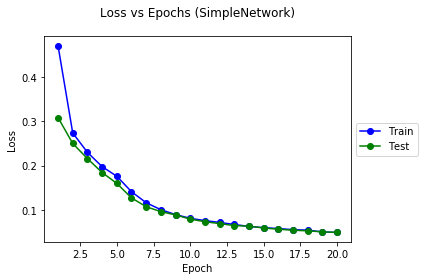

In [15]:
plot_multi_curves(epoch_list, [supervised_train_loss_list, supervised_test_loss_list], 'Epoch', 'Loss', ['Train', 'Test'], 'Loss vs Epochs (SimpleNetwork)')

## CNN

Train Epoch: 20/  20. Loss: 0.0497.: : 0it [02:38, ?it/s]

[8, 16, 24]



Train Epoch: 1/  20. Loss: 1.0144.: : 0it [00:27, ?it/s]

Error in dataloader


Train Epoch: 1/  20. Loss: 0.9653.: : 0it [01:50, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 1.8132.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.9989.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.7497.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.6567.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.7951.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.7951.:   0%|          | 5/4842 [00:00<01:38, 49.18it/s]

Test Iter:    6/4842. Loss: 1.2308.:   0%|          | 5/4842 [00:00<01:38, 49.18it/s]

Test Iter:    7/4842. Loss: 1.0856.:   0%|          | 5/4842 [00:00<01:38, 49.18it/s]

Test Iter:    8/4842. Loss: 1.5178.:   0%|          | 5/4842 [00:00<01:38, 49.18it/s]

Test Iter:    9/4842. Loss: 1.3775.:   0%|          | 5/4842 [00:00<01:38, 49.18it/s]

Test Iter:   10/4842. Loss: 1.2983.:   0%|          | 5/4842 [00:00<01

Test Iter:   78/4842. Loss: 0.7884.:   2%|▏         | 78/4842 [00:00<00:54, 87.80it/s]

Test Iter:   79/4842. Loss: 0.7952.:   2%|▏         | 78/4842 [00:00<00:54, 87.80it/s]

Test Iter:   80/4842. Loss: 0.7897.:   2%|▏         | 78/4842 [00:00<00:54, 87.80it/s]

Test Iter:   81/4842. Loss: 0.7855.:   2%|▏         | 78/4842 [00:00<00:54, 87.80it/s]

Test Iter:   82/4842. Loss: 0.7996.:   2%|▏         | 78/4842 [00:00<00:54, 87.80it/s]

Test Iter:   83/4842. Loss: 0.7931.:   2%|▏         | 78/4842 [00:00<00:54, 87.80it/s]

Test Iter:   84/4842. Loss: 0.7992.:   2%|▏         | 78/4842 [00:00<00:54, 87.80it/s]

Test Iter:   85/4842. Loss: 0.7952.:   2%|▏         | 78/4842 [00:01<00:54, 87.80it/s]

Test Iter:   86/4842. Loss: 0.7917.:   2%|▏         | 78/4842 [00:01<00:54, 87.80it/s]

Test Iter:   87/4842. Loss: 0.7912.:   2%|▏         | 78/4842 [00:01<00:54, 87.80it/s]

Test Iter:   88/4842. Loss: 0.7876.:   2%|▏         | 78/4842 [00:01<00:54, 87.80it/s]

Test Iter:   88/4842. Loss: 0.78

Test Iter:  157/4842. Loss: 0.8215.:   3%|▎         | 148/4842 [00:01<00:51, 90.60it/s]

Test Iter:  158/4842. Loss: 0.8179.:   3%|▎         | 148/4842 [00:01<00:51, 90.60it/s]

Test Iter:  158/4842. Loss: 0.8179.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  159/4842. Loss: 0.8310.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  160/4842. Loss: 0.8293.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  161/4842. Loss: 0.8292.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  162/4842. Loss: 0.8291.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  163/4842. Loss: 0.8259.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  164/4842. Loss: 0.8231.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  165/4842. Loss: 0.8205.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  166/4842. Loss: 0.8170.:   3%|▎         | 158/4842 [00:01<00:51, 90.83it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.9019.:   5%|▍         | 228/4842 [00:02<00:50, 91.16it/s]

Test Iter:  236/4842. Loss: 0.9097.:   5%|▍         | 228/4842 [00:02<00:50, 91.16it/s]

Test Iter:  237/4842. Loss: 0.9088.:   5%|▍         | 228/4842 [00:02<00:50, 91.16it/s]

Test Iter:  238/4842. Loss: 0.9135.:   5%|▍         | 228/4842 [00:02<00:50, 91.16it/s]

Test Iter:  238/4842. Loss: 0.9135.:   5%|▍         | 238/4842 [00:02<00:50, 91.11it/s]

Test Iter:  239/4842. Loss: 0.9120.:   5%|▍         | 238/4842 [00:02<00:50, 91.11it/s]

Test Iter:  240/4842. Loss: 0.9107.:   5%|▍         | 238/4842 [00:02<00:50, 91.11it/s]

Test Iter:  241/4842. Loss: 0.9313.:   5%|▍         | 238/4842 [00:02<00:50, 91.11it/s]

Test Iter:  242/4842. Loss: 0.9284.:   5%|▍         | 238/4842 [00:02<00:50, 91.11it/s]

Test Iter:  243/4842. Loss: 0.9252.:   5%|▍         | 238/4842 [00:02<00:50, 91.11it/s]

Test Iter:  244/4842. Loss: 0.9224.:   5%|▍         | 238/4842 [00:02<00:50, 91.11it/s]

Test Iter:  245/4842.

Test Iter:  313/4842. Loss: 0.9081.:   6%|▋         | 308/4842 [00:03<00:49, 90.76it/s]

Test Iter:  314/4842. Loss: 0.9178.:   6%|▋         | 308/4842 [00:03<00:49, 90.76it/s]

Test Iter:  315/4842. Loss: 0.9161.:   6%|▋         | 308/4842 [00:03<00:49, 90.76it/s]

Test Iter:  316/4842. Loss: 0.9142.:   6%|▋         | 308/4842 [00:03<00:49, 90.76it/s]

Test Iter:  317/4842. Loss: 0.9273.:   6%|▋         | 308/4842 [00:03<00:49, 90.76it/s]

Test Iter:  318/4842. Loss: 0.9264.:   6%|▋         | 308/4842 [00:03<00:49, 90.76it/s]

Test Iter:  318/4842. Loss: 0.9264.:   7%|▋         | 318/4842 [00:03<00:49, 91.00it/s]

Test Iter:  319/4842. Loss: 0.9240.:   7%|▋         | 318/4842 [00:03<00:49, 91.00it/s]

Test Iter:  320/4842. Loss: 0.9221.:   7%|▋         | 318/4842 [00:03<00:49, 91.00it/s]

Test Iter:  321/4842. Loss: 0.9198.:   7%|▋         | 318/4842 [00:03<00:49, 91.00it/s]

Test Iter:  322/4842. Loss: 0.9182.:   7%|▋         | 318/4842 [00:03<00:49, 91.00it/s]

Test Iter:  323/4842.

Test Iter:  391/4842. Loss: 0.8944.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  392/4842. Loss: 0.8933.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  393/4842. Loss: 0.8919.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  394/4842. Loss: 0.8905.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  395/4842. Loss: 0.8907.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  396/4842. Loss: 0.8897.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  397/4842. Loss: 0.8887.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  398/4842. Loss: 0.8873.:   8%|▊         | 388/4842 [00:04<00:48, 90.96it/s]

Test Iter:  398/4842. Loss: 0.8873.:   8%|▊         | 398/4842 [00:04<00:48, 90.78it/s]

Test Iter:  399/4842. Loss: 0.8861.:   8%|▊         | 398/4842 [00:04<00:48, 90.78it/s]

Test Iter:  400/4842. Loss: 0.8857.:   8%|▊         | 398/4842 [00:04<00:48, 90.78it/s]

Test Iter:  401/4842.

Test Iter:  469/4842. Loss: 0.8771.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  470/4842. Loss: 0.8758.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  471/4842. Loss: 0.8745.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  472/4842. Loss: 0.8731.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  473/4842. Loss: 0.8729.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  474/4842. Loss: 0.8724.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  475/4842. Loss: 0.8712.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  476/4842. Loss: 0.8699.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  477/4842. Loss: 0.8739.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  478/4842. Loss: 0.8736.:  10%|▉         | 468/4842 [00:05<00:48, 90.37it/s]

Test Iter:  478/4842. Loss: 0.8736.:  10%|▉         | 478/4842 [00:05<00:48, 90.57it/s]

Test Iter:  479/4842.

Test Iter:  548/4842. Loss: 0.8830.:  11%|█         | 538/4842 [00:06<00:47, 90.19it/s]

Test Iter:  548/4842. Loss: 0.8830.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  549/4842. Loss: 0.8834.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  550/4842. Loss: 0.8828.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  551/4842. Loss: 0.8819.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  552/4842. Loss: 0.8806.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  553/4842. Loss: 0.8795.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  554/4842. Loss: 0.8836.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  555/4842. Loss: 0.8827.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  556/4842. Loss: 0.8820.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  557/4842. Loss: 0.8809.:  11%|█▏        | 548/4842 [00:06<00:47, 90.19it/s]

Test Iter:  558/4842.

Test Iter:  626/4842. Loss: 0.8857.:  13%|█▎        | 618/4842 [00:06<00:46, 90.95it/s]

Test Iter:  627/4842. Loss: 0.8878.:  13%|█▎        | 618/4842 [00:06<00:46, 90.95it/s]

Test Iter:  628/4842. Loss: 0.8917.:  13%|█▎        | 618/4842 [00:06<00:46, 90.95it/s]

Test Iter:  628/4842. Loss: 0.8917.:  13%|█▎        | 628/4842 [00:06<00:46, 90.87it/s]

Test Iter:  629/4842. Loss: 0.8909.:  13%|█▎        | 628/4842 [00:07<00:46, 90.87it/s]

Test Iter:  630/4842. Loss: 0.8914.:  13%|█▎        | 628/4842 [00:07<00:46, 90.87it/s]

Test Iter:  631/4842. Loss: 0.8903.:  13%|█▎        | 628/4842 [00:07<00:46, 90.87it/s]

Test Iter:  632/4842. Loss: 0.8891.:  13%|█▎        | 628/4842 [00:07<00:46, 90.87it/s]

Test Iter:  633/4842. Loss: 0.8931.:  13%|█▎        | 628/4842 [00:07<00:46, 90.87it/s]

Test Iter:  634/4842. Loss: 0.8921.:  13%|█▎        | 628/4842 [00:07<00:46, 90.87it/s]

Test Iter:  635/4842. Loss: 0.8917.:  13%|█▎        | 628/4842 [00:07<00:46, 90.87it/s]

Test Iter:  636/4842.

Test Iter:  704/4842. Loss: 0.8908.:  14%|█▍        | 695/4842 [00:07<00:46, 89.40it/s]

Test Iter:  705/4842. Loss: 0.8901.:  14%|█▍        | 695/4842 [00:07<00:46, 89.40it/s]

Test Iter:  705/4842. Loss: 0.8901.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  706/4842. Loss: 0.8940.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  707/4842. Loss: 0.8931.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  708/4842. Loss: 0.8928.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  709/4842. Loss: 0.8920.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  710/4842. Loss: 0.8915.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  711/4842. Loss: 0.8913.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  712/4842. Loss: 0.8903.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  713/4842. Loss: 0.8899.:  15%|█▍        | 705/4842 [00:07<00:46, 89.84it/s]

Test Iter:  714/4842.

Test Iter:  782/4842. Loss: 0.8932.:  16%|█▌        | 775/4842 [00:08<00:44, 90.57it/s]

Test Iter:  783/4842. Loss: 0.8927.:  16%|█▌        | 775/4842 [00:08<00:44, 90.57it/s]

Test Iter:  784/4842. Loss: 0.8983.:  16%|█▌        | 775/4842 [00:08<00:44, 90.57it/s]

Test Iter:  785/4842. Loss: 0.8979.:  16%|█▌        | 775/4842 [00:08<00:44, 90.57it/s]

Test Iter:  785/4842. Loss: 0.8979.:  16%|█▌        | 785/4842 [00:08<00:44, 90.46it/s]

Test Iter:  786/4842. Loss: 0.8973.:  16%|█▌        | 785/4842 [00:08<00:44, 90.46it/s]

Test Iter:  787/4842. Loss: 0.9017.:  16%|█▌        | 785/4842 [00:08<00:44, 90.46it/s]

Test Iter:  788/4842. Loss: 0.9011.:  16%|█▌        | 785/4842 [00:08<00:44, 90.46it/s]

Test Iter:  789/4842. Loss: 0.9002.:  16%|█▌        | 785/4842 [00:08<00:44, 90.46it/s]

Test Iter:  790/4842. Loss: 0.9013.:  16%|█▌        | 785/4842 [00:08<00:44, 90.46it/s]

Test Iter:  791/4842. Loss: 0.9004.:  16%|█▌        | 785/4842 [00:08<00:44, 90.46it/s]

Test Iter:  792/4842.

Test Iter:  860/4842. Loss: 0.8952.:  18%|█▊        | 855/4842 [00:09<00:43, 90.73it/s]

Test Iter:  861/4842. Loss: 0.8944.:  18%|█▊        | 855/4842 [00:09<00:43, 90.73it/s]

Test Iter:  862/4842. Loss: 0.8936.:  18%|█▊        | 855/4842 [00:09<00:43, 90.73it/s]

Test Iter:  863/4842. Loss: 0.8939.:  18%|█▊        | 855/4842 [00:09<00:43, 90.73it/s]

Test Iter:  864/4842. Loss: 0.8954.:  18%|█▊        | 855/4842 [00:09<00:43, 90.73it/s]

Test Iter:  865/4842. Loss: 0.8972.:  18%|█▊        | 855/4842 [00:09<00:43, 90.73it/s]

Test Iter:  865/4842. Loss: 0.8972.:  18%|█▊        | 865/4842 [00:09<00:43, 90.76it/s]

Test Iter:  866/4842. Loss: 0.8965.:  18%|█▊        | 865/4842 [00:09<00:43, 90.76it/s]

Test Iter:  867/4842. Loss: 0.8961.:  18%|█▊        | 865/4842 [00:09<00:43, 90.76it/s]

Test Iter:  868/4842. Loss: 0.8966.:  18%|█▊        | 865/4842 [00:09<00:43, 90.76it/s]

Test Iter:  869/4842. Loss: 0.8969.:  18%|█▊        | 865/4842 [00:09<00:43, 90.76it/s]

Test Iter:  870/4842.

Test Iter:  938/4842. Loss: 0.8907.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  939/4842. Loss: 0.8901.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  940/4842. Loss: 0.8894.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  941/4842. Loss: 0.8887.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  942/4842. Loss: 0.8911.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  943/4842. Loss: 0.8905.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  944/4842. Loss: 0.8897.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  945/4842. Loss: 0.8924.:  19%|█▉        | 935/4842 [00:10<00:43, 90.61it/s]

Test Iter:  945/4842. Loss: 0.8924.:  20%|█▉        | 945/4842 [00:10<00:43, 90.39it/s]

Test Iter:  946/4842. Loss: 0.8925.:  20%|█▉        | 945/4842 [00:10<00:43, 90.39it/s]

Test Iter:  947/4842. Loss: 0.8922.:  20%|█▉        | 945/4842 [00:10<00:43, 90.39it/s]

Test Iter:  948/4842.

Test Iter: 1016/4842. Loss: 0.8989.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1017/4842. Loss: 0.8982.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1018/4842. Loss: 0.8980.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1019/4842. Loss: 0.8972.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1020/4842. Loss: 0.8966.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1021/4842. Loss: 0.8960.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1022/4842. Loss: 0.8955.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1023/4842. Loss: 0.8976.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1024/4842. Loss: 0.8969.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1025/4842. Loss: 0.8962.:  21%|██        | 1015/4842 [00:11<00:42, 90.90it/s]

Test Iter: 1025/4842. Loss: 0.8962.:  21%|██        | 1025/4842 [00:11<00:42, 90.74it/s]

Test Iter:

Test Iter: 1094/4842. Loss: 0.8988.:  22%|██▏       | 1085/4842 [00:12<00:41, 90.70it/s]

Test Iter: 1095/4842. Loss: 0.8985.:  22%|██▏       | 1085/4842 [00:12<00:41, 90.70it/s]

Test Iter: 1095/4842. Loss: 0.8985.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1096/4842. Loss: 0.9002.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1097/4842. Loss: 0.8999.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1098/4842. Loss: 0.8992.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1099/4842. Loss: 0.9000.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1100/4842. Loss: 0.8996.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1101/4842. Loss: 0.9013.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1102/4842. Loss: 0.9007.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter: 1103/4842. Loss: 0.9029.:  23%|██▎       | 1095/4842 [00:12<00:41, 90.88it/s]

Test Iter:

Test Iter: 1171/4842. Loss: 0.8985.:  24%|██▍       | 1165/4842 [00:12<00:40, 90.47it/s]

Test Iter: 1172/4842. Loss: 0.8981.:  24%|██▍       | 1165/4842 [00:12<00:40, 90.47it/s]

Test Iter: 1173/4842. Loss: 0.8982.:  24%|██▍       | 1165/4842 [00:13<00:40, 90.47it/s]

Test Iter: 1174/4842. Loss: 0.8982.:  24%|██▍       | 1165/4842 [00:13<00:40, 90.47it/s]

Test Iter: 1175/4842. Loss: 0.8980.:  24%|██▍       | 1165/4842 [00:13<00:40, 90.47it/s]

Test Iter: 1175/4842. Loss: 0.8980.:  24%|██▍       | 1175/4842 [00:13<00:40, 90.64it/s]

Test Iter: 1176/4842. Loss: 0.8998.:  24%|██▍       | 1175/4842 [00:13<00:40, 90.64it/s]

Test Iter: 1177/4842. Loss: 0.9035.:  24%|██▍       | 1175/4842 [00:13<00:40, 90.64it/s]

Test Iter: 1178/4842. Loss: 0.9037.:  24%|██▍       | 1175/4842 [00:13<00:40, 90.64it/s]

Test Iter: 1179/4842. Loss: 0.9036.:  24%|██▍       | 1175/4842 [00:13<00:40, 90.64it/s]

Test Iter: 1180/4842. Loss: 0.9030.:  24%|██▍       | 1175/4842 [00:13<00:40, 90.64it/s]

Test Iter:

Test Iter: 1248/4842. Loss: 0.8917.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1249/4842. Loss: 0.8921.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1250/4842. Loss: 0.8918.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1251/4842. Loss: 0.8912.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1252/4842. Loss: 0.8907.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1253/4842. Loss: 0.8905.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1254/4842. Loss: 0.8900.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1255/4842. Loss: 0.8916.:  26%|██▌       | 1245/4842 [00:13<00:39, 90.32it/s]

Test Iter: 1255/4842. Loss: 0.8916.:  26%|██▌       | 1255/4842 [00:13<00:39, 90.22it/s]

Test Iter: 1256/4842. Loss: 0.8914.:  26%|██▌       | 1255/4842 [00:13<00:39, 90.22it/s]

Test Iter: 1257/4842. Loss: 0.8913.:  26%|██▌       | 1255/4842 [00:13<00:39, 90.22it/s]

Test Iter:

Test Iter: 1325/4842. Loss: 0.9146.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1326/4842. Loss: 0.9143.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1327/4842. Loss: 0.9139.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1328/4842. Loss: 0.9133.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1329/4842. Loss: 0.9132.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1330/4842. Loss: 0.9127.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1331/4842. Loss: 0.9126.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1332/4842. Loss: 0.9154.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1333/4842. Loss: 0.9153.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1334/4842. Loss: 0.9148.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter: 1335/4842. Loss: 0.9144.:  27%|██▋       | 1325/4842 [00:14<00:38, 90.59it/s]

Test Iter:

Test Iter: 1403/4842. Loss: 0.9075.:  29%|██▉       | 1395/4842 [00:15<00:38, 90.60it/s]

Test Iter: 1404/4842. Loss: 0.9070.:  29%|██▉       | 1395/4842 [00:15<00:38, 90.60it/s]

Test Iter: 1405/4842. Loss: 0.9066.:  29%|██▉       | 1395/4842 [00:15<00:38, 90.60it/s]

Test Iter: 1405/4842. Loss: 0.9066.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter: 1406/4842. Loss: 0.9065.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter: 1407/4842. Loss: 0.9061.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter: 1408/4842. Loss: 0.9058.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter: 1409/4842. Loss: 0.9055.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter: 1410/4842. Loss: 0.9051.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter: 1411/4842. Loss: 0.9046.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter: 1412/4842. Loss: 0.9042.:  29%|██▉       | 1405/4842 [00:15<00:37, 90.80it/s]

Test Iter:

Test Iter: 1480/4842. Loss: 0.8999.:  30%|███       | 1474/4842 [00:16<00:37, 90.16it/s]

Test Iter: 1481/4842. Loss: 0.8996.:  30%|███       | 1474/4842 [00:16<00:37, 90.16it/s]

Test Iter: 1482/4842. Loss: 0.8998.:  30%|███       | 1474/4842 [00:16<00:37, 90.16it/s]

Test Iter: 1483/4842. Loss: 0.9000.:  30%|███       | 1474/4842 [00:16<00:37, 90.16it/s]

Test Iter: 1484/4842. Loss: 0.8996.:  30%|███       | 1474/4842 [00:16<00:37, 90.16it/s]

Test Iter: 1484/4842. Loss: 0.8996.:  31%|███       | 1484/4842 [00:16<00:37, 90.24it/s]

Test Iter: 1485/4842. Loss: 0.8996.:  31%|███       | 1484/4842 [00:16<00:37, 90.24it/s]

Test Iter: 1486/4842. Loss: 0.8992.:  31%|███       | 1484/4842 [00:16<00:37, 90.24it/s]

Test Iter: 1487/4842. Loss: 0.8990.:  31%|███       | 1484/4842 [00:16<00:37, 90.24it/s]

Test Iter: 1488/4842. Loss: 0.8987.:  31%|███       | 1484/4842 [00:16<00:37, 90.24it/s]

Test Iter: 1489/4842. Loss: 0.9000.:  31%|███       | 1484/4842 [00:16<00:37, 90.24it/s]

Test Iter:

Test Iter: 1557/4842. Loss: 0.9071.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1558/4842. Loss: 0.9067.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1559/4842. Loss: 0.9063.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1560/4842. Loss: 0.9059.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1561/4842. Loss: 0.9061.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1562/4842. Loss: 0.9064.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1563/4842. Loss: 0.9060.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1564/4842. Loss: 0.9056.:  32%|███▏      | 1554/4842 [00:17<00:36, 90.41it/s]

Test Iter: 1564/4842. Loss: 0.9056.:  32%|███▏      | 1564/4842 [00:17<00:36, 90.42it/s]

Test Iter: 1565/4842. Loss: 0.9053.:  32%|███▏      | 1564/4842 [00:17<00:36, 90.42it/s]

Test Iter: 1566/4842. Loss: 0.9050.:  32%|███▏      | 1564/4842 [00:17<00:36, 90.42it/s]

Test Iter:

Test Iter: 1634/4842. Loss: 0.8962.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1635/4842. Loss: 0.8961.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1636/4842. Loss: 0.8960.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1637/4842. Loss: 0.8963.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1638/4842. Loss: 0.8959.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1639/4842. Loss: 0.8955.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1640/4842. Loss: 0.8951.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1641/4842. Loss: 0.8951.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1642/4842. Loss: 0.8949.:  34%|███▎      | 1632/4842 [00:18<00:35, 90.16it/s]

Test Iter: 1642/4842. Loss: 0.8949.:  34%|███▍      | 1642/4842 [00:18<00:35, 90.20it/s]

Test Iter: 1643/4842. Loss: 0.8944.:  34%|███▍      | 1642/4842 [00:18<00:35, 90.20it/s]

Test Iter:

Test Iter: 1712/4842. Loss: 0.9008.:  35%|███▌      | 1702/4842 [00:18<00:34, 90.48it/s]

Test Iter: 1712/4842. Loss: 0.9008.:  35%|███▌      | 1712/4842 [00:18<00:34, 90.32it/s]

Test Iter: 1713/4842. Loss: 0.9006.:  35%|███▌      | 1712/4842 [00:18<00:34, 90.32it/s]

Test Iter: 1714/4842. Loss: 0.9003.:  35%|███▌      | 1712/4842 [00:18<00:34, 90.32it/s]

Test Iter: 1715/4842. Loss: 0.9023.:  35%|███▌      | 1712/4842 [00:19<00:34, 90.32it/s]

Test Iter: 1716/4842. Loss: 0.9020.:  35%|███▌      | 1712/4842 [00:19<00:34, 90.32it/s]

Test Iter: 1717/4842. Loss: 0.9028.:  35%|███▌      | 1712/4842 [00:19<00:34, 90.32it/s]

Test Iter: 1718/4842. Loss: 0.9025.:  35%|███▌      | 1712/4842 [00:19<00:34, 90.32it/s]

Test Iter: 1719/4842. Loss: 0.9021.:  35%|███▌      | 1712/4842 [00:19<00:34, 90.32it/s]

Test Iter: 1720/4842. Loss: 0.9022.:  35%|███▌      | 1712/4842 [00:19<00:34, 90.32it/s]

Test Iter: 1721/4842. Loss: 0.9018.:  35%|███▌      | 1712/4842 [00:19<00:34, 90.32it/s]

Test Iter:

Test Iter: 1789/4842. Loss: 0.9004.:  37%|███▋      | 1782/4842 [00:19<00:33, 90.26it/s]

Test Iter: 1790/4842. Loss: 0.9001.:  37%|███▋      | 1782/4842 [00:19<00:33, 90.26it/s]

Test Iter: 1791/4842. Loss: 0.8999.:  37%|███▋      | 1782/4842 [00:19<00:33, 90.26it/s]

Test Iter: 1792/4842. Loss: 0.8995.:  37%|███▋      | 1782/4842 [00:19<00:33, 90.26it/s]

Test Iter: 1792/4842. Loss: 0.8995.:  37%|███▋      | 1792/4842 [00:19<00:33, 90.37it/s]

Test Iter: 1793/4842. Loss: 0.8992.:  37%|███▋      | 1792/4842 [00:19<00:33, 90.37it/s]

Test Iter: 1794/4842. Loss: 0.8988.:  37%|███▋      | 1792/4842 [00:19<00:33, 90.37it/s]

Test Iter: 1795/4842. Loss: 0.8983.:  37%|███▋      | 1792/4842 [00:19<00:33, 90.37it/s]

Test Iter: 1796/4842. Loss: 0.8983.:  37%|███▋      | 1792/4842 [00:19<00:33, 90.37it/s]

Test Iter: 1797/4842. Loss: 0.8982.:  37%|███▋      | 1792/4842 [00:19<00:33, 90.37it/s]

Test Iter: 1798/4842. Loss: 0.8978.:  37%|███▋      | 1792/4842 [00:19<00:33, 90.37it/s]

Test Iter:

Test Iter: 1866/4842. Loss: 0.8965.:  38%|███▊      | 1862/4842 [00:20<00:32, 90.91it/s]

Test Iter: 1867/4842. Loss: 0.8965.:  38%|███▊      | 1862/4842 [00:20<00:32, 90.91it/s]

Test Iter: 1868/4842. Loss: 0.8961.:  38%|███▊      | 1862/4842 [00:20<00:32, 90.91it/s]

Test Iter: 1869/4842. Loss: 0.8958.:  38%|███▊      | 1862/4842 [00:20<00:32, 90.91it/s]

Test Iter: 1870/4842. Loss: 0.8958.:  38%|███▊      | 1862/4842 [00:20<00:32, 90.91it/s]

Test Iter: 1871/4842. Loss: 0.8956.:  38%|███▊      | 1862/4842 [00:20<00:32, 90.91it/s]

Test Iter: 1872/4842. Loss: 0.8953.:  38%|███▊      | 1862/4842 [00:20<00:32, 90.91it/s]

Test Iter: 1872/4842. Loss: 0.8953.:  39%|███▊      | 1872/4842 [00:20<00:32, 90.87it/s]

Test Iter: 1873/4842. Loss: 0.8959.:  39%|███▊      | 1872/4842 [00:20<00:32, 90.87it/s]

Test Iter: 1874/4842. Loss: 0.8961.:  39%|███▊      | 1872/4842 [00:20<00:32, 90.87it/s]

Test Iter: 1875/4842. Loss: 0.8961.:  39%|███▊      | 1872/4842 [00:20<00:32, 90.87it/s]

Test Iter:

Test Iter: 1943/4842. Loss: 0.9084.:  40%|████      | 1940/4842 [00:21<00:32, 89.48it/s]

Test Iter: 1944/4842. Loss: 0.9081.:  40%|████      | 1940/4842 [00:21<00:32, 89.48it/s]

Test Iter: 1945/4842. Loss: 0.9078.:  40%|████      | 1940/4842 [00:21<00:32, 89.48it/s]

Test Iter: 1946/4842. Loss: 0.9076.:  40%|████      | 1940/4842 [00:21<00:32, 89.48it/s]

Test Iter: 1947/4842. Loss: 0.9073.:  40%|████      | 1940/4842 [00:21<00:32, 89.48it/s]

Test Iter: 1948/4842. Loss: 0.9071.:  40%|████      | 1940/4842 [00:21<00:32, 89.48it/s]

Test Iter: 1949/4842. Loss: 0.9067.:  40%|████      | 1940/4842 [00:21<00:32, 89.48it/s]

Test Iter: 1949/4842. Loss: 0.9067.:  40%|████      | 1949/4842 [00:21<00:32, 89.57it/s]

Test Iter: 1950/4842. Loss: 0.9064.:  40%|████      | 1949/4842 [00:21<00:32, 89.57it/s]

Test Iter: 1951/4842. Loss: 0.9064.:  40%|████      | 1949/4842 [00:21<00:32, 89.57it/s]

Test Iter: 1952/4842. Loss: 0.9062.:  40%|████      | 1949/4842 [00:21<00:32, 89.57it/s]

Test Iter:

Test Iter: 2020/4842. Loss: 0.9129.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2021/4842. Loss: 0.9125.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2022/4842. Loss: 0.9125.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2023/4842. Loss: 0.9121.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2024/4842. Loss: 0.9118.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2025/4842. Loss: 0.9128.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2026/4842. Loss: 0.9125.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2027/4842. Loss: 0.9122.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2028/4842. Loss: 0.9120.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2029/4842. Loss: 0.9117.:  42%|████▏     | 2019/4842 [00:22<00:31, 90.07it/s]

Test Iter: 2029/4842. Loss: 0.9117.:  42%|████▏     | 2029/4842 [00:22<00:31, 90.20it/s]

Test Iter:

Test Iter: 2098/4842. Loss: 0.9064.:  43%|████▎     | 2089/4842 [00:23<00:30, 90.39it/s]

Test Iter: 2099/4842. Loss: 0.9062.:  43%|████▎     | 2089/4842 [00:23<00:30, 90.39it/s]

Test Iter: 2099/4842. Loss: 0.9062.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2100/4842. Loss: 0.9061.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2101/4842. Loss: 0.9059.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2102/4842. Loss: 0.9056.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2103/4842. Loss: 0.9056.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2104/4842. Loss: 0.9054.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2105/4842. Loss: 0.9051.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2106/4842. Loss: 0.9047.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter: 2107/4842. Loss: 0.9045.:  43%|████▎     | 2099/4842 [00:23<00:30, 90.25it/s]

Test Iter:

Test Iter: 2175/4842. Loss: 0.9038.:  45%|████▍     | 2168/4842 [00:24<00:29, 90.52it/s]

Test Iter: 2176/4842. Loss: 0.9035.:  45%|████▍     | 2168/4842 [00:24<00:29, 90.52it/s]

Test Iter: 2177/4842. Loss: 0.9033.:  45%|████▍     | 2168/4842 [00:24<00:29, 90.52it/s]

Test Iter: 2178/4842. Loss: 0.9046.:  45%|████▍     | 2168/4842 [00:24<00:29, 90.52it/s]

Test Iter: 2178/4842. Loss: 0.9046.:  45%|████▍     | 2178/4842 [00:24<00:29, 90.63it/s]

Test Iter: 2179/4842. Loss: 0.9042.:  45%|████▍     | 2178/4842 [00:24<00:29, 90.63it/s]

Test Iter: 2180/4842. Loss: 0.9042.:  45%|████▍     | 2178/4842 [00:24<00:29, 90.63it/s]

Test Iter: 2181/4842. Loss: 0.9038.:  45%|████▍     | 2178/4842 [00:24<00:29, 90.63it/s]

Test Iter: 2182/4842. Loss: 0.9035.:  45%|████▍     | 2178/4842 [00:24<00:29, 90.63it/s]

Test Iter: 2183/4842. Loss: 0.9043.:  45%|████▍     | 2178/4842 [00:24<00:29, 90.63it/s]

Test Iter: 2184/4842. Loss: 0.9041.:  45%|████▍     | 2178/4842 [00:24<00:29, 90.63it/s]

Test Iter:

Test Iter: 2252/4842. Loss: 0.9075.:  46%|████▋     | 2246/4842 [00:24<00:29, 89.32it/s]

Test Iter: 2253/4842. Loss: 0.9072.:  46%|████▋     | 2246/4842 [00:24<00:29, 89.32it/s]

Test Iter: 2254/4842. Loss: 0.9070.:  46%|████▋     | 2246/4842 [00:24<00:29, 89.32it/s]

Test Iter: 2255/4842. Loss: 0.9067.:  46%|████▋     | 2246/4842 [00:24<00:29, 89.32it/s]

Test Iter: 2255/4842. Loss: 0.9067.:  47%|████▋     | 2255/4842 [00:24<00:28, 89.25it/s]

Test Iter: 2256/4842. Loss: 0.9066.:  47%|████▋     | 2255/4842 [00:25<00:28, 89.25it/s]

Test Iter: 2257/4842. Loss: 0.9066.:  47%|████▋     | 2255/4842 [00:25<00:28, 89.25it/s]

Test Iter: 2258/4842. Loss: 0.9072.:  47%|████▋     | 2255/4842 [00:25<00:28, 89.25it/s]

Test Iter: 2259/4842. Loss: 0.9069.:  47%|████▋     | 2255/4842 [00:25<00:28, 89.25it/s]

Test Iter: 2260/4842. Loss: 0.9077.:  47%|████▋     | 2255/4842 [00:25<00:28, 89.25it/s]

Test Iter: 2261/4842. Loss: 0.9074.:  47%|████▋     | 2255/4842 [00:25<00:28, 89.25it/s]

Test Iter:

Test Iter: 2329/4842. Loss: 0.9081.:  48%|████▊     | 2324/4842 [00:25<00:27, 90.75it/s]

Test Iter: 2330/4842. Loss: 0.9088.:  48%|████▊     | 2324/4842 [00:25<00:27, 90.75it/s]

Test Iter: 2331/4842. Loss: 0.9085.:  48%|████▊     | 2324/4842 [00:25<00:27, 90.75it/s]

Test Iter: 2332/4842. Loss: 0.9082.:  48%|████▊     | 2324/4842 [00:25<00:27, 90.75it/s]

Test Iter: 2333/4842. Loss: 0.9093.:  48%|████▊     | 2324/4842 [00:25<00:27, 90.75it/s]

Test Iter: 2334/4842. Loss: 0.9092.:  48%|████▊     | 2324/4842 [00:25<00:27, 90.75it/s]

Test Iter: 2334/4842. Loss: 0.9092.:  48%|████▊     | 2334/4842 [00:25<00:27, 90.56it/s]

Test Iter: 2335/4842. Loss: 0.9089.:  48%|████▊     | 2334/4842 [00:25<00:27, 90.56it/s]

Test Iter: 2336/4842. Loss: 0.9088.:  48%|████▊     | 2334/4842 [00:25<00:27, 90.56it/s]

Test Iter: 2337/4842. Loss: 0.9087.:  48%|████▊     | 2334/4842 [00:25<00:27, 90.56it/s]

Test Iter: 2338/4842. Loss: 0.9084.:  48%|████▊     | 2334/4842 [00:25<00:27, 90.56it/s]

Test Iter:

Test Iter: 2406/4842. Loss: 0.9114.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2407/4842. Loss: 0.9111.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2408/4842. Loss: 0.9109.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2409/4842. Loss: 0.9106.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2410/4842. Loss: 0.9104.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2411/4842. Loss: 0.9101.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2412/4842. Loss: 0.9100.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2413/4842. Loss: 0.9098.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2414/4842. Loss: 0.9096.:  50%|████▉     | 2404/4842 [00:26<00:26, 90.33it/s]

Test Iter: 2414/4842. Loss: 0.9096.:  50%|████▉     | 2414/4842 [00:26<00:26, 90.68it/s]

Test Iter: 2415/4842. Loss: 0.9094.:  50%|████▉     | 2414/4842 [00:26<00:26, 90.68it/s]

Test Iter:

Test Iter: 2484/4842. Loss: 0.9065.:  51%|█████     | 2474/4842 [00:27<00:26, 90.99it/s]

Test Iter: 2484/4842. Loss: 0.9065.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2485/4842. Loss: 0.9063.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2486/4842. Loss: 0.9061.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2487/4842. Loss: 0.9071.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2488/4842. Loss: 0.9069.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2489/4842. Loss: 0.9068.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2490/4842. Loss: 0.9068.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2491/4842. Loss: 0.9065.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2492/4842. Loss: 0.9077.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter: 2493/4842. Loss: 0.9076.:  51%|█████▏    | 2484/4842 [00:27<00:25, 90.98it/s]

Test Iter:

Test Iter: 2561/4842. Loss: 0.9074.:  53%|█████▎    | 2554/4842 [00:28<00:25, 90.20it/s]

Test Iter: 2562/4842. Loss: 0.9071.:  53%|█████▎    | 2554/4842 [00:28<00:25, 90.20it/s]

Test Iter: 2563/4842. Loss: 0.9069.:  53%|█████▎    | 2554/4842 [00:28<00:25, 90.20it/s]

Test Iter: 2564/4842. Loss: 0.9067.:  53%|█████▎    | 2554/4842 [00:28<00:25, 90.20it/s]

Test Iter: 2564/4842. Loss: 0.9067.:  53%|█████▎    | 2564/4842 [00:28<00:25, 90.12it/s]

Test Iter: 2565/4842. Loss: 0.9066.:  53%|█████▎    | 2564/4842 [00:28<00:25, 90.12it/s]

Test Iter: 2566/4842. Loss: 0.9066.:  53%|█████▎    | 2564/4842 [00:28<00:25, 90.12it/s]

Test Iter: 2567/4842. Loss: 0.9063.:  53%|█████▎    | 2564/4842 [00:28<00:25, 90.12it/s]

Test Iter: 2568/4842. Loss: 0.9063.:  53%|█████▎    | 2564/4842 [00:28<00:25, 90.12it/s]

Test Iter: 2569/4842. Loss: 0.9060.:  53%|█████▎    | 2564/4842 [00:28<00:25, 90.12it/s]

Test Iter: 2570/4842. Loss: 0.9072.:  53%|█████▎    | 2564/4842 [00:28<00:25, 90.12it/s]

Test Iter:

Test Iter: 2638/4842. Loss: 0.9087.:  54%|█████▍    | 2634/4842 [00:29<00:24, 90.83it/s]

Test Iter: 2639/4842. Loss: 0.9097.:  54%|█████▍    | 2634/4842 [00:29<00:24, 90.83it/s]

Test Iter: 2640/4842. Loss: 0.9106.:  54%|█████▍    | 2634/4842 [00:29<00:24, 90.83it/s]

Test Iter: 2641/4842. Loss: 0.9108.:  54%|█████▍    | 2634/4842 [00:29<00:24, 90.83it/s]

Test Iter: 2642/4842. Loss: 0.9105.:  54%|█████▍    | 2634/4842 [00:29<00:24, 90.83it/s]

Test Iter: 2643/4842. Loss: 0.9104.:  54%|█████▍    | 2634/4842 [00:29<00:24, 90.83it/s]

Test Iter: 2644/4842. Loss: 0.9102.:  54%|█████▍    | 2634/4842 [00:29<00:24, 90.83it/s]

Test Iter: 2644/4842. Loss: 0.9102.:  55%|█████▍    | 2644/4842 [00:29<00:24, 90.64it/s]

Test Iter: 2645/4842. Loss: 0.9099.:  55%|█████▍    | 2644/4842 [00:29<00:24, 90.64it/s]

Test Iter: 2646/4842. Loss: 0.9098.:  55%|█████▍    | 2644/4842 [00:29<00:24, 90.64it/s]

Test Iter: 2647/4842. Loss: 0.9108.:  55%|█████▍    | 2644/4842 [00:29<00:24, 90.64it/s]

Test Iter:

Test Iter: 2715/4842. Loss: 0.9119.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2716/4842. Loss: 0.9117.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2717/4842. Loss: 0.9127.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2718/4842. Loss: 0.9132.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2719/4842. Loss: 0.9130.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2720/4842. Loss: 0.9139.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2721/4842. Loss: 0.9137.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2722/4842. Loss: 0.9145.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2723/4842. Loss: 0.9157.:  56%|█████▌    | 2714/4842 [00:30<00:24, 88.57it/s]

Test Iter: 2723/4842. Loss: 0.9157.:  56%|█████▌    | 2723/4842 [00:30<00:23, 88.85it/s]

Test Iter: 2724/4842. Loss: 0.9168.:  56%|█████▌    | 2723/4842 [00:30<00:23, 88.85it/s]

Test Iter:

Test Iter: 2792/4842. Loss: 0.9138.:  58%|█████▊    | 2792/4842 [00:30<00:22, 90.31it/s]

Test Iter: 2793/4842. Loss: 0.9136.:  58%|█████▊    | 2792/4842 [00:30<00:22, 90.31it/s]

Test Iter: 2794/4842. Loss: 0.9138.:  58%|█████▊    | 2792/4842 [00:30<00:22, 90.31it/s]

Test Iter: 2795/4842. Loss: 0.9137.:  58%|█████▊    | 2792/4842 [00:30<00:22, 90.31it/s]

Test Iter: 2796/4842. Loss: 0.9136.:  58%|█████▊    | 2792/4842 [00:30<00:22, 90.31it/s]

Test Iter: 2797/4842. Loss: 0.9137.:  58%|█████▊    | 2792/4842 [00:30<00:22, 90.31it/s]

Test Iter: 2798/4842. Loss: 0.9135.:  58%|█████▊    | 2792/4842 [00:30<00:22, 90.31it/s]

Test Iter: 2799/4842. Loss: 0.9132.:  58%|█████▊    | 2792/4842 [00:31<00:22, 90.31it/s]

Test Iter: 2800/4842. Loss: 0.9131.:  58%|█████▊    | 2792/4842 [00:31<00:22, 90.31it/s]

Test Iter: 2801/4842. Loss: 0.9129.:  58%|█████▊    | 2792/4842 [00:31<00:22, 90.31it/s]

Test Iter: 2802/4842. Loss: 0.9127.:  58%|█████▊    | 2792/4842 [00:31<00:22, 90.31it/s]

Test Iter:

Test Iter: 2870/4842. Loss: 0.9093.:  59%|█████▉    | 2862/4842 [00:31<00:21, 90.31it/s]

Test Iter: 2871/4842. Loss: 0.9092.:  59%|█████▉    | 2862/4842 [00:31<00:21, 90.31it/s]

Test Iter: 2872/4842. Loss: 0.9090.:  59%|█████▉    | 2862/4842 [00:31<00:21, 90.31it/s]

Test Iter: 2872/4842. Loss: 0.9090.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter: 2873/4842. Loss: 0.9088.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter: 2874/4842. Loss: 0.9085.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter: 2875/4842. Loss: 0.9083.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter: 2876/4842. Loss: 0.9081.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter: 2877/4842. Loss: 0.9086.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter: 2878/4842. Loss: 0.9084.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter: 2879/4842. Loss: 0.9082.:  59%|█████▉    | 2872/4842 [00:31<00:23, 85.41it/s]

Test Iter:

Test Iter: 2947/4842. Loss: 0.9104.:  61%|██████    | 2942/4842 [00:32<00:19, 97.33it/s]

Test Iter: 2948/4842. Loss: 0.9103.:  61%|██████    | 2942/4842 [00:32<00:19, 97.33it/s]

Test Iter: 2949/4842. Loss: 0.9103.:  61%|██████    | 2942/4842 [00:32<00:19, 97.33it/s]

Test Iter: 2950/4842. Loss: 0.9100.:  61%|██████    | 2942/4842 [00:32<00:19, 97.33it/s]

Test Iter: 2951/4842. Loss: 0.9101.:  61%|██████    | 2942/4842 [00:32<00:19, 97.33it/s]

Test Iter: 2952/4842. Loss: 0.9102.:  61%|██████    | 2942/4842 [00:32<00:19, 97.33it/s]

Test Iter: 2952/4842. Loss: 0.9102.:  61%|██████    | 2952/4842 [00:32<00:19, 97.91it/s]

Test Iter: 2953/4842. Loss: 0.9100.:  61%|██████    | 2952/4842 [00:32<00:19, 97.91it/s]

Test Iter: 2954/4842. Loss: 0.9099.:  61%|██████    | 2952/4842 [00:32<00:19, 97.91it/s]

Test Iter: 2955/4842. Loss: 0.9102.:  61%|██████    | 2952/4842 [00:32<00:19, 97.91it/s]

Test Iter: 2956/4842. Loss: 0.9101.:  61%|██████    | 2952/4842 [00:32<00:19, 97.91it/s]

Test Iter:

Test Iter: 3025/4842. Loss: 0.9187.:  62%|██████▏   | 3016/4842 [00:33<00:18, 97.84it/s]

Test Iter: 3026/4842. Loss: 0.9184.:  62%|██████▏   | 3016/4842 [00:33<00:18, 97.84it/s]

Test Iter: 3026/4842. Loss: 0.9184.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3027/4842. Loss: 0.9183.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3028/4842. Loss: 0.9183.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3029/4842. Loss: 0.9188.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3030/4842. Loss: 0.9186.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3031/4842. Loss: 0.9184.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3032/4842. Loss: 0.9187.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3033/4842. Loss: 0.9185.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter: 3034/4842. Loss: 0.9183.:  62%|██████▏   | 3026/4842 [00:33<00:18, 96.58it/s]

Test Iter:

Test Iter: 3102/4842. Loss: 0.9237.:  64%|██████▍   | 3092/4842 [00:34<00:17, 100.15it/s]

Test Iter: 3103/4842. Loss: 0.9239.:  64%|██████▍   | 3092/4842 [00:34<00:17, 100.15it/s]

Test Iter: 3103/4842. Loss: 0.9239.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s] 

Test Iter: 3104/4842. Loss: 0.9236.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test Iter: 3105/4842. Loss: 0.9234.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test Iter: 3106/4842. Loss: 0.9234.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test Iter: 3107/4842. Loss: 0.9231.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test Iter: 3108/4842. Loss: 0.9229.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test Iter: 3109/4842. Loss: 0.9236.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test Iter: 3110/4842. Loss: 0.9239.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test Iter: 3111/4842. Loss: 0.9237.:  64%|██████▍   | 3103/4842 [00:34<00:17, 96.66it/s]

Test It

Test Iter: 3179/4842. Loss: 0.9228.:  65%|██████▌   | 3170/4842 [00:35<00:19, 84.50it/s]

Test Iter: 3179/4842. Loss: 0.9228.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3180/4842. Loss: 0.9235.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3181/4842. Loss: 0.9235.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3182/4842. Loss: 0.9233.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3183/4842. Loss: 0.9231.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3184/4842. Loss: 0.9230.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3185/4842. Loss: 0.9229.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3186/4842. Loss: 0.9227.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3187/4842. Loss: 0.9226.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter: 3188/4842. Loss: 0.9234.:  66%|██████▌   | 3179/4842 [00:35<00:19, 84.36it/s]

Test Iter:

Test Iter: 3255/4842. Loss: 0.9207.:  67%|██████▋   | 3251/4842 [00:35<00:18, 87.38it/s]

Test Iter: 3256/4842. Loss: 0.9206.:  67%|██████▋   | 3251/4842 [00:35<00:18, 87.38it/s]

Test Iter: 3257/4842. Loss: 0.9204.:  67%|██████▋   | 3251/4842 [00:35<00:18, 87.38it/s]

Test Iter: 3258/4842. Loss: 0.9202.:  67%|██████▋   | 3251/4842 [00:36<00:18, 87.38it/s]

Test Iter: 3259/4842. Loss: 0.9208.:  67%|██████▋   | 3251/4842 [00:36<00:18, 87.38it/s]

Test Iter: 3260/4842. Loss: 0.9207.:  67%|██████▋   | 3251/4842 [00:36<00:18, 87.38it/s]

Test Iter: 3261/4842. Loss: 0.9213.:  67%|██████▋   | 3251/4842 [00:36<00:18, 87.38it/s]

Test Iter: 3261/4842. Loss: 0.9213.:  67%|██████▋   | 3261/4842 [00:36<00:17, 88.51it/s]

Test Iter: 3262/4842. Loss: 0.9217.:  67%|██████▋   | 3261/4842 [00:36<00:17, 88.51it/s]

Test Iter: 3263/4842. Loss: 0.9224.:  67%|██████▋   | 3261/4842 [00:36<00:17, 88.51it/s]

Test Iter: 3264/4842. Loss: 0.9222.:  67%|██████▋   | 3261/4842 [00:36<00:17, 88.51it/s]

Test Iter:

Test Iter: 3332/4842. Loss: 0.9224.:  69%|██████▊   | 3327/4842 [00:36<00:16, 90.14it/s]

Test Iter: 3333/4842. Loss: 0.9229.:  69%|██████▊   | 3327/4842 [00:36<00:16, 90.14it/s]

Test Iter: 3334/4842. Loss: 0.9227.:  69%|██████▊   | 3327/4842 [00:36<00:16, 90.14it/s]

Test Iter: 3335/4842. Loss: 0.9225.:  69%|██████▊   | 3327/4842 [00:36<00:16, 90.14it/s]

Test Iter: 3336/4842. Loss: 0.9227.:  69%|██████▊   | 3327/4842 [00:36<00:16, 90.14it/s]

Test Iter: 3337/4842. Loss: 0.9234.:  69%|██████▊   | 3327/4842 [00:36<00:16, 90.14it/s]

Test Iter: 3337/4842. Loss: 0.9234.:  69%|██████▉   | 3337/4842 [00:36<00:16, 90.46it/s]

Test Iter: 3338/4842. Loss: 0.9233.:  69%|██████▉   | 3337/4842 [00:36<00:16, 90.46it/s]

Test Iter: 3339/4842. Loss: 0.9231.:  69%|██████▉   | 3337/4842 [00:36<00:16, 90.46it/s]

Test Iter: 3340/4842. Loss: 0.9229.:  69%|██████▉   | 3337/4842 [00:36<00:16, 90.46it/s]

Test Iter: 3341/4842. Loss: 0.9231.:  69%|██████▉   | 3337/4842 [00:36<00:16, 90.46it/s]

Test Iter:

Test Iter: 3409/4842. Loss: 0.9312.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3410/4842. Loss: 0.9311.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3411/4842. Loss: 0.9316.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3412/4842. Loss: 0.9315.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3413/4842. Loss: 0.9313.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3414/4842. Loss: 0.9312.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3415/4842. Loss: 0.9311.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3416/4842. Loss: 0.9319.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3417/4842. Loss: 0.9317.:  70%|███████   | 3407/4842 [00:37<00:15, 91.13it/s]

Test Iter: 3417/4842. Loss: 0.9317.:  71%|███████   | 3417/4842 [00:37<00:15, 90.52it/s]

Test Iter: 3418/4842. Loss: 0.9315.:  71%|███████   | 3417/4842 [00:37<00:15, 90.52it/s]

Test Iter:

Test Iter: 3487/4842. Loss: 0.9269.:  72%|███████▏  | 3477/4842 [00:38<00:15, 90.68it/s]

Test Iter: 3487/4842. Loss: 0.9269.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3488/4842. Loss: 0.9273.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3489/4842. Loss: 0.9271.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3490/4842. Loss: 0.9272.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3491/4842. Loss: 0.9271.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3492/4842. Loss: 0.9269.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3493/4842. Loss: 0.9267.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3494/4842. Loss: 0.9266.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3495/4842. Loss: 0.9268.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter: 3496/4842. Loss: 0.9268.:  72%|███████▏  | 3487/4842 [00:38<00:15, 88.17it/s]

Test Iter:

Test Iter: 3564/4842. Loss: 0.9290.:  73%|███████▎  | 3557/4842 [00:39<00:14, 90.33it/s]

Test Iter: 3565/4842. Loss: 0.9289.:  73%|███████▎  | 3557/4842 [00:39<00:14, 90.33it/s]

Test Iter: 3566/4842. Loss: 0.9288.:  73%|███████▎  | 3557/4842 [00:39<00:14, 90.33it/s]

Test Iter: 3567/4842. Loss: 0.9286.:  73%|███████▎  | 3557/4842 [00:39<00:14, 90.33it/s]

Test Iter: 3567/4842. Loss: 0.9286.:  74%|███████▎  | 3567/4842 [00:39<00:14, 90.47it/s]

Test Iter: 3568/4842. Loss: 0.9292.:  74%|███████▎  | 3567/4842 [00:39<00:14, 90.47it/s]

Test Iter: 3569/4842. Loss: 0.9290.:  74%|███████▎  | 3567/4842 [00:39<00:14, 90.47it/s]

Test Iter: 3570/4842. Loss: 0.9289.:  74%|███████▎  | 3567/4842 [00:39<00:14, 90.47it/s]

Test Iter: 3571/4842. Loss: 0.9287.:  74%|███████▎  | 3567/4842 [00:39<00:14, 90.47it/s]

Test Iter: 3572/4842. Loss: 0.9286.:  74%|███████▎  | 3567/4842 [00:39<00:14, 90.47it/s]

Test Iter: 3573/4842. Loss: 0.9291.:  74%|███████▎  | 3567/4842 [00:39<00:14, 90.47it/s]

Test Iter:

Test Iter: 3641/4842. Loss: 0.9302.:  75%|███████▌  | 3637/4842 [00:40<00:13, 91.29it/s]

Test Iter: 3642/4842. Loss: 0.9303.:  75%|███████▌  | 3637/4842 [00:40<00:13, 91.29it/s]

Test Iter: 3643/4842. Loss: 0.9306.:  75%|███████▌  | 3637/4842 [00:40<00:13, 91.29it/s]

Test Iter: 3644/4842. Loss: 0.9305.:  75%|███████▌  | 3637/4842 [00:40<00:13, 91.29it/s]

Test Iter: 3645/4842. Loss: 0.9310.:  75%|███████▌  | 3637/4842 [00:40<00:13, 91.29it/s]

Test Iter: 3646/4842. Loss: 0.9309.:  75%|███████▌  | 3637/4842 [00:40<00:13, 91.29it/s]

Test Iter: 3647/4842. Loss: 0.9308.:  75%|███████▌  | 3637/4842 [00:40<00:13, 91.29it/s]

Test Iter: 3647/4842. Loss: 0.9308.:  75%|███████▌  | 3647/4842 [00:40<00:13, 91.22it/s]

Test Iter: 3648/4842. Loss: 0.9306.:  75%|███████▌  | 3647/4842 [00:40<00:13, 91.22it/s]

Test Iter: 3649/4842. Loss: 0.9304.:  75%|███████▌  | 3647/4842 [00:40<00:13, 91.22it/s]

Test Iter: 3650/4842. Loss: 0.9303.:  75%|███████▌  | 3647/4842 [00:40<00:13, 91.22it/s]

Test Iter:

Test Iter: 3718/4842. Loss: 0.9290.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3719/4842. Loss: 0.9289.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3720/4842. Loss: 0.9293.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3721/4842. Loss: 0.9291.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3722/4842. Loss: 0.9290.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3723/4842. Loss: 0.9288.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3724/4842. Loss: 0.9287.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3725/4842. Loss: 0.9286.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3726/4842. Loss: 0.9285.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3727/4842. Loss: 0.9284.:  77%|███████▋  | 3717/4842 [00:41<00:12, 90.74it/s]

Test Iter: 3727/4842. Loss: 0.9284.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.54it/s]

Test Iter:

Test Iter: 3796/4842. Loss: 0.9263.:  78%|███████▊  | 3787/4842 [00:41<00:11, 90.84it/s]

Test Iter: 3797/4842. Loss: 0.9261.:  78%|███████▊  | 3787/4842 [00:41<00:11, 90.84it/s]

Test Iter: 3797/4842. Loss: 0.9261.:  78%|███████▊  | 3797/4842 [00:41<00:11, 91.00it/s]

Test Iter: 3798/4842. Loss: 0.9263.:  78%|███████▊  | 3797/4842 [00:41<00:11, 91.00it/s]

Test Iter: 3799/4842. Loss: 0.9261.:  78%|███████▊  | 3797/4842 [00:41<00:11, 91.00it/s]

Test Iter: 3800/4842. Loss: 0.9260.:  78%|███████▊  | 3797/4842 [00:41<00:11, 91.00it/s]

Test Iter: 3801/4842. Loss: 0.9258.:  78%|███████▊  | 3797/4842 [00:42<00:11, 91.00it/s]

Test Iter: 3802/4842. Loss: 0.9257.:  78%|███████▊  | 3797/4842 [00:42<00:11, 91.00it/s]

Test Iter: 3803/4842. Loss: 0.9264.:  78%|███████▊  | 3797/4842 [00:42<00:11, 91.00it/s]

Test Iter: 3804/4842. Loss: 0.9269.:  78%|███████▊  | 3797/4842 [00:42<00:11, 91.00it/s]

Test Iter: 3805/4842. Loss: 0.9275.:  78%|███████▊  | 3797/4842 [00:42<00:11, 91.00it/s]

Test Iter:

Test Iter: 3873/4842. Loss: 0.9242.:  80%|███████▉  | 3864/4842 [00:42<00:11, 85.63it/s]

Test Iter: 3873/4842. Loss: 0.9242.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3874/4842. Loss: 0.9241.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3875/4842. Loss: 0.9239.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3876/4842. Loss: 0.9237.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3877/4842. Loss: 0.9236.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3878/4842. Loss: 0.9235.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3879/4842. Loss: 0.9233.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3880/4842. Loss: 0.9231.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3881/4842. Loss: 0.9229.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter: 3882/4842. Loss: 0.9227.:  80%|███████▉  | 3873/4842 [00:42<00:11, 84.54it/s]

Test Iter:

Test Iter: 3949/4842. Loss: 0.9252.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3950/4842. Loss: 0.9252.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3951/4842. Loss: 0.9252.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3952/4842. Loss: 0.9251.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3953/4842. Loss: 0.9249.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3954/4842. Loss: 0.9248.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3955/4842. Loss: 0.9248.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3956/4842. Loss: 0.9246.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3957/4842. Loss: 0.9244.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3958/4842. Loss: 0.9243.:  82%|████████▏ | 3948/4842 [00:43<00:10, 89.33it/s]

Test Iter: 3958/4842. Loss: 0.9243.:  82%|████████▏ | 3958/4842 [00:43<00:09, 89.80it/s]

Test Iter:

Test Iter: 4027/4842. Loss: 0.9282.:  83%|████████▎ | 4017/4842 [00:44<00:09, 90.55it/s]

Test Iter: 4027/4842. Loss: 0.9282.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4028/4842. Loss: 0.9281.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4029/4842. Loss: 0.9280.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4030/4842. Loss: 0.9281.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4031/4842. Loss: 0.9280.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4032/4842. Loss: 0.9281.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4033/4842. Loss: 0.9280.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4034/4842. Loss: 0.9279.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4035/4842. Loss: 0.9284.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter: 4036/4842. Loss: 0.9282.:  83%|████████▎ | 4027/4842 [00:44<00:08, 90.63it/s]

Test Iter:

Test Iter: 4104/4842. Loss: 0.9286.:  85%|████████▍ | 4097/4842 [00:45<00:08, 90.85it/s]

Test Iter: 4105/4842. Loss: 0.9285.:  85%|████████▍ | 4097/4842 [00:45<00:08, 90.85it/s]

Test Iter: 4106/4842. Loss: 0.9293.:  85%|████████▍ | 4097/4842 [00:45<00:08, 90.85it/s]

Test Iter: 4107/4842. Loss: 0.9292.:  85%|████████▍ | 4097/4842 [00:45<00:08, 90.85it/s]

Test Iter: 4107/4842. Loss: 0.9292.:  85%|████████▍ | 4107/4842 [00:45<00:08, 90.95it/s]

Test Iter: 4108/4842. Loss: 0.9291.:  85%|████████▍ | 4107/4842 [00:45<00:08, 90.95it/s]

Test Iter: 4109/4842. Loss: 0.9290.:  85%|████████▍ | 4107/4842 [00:45<00:08, 90.95it/s]

Test Iter: 4110/4842. Loss: 0.9295.:  85%|████████▍ | 4107/4842 [00:45<00:08, 90.95it/s]

Test Iter: 4111/4842. Loss: 0.9294.:  85%|████████▍ | 4107/4842 [00:45<00:08, 90.95it/s]

Test Iter: 4112/4842. Loss: 0.9292.:  85%|████████▍ | 4107/4842 [00:45<00:08, 90.95it/s]

Test Iter: 4113/4842. Loss: 0.9291.:  85%|████████▍ | 4107/4842 [00:45<00:08, 90.95it/s]

Test Iter:

Test Iter: 4181/4842. Loss: 0.9293.:  86%|████████▋ | 4177/4842 [00:46<00:07, 90.20it/s]

Test Iter: 4182/4842. Loss: 0.9291.:  86%|████████▋ | 4177/4842 [00:46<00:07, 90.20it/s]

Test Iter: 4183/4842. Loss: 0.9291.:  86%|████████▋ | 4177/4842 [00:46<00:07, 90.20it/s]

Test Iter: 4184/4842. Loss: 0.9289.:  86%|████████▋ | 4177/4842 [00:46<00:07, 90.20it/s]

Test Iter: 4185/4842. Loss: 0.9288.:  86%|████████▋ | 4177/4842 [00:46<00:07, 90.20it/s]

Test Iter: 4186/4842. Loss: 0.9286.:  86%|████████▋ | 4177/4842 [00:46<00:07, 90.20it/s]

Test Iter: 4187/4842. Loss: 0.9285.:  86%|████████▋ | 4177/4842 [00:46<00:07, 90.20it/s]

Test Iter: 4187/4842. Loss: 0.9285.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter: 4188/4842. Loss: 0.9284.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter: 4189/4842. Loss: 0.9284.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter: 4190/4842. Loss: 0.9282.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter:

Error in dataloader




Test Iter: 4194/4842. Loss: 0.9276.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter: 4195/4842. Loss: 0.9275.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter: 4196/4842. Loss: 0.9275.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter: 4197/4842. Loss: 0.9275.:  86%|████████▋ | 4187/4842 [00:46<00:07, 90.33it/s]

Test Iter: 4197/4842. Loss: 0.9275.:  87%|████████▋ | 4197/4842 [00:46<00:07, 89.68it/s]

Test Iter: 4198/4842. Loss: 0.9276.:  87%|████████▋ | 4197/4842 [00:46<00:07, 89.68it/s]

Test Iter: 4199/4842. Loss: 0.9277.:  87%|████████▋ | 4197/4842 [00:46<00:07, 89.68it/s]

Test Iter: 4200/4842. Loss: 0.9276.:  87%|████████▋ | 4197/4842 [00:46<00:07, 89.68it/s]

Test Iter: 4201/4842. Loss: 0.9276.:  87%|████████▋ | 4197/4842 [00:46<00:07, 89.68it/s]

Test Iter: 4202/4842. Loss: 0.9274.:  87%|████████▋ | 4197/4842 [00:46<00:07, 89.68it/s]

Test Iter: 4203/4842. Loss: 0.9273.:  87%|████████▋ | 4197/4842 [00:46<00:07, 89.68it/s]

Test Ite

Error in dataloader




Test Iter: 4253/4842. Loss: 0.9266.:  88%|████████▊ | 4246/4842 [00:47<00:06, 90.33it/s]

Test Iter: 4254/4842. Loss: 0.9265.:  88%|████████▊ | 4246/4842 [00:47<00:06, 90.33it/s]

Test Iter: 4255/4842. Loss: 0.9263.:  88%|████████▊ | 4246/4842 [00:47<00:06, 90.33it/s]

Test Iter: 4256/4842. Loss: 0.9263.:  88%|████████▊ | 4246/4842 [00:47<00:06, 90.33it/s]

Test Iter: 4256/4842. Loss: 0.9263.:  88%|████████▊ | 4256/4842 [00:47<00:06, 90.44it/s]

Test Iter: 4257/4842. Loss: 0.9262.:  88%|████████▊ | 4256/4842 [00:47<00:06, 90.44it/s]

Test Iter: 4258/4842. Loss: 0.9261.:  88%|████████▊ | 4256/4842 [00:47<00:06, 90.44it/s]

Test Iter: 4259/4842. Loss: 0.9267.:  88%|████████▊ | 4256/4842 [00:47<00:06, 90.44it/s]

Test Iter: 4260/4842. Loss: 0.9266.:  88%|████████▊ | 4256/4842 [00:47<00:06, 90.44it/s]

Test Iter: 4261/4842. Loss: 0.9265.:  88%|████████▊ | 4256/4842 [00:47<00:06, 90.44it/s]

Test Iter: 4262/4842. Loss: 0.9263.:  88%|████████▊ | 4256/4842 [00:47<00:06, 90.44it/s]

Test Ite

Test Iter: 4330/4842. Loss: 0.9236.:  89%|████████▉ | 4324/4842 [00:47<00:05, 88.77it/s]

Test Iter: 4331/4842. Loss: 0.9239.:  89%|████████▉ | 4324/4842 [00:47<00:05, 88.77it/s]

Test Iter: 4332/4842. Loss: 0.9239.:  89%|████████▉ | 4324/4842 [00:47<00:05, 88.77it/s]

Test Iter: 4333/4842. Loss: 0.9237.:  89%|████████▉ | 4324/4842 [00:47<00:05, 88.77it/s]

Test Iter: 4333/4842. Loss: 0.9237.:  89%|████████▉ | 4333/4842 [00:47<00:05, 88.94it/s]

Test Iter: 4334/4842. Loss: 0.9236.:  89%|████████▉ | 4333/4842 [00:47<00:05, 88.94it/s]

Test Iter: 4335/4842. Loss: 0.9246.:  89%|████████▉ | 4333/4842 [00:47<00:05, 88.94it/s]

Test Iter: 4336/4842. Loss: 0.9245.:  89%|████████▉ | 4333/4842 [00:47<00:05, 88.94it/s]

Test Iter: 4337/4842. Loss: 0.9244.:  89%|████████▉ | 4333/4842 [00:48<00:05, 88.94it/s]

Test Iter: 4338/4842. Loss: 0.9243.:  89%|████████▉ | 4333/4842 [00:48<00:05, 88.94it/s]

Test Iter: 4339/4842. Loss: 0.9251.:  89%|████████▉ | 4333/4842 [00:48<00:05, 88.94it/s]

Test Iter:

Test Iter: 4407/4842. Loss: 0.9258.:  91%|█████████ | 4401/4842 [00:48<00:04, 90.70it/s]

Test Iter: 4408/4842. Loss: 0.9257.:  91%|█████████ | 4401/4842 [00:48<00:04, 90.70it/s]

Test Iter: 4409/4842. Loss: 0.9255.:  91%|█████████ | 4401/4842 [00:48<00:04, 90.70it/s]

Test Iter: 4410/4842. Loss: 0.9254.:  91%|█████████ | 4401/4842 [00:48<00:04, 90.70it/s]

Test Iter: 4411/4842. Loss: 0.9252.:  91%|█████████ | 4401/4842 [00:48<00:04, 90.70it/s]

Test Iter: 4411/4842. Loss: 0.9252.:  91%|█████████ | 4411/4842 [00:48<00:04, 91.00it/s]

Test Iter: 4412/4842. Loss: 0.9253.:  91%|█████████ | 4411/4842 [00:48<00:04, 91.00it/s]

Test Iter: 4413/4842. Loss: 0.9251.:  91%|█████████ | 4411/4842 [00:48<00:04, 91.00it/s]

Test Iter: 4414/4842. Loss: 0.9251.:  91%|█████████ | 4411/4842 [00:48<00:04, 91.00it/s]

Test Iter: 4415/4842. Loss: 0.9251.:  91%|█████████ | 4411/4842 [00:48<00:04, 91.00it/s]

Test Iter: 4416/4842. Loss: 0.9250.:  91%|█████████ | 4411/4842 [00:48<00:04, 91.00it/s]

Test Iter:

Test Iter: 4484/4842. Loss: 0.9263.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4485/4842. Loss: 0.9267.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4486/4842. Loss: 0.9266.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4487/4842. Loss: 0.9268.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4488/4842. Loss: 0.9268.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4489/4842. Loss: 0.9267.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4490/4842. Loss: 0.9267.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4491/4842. Loss: 0.9265.:  93%|█████████▎| 4481/4842 [00:49<00:03, 90.70it/s]

Test Iter: 4491/4842. Loss: 0.9265.:  93%|█████████▎| 4491/4842 [00:49<00:03, 90.25it/s]

Test Iter: 4492/4842. Loss: 0.9264.:  93%|█████████▎| 4491/4842 [00:49<00:03, 90.25it/s]

Test Iter: 4493/4842. Loss: 0.9267.:  93%|█████████▎| 4491/4842 [00:49<00:03, 90.25it/s]

Test Iter:

Test Iter: 4561/4842. Loss: 0.9293.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4562/4842. Loss: 0.9292.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4563/4842. Loss: 0.9291.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4564/4842. Loss: 0.9295.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4565/4842. Loss: 0.9295.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4566/4842. Loss: 0.9294.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4567/4842. Loss: 0.9293.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4568/4842. Loss: 0.9296.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4569/4842. Loss: 0.9294.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4570/4842. Loss: 0.9293.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter: 4571/4842. Loss: 0.9292.:  94%|█████████▍| 4561/4842 [00:50<00:03, 90.48it/s]

Test Iter:

Test Iter: 4639/4842. Loss: 0.9307.:  96%|█████████▌| 4631/4842 [00:51<00:02, 89.90it/s]

Test Iter: 4640/4842. Loss: 0.9306.:  96%|█████████▌| 4631/4842 [00:51<00:02, 89.90it/s]

Test Iter: 4641/4842. Loss: 0.9306.:  96%|█████████▌| 4631/4842 [00:51<00:02, 89.90it/s]

Test Iter: 4641/4842. Loss: 0.9306.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter: 4642/4842. Loss: 0.9305.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter: 4643/4842. Loss: 0.9313.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter: 4644/4842. Loss: 0.9313.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter: 4645/4842. Loss: 0.9311.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter: 4646/4842. Loss: 0.9310.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter: 4647/4842. Loss: 0.9308.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter: 4648/4842. Loss: 0.9308.:  96%|█████████▌| 4641/4842 [00:51<00:02, 90.21it/s]

Test Iter:

Test Iter: 4716/4842. Loss: 0.9307.:  97%|█████████▋| 4710/4842 [00:52<00:01, 89.42it/s]

Test Iter: 4717/4842. Loss: 0.9306.:  97%|█████████▋| 4710/4842 [00:52<00:01, 89.42it/s]

Test Iter: 4718/4842. Loss: 0.9306.:  97%|█████████▋| 4710/4842 [00:52<00:01, 89.42it/s]

Test Iter: 4719/4842. Loss: 0.9310.:  97%|█████████▋| 4710/4842 [00:52<00:01, 89.42it/s]

Test Iter: 4719/4842. Loss: 0.9310.:  97%|█████████▋| 4719/4842 [00:52<00:01, 89.34it/s]

Test Iter: 4720/4842. Loss: 0.9308.:  97%|█████████▋| 4719/4842 [00:52<00:01, 89.34it/s]

Test Iter: 4721/4842. Loss: 0.9307.:  97%|█████████▋| 4719/4842 [00:52<00:01, 89.34it/s]

Test Iter: 4722/4842. Loss: 0.9306.:  97%|█████████▋| 4719/4842 [00:52<00:01, 89.34it/s]

Test Iter: 4723/4842. Loss: 0.9311.:  97%|█████████▋| 4719/4842 [00:52<00:01, 89.34it/s]

Test Iter: 4724/4842. Loss: 0.9311.:  97%|█████████▋| 4719/4842 [00:52<00:01, 89.34it/s]

Test Iter: 4725/4842. Loss: 0.9325.:  97%|█████████▋| 4719/4842 [00:52<00:01, 89.34it/s]

Test Iter:

Test Iter: 4793/4842. Loss: 0.9350.:  99%|█████████▉| 4788/4842 [00:53<00:00, 90.43it/s]

Test Iter: 4794/4842. Loss: 0.9351.:  99%|█████████▉| 4788/4842 [00:53<00:00, 90.43it/s]

Test Iter: 4795/4842. Loss: 0.9350.:  99%|█████████▉| 4788/4842 [00:53<00:00, 90.43it/s]

Test Iter: 4796/4842. Loss: 0.9349.:  99%|█████████▉| 4788/4842 [00:53<00:00, 90.43it/s]

Test Iter: 4797/4842. Loss: 0.9355.:  99%|█████████▉| 4788/4842 [00:53<00:00, 90.43it/s]

Test Iter: 4798/4842. Loss: 0.9358.:  99%|█████████▉| 4788/4842 [00:53<00:00, 90.43it/s]

Test Iter: 4798/4842. Loss: 0.9358.:  99%|█████████▉| 4798/4842 [00:53<00:00, 90.51it/s]

Test Iter: 4799/4842. Loss: 0.9357.:  99%|█████████▉| 4798/4842 [00:53<00:00, 90.51it/s]

Test Iter: 4800/4842. Loss: 0.9360.:  99%|█████████▉| 4798/4842 [00:53<00:00, 90.51it/s]

Test Iter: 4801/4842. Loss: 0.9359.:  99%|█████████▉| 4798/4842 [00:53<00:00, 90.51it/s]

Test Iter: 4802/4842. Loss: 0.9364.:  99%|█████████▉| 4798/4842 [00:53<00:00, 90.51it/s]

Test Iter:

Train Epoch: 2/  20. Loss: 0.8366.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8309.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8237.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8197.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8075.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.7962.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8028.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.7907.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8381.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8280.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8252.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8153.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8675.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8617.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8592.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8519.: : 0it [00:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.8493.: : 0it [00:00, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9932.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9917.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9885.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9860.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9857.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9854.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9812.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9785.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9771.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9871.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9997.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 1.0125.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 1.0082.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 1.0039.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 1.0014.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 1.0256.: : 0it [00:02, ?it/s]

Train Epoch: 2/  20. Loss: 1.0223.: : 0it [00:02, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9603.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9575.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9578.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9561.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9595.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9578.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9560.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9538.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9511.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9513.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9583.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9568.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9653.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9647.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9626.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9604.: : 0it [00:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9672.: : 0it [00:03, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9625.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9660.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9649.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9632.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9621.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9608.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9590.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9578.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9565.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9551.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9538.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9522.: : 0it [00:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9511.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9498.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9486.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9470.: : 0it [00:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9487.: : 0it [00:05, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9424.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9414.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9409.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9398.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9387.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9379.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9415.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9452.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9438.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9432.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9482.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9478.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9465.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9457.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9486.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9474.: : 0it [00:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9512.: : 0it [00:06, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9403.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9392.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9381.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9385.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9379.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9373.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9365.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9354.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9345.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9335.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9337.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9327.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9315.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9309.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9333.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9324.: : 0it [00:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9314.: : 0it [00:07, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9147.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9143.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9146.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9161.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9190.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9188.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9184.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9176.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9167.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9158.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9158.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [00:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [00:09, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9102.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9147.: : 0it [00:10, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [00:10, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9206.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9200.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9193.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9207.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9202.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9235.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9229.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9226.: : 0it [00:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9229.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9226.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9223.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9222.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9216.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9212.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9206.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9249.: : 0it [00:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9250.: : 0it [00:12, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9140.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [00:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9074.: : 0it [00:13, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9034.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9029.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9033.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9029.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9025.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9024.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9019.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9017.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9011.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9007.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9018.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9013.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9011.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9007.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9002.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.8999.: : 0it [00:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.8994.: : 0it [00:14, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9140.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9147.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9144.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9142.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9145.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9166.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9161.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9157.: : 0it [00:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [00:16, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9144.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9140.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9140.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [00:17, ?it/s]

Train Epoch: 2/  20. Loss: 0.9144.: : 0it [00:17, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9162.: : 0it [00:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9158.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9145.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9142.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [00:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [00:19, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9162.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9167.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9178.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9175.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9176.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9176.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9170.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9179.: : 0it [00:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9175.: : 0it [00:20, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9189.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9206.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9217.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9223.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9221.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9218.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9216.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9213.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9211.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9208.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9227.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9223.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9222.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9218.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9216.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9212.: : 0it [00:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9213.: : 0it [00:21, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9245.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9242.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9239.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9236.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9233.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9240.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9237.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9247.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9244.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9243.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9240.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9239.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9236.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9233.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9230.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9228.: : 0it [00:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9226.: : 0it [00:23, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9166.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9178.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9185.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9182.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9179.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9195.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9193.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9191.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9188.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9191.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9190.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9187.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9187.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9189.: : 0it [00:24, ?it/s]

Train Epoch: 2/  20. Loss: 0.9187.: : 0it [00:24, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9227.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9224.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9221.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9218.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9218.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9215.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9212.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9209.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9207.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9207.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9228.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9231.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9229.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9227.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9238.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9235.: : 0it [00:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9234.: : 0it [00:26, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9219.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9216.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9215.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9215.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9224.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9222.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9219.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9216.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9213.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9211.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9208.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9215.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9213.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9211.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9232.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9229.: : 0it [00:27, ?it/s]

Train Epoch: 2/  20. Loss: 0.9226.: : 0it [00:27, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9163.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9175.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9163.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9160.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9159.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [00:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:28, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [00:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [00:30, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9079.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9095.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9088.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [00:31, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9181.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9181.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9187.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9186.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9184.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9186.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9185.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9183.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9181.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9181.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9179.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9178.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9180.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9186.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9186.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9185.: : 0it [00:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9184.: : 0it [00:33, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9222.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9220.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9219.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9217.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9218.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9216.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9214.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9221.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9219.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9217.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9214.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9212.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9211.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9224.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9223.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9231.: : 0it [00:34, ?it/s]

Train Epoch: 2/  20. Loss: 0.9229.: : 0it [00:34, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9248.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9252.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9259.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9258.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9256.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9254.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9252.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9250.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9248.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9246.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9243.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9249.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9257.: : 0it [00:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9255.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9255.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9256.: : 0it [00:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9254.: : 0it [00:36, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9285.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9283.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9282.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9280.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9278.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9276.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9274.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9272.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9270.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9268.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9267.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9265.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9264.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9263.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9261.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9260.: : 0it [00:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9265.: : 0it [00:37, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9263.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9263.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9270.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9269.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9268.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9268.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9272.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9270.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9276.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9275.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9275.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9273.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9272.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9280.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9278.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9283.: : 0it [00:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9282.: : 0it [00:38, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9240.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9239.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9237.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9236.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9235.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9233.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9232.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9237.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9250.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9253.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9252.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9251.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9249.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9248.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9246.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9245.: : 0it [00:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9244.: : 0it [00:40, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9201.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9201.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9210.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9208.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9206.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9216.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9214.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9212.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9211.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9210.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9208.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9206.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9204.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9202.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9202.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9201.: : 0it [00:41, ?it/s]

Train Epoch: 2/  20. Loss: 0.9199.: : 0it [00:41, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9163.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9163.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9162.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9161.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9166.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9167.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9167.: : 0it [00:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9163.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9161.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9160.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9159.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9157.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [00:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [00:43, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9166.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9165.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9164.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9163.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9162.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9161.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9159.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9159.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9157.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9158.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [00:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [00:44, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9095.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9103.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [00:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [00:45, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [00:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [00:47, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9102.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9103.: : 0it [00:48, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [00:48, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9095.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9090.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [00:50, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9095.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9090.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9088.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9086.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9084.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9090.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:51, ?it/s]

Train Epoch: 2/  20. Loss: 0.9088.: : 0it [00:51, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9090.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9090.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9095.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [00:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [00:52, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9103.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9102.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [00:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:54, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9088.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [00:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9084.: : 0it [00:55, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9064.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9061.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9060.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9059.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9058.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9060.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9059.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9058.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9057.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9056.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9054.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9059.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9064.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [00:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9062.: : 0it [00:57, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9060.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9064.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9062.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9062.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9061.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9060.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9059.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9058.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9057.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9056.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9055.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9054.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9053.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9052.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9050.: : 0it [00:58, ?it/s]

Train Epoch: 2/  20. Loss: 0.9050.: : 0it [00:58, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9067.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9066.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9065.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9064.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9061.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9061.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9068.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9066.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9070.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9068.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9067.: : 0it [00:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9076.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9075.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9075.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9079.: : 0it [01:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:00, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:01, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9103.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9102.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:02, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:04, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:04, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9103.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9102.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9096.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9095.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [01:05, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:05, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:06, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:07, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:07, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9142.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9141.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9140.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:08, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:08, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9176.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9175.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9170.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9170.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9170.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [01:09, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:09, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9175.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9170.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9175.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9170.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9174.: : 0it [01:11, ?it/s]

Train Epoch: 2/  20. Loss: 0.9177.: : 0it [01:11, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9170.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9167.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9167.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9166.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9167.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9166.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9168.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9166.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9169.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9171.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9172.: : 0it [01:12, ?it/s]

Train Epoch: 2/  20. Loss: 0.9173.: : 0it [01:12, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9145.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9146.: : 0it [01:13, ?it/s]

Train Epoch: 2/  20. Loss: 0.9145.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9144.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9143.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9142.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9142.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9141.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9142.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9141.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9140.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9146.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9145.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9144.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9143.: : 0it [01:14, ?it/s]

Train Epoch: 2/  20. Loss: 0.9146.: : 0it [01:14, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:15, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:15, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:16, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:16, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:18, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:18, ?it/s]

Train Epoch: 2

Error in dataloader




Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:19, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:19, ?it/s]

Train Epoch:

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:20, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:21, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [01:21, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:22, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:22, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:23, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:23, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9124.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9123.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:25, ?it/s]

Train Epoch: 2/  20. Loss: 0.9121.: : 0it [01:25, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:26, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:26, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9127.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:28, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:28, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:29, ?it/s]

Train Epoch: 2/  20. Loss: 0.9128.: : 0it [01:29, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:30, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:31, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:31, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:32, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:32, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9158.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9157.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:33, ?it/s]

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [01:33, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9156.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9155.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:35, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:35, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9154.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9153.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9152.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9147.: : 0it [01:36, ?it/s]

Train Epoch: 2/  20. Loss: 0.9146.: : 0it [01:36, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9122.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9126.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9125.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:37, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9130.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:38, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:38, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9129.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9133.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9132.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9131.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:39, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:39, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9142.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9141.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9144.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9145.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9151.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9150.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9149.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [01:40, ?it/s]

Train Epoch: 2/  20. Loss: 0.9148.: : 0it [01:40, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9134.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9139.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9138.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9135.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9137.: : 0it [01:42, ?it/s]

Train Epoch: 2/  20. Loss: 0.9136.: : 0it [01:42, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:43, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:43, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:44, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9115.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:45, ?it/s]

Train Epoch: 2/  20. Loss: 0.9116.: : 0it [01:45, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:46, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:46, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9107.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9104.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9106.: : 0it [01:47, ?it/s]

Train Epoch: 2/  20. Loss: 0.9105.: : 0it [01:47, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9117.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9118.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9120.: : 0it [01:49, ?it/s]

Train Epoch: 2/  20. Loss: 0.9119.: : 0it [01:49, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9114.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9113.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:50, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:50, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:52, ?it/s]

Train Epoch: 2/  20. Loss: 0.9108.: : 0it [01:52, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9112.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9111.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9110.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2/  20. Loss: 0.9109.: : 0it [01:53, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9097.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9102.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9102.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9101.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:54, ?it/s]

Train Epoch: 2/  20. Loss: 0.9099.: : 0it [01:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9098.: : 0it [01:55, ?it/s]

Train Epoch: 2/  20. Loss: 0.9100.: : 0it [01:55, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9094.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9093.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9092.: : 0it [01:56, ?it/s]

Train Epoch: 2/  20. Loss: 0.9091.: : 0it [01:56, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9086.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9086.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9084.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9083.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9083.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9083.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9083.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [01:57, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [01:57, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9086.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9086.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9085.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9086.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9088.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9088.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9089.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9088.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:59, ?it/s]

Train Epoch: 2/  20. Loss: 0.9087.: : 0it [01:59, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9084.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9083.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9083.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9082.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9081.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9080.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9080.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9079.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9080.: : 0it [02:00, ?it/s]

Train Epoch: 2/  20. Loss: 0.9080.: : 0it [02:00, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9070.: : 0it [02:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9072.: : 0it [02:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9072.: : 0it [02:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9074.: : 0it [02:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9073.: : 0it [02:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9076.: : 0it [02:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9075.: : 0it [02:01, ?it/s]

Train Epoch: 2/  20. Loss: 0.9075.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9074.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9074.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9073.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9073.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9072.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9072.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9071.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9071.: : 0it [02:02, ?it/s]

Train Epoch: 2/  20. Loss: 0.9071.: : 0it [02:02, ?it/s]

Train Epoch: 2

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9063.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9062.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9062.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9062.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9061.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9061.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9060.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9060.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9059.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9059.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9058.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9057.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9057.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9060.: : 0it [02:03, ?it/s]

Train Epoch: 2/  20. Loss: 0.9059.: : 0it [02:03, ?it/s]

Train Epoch: 2

Error in dataloader


Test Iter: 4391/4842. Loss: 0.8750.:  91%|█████████ | 4386/4842 [00:37<00:03, 115.89it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.8855.: 100%|██████████| 4842/4842 [00:41<00:00, 116.63it/s]
Train Epoch: 2/  20. Loss: 0.9059.: : 0it [02:46, ?it/s]
Train Epoch: 3/  20. Loss: 0.8829.: : 0it [01:03, ?it/s]

Error in dataloader


Train Epoch: 3/  20. Loss: 0.8618.: : 0it [01:49, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.2139.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.2139.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    2/4842. Loss: 1.4598.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    3/4842. Loss: 1.1412.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    4/4842. Loss: 0.9279.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    5/4842. Loss: 0.8047.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    6/4842. Loss: 0.8666.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    7/4842. Loss: 0.8084.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    8/4842. Loss: 1.0462.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:    9/4842. Loss: 0.9505.:   0%|          | 1/4842 [00:00<08:32,  9.44it/s]

Test Iter:   10/4842. Loss: 0.9472.:  

Test Iter:   78/4842. Loss: 0.6028.:   2%|▏         | 77/4842 [00:00<00:53, 89.12it/s]

Test Iter:   79/4842. Loss: 0.5993.:   2%|▏         | 77/4842 [00:00<00:53, 89.12it/s]

Test Iter:   80/4842. Loss: 0.5975.:   2%|▏         | 77/4842 [00:00<00:53, 89.12it/s]

Test Iter:   81/4842. Loss: 0.5952.:   2%|▏         | 77/4842 [00:00<00:53, 89.12it/s]

Test Iter:   82/4842. Loss: 0.5958.:   2%|▏         | 77/4842 [00:01<00:53, 89.12it/s]

Test Iter:   83/4842. Loss: 0.6059.:   2%|▏         | 77/4842 [00:01<00:53, 89.12it/s]

Test Iter:   84/4842. Loss: 0.6047.:   2%|▏         | 77/4842 [00:01<00:53, 89.12it/s]

Test Iter:   85/4842. Loss: 0.6011.:   2%|▏         | 77/4842 [00:01<00:53, 89.12it/s]

Test Iter:   86/4842. Loss: 0.5964.:   2%|▏         | 77/4842 [00:01<00:53, 89.12it/s]

Test Iter:   87/4842. Loss: 0.5909.:   2%|▏         | 77/4842 [00:01<00:53, 89.12it/s]

Test Iter:   87/4842. Loss: 0.5909.:   2%|▏         | 87/4842 [00:01<00:53, 89.55it/s]

Test Iter:   88/4842. Loss: 0.60

Test Iter:  157/4842. Loss: 0.7205.:   3%|▎         | 147/4842 [00:01<00:51, 90.32it/s]

Test Iter:  157/4842. Loss: 0.7205.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  158/4842. Loss: 0.7169.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  159/4842. Loss: 0.7183.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  160/4842. Loss: 0.7181.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  161/4842. Loss: 0.7181.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  162/4842. Loss: 0.7162.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  163/4842. Loss: 0.7140.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  164/4842. Loss: 0.7140.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  165/4842. Loss: 0.7252.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  166/4842. Loss: 0.7223.:   3%|▎         | 157/4842 [00:01<00:51, 90.50it/s]

Test Iter:  167/4842.

Test Iter:  234/4842. Loss: 0.8041.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  235/4842. Loss: 0.8020.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  236/4842. Loss: 0.8002.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  237/4842. Loss: 0.8026.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  238/4842. Loss: 0.8003.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  239/4842. Loss: 0.7981.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  240/4842. Loss: 0.7962.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  241/4842. Loss: 0.7936.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  242/4842. Loss: 0.7916.:   5%|▍         | 233/4842 [00:02<00:52, 87.66it/s]

Test Iter:  242/4842. Loss: 0.7916.:   5%|▍         | 242/4842 [00:02<00:52, 88.29it/s]

Test Iter:  243/4842. Loss: 0.7970.:   5%|▍         | 242/4842 [00:02<00:52, 88.29it/s]

Test Iter:  244/4842.

Test Iter:  312/4842. Loss: 0.7769.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  313/4842. Loss: 0.7760.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  314/4842. Loss: 0.7861.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  315/4842. Loss: 0.7844.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  316/4842. Loss: 0.7827.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  317/4842. Loss: 0.7810.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  318/4842. Loss: 0.7796.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  319/4842. Loss: 0.7777.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  320/4842. Loss: 0.7756.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  321/4842. Loss: 0.7841.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  322/4842. Loss: 0.7829.:   6%|▋         | 312/4842 [00:03<00:50, 90.56it/s]

Test Iter:  322/4842.

Test Iter:  391/4842. Loss: 0.8146.:   8%|▊         | 382/4842 [00:04<00:49, 90.61it/s]

Test Iter:  392/4842. Loss: 0.8176.:   8%|▊         | 382/4842 [00:04<00:49, 90.61it/s]

Test Iter:  392/4842. Loss: 0.8176.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  393/4842. Loss: 0.8163.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  394/4842. Loss: 0.8147.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  395/4842. Loss: 0.8135.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  396/4842. Loss: 0.8120.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  397/4842. Loss: 0.8144.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  398/4842. Loss: 0.8182.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  399/4842. Loss: 0.8170.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  400/4842. Loss: 0.8180.:   8%|▊         | 392/4842 [00:04<00:49, 90.63it/s]

Test Iter:  401/4842.

Test Iter:  469/4842. Loss: 0.8229.:  10%|▉         | 462/4842 [00:05<00:48, 90.73it/s]

Test Iter:  470/4842. Loss: 0.8281.:  10%|▉         | 462/4842 [00:05<00:48, 90.73it/s]

Test Iter:  471/4842. Loss: 0.8285.:  10%|▉         | 462/4842 [00:05<00:48, 90.73it/s]

Test Iter:  472/4842. Loss: 0.8327.:  10%|▉         | 462/4842 [00:05<00:48, 90.73it/s]

Test Iter:  472/4842. Loss: 0.8327.:  10%|▉         | 472/4842 [00:05<00:48, 90.66it/s]

Test Iter:  473/4842. Loss: 0.8314.:  10%|▉         | 472/4842 [00:05<00:48, 90.66it/s]

Test Iter:  474/4842. Loss: 0.8337.:  10%|▉         | 472/4842 [00:05<00:48, 90.66it/s]

Test Iter:  475/4842. Loss: 0.8333.:  10%|▉         | 472/4842 [00:05<00:48, 90.66it/s]

Test Iter:  476/4842. Loss: 0.8319.:  10%|▉         | 472/4842 [00:05<00:48, 90.66it/s]

Test Iter:  477/4842. Loss: 0.8315.:  10%|▉         | 472/4842 [00:05<00:48, 90.66it/s]

Test Iter:  478/4842. Loss: 0.8344.:  10%|▉         | 472/4842 [00:05<00:48, 90.66it/s]

Test Iter:  479/4842.

Test Iter:  547/4842. Loss: 0.8587.:  11%|█         | 542/4842 [00:06<00:47, 90.53it/s]

Test Iter:  548/4842. Loss: 0.8575.:  11%|█         | 542/4842 [00:06<00:47, 90.53it/s]

Test Iter:  549/4842. Loss: 0.8564.:  11%|█         | 542/4842 [00:06<00:47, 90.53it/s]

Test Iter:  550/4842. Loss: 0.8554.:  11%|█         | 542/4842 [00:06<00:47, 90.53it/s]

Test Iter:  551/4842. Loss: 0.8544.:  11%|█         | 542/4842 [00:06<00:47, 90.53it/s]

Test Iter:  552/4842. Loss: 0.8531.:  11%|█         | 542/4842 [00:06<00:47, 90.53it/s]

Test Iter:  552/4842. Loss: 0.8531.:  11%|█▏        | 552/4842 [00:06<00:47, 90.49it/s]

Test Iter:  553/4842. Loss: 0.8525.:  11%|█▏        | 552/4842 [00:06<00:47, 90.49it/s]

Test Iter:  554/4842. Loss: 0.8519.:  11%|█▏        | 552/4842 [00:06<00:47, 90.49it/s]

Test Iter:  555/4842. Loss: 0.8568.:  11%|█▏        | 552/4842 [00:06<00:47, 90.49it/s]

Test Iter:  556/4842. Loss: 0.8556.:  11%|█▏        | 552/4842 [00:06<00:47, 90.49it/s]

Test Iter:  557/4842.

Test Iter:  625/4842. Loss: 0.8538.:  13%|█▎        | 622/4842 [00:07<00:47, 88.88it/s]

Test Iter:  626/4842. Loss: 0.8529.:  13%|█▎        | 622/4842 [00:07<00:47, 88.88it/s]

Test Iter:  627/4842. Loss: 0.8520.:  13%|█▎        | 622/4842 [00:07<00:47, 88.88it/s]

Test Iter:  628/4842. Loss: 0.8513.:  13%|█▎        | 622/4842 [00:07<00:47, 88.88it/s]

Test Iter:  629/4842. Loss: 0.8504.:  13%|█▎        | 622/4842 [00:07<00:47, 88.88it/s]

Test Iter:  630/4842. Loss: 0.8495.:  13%|█▎        | 622/4842 [00:07<00:47, 88.88it/s]

Test Iter:  631/4842. Loss: 0.8484.:  13%|█▎        | 622/4842 [00:07<00:47, 88.88it/s]

Test Iter:  631/4842. Loss: 0.8484.:  13%|█▎        | 631/4842 [00:07<00:47, 89.18it/s]

Test Iter:  632/4842. Loss: 0.8482.:  13%|█▎        | 631/4842 [00:07<00:47, 89.18it/s]

Test Iter:  633/4842. Loss: 0.8498.:  13%|█▎        | 631/4842 [00:07<00:47, 89.18it/s]

Test Iter:  634/4842. Loss: 0.8488.:  13%|█▎        | 631/4842 [00:07<00:47, 89.18it/s]

Test Iter:  635/4842.

Test Iter:  703/4842. Loss: 0.8464.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  704/4842. Loss: 0.8458.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  705/4842. Loss: 0.8474.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  706/4842. Loss: 0.8468.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  707/4842. Loss: 0.8531.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  708/4842. Loss: 0.8533.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  709/4842. Loss: 0.8523.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  710/4842. Loss: 0.8516.:  14%|█▍        | 700/4842 [00:07<00:45, 90.57it/s]

Test Iter:  710/4842. Loss: 0.8516.:  15%|█▍        | 710/4842 [00:07<00:45, 90.58it/s]

Test Iter:  711/4842. Loss: 0.8512.:  15%|█▍        | 710/4842 [00:07<00:45, 90.58it/s]

Test Iter:  712/4842. Loss: 0.8509.:  15%|█▍        | 710/4842 [00:07<00:45, 90.58it/s]

Test Iter:  713/4842.

Test Iter:  781/4842. Loss: 0.8396.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  782/4842. Loss: 0.8388.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  783/4842. Loss: 0.8384.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  784/4842. Loss: 0.8380.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  785/4842. Loss: 0.8375.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  786/4842. Loss: 0.8366.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  787/4842. Loss: 0.8357.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  788/4842. Loss: 0.8348.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  789/4842. Loss: 0.8340.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  790/4842. Loss: 0.8332.:  16%|█▌        | 780/4842 [00:08<00:45, 90.12it/s]

Test Iter:  790/4842. Loss: 0.8332.:  16%|█▋        | 790/4842 [00:08<00:44, 90.43it/s]

Test Iter:  791/4842.

Test Iter:  860/4842. Loss: 0.8288.:  18%|█▊        | 850/4842 [00:09<00:44, 90.55it/s]

Test Iter:  860/4842. Loss: 0.8288.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  861/4842. Loss: 0.8283.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  862/4842. Loss: 0.8277.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  863/4842. Loss: 0.8272.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  864/4842. Loss: 0.8266.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  865/4842. Loss: 0.8258.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  866/4842. Loss: 0.8251.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  867/4842. Loss: 0.8287.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  868/4842. Loss: 0.8313.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  869/4842. Loss: 0.8306.:  18%|█▊        | 860/4842 [00:09<00:44, 90.42it/s]

Test Iter:  870/4842.

Test Iter:  938/4842. Loss: 0.8321.:  19%|█▉        | 930/4842 [00:10<00:43, 90.66it/s]

Test Iter:  939/4842. Loss: 0.8336.:  19%|█▉        | 930/4842 [00:10<00:43, 90.66it/s]

Test Iter:  940/4842. Loss: 0.8331.:  19%|█▉        | 930/4842 [00:10<00:43, 90.66it/s]

Test Iter:  940/4842. Loss: 0.8331.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  941/4842. Loss: 0.8325.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  942/4842. Loss: 0.8344.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  943/4842. Loss: 0.8362.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  944/4842. Loss: 0.8357.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  945/4842. Loss: 0.8357.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  946/4842. Loss: 0.8359.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  947/4842. Loss: 0.8382.:  19%|█▉        | 940/4842 [00:10<00:42, 90.91it/s]

Test Iter:  948/4842.

Test Iter: 1016/4842. Loss: 0.8369.:  21%|██        | 1010/4842 [00:11<00:42, 90.40it/s]

Test Iter: 1017/4842. Loss: 0.8366.:  21%|██        | 1010/4842 [00:11<00:42, 90.40it/s]

Test Iter: 1018/4842. Loss: 0.8360.:  21%|██        | 1010/4842 [00:11<00:42, 90.40it/s]

Test Iter: 1019/4842. Loss: 0.8354.:  21%|██        | 1010/4842 [00:11<00:42, 90.40it/s]

Test Iter: 1020/4842. Loss: 0.8350.:  21%|██        | 1010/4842 [00:11<00:42, 90.40it/s]

Test Iter: 1020/4842. Loss: 0.8350.:  21%|██        | 1020/4842 [00:11<00:43, 88.46it/s]

Test Iter: 1021/4842. Loss: 0.8347.:  21%|██        | 1020/4842 [00:11<00:43, 88.46it/s]

Test Iter: 1022/4842. Loss: 0.8340.:  21%|██        | 1020/4842 [00:11<00:43, 88.46it/s]

Test Iter: 1023/4842. Loss: 0.8339.:  21%|██        | 1020/4842 [00:11<00:43, 88.46it/s]

Test Iter: 1024/4842. Loss: 0.8334.:  21%|██        | 1020/4842 [00:11<00:43, 88.46it/s]

Test Iter: 1025/4842. Loss: 0.8353.:  21%|██        | 1020/4842 [00:11<00:43, 88.46it/s]

Test Iter:

Error in dataloader




Test Iter: 1055/4842. Loss: 0.8353.:  22%|██▏       | 1047/4842 [00:11<00:43, 87.38it/s]

Test Iter: 1056/4842. Loss: 0.8347.:  22%|██▏       | 1047/4842 [00:11<00:43, 87.38it/s]

Test Iter: 1056/4842. Loss: 0.8347.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1057/4842. Loss: 0.8346.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1058/4842. Loss: 0.8341.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1059/4842. Loss: 0.8336.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1060/4842. Loss: 0.8333.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1061/4842. Loss: 0.8331.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1062/4842. Loss: 0.8327.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1063/4842. Loss: 0.8321.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Iter: 1064/4842. Loss: 0.8321.:  22%|██▏       | 1056/4842 [00:11<00:43, 87.19it/s]

Test Ite

Test Iter: 1131/4842. Loss: 0.8371.:  23%|██▎       | 1128/4842 [00:12<00:45, 81.14it/s]

Test Iter: 1132/4842. Loss: 0.8366.:  23%|██▎       | 1128/4842 [00:12<00:45, 81.14it/s]

Test Iter: 1133/4842. Loss: 0.8362.:  23%|██▎       | 1128/4842 [00:12<00:45, 81.14it/s]

Error in dataloader




Test Iter: 1134/4842. Loss: 0.8357.:  23%|██▎       | 1128/4842 [00:12<00:45, 81.14it/s]

Test Iter: 1135/4842. Loss: 0.8357.:  23%|██▎       | 1128/4842 [00:12<00:45, 81.14it/s]

Test Iter: 1136/4842. Loss: 0.8352.:  23%|██▎       | 1128/4842 [00:12<00:45, 81.14it/s]

Test Iter: 1137/4842. Loss: 0.8354.:  23%|██▎       | 1128/4842 [00:12<00:45, 81.14it/s]

Test Iter: 1137/4842. Loss: 0.8354.:  23%|██▎       | 1137/4842 [00:12<00:45, 80.59it/s]

Test Iter: 1138/4842. Loss: 0.8354.:  23%|██▎       | 1137/4842 [00:12<00:45, 80.59it/s]

Test Iter: 1139/4842. Loss: 0.8351.:  23%|██▎       | 1137/4842 [00:12<00:45, 80.59it/s]

Test Iter: 1140/4842. Loss: 0.8346.:  23%|██▎       | 1137/4842 [00:12<00:45, 80.59it/s]

Test Iter: 1141/4842. Loss: 0.8340.:  23%|██▎       | 1137/4842 [00:12<00:45, 80.59it/s]

Test Iter: 1142/4842. Loss: 0.8336.:  23%|██▎       | 1137/4842 [00:12<00:45, 80.59it/s]

Test Iter: 1143/4842. Loss: 0.8337.:  23%|██▎       | 1137/4842 [00:12<00:45, 80.59it/s]

Test Ite

Test Iter: 1211/4842. Loss: 0.8330.:  25%|██▍       | 1206/4842 [00:13<00:40, 89.87it/s]

Test Iter: 1212/4842. Loss: 0.8348.:  25%|██▍       | 1206/4842 [00:13<00:40, 89.87it/s]

Test Iter: 1213/4842. Loss: 0.8366.:  25%|██▍       | 1206/4842 [00:13<00:40, 89.87it/s]

Test Iter: 1214/4842. Loss: 0.8362.:  25%|██▍       | 1206/4842 [00:13<00:40, 89.87it/s]

Test Iter: 1215/4842. Loss: 0.8361.:  25%|██▍       | 1206/4842 [00:13<00:40, 89.87it/s]

Test Iter: 1216/4842. Loss: 0.8354.:  25%|██▍       | 1206/4842 [00:13<00:40, 89.87it/s]

Test Iter: 1216/4842. Loss: 0.8354.:  25%|██▌       | 1216/4842 [00:13<00:40, 90.31it/s]

Test Iter: 1217/4842. Loss: 0.8350.:  25%|██▌       | 1216/4842 [00:13<00:40, 90.31it/s]

Test Iter: 1218/4842. Loss: 0.8345.:  25%|██▌       | 1216/4842 [00:13<00:40, 90.31it/s]

Test Iter: 1219/4842. Loss: 0.8345.:  25%|██▌       | 1216/4842 [00:13<00:40, 90.31it/s]

Test Iter: 1220/4842. Loss: 0.8341.:  25%|██▌       | 1216/4842 [00:13<00:40, 90.31it/s]

Test Iter:

Test Iter: 1288/4842. Loss: 0.8260.:  27%|██▋       | 1284/4842 [00:14<00:39, 89.18it/s]

Test Iter: 1289/4842. Loss: 0.8261.:  27%|██▋       | 1284/4842 [00:14<00:39, 89.18it/s]

Test Iter: 1290/4842. Loss: 0.8257.:  27%|██▋       | 1284/4842 [00:14<00:39, 89.18it/s]

Test Iter: 1291/4842. Loss: 0.8252.:  27%|██▋       | 1284/4842 [00:14<00:39, 89.18it/s]

Test Iter: 1292/4842. Loss: 0.8248.:  27%|██▋       | 1284/4842 [00:14<00:39, 89.18it/s]

Test Iter: 1293/4842. Loss: 0.8246.:  27%|██▋       | 1284/4842 [00:14<00:39, 89.18it/s]

Test Iter: 1294/4842. Loss: 0.8242.:  27%|██▋       | 1284/4842 [00:14<00:39, 89.18it/s]

Test Iter: 1294/4842. Loss: 0.8242.:  27%|██▋       | 1294/4842 [00:14<00:39, 89.69it/s]

Test Iter: 1295/4842. Loss: 0.8237.:  27%|██▋       | 1294/4842 [00:14<00:39, 89.69it/s]

Test Iter: 1296/4842. Loss: 0.8246.:  27%|██▋       | 1294/4842 [00:14<00:39, 89.69it/s]

Test Iter: 1297/4842. Loss: 0.8242.:  27%|██▋       | 1294/4842 [00:14<00:39, 89.69it/s]

Test Iter:

Test Iter: 1365/4842. Loss: 0.8227.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1366/4842. Loss: 0.8239.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1367/4842. Loss: 0.8236.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1368/4842. Loss: 0.8231.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1369/4842. Loss: 0.8228.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1370/4842. Loss: 0.8224.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1371/4842. Loss: 0.8222.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1372/4842. Loss: 0.8222.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1373/4842. Loss: 0.8218.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1374/4842. Loss: 0.8215.:  28%|██▊       | 1364/4842 [00:15<00:38, 90.78it/s]

Test Iter: 1374/4842. Loss: 0.8215.:  28%|██▊       | 1374/4842 [00:15<00:38, 90.51it/s]

Test Iter:

Test Iter: 1442/4842. Loss: 0.8181.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1443/4842. Loss: 0.8179.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1444/4842. Loss: 0.8177.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1445/4842. Loss: 0.8174.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1446/4842. Loss: 0.8175.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1447/4842. Loss: 0.8188.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1448/4842. Loss: 0.8185.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1449/4842. Loss: 0.8181.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1450/4842. Loss: 0.8176.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1451/4842. Loss: 0.8173.:  30%|██▉       | 1441/4842 [00:16<00:38, 88.68it/s]

Test Iter: 1451/4842. Loss: 0.8173.:  30%|██▉       | 1451/4842 [00:16<00:37, 89.33it/s]

Test Iter:

Test Iter: 1520/4842. Loss: 0.8192.:  31%|███       | 1510/4842 [00:17<00:36, 90.32it/s]

Test Iter: 1520/4842. Loss: 0.8192.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1521/4842. Loss: 0.8192.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1522/4842. Loss: 0.8189.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1523/4842. Loss: 0.8191.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1524/4842. Loss: 0.8205.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1525/4842. Loss: 0.8204.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1526/4842. Loss: 0.8199.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1527/4842. Loss: 0.8196.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1528/4842. Loss: 0.8194.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter: 1529/4842. Loss: 0.8193.:  31%|███▏      | 1520/4842 [00:17<00:36, 90.20it/s]

Test Iter:

Test Iter: 1597/4842. Loss: 0.8238.:  33%|███▎      | 1590/4842 [00:17<00:36, 90.31it/s]

Test Iter: 1598/4842. Loss: 0.8235.:  33%|███▎      | 1590/4842 [00:17<00:36, 90.31it/s]

Test Iter: 1599/4842. Loss: 0.8234.:  33%|███▎      | 1590/4842 [00:17<00:36, 90.31it/s]

Test Iter: 1600/4842. Loss: 0.8235.:  33%|███▎      | 1590/4842 [00:17<00:36, 90.31it/s]

Test Iter: 1600/4842. Loss: 0.8235.:  33%|███▎      | 1600/4842 [00:17<00:35, 90.22it/s]

Test Iter: 1601/4842. Loss: 0.8243.:  33%|███▎      | 1600/4842 [00:17<00:35, 90.22it/s]

Test Iter: 1602/4842. Loss: 0.8253.:  33%|███▎      | 1600/4842 [00:17<00:35, 90.22it/s]

Test Iter: 1603/4842. Loss: 0.8249.:  33%|███▎      | 1600/4842 [00:17<00:35, 90.22it/s]

Test Iter: 1604/4842. Loss: 0.8245.:  33%|███▎      | 1600/4842 [00:17<00:35, 90.22it/s]

Test Iter: 1605/4842. Loss: 0.8243.:  33%|███▎      | 1600/4842 [00:17<00:35, 90.22it/s]

Test Iter: 1606/4842. Loss: 0.8240.:  33%|███▎      | 1600/4842 [00:18<00:35, 90.22it/s]

Test Iter:

Test Iter: 1674/4842. Loss: 0.8251.:  34%|███▍      | 1670/4842 [00:18<00:35, 90.49it/s]

Test Iter: 1675/4842. Loss: 0.8250.:  34%|███▍      | 1670/4842 [00:18<00:35, 90.49it/s]

Test Iter: 1676/4842. Loss: 0.8248.:  34%|███▍      | 1670/4842 [00:18<00:35, 90.49it/s]

Test Iter: 1677/4842. Loss: 0.8256.:  34%|███▍      | 1670/4842 [00:18<00:35, 90.49it/s]

Test Iter: 1678/4842. Loss: 0.8252.:  34%|███▍      | 1670/4842 [00:18<00:35, 90.49it/s]

Test Iter: 1679/4842. Loss: 0.8249.:  34%|███▍      | 1670/4842 [00:18<00:35, 90.49it/s]

Test Iter: 1680/4842. Loss: 0.8245.:  34%|███▍      | 1670/4842 [00:18<00:35, 90.49it/s]

Test Iter: 1680/4842. Loss: 0.8245.:  35%|███▍      | 1680/4842 [00:18<00:34, 90.44it/s]

Test Iter: 1681/4842. Loss: 0.8243.:  35%|███▍      | 1680/4842 [00:18<00:34, 90.44it/s]

Test Iter: 1682/4842. Loss: 0.8240.:  35%|███▍      | 1680/4842 [00:18<00:34, 90.44it/s]

Test Iter: 1683/4842. Loss: 0.8236.:  35%|███▍      | 1680/4842 [00:18<00:34, 90.44it/s]

Test Iter:

Test Iter: 1751/4842. Loss: 0.8283.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1752/4842. Loss: 0.8281.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1753/4842. Loss: 0.8279.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1754/4842. Loss: 0.8276.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1755/4842. Loss: 0.8279.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1756/4842. Loss: 0.8276.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1757/4842. Loss: 0.8273.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1758/4842. Loss: 0.8285.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1759/4842. Loss: 0.8282.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1760/4842. Loss: 0.8280.:  36%|███▌      | 1750/4842 [00:19<00:34, 90.10it/s]

Test Iter: 1760/4842. Loss: 0.8280.:  36%|███▋      | 1760/4842 [00:19<00:34, 89.90it/s]

Test Iter:

Test Iter: 1829/4842. Loss: 0.8347.:  38%|███▊      | 1819/4842 [00:20<00:33, 90.60it/s]

Test Iter: 1829/4842. Loss: 0.8347.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1830/4842. Loss: 0.8344.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1831/4842. Loss: 0.8345.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1832/4842. Loss: 0.8341.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1833/4842. Loss: 0.8340.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1834/4842. Loss: 0.8337.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1835/4842. Loss: 0.8333.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1836/4842. Loss: 0.8332.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1837/4842. Loss: 0.8329.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter: 1838/4842. Loss: 0.8331.:  38%|███▊      | 1829/4842 [00:20<00:33, 90.23it/s]

Test Iter:

Test Iter: 1906/4842. Loss: 0.8302.:  39%|███▉      | 1898/4842 [00:21<00:32, 89.44it/s]

Test Iter: 1907/4842. Loss: 0.8317.:  39%|███▉      | 1898/4842 [00:21<00:32, 89.44it/s]

Test Iter: 1907/4842. Loss: 0.8317.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1908/4842. Loss: 0.8314.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1909/4842. Loss: 0.8314.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1910/4842. Loss: 0.8311.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1911/4842. Loss: 0.8311.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1912/4842. Loss: 0.8310.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1913/4842. Loss: 0.8307.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1914/4842. Loss: 0.8306.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter: 1915/4842. Loss: 0.8306.:  39%|███▉      | 1907/4842 [00:21<00:32, 89.41it/s]

Test Iter:

Test Iter: 1983/4842. Loss: 0.8326.:  41%|████      | 1977/4842 [00:22<00:31, 90.47it/s]

Test Iter: 1984/4842. Loss: 0.8323.:  41%|████      | 1977/4842 [00:22<00:31, 90.47it/s]

Test Iter: 1985/4842. Loss: 0.8327.:  41%|████      | 1977/4842 [00:22<00:31, 90.47it/s]

Test Iter: 1986/4842. Loss: 0.8324.:  41%|████      | 1977/4842 [00:22<00:31, 90.47it/s]

Test Iter: 1987/4842. Loss: 0.8321.:  41%|████      | 1977/4842 [00:22<00:31, 90.47it/s]

Test Iter: 1987/4842. Loss: 0.8321.:  41%|████      | 1987/4842 [00:22<00:31, 90.66it/s]

Test Iter: 1988/4842. Loss: 0.8331.:  41%|████      | 1987/4842 [00:22<00:31, 90.66it/s]

Test Iter: 1989/4842. Loss: 0.8332.:  41%|████      | 1987/4842 [00:22<00:31, 90.66it/s]

Test Iter: 1990/4842. Loss: 0.8350.:  41%|████      | 1987/4842 [00:22<00:31, 90.66it/s]

Test Iter: 1991/4842. Loss: 0.8348.:  41%|████      | 1987/4842 [00:22<00:31, 90.66it/s]

Test Iter: 1992/4842. Loss: 0.8344.:  41%|████      | 1987/4842 [00:22<00:31, 90.66it/s]

Test Iter:

Test Iter: 2060/4842. Loss: 0.8348.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2061/4842. Loss: 0.8344.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2062/4842. Loss: 0.8342.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2063/4842. Loss: 0.8352.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2064/4842. Loss: 0.8349.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2065/4842. Loss: 0.8347.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2066/4842. Loss: 0.8345.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2067/4842. Loss: 0.8342.:  42%|████▏     | 2057/4842 [00:23<00:31, 88.43it/s]

Test Iter: 2067/4842. Loss: 0.8342.:  43%|████▎     | 2067/4842 [00:23<00:31, 89.08it/s]

Test Iter: 2068/4842. Loss: 0.8341.:  43%|████▎     | 2067/4842 [00:23<00:31, 89.08it/s]

Test Iter: 2069/4842. Loss: 0.8338.:  43%|████▎     | 2067/4842 [00:23<00:31, 89.08it/s]

Test Iter:

Test Iter: 2137/4842. Loss: 0.8444.:  44%|████▍     | 2132/4842 [00:23<00:30, 89.05it/s]

Test Iter: 2138/4842. Loss: 0.8441.:  44%|████▍     | 2132/4842 [00:23<00:30, 89.05it/s]

Test Iter: 2139/4842. Loss: 0.8439.:  44%|████▍     | 2132/4842 [00:23<00:30, 89.05it/s]

Test Iter: 2140/4842. Loss: 0.8436.:  44%|████▍     | 2132/4842 [00:23<00:30, 89.05it/s]

Test Iter: 2141/4842. Loss: 0.8435.:  44%|████▍     | 2132/4842 [00:23<00:30, 89.05it/s]

Test Iter: 2142/4842. Loss: 0.8444.:  44%|████▍     | 2132/4842 [00:23<00:30, 89.05it/s]

Test Iter: 2142/4842. Loss: 0.8444.:  44%|████▍     | 2142/4842 [00:23<00:30, 89.76it/s]

Test Iter: 2143/4842. Loss: 0.8443.:  44%|████▍     | 2142/4842 [00:23<00:30, 89.76it/s]

Test Iter: 2144/4842. Loss: 0.8441.:  44%|████▍     | 2142/4842 [00:23<00:30, 89.76it/s]

Test Iter: 2145/4842. Loss: 0.8439.:  44%|████▍     | 2142/4842 [00:23<00:30, 89.76it/s]

Test Iter: 2146/4842. Loss: 0.8437.:  44%|████▍     | 2142/4842 [00:24<00:30, 89.76it/s]

Test Iter:

Test Iter: 2214/4842. Loss: 0.8419.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2215/4842. Loss: 0.8417.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2216/4842. Loss: 0.8418.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2217/4842. Loss: 0.8418.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2218/4842. Loss: 0.8423.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2219/4842. Loss: 0.8421.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2220/4842. Loss: 0.8420.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2221/4842. Loss: 0.8417.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2222/4842. Loss: 0.8415.:  46%|████▌     | 2212/4842 [00:24<00:29, 90.33it/s]

Test Iter: 2222/4842. Loss: 0.8415.:  46%|████▌     | 2222/4842 [00:24<00:29, 90.21it/s]

Test Iter: 2223/4842. Loss: 0.8421.:  46%|████▌     | 2222/4842 [00:24<00:29, 90.21it/s]

Test Iter:

Test Iter: 2292/4842. Loss: 0.8461.:  47%|████▋     | 2282/4842 [00:25<00:28, 90.66it/s]

Test Iter: 2292/4842. Loss: 0.8461.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2293/4842. Loss: 0.8460.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2294/4842. Loss: 0.8462.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2295/4842. Loss: 0.8460.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2296/4842. Loss: 0.8459.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2297/4842. Loss: 0.8458.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2298/4842. Loss: 0.8458.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2299/4842. Loss: 0.8456.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2300/4842. Loss: 0.8455.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter: 2301/4842. Loss: 0.8452.:  47%|████▋     | 2292/4842 [00:25<00:28, 90.55it/s]

Test Iter:

Test Iter: 2369/4842. Loss: 0.8461.:  49%|████▉     | 2362/4842 [00:26<00:27, 90.05it/s]

Test Iter: 2370/4842. Loss: 0.8461.:  49%|████▉     | 2362/4842 [00:26<00:27, 90.05it/s]

Test Iter: 2371/4842. Loss: 0.8460.:  49%|████▉     | 2362/4842 [00:26<00:27, 90.05it/s]

Test Iter: 2372/4842. Loss: 0.8459.:  49%|████▉     | 2362/4842 [00:26<00:27, 90.05it/s]

Test Iter: 2372/4842. Loss: 0.8459.:  49%|████▉     | 2372/4842 [00:26<00:27, 89.98it/s]

Test Iter: 2373/4842. Loss: 0.8457.:  49%|████▉     | 2372/4842 [00:26<00:27, 89.98it/s]

Test Iter: 2374/4842. Loss: 0.8455.:  49%|████▉     | 2372/4842 [00:26<00:27, 89.98it/s]

Test Iter: 2375/4842. Loss: 0.8453.:  49%|████▉     | 2372/4842 [00:26<00:27, 89.98it/s]

Test Iter: 2376/4842. Loss: 0.8460.:  49%|████▉     | 2372/4842 [00:26<00:27, 89.98it/s]

Test Iter: 2377/4842. Loss: 0.8457.:  49%|████▉     | 2372/4842 [00:26<00:27, 89.98it/s]

Test Iter: 2378/4842. Loss: 0.8463.:  49%|████▉     | 2372/4842 [00:26<00:27, 89.98it/s]

Test Iter:

Test Iter: 2446/4842. Loss: 0.8442.:  50%|█████     | 2440/4842 [00:27<00:26, 89.56it/s]

Test Iter: 2447/4842. Loss: 0.8442.:  50%|█████     | 2440/4842 [00:27<00:26, 89.56it/s]

Test Iter: 2448/4842. Loss: 0.8443.:  50%|█████     | 2440/4842 [00:27<00:26, 89.56it/s]

Test Iter: 2449/4842. Loss: 0.8440.:  50%|█████     | 2440/4842 [00:27<00:26, 89.56it/s]

Test Iter: 2449/4842. Loss: 0.8440.:  51%|█████     | 2449/4842 [00:27<00:26, 89.41it/s]

Test Iter: 2450/4842. Loss: 0.8437.:  51%|█████     | 2449/4842 [00:27<00:26, 89.41it/s]

Test Iter: 2451/4842. Loss: 0.8445.:  51%|█████     | 2449/4842 [00:27<00:26, 89.41it/s]

Test Iter: 2452/4842. Loss: 0.8443.:  51%|█████     | 2449/4842 [00:27<00:26, 89.41it/s]

Test Iter: 2453/4842. Loss: 0.8441.:  51%|█████     | 2449/4842 [00:27<00:26, 89.41it/s]

Test Iter: 2454/4842. Loss: 0.8438.:  51%|█████     | 2449/4842 [00:27<00:26, 89.41it/s]

Test Iter: 2455/4842. Loss: 0.8437.:  51%|█████     | 2449/4842 [00:27<00:26, 89.41it/s]

Test Iter:

Test Iter: 2523/4842. Loss: 0.8436.:  52%|█████▏    | 2515/4842 [00:28<00:25, 89.69it/s]

Test Iter: 2524/4842. Loss: 0.8436.:  52%|█████▏    | 2515/4842 [00:28<00:25, 89.69it/s]

Test Iter: 2525/4842. Loss: 0.8445.:  52%|█████▏    | 2515/4842 [00:28<00:25, 89.69it/s]

Test Iter: 2525/4842. Loss: 0.8445.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter: 2526/4842. Loss: 0.8443.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter: 2527/4842. Loss: 0.8441.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter: 2528/4842. Loss: 0.8438.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter: 2529/4842. Loss: 0.8436.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter: 2530/4842. Loss: 0.8440.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter: 2531/4842. Loss: 0.8439.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter: 2532/4842. Loss: 0.8437.:  52%|█████▏    | 2525/4842 [00:28<00:25, 89.86it/s]

Test Iter:

Test Iter: 2600/4842. Loss: 0.8494.:  54%|█████▎    | 2594/4842 [00:29<00:24, 90.25it/s]

Test Iter: 2601/4842. Loss: 0.8491.:  54%|█████▎    | 2594/4842 [00:29<00:24, 90.25it/s]

Test Iter: 2602/4842. Loss: 0.8491.:  54%|█████▎    | 2594/4842 [00:29<00:24, 90.25it/s]

Test Iter: 2603/4842. Loss: 0.8488.:  54%|█████▎    | 2594/4842 [00:29<00:24, 90.25it/s]

Test Iter: 2604/4842. Loss: 0.8487.:  54%|█████▎    | 2594/4842 [00:29<00:24, 90.25it/s]

Test Iter: 2604/4842. Loss: 0.8487.:  54%|█████▍    | 2604/4842 [00:29<00:24, 89.95it/s]

Test Iter: 2605/4842. Loss: 0.8496.:  54%|█████▍    | 2604/4842 [00:29<00:24, 89.95it/s]

Test Iter: 2606/4842. Loss: 0.8493.:  54%|█████▍    | 2604/4842 [00:29<00:24, 89.95it/s]

Test Iter: 2607/4842. Loss: 0.8499.:  54%|█████▍    | 2604/4842 [00:29<00:24, 89.95it/s]

Test Iter: 2608/4842. Loss: 0.8497.:  54%|█████▍    | 2604/4842 [00:29<00:24, 89.95it/s]

Test Iter: 2609/4842. Loss: 0.8507.:  54%|█████▍    | 2604/4842 [00:29<00:24, 89.95it/s]

Test Iter:

Test Iter: 2677/4842. Loss: 0.8496.:  55%|█████▌    | 2674/4842 [00:29<00:24, 88.60it/s]

Test Iter: 2678/4842. Loss: 0.8495.:  55%|█████▌    | 2674/4842 [00:29<00:24, 88.60it/s]

Test Iter: 2679/4842. Loss: 0.8493.:  55%|█████▌    | 2674/4842 [00:29<00:24, 88.60it/s]

Test Iter: 2680/4842. Loss: 0.8491.:  55%|█████▌    | 2674/4842 [00:29<00:24, 88.60it/s]

Test Iter: 2681/4842. Loss: 0.8491.:  55%|█████▌    | 2674/4842 [00:29<00:24, 88.60it/s]

Test Iter: 2682/4842. Loss: 0.8488.:  55%|█████▌    | 2674/4842 [00:29<00:24, 88.60it/s]

Test Iter: 2683/4842. Loss: 0.8492.:  55%|█████▌    | 2674/4842 [00:29<00:24, 88.60it/s]

Test Iter: 2683/4842. Loss: 0.8492.:  55%|█████▌    | 2683/4842 [00:29<00:24, 88.81it/s]

Test Iter: 2684/4842. Loss: 0.8490.:  55%|█████▌    | 2683/4842 [00:29<00:24, 88.81it/s]

Test Iter: 2685/4842. Loss: 0.8488.:  55%|█████▌    | 2683/4842 [00:29<00:24, 88.81it/s]

Test Iter: 2686/4842. Loss: 0.8486.:  55%|█████▌    | 2683/4842 [00:30<00:24, 88.81it/s]

Test Iter:

Test Iter: 2754/4842. Loss: 0.8520.:  57%|█████▋    | 2749/4842 [00:30<00:23, 89.96it/s]

Test Iter: 2755/4842. Loss: 0.8518.:  57%|█████▋    | 2749/4842 [00:30<00:23, 89.96it/s]

Test Iter: 2756/4842. Loss: 0.8516.:  57%|█████▋    | 2749/4842 [00:30<00:23, 89.96it/s]

Test Iter: 2757/4842. Loss: 0.8514.:  57%|█████▋    | 2749/4842 [00:30<00:23, 89.96it/s]

Test Iter: 2758/4842. Loss: 0.8513.:  57%|█████▋    | 2749/4842 [00:30<00:23, 89.96it/s]

Test Iter: 2758/4842. Loss: 0.8513.:  57%|█████▋    | 2758/4842 [00:30<00:23, 89.91it/s]

Test Iter: 2759/4842. Loss: 0.8511.:  57%|█████▋    | 2758/4842 [00:30<00:23, 89.91it/s]

Test Iter: 2760/4842. Loss: 0.8511.:  57%|█████▋    | 2758/4842 [00:30<00:23, 89.91it/s]

Test Iter: 2761/4842. Loss: 0.8511.:  57%|█████▋    | 2758/4842 [00:30<00:23, 89.91it/s]

Test Iter: 2762/4842. Loss: 0.8508.:  57%|█████▋    | 2758/4842 [00:30<00:23, 89.91it/s]

Test Iter: 2763/4842. Loss: 0.8506.:  57%|█████▋    | 2758/4842 [00:30<00:23, 89.91it/s]

Test Iter:

Test Iter: 2831/4842. Loss: 0.8452.:  58%|█████▊    | 2827/4842 [00:31<00:22, 90.32it/s]

Test Iter: 2832/4842. Loss: 0.8450.:  58%|█████▊    | 2827/4842 [00:31<00:22, 90.32it/s]

Test Iter: 2833/4842. Loss: 0.8457.:  58%|█████▊    | 2827/4842 [00:31<00:22, 90.32it/s]

Test Iter: 2834/4842. Loss: 0.8455.:  58%|█████▊    | 2827/4842 [00:31<00:22, 90.32it/s]

Test Iter: 2835/4842. Loss: 0.8453.:  58%|█████▊    | 2827/4842 [00:31<00:22, 90.32it/s]

Test Iter: 2836/4842. Loss: 0.8452.:  58%|█████▊    | 2827/4842 [00:31<00:22, 90.32it/s]

Test Iter: 2837/4842. Loss: 0.8450.:  58%|█████▊    | 2827/4842 [00:31<00:22, 90.32it/s]

Test Iter: 2837/4842. Loss: 0.8450.:  59%|█████▊    | 2837/4842 [00:31<00:22, 90.19it/s]

Test Iter: 2838/4842. Loss: 0.8455.:  59%|█████▊    | 2837/4842 [00:31<00:22, 90.19it/s]

Test Iter: 2839/4842. Loss: 0.8454.:  59%|█████▊    | 2837/4842 [00:31<00:22, 90.19it/s]

Test Iter: 2840/4842. Loss: 0.8452.:  59%|█████▊    | 2837/4842 [00:31<00:22, 90.19it/s]

Test Iter:

Test Iter: 2908/4842. Loss: 0.8462.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2909/4842. Loss: 0.8460.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2910/4842. Loss: 0.8457.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2911/4842. Loss: 0.8456.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2912/4842. Loss: 0.8459.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2913/4842. Loss: 0.8456.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2914/4842. Loss: 0.8454.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2915/4842. Loss: 0.8452.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2916/4842. Loss: 0.8450.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2917/4842. Loss: 0.8448.:  60%|██████    | 2907/4842 [00:32<00:21, 90.10it/s]

Test Iter: 2917/4842. Loss: 0.8448.:  60%|██████    | 2917/4842 [00:32<00:21, 90.18it/s]

Test Iter:

Test Iter: 2985/4842. Loss: 0.8479.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2986/4842. Loss: 0.8477.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2987/4842. Loss: 0.8477.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2988/4842. Loss: 0.8475.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2989/4842. Loss: 0.8473.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2990/4842. Loss: 0.8472.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2991/4842. Loss: 0.8477.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2992/4842. Loss: 0.8475.:  62%|██████▏   | 2982/4842 [00:33<00:21, 87.61it/s]

Test Iter: 2992/4842. Loss: 0.8475.:  62%|██████▏   | 2992/4842 [00:33<00:20, 88.59it/s]

Test Iter: 2993/4842. Loss: 0.8476.:  62%|██████▏   | 2992/4842 [00:33<00:20, 88.59it/s]

Test Iter: 2994/4842. Loss: 0.8475.:  62%|██████▏   | 2992/4842 [00:33<00:20, 88.59it/s]

Test Iter:

Test Iter: 3062/4842. Loss: 0.8471.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3063/4842. Loss: 0.8470.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3064/4842. Loss: 0.8469.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3065/4842. Loss: 0.8468.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3066/4842. Loss: 0.8465.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3067/4842. Loss: 0.8463.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3068/4842. Loss: 0.8461.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3069/4842. Loss: 0.8466.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3070/4842. Loss: 0.8464.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3071/4842. Loss: 0.8462.:  63%|██████▎   | 3061/4842 [00:34<00:19, 89.86it/s]

Test Iter: 3071/4842. Loss: 0.8462.:  63%|██████▎   | 3071/4842 [00:34<00:19, 90.28it/s]

Test Iter:

Test Iter: 3140/4842. Loss: 0.8436.:  65%|██████▍   | 3131/4842 [00:35<00:18, 90.56it/s]

Test Iter: 3141/4842. Loss: 0.8434.:  65%|██████▍   | 3131/4842 [00:35<00:18, 90.56it/s]

Test Iter: 3141/4842. Loss: 0.8434.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3142/4842. Loss: 0.8445.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3143/4842. Loss: 0.8442.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3144/4842. Loss: 0.8441.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3145/4842. Loss: 0.8439.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3146/4842. Loss: 0.8445.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3147/4842. Loss: 0.8444.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3148/4842. Loss: 0.8442.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter: 3149/4842. Loss: 0.8440.:  65%|██████▍   | 3141/4842 [00:35<00:18, 90.42it/s]

Test Iter:

Test Iter: 3217/4842. Loss: 0.8464.:  66%|██████▋   | 3211/4842 [00:35<00:18, 89.08it/s]

Test Iter: 3218/4842. Loss: 0.8470.:  66%|██████▋   | 3211/4842 [00:35<00:18, 89.08it/s]

Test Iter: 3219/4842. Loss: 0.8469.:  66%|██████▋   | 3211/4842 [00:35<00:18, 89.08it/s]

Test Iter: 3220/4842. Loss: 0.8474.:  66%|██████▋   | 3211/4842 [00:35<00:18, 89.08it/s]

Test Iter: 3220/4842. Loss: 0.8474.:  67%|██████▋   | 3220/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3221/4842. Loss: 0.8474.:  67%|██████▋   | 3220/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3222/4842. Loss: 0.8476.:  67%|██████▋   | 3220/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3223/4842. Loss: 0.8475.:  67%|██████▋   | 3220/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3224/4842. Loss: 0.8473.:  67%|██████▋   | 3220/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3225/4842. Loss: 0.8471.:  67%|██████▋   | 3220/4842 [00:36<00:18, 89.28it/s]

Test Iter: 3226/4842. Loss: 0.8470.:  67%|██████▋   | 3220/4842 [00:36<00:18, 89.28it/s]

Test Iter:

Test Iter: 3294/4842. Loss: 0.8423.:  68%|██████▊   | 3289/4842 [00:36<00:17, 90.24it/s]

Test Iter: 3295/4842. Loss: 0.8421.:  68%|██████▊   | 3289/4842 [00:36<00:17, 90.24it/s]

Test Iter: 3296/4842. Loss: 0.8422.:  68%|██████▊   | 3289/4842 [00:36<00:17, 90.24it/s]

Test Iter: 3297/4842. Loss: 0.8420.:  68%|██████▊   | 3289/4842 [00:36<00:17, 90.24it/s]

Test Iter: 3298/4842. Loss: 0.8418.:  68%|██████▊   | 3289/4842 [00:36<00:17, 90.24it/s]

Test Iter: 3299/4842. Loss: 0.8416.:  68%|██████▊   | 3289/4842 [00:36<00:17, 90.24it/s]

Test Iter: 3299/4842. Loss: 0.8416.:  68%|██████▊   | 3299/4842 [00:36<00:17, 90.28it/s]

Test Iter: 3300/4842. Loss: 0.8421.:  68%|██████▊   | 3299/4842 [00:36<00:17, 90.28it/s]

Test Iter: 3301/4842. Loss: 0.8427.:  68%|██████▊   | 3299/4842 [00:36<00:17, 90.28it/s]

Test Iter: 3302/4842. Loss: 0.8426.:  68%|██████▊   | 3299/4842 [00:36<00:17, 90.28it/s]

Test Iter: 3303/4842. Loss: 0.8424.:  68%|██████▊   | 3299/4842 [00:36<00:17, 90.28it/s]

Test Iter:

Test Iter: 3371/4842. Loss: 0.8379.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3372/4842. Loss: 0.8381.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3373/4842. Loss: 0.8379.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3374/4842. Loss: 0.8377.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3375/4842. Loss: 0.8377.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3376/4842. Loss: 0.8375.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3377/4842. Loss: 0.8373.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3378/4842. Loss: 0.8372.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3379/4842. Loss: 0.8370.:  70%|██████▉   | 3369/4842 [00:37<00:16, 90.08it/s]

Test Iter: 3379/4842. Loss: 0.8370.:  70%|██████▉   | 3379/4842 [00:37<00:16, 89.89it/s]

Test Iter: 3380/4842. Loss: 0.8368.:  70%|██████▉   | 3379/4842 [00:37<00:16, 89.89it/s]

Test Iter:

Test Iter: 3448/4842. Loss: 0.8370.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3449/4842. Loss: 0.8376.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3450/4842. Loss: 0.8375.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3451/4842. Loss: 0.8373.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3452/4842. Loss: 0.8372.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3453/4842. Loss: 0.8371.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3454/4842. Loss: 0.8370.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3455/4842. Loss: 0.8370.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3456/4842. Loss: 0.8369.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3457/4842. Loss: 0.8368.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter: 3458/4842. Loss: 0.8373.:  71%|███████   | 3448/4842 [00:38<00:15, 90.36it/s]

Test Iter:

Test Iter: 3526/4842. Loss: 0.8380.:  73%|███████▎  | 3518/4842 [00:39<00:14, 90.39it/s]

Test Iter: 3527/4842. Loss: 0.8389.:  73%|███████▎  | 3518/4842 [00:39<00:14, 90.39it/s]

Test Iter: 3528/4842. Loss: 0.8398.:  73%|███████▎  | 3518/4842 [00:39<00:14, 90.39it/s]

Test Iter: 3528/4842. Loss: 0.8398.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter: 3529/4842. Loss: 0.8397.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter: 3530/4842. Loss: 0.8396.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter: 3531/4842. Loss: 0.8394.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter: 3532/4842. Loss: 0.8392.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter: 3533/4842. Loss: 0.8391.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter: 3534/4842. Loss: 0.8389.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter: 3535/4842. Loss: 0.8387.:  73%|███████▎  | 3528/4842 [00:39<00:14, 90.40it/s]

Test Iter:

Test Iter: 3603/4842. Loss: 0.8374.:  74%|███████▍  | 3598/4842 [00:40<00:13, 90.72it/s]

Test Iter: 3604/4842. Loss: 0.8373.:  74%|███████▍  | 3598/4842 [00:40<00:13, 90.72it/s]

Test Iter: 3605/4842. Loss: 0.8372.:  74%|███████▍  | 3598/4842 [00:40<00:13, 90.72it/s]

Test Iter: 3606/4842. Loss: 0.8394.:  74%|███████▍  | 3598/4842 [00:40<00:13, 90.72it/s]

Test Iter: 3607/4842. Loss: 0.8392.:  74%|███████▍  | 3598/4842 [00:40<00:13, 90.72it/s]

Test Iter: 3608/4842. Loss: 0.8392.:  74%|███████▍  | 3598/4842 [00:40<00:13, 90.72it/s]

Test Iter: 3608/4842. Loss: 0.8392.:  75%|███████▍  | 3608/4842 [00:40<00:13, 90.43it/s]

Test Iter: 3609/4842. Loss: 0.8390.:  75%|███████▍  | 3608/4842 [00:40<00:13, 90.43it/s]

Test Iter: 3610/4842. Loss: 0.8389.:  75%|███████▍  | 3608/4842 [00:40<00:13, 90.43it/s]

Test Iter: 3611/4842. Loss: 0.8387.:  75%|███████▍  | 3608/4842 [00:40<00:13, 90.43it/s]

Test Iter: 3612/4842. Loss: 0.8386.:  75%|███████▍  | 3608/4842 [00:40<00:13, 90.43it/s]

Test Iter:

Test Iter: 3680/4842. Loss: 0.8393.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3681/4842. Loss: 0.8391.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3682/4842. Loss: 0.8390.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3683/4842. Loss: 0.8388.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3684/4842. Loss: 0.8387.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3685/4842. Loss: 0.8385.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3686/4842. Loss: 0.8384.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3687/4842. Loss: 0.8383.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3688/4842. Loss: 0.8397.:  76%|███████▌  | 3678/4842 [00:41<00:12, 90.37it/s]

Test Iter: 3688/4842. Loss: 0.8397.:  76%|███████▌  | 3688/4842 [00:41<00:12, 90.32it/s]

Test Iter: 3689/4842. Loss: 0.8402.:  76%|███████▌  | 3688/4842 [00:41<00:12, 90.32it/s]

Test Iter:

Test Iter: 3757/4842. Loss: 0.8405.:  78%|███████▊  | 3753/4842 [00:41<00:12, 89.52it/s]

Test Iter: 3758/4842. Loss: 0.8409.:  78%|███████▊  | 3753/4842 [00:41<00:12, 89.52it/s]

Test Iter: 3759/4842. Loss: 0.8408.:  78%|███████▊  | 3753/4842 [00:41<00:12, 89.52it/s]

Test Iter: 3760/4842. Loss: 0.8407.:  78%|███████▊  | 3753/4842 [00:41<00:12, 89.52it/s]

Test Iter: 3761/4842. Loss: 0.8405.:  78%|███████▊  | 3753/4842 [00:41<00:12, 89.52it/s]

Test Iter: 3762/4842. Loss: 0.8404.:  78%|███████▊  | 3753/4842 [00:41<00:12, 89.52it/s]

Test Iter: 3763/4842. Loss: 0.8404.:  78%|███████▊  | 3753/4842 [00:41<00:12, 89.52it/s]

Test Iter: 3763/4842. Loss: 0.8404.:  78%|███████▊  | 3763/4842 [00:41<00:12, 89.82it/s]

Test Iter: 3764/4842. Loss: 0.8404.:  78%|███████▊  | 3763/4842 [00:41<00:12, 89.82it/s]

Test Iter: 3765/4842. Loss: 0.8405.:  78%|███████▊  | 3763/4842 [00:41<00:12, 89.82it/s]

Test Iter: 3766/4842. Loss: 0.8405.:  78%|███████▊  | 3763/4842 [00:42<00:12, 89.82it/s]

Test Iter:

Test Iter: 3834/4842. Loss: 0.8380.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3835/4842. Loss: 0.8393.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3836/4842. Loss: 0.8391.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3837/4842. Loss: 0.8390.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3838/4842. Loss: 0.8394.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3839/4842. Loss: 0.8392.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3840/4842. Loss: 0.8390.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3841/4842. Loss: 0.8390.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3842/4842. Loss: 0.8388.:  79%|███████▉  | 3832/4842 [00:42<00:11, 90.61it/s]

Test Iter: 3842/4842. Loss: 0.8388.:  79%|███████▉  | 3842/4842 [00:42<00:11, 90.39it/s]

Test Iter: 3843/4842. Loss: 0.8388.:  79%|███████▉  | 3842/4842 [00:42<00:11, 90.39it/s]

Test Iter:

Test Iter: 3911/4842. Loss: 0.8404.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3912/4842. Loss: 0.8403.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3913/4842. Loss: 0.8402.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3914/4842. Loss: 0.8400.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3915/4842. Loss: 0.8404.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3916/4842. Loss: 0.8402.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3917/4842. Loss: 0.8402.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3918/4842. Loss: 0.8407.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3919/4842. Loss: 0.8407.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3920/4842. Loss: 0.8405.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter: 3921/4842. Loss: 0.8404.:  81%|████████  | 3911/4842 [00:43<00:10, 89.48it/s]

Test Iter:

Test Iter: 3989/4842. Loss: 0.8404.:  82%|████████▏ | 3981/4842 [00:44<00:09, 90.01it/s]

Test Iter: 3990/4842. Loss: 0.8403.:  82%|████████▏ | 3981/4842 [00:44<00:09, 90.01it/s]

Test Iter: 3991/4842. Loss: 0.8402.:  82%|████████▏ | 3981/4842 [00:44<00:09, 90.01it/s]

Test Iter: 3991/4842. Loss: 0.8402.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter: 3992/4842. Loss: 0.8401.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter: 3993/4842. Loss: 0.8401.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter: 3994/4842. Loss: 0.8403.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter: 3995/4842. Loss: 0.8401.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter: 3996/4842. Loss: 0.8400.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter: 3997/4842. Loss: 0.8399.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter: 3998/4842. Loss: 0.8403.:  82%|████████▏ | 3991/4842 [00:44<00:09, 90.05it/s]

Test Iter:

Test Iter: 4066/4842. Loss: 0.8427.:  84%|████████▍ | 4060/4842 [00:45<00:08, 89.69it/s]

Test Iter: 4067/4842. Loss: 0.8425.:  84%|████████▍ | 4060/4842 [00:45<00:08, 89.69it/s]

Test Iter: 4068/4842. Loss: 0.8424.:  84%|████████▍ | 4060/4842 [00:45<00:08, 89.69it/s]

Test Iter: 4069/4842. Loss: 0.8423.:  84%|████████▍ | 4060/4842 [00:45<00:08, 89.69it/s]

Test Iter: 4070/4842. Loss: 0.8428.:  84%|████████▍ | 4060/4842 [00:45<00:08, 89.69it/s]

Test Iter: 4070/4842. Loss: 0.8428.:  84%|████████▍ | 4070/4842 [00:45<00:08, 90.11it/s]

Test Iter: 4071/4842. Loss: 0.8427.:  84%|████████▍ | 4070/4842 [00:45<00:08, 90.11it/s]

Test Iter: 4072/4842. Loss: 0.8426.:  84%|████████▍ | 4070/4842 [00:45<00:08, 90.11it/s]

Test Iter: 4073/4842. Loss: 0.8425.:  84%|████████▍ | 4070/4842 [00:45<00:08, 90.11it/s]

Test Iter: 4074/4842. Loss: 0.8423.:  84%|████████▍ | 4070/4842 [00:45<00:08, 90.11it/s]

Test Iter: 4075/4842. Loss: 0.8421.:  84%|████████▍ | 4070/4842 [00:45<00:08, 90.11it/s]

Test Iter:

Test Iter: 4143/4842. Loss: 0.8453.:  85%|████████▌ | 4139/4842 [00:46<00:07, 88.21it/s]

Test Iter: 4144/4842. Loss: 0.8461.:  85%|████████▌ | 4139/4842 [00:46<00:07, 88.21it/s]

Test Iter: 4145/4842. Loss: 0.8460.:  85%|████████▌ | 4139/4842 [00:46<00:07, 88.21it/s]

Test Iter: 4146/4842. Loss: 0.8465.:  85%|████████▌ | 4139/4842 [00:46<00:07, 88.21it/s]

Test Iter: 4147/4842. Loss: 0.8464.:  85%|████████▌ | 4139/4842 [00:46<00:07, 88.21it/s]

Test Iter: 4148/4842. Loss: 0.8462.:  85%|████████▌ | 4139/4842 [00:46<00:07, 88.21it/s]

Test Iter: 4149/4842. Loss: 0.8461.:  85%|████████▌ | 4139/4842 [00:46<00:07, 88.21it/s]

Test Iter: 4149/4842. Loss: 0.8461.:  86%|████████▌ | 4149/4842 [00:46<00:07, 88.89it/s]

Test Iter: 4150/4842. Loss: 0.8459.:  86%|████████▌ | 4149/4842 [00:46<00:07, 88.89it/s]

Test Iter: 4151/4842. Loss: 0.8458.:  86%|████████▌ | 4149/4842 [00:46<00:07, 88.89it/s]

Test Iter: 4152/4842. Loss: 0.8457.:  86%|████████▌ | 4149/4842 [00:46<00:07, 88.89it/s]

Test Iter:

Test Iter: 4220/4842. Loss: 0.8462.:  87%|████████▋ | 4216/4842 [00:47<00:06, 89.82it/s]

Test Iter: 4221/4842. Loss: 0.8463.:  87%|████████▋ | 4216/4842 [00:47<00:06, 89.82it/s]

Test Iter: 4222/4842. Loss: 0.8462.:  87%|████████▋ | 4216/4842 [00:47<00:06, 89.82it/s]

Test Iter: 4223/4842. Loss: 0.8460.:  87%|████████▋ | 4216/4842 [00:47<00:06, 89.82it/s]

Test Iter: 4224/4842. Loss: 0.8459.:  87%|████████▋ | 4216/4842 [00:47<00:06, 89.82it/s]

Test Iter: 4225/4842. Loss: 0.8457.:  87%|████████▋ | 4216/4842 [00:47<00:06, 89.82it/s]

Test Iter: 4225/4842. Loss: 0.8457.:  87%|████████▋ | 4225/4842 [00:47<00:06, 89.58it/s]

Test Iter: 4226/4842. Loss: 0.8460.:  87%|████████▋ | 4225/4842 [00:47<00:06, 89.58it/s]

Test Iter: 4227/4842. Loss: 0.8458.:  87%|████████▋ | 4225/4842 [00:47<00:06, 89.58it/s]

Test Iter: 4228/4842. Loss: 0.8457.:  87%|████████▋ | 4225/4842 [00:47<00:06, 89.58it/s]

Test Iter: 4229/4842. Loss: 0.8462.:  87%|████████▋ | 4225/4842 [00:47<00:06, 89.58it/s]

Test Iter:

Test Iter: 4297/4842. Loss: 0.8439.:  89%|████████▊ | 4292/4842 [00:47<00:06, 89.51it/s]

Test Iter: 4298/4842. Loss: 0.8438.:  89%|████████▊ | 4292/4842 [00:47<00:06, 89.51it/s]

Test Iter: 4299/4842. Loss: 0.8441.:  89%|████████▊ | 4292/4842 [00:47<00:06, 89.51it/s]

Test Iter: 4300/4842. Loss: 0.8440.:  89%|████████▊ | 4292/4842 [00:47<00:06, 89.51it/s]

Test Iter: 4301/4842. Loss: 0.8439.:  89%|████████▊ | 4292/4842 [00:47<00:06, 89.51it/s]

Test Iter: 4301/4842. Loss: 0.8439.:  89%|████████▉ | 4301/4842 [00:47<00:06, 89.53it/s]

Test Iter: 4302/4842. Loss: 0.8445.:  89%|████████▉ | 4301/4842 [00:47<00:06, 89.53it/s]

Test Iter: 4303/4842. Loss: 0.8443.:  89%|████████▉ | 4301/4842 [00:47<00:06, 89.53it/s]

Test Iter: 4304/4842. Loss: 0.8441.:  89%|████████▉ | 4301/4842 [00:47<00:06, 89.53it/s]

Test Iter: 4305/4842. Loss: 0.8440.:  89%|████████▉ | 4301/4842 [00:48<00:06, 89.53it/s]

Test Iter: 4306/4842. Loss: 0.8440.:  89%|████████▉ | 4301/4842 [00:48<00:06, 89.53it/s]

Test Iter:

Test Iter: 4374/4842. Loss: 0.8447.:  90%|█████████ | 4370/4842 [00:48<00:05, 89.04it/s]

Test Iter: 4375/4842. Loss: 0.8446.:  90%|█████████ | 4370/4842 [00:48<00:05, 89.04it/s]

Test Iter: 4376/4842. Loss: 0.8444.:  90%|█████████ | 4370/4842 [00:48<00:05, 89.04it/s]

Test Iter: 4377/4842. Loss: 0.8444.:  90%|█████████ | 4370/4842 [00:48<00:05, 89.04it/s]

Test Iter: 4378/4842. Loss: 0.8442.:  90%|█████████ | 4370/4842 [00:48<00:05, 89.04it/s]

Test Iter: 4379/4842. Loss: 0.8443.:  90%|█████████ | 4370/4842 [00:48<00:05, 89.04it/s]

Test Iter: 4380/4842. Loss: 0.8447.:  90%|█████████ | 4370/4842 [00:48<00:05, 89.04it/s]

Test Iter: 4380/4842. Loss: 0.8447.:  90%|█████████ | 4380/4842 [00:48<00:05, 89.65it/s]

Test Iter: 4381/4842. Loss: 0.8452.:  90%|█████████ | 4380/4842 [00:48<00:05, 89.65it/s]

Test Iter: 4382/4842. Loss: 0.8452.:  90%|█████████ | 4380/4842 [00:48<00:05, 89.65it/s]

Test Iter: 4383/4842. Loss: 0.8452.:  90%|█████████ | 4380/4842 [00:48<00:05, 89.65it/s]

Test Iter:

Test Iter: 4451/4842. Loss: 0.8478.:  92%|█████████▏| 4448/4842 [00:49<00:04, 89.87it/s]

Test Iter: 4452/4842. Loss: 0.8477.:  92%|█████████▏| 4448/4842 [00:49<00:04, 89.87it/s]

Test Iter: 4453/4842. Loss: 0.8475.:  92%|█████████▏| 4448/4842 [00:49<00:04, 89.87it/s]

Test Iter: 4454/4842. Loss: 0.8474.:  92%|█████████▏| 4448/4842 [00:49<00:04, 89.87it/s]

Test Iter: 4455/4842. Loss: 0.8473.:  92%|█████████▏| 4448/4842 [00:49<00:04, 89.87it/s]

Test Iter: 4456/4842. Loss: 0.8476.:  92%|█████████▏| 4448/4842 [00:49<00:04, 89.87it/s]

Test Iter: 4457/4842. Loss: 0.8475.:  92%|█████████▏| 4448/4842 [00:49<00:04, 89.87it/s]

Test Iter: 4457/4842. Loss: 0.8475.:  92%|█████████▏| 4457/4842 [00:49<00:04, 89.68it/s]

Test Iter: 4458/4842. Loss: 0.8475.:  92%|█████████▏| 4457/4842 [00:49<00:04, 89.68it/s]

Test Iter: 4459/4842. Loss: 0.8474.:  92%|█████████▏| 4457/4842 [00:49<00:04, 89.68it/s]

Test Iter: 4460/4842. Loss: 0.8473.:  92%|█████████▏| 4457/4842 [00:49<00:04, 89.68it/s]

Test Iter:

Test Iter: 4528/4842. Loss: 0.8479.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4529/4842. Loss: 0.8484.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4530/4842. Loss: 0.8483.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4531/4842. Loss: 0.8482.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4532/4842. Loss: 0.8481.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4533/4842. Loss: 0.8481.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4534/4842. Loss: 0.8480.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4535/4842. Loss: 0.8480.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4536/4842. Loss: 0.8478.:  93%|█████████▎| 4526/4842 [00:50<00:03, 90.55it/s]

Test Iter: 4536/4842. Loss: 0.8478.:  94%|█████████▎| 4536/4842 [00:50<00:03, 90.57it/s]

Test Iter: 4537/4842. Loss: 0.8477.:  94%|█████████▎| 4536/4842 [00:50<00:03, 90.57it/s]

Test Iter:

Test Iter: 4606/4842. Loss: 0.8479.:  95%|█████████▍| 4596/4842 [00:51<00:02, 90.55it/s]

Test Iter: 4606/4842. Loss: 0.8479.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4607/4842. Loss: 0.8478.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4608/4842. Loss: 0.8477.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4609/4842. Loss: 0.8475.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4610/4842. Loss: 0.8474.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4611/4842. Loss: 0.8473.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4612/4842. Loss: 0.8471.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4613/4842. Loss: 0.8471.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4614/4842. Loss: 0.8470.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter: 4615/4842. Loss: 0.8468.:  95%|█████████▌| 4606/4842 [00:51<00:02, 90.47it/s]

Test Iter:

Test Iter: 4683/4842. Loss: 0.8504.:  97%|█████████▋| 4676/4842 [00:52<00:01, 90.67it/s]

Test Iter: 4684/4842. Loss: 0.8508.:  97%|█████████▋| 4676/4842 [00:52<00:01, 90.67it/s]

Test Iter: 4685/4842. Loss: 0.8507.:  97%|█████████▋| 4676/4842 [00:52<00:01, 90.67it/s]

Test Iter: 4686/4842. Loss: 0.8506.:  97%|█████████▋| 4676/4842 [00:52<00:01, 90.67it/s]

Test Iter: 4686/4842. Loss: 0.8506.:  97%|█████████▋| 4686/4842 [00:52<00:01, 90.73it/s]

Test Iter: 4687/4842. Loss: 0.8505.:  97%|█████████▋| 4686/4842 [00:52<00:01, 90.73it/s]

Test Iter: 4688/4842. Loss: 0.8509.:  97%|█████████▋| 4686/4842 [00:52<00:01, 90.73it/s]

Test Iter: 4689/4842. Loss: 0.8508.:  97%|█████████▋| 4686/4842 [00:52<00:01, 90.73it/s]

Test Iter: 4690/4842. Loss: 0.8507.:  97%|█████████▋| 4686/4842 [00:52<00:01, 90.73it/s]

Test Iter: 4691/4842. Loss: 0.8507.:  97%|█████████▋| 4686/4842 [00:52<00:01, 90.73it/s]

Test Iter: 4692/4842. Loss: 0.8506.:  97%|█████████▋| 4686/4842 [00:52<00:01, 90.73it/s]

Test Iter:

Test Iter: 4760/4842. Loss: 0.8509.:  98%|█████████▊| 4756/4842 [00:53<00:00, 90.41it/s]

Test Iter: 4761/4842. Loss: 0.8514.:  98%|█████████▊| 4756/4842 [00:53<00:00, 90.41it/s]

Test Iter: 4762/4842. Loss: 0.8514.:  98%|█████████▊| 4756/4842 [00:53<00:00, 90.41it/s]

Test Iter: 4763/4842. Loss: 0.8514.:  98%|█████████▊| 4756/4842 [00:53<00:00, 90.41it/s]

Test Iter: 4764/4842. Loss: 0.8513.:  98%|█████████▊| 4756/4842 [00:53<00:00, 90.41it/s]

Test Iter: 4765/4842. Loss: 0.8511.:  98%|█████████▊| 4756/4842 [00:53<00:00, 90.41it/s]

Test Iter: 4766/4842. Loss: 0.8512.:  98%|█████████▊| 4756/4842 [00:53<00:00, 90.41it/s]

Test Iter: 4766/4842. Loss: 0.8512.:  98%|█████████▊| 4766/4842 [00:53<00:00, 90.46it/s]

Test Iter: 4767/4842. Loss: 0.8511.:  98%|█████████▊| 4766/4842 [00:53<00:00, 90.46it/s]

Test Iter: 4768/4842. Loss: 0.8510.:  98%|█████████▊| 4766/4842 [00:53<00:00, 90.46it/s]

Test Iter: 4769/4842. Loss: 0.8508.:  98%|█████████▊| 4766/4842 [00:53<00:00, 90.46it/s]

Test Iter:

Test Iter: 4837/4842. Loss: 0.8473.: 100%|█████████▉| 4831/4842 [00:53<00:00, 88.21it/s]

Test Iter: 4838/4842. Loss: 0.8473.: 100%|█████████▉| 4831/4842 [00:53<00:00, 88.21it/s]

Test Iter: 4839/4842. Loss: 0.8471.: 100%|█████████▉| 4831/4842 [00:53<00:00, 88.21it/s]

Test Iter: 4840/4842. Loss: 0.8471.: 100%|█████████▉| 4831/4842 [00:53<00:00, 88.21it/s]

Test Iter: 4840/4842. Loss: 0.8471.: 100%|█████████▉| 4840/4842 [00:53<00:00, 88.63it/s]

Test Iter: 4841/4842. Loss: 0.8469.: 100%|█████████▉| 4840/4842 [00:53<00:00, 88.63it/s]

Test Iter: 4842/4842. Loss: 0.8468.: 100%|██████████| 4842/4842 [00:53<00:00, 89.69it/s]


Train Epoch: 3/  20. Loss: 0.8618.: : 0it [02:44, ?it/s]


Train Epoch: 4/  20. Loss: 1.4281.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.9351.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.7394.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.6084.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.5346.: : 0it [00:00, ?it/s]

Train Epoch: 4/  20.

Train Epoch: 4/  20. Loss: 0.8447.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8420.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8375.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8261.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8222.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8180.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8188.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8135.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8095.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8051.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8026.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8000.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.7955.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.7908.: : 0it [00:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.7864.: : 0it [00:01, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8266.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8245.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8219.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8267.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8248.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [00:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8262.: : 0it [00:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8253.: : 0it [00:03, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.7995.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7976.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7961.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8015.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8001.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7989.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7976.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7962.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7948.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7942.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7926.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7914.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7899.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7887.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7895.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7928.: : 0it [00:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.7913.: : 0it [00:04, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.7752.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7745.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7732.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7773.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7760.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7748.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7736.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7729.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7721.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7712.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7703.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7691.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7729.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7728.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7718.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7709.: : 0it [00:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.7700.: : 0it [00:05, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.7909.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7902.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7894.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7891.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7892.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7882.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7875.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7867.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7865.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7859.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7854.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7846.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7839.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7833.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7825.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7823.: : 0it [00:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.7854.: : 0it [00:07, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8133.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8126.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8120.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8111.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8117.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8109.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8109.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8102.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8096.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8120.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8113.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8107.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8149.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8141.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8137.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8140.: : 0it [00:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8134.: : 0it [00:08, ?it/s]

Train Epoch: 4

Error in dataloader




Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8345.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [00:09, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [00:09, ?it/s]

Train Epoch:

Train Epoch: 4/  20. Loss: 0.8494.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8489.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8482.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8479.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8478.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8472.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8466.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8462.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8457.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8449.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8443.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8437.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8435.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8432.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8425.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8423.: : 0it [00:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8418.: : 0it [00:10, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8433.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8427.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8438.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8457.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8450.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8445.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8440.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8436.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8432.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8446.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8445.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8440.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8436.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8433.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8430.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8450.: : 0it [00:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8443.: : 0it [00:12, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8442.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8462.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8459.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8497.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8491.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8492.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8507.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8503.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8497.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8492.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8489.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8483.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8482.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8510.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8511.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8506.: : 0it [00:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8502.: : 0it [00:13, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8514.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8512.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8506.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8501.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8496.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8492.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8489.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8484.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8480.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8476.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8471.: : 0it [00:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8469.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8467.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8463.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8464.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8474.: : 0it [00:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8487.: : 0it [00:15, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8418.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8413.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8411.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8410.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8407.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8402.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8398.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8397.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8395.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8412.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8407.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8403.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8398.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8395.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8391.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8389.: : 0it [00:16, ?it/s]

Train Epoch: 4/  20. Loss: 0.8408.: : 0it [00:16, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8407.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8404.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8400.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8397.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8393.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8395.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8396.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8393.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8389.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8389.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8404.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8402.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8399.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8399.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8395.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8399.: : 0it [00:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8396.: : 0it [00:17, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8372.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8369.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8373.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8369.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8365.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8364.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8372.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8368.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8367.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8365.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8364.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8374.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8370.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8366.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8366.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8364.: : 0it [00:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8360.: : 0it [00:19, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8355.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8352.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8350.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8346.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8345.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8353.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [00:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [00:20, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8359.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8355.: : 0it [00:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8346.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [00:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [00:22, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [00:23, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [00:23, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:24, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8356.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8353.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8360.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8359.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8356.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8354.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8362.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8370.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8371.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8368.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8367.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8365.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8362.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8361.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8358.: : 0it [00:26, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [00:26, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [00:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [00:27, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [00:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [00:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [00:29, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8332.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [00:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:30, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8346.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8345.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8345.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8345.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8350.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [00:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [00:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8352.: : 0it [00:32, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:33, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [00:33, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8279.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [00:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:34, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [00:36, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:37, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [00:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8267.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [00:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [00:39, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8220.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8219.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8217.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8215.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8213.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8212.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8212.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8218.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8217.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8217.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8216.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8218.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8217.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8216.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8214.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8213.: : 0it [00:40, ?it/s]

Train Epoch: 4/  20. Loss: 0.8212.: : 0it [00:40, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8184.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8184.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8183.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8182.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8182.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8181.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8180.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8180.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8179.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8177.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8181.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8180.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8179.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8185.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8184.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8183.: : 0it [00:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8182.: : 0it [00:41, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8149.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8148.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8147.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8151.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8155.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8156.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8156.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8155.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8153.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8152.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8151.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8150.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8155.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8156.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8157.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8155.: : 0it [00:43, ?it/s]

Train Epoch: 4/  20. Loss: 0.8154.: : 0it [00:43, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8153.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8151.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8156.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8154.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8153.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8152.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8151.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8150.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8149.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8149.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8147.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8146.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8152.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8151.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8150.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8149.: : 0it [00:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8148.: : 0it [00:44, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8151.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8156.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8161.: : 0it [00:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8161.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8160.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8159.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8158.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8158.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8157.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8156.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8156.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8155.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8154.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8153.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8162.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8160.: : 0it [00:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8160.: : 0it [00:46, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8200.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8202.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8206.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8205.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8204.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8207.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8208.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8207.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8206.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8204.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8203.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8202.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8202.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8209.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8208.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8208.: : 0it [00:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8206.: : 0it [00:47, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8266.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8265.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8268.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8267.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [00:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8268.: : 0it [00:48, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8279.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8268.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [00:50, ?it/s]

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [00:50, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:51, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [00:53, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [00:53, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:54, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [00:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [00:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:56, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [00:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [00:57, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8332.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8332.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8332.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [00:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [00:58, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8332.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8332.: : 0it [01:00, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [01:00, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:01, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [01:03, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:04, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8320.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:05, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [01:05, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:07, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:07, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:08, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:08, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8343.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:10, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [01:10, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8325.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8324.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [01:11, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [01:11, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:12, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:13, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:13, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:14, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [01:14, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [01:15, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [01:15, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8284.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:17, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:17, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [01:18, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [01:18, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:19, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [01:20, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [01:20, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8284.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8284.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [01:21, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [01:21, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8279.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8279.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [01:22, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [01:22, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [01:24, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:24, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8279.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8278.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8277.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8276.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8275.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [01:25, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [01:25, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8268.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8273.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8272.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8271.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8270.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8269.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8268.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8268.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8267.: : 0it [01:27, ?it/s]

Train Epoch: 4/  20. Loss: 0.8274.: : 0it [01:27, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:28, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:28, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:29, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:30, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:30, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:31, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:31, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:32, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:32, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8319.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8323.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8322.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [01:34, ?it/s]

Train Epoch: 4/  20. Loss: 0.8321.: : 0it [01:34, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8346.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8346.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8346.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8346.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8345.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [01:35, ?it/s]

Train Epoch: 4/  20. Loss: 0.8344.: : 0it [01:35, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8364.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8369.: : 0it [01:36, ?it/s]

Train Epoch: 4/  20. Loss: 0.8368.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8368.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8367.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8367.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8366.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8366.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8366.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8365.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8364.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8364.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8366.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8366.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8365.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8368.: : 0it [01:37, ?it/s]

Train Epoch: 4/  20. Loss: 0.8368.: : 0it [01:37, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8355.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8355.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8355.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8356.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8358.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8358.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8359.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8358.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8357.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8359.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8358.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8358.: : 0it [01:38, ?it/s]

Train Epoch: 4/  20. Loss: 0.8358.: : 0it [01:38, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:39, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:40, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8334.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8335.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:41, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:41, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8347.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8349.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8349.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8349.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8350.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8349.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8353.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8352.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8351.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8350.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8349.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8349.: : 0it [01:42, ?it/s]

Train Epoch: 4/  20. Loss: 0.8348.: : 0it [01:42, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8336.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8342.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:44, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:44, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8341.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8340.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8337.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8339.: : 0it [01:45, ?it/s]

Train Epoch: 4/  20. Loss: 0.8338.: : 0it [01:45, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:46, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:47, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:47, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:48, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:48, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8333.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8332.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8331.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8330.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8329.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8328.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8327.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:49, ?it/s]

Train Epoch: 4/  20. Loss: 0.8326.: : 0it [01:49, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8318.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8317.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8316.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8315.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8314.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8313.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:51, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:51, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8302.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8301.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8300.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8299.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [01:52, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [01:52, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8312.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8311.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8310.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8309.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [01:54, ?it/s]

Train Epoch: 4/  20. Loss: 0.8308.: : 0it [01:54, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8304.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8303.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8306.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8305.: : 0it [01:55, ?it/s]

Train Epoch: 4/  20. Loss: 0.8307.: : 0it [01:55, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:56, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [01:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [01:57, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [01:57, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8286.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:58, ?it/s]

Train Epoch: 4/  20. Loss: 0.8285.: : 0it [01:58, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8293.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8291.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8290.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:59, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [01:59, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8287.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8289.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8288.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8292.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [02:01, ?it/s]

Train Epoch: 4/  20. Loss: 0.8298.: : 0it [02:01, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8294.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8295.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8297.: : 0it [02:02, ?it/s]

Train Epoch: 4/  20. Loss: 0.8296.: : 0it [02:02, ?it/s]

Train Epoch: 4

Train Epoch: 4/  20. Loss: 0.8284.: : 0it [02:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8284.: : 0it [02:03, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8284.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8283.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8282.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8281.: : 0it [02:04, ?it/s]

Train Epoch: 4/  20. Loss: 0.8280.: : 0it [02:04, ?it/s]

Train Epoch: 4

Error in dataloader


Test Iter: 1807/4842. Loss: 0.8145.:  37%|███▋      | 1796/4842 [00:15<00:26, 116.42it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.8134.: 100%|██████████| 4842/4842 [00:41<00:00, 116.39it/s]
Train Epoch: 4/  20. Loss: 0.8268.: : 0it [02:47, ?it/s]
Train Epoch: 5/  20. Loss: 0.8079.: : 0it [00:14, ?it/s]

Error in dataloader


Train Epoch: 5/  20. Loss: 0.7977.: : 0it [01:49, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.2268.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 2.4651.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 1.7745.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 1.3876.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 1.1542.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 1.0879.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 1.0879.:   0%|          | 6/4842 [00:00<01:27, 55.42it/s]

Test Iter:    7/4842. Loss: 0.9596.:   0%|          | 6/4842 [00:00<01:27, 55.42it/s]

Test Iter:    8/4842. Loss: 0.9443.:   0%|          | 6/4842 [00:00<01:27, 55.42it/s]

Test Iter:    9/4842. Loss: 0.8819.:   0%|          | 6/4842 [00:00<01:27, 55.42it/s]

Test Iter:   10/4842. Loss: 0.9511.:   0%|          | 6/4842 [00:00<01:27, 55.

Test Iter:   79/4842. Loss: 0.9229.:   2%|▏         | 73/4842 [00:00<00:54, 88.16it/s]

Test Iter:   80/4842. Loss: 0.9196.:   2%|▏         | 73/4842 [00:00<00:54, 88.16it/s]

Test Iter:   81/4842. Loss: 0.9110.:   2%|▏         | 73/4842 [00:00<00:54, 88.16it/s]

Test Iter:   82/4842. Loss: 0.9035.:   2%|▏         | 73/4842 [00:00<00:54, 88.16it/s]

Test Iter:   83/4842. Loss: 0.8948.:   2%|▏         | 73/4842 [00:00<00:54, 88.16it/s]

Test Iter:   83/4842. Loss: 0.8948.:   2%|▏         | 83/4842 [00:00<00:53, 89.09it/s]

Test Iter:   84/4842. Loss: 0.8886.:   2%|▏         | 83/4842 [00:00<00:53, 89.09it/s]

Test Iter:   85/4842. Loss: 0.9233.:   2%|▏         | 83/4842 [00:00<00:53, 89.09it/s]

Test Iter:   86/4842. Loss: 0.9370.:   2%|▏         | 83/4842 [00:00<00:53, 89.09it/s]

Test Iter:   87/4842. Loss: 0.9317.:   2%|▏         | 83/4842 [00:01<00:53, 89.09it/s]

Test Iter:   88/4842. Loss: 0.9231.:   2%|▏         | 83/4842 [00:01<00:53, 89.09it/s]

Test Iter:   89/4842. Loss: 0.91

Test Iter:  157/4842. Loss: 0.8472.:   3%|▎         | 152/4842 [00:01<00:51, 90.43it/s]

Test Iter:  158/4842. Loss: 0.8466.:   3%|▎         | 152/4842 [00:01<00:51, 90.43it/s]

Test Iter:  159/4842. Loss: 0.8432.:   3%|▎         | 152/4842 [00:01<00:51, 90.43it/s]

Test Iter:  160/4842. Loss: 0.8518.:   3%|▎         | 152/4842 [00:01<00:51, 90.43it/s]

Test Iter:  161/4842. Loss: 0.8489.:   3%|▎         | 152/4842 [00:01<00:51, 90.43it/s]

Test Iter:  162/4842. Loss: 0.8445.:   3%|▎         | 152/4842 [00:01<00:51, 90.43it/s]

Test Iter:  162/4842. Loss: 0.8445.:   3%|▎         | 162/4842 [00:01<00:51, 90.24it/s]

Test Iter:  163/4842. Loss: 0.8433.:   3%|▎         | 162/4842 [00:01<00:51, 90.24it/s]

Test Iter:  164/4842. Loss: 0.8393.:   3%|▎         | 162/4842 [00:01<00:51, 90.24it/s]

Test Iter:  165/4842. Loss: 0.8358.:   3%|▎         | 162/4842 [00:01<00:51, 90.24it/s]

Test Iter:  166/4842. Loss: 0.8323.:   3%|▎         | 162/4842 [00:01<00:51, 90.24it/s]

Test Iter:  167/4842.

Test Iter:  235/4842. Loss: 0.8109.:   5%|▍         | 229/4842 [00:02<00:52, 87.40it/s]

Test Iter:  236/4842. Loss: 0.8077.:   5%|▍         | 229/4842 [00:02<00:52, 87.40it/s]

Test Iter:  237/4842. Loss: 0.8054.:   5%|▍         | 229/4842 [00:02<00:52, 87.40it/s]

Test Iter:  238/4842. Loss: 0.8035.:   5%|▍         | 229/4842 [00:02<00:52, 87.40it/s]

Test Iter:  238/4842. Loss: 0.8035.:   5%|▍         | 238/4842 [00:02<00:52, 87.56it/s]

Test Iter:  239/4842. Loss: 0.8017.:   5%|▍         | 238/4842 [00:02<00:52, 87.56it/s]

Test Iter:  240/4842. Loss: 0.7998.:   5%|▍         | 238/4842 [00:02<00:52, 87.56it/s]

Test Iter:  241/4842. Loss: 0.7969.:   5%|▍         | 238/4842 [00:02<00:52, 87.56it/s]

Test Iter:  242/4842. Loss: 0.7940.:   5%|▍         | 238/4842 [00:02<00:52, 87.56it/s]

Test Iter:  243/4842. Loss: 0.7922.:   5%|▍         | 238/4842 [00:02<00:52, 87.56it/s]

Test Iter:  244/4842. Loss: 0.7901.:   5%|▍         | 238/4842 [00:02<00:52, 87.56it/s]

Test Iter:  245/4842.

Test Iter:  312/4842. Loss: 0.8054.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  313/4842. Loss: 0.8041.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  314/4842. Loss: 0.8024.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  315/4842. Loss: 0.8004.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  316/4842. Loss: 0.7997.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  317/4842. Loss: 0.7991.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  318/4842. Loss: 0.7972.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  319/4842. Loss: 0.7952.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  320/4842. Loss: 0.7932.:   6%|▋         | 310/4842 [00:03<00:51, 87.50it/s]

Test Iter:  320/4842. Loss: 0.7932.:   7%|▋         | 320/4842 [00:03<00:50, 88.78it/s]

Test Iter:  321/4842. Loss: 0.7990.:   7%|▋         | 320/4842 [00:03<00:50, 88.78it/s]

Test Iter:  322/4842.

Test Iter:  390/4842. Loss: 0.7974.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  391/4842. Loss: 0.7962.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  392/4842. Loss: 0.7947.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  393/4842. Loss: 0.7934.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  394/4842. Loss: 0.7933.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  395/4842. Loss: 0.7921.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  396/4842. Loss: 0.7910.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  397/4842. Loss: 0.7904.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  398/4842. Loss: 0.7892.:   8%|▊         | 388/4842 [00:04<00:49, 89.59it/s]

Test Iter:  398/4842. Loss: 0.7892.:   8%|▊         | 398/4842 [00:04<00:49, 89.86it/s]

Test Iter:  399/4842. Loss: 0.7878.:   8%|▊         | 398/4842 [00:04<00:49, 89.86it/s]

Test Iter:  400/4842.

Test Iter:  468/4842. Loss: 0.7707.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  469/4842. Loss: 0.7699.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  470/4842. Loss: 0.7694.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  471/4842. Loss: 0.7680.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  472/4842. Loss: 0.7666.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  473/4842. Loss: 0.7657.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  474/4842. Loss: 0.7704.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  475/4842. Loss: 0.7694.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  476/4842. Loss: 0.7687.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  477/4842. Loss: 0.7677.:  10%|▉         | 467/4842 [00:05<00:48, 90.14it/s]

Test Iter:  477/4842. Loss: 0.7677.:  10%|▉         | 477/4842 [00:05<00:48, 90.22it/s]

Test Iter:  478/4842.

Test Iter:  547/4842. Loss: 0.7646.:  11%|█         | 537/4842 [00:06<00:47, 90.67it/s]

Test Iter:  547/4842. Loss: 0.7646.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  548/4842. Loss: 0.7648.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  549/4842. Loss: 0.7655.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  550/4842. Loss: 0.7645.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  551/4842. Loss: 0.7637.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  552/4842. Loss: 0.7661.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  553/4842. Loss: 0.7656.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  554/4842. Loss: 0.7652.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  555/4842. Loss: 0.7648.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  556/4842. Loss: 0.7638.:  11%|█▏        | 547/4842 [00:06<00:47, 90.51it/s]

Test Iter:  557/4842.

Test Iter:  625/4842. Loss: 0.7444.:  13%|█▎        | 617/4842 [00:07<00:46, 90.00it/s]

Test Iter:  626/4842. Loss: 0.7436.:  13%|█▎        | 617/4842 [00:07<00:46, 90.00it/s]

Test Iter:  627/4842. Loss: 0.7427.:  13%|█▎        | 617/4842 [00:07<00:46, 90.00it/s]

Test Iter:  627/4842. Loss: 0.7427.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  628/4842. Loss: 0.7424.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  629/4842. Loss: 0.7417.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  630/4842. Loss: 0.7409.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  631/4842. Loss: 0.7409.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  632/4842. Loss: 0.7402.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  633/4842. Loss: 0.7394.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  634/4842. Loss: 0.7416.:  13%|█▎        | 627/4842 [00:07<00:47, 88.80it/s]

Test Iter:  635/4842.

Test Iter:  703/4842. Loss: 0.7413.:  14%|█▍        | 696/4842 [00:07<00:45, 90.19it/s]

Test Iter:  704/4842. Loss: 0.7406.:  14%|█▍        | 696/4842 [00:07<00:45, 90.19it/s]

Test Iter:  705/4842. Loss: 0.7401.:  14%|█▍        | 696/4842 [00:07<00:45, 90.19it/s]

Test Iter:  706/4842. Loss: 0.7398.:  14%|█▍        | 696/4842 [00:07<00:45, 90.19it/s]

Test Iter:  706/4842. Loss: 0.7398.:  15%|█▍        | 706/4842 [00:07<00:45, 90.32it/s]

Test Iter:  707/4842. Loss: 0.7401.:  15%|█▍        | 706/4842 [00:07<00:45, 90.32it/s]

Test Iter:  708/4842. Loss: 0.7397.:  15%|█▍        | 706/4842 [00:07<00:45, 90.32it/s]

Test Iter:  709/4842. Loss: 0.7393.:  15%|█▍        | 706/4842 [00:07<00:45, 90.32it/s]

Test Iter:  710/4842. Loss: 0.7419.:  15%|█▍        | 706/4842 [00:07<00:45, 90.32it/s]

Test Iter:  711/4842. Loss: 0.7434.:  15%|█▍        | 706/4842 [00:07<00:45, 90.32it/s]

Test Iter:  712/4842. Loss: 0.7428.:  15%|█▍        | 706/4842 [00:07<00:45, 90.32it/s]

Test Iter:  713/4842.

Test Iter:  781/4842. Loss: 0.7445.:  16%|█▌        | 776/4842 [00:08<00:45, 90.09it/s]

Test Iter:  782/4842. Loss: 0.7439.:  16%|█▌        | 776/4842 [00:08<00:45, 90.09it/s]

Test Iter:  783/4842. Loss: 0.7436.:  16%|█▌        | 776/4842 [00:08<00:45, 90.09it/s]

Test Iter:  784/4842. Loss: 0.7431.:  16%|█▌        | 776/4842 [00:08<00:45, 90.09it/s]

Test Iter:  785/4842. Loss: 0.7425.:  16%|█▌        | 776/4842 [00:08<00:45, 90.09it/s]

Test Iter:  786/4842. Loss: 0.7444.:  16%|█▌        | 776/4842 [00:08<00:45, 90.09it/s]

Test Iter:  786/4842. Loss: 0.7444.:  16%|█▌        | 786/4842 [00:08<00:45, 89.85it/s]

Test Iter:  787/4842. Loss: 0.7444.:  16%|█▌        | 786/4842 [00:08<00:45, 89.85it/s]

Test Iter:  788/4842. Loss: 0.7445.:  16%|█▌        | 786/4842 [00:08<00:45, 89.85it/s]

Test Iter:  789/4842. Loss: 0.7439.:  16%|█▌        | 786/4842 [00:08<00:45, 89.85it/s]

Test Iter:  790/4842. Loss: 0.7432.:  16%|█▌        | 786/4842 [00:08<00:45, 89.85it/s]

Test Iter:  791/4842.

Test Iter:  859/4842. Loss: 0.7461.:  18%|█▊        | 853/4842 [00:09<00:44, 89.38it/s]

Test Iter:  860/4842. Loss: 0.7463.:  18%|█▊        | 853/4842 [00:09<00:44, 89.38it/s]

Test Iter:  861/4842. Loss: 0.7457.:  18%|█▊        | 853/4842 [00:09<00:44, 89.38it/s]

Test Iter:  862/4842. Loss: 0.7451.:  18%|█▊        | 853/4842 [00:09<00:44, 89.38it/s]

Test Iter:  863/4842. Loss: 0.7448.:  18%|█▊        | 853/4842 [00:09<00:44, 89.38it/s]

Test Iter:  863/4842. Loss: 0.7448.:  18%|█▊        | 863/4842 [00:09<00:44, 89.90it/s]

Test Iter:  864/4842. Loss: 0.7451.:  18%|█▊        | 863/4842 [00:09<00:44, 89.90it/s]

Test Iter:  865/4842. Loss: 0.7448.:  18%|█▊        | 863/4842 [00:09<00:44, 89.90it/s]

Test Iter:  866/4842. Loss: 0.7473.:  18%|█▊        | 863/4842 [00:09<00:44, 89.90it/s]

Test Iter:  867/4842. Loss: 0.7476.:  18%|█▊        | 863/4842 [00:09<00:44, 89.90it/s]

Test Iter:  868/4842. Loss: 0.7473.:  18%|█▊        | 863/4842 [00:09<00:44, 89.90it/s]

Test Iter:  869/4842.

Test Iter:  937/4842. Loss: 0.7405.:  19%|█▉        | 931/4842 [00:10<00:43, 89.85it/s]

Test Iter:  938/4842. Loss: 0.7404.:  19%|█▉        | 931/4842 [00:10<00:43, 89.85it/s]

Test Iter:  939/4842. Loss: 0.7397.:  19%|█▉        | 931/4842 [00:10<00:43, 89.85it/s]

Test Iter:  940/4842. Loss: 0.7391.:  19%|█▉        | 931/4842 [00:10<00:43, 89.85it/s]

Test Iter:  940/4842. Loss: 0.7391.:  19%|█▉        | 940/4842 [00:10<00:43, 89.46it/s]

Test Iter:  941/4842. Loss: 0.7390.:  19%|█▉        | 940/4842 [00:10<00:43, 89.46it/s]

Test Iter:  942/4842. Loss: 0.7384.:  19%|█▉        | 940/4842 [00:10<00:43, 89.46it/s]

Test Iter:  943/4842. Loss: 0.7386.:  19%|█▉        | 940/4842 [00:10<00:43, 89.46it/s]

Test Iter:  944/4842. Loss: 0.7380.:  19%|█▉        | 940/4842 [00:10<00:43, 89.46it/s]

Test Iter:  945/4842. Loss: 0.7413.:  19%|█▉        | 940/4842 [00:10<00:43, 89.46it/s]

Test Iter:  946/4842. Loss: 0.7409.:  19%|█▉        | 940/4842 [00:10<00:43, 89.46it/s]

Test Iter:  947/4842.

Test Iter: 1014/4842. Loss: 0.7285.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1015/4842. Loss: 0.7280.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1016/4842. Loss: 0.7276.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1017/4842. Loss: 0.7286.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1018/4842. Loss: 0.7283.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1019/4842. Loss: 0.7278.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1020/4842. Loss: 0.7273.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1021/4842. Loss: 0.7268.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1022/4842. Loss: 0.7265.:  21%|██        | 1012/4842 [00:11<00:43, 88.83it/s]

Test Iter: 1022/4842. Loss: 0.7265.:  21%|██        | 1022/4842 [00:11<00:42, 89.24it/s]

Test Iter: 1023/4842. Loss: 0.7262.:  21%|██        | 1022/4842 [00:11<00:42, 89.24it/s]

Test Iter:

Test Iter: 1091/4842. Loss: 0.7462.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1092/4842. Loss: 0.7460.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1093/4842. Loss: 0.7454.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1094/4842. Loss: 0.7451.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1095/4842. Loss: 0.7446.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1096/4842. Loss: 0.7461.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1097/4842. Loss: 0.7456.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1098/4842. Loss: 0.7460.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1098/4842. Loss: 0.7460.:  23%|██▎       | 1098/4842 [00:12<00:41, 89.74it/s]

Test Iter: 1099/4842. Loss: 0.7467.:  23%|██▎       | 1098/4842 [00:12<00:41, 89.74it/s]

Test Iter: 1100/4842. Loss: 0.7462.:  23%|██▎       | 1098/4842 [00:12<00:41, 89.74it/s]

Test Iter:

Test Iter: 1168/4842. Loss: 0.7387.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1169/4842. Loss: 0.7382.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1170/4842. Loss: 0.7383.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1171/4842. Loss: 0.7381.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1172/4842. Loss: 0.7386.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1173/4842. Loss: 0.7383.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1174/4842. Loss: 0.7378.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1175/4842. Loss: 0.7374.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1176/4842. Loss: 0.7370.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1177/4842. Loss: 0.7367.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter: 1178/4842. Loss: 0.7362.:  24%|██▍       | 1168/4842 [00:13<00:40, 90.42it/s]

Test Iter:

Test Iter: 1246/4842. Loss: 0.7395.:  26%|██▌       | 1238/4842 [00:13<00:39, 90.21it/s]

Test Iter: 1247/4842. Loss: 0.7393.:  26%|██▌       | 1238/4842 [00:13<00:39, 90.21it/s]

Test Iter: 1248/4842. Loss: 0.7389.:  26%|██▌       | 1238/4842 [00:13<00:39, 90.21it/s]

Test Iter: 1248/4842. Loss: 0.7389.:  26%|██▌       | 1248/4842 [00:13<00:40, 88.01it/s]

Test Iter: 1249/4842. Loss: 0.7391.:  26%|██▌       | 1248/4842 [00:13<00:40, 88.01it/s]

Test Iter: 1250/4842. Loss: 0.7407.:  26%|██▌       | 1248/4842 [00:13<00:40, 88.01it/s]

Test Iter: 1251/4842. Loss: 0.7406.:  26%|██▌       | 1248/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1252/4842. Loss: 0.7402.:  26%|██▌       | 1248/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1253/4842. Loss: 0.7398.:  26%|██▌       | 1248/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1254/4842. Loss: 0.7394.:  26%|██▌       | 1248/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1255/4842. Loss: 0.7393.:  26%|██▌       | 1248/4842 [00:14<00:40, 88.01it/s]

Test Iter:

Test Iter: 1323/4842. Loss: 0.7428.:  27%|██▋       | 1314/4842 [00:14<00:39, 89.40it/s]

Test Iter: 1323/4842. Loss: 0.7428.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1324/4842. Loss: 0.7425.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1325/4842. Loss: 0.7422.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1326/4842. Loss: 0.7421.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1327/4842. Loss: 0.7429.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1328/4842. Loss: 0.7426.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1329/4842. Loss: 0.7422.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1330/4842. Loss: 0.7418.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1331/4842. Loss: 0.7414.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter: 1332/4842. Loss: 0.7426.:  27%|██▋       | 1323/4842 [00:14<00:39, 88.99it/s]

Test Iter:

Test Iter: 1400/4842. Loss: 0.7504.:  29%|██▊       | 1391/4842 [00:15<00:38, 90.59it/s]

Test Iter: 1401/4842. Loss: 0.7500.:  29%|██▊       | 1391/4842 [00:15<00:38, 90.59it/s]

Test Iter: 1401/4842. Loss: 0.7500.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1402/4842. Loss: 0.7496.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1403/4842. Loss: 0.7493.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1404/4842. Loss: 0.7500.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1405/4842. Loss: 0.7498.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1406/4842. Loss: 0.7496.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1407/4842. Loss: 0.7492.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1408/4842. Loss: 0.7489.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter: 1409/4842. Loss: 0.7485.:  29%|██▉       | 1401/4842 [00:15<00:38, 90.41it/s]

Test Iter:

Test Iter: 1477/4842. Loss: 0.7523.:  30%|███       | 1471/4842 [00:16<00:37, 90.18it/s]

Test Iter: 1478/4842. Loss: 0.7545.:  30%|███       | 1471/4842 [00:16<00:37, 90.18it/s]

Test Iter: 1479/4842. Loss: 0.7562.:  30%|███       | 1471/4842 [00:16<00:37, 90.18it/s]

Test Iter: 1480/4842. Loss: 0.7564.:  30%|███       | 1471/4842 [00:16<00:37, 90.18it/s]

Test Iter: 1481/4842. Loss: 0.7563.:  30%|███       | 1471/4842 [00:16<00:37, 90.18it/s]

Test Iter: 1481/4842. Loss: 0.7563.:  31%|███       | 1481/4842 [00:16<00:38, 88.13it/s]

Test Iter: 1482/4842. Loss: 0.7559.:  31%|███       | 1481/4842 [00:16<00:38, 88.13it/s]

Test Iter: 1483/4842. Loss: 0.7556.:  31%|███       | 1481/4842 [00:16<00:38, 88.13it/s]

Test Iter: 1484/4842. Loss: 0.7553.:  31%|███       | 1481/4842 [00:16<00:38, 88.13it/s]

Test Iter: 1485/4842. Loss: 0.7549.:  31%|███       | 1481/4842 [00:16<00:38, 88.13it/s]

Test Iter: 1486/4842. Loss: 0.7547.:  31%|███       | 1481/4842 [00:16<00:38, 88.13it/s]

Test Iter:

Test Iter: 1554/4842. Loss: 0.7587.:  32%|███▏      | 1548/4842 [00:17<00:36, 89.42it/s]

Test Iter: 1555/4842. Loss: 0.7585.:  32%|███▏      | 1548/4842 [00:17<00:36, 89.42it/s]

Test Iter: 1556/4842. Loss: 0.7586.:  32%|███▏      | 1548/4842 [00:17<00:36, 89.42it/s]

Test Iter: 1557/4842. Loss: 0.7582.:  32%|███▏      | 1548/4842 [00:17<00:36, 89.42it/s]

Test Iter: 1558/4842. Loss: 0.7578.:  32%|███▏      | 1548/4842 [00:17<00:36, 89.42it/s]

Test Iter: 1558/4842. Loss: 0.7578.:  32%|███▏      | 1558/4842 [00:17<00:36, 89.92it/s]

Test Iter: 1559/4842. Loss: 0.7575.:  32%|███▏      | 1558/4842 [00:17<00:36, 89.92it/s]

Test Iter: 1560/4842. Loss: 0.7573.:  32%|███▏      | 1558/4842 [00:17<00:36, 89.92it/s]

Test Iter: 1561/4842. Loss: 0.7570.:  32%|███▏      | 1558/4842 [00:17<00:36, 89.92it/s]

Test Iter: 1562/4842. Loss: 0.7567.:  32%|███▏      | 1558/4842 [00:17<00:36, 89.92it/s]

Test Iter: 1563/4842. Loss: 0.7568.:  32%|███▏      | 1558/4842 [00:17<00:36, 89.92it/s]

Test Iter:

Test Iter: 1631/4842. Loss: 0.7555.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1632/4842. Loss: 0.7562.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1633/4842. Loss: 0.7558.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1634/4842. Loss: 0.7571.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1635/4842. Loss: 0.7568.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1636/4842. Loss: 0.7566.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1637/4842. Loss: 0.7562.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1638/4842. Loss: 0.7570.:  34%|███▎      | 1628/4842 [00:18<00:35, 90.32it/s]

Test Iter: 1638/4842. Loss: 0.7570.:  34%|███▍      | 1638/4842 [00:18<00:35, 90.61it/s]

Test Iter: 1639/4842. Loss: 0.7567.:  34%|███▍      | 1638/4842 [00:18<00:35, 90.61it/s]

Test Iter: 1640/4842. Loss: 0.7564.:  34%|███▍      | 1638/4842 [00:18<00:35, 90.61it/s]

Test Iter:

Test Iter: 1708/4842. Loss: 0.7544.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1709/4842. Loss: 0.7542.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1710/4842. Loss: 0.7539.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1711/4842. Loss: 0.7536.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1712/4842. Loss: 0.7535.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1713/4842. Loss: 0.7534.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1714/4842. Loss: 0.7539.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1715/4842. Loss: 0.7537.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1716/4842. Loss: 0.7535.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1717/4842. Loss: 0.7543.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter: 1718/4842. Loss: 0.7540.:  35%|███▌      | 1708/4842 [00:19<00:34, 90.13it/s]

Test Iter:

Test Iter: 1786/4842. Loss: 0.7606.:  37%|███▋      | 1777/4842 [00:19<00:34, 89.14it/s]

Test Iter: 1787/4842. Loss: 0.7610.:  37%|███▋      | 1777/4842 [00:19<00:34, 89.14it/s]

Test Iter: 1787/4842. Loss: 0.7610.:  37%|███▋      | 1787/4842 [00:19<00:34, 89.59it/s]

Test Iter: 1788/4842. Loss: 0.7615.:  37%|███▋      | 1787/4842 [00:19<00:34, 89.59it/s]

Test Iter: 1789/4842. Loss: 0.7623.:  37%|███▋      | 1787/4842 [00:19<00:34, 89.59it/s]

Test Iter: 1790/4842. Loss: 0.7624.:  37%|███▋      | 1787/4842 [00:20<00:34, 89.59it/s]

Test Iter: 1791/4842. Loss: 0.7621.:  37%|███▋      | 1787/4842 [00:20<00:34, 89.59it/s]

Test Iter: 1792/4842. Loss: 0.7620.:  37%|███▋      | 1787/4842 [00:20<00:34, 89.59it/s]

Test Iter: 1793/4842. Loss: 0.7620.:  37%|███▋      | 1787/4842 [00:20<00:34, 89.59it/s]

Test Iter: 1794/4842. Loss: 0.7638.:  37%|███▋      | 1787/4842 [00:20<00:34, 89.59it/s]

Test Iter: 1795/4842. Loss: 0.7639.:  37%|███▋      | 1787/4842 [00:20<00:34, 89.59it/s]

Test Iter:

Test Iter: 1863/4842. Loss: 0.7685.:  38%|███▊      | 1857/4842 [00:20<00:32, 90.60it/s]

Test Iter: 1864/4842. Loss: 0.7696.:  38%|███▊      | 1857/4842 [00:20<00:32, 90.60it/s]

Test Iter: 1865/4842. Loss: 0.7694.:  38%|███▊      | 1857/4842 [00:20<00:32, 90.60it/s]

Test Iter: 1866/4842. Loss: 0.7692.:  38%|███▊      | 1857/4842 [00:20<00:32, 90.60it/s]

Test Iter: 1867/4842. Loss: 0.7693.:  38%|███▊      | 1857/4842 [00:20<00:32, 90.60it/s]

Test Iter: 1867/4842. Loss: 0.7693.:  39%|███▊      | 1867/4842 [00:20<00:32, 90.58it/s]

Test Iter: 1868/4842. Loss: 0.7689.:  39%|███▊      | 1867/4842 [00:20<00:32, 90.58it/s]

Test Iter: 1869/4842. Loss: 0.7687.:  39%|███▊      | 1867/4842 [00:20<00:32, 90.58it/s]

Test Iter: 1870/4842. Loss: 0.7683.:  39%|███▊      | 1867/4842 [00:20<00:32, 90.58it/s]

Test Iter: 1871/4842. Loss: 0.7680.:  39%|███▊      | 1867/4842 [00:20<00:32, 90.58it/s]

Test Iter: 1872/4842. Loss: 0.7677.:  39%|███▊      | 1867/4842 [00:20<00:32, 90.58it/s]

Test Iter:

Test Iter: 1940/4842. Loss: 0.7655.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1941/4842. Loss: 0.7652.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1942/4842. Loss: 0.7649.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1943/4842. Loss: 0.7648.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1944/4842. Loss: 0.7647.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1945/4842. Loss: 0.7644.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1946/4842. Loss: 0.7642.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1947/4842. Loss: 0.7639.:  40%|████      | 1937/4842 [00:21<00:31, 90.87it/s]

Test Iter: 1947/4842. Loss: 0.7639.:  40%|████      | 1947/4842 [00:21<00:31, 90.84it/s]

Test Iter: 1948/4842. Loss: 0.7637.:  40%|████      | 1947/4842 [00:21<00:31, 90.84it/s]

Test Iter: 1949/4842. Loss: 0.7634.:  40%|████      | 1947/4842 [00:21<00:31, 90.84it/s]

Test Iter:

Test Iter: 2017/4842. Loss: 0.7633.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2018/4842. Loss: 0.7631.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2019/4842. Loss: 0.7632.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2020/4842. Loss: 0.7630.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2021/4842. Loss: 0.7630.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2022/4842. Loss: 0.7631.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2023/4842. Loss: 0.7629.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2024/4842. Loss: 0.7626.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2025/4842. Loss: 0.7623.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2026/4842. Loss: 0.7623.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter: 2027/4842. Loss: 0.7621.:  42%|████▏     | 2017/4842 [00:22<00:32, 88.20it/s]

Test Iter:

Test Iter: 2095/4842. Loss: 0.7567.:  43%|████▎     | 2086/4842 [00:23<00:30, 90.31it/s]

Test Iter: 2096/4842. Loss: 0.7567.:  43%|████▎     | 2086/4842 [00:23<00:30, 90.31it/s]

Test Iter: 2096/4842. Loss: 0.7567.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2097/4842. Loss: 0.7564.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2098/4842. Loss: 0.7562.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2099/4842. Loss: 0.7560.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2100/4842. Loss: 0.7559.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2101/4842. Loss: 0.7556.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2102/4842. Loss: 0.7553.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2103/4842. Loss: 0.7551.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter: 2104/4842. Loss: 0.7551.:  43%|████▎     | 2096/4842 [00:23<00:30, 90.15it/s]

Test Iter:

Test Iter: 2172/4842. Loss: 0.7544.:  45%|████▍     | 2166/4842 [00:24<00:29, 90.77it/s]

Test Iter: 2173/4842. Loss: 0.7542.:  45%|████▍     | 2166/4842 [00:24<00:29, 90.77it/s]

Test Iter: 2174/4842. Loss: 0.7539.:  45%|████▍     | 2166/4842 [00:24<00:29, 90.77it/s]

Test Iter: 2175/4842. Loss: 0.7543.:  45%|████▍     | 2166/4842 [00:24<00:29, 90.77it/s]

Test Iter: 2176/4842. Loss: 0.7540.:  45%|████▍     | 2166/4842 [00:24<00:29, 90.77it/s]

Test Iter: 2176/4842. Loss: 0.7540.:  45%|████▍     | 2176/4842 [00:24<00:29, 90.42it/s]

Test Iter: 2177/4842. Loss: 0.7537.:  45%|████▍     | 2176/4842 [00:24<00:29, 90.42it/s]

Test Iter: 2178/4842. Loss: 0.7536.:  45%|████▍     | 2176/4842 [00:24<00:29, 90.42it/s]

Test Iter: 2179/4842. Loss: 0.7533.:  45%|████▍     | 2176/4842 [00:24<00:29, 90.42it/s]

Test Iter: 2180/4842. Loss: 0.7532.:  45%|████▍     | 2176/4842 [00:24<00:29, 90.42it/s]

Test Iter: 2181/4842. Loss: 0.7531.:  45%|████▍     | 2176/4842 [00:24<00:29, 90.42it/s]

Test Iter:

Test Iter: 2249/4842. Loss: 0.7523.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2250/4842. Loss: 0.7526.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2251/4842. Loss: 0.7524.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2252/4842. Loss: 0.7522.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2253/4842. Loss: 0.7519.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2254/4842. Loss: 0.7517.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2255/4842. Loss: 0.7514.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2256/4842. Loss: 0.7516.:  46%|████▋     | 2246/4842 [00:25<00:28, 90.20it/s]

Test Iter: 2256/4842. Loss: 0.7516.:  47%|████▋     | 2256/4842 [00:25<00:28, 90.50it/s]

Test Iter: 2257/4842. Loss: 0.7514.:  47%|████▋     | 2256/4842 [00:25<00:28, 90.50it/s]

Test Iter: 2258/4842. Loss: 0.7518.:  47%|████▋     | 2256/4842 [00:25<00:28, 90.50it/s]

Test Iter:

Test Iter: 2326/4842. Loss: 0.7616.:  48%|████▊     | 2325/4842 [00:25<00:27, 90.47it/s]

Test Iter: 2327/4842. Loss: 0.7615.:  48%|████▊     | 2325/4842 [00:25<00:27, 90.47it/s]

Test Iter: 2328/4842. Loss: 0.7613.:  48%|████▊     | 2325/4842 [00:25<00:27, 90.47it/s]

Test Iter: 2329/4842. Loss: 0.7610.:  48%|████▊     | 2325/4842 [00:25<00:27, 90.47it/s]

Test Iter: 2330/4842. Loss: 0.7608.:  48%|████▊     | 2325/4842 [00:25<00:27, 90.47it/s]

Test Iter: 2331/4842. Loss: 0.7606.:  48%|████▊     | 2325/4842 [00:25<00:27, 90.47it/s]

Test Iter: 2332/4842. Loss: 0.7605.:  48%|████▊     | 2325/4842 [00:26<00:27, 90.47it/s]

Test Iter: 2333/4842. Loss: 0.7606.:  48%|████▊     | 2325/4842 [00:26<00:27, 90.47it/s]

Test Iter: 2334/4842. Loss: 0.7606.:  48%|████▊     | 2325/4842 [00:26<00:27, 90.47it/s]

Test Iter: 2335/4842. Loss: 0.7604.:  48%|████▊     | 2325/4842 [00:26<00:27, 90.47it/s]

Test Iter: 2335/4842. Loss: 0.7604.:  48%|████▊     | 2335/4842 [00:26<00:27, 90.45it/s]

Test Iter:

Test Iter: 2404/4842. Loss: 0.7636.:  49%|████▉     | 2395/4842 [00:26<00:27, 90.38it/s]

Test Iter: 2405/4842. Loss: 0.7635.:  49%|████▉     | 2395/4842 [00:26<00:27, 90.38it/s]

Test Iter: 2405/4842. Loss: 0.7635.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2406/4842. Loss: 0.7632.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2407/4842. Loss: 0.7631.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2408/4842. Loss: 0.7629.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2409/4842. Loss: 0.7628.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2410/4842. Loss: 0.7625.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2411/4842. Loss: 0.7630.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2412/4842. Loss: 0.7629.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter: 2413/4842. Loss: 0.7629.:  50%|████▉     | 2405/4842 [00:26<00:26, 90.61it/s]

Test Iter:

Test Iter: 2481/4842. Loss: 0.7669.:  51%|█████     | 2475/4842 [00:27<00:26, 89.76it/s]

Test Iter: 2482/4842. Loss: 0.7667.:  51%|█████     | 2475/4842 [00:27<00:26, 89.76it/s]

Test Iter: 2483/4842. Loss: 0.7666.:  51%|█████     | 2475/4842 [00:27<00:26, 89.76it/s]

Test Iter: 2484/4842. Loss: 0.7674.:  51%|█████     | 2475/4842 [00:27<00:26, 89.76it/s]

Test Iter: 2485/4842. Loss: 0.7671.:  51%|█████     | 2475/4842 [00:27<00:26, 89.76it/s]

Test Iter: 2485/4842. Loss: 0.7671.:  51%|█████▏    | 2485/4842 [00:27<00:26, 90.11it/s]

Test Iter: 2486/4842. Loss: 0.7670.:  51%|█████▏    | 2485/4842 [00:27<00:26, 90.11it/s]

Test Iter: 2487/4842. Loss: 0.7675.:  51%|█████▏    | 2485/4842 [00:27<00:26, 90.11it/s]

Test Iter: 2488/4842. Loss: 0.7678.:  51%|█████▏    | 2485/4842 [00:27<00:26, 90.11it/s]

Test Iter: 2489/4842. Loss: 0.7680.:  51%|█████▏    | 2485/4842 [00:27<00:26, 90.11it/s]

Test Iter: 2490/4842. Loss: 0.7678.:  51%|█████▏    | 2485/4842 [00:27<00:26, 90.11it/s]

Test Iter:

Test Iter: 2558/4842. Loss: 0.7676.:  53%|█████▎    | 2552/4842 [00:28<00:25, 89.43it/s]

Test Iter: 2559/4842. Loss: 0.7676.:  53%|█████▎    | 2552/4842 [00:28<00:25, 89.43it/s]

Test Iter: 2560/4842. Loss: 0.7674.:  53%|█████▎    | 2552/4842 [00:28<00:25, 89.43it/s]

Test Iter: 2561/4842. Loss: 0.7673.:  53%|█████▎    | 2552/4842 [00:28<00:25, 89.43it/s]

Test Iter: 2561/4842. Loss: 0.7673.:  53%|█████▎    | 2561/4842 [00:28<00:25, 89.19it/s]

Test Iter: 2562/4842. Loss: 0.7670.:  53%|█████▎    | 2561/4842 [00:28<00:25, 89.19it/s]

Test Iter: 2563/4842. Loss: 0.7669.:  53%|█████▎    | 2561/4842 [00:28<00:25, 89.19it/s]

Test Iter: 2564/4842. Loss: 0.7668.:  53%|█████▎    | 2561/4842 [00:28<00:25, 89.19it/s]

Test Iter: 2565/4842. Loss: 0.7674.:  53%|█████▎    | 2561/4842 [00:28<00:25, 89.19it/s]

Test Iter: 2566/4842. Loss: 0.7672.:  53%|█████▎    | 2561/4842 [00:28<00:25, 89.19it/s]

Test Iter: 2567/4842. Loss: 0.7679.:  53%|█████▎    | 2561/4842 [00:28<00:25, 89.19it/s]

Test Iter:

Test Iter: 2635/4842. Loss: 0.7675.:  54%|█████▍    | 2630/4842 [00:29<00:24, 90.37it/s]

Test Iter: 2636/4842. Loss: 0.7683.:  54%|█████▍    | 2630/4842 [00:29<00:24, 90.37it/s]

Test Iter: 2637/4842. Loss: 0.7681.:  54%|█████▍    | 2630/4842 [00:29<00:24, 90.37it/s]

Test Iter: 2638/4842. Loss: 0.7679.:  54%|█████▍    | 2630/4842 [00:29<00:24, 90.37it/s]

Test Iter: 2639/4842. Loss: 0.7686.:  54%|█████▍    | 2630/4842 [00:29<00:24, 90.37it/s]

Test Iter: 2640/4842. Loss: 0.7686.:  54%|█████▍    | 2630/4842 [00:29<00:24, 90.37it/s]

Test Iter: 2640/4842. Loss: 0.7686.:  55%|█████▍    | 2640/4842 [00:29<00:24, 90.46it/s]

Test Iter: 2641/4842. Loss: 0.7686.:  55%|█████▍    | 2640/4842 [00:29<00:24, 90.46it/s]

Test Iter: 2642/4842. Loss: 0.7687.:  55%|█████▍    | 2640/4842 [00:29<00:24, 90.46it/s]

Test Iter: 2643/4842. Loss: 0.7686.:  55%|█████▍    | 2640/4842 [00:29<00:24, 90.46it/s]

Test Iter: 2644/4842. Loss: 0.7684.:  55%|█████▍    | 2640/4842 [00:29<00:24, 90.46it/s]

Test Iter:

Test Iter: 2712/4842. Loss: 0.7745.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2713/4842. Loss: 0.7743.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2714/4842. Loss: 0.7743.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2715/4842. Loss: 0.7743.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2716/4842. Loss: 0.7749.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2717/4842. Loss: 0.7749.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2718/4842. Loss: 0.7747.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2719/4842. Loss: 0.7752.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2720/4842. Loss: 0.7753.:  56%|█████▌    | 2710/4842 [00:30<00:23, 90.20it/s]

Test Iter: 2720/4842. Loss: 0.7753.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.14it/s]

Test Iter: 2721/4842. Loss: 0.7752.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.14it/s]

Test Iter:

Test Iter: 2789/4842. Loss: 0.7756.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2790/4842. Loss: 0.7754.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2791/4842. Loss: 0.7751.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2792/4842. Loss: 0.7749.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2793/4842. Loss: 0.7749.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2794/4842. Loss: 0.7747.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2795/4842. Loss: 0.7745.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2796/4842. Loss: 0.7747.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2797/4842. Loss: 0.7746.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2798/4842. Loss: 0.7752.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter: 2799/4842. Loss: 0.7751.:  58%|█████▊    | 2789/4842 [00:31<00:22, 90.36it/s]

Test Iter:

Test Iter: 2867/4842. Loss: 0.7769.:  59%|█████▉    | 2859/4842 [00:31<00:21, 90.59it/s]

Test Iter: 2868/4842. Loss: 0.7767.:  59%|█████▉    | 2859/4842 [00:31<00:21, 90.59it/s]

Test Iter: 2869/4842. Loss: 0.7766.:  59%|█████▉    | 2859/4842 [00:31<00:21, 90.59it/s]

Test Iter: 2869/4842. Loss: 0.7766.:  59%|█████▉    | 2869/4842 [00:31<00:21, 90.48it/s]

Test Iter: 2870/4842. Loss: 0.7763.:  59%|█████▉    | 2869/4842 [00:31<00:21, 90.48it/s]

Test Iter: 2871/4842. Loss: 0.7762.:  59%|█████▉    | 2869/4842 [00:31<00:21, 90.48it/s]

Test Iter: 2872/4842. Loss: 0.7760.:  59%|█████▉    | 2869/4842 [00:32<00:21, 90.48it/s]

Test Iter: 2873/4842. Loss: 0.7761.:  59%|█████▉    | 2869/4842 [00:32<00:21, 90.48it/s]

Test Iter: 2874/4842. Loss: 0.7761.:  59%|█████▉    | 2869/4842 [00:32<00:21, 90.48it/s]

Test Iter: 2875/4842. Loss: 0.7760.:  59%|█████▉    | 2869/4842 [00:32<00:21, 90.48it/s]

Test Iter: 2876/4842. Loss: 0.7766.:  59%|█████▉    | 2869/4842 [00:32<00:21, 90.48it/s]

Test Iter:

Test Iter: 2944/4842. Loss: 0.7809.:  61%|██████    | 2939/4842 [00:32<00:21, 90.30it/s]

Test Iter: 2945/4842. Loss: 0.7807.:  61%|██████    | 2939/4842 [00:32<00:21, 90.30it/s]

Test Iter: 2946/4842. Loss: 0.7815.:  61%|██████    | 2939/4842 [00:32<00:21, 90.30it/s]

Test Iter: 2947/4842. Loss: 0.7813.:  61%|██████    | 2939/4842 [00:32<00:21, 90.30it/s]

Test Iter: 2948/4842. Loss: 0.7815.:  61%|██████    | 2939/4842 [00:32<00:21, 90.30it/s]

Test Iter: 2949/4842. Loss: 0.7813.:  61%|██████    | 2939/4842 [00:32<00:21, 90.30it/s]

Test Iter: 2949/4842. Loss: 0.7813.:  61%|██████    | 2949/4842 [00:32<00:20, 90.50it/s]

Test Iter: 2950/4842. Loss: 0.7814.:  61%|██████    | 2949/4842 [00:32<00:20, 90.50it/s]

Test Iter: 2951/4842. Loss: 0.7813.:  61%|██████    | 2949/4842 [00:32<00:20, 90.50it/s]

Test Iter: 2952/4842. Loss: 0.7811.:  61%|██████    | 2949/4842 [00:32<00:20, 90.50it/s]

Test Iter: 2953/4842. Loss: 0.7816.:  61%|██████    | 2949/4842 [00:32<00:20, 90.50it/s]

Test Iter:

Error in dataloader




Test Iter: 2958/4842. Loss: 0.7808.:  61%|██████    | 2949/4842 [00:32<00:20, 90.50it/s]

Test Iter: 2959/4842. Loss: 0.7807.:  61%|██████    | 2949/4842 [00:32<00:20, 90.50it/s]

Test Iter: 2959/4842. Loss: 0.7807.:  61%|██████    | 2959/4842 [00:32<00:20, 90.40it/s]

Test Iter: 2960/4842. Loss: 0.7805.:  61%|██████    | 2959/4842 [00:32<00:20, 90.40it/s]

Test Iter: 2961/4842. Loss: 0.7814.:  61%|██████    | 2959/4842 [00:32<00:20, 90.40it/s]

Test Iter: 2962/4842. Loss: 0.7812.:  61%|██████    | 2959/4842 [00:33<00:20, 90.40it/s]

Test Iter: 2963/4842. Loss: 0.7811.:  61%|██████    | 2959/4842 [00:33<00:20, 90.40it/s]

Test Iter: 2964/4842. Loss: 0.7809.:  61%|██████    | 2959/4842 [00:33<00:20, 90.40it/s]

Test Iter: 2965/4842. Loss: 0.7807.:  61%|██████    | 2959/4842 [00:33<00:20, 90.40it/s]

Test Iter: 2966/4842. Loss: 0.7805.:  61%|██████    | 2959/4842 [00:33<00:20, 90.40it/s]

Test Iter: 2967/4842. Loss: 0.7804.:  61%|██████    | 2959/4842 [00:33<00:20, 90.40it/s]

Test Ite

Test Iter: 3035/4842. Loss: 0.7776.:  62%|██████▏   | 3026/4842 [00:33<00:20, 89.71it/s]

Test Iter: 3036/4842. Loss: 0.7774.:  62%|██████▏   | 3026/4842 [00:33<00:20, 89.71it/s]

Test Iter: 3036/4842. Loss: 0.7774.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3037/4842. Loss: 0.7781.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3038/4842. Loss: 0.7780.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3039/4842. Loss: 0.7778.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3040/4842. Loss: 0.7784.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3041/4842. Loss: 0.7784.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3042/4842. Loss: 0.7782.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3043/4842. Loss: 0.7780.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter: 3044/4842. Loss: 0.7778.:  63%|██████▎   | 3036/4842 [00:33<00:20, 89.93it/s]

Test Iter:

Test Iter: 3112/4842. Loss: 0.7819.:  64%|██████▍   | 3106/4842 [00:34<00:19, 90.43it/s]

Test Iter: 3113/4842. Loss: 0.7817.:  64%|██████▍   | 3106/4842 [00:34<00:19, 90.43it/s]

Test Iter: 3114/4842. Loss: 0.7817.:  64%|██████▍   | 3106/4842 [00:34<00:19, 90.43it/s]

Test Iter: 3115/4842. Loss: 0.7815.:  64%|██████▍   | 3106/4842 [00:34<00:19, 90.43it/s]

Test Iter: 3116/4842. Loss: 0.7825.:  64%|██████▍   | 3106/4842 [00:34<00:19, 90.43it/s]

Test Iter: 3116/4842. Loss: 0.7825.:  64%|██████▍   | 3116/4842 [00:34<00:19, 90.18it/s]

Test Iter: 3117/4842. Loss: 0.7823.:  64%|██████▍   | 3116/4842 [00:34<00:19, 90.18it/s]

Test Iter: 3118/4842. Loss: 0.7822.:  64%|██████▍   | 3116/4842 [00:34<00:19, 90.18it/s]

Test Iter: 3119/4842. Loss: 0.7820.:  64%|██████▍   | 3116/4842 [00:34<00:19, 90.18it/s]

Test Iter: 3120/4842. Loss: 0.7819.:  64%|██████▍   | 3116/4842 [00:34<00:19, 90.18it/s]

Test Iter: 3121/4842. Loss: 0.7817.:  64%|██████▍   | 3116/4842 [00:34<00:19, 90.18it/s]

Test Iter:

Test Iter: 3189/4842. Loss: 0.7834.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3190/4842. Loss: 0.7838.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3191/4842. Loss: 0.7836.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3192/4842. Loss: 0.7835.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3193/4842. Loss: 0.7833.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3194/4842. Loss: 0.7832.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3195/4842. Loss: 0.7830.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3196/4842. Loss: 0.7829.:  66%|██████▌   | 3186/4842 [00:35<00:18, 88.35it/s]

Test Iter: 3196/4842. Loss: 0.7829.:  66%|██████▌   | 3196/4842 [00:35<00:18, 89.02it/s]

Test Iter: 3197/4842. Loss: 0.7837.:  66%|██████▌   | 3196/4842 [00:35<00:18, 89.02it/s]

Test Iter: 3198/4842. Loss: 0.7835.:  66%|██████▌   | 3196/4842 [00:35<00:18, 89.02it/s]

Test Iter:

Test Iter: 3266/4842. Loss: 0.7903.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3267/4842. Loss: 0.7901.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3268/4842. Loss: 0.7902.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3269/4842. Loss: 0.7901.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3270/4842. Loss: 0.7919.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3271/4842. Loss: 0.7918.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3272/4842. Loss: 0.7916.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3273/4842. Loss: 0.7914.:  67%|██████▋   | 3263/4842 [00:36<00:17, 89.77it/s]

Test Iter: 3273/4842. Loss: 0.7914.:  68%|██████▊   | 3273/4842 [00:36<00:17, 90.09it/s]

Test Iter: 3274/4842. Loss: 0.7913.:  68%|██████▊   | 3273/4842 [00:36<00:17, 90.09it/s]

Test Iter: 3275/4842. Loss: 0.7910.:  68%|██████▊   | 3273/4842 [00:36<00:17, 90.09it/s]

Test Iter:

Test Iter: 3343/4842. Loss: 0.7921.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3344/4842. Loss: 0.7928.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3345/4842. Loss: 0.7926.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3346/4842. Loss: 0.7924.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3347/4842. Loss: 0.7923.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3348/4842. Loss: 0.7921.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3349/4842. Loss: 0.7921.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3350/4842. Loss: 0.7920.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3351/4842. Loss: 0.7933.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3352/4842. Loss: 0.7932.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter: 3353/4842. Loss: 0.7931.:  69%|██████▉   | 3343/4842 [00:37<00:16, 90.27it/s]

Test Iter:

Test Iter: 3421/4842. Loss: 0.7956.:  70%|███████   | 3412/4842 [00:38<00:15, 89.42it/s]

Test Iter: 3421/4842. Loss: 0.7956.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3422/4842. Loss: 0.7955.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3423/4842. Loss: 0.7953.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3424/4842. Loss: 0.7952.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3425/4842. Loss: 0.7956.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3426/4842. Loss: 0.7957.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3427/4842. Loss: 0.7957.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3428/4842. Loss: 0.7955.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3429/4842. Loss: 0.7956.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter: 3430/4842. Loss: 0.7954.:  71%|███████   | 3421/4842 [00:38<00:15, 89.56it/s]

Test Iter:

Test Iter: 3498/4842. Loss: 0.7929.:  72%|███████▏  | 3490/4842 [00:38<00:14, 90.60it/s]

Test Iter: 3499/4842. Loss: 0.7927.:  72%|███████▏  | 3490/4842 [00:38<00:14, 90.60it/s]

Test Iter: 3500/4842. Loss: 0.7926.:  72%|███████▏  | 3490/4842 [00:38<00:14, 90.60it/s]

Test Iter: 3500/4842. Loss: 0.7926.:  72%|███████▏  | 3500/4842 [00:38<00:14, 90.67it/s]

Test Iter: 3501/4842. Loss: 0.7925.:  72%|███████▏  | 3500/4842 [00:38<00:14, 90.67it/s]

Test Iter: 3502/4842. Loss: 0.7924.:  72%|███████▏  | 3500/4842 [00:39<00:14, 90.67it/s]

Test Iter: 3503/4842. Loss: 0.7928.:  72%|███████▏  | 3500/4842 [00:39<00:14, 90.67it/s]

Test Iter: 3504/4842. Loss: 0.7926.:  72%|███████▏  | 3500/4842 [00:39<00:14, 90.67it/s]

Test Iter: 3505/4842. Loss: 0.7925.:  72%|███████▏  | 3500/4842 [00:39<00:14, 90.67it/s]

Test Iter: 3506/4842. Loss: 0.7931.:  72%|███████▏  | 3500/4842 [00:39<00:14, 90.67it/s]

Test Iter: 3507/4842. Loss: 0.7930.:  72%|███████▏  | 3500/4842 [00:39<00:14, 90.67it/s]

Test Iter:

Test Iter: 3575/4842. Loss: 0.7960.:  74%|███████▎  | 3570/4842 [00:39<00:14, 89.86it/s]

Test Iter: 3576/4842. Loss: 0.7958.:  74%|███████▎  | 3570/4842 [00:39<00:14, 89.86it/s]

Test Iter: 3577/4842. Loss: 0.7957.:  74%|███████▎  | 3570/4842 [00:39<00:14, 89.86it/s]

Test Iter: 3578/4842. Loss: 0.7956.:  74%|███████▎  | 3570/4842 [00:39<00:14, 89.86it/s]

Test Iter: 3579/4842. Loss: 0.7956.:  74%|███████▎  | 3570/4842 [00:39<00:14, 89.86it/s]

Test Iter: 3579/4842. Loss: 0.7956.:  74%|███████▍  | 3579/4842 [00:39<00:14, 87.98it/s]

Test Iter: 3580/4842. Loss: 0.7954.:  74%|███████▍  | 3579/4842 [00:39<00:14, 87.98it/s]

Test Iter: 3581/4842. Loss: 0.7953.:  74%|███████▍  | 3579/4842 [00:39<00:14, 87.98it/s]

Test Iter: 3582/4842. Loss: 0.7952.:  74%|███████▍  | 3579/4842 [00:39<00:14, 87.98it/s]

Test Iter: 3583/4842. Loss: 0.7951.:  74%|███████▍  | 3579/4842 [00:39<00:14, 87.98it/s]

Test Iter: 3584/4842. Loss: 0.7950.:  74%|███████▍  | 3579/4842 [00:39<00:14, 87.98it/s]

Test Iter:

Test Iter: 3652/4842. Loss: 0.7943.:  75%|███████▌  | 3647/4842 [00:40<00:13, 90.15it/s]

Test Iter: 3653/4842. Loss: 0.7941.:  75%|███████▌  | 3647/4842 [00:40<00:13, 90.15it/s]

Test Iter: 3654/4842. Loss: 0.7940.:  75%|███████▌  | 3647/4842 [00:40<00:13, 90.15it/s]

Test Iter: 3655/4842. Loss: 0.7939.:  75%|███████▌  | 3647/4842 [00:40<00:13, 90.15it/s]

Test Iter: 3656/4842. Loss: 0.7937.:  75%|███████▌  | 3647/4842 [00:40<00:13, 90.15it/s]

Test Iter: 3657/4842. Loss: 0.7936.:  75%|███████▌  | 3647/4842 [00:40<00:13, 90.15it/s]

Test Iter: 3657/4842. Loss: 0.7936.:  76%|███████▌  | 3657/4842 [00:40<00:13, 90.29it/s]

Test Iter: 3658/4842. Loss: 0.7934.:  76%|███████▌  | 3657/4842 [00:40<00:13, 90.29it/s]

Test Iter: 3659/4842. Loss: 0.7934.:  76%|███████▌  | 3657/4842 [00:40<00:13, 90.29it/s]

Test Iter: 3660/4842. Loss: 0.7933.:  76%|███████▌  | 3657/4842 [00:40<00:13, 90.29it/s]

Test Iter: 3661/4842. Loss: 0.7937.:  76%|███████▌  | 3657/4842 [00:40<00:13, 90.29it/s]

Test Iter:

Test Iter: 3729/4842. Loss: 0.7958.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3730/4842. Loss: 0.7957.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3731/4842. Loss: 0.7956.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3732/4842. Loss: 0.7958.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3733/4842. Loss: 0.7957.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3734/4842. Loss: 0.7956.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3735/4842. Loss: 0.7956.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3736/4842. Loss: 0.7954.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3737/4842. Loss: 0.7953.:  77%|███████▋  | 3727/4842 [00:41<00:12, 90.67it/s]

Test Iter: 3737/4842. Loss: 0.7953.:  77%|███████▋  | 3737/4842 [00:41<00:12, 90.71it/s]

Test Iter: 3738/4842. Loss: 0.7952.:  77%|███████▋  | 3737/4842 [00:41<00:12, 90.71it/s]

Test Iter:

Test Iter: 3807/4842. Loss: 0.7924.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.53it/s]

Test Iter: 3807/4842. Loss: 0.7924.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3808/4842. Loss: 0.7923.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3809/4842. Loss: 0.7925.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3810/4842. Loss: 0.7931.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3811/4842. Loss: 0.7933.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3812/4842. Loss: 0.7932.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3813/4842. Loss: 0.7937.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3814/4842. Loss: 0.7936.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3815/4842. Loss: 0.7934.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter: 3816/4842. Loss: 0.7933.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.13it/s]

Test Iter:

Test Iter: 3884/4842. Loss: 0.7895.:  80%|████████  | 3876/4842 [00:43<00:10, 90.11it/s]

Test Iter: 3885/4842. Loss: 0.7894.:  80%|████████  | 3876/4842 [00:43<00:10, 90.11it/s]

Test Iter: 3886/4842. Loss: 0.7892.:  80%|████████  | 3876/4842 [00:43<00:10, 90.11it/s]

Test Iter: 3886/4842. Loss: 0.7892.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter: 3887/4842. Loss: 0.7891.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter: 3888/4842. Loss: 0.7890.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter: 3889/4842. Loss: 0.7892.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter: 3890/4842. Loss: 0.7891.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter: 3891/4842. Loss: 0.7890.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter: 3892/4842. Loss: 0.7889.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter: 3893/4842. Loss: 0.7888.:  80%|████████  | 3886/4842 [00:43<00:10, 90.30it/s]

Test Iter:

Test Iter: 3961/4842. Loss: 0.7890.:  82%|████████▏ | 3956/4842 [00:44<00:10, 87.83it/s]

Test Iter: 3962/4842. Loss: 0.7891.:  82%|████████▏ | 3956/4842 [00:44<00:10, 87.83it/s]

Test Iter: 3963/4842. Loss: 0.7894.:  82%|████████▏ | 3956/4842 [00:44<00:10, 87.83it/s]

Test Iter: 3964/4842. Loss: 0.7893.:  82%|████████▏ | 3956/4842 [00:44<00:10, 87.83it/s]

Test Iter: 3965/4842. Loss: 0.7892.:  82%|████████▏ | 3956/4842 [00:44<00:10, 87.83it/s]

Test Iter: 3966/4842. Loss: 0.7891.:  82%|████████▏ | 3956/4842 [00:44<00:10, 87.83it/s]

Test Iter: 3966/4842. Loss: 0.7891.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3967/4842. Loss: 0.7889.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3968/4842. Loss: 0.7888.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3969/4842. Loss: 0.7887.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3970/4842. Loss: 0.7886.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter:

Error in dataloader




Test Iter: 3973/4842. Loss: 0.7889.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3974/4842. Loss: 0.7887.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3975/4842. Loss: 0.7886.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3976/4842. Loss: 0.7884.:  82%|████████▏ | 3966/4842 [00:44<00:09, 88.67it/s]

Test Iter: 3976/4842. Loss: 0.7884.:  82%|████████▏ | 3976/4842 [00:44<00:09, 89.18it/s]

Test Iter: 3977/4842. Loss: 0.7885.:  82%|████████▏ | 3976/4842 [00:44<00:09, 89.18it/s]

Test Iter: 3978/4842. Loss: 0.7884.:  82%|████████▏ | 3976/4842 [00:44<00:09, 89.18it/s]

Test Iter: 3979/4842. Loss: 0.7883.:  82%|████████▏ | 3976/4842 [00:44<00:09, 89.18it/s]

Test Iter: 3980/4842. Loss: 0.7883.:  82%|████████▏ | 3976/4842 [00:44<00:09, 89.18it/s]

Test Iter: 3981/4842. Loss: 0.7882.:  82%|████████▏ | 3976/4842 [00:44<00:09, 89.18it/s]

Test Iter: 3982/4842. Loss: 0.7881.:  82%|████████▏ | 3976/4842 [00:44<00:09, 89.18it/s]

Test Ite

Test Iter: 4050/4842. Loss: 0.7885.:  83%|████████▎ | 4040/4842 [00:45<00:08, 89.81it/s]

Test Iter: 4050/4842. Loss: 0.7885.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4051/4842. Loss: 0.7886.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4052/4842. Loss: 0.7884.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4053/4842. Loss: 0.7884.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4054/4842. Loss: 0.7890.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4055/4842. Loss: 0.7888.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4056/4842. Loss: 0.7887.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4057/4842. Loss: 0.7886.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4058/4842. Loss: 0.7890.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter: 4059/4842. Loss: 0.7889.:  84%|████████▎ | 4050/4842 [00:45<00:08, 90.14it/s]

Test Iter:

Test Iter: 4127/4842. Loss: 0.7895.:  85%|████████▌ | 4120/4842 [00:45<00:08, 88.32it/s]

Test Iter: 4128/4842. Loss: 0.7896.:  85%|████████▌ | 4120/4842 [00:45<00:08, 88.32it/s]

Test Iter: 4129/4842. Loss: 0.7895.:  85%|████████▌ | 4120/4842 [00:45<00:08, 88.32it/s]

Test Iter: 4129/4842. Loss: 0.7895.:  85%|████████▌ | 4129/4842 [00:45<00:08, 88.59it/s]

Test Iter: 4130/4842. Loss: 0.7893.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.59it/s]

Test Iter: 4131/4842. Loss: 0.7892.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.59it/s]

Test Iter: 4132/4842. Loss: 0.7891.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.59it/s]

Test Iter: 4133/4842. Loss: 0.7890.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.59it/s]

Test Iter: 4134/4842. Loss: 0.7889.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.59it/s]

Test Iter: 4135/4842. Loss: 0.7889.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.59it/s]

Test Iter: 4136/4842. Loss: 0.7888.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.59it/s]

Test Iter:

Test Iter: 4203/4842. Loss: 0.7868.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4204/4842. Loss: 0.7867.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4205/4842. Loss: 0.7871.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4206/4842. Loss: 0.7870.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4207/4842. Loss: 0.7868.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4208/4842. Loss: 0.7867.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4209/4842. Loss: 0.7868.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4210/4842. Loss: 0.7868.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4211/4842. Loss: 0.7868.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4212/4842. Loss: 0.7873.:  87%|████████▋ | 4203/4842 [00:46<00:07, 89.57it/s]

Test Iter: 4212/4842. Loss: 0.7873.:  87%|████████▋ | 4212/4842 [00:46<00:07, 88.91it/s]

Test Iter:

Test Iter: 4280/4842. Loss: 0.7862.:  88%|████████▊ | 4277/4842 [00:47<00:06, 87.89it/s]

Test Iter: 4281/4842. Loss: 0.7860.:  88%|████████▊ | 4277/4842 [00:47<00:06, 87.89it/s]

Test Iter: 4282/4842. Loss: 0.7864.:  88%|████████▊ | 4277/4842 [00:47<00:06, 87.89it/s]

Test Iter: 4283/4842. Loss: 0.7870.:  88%|████████▊ | 4277/4842 [00:47<00:06, 87.89it/s]

Test Iter: 4284/4842. Loss: 0.7870.:  88%|████████▊ | 4277/4842 [00:47<00:06, 87.89it/s]

Test Iter: 4285/4842. Loss: 0.7874.:  88%|████████▊ | 4277/4842 [00:47<00:06, 87.89it/s]

Test Iter: 4286/4842. Loss: 0.7873.:  88%|████████▊ | 4277/4842 [00:47<00:06, 87.89it/s]

Test Iter: 4286/4842. Loss: 0.7873.:  89%|████████▊ | 4286/4842 [00:47<00:06, 88.36it/s]

Test Iter: 4287/4842. Loss: 0.7872.:  89%|████████▊ | 4286/4842 [00:47<00:06, 88.36it/s]

Test Iter: 4288/4842. Loss: 0.7871.:  89%|████████▊ | 4286/4842 [00:47<00:06, 88.36it/s]

Test Iter: 4289/4842. Loss: 0.7869.:  89%|████████▊ | 4286/4842 [00:47<00:06, 88.36it/s]

Test Iter:

Test Iter: 4357/4842. Loss: 0.7869.:  90%|████████▉ | 4352/4842 [00:48<00:05, 89.78it/s]

Test Iter: 4358/4842. Loss: 0.7869.:  90%|████████▉ | 4352/4842 [00:48<00:05, 89.78it/s]

Test Iter: 4359/4842. Loss: 0.7868.:  90%|████████▉ | 4352/4842 [00:48<00:05, 89.78it/s]

Test Iter: 4360/4842. Loss: 0.7867.:  90%|████████▉ | 4352/4842 [00:48<00:05, 89.78it/s]

Test Iter: 4361/4842. Loss: 0.7866.:  90%|████████▉ | 4352/4842 [00:48<00:05, 89.78it/s]

Test Iter: 4362/4842. Loss: 0.7866.:  90%|████████▉ | 4352/4842 [00:48<00:05, 89.78it/s]

Test Iter: 4362/4842. Loss: 0.7866.:  90%|█████████ | 4362/4842 [00:48<00:05, 90.10it/s]

Test Iter: 4363/4842. Loss: 0.7865.:  90%|█████████ | 4362/4842 [00:48<00:05, 90.10it/s]

Test Iter: 4364/4842. Loss: 0.7867.:  90%|█████████ | 4362/4842 [00:48<00:05, 90.10it/s]

Test Iter: 4365/4842. Loss: 0.7870.:  90%|█████████ | 4362/4842 [00:48<00:05, 90.10it/s]

Test Iter: 4366/4842. Loss: 0.7869.:  90%|█████████ | 4362/4842 [00:48<00:05, 90.10it/s]

Test Iter:

Test Iter: 4434/4842. Loss: 0.7897.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4435/4842. Loss: 0.7896.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4436/4842. Loss: 0.7895.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4437/4842. Loss: 0.7894.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4438/4842. Loss: 0.7892.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4439/4842. Loss: 0.7897.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4440/4842. Loss: 0.7902.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4441/4842. Loss: 0.7901.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4442/4842. Loss: 0.7901.:  92%|█████████▏| 4432/4842 [00:49<00:04, 90.13it/s]

Test Iter: 4442/4842. Loss: 0.7901.:  92%|█████████▏| 4442/4842 [00:49<00:04, 90.23it/s]

Test Iter: 4443/4842. Loss: 0.7900.:  92%|█████████▏| 4442/4842 [00:49<00:04, 90.23it/s]

Test Iter:

Test Iter: 4511/4842. Loss: 0.7889.:  93%|█████████▎| 4508/4842 [00:50<00:03, 87.94it/s]

Test Iter: 4512/4842. Loss: 0.7889.:  93%|█████████▎| 4508/4842 [00:50<00:03, 87.94it/s]

Test Iter: 4513/4842. Loss: 0.7888.:  93%|█████████▎| 4508/4842 [00:50<00:03, 87.94it/s]

Test Iter: 4514/4842. Loss: 0.7887.:  93%|█████████▎| 4508/4842 [00:50<00:03, 87.94it/s]

Test Iter: 4515/4842. Loss: 0.7885.:  93%|█████████▎| 4508/4842 [00:50<00:03, 87.94it/s]

Test Iter: 4516/4842. Loss: 0.7884.:  93%|█████████▎| 4508/4842 [00:50<00:03, 87.94it/s]

Test Iter: 4517/4842. Loss: 0.7883.:  93%|█████████▎| 4508/4842 [00:50<00:03, 87.94it/s]

Test Iter: 4517/4842. Loss: 0.7883.:  93%|█████████▎| 4517/4842 [00:50<00:03, 88.33it/s]

Test Iter: 4518/4842. Loss: 0.7883.:  93%|█████████▎| 4517/4842 [00:50<00:03, 88.33it/s]

Test Iter: 4519/4842. Loss: 0.7882.:  93%|█████████▎| 4517/4842 [00:50<00:03, 88.33it/s]

Test Iter: 4520/4842. Loss: 0.7881.:  93%|█████████▎| 4517/4842 [00:50<00:03, 88.33it/s]

Test Iter:

Test Iter: 4588/4842. Loss: 0.7895.:  95%|█████████▍| 4583/4842 [00:51<00:02, 89.74it/s]

Test Iter: 4589/4842. Loss: 0.7894.:  95%|█████████▍| 4583/4842 [00:51<00:02, 89.74it/s]

Test Iter: 4590/4842. Loss: 0.7894.:  95%|█████████▍| 4583/4842 [00:51<00:02, 89.74it/s]

Test Iter: 4591/4842. Loss: 0.7893.:  95%|█████████▍| 4583/4842 [00:51<00:02, 89.74it/s]

Test Iter: 4592/4842. Loss: 0.7891.:  95%|█████████▍| 4583/4842 [00:51<00:02, 89.74it/s]

Test Iter: 4593/4842. Loss: 0.7890.:  95%|█████████▍| 4583/4842 [00:51<00:02, 89.74it/s]

Test Iter: 4593/4842. Loss: 0.7890.:  95%|█████████▍| 4593/4842 [00:51<00:02, 90.02it/s]

Test Iter: 4594/4842. Loss: 0.7889.:  95%|█████████▍| 4593/4842 [00:51<00:02, 90.02it/s]

Test Iter: 4595/4842. Loss: 0.7888.:  95%|█████████▍| 4593/4842 [00:51<00:02, 90.02it/s]

Test Iter: 4596/4842. Loss: 0.7887.:  95%|█████████▍| 4593/4842 [00:51<00:02, 90.02it/s]

Test Iter: 4597/4842. Loss: 0.7886.:  95%|█████████▍| 4593/4842 [00:51<00:02, 90.02it/s]

Test Iter:

Test Iter: 4665/4842. Loss: 0.7888.:  96%|█████████▌| 4660/4842 [00:51<00:02, 88.54it/s]

Test Iter: 4666/4842. Loss: 0.7889.:  96%|█████████▌| 4660/4842 [00:51<00:02, 88.54it/s]

Test Iter: 4667/4842. Loss: 0.7888.:  96%|█████████▌| 4660/4842 [00:52<00:02, 88.54it/s]

Test Iter: 4668/4842. Loss: 0.7887.:  96%|█████████▌| 4660/4842 [00:52<00:02, 88.54it/s]

Test Iter: 4669/4842. Loss: 0.7886.:  96%|█████████▌| 4660/4842 [00:52<00:02, 88.54it/s]

Test Iter: 4670/4842. Loss: 0.7886.:  96%|█████████▌| 4660/4842 [00:52<00:02, 88.54it/s]

Test Iter: 4670/4842. Loss: 0.7886.:  96%|█████████▋| 4670/4842 [00:52<00:01, 89.20it/s]

Test Iter: 4671/4842. Loss: 0.7887.:  96%|█████████▋| 4670/4842 [00:52<00:01, 89.20it/s]

Test Iter: 4672/4842. Loss: 0.7890.:  96%|█████████▋| 4670/4842 [00:52<00:01, 89.20it/s]

Test Iter: 4673/4842. Loss: 0.7890.:  96%|█████████▋| 4670/4842 [00:52<00:01, 89.20it/s]

Test Iter: 4674/4842. Loss: 0.7889.:  96%|█████████▋| 4670/4842 [00:52<00:01, 89.20it/s]

Test Iter:

Test Iter: 4742/4842. Loss: 0.7897.:  98%|█████████▊| 4734/4842 [00:52<00:01, 87.98it/s]

Test Iter: 4743/4842. Loss: 0.7896.:  98%|█████████▊| 4734/4842 [00:52<00:01, 87.98it/s]

Test Iter: 4744/4842. Loss: 0.7900.:  98%|█████████▊| 4734/4842 [00:52<00:01, 87.98it/s]

Test Iter: 4744/4842. Loss: 0.7900.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4745/4842. Loss: 0.7899.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4746/4842. Loss: 0.7898.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4747/4842. Loss: 0.7897.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4748/4842. Loss: 0.7896.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4749/4842. Loss: 0.7897.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4750/4842. Loss: 0.7896.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4751/4842. Loss: 0.7895.:  98%|█████████▊| 4744/4842 [00:52<00:01, 88.76it/s]

Test Iter:

Test Iter: 4819/4842. Loss: 0.7895.:  99%|█████████▉| 4810/4842 [00:53<00:00, 88.48it/s]

Test Iter: 4820/4842. Loss: 0.7894.:  99%|█████████▉| 4810/4842 [00:53<00:00, 88.48it/s]

Test Iter: 4820/4842. Loss: 0.7894.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4821/4842. Loss: 0.7893.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4822/4842. Loss: 0.7892.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4823/4842. Loss: 0.7891.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4824/4842. Loss: 0.7890.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4825/4842. Loss: 0.7893.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4826/4842. Loss: 0.7896.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4827/4842. Loss: 0.7895.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter: 4828/4842. Loss: 0.7893.: 100%|█████████▉| 4820/4842 [00:53<00:00, 89.02it/s]

Test Iter:

Train Epoch: 6/  20. Loss: 0.8792.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8740.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8661.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8588.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8538.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8570.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8925.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8855.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.9039.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.9066.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8997.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8982.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8923.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8839.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8769.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8713.: : 0it [00:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.8692.: : 0it [00:01, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7598.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7572.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7551.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7658.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7638.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7619.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7597.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7571.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7777.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7827.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7812.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7783.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7865.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7908.: : 0it [00:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7899.: : 0it [00:02, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7675.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7709.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7693.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7682.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7681.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [00:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7766.: : 0it [00:04, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.8042.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8029.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8019.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8009.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7994.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7980.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7970.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7965.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7957.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7980.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7966.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7999.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8000.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8004.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8043.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8047.: : 0it [00:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.8037.: : 0it [00:05, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7823.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7814.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7807.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7803.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7795.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7786.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7776.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7767.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7768.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7758.: : 0it [00:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7758.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [00:07, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [00:07, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7633.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7626.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7617.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7609.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7607.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7602.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7594.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7587.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7586.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7579.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7571.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7563.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7574.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7575.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7567.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7572.: : 0it [00:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7567.: : 0it [00:08, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7660.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7657.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7650.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7643.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7638.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7635.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7631.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7624.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7621.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7615.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7614.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7634.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7627.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7643.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7640.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7634.: : 0it [00:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7659.: : 0it [00:09, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7784.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7777.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7784.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7787.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7811.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7805.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7799.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7802.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7802.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7791.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7805.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7802.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7790.: : 0it [00:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7787.: : 0it [00:11, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7783.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7787.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7782.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7777.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7771.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7766.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7777.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7775.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7785.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7782.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7810.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7829.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7837.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7837.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7833.: : 0it [00:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7829.: : 0it [00:12, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7769.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7769.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7769.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7765.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7758.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [00:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [00:14, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7769.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7784.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7782.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7780.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7777.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7790.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7786.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7793.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7790.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7788.: : 0it [00:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7785.: : 0it [00:15, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7776.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7767.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7765.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [00:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [00:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.7758.: : 0it [00:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.7769.: : 0it [00:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.7765.: : 0it [00:17, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [00:17, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7738.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [00:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [00:18, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7673.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7670.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7679.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7681.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7678.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7676.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7681.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7690.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7688.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7685.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7681.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7681.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7699.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7698.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7696.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7708.: : 0it [00:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7707.: : 0it [00:19, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7771.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7770.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7774.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7769.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7776.: : 0it [00:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [00:21, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7863.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7867.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7864.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7862.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7872.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7869.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7866.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7864.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7862.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7859.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7856.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7855.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7852.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7852.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7850.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7848.: : 0it [00:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7846.: : 0it [00:22, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7883.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7881.: : 0it [00:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7879.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7888.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7885.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7883.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7891.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7894.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7892.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7890.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7890.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7899.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7908.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7911.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7920.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7917.: : 0it [00:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7915.: : 0it [00:24, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7876.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7874.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7885.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7882.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7882.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7879.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7877.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7874.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7871.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7869.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7880.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7878.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7876.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7873.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7873.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7870.: : 0it [00:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7868.: : 0it [00:25, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7897.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7897.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7895.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7893.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7899.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7898.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7905.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7903.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7900.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7898.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7898.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7903.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7900.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7898.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7904.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7903.: : 0it [00:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7901.: : 0it [00:27, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7954.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7953.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7951.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7949.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7965.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7963.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7961.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7964.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7980.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7980.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7977.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7975.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7972.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7970.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7967.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7966.: : 0it [00:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7969.: : 0it [00:28, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.8049.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8046.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8044.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8049.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8047.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8045.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8053.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8051.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8058.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8055.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8054.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8052.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8049.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8049.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8048.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8046.: : 0it [00:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.8053.: : 0it [00:29, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.8065.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8064.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8062.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8077.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8074.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8072.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8071.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8069.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8068.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8066.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8065.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8064.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8062.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8060.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8066.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8065.: : 0it [00:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.8063.: : 0it [00:31, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.8098.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8097.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8095.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8093.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8097.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8095.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8094.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8093.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8090.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8089.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8087.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8086.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8084.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8082.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8098.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8098.: : 0it [00:32, ?it/s]

Train Epoch: 6/  20. Loss: 0.8096.: : 0it [00:32, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.8122.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.8129.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.8127.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.8125.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.8123.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.8122.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.8127.: : 0it [00:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.8125.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8124.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8123.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8121.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8120.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8119.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8131.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8130.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8137.: : 0it [00:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.8139.: : 0it [00:34, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.8020.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8020.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8019.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8018.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8016.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8014.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8014.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8013.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8019.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8017.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8016.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8015.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8013.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8011.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8012.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8010.: : 0it [00:35, ?it/s]

Train Epoch: 6/  20. Loss: 0.8009.: : 0it [00:35, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7944.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7943.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7941.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7939.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7945.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7943.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7941.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7940.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7961.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7961.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7961.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7960.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7958.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7957.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7955.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7956.: : 0it [00:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7955.: : 0it [00:36, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7942.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7941.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7939.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7937.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7936.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7935.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7935.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7934.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7939.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7937.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7936.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7935.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7934.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7937.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7937.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7935.: : 0it [00:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7934.: : 0it [00:38, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7902.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7901.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7900.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7908.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7906.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7906.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7911.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7921.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7920.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7919.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7917.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7916.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7914.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7912.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7924.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7923.: : 0it [00:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7922.: : 0it [00:39, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7858.: : 0it [00:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7858.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7857.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7857.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7855.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7857.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7855.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7853.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7852.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7852.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7851.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7850.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7848.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7847.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7846.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7845.: : 0it [00:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7843.: : 0it [00:41, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7797.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7798.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7800.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7799.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7797.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7795.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7793.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7792.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7790.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7790.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7789.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7788.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7788.: : 0it [00:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7787.: : 0it [00:42, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7784.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7783.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7788.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7792.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7790.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7789.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7788.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7787.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7785.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7784.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7788.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7788.: : 0it [00:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7786.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7785.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7784.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7782.: : 0it [00:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:44, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7800.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7804.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7803.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7802.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7801.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7807.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7806.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7806.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7805.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7808.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7807.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:45, ?it/s]

Train Epoch: 6/  20. Loss: 0.7807.: : 0it [00:45, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7786.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7791.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7793.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7792.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7795.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7793.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7792.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7791.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7792.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7795.: : 0it [00:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:46, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7810.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7811.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7808.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7807.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7807.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7806.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7804.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7804.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7802.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7802.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7805.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7804.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7803.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7806.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7814.: : 0it [00:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7812.: : 0it [00:48, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7825.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7825.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7824.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7823.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7821.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7820.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7819.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7818.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7821.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7820.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7819.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7817.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7816.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7815.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7814.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7822.: : 0it [00:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7821.: : 0it [00:49, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7792.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7792.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7797.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7795.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7797.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7801.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7800.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7799.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7797.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7796.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7794.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7801.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7800.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7799.: : 0it [00:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7797.: : 0it [00:51, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7811.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7810.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7815.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7814.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7818.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7817.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7825.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7828.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7829.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7828.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7828.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7827.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7826.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7825.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7824.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7828.: : 0it [00:52, ?it/s]

Train Epoch: 6/  20. Loss: 0.7832.: : 0it [00:52, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7813.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7812.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7812.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7810.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7808.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7808.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7807.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7811.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7810.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7812.: : 0it [00:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7812.: : 0it [00:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7811.: : 0it [00:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7810.: : 0it [00:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7809.: : 0it [00:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7813.: : 0it [00:54, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7780.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7782.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7780.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7780.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7779.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7778.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:55, ?it/s]

Train Epoch: 6/  20. Loss: 0.7781.: : 0it [00:55, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [00:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [00:56, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [00:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [00:58, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7736.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7736.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7736.: : 0it [00:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [00:59, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7709.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7708.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7707.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7707.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7706.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7705.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7705.: : 0it [01:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7704.: : 0it [01:01, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7709.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7709.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7708.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7708.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7707.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7706.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7706.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7705.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7704.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7703.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7703.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7704.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7703.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7703.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7702.: : 0it [01:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7702.: : 0it [01:02, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7709.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [01:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:04, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7709.: : 0it [01:05, ?it/s]

Train Epoch: 6/  20. Loss: 0.7708.: : 0it [01:05, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7699.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7699.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7698.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7699.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7698.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7701.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7701.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7701.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7700.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7700.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7699.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7702.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7701.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7704.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7703.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7704.: : 0it [01:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7703.: : 0it [01:06, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:08, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:08, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [01:09, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:09, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:11, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [01:11, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7736.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7736.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7738.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [01:12, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:12, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:13, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:14, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:14, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7758.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:15, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:15, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7775.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7775.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7774.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7771.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7771.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7770.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7771.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7771.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7771.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7773.: : 0it [01:16, ?it/s]

Train Epoch: 6/  20. Loss: 0.7772.: : 0it [01:16, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7763.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7763.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7761.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7760.: : 0it [01:18, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [01:18, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:19, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:19, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:20, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7759.: : 0it [01:21, ?it/s]

Train Epoch: 6/  20. Loss: 0.7758.: : 0it [01:21, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:22, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:22, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7738.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:23, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7738.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7738.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7737.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [01:24, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:24, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:25, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:25, ?it/s]

Train Epoch: 6

Error in dataloader




Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7722.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:26, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:26, ?it/s]

Train Epoch:

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:27, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:27, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:28, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7724.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:29, ?it/s]

Train Epoch: 6/  20. Loss: 0.7723.: : 0it [01:29, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7725.: : 0it [01:30, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:30, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7738.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7738.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7740.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7739.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:31, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:32, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:33, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:33, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7714.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7713.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7712.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7710.: : 0it [01:34, ?it/s]

Train Epoch: 6/  20. Loss: 0.7711.: : 0it [01:34, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:36, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:36, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:37, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:37, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:38, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:39, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:39, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7735.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:40, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:40, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:41, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:42, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:42, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7727.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7726.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:43, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [01:43, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:44, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:44, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7766.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7766.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7765.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7763.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7762.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7764.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7763.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7766.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7766.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7766.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7765.: : 0it [01:46, ?it/s]

Train Epoch: 6/  20. Loss: 0.7765.: : 0it [01:46, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:47, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:47, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:48, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:49, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:49, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7758.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7757.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7756.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:50, ?it/s]

Train Epoch: 6/  20. Loss: 0.7755.: : 0it [01:50, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7742.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:51, ?it/s]

Train Epoch: 6/  20. Loss: 0.7741.: : 0it [01:52, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7743.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7745.: : 0it [01:53, ?it/s]

Train Epoch: 6/  20. Loss: 0.7744.: : 0it [01:53, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7754.: : 0it [01:54, ?it/s]

Train Epoch: 6/  20. Loss: 0.7753.: : 0it [01:54, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7751.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:56, ?it/s]

Train Epoch: 6/  20. Loss: 0.7752.: : 0it [01:56, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7750.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7749.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7748.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7747.: : 0it [01:57, ?it/s]

Train Epoch: 6/  20. Loss: 0.7746.: : 0it [01:57, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:58, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7734.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7733.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7732.: : 0it [01:59, ?it/s]

Train Epoch: 6/  20. Loss: 0.7731.: : 0it [01:59, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7730.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7729.: : 0it [02:00, ?it/s]

Train Epoch: 6/  20. Loss: 0.7728.: : 0it [02:00, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:01, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:02, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:02, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7717.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:03, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:03, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7717.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7718.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7717.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7717.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7717.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7716.: : 0it [02:04, ?it/s]

Train Epoch: 6/  20. Loss: 0.7715.: : 0it [02:04, ?it/s]

Train Epoch: 6

Train Epoch: 6/  20. Loss: 0.7721.: : 0it [02:06, ?it/s]

Train Epoch: 6/  20. Loss: 0.7720.: : 0it [02:06, ?it/s]

Test Iter: 2671/4842. Loss: 0.7790.:  55%|█████▍    | 2662/4842 [00:22<00:19, 114.69it/s]

Error in dataloader


Test Iter: 3799/4842. Loss: 0.7786.:  78%|███████▊  | 3790/4842 [00:32<00:08, 121.07it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.7654.: 100%|██████████| 4842/4842 [00:41<00:00, 116.74it/s]
Train Epoch: 6/  20. Loss: 0.7719.: : 0it [02:48, ?it/s]
Train Epoch: 7/  20. Loss: 0.7402.: : 0it [00:33, ?it/s]

Error in dataloader


Train Epoch: 7/  20. Loss: 0.7518.: : 0it [01:48, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 2.1991.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 2.1991.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    2/4842. Loss: 1.4126.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    3/4842. Loss: 1.2438.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    4/4842. Loss: 0.9860.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    5/4842. Loss: 1.3049.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    6/4842. Loss: 1.1337.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    7/4842. Loss: 1.0087.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    8/4842. Loss: 0.9089.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:    9/4842. Loss: 0.8341.:   0%|          | 1/4842 [00:00<08:38,  9.34it/s]

Test Iter:   10/4842. Loss: 0.8183.:  

Test Iter:   78/4842. Loss: 0.7206.:   2%|▏         | 75/4842 [00:00<00:52, 91.02it/s]

Test Iter:   79/4842. Loss: 0.7476.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   80/4842. Loss: 0.7414.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   81/4842. Loss: 0.7501.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   82/4842. Loss: 0.7456.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   83/4842. Loss: 0.7374.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   84/4842. Loss: 0.7423.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   85/4842. Loss: 0.7406.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   86/4842. Loss: 0.7606.:   2%|▏         | 75/4842 [00:01<00:52, 91.02it/s]

Test Iter:   86/4842. Loss: 0.7606.:   2%|▏         | 86/4842 [00:01<00:50, 94.10it/s]

Test Iter:   87/4842. Loss: 0.7532.:   2%|▏         | 86/4842 [00:01<00:50, 94.10it/s]

Test Iter:   88/4842. Loss: 0.77

Test Iter:  157/4842. Loss: 0.8099.:   3%|▎         | 152/4842 [00:01<00:46, 100.92it/s]

Test Iter:  158/4842. Loss: 0.8061.:   3%|▎         | 152/4842 [00:01<00:46, 100.92it/s]

Test Iter:  159/4842. Loss: 0.8028.:   3%|▎         | 152/4842 [00:01<00:46, 100.92it/s]

Test Iter:  160/4842. Loss: 0.8019.:   3%|▎         | 152/4842 [00:01<00:46, 100.92it/s]

Test Iter:  161/4842. Loss: 0.8022.:   3%|▎         | 152/4842 [00:01<00:46, 100.92it/s]

Test Iter:  162/4842. Loss: 0.8122.:   3%|▎         | 152/4842 [00:01<00:46, 100.92it/s]

Test Iter:  163/4842. Loss: 0.8094.:   3%|▎         | 152/4842 [00:01<00:46, 100.92it/s]

Test Iter:  163/4842. Loss: 0.8094.:   3%|▎         | 163/4842 [00:01<00:47, 98.71it/s] 

Test Iter:  164/4842. Loss: 0.8064.:   3%|▎         | 163/4842 [00:01<00:47, 98.71it/s]

Test Iter:  165/4842. Loss: 0.8022.:   3%|▎         | 163/4842 [00:01<00:47, 98.71it/s]

Test Iter:  166/4842. Loss: 0.7984.:   3%|▎         | 163/4842 [00:01<00:47, 98.71it/s]

Test Iter:  1

Test Iter:  236/4842. Loss: 0.7654.:   5%|▍         | 225/4842 [00:02<00:47, 97.24it/s]

Test Iter:  236/4842. Loss: 0.7654.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  237/4842. Loss: 0.7641.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  238/4842. Loss: 0.7620.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  239/4842. Loss: 0.7601.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  240/4842. Loss: 0.7583.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  241/4842. Loss: 0.7562.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  242/4842. Loss: 0.7618.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  243/4842. Loss: 0.7606.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  244/4842. Loss: 0.7590.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  245/4842. Loss: 0.7571.:   5%|▍         | 236/4842 [00:02<00:46, 98.54it/s]

Test Iter:  246/4842.

Test Iter:  313/4842. Loss: 0.7613.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s] 

Test Iter:  314/4842. Loss: 0.7593.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  315/4842. Loss: 0.7609.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  316/4842. Loss: 0.7592.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  317/4842. Loss: 0.7572.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  318/4842. Loss: 0.7554.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  319/4842. Loss: 0.7557.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  320/4842. Loss: 0.7625.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  321/4842. Loss: 0.7611.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  322/4842. Loss: 0.7614.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  323/4842. Loss: 0.7599.:   6%|▋         | 313/4842 [00:03<00:47, 95.77it/s]

Test Iter:  323/4842

Test Iter:  391/4842. Loss: 0.7539.:   8%|▊         | 388/4842 [00:04<00:53, 83.86it/s]

Test Iter:  392/4842. Loss: 0.7530.:   8%|▊         | 388/4842 [00:04<00:53, 83.86it/s]

Test Iter:  393/4842. Loss: 0.7524.:   8%|▊         | 388/4842 [00:04<00:53, 83.86it/s]

Test Iter:  394/4842. Loss: 0.7512.:   8%|▊         | 388/4842 [00:04<00:53, 83.86it/s]

Test Iter:  395/4842. Loss: 0.7500.:   8%|▊         | 388/4842 [00:04<00:53, 83.86it/s]

Test Iter:  396/4842. Loss: 0.7491.:   8%|▊         | 388/4842 [00:04<00:53, 83.86it/s]

Test Iter:  397/4842. Loss: 0.7481.:   8%|▊         | 388/4842 [00:04<00:53, 83.86it/s]

Test Iter:  397/4842. Loss: 0.7481.:   8%|▊         | 397/4842 [00:04<00:52, 84.53it/s]

Test Iter:  398/4842. Loss: 0.7512.:   8%|▊         | 397/4842 [00:04<00:52, 84.53it/s]

Test Iter:  399/4842. Loss: 0.7498.:   8%|▊         | 397/4842 [00:04<00:52, 84.53it/s]

Test Iter:  400/4842. Loss: 0.7485.:   8%|▊         | 397/4842 [00:04<00:52, 84.53it/s]

Test Iter:  401/4842.

Test Iter:  469/4842. Loss: 0.7639.:  10%|▉         | 460/4842 [00:05<00:50, 86.11it/s]

Test Iter:  469/4842. Loss: 0.7639.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  470/4842. Loss: 0.7634.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  471/4842. Loss: 0.7621.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  472/4842. Loss: 0.7610.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  473/4842. Loss: 0.7601.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  474/4842. Loss: 0.7590.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  475/4842. Loss: 0.7582.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  476/4842. Loss: 0.7569.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  477/4842. Loss: 0.7591.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  478/4842. Loss: 0.7581.:  10%|▉         | 469/4842 [00:05<00:50, 86.27it/s]

Test Iter:  478/4842.

Test Iter:  546/4842. Loss: 0.7378.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  547/4842. Loss: 0.7367.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  548/4842. Loss: 0.7361.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  549/4842. Loss: 0.7353.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  550/4842. Loss: 0.7344.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  551/4842. Loss: 0.7337.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  552/4842. Loss: 0.7331.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  553/4842. Loss: 0.7326.:  11%|█         | 544/4842 [00:06<00:48, 89.12it/s]

Test Iter:  553/4842. Loss: 0.7326.:  11%|█▏        | 553/4842 [00:06<00:48, 88.96it/s]

Test Iter:  554/4842. Loss: 0.7317.:  11%|█▏        | 553/4842 [00:06<00:48, 88.96it/s]

Test Iter:  555/4842. Loss: 0.7333.:  11%|█▏        | 553/4842 [00:06<00:48, 88.96it/s]

Test Iter:  556/4842.

Test Iter:  624/4842. Loss: 0.7338.:  13%|█▎        | 618/4842 [00:06<00:47, 89.56it/s]

Test Iter:  625/4842. Loss: 0.7331.:  13%|█▎        | 618/4842 [00:06<00:47, 89.56it/s]

Test Iter:  626/4842. Loss: 0.7325.:  13%|█▎        | 618/4842 [00:06<00:47, 89.56it/s]

Test Iter:  627/4842. Loss: 0.7317.:  13%|█▎        | 618/4842 [00:06<00:47, 89.56it/s]

Test Iter:  628/4842. Loss: 0.7308.:  13%|█▎        | 618/4842 [00:07<00:47, 89.56it/s]

Test Iter:  628/4842. Loss: 0.7308.:  13%|█▎        | 628/4842 [00:07<00:46, 89.74it/s]

Test Iter:  629/4842. Loss: 0.7351.:  13%|█▎        | 628/4842 [00:07<00:46, 89.74it/s]

Test Iter:  630/4842. Loss: 0.7382.:  13%|█▎        | 628/4842 [00:07<00:46, 89.74it/s]

Test Iter:  631/4842. Loss: 0.7411.:  13%|█▎        | 628/4842 [00:07<00:46, 89.74it/s]

Test Iter:  632/4842. Loss: 0.7425.:  13%|█▎        | 628/4842 [00:07<00:46, 89.74it/s]

Test Iter:  633/4842. Loss: 0.7418.:  13%|█▎        | 628/4842 [00:07<00:46, 89.74it/s]

Test Iter:  634/4842.

Test Iter:  702/4842. Loss: 0.7607.:  14%|█▍        | 697/4842 [00:07<00:45, 90.29it/s]

Test Iter:  703/4842. Loss: 0.7605.:  14%|█▍        | 697/4842 [00:07<00:45, 90.29it/s]

Test Iter:  704/4842. Loss: 0.7608.:  14%|█▍        | 697/4842 [00:07<00:45, 90.29it/s]

Test Iter:  705/4842. Loss: 0.7601.:  14%|█▍        | 697/4842 [00:07<00:45, 90.29it/s]

Test Iter:  706/4842. Loss: 0.7593.:  14%|█▍        | 697/4842 [00:07<00:45, 90.29it/s]

Test Iter:  707/4842. Loss: 0.7585.:  14%|█▍        | 697/4842 [00:07<00:45, 90.29it/s]

Test Iter:  707/4842. Loss: 0.7585.:  15%|█▍        | 707/4842 [00:07<00:45, 90.01it/s]

Test Iter:  708/4842. Loss: 0.7577.:  15%|█▍        | 707/4842 [00:07<00:45, 90.01it/s]

Test Iter:  709/4842. Loss: 0.7571.:  15%|█▍        | 707/4842 [00:07<00:45, 90.01it/s]

Test Iter:  710/4842. Loss: 0.7562.:  15%|█▍        | 707/4842 [00:07<00:45, 90.01it/s]

Test Iter:  711/4842. Loss: 0.7600.:  15%|█▍        | 707/4842 [00:07<00:45, 90.01it/s]

Test Iter:  712/4842.

Test Iter:  780/4842. Loss: 0.7508.:  16%|█▌        | 776/4842 [00:08<00:45, 89.81it/s]

Test Iter:  781/4842. Loss: 0.7506.:  16%|█▌        | 776/4842 [00:08<00:45, 89.81it/s]

Test Iter:  782/4842. Loss: 0.7531.:  16%|█▌        | 776/4842 [00:08<00:45, 89.81it/s]

Test Iter:  783/4842. Loss: 0.7523.:  16%|█▌        | 776/4842 [00:08<00:45, 89.81it/s]

Test Iter:  784/4842. Loss: 0.7516.:  16%|█▌        | 776/4842 [00:08<00:45, 89.81it/s]

Test Iter:  785/4842. Loss: 0.7512.:  16%|█▌        | 776/4842 [00:08<00:45, 89.81it/s]

Test Iter:  785/4842. Loss: 0.7512.:  16%|█▌        | 785/4842 [00:08<00:45, 89.81it/s]

Test Iter:  786/4842. Loss: 0.7505.:  16%|█▌        | 785/4842 [00:08<00:45, 89.81it/s]

Test Iter:  787/4842. Loss: 0.7517.:  16%|█▌        | 785/4842 [00:08<00:45, 89.81it/s]

Test Iter:  788/4842. Loss: 0.7511.:  16%|█▌        | 785/4842 [00:08<00:45, 89.81it/s]

Test Iter:  789/4842. Loss: 0.7507.:  16%|█▌        | 785/4842 [00:08<00:45, 89.81it/s]

Test Iter:  790/4842.

Test Iter:  858/4842. Loss: 0.7508.:  18%|█▊        | 852/4842 [00:09<00:44, 90.27it/s]

Test Iter:  859/4842. Loss: 0.7500.:  18%|█▊        | 852/4842 [00:09<00:44, 90.27it/s]

Test Iter:  860/4842. Loss: 0.7497.:  18%|█▊        | 852/4842 [00:09<00:44, 90.27it/s]

Test Iter:  861/4842. Loss: 0.7494.:  18%|█▊        | 852/4842 [00:09<00:44, 90.27it/s]

Test Iter:  862/4842. Loss: 0.7489.:  18%|█▊        | 852/4842 [00:09<00:44, 90.27it/s]

Test Iter:  862/4842. Loss: 0.7489.:  18%|█▊        | 862/4842 [00:09<00:44, 90.37it/s]

Test Iter:  863/4842. Loss: 0.7483.:  18%|█▊        | 862/4842 [00:09<00:44, 90.37it/s]

Test Iter:  864/4842. Loss: 0.7489.:  18%|█▊        | 862/4842 [00:09<00:44, 90.37it/s]

Test Iter:  865/4842. Loss: 0.7484.:  18%|█▊        | 862/4842 [00:09<00:44, 90.37it/s]

Test Iter:  866/4842. Loss: 0.7477.:  18%|█▊        | 862/4842 [00:09<00:44, 90.37it/s]

Test Iter:  867/4842. Loss: 0.7471.:  18%|█▊        | 862/4842 [00:09<00:44, 90.37it/s]

Test Iter:  868/4842.

Test Iter:  936/4842. Loss: 0.7402.:  19%|█▉        | 932/4842 [00:10<00:43, 90.06it/s]

Test Iter:  937/4842. Loss: 0.7401.:  19%|█▉        | 932/4842 [00:10<00:43, 90.06it/s]

Test Iter:  938/4842. Loss: 0.7428.:  19%|█▉        | 932/4842 [00:10<00:43, 90.06it/s]

Test Iter:  939/4842. Loss: 0.7426.:  19%|█▉        | 932/4842 [00:10<00:43, 90.06it/s]

Test Iter:  940/4842. Loss: 0.7425.:  19%|█▉        | 932/4842 [00:10<00:43, 90.06it/s]

Test Iter:  941/4842. Loss: 0.7422.:  19%|█▉        | 932/4842 [00:10<00:43, 90.06it/s]

Test Iter:  942/4842. Loss: 0.7417.:  19%|█▉        | 932/4842 [00:10<00:43, 90.06it/s]

Test Iter:  942/4842. Loss: 0.7417.:  19%|█▉        | 942/4842 [00:10<00:43, 89.76it/s]

Test Iter:  943/4842. Loss: 0.7410.:  19%|█▉        | 942/4842 [00:10<00:43, 89.76it/s]

Test Iter:  944/4842. Loss: 0.7406.:  19%|█▉        | 942/4842 [00:10<00:43, 89.76it/s]

Test Iter:  945/4842. Loss: 0.7400.:  19%|█▉        | 942/4842 [00:10<00:43, 89.76it/s]

Test Iter:  946/4842.

Test Iter: 1014/4842. Loss: 0.7416.:  21%|██        | 1009/4842 [00:11<00:42, 89.67it/s]

Test Iter: 1015/4842. Loss: 0.7416.:  21%|██        | 1009/4842 [00:11<00:42, 89.67it/s]

Test Iter: 1016/4842. Loss: 0.7425.:  21%|██        | 1009/4842 [00:11<00:42, 89.67it/s]

Test Iter: 1017/4842. Loss: 0.7419.:  21%|██        | 1009/4842 [00:11<00:42, 89.67it/s]

Test Iter: 1018/4842. Loss: 0.7414.:  21%|██        | 1009/4842 [00:11<00:42, 89.67it/s]

Test Iter: 1018/4842. Loss: 0.7414.:  21%|██        | 1018/4842 [00:11<00:42, 89.54it/s]

Test Iter: 1019/4842. Loss: 0.7413.:  21%|██        | 1018/4842 [00:11<00:42, 89.54it/s]

Test Iter: 1020/4842. Loss: 0.7409.:  21%|██        | 1018/4842 [00:11<00:42, 89.54it/s]

Test Iter: 1021/4842. Loss: 0.7403.:  21%|██        | 1018/4842 [00:11<00:42, 89.54it/s]

Test Iter: 1022/4842. Loss: 0.7398.:  21%|██        | 1018/4842 [00:11<00:42, 89.54it/s]

Test Iter: 1023/4842. Loss: 0.7406.:  21%|██        | 1018/4842 [00:11<00:42, 89.54it/s]

Test Iter:

Test Iter: 1091/4842. Loss: 0.7489.:  22%|██▏       | 1085/4842 [00:12<00:41, 89.55it/s]

Test Iter: 1092/4842. Loss: 0.7485.:  22%|██▏       | 1085/4842 [00:12<00:41, 89.55it/s]

Test Iter: 1093/4842. Loss: 0.7479.:  22%|██▏       | 1085/4842 [00:12<00:41, 89.55it/s]

Test Iter: 1094/4842. Loss: 0.7493.:  22%|██▏       | 1085/4842 [00:12<00:41, 89.55it/s]

Test Iter: 1094/4842. Loss: 0.7493.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1095/4842. Loss: 0.7488.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1096/4842. Loss: 0.7522.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1097/4842. Loss: 0.7517.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1098/4842. Loss: 0.7531.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Error in dataloader




Test Iter: 1099/4842. Loss: 0.7528.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1100/4842. Loss: 0.7543.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1101/4842. Loss: 0.7540.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1102/4842. Loss: 0.7536.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1103/4842. Loss: 0.7531.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1104/4842. Loss: 0.7530.:  23%|██▎       | 1094/4842 [00:12<00:41, 89.58it/s]

Test Iter: 1104/4842. Loss: 0.7530.:  23%|██▎       | 1104/4842 [00:12<00:41, 90.08it/s]

Test Iter: 1105/4842. Loss: 0.7530.:  23%|██▎       | 1104/4842 [00:12<00:41, 90.08it/s]

Test Iter: 1106/4842. Loss: 0.7525.:  23%|██▎       | 1104/4842 [00:12<00:41, 90.08it/s]

Test Iter: 1107/4842. Loss: 0.7520.:  23%|██▎       | 1104/4842 [00:12<00:41, 90.08it/s]

Test Iter: 1108/4842. Loss: 0.7516.:  23%|██▎       | 1104/4842 [00:12<00:41, 90.08it/s]

Test Ite

Test Iter: 1176/4842. Loss: 0.7546.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1177/4842. Loss: 0.7540.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1178/4842. Loss: 0.7536.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1179/4842. Loss: 0.7563.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1180/4842. Loss: 0.7560.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1181/4842. Loss: 0.7555.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1182/4842. Loss: 0.7549.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1183/4842. Loss: 0.7547.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1184/4842. Loss: 0.7542.:  24%|██▍       | 1174/4842 [00:13<00:40, 90.66it/s]

Test Iter: 1184/4842. Loss: 0.7542.:  24%|██▍       | 1184/4842 [00:13<00:41, 89.20it/s]

Test Iter: 1185/4842. Loss: 0.7553.:  24%|██▍       | 1184/4842 [00:13<00:41, 89.20it/s]

Test Iter:

Test Iter: 1253/4842. Loss: 0.7389.:  26%|██▌       | 1249/4842 [00:13<00:40, 89.52it/s]

Test Iter: 1254/4842. Loss: 0.7385.:  26%|██▌       | 1249/4842 [00:13<00:40, 89.52it/s]

Test Iter: 1255/4842. Loss: 0.7380.:  26%|██▌       | 1249/4842 [00:13<00:40, 89.52it/s]

Test Iter: 1256/4842. Loss: 0.7379.:  26%|██▌       | 1249/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1257/4842. Loss: 0.7375.:  26%|██▌       | 1249/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1258/4842. Loss: 0.7371.:  26%|██▌       | 1249/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1258/4842. Loss: 0.7371.:  26%|██▌       | 1258/4842 [00:14<00:40, 89.29it/s]

Test Iter: 1259/4842. Loss: 0.7366.:  26%|██▌       | 1258/4842 [00:14<00:40, 89.29it/s]

Test Iter: 1260/4842. Loss: 0.7362.:  26%|██▌       | 1258/4842 [00:14<00:40, 89.29it/s]

Test Iter: 1261/4842. Loss: 0.7359.:  26%|██▌       | 1258/4842 [00:14<00:40, 89.29it/s]

Test Iter: 1262/4842. Loss: 0.7356.:  26%|██▌       | 1258/4842 [00:14<00:40, 89.29it/s]

Test Iter:

Test Iter: 1330/4842. Loss: 0.7453.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1331/4842. Loss: 0.7452.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1332/4842. Loss: 0.7448.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1333/4842. Loss: 0.7444.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1334/4842. Loss: 0.7449.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1335/4842. Loss: 0.7445.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1336/4842. Loss: 0.7443.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1337/4842. Loss: 0.7440.:  27%|██▋       | 1327/4842 [00:14<00:38, 90.53it/s]

Test Iter: 1337/4842. Loss: 0.7440.:  28%|██▊       | 1337/4842 [00:14<00:38, 90.62it/s]

Test Iter: 1338/4842. Loss: 0.7438.:  28%|██▊       | 1337/4842 [00:14<00:38, 90.62it/s]

Test Iter: 1339/4842. Loss: 0.7434.:  28%|██▊       | 1337/4842 [00:14<00:38, 90.62it/s]

Test Iter:

Test Iter: 1407/4842. Loss: 0.7420.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1408/4842. Loss: 0.7416.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1409/4842. Loss: 0.7412.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1410/4842. Loss: 0.7412.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1411/4842. Loss: 0.7408.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1412/4842. Loss: 0.7405.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1413/4842. Loss: 0.7413.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1414/4842. Loss: 0.7424.:  29%|██▉       | 1404/4842 [00:15<00:39, 87.38it/s]

Test Iter: 1414/4842. Loss: 0.7424.:  29%|██▉       | 1414/4842 [00:15<00:38, 88.26it/s]

Test Iter: 1415/4842. Loss: 0.7422.:  29%|██▉       | 1414/4842 [00:15<00:38, 88.26it/s]

Test Iter: 1416/4842. Loss: 0.7419.:  29%|██▉       | 1414/4842 [00:15<00:38, 88.26it/s]

Test Iter:

Test Iter: 1484/4842. Loss: 0.7455.:  31%|███       | 1479/4842 [00:16<00:37, 88.93it/s]

Test Iter: 1485/4842. Loss: 0.7453.:  31%|███       | 1479/4842 [00:16<00:37, 88.93it/s]

Test Iter: 1486/4842. Loss: 0.7449.:  31%|███       | 1479/4842 [00:16<00:37, 88.93it/s]

Test Iter: 1487/4842. Loss: 0.7446.:  31%|███       | 1479/4842 [00:16<00:37, 88.93it/s]

Test Iter: 1488/4842. Loss: 0.7460.:  31%|███       | 1479/4842 [00:16<00:37, 88.93it/s]

Test Iter: 1488/4842. Loss: 0.7460.:  31%|███       | 1488/4842 [00:16<00:37, 88.91it/s]

Test Iter: 1489/4842. Loss: 0.7471.:  31%|███       | 1488/4842 [00:16<00:37, 88.91it/s]

Test Iter: 1490/4842. Loss: 0.7469.:  31%|███       | 1488/4842 [00:16<00:37, 88.91it/s]

Test Iter: 1491/4842. Loss: 0.7483.:  31%|███       | 1488/4842 [00:16<00:37, 88.91it/s]

Test Iter: 1492/4842. Loss: 0.7479.:  31%|███       | 1488/4842 [00:16<00:37, 88.91it/s]

Test Iter: 1493/4842. Loss: 0.7477.:  31%|███       | 1488/4842 [00:16<00:37, 88.91it/s]

Test Iter:

Test Iter: 1561/4842. Loss: 0.7468.:  32%|███▏      | 1553/4842 [00:17<00:37, 88.87it/s]

Test Iter: 1562/4842. Loss: 0.7467.:  32%|███▏      | 1553/4842 [00:17<00:37, 88.87it/s]

Test Iter: 1562/4842. Loss: 0.7467.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1563/4842. Loss: 0.7467.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1564/4842. Loss: 0.7464.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1565/4842. Loss: 0.7461.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1566/4842. Loss: 0.7459.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1567/4842. Loss: 0.7456.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1568/4842. Loss: 0.7452.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1569/4842. Loss: 0.7449.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter: 1570/4842. Loss: 0.7448.:  32%|███▏      | 1562/4842 [00:17<00:36, 89.04it/s]

Test Iter:

Test Iter: 1638/4842. Loss: 0.7423.:  34%|███▎      | 1629/4842 [00:18<00:35, 89.77it/s]

Test Iter: 1638/4842. Loss: 0.7423.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1639/4842. Loss: 0.7419.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1640/4842. Loss: 0.7416.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1641/4842. Loss: 0.7425.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1642/4842. Loss: 0.7421.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1643/4842. Loss: 0.7418.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1644/4842. Loss: 0.7416.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1645/4842. Loss: 0.7413.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1646/4842. Loss: 0.7410.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter: 1647/4842. Loss: 0.7407.:  34%|███▍      | 1638/4842 [00:18<00:35, 89.63it/s]

Test Iter:

Test Iter: 1714/4842. Loss: 0.7455.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1715/4842. Loss: 0.7451.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1716/4842. Loss: 0.7448.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1717/4842. Loss: 0.7450.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1718/4842. Loss: 0.7448.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1719/4842. Loss: 0.7463.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1720/4842. Loss: 0.7476.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1721/4842. Loss: 0.7474.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1722/4842. Loss: 0.7471.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1723/4842. Loss: 0.7467.:  35%|███▌      | 1713/4842 [00:19<00:34, 90.17it/s]

Test Iter: 1723/4842. Loss: 0.7467.:  36%|███▌      | 1723/4842 [00:19<00:35, 88.21it/s]

Test Iter:

Test Iter: 1792/4842. Loss: 0.7409.:  37%|███▋      | 1783/4842 [00:19<00:34, 89.65it/s]

Test Iter: 1792/4842. Loss: 0.7409.:  37%|███▋      | 1792/4842 [00:19<00:34, 89.65it/s]

Test Iter: 1793/4842. Loss: 0.7407.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1794/4842. Loss: 0.7406.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1795/4842. Loss: 0.7415.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1796/4842. Loss: 0.7412.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1797/4842. Loss: 0.7409.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1798/4842. Loss: 0.7405.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1799/4842. Loss: 0.7422.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1800/4842. Loss: 0.7419.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter: 1801/4842. Loss: 0.7434.:  37%|███▋      | 1792/4842 [00:20<00:34, 89.65it/s]

Test Iter:

Test Iter: 1869/4842. Loss: 0.7378.:  38%|███▊      | 1862/4842 [00:20<00:33, 90.07it/s]

Test Iter: 1870/4842. Loss: 0.7376.:  38%|███▊      | 1862/4842 [00:20<00:33, 90.07it/s]

Test Iter: 1871/4842. Loss: 0.7377.:  38%|███▊      | 1862/4842 [00:20<00:33, 90.07it/s]

Test Iter: 1872/4842. Loss: 0.7377.:  38%|███▊      | 1862/4842 [00:20<00:33, 90.07it/s]

Test Iter: 1872/4842. Loss: 0.7377.:  39%|███▊      | 1872/4842 [00:20<00:33, 89.07it/s]

Test Iter: 1873/4842. Loss: 0.7374.:  39%|███▊      | 1872/4842 [00:20<00:33, 89.07it/s]

Test Iter: 1874/4842. Loss: 0.7373.:  39%|███▊      | 1872/4842 [00:20<00:33, 89.07it/s]

Test Iter: 1875/4842. Loss: 0.7376.:  39%|███▊      | 1872/4842 [00:20<00:33, 89.07it/s]

Test Iter: 1876/4842. Loss: 0.7373.:  39%|███▊      | 1872/4842 [00:20<00:33, 89.07it/s]

Test Iter: 1877/4842. Loss: 0.7370.:  39%|███▊      | 1872/4842 [00:20<00:33, 89.07it/s]

Test Iter: 1878/4842. Loss: 0.7368.:  39%|███▊      | 1872/4842 [00:20<00:33, 89.07it/s]

Test Iter:

Test Iter: 1945/4842. Loss: 0.7367.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1946/4842. Loss: 0.7365.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1947/4842. Loss: 0.7363.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1948/4842. Loss: 0.7363.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1949/4842. Loss: 0.7360.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1950/4842. Loss: 0.7357.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1951/4842. Loss: 0.7356.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1952/4842. Loss: 0.7355.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1953/4842. Loss: 0.7353.:  40%|████      | 1944/4842 [00:21<00:32, 89.03it/s]

Test Iter: 1953/4842. Loss: 0.7353.:  40%|████      | 1953/4842 [00:21<00:32, 89.27it/s]

Test Iter: 1954/4842. Loss: 0.7363.:  40%|████      | 1953/4842 [00:21<00:32, 89.27it/s]

Test Iter:

Test Iter: 2022/4842. Loss: 0.7351.:  42%|████▏     | 2018/4842 [00:22<00:31, 89.83it/s]

Test Iter: 2023/4842. Loss: 0.7352.:  42%|████▏     | 2018/4842 [00:22<00:31, 89.83it/s]

Test Iter: 2024/4842. Loss: 0.7360.:  42%|████▏     | 2018/4842 [00:22<00:31, 89.83it/s]

Test Iter: 2025/4842. Loss: 0.7360.:  42%|████▏     | 2018/4842 [00:22<00:31, 89.83it/s]

Test Iter: 2026/4842. Loss: 0.7357.:  42%|████▏     | 2018/4842 [00:22<00:31, 89.83it/s]

Test Iter: 2027/4842. Loss: 0.7355.:  42%|████▏     | 2018/4842 [00:22<00:31, 89.83it/s]

Test Iter: 2028/4842. Loss: 0.7362.:  42%|████▏     | 2018/4842 [00:22<00:31, 89.83it/s]

Test Iter: 2028/4842. Loss: 0.7362.:  42%|████▏     | 2028/4842 [00:22<00:31, 89.93it/s]

Test Iter: 2029/4842. Loss: 0.7377.:  42%|████▏     | 2028/4842 [00:22<00:31, 89.93it/s]

Test Iter: 2030/4842. Loss: 0.7377.:  42%|████▏     | 2028/4842 [00:22<00:31, 89.93it/s]

Test Iter: 2031/4842. Loss: 0.7375.:  42%|████▏     | 2028/4842 [00:22<00:31, 89.93it/s]

Test Iter:

Error in dataloader




Test Iter: 2084/4842. Loss: 0.7409.:  43%|████▎     | 2077/4842 [00:23<00:30, 90.04it/s]

Test Iter: 2085/4842. Loss: 0.7418.:  43%|████▎     | 2077/4842 [00:23<00:30, 90.04it/s]

Test Iter: 2086/4842. Loss: 0.7422.:  43%|████▎     | 2077/4842 [00:23<00:30, 90.04it/s]

Test Iter: 2087/4842. Loss: 0.7419.:  43%|████▎     | 2077/4842 [00:23<00:30, 90.04it/s]

Test Iter: 2087/4842. Loss: 0.7419.:  43%|████▎     | 2087/4842 [00:23<00:31, 88.74it/s]

Test Iter: 2088/4842. Loss: 0.7417.:  43%|████▎     | 2087/4842 [00:23<00:31, 88.74it/s]

Test Iter: 2089/4842. Loss: 0.7415.:  43%|████▎     | 2087/4842 [00:23<00:31, 88.74it/s]

Test Iter: 2090/4842. Loss: 0.7412.:  43%|████▎     | 2087/4842 [00:23<00:31, 88.74it/s]

Test Iter: 2091/4842. Loss: 0.7409.:  43%|████▎     | 2087/4842 [00:23<00:31, 88.74it/s]

Test Iter: 2092/4842. Loss: 0.7409.:  43%|████▎     | 2087/4842 [00:23<00:31, 88.74it/s]

Test Iter: 2093/4842. Loss: 0.7424.:  43%|████▎     | 2087/4842 [00:23<00:31, 88.74it/s]

Test Ite

Test Iter: 2161/4842. Loss: 0.7407.:  45%|████▍     | 2155/4842 [00:24<00:29, 89.96it/s]

Test Iter: 2162/4842. Loss: 0.7406.:  45%|████▍     | 2155/4842 [00:24<00:29, 89.96it/s]

Test Iter: 2163/4842. Loss: 0.7404.:  45%|████▍     | 2155/4842 [00:24<00:29, 89.96it/s]

Test Iter: 2164/4842. Loss: 0.7404.:  45%|████▍     | 2155/4842 [00:24<00:29, 89.96it/s]

Test Iter: 2164/4842. Loss: 0.7404.:  45%|████▍     | 2164/4842 [00:24<00:29, 89.91it/s]

Test Iter: 2165/4842. Loss: 0.7403.:  45%|████▍     | 2164/4842 [00:24<00:29, 89.91it/s]

Test Iter: 2166/4842. Loss: 0.7400.:  45%|████▍     | 2164/4842 [00:24<00:29, 89.91it/s]

Test Iter: 2167/4842. Loss: 0.7398.:  45%|████▍     | 2164/4842 [00:24<00:29, 89.91it/s]

Test Iter: 2168/4842. Loss: 0.7399.:  45%|████▍     | 2164/4842 [00:24<00:29, 89.91it/s]

Test Iter: 2169/4842. Loss: 0.7398.:  45%|████▍     | 2164/4842 [00:24<00:29, 89.91it/s]

Test Iter: 2170/4842. Loss: 0.7396.:  45%|████▍     | 2164/4842 [00:24<00:29, 89.91it/s]

Test Iter:

Test Iter: 2238/4842. Loss: 0.7458.:  46%|████▌     | 2231/4842 [00:24<00:28, 90.24it/s]

Test Iter: 2239/4842. Loss: 0.7456.:  46%|████▌     | 2231/4842 [00:24<00:28, 90.24it/s]

Test Iter: 2240/4842. Loss: 0.7453.:  46%|████▌     | 2231/4842 [00:24<00:28, 90.24it/s]

Test Iter: 2241/4842. Loss: 0.7451.:  46%|████▌     | 2231/4842 [00:25<00:28, 90.24it/s]

Test Iter: 2241/4842. Loss: 0.7451.:  46%|████▋     | 2241/4842 [00:25<00:28, 89.90it/s]

Test Iter: 2242/4842. Loss: 0.7450.:  46%|████▋     | 2241/4842 [00:25<00:28, 89.90it/s]

Test Iter: 2243/4842. Loss: 0.7448.:  46%|████▋     | 2241/4842 [00:25<00:28, 89.90it/s]

Test Iter: 2244/4842. Loss: 0.7446.:  46%|████▋     | 2241/4842 [00:25<00:28, 89.90it/s]

Test Iter: 2245/4842. Loss: 0.7444.:  46%|████▋     | 2241/4842 [00:25<00:28, 89.90it/s]

Test Iter: 2246/4842. Loss: 0.7442.:  46%|████▋     | 2241/4842 [00:25<00:28, 89.90it/s]

Test Iter: 2247/4842. Loss: 0.7453.:  46%|████▋     | 2241/4842 [00:25<00:28, 89.90it/s]

Test Iter:

Test Iter: 2314/4842. Loss: 0.7462.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2315/4842. Loss: 0.7470.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2316/4842. Loss: 0.7468.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2317/4842. Loss: 0.7466.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2318/4842. Loss: 0.7464.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2319/4842. Loss: 0.7465.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2320/4842. Loss: 0.7463.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2321/4842. Loss: 0.7467.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2322/4842. Loss: 0.7464.:  48%|████▊     | 2313/4842 [00:25<00:29, 85.91it/s]

Test Iter: 2322/4842. Loss: 0.7464.:  48%|████▊     | 2322/4842 [00:25<00:29, 86.50it/s]

Test Iter: 2323/4842. Loss: 0.7464.:  48%|████▊     | 2322/4842 [00:25<00:29, 86.50it/s]

Test Iter:

Test Iter: 2391/4842. Loss: 0.7500.:  49%|████▉     | 2386/4842 [00:26<00:27, 89.23it/s]

Test Iter: 2392/4842. Loss: 0.7499.:  49%|████▉     | 2386/4842 [00:26<00:27, 89.23it/s]

Test Iter: 2393/4842. Loss: 0.7497.:  49%|████▉     | 2386/4842 [00:26<00:27, 89.23it/s]

Test Iter: 2394/4842. Loss: 0.7521.:  49%|████▉     | 2386/4842 [00:26<00:27, 89.23it/s]

Test Iter: 2395/4842. Loss: 0.7518.:  49%|████▉     | 2386/4842 [00:26<00:27, 89.23it/s]

Test Iter: 2395/4842. Loss: 0.7518.:  49%|████▉     | 2395/4842 [00:26<00:27, 89.41it/s]

Test Iter: 2396/4842. Loss: 0.7517.:  49%|████▉     | 2395/4842 [00:26<00:27, 89.41it/s]

Test Iter: 2397/4842. Loss: 0.7514.:  49%|████▉     | 2395/4842 [00:26<00:27, 89.41it/s]

Test Iter: 2398/4842. Loss: 0.7512.:  49%|████▉     | 2395/4842 [00:26<00:27, 89.41it/s]

Test Iter: 2399/4842. Loss: 0.7510.:  49%|████▉     | 2395/4842 [00:26<00:27, 89.41it/s]

Test Iter: 2400/4842. Loss: 0.7508.:  49%|████▉     | 2395/4842 [00:26<00:27, 89.41it/s]

Test Iter:

Test Iter: 2468/4842. Loss: 0.7543.:  51%|█████     | 2461/4842 [00:27<00:26, 88.88it/s]

Test Iter: 2469/4842. Loss: 0.7542.:  51%|█████     | 2461/4842 [00:27<00:26, 88.88it/s]

Test Iter: 2470/4842. Loss: 0.7546.:  51%|█████     | 2461/4842 [00:27<00:26, 88.88it/s]

Test Iter: 2470/4842. Loss: 0.7546.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter: 2471/4842. Loss: 0.7543.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter: 2472/4842. Loss: 0.7558.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter: 2473/4842. Loss: 0.7556.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter: 2474/4842. Loss: 0.7553.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter: 2475/4842. Loss: 0.7552.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter: 2476/4842. Loss: 0.7554.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter: 2477/4842. Loss: 0.7552.:  51%|█████     | 2470/4842 [00:27<00:26, 88.94it/s]

Test Iter:

Test Iter: 2545/4842. Loss: 0.7502.:  52%|█████▏    | 2536/4842 [00:28<00:25, 90.17it/s]

Test Iter: 2546/4842. Loss: 0.7500.:  52%|█████▏    | 2536/4842 [00:28<00:25, 90.17it/s]

Test Iter: 2546/4842. Loss: 0.7500.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2547/4842. Loss: 0.7498.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2548/4842. Loss: 0.7497.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2549/4842. Loss: 0.7496.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2550/4842. Loss: 0.7496.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2551/4842. Loss: 0.7502.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2552/4842. Loss: 0.7501.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2553/4842. Loss: 0.7507.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter: 2554/4842. Loss: 0.7512.:  53%|█████▎    | 2546/4842 [00:28<00:25, 90.06it/s]

Test Iter:

Test Iter: 2622/4842. Loss: 0.7533.:  54%|█████▍    | 2613/4842 [00:29<00:24, 89.16it/s]

Test Iter: 2623/4842. Loss: 0.7531.:  54%|█████▍    | 2613/4842 [00:29<00:24, 89.16it/s]

Test Iter: 2623/4842. Loss: 0.7531.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2624/4842. Loss: 0.7529.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2625/4842. Loss: 0.7527.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2626/4842. Loss: 0.7525.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2627/4842. Loss: 0.7525.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2628/4842. Loss: 0.7523.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2629/4842. Loss: 0.7521.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2630/4842. Loss: 0.7520.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter: 2631/4842. Loss: 0.7518.:  54%|█████▍    | 2623/4842 [00:29<00:24, 89.66it/s]

Test Iter:

Test Iter: 2699/4842. Loss: 0.7571.:  56%|█████▌    | 2692/4842 [00:30<00:23, 89.77it/s]

Test Iter: 2700/4842. Loss: 0.7569.:  56%|█████▌    | 2692/4842 [00:30<00:23, 89.77it/s]

Test Iter: 2701/4842. Loss: 0.7568.:  56%|█████▌    | 2692/4842 [00:30<00:23, 89.77it/s]

Test Iter: 2701/4842. Loss: 0.7568.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter: 2702/4842. Loss: 0.7567.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter: 2703/4842. Loss: 0.7565.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter: 2704/4842. Loss: 0.7571.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter: 2705/4842. Loss: 0.7571.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter: 2706/4842. Loss: 0.7585.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter: 2707/4842. Loss: 0.7589.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter: 2708/4842. Loss: 0.7588.:  56%|█████▌    | 2701/4842 [00:30<00:23, 89.66it/s]

Test Iter:

Test Iter: 2776/4842. Loss: 0.7563.:  57%|█████▋    | 2768/4842 [00:31<00:23, 88.92it/s]

Test Iter: 2777/4842. Loss: 0.7565.:  57%|█████▋    | 2768/4842 [00:31<00:23, 88.92it/s]

Test Iter: 2777/4842. Loss: 0.7565.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2778/4842. Loss: 0.7563.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2779/4842. Loss: 0.7562.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2780/4842. Loss: 0.7560.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2781/4842. Loss: 0.7558.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2782/4842. Loss: 0.7566.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2783/4842. Loss: 0.7565.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2784/4842. Loss: 0.7565.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter: 2785/4842. Loss: 0.7567.:  57%|█████▋    | 2777/4842 [00:31<00:23, 88.88it/s]

Test Iter:

Test Iter: 2853/4842. Loss: 0.7549.:  59%|█████▊    | 2843/4842 [00:31<00:22, 90.28it/s]

Test Iter: 2853/4842. Loss: 0.7549.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2854/4842. Loss: 0.7547.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2855/4842. Loss: 0.7555.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2856/4842. Loss: 0.7553.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2857/4842. Loss: 0.7557.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2858/4842. Loss: 0.7555.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2859/4842. Loss: 0.7556.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2860/4842. Loss: 0.7555.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2861/4842. Loss: 0.7554.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter: 2862/4842. Loss: 0.7552.:  59%|█████▉    | 2853/4842 [00:31<00:21, 90.41it/s]

Test Iter:

Test Iter: 2930/4842. Loss: 0.7512.:  60%|██████    | 2923/4842 [00:32<00:21, 88.01it/s]

Test Iter: 2931/4842. Loss: 0.7510.:  60%|██████    | 2923/4842 [00:32<00:21, 88.01it/s]

Test Iter: 2932/4842. Loss: 0.7508.:  60%|██████    | 2923/4842 [00:32<00:21, 88.01it/s]

Test Iter: 2932/4842. Loss: 0.7508.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter: 2933/4842. Loss: 0.7521.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter: 2934/4842. Loss: 0.7519.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter: 2935/4842. Loss: 0.7518.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter: 2936/4842. Loss: 0.7517.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter: 2937/4842. Loss: 0.7525.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter: 2938/4842. Loss: 0.7523.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter: 2939/4842. Loss: 0.7521.:  61%|██████    | 2932/4842 [00:32<00:21, 88.51it/s]

Test Iter:

Test Iter: 3007/4842. Loss: 0.7546.:  62%|██████▏   | 3002/4842 [00:33<00:20, 90.13it/s]

Test Iter: 3008/4842. Loss: 0.7544.:  62%|██████▏   | 3002/4842 [00:33<00:20, 90.13it/s]

Test Iter: 3009/4842. Loss: 0.7551.:  62%|██████▏   | 3002/4842 [00:33<00:20, 90.13it/s]

Test Iter: 3010/4842. Loss: 0.7549.:  62%|██████▏   | 3002/4842 [00:33<00:20, 90.13it/s]

Test Iter: 3011/4842. Loss: 0.7547.:  62%|██████▏   | 3002/4842 [00:33<00:20, 90.13it/s]

Test Iter: 3012/4842. Loss: 0.7554.:  62%|██████▏   | 3002/4842 [00:33<00:20, 90.13it/s]

Test Iter: 3012/4842. Loss: 0.7554.:  62%|██████▏   | 3012/4842 [00:33<00:20, 90.06it/s]

Test Iter: 3013/4842. Loss: 0.7552.:  62%|██████▏   | 3012/4842 [00:33<00:20, 90.06it/s]

Test Iter: 3014/4842. Loss: 0.7552.:  62%|██████▏   | 3012/4842 [00:33<00:20, 90.06it/s]

Test Iter: 3015/4842. Loss: 0.7550.:  62%|██████▏   | 3012/4842 [00:33<00:20, 90.06it/s]

Test Iter: 3016/4842. Loss: 0.7549.:  62%|██████▏   | 3012/4842 [00:33<00:20, 90.06it/s]

Test Iter:

Test Iter: 3084/4842. Loss: 0.7565.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3085/4842. Loss: 0.7563.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3086/4842. Loss: 0.7562.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3087/4842. Loss: 0.7560.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3088/4842. Loss: 0.7559.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3089/4842. Loss: 0.7557.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3090/4842. Loss: 0.7555.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3091/4842. Loss: 0.7553.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3092/4842. Loss: 0.7552.:  64%|██████▎   | 3082/4842 [00:34<00:19, 88.22it/s]

Test Iter: 3092/4842. Loss: 0.7552.:  64%|██████▍   | 3092/4842 [00:34<00:19, 88.89it/s]

Test Iter: 3093/4842. Loss: 0.7552.:  64%|██████▍   | 3092/4842 [00:34<00:19, 88.89it/s]

Test Iter:

Test Iter: 3162/4842. Loss: 0.7559.:  65%|██████▌   | 3152/4842 [00:35<00:18, 90.19it/s]

Test Iter: 3162/4842. Loss: 0.7559.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3163/4842. Loss: 0.7559.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3164/4842. Loss: 0.7558.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3165/4842. Loss: 0.7556.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3166/4842. Loss: 0.7564.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3167/4842. Loss: 0.7562.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3168/4842. Loss: 0.7561.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3169/4842. Loss: 0.7559.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3170/4842. Loss: 0.7558.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter: 3171/4842. Loss: 0.7556.:  65%|██████▌   | 3162/4842 [00:35<00:18, 90.23it/s]

Test Iter:

Test Iter: 3239/4842. Loss: 0.7536.:  67%|██████▋   | 3231/4842 [00:36<00:18, 85.30it/s]

Test Iter: 3240/4842. Loss: 0.7541.:  67%|██████▋   | 3231/4842 [00:36<00:18, 85.30it/s]

Test Iter: 3241/4842. Loss: 0.7539.:  67%|██████▋   | 3231/4842 [00:36<00:18, 85.30it/s]

Test Iter: 3241/4842. Loss: 0.7539.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter: 3242/4842. Loss: 0.7539.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter: 3243/4842. Loss: 0.7538.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter: 3244/4842. Loss: 0.7538.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter: 3245/4842. Loss: 0.7536.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter: 3246/4842. Loss: 0.7535.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter: 3247/4842. Loss: 0.7543.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter: 3248/4842. Loss: 0.7541.:  67%|██████▋   | 3241/4842 [00:36<00:18, 86.74it/s]

Test Iter:

Test Iter: 3316/4842. Loss: 0.7540.:  68%|██████▊   | 3309/4842 [00:37<00:17, 90.11it/s]

Test Iter: 3317/4842. Loss: 0.7540.:  68%|██████▊   | 3309/4842 [00:37<00:17, 90.11it/s]

Test Iter: 3318/4842. Loss: 0.7538.:  68%|██████▊   | 3309/4842 [00:37<00:17, 90.11it/s]

Test Iter: 3319/4842. Loss: 0.7537.:  68%|██████▊   | 3309/4842 [00:37<00:17, 90.11it/s]

Test Iter: 3319/4842. Loss: 0.7537.:  69%|██████▊   | 3319/4842 [00:37<00:16, 90.05it/s]

Test Iter: 3320/4842. Loss: 0.7542.:  69%|██████▊   | 3319/4842 [00:37<00:16, 90.05it/s]

Test Iter: 3321/4842. Loss: 0.7541.:  69%|██████▊   | 3319/4842 [00:37<00:16, 90.05it/s]

Test Iter: 3322/4842. Loss: 0.7539.:  69%|██████▊   | 3319/4842 [00:37<00:16, 90.05it/s]

Test Iter: 3323/4842. Loss: 0.7538.:  69%|██████▊   | 3319/4842 [00:37<00:16, 90.05it/s]

Test Iter: 3324/4842. Loss: 0.7537.:  69%|██████▊   | 3319/4842 [00:37<00:16, 90.05it/s]

Test Iter: 3325/4842. Loss: 0.7535.:  69%|██████▊   | 3319/4842 [00:37<00:16, 90.05it/s]

Test Iter:

Test Iter: 3393/4842. Loss: 0.7548.:  70%|██████▉   | 3388/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3394/4842. Loss: 0.7547.:  70%|██████▉   | 3388/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3395/4842. Loss: 0.7545.:  70%|██████▉   | 3388/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3396/4842. Loss: 0.7545.:  70%|██████▉   | 3388/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3397/4842. Loss: 0.7543.:  70%|██████▉   | 3388/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3397/4842. Loss: 0.7543.:  70%|███████   | 3397/4842 [00:37<00:16, 88.15it/s]

Test Iter: 3398/4842. Loss: 0.7542.:  70%|███████   | 3397/4842 [00:37<00:16, 88.15it/s]

Test Iter: 3399/4842. Loss: 0.7541.:  70%|███████   | 3397/4842 [00:37<00:16, 88.15it/s]

Test Iter: 3400/4842. Loss: 0.7542.:  70%|███████   | 3397/4842 [00:37<00:16, 88.15it/s]

Test Iter: 3401/4842. Loss: 0.7541.:  70%|███████   | 3397/4842 [00:37<00:16, 88.15it/s]

Test Iter: 3402/4842. Loss: 0.7541.:  70%|███████   | 3397/4842 [00:37<00:16, 88.15it/s]

Test Iter:

Test Iter: 3470/4842. Loss: 0.7565.:  72%|███████▏  | 3463/4842 [00:38<00:15, 89.62it/s]

Test Iter: 3471/4842. Loss: 0.7563.:  72%|███████▏  | 3463/4842 [00:38<00:15, 89.62it/s]

Test Iter: 3472/4842. Loss: 0.7561.:  72%|███████▏  | 3463/4842 [00:38<00:15, 89.62it/s]

Test Iter: 3472/4842. Loss: 0.7561.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter: 3473/4842. Loss: 0.7565.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter: 3474/4842. Loss: 0.7564.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter: 3475/4842. Loss: 0.7564.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter: 3476/4842. Loss: 0.7563.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter: 3477/4842. Loss: 0.7561.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter: 3478/4842. Loss: 0.7560.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter: 3479/4842. Loss: 0.7558.:  72%|███████▏  | 3472/4842 [00:38<00:15, 89.49it/s]

Test Iter:

Test Iter: 3547/4842. Loss: 0.7562.:  73%|███████▎  | 3542/4842 [00:39<00:14, 90.22it/s]

Test Iter: 3548/4842. Loss: 0.7561.:  73%|███████▎  | 3542/4842 [00:39<00:14, 90.22it/s]

Test Iter: 3549/4842. Loss: 0.7560.:  73%|███████▎  | 3542/4842 [00:39<00:14, 90.22it/s]

Test Iter: 3550/4842. Loss: 0.7558.:  73%|███████▎  | 3542/4842 [00:39<00:14, 90.22it/s]

Test Iter: 3551/4842. Loss: 0.7557.:  73%|███████▎  | 3542/4842 [00:39<00:14, 90.22it/s]

Test Iter: 3552/4842. Loss: 0.7555.:  73%|███████▎  | 3542/4842 [00:39<00:14, 90.22it/s]

Test Iter: 3552/4842. Loss: 0.7555.:  73%|███████▎  | 3552/4842 [00:39<00:14, 88.53it/s]

Test Iter: 3553/4842. Loss: 0.7554.:  73%|███████▎  | 3552/4842 [00:39<00:14, 88.53it/s]

Test Iter: 3554/4842. Loss: 0.7556.:  73%|███████▎  | 3552/4842 [00:39<00:14, 88.53it/s]

Test Iter: 3555/4842. Loss: 0.7555.:  73%|███████▎  | 3552/4842 [00:39<00:14, 88.53it/s]

Test Iter: 3556/4842. Loss: 0.7554.:  73%|███████▎  | 3552/4842 [00:39<00:14, 88.53it/s]

Test Iter:

Test Iter: 3624/4842. Loss: 0.7550.:  75%|███████▍  | 3615/4842 [00:40<00:13, 89.49it/s]

Test Iter: 3624/4842. Loss: 0.7550.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3625/4842. Loss: 0.7549.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3626/4842. Loss: 0.7547.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3627/4842. Loss: 0.7546.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3628/4842. Loss: 0.7545.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3629/4842. Loss: 0.7543.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3630/4842. Loss: 0.7542.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3631/4842. Loss: 0.7541.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3632/4842. Loss: 0.7541.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter: 3633/4842. Loss: 0.7540.:  75%|███████▍  | 3624/4842 [00:40<00:13, 89.58it/s]

Test Iter:

Test Iter: 3701/4842. Loss: 0.7537.:  76%|███████▌  | 3692/4842 [00:41<00:12, 90.23it/s]

Test Iter: 3702/4842. Loss: 0.7536.:  76%|███████▌  | 3692/4842 [00:41<00:12, 90.23it/s]

Test Iter: 3702/4842. Loss: 0.7536.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3703/4842. Loss: 0.7535.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3704/4842. Loss: 0.7533.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3705/4842. Loss: 0.7532.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3706/4842. Loss: 0.7530.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3707/4842. Loss: 0.7530.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3708/4842. Loss: 0.7528.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3709/4842. Loss: 0.7527.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter: 3710/4842. Loss: 0.7526.:  76%|███████▋  | 3702/4842 [00:41<00:12, 90.24it/s]

Test Iter:

Test Iter: 3778/4842. Loss: 0.7530.:  78%|███████▊  | 3772/4842 [00:42<00:11, 89.95it/s]

Test Iter: 3779/4842. Loss: 0.7529.:  78%|███████▊  | 3772/4842 [00:42<00:11, 89.95it/s]

Test Iter: 3780/4842. Loss: 0.7529.:  78%|███████▊  | 3772/4842 [00:42<00:11, 89.95it/s]

Test Iter: 3781/4842. Loss: 0.7528.:  78%|███████▊  | 3772/4842 [00:42<00:11, 89.95it/s]

Test Iter: 3782/4842. Loss: 0.7527.:  78%|███████▊  | 3772/4842 [00:42<00:11, 89.95it/s]

Test Iter: 3782/4842. Loss: 0.7527.:  78%|███████▊  | 3782/4842 [00:42<00:11, 90.15it/s]

Test Iter: 3783/4842. Loss: 0.7527.:  78%|███████▊  | 3782/4842 [00:42<00:11, 90.15it/s]

Test Iter: 3784/4842. Loss: 0.7533.:  78%|███████▊  | 3782/4842 [00:42<00:11, 90.15it/s]

Test Iter: 3785/4842. Loss: 0.7536.:  78%|███████▊  | 3782/4842 [00:42<00:11, 90.15it/s]

Test Iter: 3786/4842. Loss: 0.7535.:  78%|███████▊  | 3782/4842 [00:42<00:11, 90.15it/s]

Test Iter: 3787/4842. Loss: 0.7535.:  78%|███████▊  | 3782/4842 [00:42<00:11, 90.15it/s]

Test Iter:

Test Iter: 3855/4842. Loss: 0.7515.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3856/4842. Loss: 0.7514.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3857/4842. Loss: 0.7514.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3858/4842. Loss: 0.7512.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3859/4842. Loss: 0.7512.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3860/4842. Loss: 0.7510.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3861/4842. Loss: 0.7509.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3862/4842. Loss: 0.7508.:  80%|███████▉  | 3852/4842 [00:43<00:10, 90.42it/s]

Test Iter: 3862/4842. Loss: 0.7508.:  80%|███████▉  | 3862/4842 [00:43<00:11, 88.76it/s]

Test Iter: 3863/4842. Loss: 0.7508.:  80%|███████▉  | 3862/4842 [00:43<00:11, 88.76it/s]

Test Iter: 3864/4842. Loss: 0.7507.:  80%|███████▉  | 3862/4842 [00:43<00:11, 88.76it/s]

Test Iter:

Test Iter: 3932/4842. Loss: 0.7497.:  81%|████████  | 3926/4842 [00:43<00:10, 89.34it/s]

Test Iter: 3933/4842. Loss: 0.7495.:  81%|████████  | 3926/4842 [00:43<00:10, 89.34it/s]

Test Iter: 3934/4842. Loss: 0.7494.:  81%|████████  | 3926/4842 [00:43<00:10, 89.34it/s]

Test Iter: 3935/4842. Loss: 0.7492.:  81%|████████  | 3926/4842 [00:43<00:10, 89.34it/s]

Test Iter: 3935/4842. Loss: 0.7492.:  81%|████████▏ | 3935/4842 [00:43<00:10, 88.69it/s]

Test Iter: 3936/4842. Loss: 0.7491.:  81%|████████▏ | 3935/4842 [00:43<00:10, 88.69it/s]

Test Iter: 3937/4842. Loss: 0.7490.:  81%|████████▏ | 3935/4842 [00:43<00:10, 88.69it/s]

Test Iter: 3938/4842. Loss: 0.7494.:  81%|████████▏ | 3935/4842 [00:43<00:10, 88.69it/s]

Test Iter: 3939/4842. Loss: 0.7496.:  81%|████████▏ | 3935/4842 [00:43<00:10, 88.69it/s]

Test Iter: 3940/4842. Loss: 0.7495.:  81%|████████▏ | 3935/4842 [00:43<00:10, 88.69it/s]

Test Iter: 3941/4842. Loss: 0.7498.:  81%|████████▏ | 3935/4842 [00:44<00:10, 88.69it/s]

Test Iter:

Test Iter: 4009/4842. Loss: 0.7471.:  83%|████████▎ | 4001/4842 [00:44<00:09, 89.74it/s]

Test Iter: 4010/4842. Loss: 0.7469.:  83%|████████▎ | 4001/4842 [00:44<00:09, 89.74it/s]

Test Iter: 4011/4842. Loss: 0.7468.:  83%|████████▎ | 4001/4842 [00:44<00:09, 89.74it/s]

Test Iter: 4011/4842. Loss: 0.7468.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter: 4012/4842. Loss: 0.7467.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter: 4013/4842. Loss: 0.7466.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter: 4014/4842. Loss: 0.7465.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter: 4015/4842. Loss: 0.7466.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter: 4016/4842. Loss: 0.7464.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter: 4017/4842. Loss: 0.7463.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter: 4018/4842. Loss: 0.7462.:  83%|████████▎ | 4011/4842 [00:44<00:09, 90.06it/s]

Test Iter:

Test Iter: 4086/4842. Loss: 0.7441.:  84%|████████▍ | 4081/4842 [00:45<00:08, 90.43it/s]

Test Iter: 4087/4842. Loss: 0.7440.:  84%|████████▍ | 4081/4842 [00:45<00:08, 90.43it/s]

Test Iter: 4088/4842. Loss: 0.7445.:  84%|████████▍ | 4081/4842 [00:45<00:08, 90.43it/s]

Test Iter: 4089/4842. Loss: 0.7444.:  84%|████████▍ | 4081/4842 [00:45<00:08, 90.43it/s]

Test Iter: 4090/4842. Loss: 0.7443.:  84%|████████▍ | 4081/4842 [00:45<00:08, 90.43it/s]

Test Iter: 4091/4842. Loss: 0.7441.:  84%|████████▍ | 4081/4842 [00:45<00:08, 90.43it/s]

Test Iter: 4091/4842. Loss: 0.7441.:  84%|████████▍ | 4091/4842 [00:45<00:08, 88.00it/s]

Test Iter: 4092/4842. Loss: 0.7441.:  84%|████████▍ | 4091/4842 [00:45<00:08, 88.00it/s]

Test Iter: 4093/4842. Loss: 0.7440.:  84%|████████▍ | 4091/4842 [00:45<00:08, 88.00it/s]

Test Iter: 4094/4842. Loss: 0.7439.:  84%|████████▍ | 4091/4842 [00:45<00:08, 88.00it/s]

Test Iter: 4095/4842. Loss: 0.7438.:  84%|████████▍ | 4091/4842 [00:45<00:08, 88.00it/s]

Test Iter:

Test Iter: 4163/4842. Loss: 0.7434.:  86%|████████▌ | 4157/4842 [00:46<00:07, 87.22it/s]

Test Iter: 4164/4842. Loss: 0.7433.:  86%|████████▌ | 4157/4842 [00:46<00:07, 87.22it/s]

Test Iter: 4165/4842. Loss: 0.7432.:  86%|████████▌ | 4157/4842 [00:46<00:07, 87.22it/s]

Test Iter: 4166/4842. Loss: 0.7437.:  86%|████████▌ | 4157/4842 [00:46<00:07, 87.22it/s]

Test Iter: 4167/4842. Loss: 0.7436.:  86%|████████▌ | 4157/4842 [00:46<00:07, 87.22it/s]

Test Iter: 4167/4842. Loss: 0.7436.:  86%|████████▌ | 4167/4842 [00:46<00:07, 88.27it/s]

Test Iter: 4168/4842. Loss: 0.7440.:  86%|████████▌ | 4167/4842 [00:46<00:07, 88.27it/s]

Test Iter: 4169/4842. Loss: 0.7442.:  86%|████████▌ | 4167/4842 [00:46<00:07, 88.27it/s]

Test Iter: 4170/4842. Loss: 0.7446.:  86%|████████▌ | 4167/4842 [00:46<00:07, 88.27it/s]

Test Iter: 4171/4842. Loss: 0.7445.:  86%|████████▌ | 4167/4842 [00:46<00:07, 88.27it/s]

Test Iter: 4172/4842. Loss: 0.7443.:  86%|████████▌ | 4167/4842 [00:46<00:07, 88.27it/s]

Test Iter:

Test Iter: 4240/4842. Loss: 0.7488.:  87%|████████▋ | 4232/4842 [00:47<00:06, 89.51it/s]

Test Iter: 4241/4842. Loss: 0.7487.:  87%|████████▋ | 4232/4842 [00:47<00:06, 89.51it/s]

Test Iter: 4241/4842. Loss: 0.7487.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4242/4842. Loss: 0.7486.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4243/4842. Loss: 0.7485.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4244/4842. Loss: 0.7484.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4245/4842. Loss: 0.7483.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4246/4842. Loss: 0.7482.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4247/4842. Loss: 0.7481.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4248/4842. Loss: 0.7480.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter: 4249/4842. Loss: 0.7482.:  88%|████████▊ | 4241/4842 [00:47<00:06, 86.82it/s]

Test Iter:

Test Iter: 4317/4842. Loss: 0.7485.:  89%|████████▉ | 4308/4842 [00:48<00:05, 89.70it/s]

Test Iter: 4317/4842. Loss: 0.7485.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4318/4842. Loss: 0.7484.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4319/4842. Loss: 0.7483.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4320/4842. Loss: 0.7482.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4321/4842. Loss: 0.7481.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4322/4842. Loss: 0.7480.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4323/4842. Loss: 0.7484.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4324/4842. Loss: 0.7483.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4325/4842. Loss: 0.7482.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter: 4326/4842. Loss: 0.7482.:  89%|████████▉ | 4317/4842 [00:48<00:05, 89.60it/s]

Test Iter:

Test Iter: 4394/4842. Loss: 0.7493.:  91%|█████████ | 4387/4842 [00:49<00:05, 90.34it/s]

Test Iter: 4395/4842. Loss: 0.7491.:  91%|█████████ | 4387/4842 [00:49<00:05, 90.34it/s]

Test Iter: 4396/4842. Loss: 0.7492.:  91%|█████████ | 4387/4842 [00:49<00:05, 90.34it/s]

Test Iter: 4397/4842. Loss: 0.7492.:  91%|█████████ | 4387/4842 [00:49<00:05, 90.34it/s]

Test Iter: 4397/4842. Loss: 0.7492.:  91%|█████████ | 4397/4842 [00:49<00:05, 87.84it/s]

Test Iter: 4398/4842. Loss: 0.7491.:  91%|█████████ | 4397/4842 [00:49<00:05, 87.84it/s]

Test Iter: 4399/4842. Loss: 0.7490.:  91%|█████████ | 4397/4842 [00:49<00:05, 87.84it/s]

Test Iter: 4400/4842. Loss: 0.7488.:  91%|█████████ | 4397/4842 [00:49<00:05, 87.84it/s]

Test Iter: 4401/4842. Loss: 0.7488.:  91%|█████████ | 4397/4842 [00:49<00:05, 87.84it/s]

Test Iter: 4402/4842. Loss: 0.7487.:  91%|█████████ | 4397/4842 [00:49<00:05, 87.84it/s]

Test Iter: 4403/4842. Loss: 0.7486.:  91%|█████████ | 4397/4842 [00:49<00:05, 87.84it/s]

Test Iter:

Test Iter: 4471/4842. Loss: 0.7477.:  92%|█████████▏| 4463/4842 [00:49<00:04, 89.93it/s]

Test Iter: 4472/4842. Loss: 0.7477.:  92%|█████████▏| 4463/4842 [00:49<00:04, 89.93it/s]

Test Iter: 4472/4842. Loss: 0.7477.:  92%|█████████▏| 4472/4842 [00:49<00:04, 87.77it/s]

Test Iter: 4473/4842. Loss: 0.7476.:  92%|█████████▏| 4472/4842 [00:49<00:04, 87.77it/s]

Test Iter: 4474/4842. Loss: 0.7475.:  92%|█████████▏| 4472/4842 [00:49<00:04, 87.77it/s]

Test Iter: 4475/4842. Loss: 0.7477.:  92%|█████████▏| 4472/4842 [00:49<00:04, 87.77it/s]

Test Iter: 4476/4842. Loss: 0.7476.:  92%|█████████▏| 4472/4842 [00:50<00:04, 87.77it/s]

Test Iter: 4477/4842. Loss: 0.7474.:  92%|█████████▏| 4472/4842 [00:50<00:04, 87.77it/s]

Test Iter: 4478/4842. Loss: 0.7473.:  92%|█████████▏| 4472/4842 [00:50<00:04, 87.77it/s]

Test Iter: 4479/4842. Loss: 0.7471.:  92%|█████████▏| 4472/4842 [00:50<00:04, 87.77it/s]

Test Iter: 4480/4842. Loss: 0.7470.:  92%|█████████▏| 4472/4842 [00:50<00:04, 87.77it/s]

Test Iter:

Test Iter: 4547/4842. Loss: 0.7445.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4548/4842. Loss: 0.7444.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4549/4842. Loss: 0.7443.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4550/4842. Loss: 0.7442.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4551/4842. Loss: 0.7440.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4552/4842. Loss: 0.7439.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4553/4842. Loss: 0.7439.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4554/4842. Loss: 0.7439.:  94%|█████████▍| 4545/4842 [00:50<00:03, 88.37it/s]

Test Iter: 4554/4842. Loss: 0.7439.:  94%|█████████▍| 4554/4842 [00:50<00:03, 88.64it/s]

Test Iter: 4555/4842. Loss: 0.7438.:  94%|█████████▍| 4554/4842 [00:50<00:03, 88.64it/s]

Test Iter: 4556/4842. Loss: 0.7437.:  94%|█████████▍| 4554/4842 [00:50<00:03, 88.64it/s]

Test Iter:

Test Iter: 4624/4842. Loss: 0.7428.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4625/4842. Loss: 0.7428.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4626/4842. Loss: 0.7428.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4627/4842. Loss: 0.7427.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4628/4842. Loss: 0.7426.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4629/4842. Loss: 0.7426.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4630/4842. Loss: 0.7430.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4631/4842. Loss: 0.7429.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4632/4842. Loss: 0.7428.:  95%|█████████▌| 4622/4842 [00:51<00:02, 88.17it/s]

Test Iter: 4632/4842. Loss: 0.7428.:  96%|█████████▌| 4632/4842 [00:51<00:02, 88.99it/s]

Test Iter: 4633/4842. Loss: 0.7426.:  96%|█████████▌| 4632/4842 [00:51<00:02, 88.99it/s]

Test Iter:

Test Iter: 4701/4842. Loss: 0.7429.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4702/4842. Loss: 0.7428.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4703/4842. Loss: 0.7427.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4704/4842. Loss: 0.7426.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4705/4842. Loss: 0.7425.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4706/4842. Loss: 0.7425.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4707/4842. Loss: 0.7428.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4708/4842. Loss: 0.7433.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4709/4842. Loss: 0.7435.:  97%|█████████▋| 4699/4842 [00:52<00:01, 90.77it/s]

Test Iter: 4709/4842. Loss: 0.7435.:  97%|█████████▋| 4709/4842 [00:52<00:01, 90.62it/s]

Test Iter: 4710/4842. Loss: 0.7434.:  97%|█████████▋| 4709/4842 [00:52<00:01, 90.62it/s]

Test Iter:

Test Iter: 4778/4842. Loss: 0.7424.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4779/4842. Loss: 0.7423.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4780/4842. Loss: 0.7423.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4781/4842. Loss: 0.7423.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4782/4842. Loss: 0.7423.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4783/4842. Loss: 0.7423.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4784/4842. Loss: 0.7422.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4785/4842. Loss: 0.7422.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4786/4842. Loss: 0.7421.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4787/4842. Loss: 0.7425.:  99%|█████████▊| 4778/4842 [00:53<00:00, 89.36it/s]

Test Iter: 4787/4842. Loss: 0.7425.:  99%|█████████▉| 4787/4842 [00:53<00:00, 89.28it/s]

Test Iter:

Train Epoch: 8/  20. Loss: 0.6925.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6719.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6647.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6534.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6431.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6306.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6136.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6112.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.5954.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6686.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6642.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.6489.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7223.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7063.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7501.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [00:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7260.: : 0it [00:00, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7058.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7043.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7029.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7004.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6991.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6956.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6945.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6929.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6921.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6941.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6977.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6941.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6915.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6892.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6937.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6923.: : 0it [00:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.6912.: : 0it [00:01, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.6762.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6751.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6748.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6745.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6728.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6711.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6709.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6691.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6684.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6679.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6747.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6737.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6742.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6810.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6801.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6782.: : 0it [00:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.6799.: : 0it [00:03, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7102.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7091.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7174.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7160.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7148.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7137.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7134.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7172.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7165.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7150.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7142.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7131.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7117.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7113.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7102.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7095.: : 0it [00:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7094.: : 0it [00:04, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.6883.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6880.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6876.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6865.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6855.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6855.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6849.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6877.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6880.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6876.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6936.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6931.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6922.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6946.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6942.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6932.: : 0it [00:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.6925.: : 0it [00:06, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.6967.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6961.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6956.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6950.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6978.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7005.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7003.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6995.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6988.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6982.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6974.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6971.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6962.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6984.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6981.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6977.: : 0it [00:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.6975.: : 0it [00:07, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7013.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7007.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7036.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7030.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7023.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7019.: : 0it [00:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7017.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7010.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7005.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7012.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7033.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7029.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7026.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7020.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7041.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7035.: : 0it [00:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7028.: : 0it [00:09, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7176.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7175.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7170.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7223.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7222.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7216.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7216.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7211.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7200.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7195.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7185.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7182.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7176.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7171.: : 0it [00:10, ?it/s]

Train Epoch: 8/  20. Loss: 0.7171.: : 0it [00:10, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7238.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7255.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7254.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7249.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7246.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7242.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7264.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7259.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7254.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7257.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7253.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7242.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7238.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7233.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7230.: : 0it [00:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7227.: : 0it [00:11, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7242.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7248.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7248.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7240.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7242.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7238.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7234.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7229.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7224.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7220.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7216.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7216.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7212.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7213.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7212.: : 0it [00:13, ?it/s]

Train Epoch: 8/  20. Loss: 0.7209.: : 0it [00:13, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7163.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7184.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7190.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7187.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7182.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7180.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7194.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7209.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7215.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7231.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7227.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7229.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7227.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7227.: : 0it [00:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7224.: : 0it [00:14, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7241.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7238.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7235.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7235.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7234.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7231.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7230.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7240.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7236.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7246.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7241.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7237.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7233.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7243.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7243.: : 0it [00:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7240.: : 0it [00:16, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7266.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7262.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7260.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7257.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7254.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7253.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7249.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7249.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7246.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7246.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7257.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7254.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7251.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7243.: : 0it [00:17, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7250.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7257.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7265.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7261.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7258.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7255.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7252.: : 0it [00:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7249.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7248.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7248.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7246.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7254.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7253.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7251.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7260.: : 0it [00:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7259.: : 0it [00:19, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7304.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7301.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7299.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7298.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7295.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7293.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7291.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7300.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7298.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7302.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7300.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7298.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7295.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7294.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7301.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7300.: : 0it [00:20, ?it/s]

Train Epoch: 8/  20. Loss: 0.7298.: : 0it [00:20, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7283.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7282.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7279.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7277.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7275.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7273.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7271.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7268.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7266.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7263.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7264.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7262.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7260.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7258.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7255.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7253.: : 0it [00:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7250.: : 0it [00:21, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7259.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7258.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7256.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7255.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7253.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7250.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7259.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7259.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7258.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7255.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7261.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7258.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7258.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7255.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7253.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7251.: : 0it [00:23, ?it/s]

Train Epoch: 8/  20. Loss: 0.7248.: : 0it [00:23, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7218.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7217.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7218.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7216.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7215.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7214.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7211.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7209.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7207.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7204.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7202.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7200.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7204.: : 0it [00:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7202.: : 0it [00:24, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7204.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7202.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7201.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7199.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7197.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7194.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7193.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7202.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7199.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7201.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7209.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7207.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7209.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7207.: : 0it [00:26, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:26, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7164.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7172.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7174.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7177.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7178.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7194.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7190.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7205.: : 0it [00:27, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7119.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7117.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7116.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7114.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7113.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7111.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7110.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7109.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7116.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7122.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7120.: : 0it [00:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7119.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7117.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7115.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7113.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7112.: : 0it [00:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7119.: : 0it [00:29, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7163.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7166.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7164.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7162.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7162.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7160.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7163.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7162.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7160.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7161.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7160.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7158.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7156.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7154.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7152.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7151.: : 0it [00:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7149.: : 0it [00:30, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7173.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7177.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7175.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7173.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7173.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7172.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7171.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7177.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7175.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7174.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7171.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7177.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7175.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7174.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7180.: : 0it [00:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:31, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7195.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7194.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7191.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7190.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7189.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7197.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7195.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7193.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7190.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7189.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7187.: : 0it [00:33, ?it/s]

Train Epoch: 8/  20. Loss: 0.7194.: : 0it [00:33, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7193.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7191.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7194.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7193.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7191.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7189.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7186.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7185.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7185.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7187.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7186.: : 0it [00:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7191.: : 0it [00:34, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7209.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7208.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7204.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7208.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7207.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7205.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7203.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7201.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7201.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7199.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7197.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7203.: : 0it [00:36, ?it/s]

Train Epoch: 8/  20. Loss: 0.7203.: : 0it [00:36, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7185.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7183.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7182.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7177.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7176.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7175.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7174.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7172.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7171.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7170.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7168.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7167.: : 0it [00:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7167.: : 0it [00:37, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7175.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7174.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7172.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7180.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7177.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7176.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7175.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7180.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7183.: : 0it [00:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7189.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7190.: : 0it [00:39, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7190.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7189.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7188.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7186.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7185.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7184.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7184.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7183.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7181.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7180.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7179.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7195.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7193.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7192.: : 0it [00:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7191.: : 0it [00:40, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7215.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7214.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7213.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7213.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7212.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7211.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7210.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7209.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7208.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7206.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7204.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7203.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7201.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7201.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7199.: : 0it [00:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7199.: : 0it [00:41, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7217.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7217.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7215.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7225.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7224.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7224.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7223.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7222.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7220.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7220.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7219.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7218.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7217.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7216.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7215.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7213.: : 0it [00:43, ?it/s]

Train Epoch: 8/  20. Loss: 0.7212.: : 0it [00:43, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7199.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7195.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7194.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7204.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7202.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7202.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7200.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7199.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7198.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7196.: : 0it [00:44, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7246.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7249.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7248.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7246.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7245.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7249.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7248.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8/  20. Loss: 0.7247.: : 0it [00:46, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7245.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7243.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7245.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7245.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7245.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7244.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7243.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7242.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7241.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7241.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7239.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7238.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7240.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7240.: : 0it [00:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7238.: : 0it [00:47, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7283.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7282.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7281.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7280.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7280.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7279.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7278.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7277.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7276.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7275.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7274.: : 0it [00:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7273.: : 0it [00:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7273.: : 0it [00:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7273.: : 0it [00:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7272.: : 0it [00:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7273.: : 0it [00:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7272.: : 0it [00:49, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7224.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7227.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7230.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7229.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7227.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7233.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7232.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7231.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7231.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7230.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7228.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7228.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7227.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7237.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7236.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7242.: : 0it [00:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7242.: : 0it [00:50, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7262.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7261.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7261.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7263.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7263.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7262.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7261.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7260.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7260.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7259.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7260.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7270.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7269.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7268.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7268.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7268.: : 0it [00:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7267.: : 0it [00:51, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7280.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7279.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7278.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7277.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7278.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7277.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7278.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7277.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7276.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7275.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7274.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7273.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7272.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7278.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7276.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7275.: : 0it [00:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7278.: : 0it [00:53, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7323.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7323.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7322.: : 0it [00:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [00:54, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7318.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7320.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7322.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7321.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7323.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7322.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7322.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7321.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7320.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7321.: : 0it [00:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7320.: : 0it [00:56, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7299.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7299.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7301.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7300.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7300.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7299.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7301.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7301.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7299.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7303.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7302.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7301.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7301.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7299.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7298.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7298.: : 0it [00:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7300.: : 0it [00:57, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7323.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7323.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7322.: : 0it [00:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7322.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7325.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7324.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7323.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7322.: : 0it [00:59, ?it/s]

Train Epoch: 8

Error in dataloader




Train Epoch: 8/  20. Loss: 0.7326.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7333.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7341.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7340.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7340.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7340.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7339.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7339.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7338.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [00:59, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [00:59, ?it/s]

Train Epoch:

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7365.: : 0it [01:01, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:02, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:02, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7341.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7340.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7339.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7341.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:04, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:05, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [01:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:07, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:07, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7362.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7365.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7362.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7365.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:08, ?it/s]

Train Epoch: 8/  20. Loss: 0.7362.: : 0it [01:08, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7365.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7365.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:09, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:09, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:11, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:11, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7398.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7396.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7396.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:12, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:12, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7384.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7383.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7384.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7383.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7383.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7383.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7385.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7388.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7388.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7386.: : 0it [01:14, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:14, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7408.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7410.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7410.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7409.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7408.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7407.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7407.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7406.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7407.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7406.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7406.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7405.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7405.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7404.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7403.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7402.: : 0it [01:15, ?it/s]

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:15, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7402.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7402.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:16, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7398.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7396.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7396.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7396.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:17, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:17, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7396.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:18, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:18, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7378.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7377.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7377.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7378.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7378.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7379.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7378.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7377.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7377.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:19, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:19, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:21, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:21, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7328.: : 0it [01:22, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:22, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7330.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7328.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7331.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7334.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7334.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7333.: : 0it [01:24, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:24, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7339.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7339.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7338.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7334.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7334.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7333.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7333.: : 0it [01:25, ?it/s]

Train Epoch: 8/  20. Loss: 0.7333.: : 0it [01:25, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7328.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7329.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7328.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7327.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [01:27, ?it/s]

Train Epoch: 8/  20. Loss: 0.7326.: : 0it [01:27, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [01:28, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [01:28, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7334.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7333.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7333.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7332.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7335.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7334.: : 0it [01:29, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7338.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7338.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7339.: : 0it [01:30, ?it/s]

Train Epoch: 8/  20. Loss: 0.7338.: : 0it [01:30, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:31, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:31, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7365.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7366.: : 0it [01:32, ?it/s]

Train Epoch: 8/  20. Loss: 0.7365.: : 0it [01:32, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:34, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:34, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7364.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7362.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7360.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:35, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:35, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7360.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7362.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7363.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7362.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7362.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7360.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7360.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:37, ?it/s]

Train Epoch: 8/  20. Loss: 0.7361.: : 0it [01:37, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7388.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7388.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:38, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:38, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:39, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7372.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7370.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7369.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7368.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:40, ?it/s]

Train Epoch: 8/  20. Loss: 0.7367.: : 0it [01:40, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7371.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7373.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7375.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7374.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7377.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7377.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:41, ?it/s]

Train Epoch: 8/  20. Loss: 0.7376.: : 0it [01:41, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7390.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7389.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7391.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:42, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:42, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7402.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7401.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7400.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7399.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7398.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7398.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7398.: : 0it [01:44, ?it/s]

Train Epoch: 8/  20. Loss: 0.7397.: : 0it [01:44, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7396.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7395.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7394.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7393.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:45, ?it/s]

Train Epoch: 8/  20. Loss: 0.7392.: : 0it [01:45, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7381.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7381.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7385.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7385.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7385.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7384.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7386.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7385.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7386.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7386.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7388.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7387.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7386.: : 0it [01:47, ?it/s]

Train Epoch: 8/  20. Loss: 0.7386.: : 0it [01:47, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7382.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7382.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7381.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7381.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7380.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7380.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7379.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7381.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7380.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7380.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7380.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7379.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7379.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7379.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7379.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7378.: : 0it [01:48, ?it/s]

Train Epoch: 8/  20. Loss: 0.7377.: : 0it [01:48, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7360.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:49, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:50, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:50, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [01:51, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:51, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:52, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:53, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [01:53, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:54, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:54, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:55, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:56, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:56, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7346.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:57, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:57, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7345.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [01:58, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [01:58, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7353.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [02:00, ?it/s]

Train Epoch: 8/  20. Loss: 0.7352.: : 0it [02:00, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7354.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7355.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7356.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7357.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7359.: : 0it [02:01, ?it/s]

Train Epoch: 8/  20. Loss: 0.7358.: : 0it [02:01, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7347.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7348.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7351.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7350.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:03, ?it/s]

Train Epoch: 8/  20. Loss: 0.7349.: : 0it [02:03, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7341.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7341.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7342.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7341.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7343.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [02:04, ?it/s]

Train Epoch: 8/  20. Loss: 0.7344.: : 0it [02:04, ?it/s]

Train Epoch: 8

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [02:05, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7338.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7338.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7337.: : 0it [02:06, ?it/s]

Train Epoch: 8/  20. Loss: 0.7336.: : 0it [02:06, ?it/s]

Train Epoch: 8

Error in dataloader


Test Iter: 3740/4842. Loss: 0.7240.:  77%|███████▋  | 3735/4842 [00:32<00:09, 116.54it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.7265.: 100%|██████████| 4842/4842 [00:41<00:00, 116.35it/s]
Train Epoch: 8/  20. Loss: 0.7335.: : 0it [02:48, ?it/s]
Train Epoch: 9/  20. Loss: 0.7173.: : 0it [01:43, ?it/s]

Error in dataloader


Train Epoch: 9/  20. Loss: 0.7178.: : 0it [01:48, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.3556.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.3308.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.4863.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.3993.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.3850.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.3500.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.3500.:   0%|          | 6/4842 [00:00<01:27, 55.56it/s]

Test Iter:    7/4842. Loss: 0.3430.:   0%|          | 6/4842 [00:00<01:27, 55.56it/s]

Test Iter:    8/4842. Loss: 0.3409.:   0%|          | 6/4842 [00:00<01:27, 55.56it/s]

Test Iter:    9/4842. Loss: 0.3125.:   0%|          | 6/4842 [00:00<01:27, 55.56it/s]

Test Iter:   10/4842. Loss: 0.3166.:   0%|          | 6/4842 [00:00<01:27, 55.

Test Iter:   79/4842. Loss: 0.5598.:   1%|▏         | 72/4842 [00:00<00:54, 87.31it/s]

Test Iter:   80/4842. Loss: 0.5555.:   1%|▏         | 72/4842 [00:00<00:54, 87.31it/s]

Test Iter:   81/4842. Loss: 0.5826.:   1%|▏         | 72/4842 [00:00<00:54, 87.31it/s]

Test Iter:   81/4842. Loss: 0.5826.:   2%|▏         | 81/4842 [00:00<00:54, 87.88it/s]

Test Iter:   82/4842. Loss: 0.6173.:   2%|▏         | 81/4842 [00:00<00:54, 87.88it/s]

Test Iter:   83/4842. Loss: 0.6152.:   2%|▏         | 81/4842 [00:00<00:54, 87.88it/s]

Test Iter:   84/4842. Loss: 0.6184.:   2%|▏         | 81/4842 [00:00<00:54, 87.88it/s]

Test Iter:   85/4842. Loss: 0.6143.:   2%|▏         | 81/4842 [00:00<00:54, 87.88it/s]

Test Iter:   86/4842. Loss: 0.6171.:   2%|▏         | 81/4842 [00:01<00:54, 87.88it/s]

Test Iter:   87/4842. Loss: 0.6134.:   2%|▏         | 81/4842 [00:01<00:54, 87.88it/s]

Test Iter:   88/4842. Loss: 0.6098.:   2%|▏         | 81/4842 [00:01<00:54, 87.88it/s]

Test Iter:   89/4842. Loss: 0.60

Test Iter:  156/4842. Loss: 0.5576.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  157/4842. Loss: 0.5553.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  158/4842. Loss: 0.5540.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  159/4842. Loss: 0.5516.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  160/4842. Loss: 0.5515.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  161/4842. Loss: 0.5501.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  162/4842. Loss: 0.5483.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  163/4842. Loss: 0.5500.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  164/4842. Loss: 0.5478.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  165/4842. Loss: 0.5450.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  166/4842. Loss: 0.5421.:   3%|▎         | 156/4842 [00:01<00:52, 89.62it/s]

Test Iter:  166/4842.

Test Iter:  234/4842. Loss: 0.6310.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  235/4842. Loss: 0.6287.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  236/4842. Loss: 0.6279.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  237/4842. Loss: 0.6288.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  238/4842. Loss: 0.6267.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  239/4842. Loss: 0.6249.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  240/4842. Loss: 0.6312.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  241/4842. Loss: 0.6304.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  242/4842. Loss: 0.6286.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  243/4842. Loss: 0.6330.:   5%|▍         | 234/4842 [00:02<00:51, 89.41it/s]

Test Iter:  243/4842. Loss: 0.6330.:   5%|▌         | 243/4842 [00:02<00:51, 89.38it/s]

Test Iter:  244/4842.

Test Iter:  312/4842. Loss: 0.6414.:   6%|▋         | 308/4842 [00:03<00:50, 90.02it/s]

Test Iter:  313/4842. Loss: 0.6401.:   6%|▋         | 308/4842 [00:03<00:50, 90.02it/s]

Test Iter:  314/4842. Loss: 0.6391.:   6%|▋         | 308/4842 [00:03<00:50, 90.02it/s]

Test Iter:  315/4842. Loss: 0.6441.:   6%|▋         | 308/4842 [00:03<00:50, 90.02it/s]

Test Iter:  316/4842. Loss: 0.6429.:   6%|▋         | 308/4842 [00:03<00:50, 90.02it/s]

Test Iter:  317/4842. Loss: 0.6414.:   6%|▋         | 308/4842 [00:03<00:50, 90.02it/s]

Test Iter:  318/4842. Loss: 0.6408.:   6%|▋         | 308/4842 [00:03<00:50, 90.02it/s]

Test Iter:  318/4842. Loss: 0.6408.:   7%|▋         | 318/4842 [00:03<00:51, 87.81it/s]

Test Iter:  319/4842. Loss: 0.6404.:   7%|▋         | 318/4842 [00:03<00:51, 87.81it/s]

Test Iter:  320/4842. Loss: 0.6405.:   7%|▋         | 318/4842 [00:03<00:51, 87.81it/s]

Test Iter:  321/4842. Loss: 0.6389.:   7%|▋         | 318/4842 [00:03<00:51, 87.81it/s]

Test Iter:  322/4842.

Test Iter:  390/4842. Loss: 0.6714.:   8%|▊         | 383/4842 [00:04<00:49, 89.30it/s]

Test Iter:  391/4842. Loss: 0.6701.:   8%|▊         | 383/4842 [00:04<00:49, 89.30it/s]

Test Iter:  392/4842. Loss: 0.6691.:   8%|▊         | 383/4842 [00:04<00:49, 89.30it/s]

Test Iter:  392/4842. Loss: 0.6691.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  393/4842. Loss: 0.6680.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  394/4842. Loss: 0.6668.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  395/4842. Loss: 0.6659.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  396/4842. Loss: 0.6648.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  397/4842. Loss: 0.6637.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  398/4842. Loss: 0.6624.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  399/4842. Loss: 0.6623.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  400/4842.

Test Iter:  467/4842. Loss: 0.6556.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  468/4842. Loss: 0.6547.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  469/4842. Loss: 0.6538.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  470/4842. Loss: 0.6537.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  471/4842. Loss: 0.6549.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  472/4842. Loss: 0.6553.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  473/4842. Loss: 0.6545.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  474/4842. Loss: 0.6534.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  475/4842. Loss: 0.6524.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  476/4842. Loss: 0.6523.:  10%|▉         | 466/4842 [00:05<00:48, 89.52it/s]

Test Iter:  476/4842. Loss: 0.6523.:  10%|▉         | 476/4842 [00:05<00:48, 89.69it/s]

Test Iter:  477/4842.

Test Iter:  545/4842. Loss: 0.6692.:  11%|█         | 539/4842 [00:06<00:49, 87.17it/s]

Test Iter:  546/4842. Loss: 0.6684.:  11%|█         | 539/4842 [00:06<00:49, 87.17it/s]

Test Iter:  547/4842. Loss: 0.6675.:  11%|█         | 539/4842 [00:06<00:49, 87.17it/s]

Test Iter:  548/4842. Loss: 0.6671.:  11%|█         | 539/4842 [00:06<00:49, 87.17it/s]

Test Iter:  548/4842. Loss: 0.6671.:  11%|█▏        | 548/4842 [00:06<00:48, 87.70it/s]

Test Iter:  549/4842. Loss: 0.6671.:  11%|█▏        | 548/4842 [00:06<00:48, 87.70it/s]

Test Iter:  550/4842. Loss: 0.6660.:  11%|█▏        | 548/4842 [00:06<00:48, 87.70it/s]

Test Iter:  551/4842. Loss: 0.6651.:  11%|█▏        | 548/4842 [00:06<00:48, 87.70it/s]

Test Iter:  552/4842. Loss: 0.6645.:  11%|█▏        | 548/4842 [00:06<00:48, 87.70it/s]

Test Iter:  553/4842. Loss: 0.6645.:  11%|█▏        | 548/4842 [00:06<00:48, 87.70it/s]

Test Iter:  554/4842. Loss: 0.6635.:  11%|█▏        | 548/4842 [00:06<00:48, 87.70it/s]

Test Iter:  555/4842.

Test Iter:  623/4842. Loss: 0.6761.:  13%|█▎        | 613/4842 [00:07<00:47, 89.20it/s]

Test Iter:  623/4842. Loss: 0.6761.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  624/4842. Loss: 0.6758.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  625/4842. Loss: 0.6756.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  626/4842. Loss: 0.6756.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  627/4842. Loss: 0.6749.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  628/4842. Loss: 0.6776.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  629/4842. Loss: 0.6769.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  630/4842. Loss: 0.6763.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  631/4842. Loss: 0.6754.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  632/4842. Loss: 0.6745.:  13%|█▎        | 623/4842 [00:07<00:47, 89.60it/s]

Test Iter:  632/4842.

Test Iter:  700/4842. Loss: 0.6750.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  701/4842. Loss: 0.6743.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  702/4842. Loss: 0.6736.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  703/4842. Loss: 0.6755.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  704/4842. Loss: 0.6749.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  705/4842. Loss: 0.6743.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  706/4842. Loss: 0.6764.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  707/4842. Loss: 0.6762.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  708/4842. Loss: 0.6756.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  709/4842. Loss: 0.6759.:  14%|█▍        | 700/4842 [00:07<00:46, 89.74it/s]

Test Iter:  709/4842. Loss: 0.6759.:  15%|█▍        | 709/4842 [00:07<00:46, 89.77it/s]

Test Iter:  710/4842.

Test Iter:  778/4842. Loss: 0.6707.:  16%|█▌        | 773/4842 [00:08<00:45, 88.49it/s]

Test Iter:  779/4842. Loss: 0.6701.:  16%|█▌        | 773/4842 [00:08<00:45, 88.49it/s]

Test Iter:  780/4842. Loss: 0.6696.:  16%|█▌        | 773/4842 [00:08<00:45, 88.49it/s]

Test Iter:  781/4842. Loss: 0.6690.:  16%|█▌        | 773/4842 [00:08<00:45, 88.49it/s]

Test Iter:  782/4842. Loss: 0.6683.:  16%|█▌        | 773/4842 [00:08<00:45, 88.49it/s]

Test Iter:  782/4842. Loss: 0.6683.:  16%|█▌        | 782/4842 [00:08<00:45, 88.86it/s]

Test Iter:  783/4842. Loss: 0.6679.:  16%|█▌        | 782/4842 [00:08<00:45, 88.86it/s]

Test Iter:  784/4842. Loss: 0.6674.:  16%|█▌        | 782/4842 [00:08<00:45, 88.86it/s]

Test Iter:  785/4842. Loss: 0.6667.:  16%|█▌        | 782/4842 [00:08<00:45, 88.86it/s]

Test Iter:  786/4842. Loss: 0.6661.:  16%|█▌        | 782/4842 [00:08<00:45, 88.86it/s]

Test Iter:  787/4842. Loss: 0.6676.:  16%|█▌        | 782/4842 [00:08<00:45, 88.86it/s]

Test Iter:  788/4842.

Test Iter:  855/4842. Loss: 0.6761.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  856/4842. Loss: 0.6780.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  857/4842. Loss: 0.6777.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  858/4842. Loss: 0.6773.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  859/4842. Loss: 0.6798.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  860/4842. Loss: 0.6793.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  861/4842. Loss: 0.6825.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  862/4842. Loss: 0.6823.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  863/4842. Loss: 0.6839.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  864/4842. Loss: 0.6834.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  865/4842. Loss: 0.6828.:  18%|█▊        | 855/4842 [00:09<00:44, 89.31it/s]

Test Iter:  865/4842.

Test Iter:  934/4842. Loss: 0.6896.:  19%|█▉        | 925/4842 [00:10<00:43, 90.34it/s]

Test Iter:  935/4842. Loss: 0.6890.:  19%|█▉        | 925/4842 [00:10<00:43, 90.34it/s]

Test Iter:  935/4842. Loss: 0.6890.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  936/4842. Loss: 0.6885.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  937/4842. Loss: 0.6894.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  938/4842. Loss: 0.6889.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  939/4842. Loss: 0.6886.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  940/4842. Loss: 0.6881.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  941/4842. Loss: 0.6876.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  942/4842. Loss: 0.6874.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  943/4842. Loss: 0.6869.:  19%|█▉        | 935/4842 [00:10<00:43, 90.04it/s]

Test Iter:  944/4842.

Test Iter: 1011/4842. Loss: 0.6823.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1012/4842. Loss: 0.6819.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1013/4842. Loss: 0.6815.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1014/4842. Loss: 0.6810.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1015/4842. Loss: 0.6806.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1016/4842. Loss: 0.6807.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1017/4842. Loss: 0.6802.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1018/4842. Loss: 0.6797.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1019/4842. Loss: 0.6795.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1020/4842. Loss: 0.6792.:  21%|██        | 1011/4842 [00:11<00:42, 89.31it/s]

Test Iter: 1020/4842. Loss: 0.6792.:  21%|██        | 1020/4842 [00:11<00:42, 89.51it/s]

Test Iter:

Test Iter: 1089/4842. Loss: 0.6811.:  22%|██▏       | 1079/4842 [00:12<00:41, 90.13it/s]

Test Iter: 1089/4842. Loss: 0.6811.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1090/4842. Loss: 0.6810.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1091/4842. Loss: 0.6808.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1092/4842. Loss: 0.6803.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1093/4842. Loss: 0.6799.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1094/4842. Loss: 0.6808.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1095/4842. Loss: 0.6804.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1096/4842. Loss: 0.6806.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1097/4842. Loss: 0.6802.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter: 1098/4842. Loss: 0.6799.:  22%|██▏       | 1089/4842 [00:12<00:41, 89.52it/s]

Test Iter:

Test Iter: 1166/4842. Loss: 0.6802.:  24%|██▍       | 1156/4842 [00:13<00:41, 88.19it/s]

Test Iter: 1166/4842. Loss: 0.6802.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1167/4842. Loss: 0.6797.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1168/4842. Loss: 0.6815.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1169/4842. Loss: 0.6811.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1170/4842. Loss: 0.6807.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1171/4842. Loss: 0.6823.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1172/4842. Loss: 0.6834.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1173/4842. Loss: 0.6831.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1174/4842. Loss: 0.6830.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter: 1175/4842. Loss: 0.6827.:  24%|██▍       | 1166/4842 [00:13<00:41, 88.81it/s]

Test Iter:

Test Iter: 1242/4842. Loss: 0.6910.:  26%|██▌       | 1239/4842 [00:13<00:40, 89.42it/s]

Test Iter: 1243/4842. Loss: 0.6908.:  26%|██▌       | 1239/4842 [00:13<00:40, 89.42it/s]

Test Iter: 1244/4842. Loss: 0.6904.:  26%|██▌       | 1239/4842 [00:13<00:40, 89.42it/s]

Test Iter: 1245/4842. Loss: 0.6921.:  26%|██▌       | 1239/4842 [00:13<00:40, 89.42it/s]

Test Iter: 1246/4842. Loss: 0.6919.:  26%|██▌       | 1239/4842 [00:13<00:40, 89.42it/s]

Test Iter: 1247/4842. Loss: 0.6915.:  26%|██▌       | 1239/4842 [00:13<00:40, 89.42it/s]

Test Iter: 1248/4842. Loss: 0.6925.:  26%|██▌       | 1239/4842 [00:14<00:40, 89.42it/s]

Test Iter: 1248/4842. Loss: 0.6925.:  26%|██▌       | 1248/4842 [00:14<00:40, 89.58it/s]

Test Iter: 1249/4842. Loss: 0.6938.:  26%|██▌       | 1248/4842 [00:14<00:40, 89.58it/s]

Test Iter: 1250/4842. Loss: 0.6934.:  26%|██▌       | 1248/4842 [00:14<00:40, 89.58it/s]

Test Iter: 1251/4842. Loss: 0.6929.:  26%|██▌       | 1248/4842 [00:14<00:40, 89.58it/s]

Test Iter:

Test Iter: 1319/4842. Loss: 0.6974.:  27%|██▋       | 1313/4842 [00:14<00:39, 89.40it/s]

Test Iter: 1320/4842. Loss: 0.6970.:  27%|██▋       | 1313/4842 [00:14<00:39, 89.40it/s]

Test Iter: 1321/4842. Loss: 0.6981.:  27%|██▋       | 1313/4842 [00:14<00:39, 89.40it/s]

Test Iter: 1322/4842. Loss: 0.6978.:  27%|██▋       | 1313/4842 [00:14<00:39, 89.40it/s]

Test Iter: 1322/4842. Loss: 0.6978.:  27%|██▋       | 1322/4842 [00:14<00:39, 89.57it/s]

Test Iter: 1323/4842. Loss: 0.6975.:  27%|██▋       | 1322/4842 [00:14<00:39, 89.57it/s]

Test Iter: 1324/4842. Loss: 0.6974.:  27%|██▋       | 1322/4842 [00:14<00:39, 89.57it/s]

Test Iter: 1325/4842. Loss: 0.6970.:  27%|██▋       | 1322/4842 [00:14<00:39, 89.57it/s]

Test Iter: 1326/4842. Loss: 0.6966.:  27%|██▋       | 1322/4842 [00:14<00:39, 89.57it/s]

Test Iter: 1327/4842. Loss: 0.6964.:  27%|██▋       | 1322/4842 [00:14<00:39, 89.57it/s]

Test Iter: 1328/4842. Loss: 0.6962.:  27%|██▋       | 1322/4842 [00:14<00:39, 89.57it/s]

Test Iter:

Test Iter: 1396/4842. Loss: 0.7006.:  29%|██▊       | 1387/4842 [00:15<00:38, 89.20it/s]

Test Iter: 1396/4842. Loss: 0.7006.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1397/4842. Loss: 0.7012.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1398/4842. Loss: 0.7011.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1399/4842. Loss: 0.7008.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1400/4842. Loss: 0.7007.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1401/4842. Loss: 0.7017.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1402/4842. Loss: 0.7014.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1403/4842. Loss: 0.7015.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1404/4842. Loss: 0.7014.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter: 1405/4842. Loss: 0.7011.:  29%|██▉       | 1396/4842 [00:15<00:38, 89.22it/s]

Test Iter:

Test Iter: 1472/4842. Loss: 0.6987.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1473/4842. Loss: 0.6985.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1474/4842. Loss: 0.6982.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1475/4842. Loss: 0.6994.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1476/4842. Loss: 0.6991.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1477/4842. Loss: 0.6988.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1478/4842. Loss: 0.6987.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1479/4842. Loss: 0.6985.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1480/4842. Loss: 0.6982.:  30%|███       | 1471/4842 [00:16<00:37, 89.75it/s]

Test Iter: 1480/4842. Loss: 0.6982.:  31%|███       | 1480/4842 [00:16<00:37, 89.63it/s]

Test Iter: 1481/4842. Loss: 0.6982.:  31%|███       | 1480/4842 [00:16<00:37, 89.63it/s]

Test Iter:

Error in dataloader




Test Iter: 1510/4842. Loss: 0.6958.:  31%|███       | 1507/4842 [00:16<00:37, 89.59it/s]

Test Iter: 1511/4842. Loss: 0.6955.:  31%|███       | 1507/4842 [00:16<00:37, 89.59it/s]

Test Iter: 1512/4842. Loss: 0.6952.:  31%|███       | 1507/4842 [00:16<00:37, 89.59it/s]

Test Iter: 1513/4842. Loss: 0.6949.:  31%|███       | 1507/4842 [00:16<00:37, 89.59it/s]

Test Iter: 1514/4842. Loss: 0.6946.:  31%|███       | 1507/4842 [00:16<00:37, 89.59it/s]

Test Iter: 1515/4842. Loss: 0.6942.:  31%|███       | 1507/4842 [00:16<00:37, 89.59it/s]

Test Iter: 1516/4842. Loss: 0.6951.:  31%|███       | 1507/4842 [00:17<00:37, 89.59it/s]

Test Iter: 1516/4842. Loss: 0.6951.:  31%|███▏      | 1516/4842 [00:17<00:37, 88.53it/s]

Test Iter: 1517/4842. Loss: 0.6947.:  31%|███▏      | 1516/4842 [00:17<00:37, 88.53it/s]

Test Iter: 1518/4842. Loss: 0.6944.:  31%|███▏      | 1516/4842 [00:17<00:37, 88.53it/s]

Test Iter: 1519/4842. Loss: 0.6941.:  31%|███▏      | 1516/4842 [00:17<00:37, 88.53it/s]

Test Ite

Test Iter: 1587/4842. Loss: 0.6954.:  33%|███▎      | 1580/4842 [00:17<00:36, 89.41it/s]

Test Iter: 1588/4842. Loss: 0.6961.:  33%|███▎      | 1580/4842 [00:17<00:36, 89.41it/s]

Test Iter: 1589/4842. Loss: 0.6958.:  33%|███▎      | 1580/4842 [00:17<00:36, 89.41it/s]

Test Iter: 1589/4842. Loss: 0.6958.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter: 1590/4842. Loss: 0.6955.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter: 1591/4842. Loss: 0.6952.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter: 1592/4842. Loss: 0.6950.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter: 1593/4842. Loss: 0.6947.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter: 1594/4842. Loss: 0.6943.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter: 1595/4842. Loss: 0.6940.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter: 1596/4842. Loss: 0.6936.:  33%|███▎      | 1589/4842 [00:17<00:36, 89.45it/s]

Test Iter:

Test Iter: 1663/4842. Loss: 0.6911.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1664/4842. Loss: 0.6910.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1665/4842. Loss: 0.6907.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1666/4842. Loss: 0.6915.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1667/4842. Loss: 0.6912.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1668/4842. Loss: 0.6929.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1669/4842. Loss: 0.6937.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1670/4842. Loss: 0.6936.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1671/4842. Loss: 0.6933.:  34%|███▍      | 1662/4842 [00:18<00:35, 89.21it/s]

Test Iter: 1671/4842. Loss: 0.6933.:  35%|███▍      | 1671/4842 [00:18<00:35, 89.16it/s]

Test Iter: 1672/4842. Loss: 0.6931.:  35%|███▍      | 1671/4842 [00:18<00:35, 89.16it/s]

Test Iter:

Test Iter: 1740/4842. Loss: 0.6956.:  36%|███▌      | 1734/4842 [00:19<00:35, 88.75it/s]

Test Iter: 1741/4842. Loss: 0.6964.:  36%|███▌      | 1734/4842 [00:19<00:35, 88.75it/s]

Test Iter: 1742/4842. Loss: 0.6962.:  36%|███▌      | 1734/4842 [00:19<00:35, 88.75it/s]

Test Iter: 1743/4842. Loss: 0.6960.:  36%|███▌      | 1734/4842 [00:19<00:35, 88.75it/s]

Test Iter: 1743/4842. Loss: 0.6960.:  36%|███▌      | 1743/4842 [00:19<00:34, 88.81it/s]

Test Iter: 1744/4842. Loss: 0.6957.:  36%|███▌      | 1743/4842 [00:19<00:34, 88.81it/s]

Test Iter: 1745/4842. Loss: 0.6954.:  36%|███▌      | 1743/4842 [00:19<00:34, 88.81it/s]

Test Iter: 1746/4842. Loss: 0.6951.:  36%|███▌      | 1743/4842 [00:19<00:34, 88.81it/s]

Test Iter: 1747/4842. Loss: 0.6952.:  36%|███▌      | 1743/4842 [00:19<00:34, 88.81it/s]

Test Iter: 1748/4842. Loss: 0.6950.:  36%|███▌      | 1743/4842 [00:19<00:34, 88.81it/s]

Test Iter: 1749/4842. Loss: 0.6959.:  36%|███▌      | 1743/4842 [00:19<00:34, 88.81it/s]

Test Iter:

Test Iter: 1816/4842. Loss: 0.6943.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1817/4842. Loss: 0.6940.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1818/4842. Loss: 0.6938.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1819/4842. Loss: 0.6946.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1820/4842. Loss: 0.6958.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1821/4842. Loss: 0.6956.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1822/4842. Loss: 0.6954.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1823/4842. Loss: 0.6952.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1824/4842. Loss: 0.6950.:  37%|███▋      | 1815/4842 [00:20<00:34, 88.88it/s]

Test Iter: 1824/4842. Loss: 0.6950.:  38%|███▊      | 1824/4842 [00:20<00:33, 89.05it/s]

Test Iter: 1825/4842. Loss: 0.6947.:  38%|███▊      | 1824/4842 [00:20<00:33, 89.05it/s]

Test Iter:

Test Iter: 1893/4842. Loss: 0.6936.:  39%|███▉      | 1888/4842 [00:21<00:34, 86.03it/s]

Test Iter: 1894/4842. Loss: 0.6933.:  39%|███▉      | 1888/4842 [00:21<00:34, 86.03it/s]

Test Iter: 1895/4842. Loss: 0.6930.:  39%|███▉      | 1888/4842 [00:21<00:34, 86.03it/s]

Test Iter: 1896/4842. Loss: 0.6931.:  39%|███▉      | 1888/4842 [00:21<00:34, 86.03it/s]

Test Iter: 1897/4842. Loss: 0.6929.:  39%|███▉      | 1888/4842 [00:21<00:34, 86.03it/s]

Test Iter: 1897/4842. Loss: 0.6929.:  39%|███▉      | 1897/4842 [00:21<00:33, 87.14it/s]

Test Iter: 1898/4842. Loss: 0.6929.:  39%|███▉      | 1897/4842 [00:21<00:33, 87.14it/s]

Test Iter: 1899/4842. Loss: 0.6939.:  39%|███▉      | 1897/4842 [00:21<00:33, 87.14it/s]

Test Iter: 1900/4842. Loss: 0.6939.:  39%|███▉      | 1897/4842 [00:21<00:33, 87.14it/s]

Test Iter: 1901/4842. Loss: 0.6937.:  39%|███▉      | 1897/4842 [00:21<00:33, 87.14it/s]

Test Iter: 1902/4842. Loss: 0.6936.:  39%|███▉      | 1897/4842 [00:21<00:33, 87.14it/s]

Test Iter:

Test Iter: 1970/4842. Loss: 0.7011.:  41%|████      | 1963/4842 [00:22<00:32, 89.43it/s]

Test Iter: 1971/4842. Loss: 0.7008.:  41%|████      | 1963/4842 [00:22<00:32, 89.43it/s]

Test Iter: 1972/4842. Loss: 0.7006.:  41%|████      | 1963/4842 [00:22<00:32, 89.43it/s]

Test Iter: 1973/4842. Loss: 0.7005.:  41%|████      | 1963/4842 [00:22<00:32, 89.43it/s]

Test Iter: 1973/4842. Loss: 0.7005.:  41%|████      | 1973/4842 [00:22<00:31, 89.86it/s]

Test Iter: 1974/4842. Loss: 0.7005.:  41%|████      | 1973/4842 [00:22<00:31, 89.86it/s]

Test Iter: 1975/4842. Loss: 0.7014.:  41%|████      | 1973/4842 [00:22<00:31, 89.86it/s]

Test Iter: 1976/4842. Loss: 0.7012.:  41%|████      | 1973/4842 [00:22<00:31, 89.86it/s]

Test Iter: 1977/4842. Loss: 0.7015.:  41%|████      | 1973/4842 [00:22<00:31, 89.86it/s]

Test Iter: 1978/4842. Loss: 0.7015.:  41%|████      | 1973/4842 [00:22<00:31, 89.86it/s]

Test Iter: 1979/4842. Loss: 0.7013.:  41%|████      | 1973/4842 [00:22<00:31, 89.86it/s]

Test Iter:

Test Iter: 2046/4842. Loss: 0.7059.:  42%|████▏     | 2046/4842 [00:22<00:31, 88.46it/s]

Test Iter: 2047/4842. Loss: 0.7057.:  42%|████▏     | 2046/4842 [00:22<00:31, 88.46it/s]

Test Iter: 2048/4842. Loss: 0.7055.:  42%|████▏     | 2046/4842 [00:22<00:31, 88.46it/s]

Test Iter: 2049/4842. Loss: 0.7052.:  42%|████▏     | 2046/4842 [00:23<00:31, 88.46it/s]

Test Iter: 2050/4842. Loss: 0.7050.:  42%|████▏     | 2046/4842 [00:23<00:31, 88.46it/s]

Test Iter: 2051/4842. Loss: 0.7047.:  42%|████▏     | 2046/4842 [00:23<00:31, 88.46it/s]

Test Iter: 2052/4842. Loss: 0.7046.:  42%|████▏     | 2046/4842 [00:23<00:31, 88.46it/s]

Test Iter: 2053/4842. Loss: 0.7044.:  42%|████▏     | 2046/4842 [00:23<00:31, 88.46it/s]

Test Iter: 2054/4842. Loss: 0.7042.:  42%|████▏     | 2046/4842 [00:23<00:31, 88.46it/s]

Error in dataloader




Test Iter: 2055/4842. Loss: 0.7046.:  42%|████▏     | 2046/4842 [00:23<00:31, 88.46it/s]

Test Iter: 2055/4842. Loss: 0.7046.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2056/4842. Loss: 0.7049.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2057/4842. Loss: 0.7047.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2058/4842. Loss: 0.7047.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2059/4842. Loss: 0.7045.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2060/4842. Loss: 0.7042.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2061/4842. Loss: 0.7040.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2062/4842. Loss: 0.7037.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2063/4842. Loss: 0.7036.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Iter: 2064/4842. Loss: 0.7035.:  42%|████▏     | 2055/4842 [00:23<00:31, 88.31it/s]

Test Ite

Test Iter: 2131/4842. Loss: 0.7075.:  44%|████▍     | 2128/4842 [00:23<00:30, 89.28it/s]

Test Iter: 2132/4842. Loss: 0.7073.:  44%|████▍     | 2128/4842 [00:23<00:30, 89.28it/s]

Test Iter: 2133/4842. Loss: 0.7083.:  44%|████▍     | 2128/4842 [00:23<00:30, 89.28it/s]

Test Iter: 2134/4842. Loss: 0.7081.:  44%|████▍     | 2128/4842 [00:23<00:30, 89.28it/s]

Test Iter: 2135/4842. Loss: 0.7079.:  44%|████▍     | 2128/4842 [00:23<00:30, 89.28it/s]

Test Iter: 2136/4842. Loss: 0.7077.:  44%|████▍     | 2128/4842 [00:23<00:30, 89.28it/s]

Test Iter: 2137/4842. Loss: 0.7076.:  44%|████▍     | 2128/4842 [00:23<00:30, 89.28it/s]

Test Iter: 2137/4842. Loss: 0.7076.:  44%|████▍     | 2137/4842 [00:24<00:30, 89.43it/s]

Test Iter: 2138/4842. Loss: 0.7074.:  44%|████▍     | 2137/4842 [00:24<00:30, 89.43it/s]

Test Iter: 2139/4842. Loss: 0.7071.:  44%|████▍     | 2137/4842 [00:24<00:30, 89.43it/s]

Test Iter: 2140/4842. Loss: 0.7069.:  44%|████▍     | 2137/4842 [00:24<00:30, 89.43it/s]

Test Iter:

Test Iter: 2208/4842. Loss: 0.7084.:  45%|████▌     | 2200/4842 [00:24<00:30, 87.73it/s]

Test Iter: 2209/4842. Loss: 0.7083.:  45%|████▌     | 2200/4842 [00:24<00:30, 87.73it/s]

Test Iter: 2209/4842. Loss: 0.7083.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2210/4842. Loss: 0.7082.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2211/4842. Loss: 0.7080.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2212/4842. Loss: 0.7090.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2213/4842. Loss: 0.7089.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2214/4842. Loss: 0.7087.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2215/4842. Loss: 0.7084.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2216/4842. Loss: 0.7082.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter: 2217/4842. Loss: 0.7082.:  46%|████▌     | 2209/4842 [00:24<00:29, 88.20it/s]

Test Iter:

Test Iter: 2284/4842. Loss: 0.7080.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2285/4842. Loss: 0.7078.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2286/4842. Loss: 0.7076.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2287/4842. Loss: 0.7075.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2288/4842. Loss: 0.7074.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2289/4842. Loss: 0.7072.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2290/4842. Loss: 0.7070.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2291/4842. Loss: 0.7080.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2292/4842. Loss: 0.7078.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2293/4842. Loss: 0.7076.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter: 2294/4842. Loss: 0.7083.:  47%|████▋     | 2284/4842 [00:25<00:28, 89.51it/s]

Test Iter:

Test Iter: 2361/4842. Loss: 0.7150.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2362/4842. Loss: 0.7149.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2363/4842. Loss: 0.7160.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2364/4842. Loss: 0.7158.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2365/4842. Loss: 0.7156.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2366/4842. Loss: 0.7154.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2367/4842. Loss: 0.7153.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2368/4842. Loss: 0.7151.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2369/4842. Loss: 0.7159.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2370/4842. Loss: 0.7167.:  49%|████▉     | 2361/4842 [00:26<00:28, 87.48it/s]

Test Iter: 2370/4842. Loss: 0.7167.:  49%|████▉     | 2370/4842 [00:26<00:28, 88.04it/s]

Test Iter:

Test Iter: 2438/4842. Loss: 0.7145.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2439/4842. Loss: 0.7142.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2440/4842. Loss: 0.7151.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2441/4842. Loss: 0.7149.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2442/4842. Loss: 0.7148.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2443/4842. Loss: 0.7146.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2444/4842. Loss: 0.7143.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2445/4842. Loss: 0.7142.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2446/4842. Loss: 0.7139.:  50%|█████     | 2436/4842 [00:27<00:26, 89.52it/s]

Test Iter: 2446/4842. Loss: 0.7139.:  51%|█████     | 2446/4842 [00:27<00:26, 89.77it/s]

Test Iter: 2447/4842. Loss: 0.7147.:  51%|█████     | 2446/4842 [00:27<00:26, 89.77it/s]

Test Iter:

Test Iter: 2515/4842. Loss: 0.7157.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2516/4842. Loss: 0.7155.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2517/4842. Loss: 0.7160.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2518/4842. Loss: 0.7159.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2519/4842. Loss: 0.7157.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2520/4842. Loss: 0.7156.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2521/4842. Loss: 0.7161.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2522/4842. Loss: 0.7165.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2523/4842. Loss: 0.7172.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2524/4842. Loss: 0.7192.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter: 2525/4842. Loss: 0.7190.:  52%|█████▏    | 2515/4842 [00:28<00:26, 87.93it/s]

Test Iter:

Test Iter: 2592/4842. Loss: 0.7204.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2593/4842. Loss: 0.7203.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2594/4842. Loss: 0.7201.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2595/4842. Loss: 0.7199.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2596/4842. Loss: 0.7199.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2597/4842. Loss: 0.7197.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2598/4842. Loss: 0.7195.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2599/4842. Loss: 0.7193.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2600/4842. Loss: 0.7192.:  53%|█████▎    | 2590/4842 [00:29<00:26, 85.24it/s]

Test Iter: 2600/4842. Loss: 0.7192.:  54%|█████▎    | 2600/4842 [00:29<00:25, 87.88it/s]

Test Iter: 2601/4842. Loss: 0.7190.:  54%|█████▎    | 2600/4842 [00:29<00:25, 87.88it/s]

Test Iter:

Test Iter: 2670/4842. Loss: 0.7249.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2671/4842. Loss: 0.7250.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2672/4842. Loss: 0.7248.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2673/4842. Loss: 0.7246.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2674/4842. Loss: 0.7244.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2675/4842. Loss: 0.7250.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2676/4842. Loss: 0.7249.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2677/4842. Loss: 0.7258.:  55%|█████▌    | 2666/4842 [00:29<00:21, 101.06it/s]

Test Iter: 2677/4842. Loss: 0.7258.:  55%|█████▌    | 2677/4842 [00:29<00:21, 101.58it/s]

Test Iter: 2678/4842. Loss: 0.7256.:  55%|█████▌    | 2677/4842 [00:29<00:21, 101.58it/s]

Test Iter: 2679/4842. Loss: 0.7254.:  55%|█████▌    | 2677/4842 [00:29<00:21, 101.58it/s]


Test Iter: 2747/4842. Loss: 0.7230.:  57%|█████▋    | 2742/4842 [00:30<00:21, 99.14it/s]

Test Iter: 2748/4842. Loss: 0.7228.:  57%|█████▋    | 2742/4842 [00:30<00:21, 99.14it/s]

Test Iter: 2749/4842. Loss: 0.7226.:  57%|█████▋    | 2742/4842 [00:30<00:21, 99.14it/s]

Test Iter: 2750/4842. Loss: 0.7234.:  57%|█████▋    | 2742/4842 [00:30<00:21, 99.14it/s]

Test Iter: 2751/4842. Loss: 0.7232.:  57%|█████▋    | 2742/4842 [00:30<00:21, 99.14it/s]

Test Iter: 2752/4842. Loss: 0.7236.:  57%|█████▋    | 2742/4842 [00:30<00:21, 99.14it/s]

Test Iter: 2752/4842. Loss: 0.7236.:  57%|█████▋    | 2752/4842 [00:30<00:21, 98.78it/s]

Test Iter: 2753/4842. Loss: 0.7235.:  57%|█████▋    | 2752/4842 [00:30<00:21, 98.78it/s]

Test Iter: 2754/4842. Loss: 0.7233.:  57%|█████▋    | 2752/4842 [00:30<00:21, 98.78it/s]

Test Iter: 2755/4842. Loss: 0.7233.:  57%|█████▋    | 2752/4842 [00:30<00:21, 98.78it/s]

Test Iter: 2756/4842. Loss: 0.7231.:  57%|█████▋    | 2752/4842 [00:30<00:21, 98.78it/s]

Test Iter:

Test Iter: 2824/4842. Loss: 0.7205.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2825/4842. Loss: 0.7204.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2826/4842. Loss: 0.7202.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2827/4842. Loss: 0.7203.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2828/4842. Loss: 0.7205.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2829/4842. Loss: 0.7204.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2830/4842. Loss: 0.7202.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2831/4842. Loss: 0.7204.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2832/4842. Loss: 0.7203.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2833/4842. Loss: 0.7203.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter: 2834/4842. Loss: 0.7201.:  58%|█████▊    | 2824/4842 [00:31<00:20, 98.01it/s]

Test Iter:

Test Iter: 2902/4842. Loss: 0.7262.:  60%|█████▉    | 2897/4842 [00:32<00:22, 84.98it/s]

Test Iter: 2903/4842. Loss: 0.7261.:  60%|█████▉    | 2897/4842 [00:32<00:22, 84.98it/s]

Test Iter: 2904/4842. Loss: 0.7259.:  60%|█████▉    | 2897/4842 [00:32<00:22, 84.98it/s]

Test Iter: 2905/4842. Loss: 0.7258.:  60%|█████▉    | 2897/4842 [00:32<00:22, 84.98it/s]

Test Iter: 2906/4842. Loss: 0.7256.:  60%|█████▉    | 2897/4842 [00:32<00:22, 84.98it/s]

Test Iter: 2906/4842. Loss: 0.7256.:  60%|██████    | 2906/4842 [00:32<00:23, 83.87it/s]

Test Iter: 2907/4842. Loss: 0.7255.:  60%|██████    | 2906/4842 [00:32<00:23, 83.87it/s]

Test Iter: 2908/4842. Loss: 0.7254.:  60%|██████    | 2906/4842 [00:32<00:23, 83.87it/s]

Test Iter: 2909/4842. Loss: 0.7252.:  60%|██████    | 2906/4842 [00:32<00:23, 83.87it/s]

Test Iter: 2910/4842. Loss: 0.7250.:  60%|██████    | 2906/4842 [00:32<00:23, 83.87it/s]

Test Iter: 2911/4842. Loss: 0.7249.:  60%|██████    | 2906/4842 [00:32<00:23, 83.87it/s]

Test Iter:

Test Iter: 2978/4842. Loss: 0.7227.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2979/4842. Loss: 0.7226.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2980/4842. Loss: 0.7238.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2981/4842. Loss: 0.7243.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2982/4842. Loss: 0.7248.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2983/4842. Loss: 0.7246.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2984/4842. Loss: 0.7244.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2985/4842. Loss: 0.7243.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2986/4842. Loss: 0.7241.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2987/4842. Loss: 0.7239.:  62%|██████▏   | 2978/4842 [00:33<00:21, 85.17it/s]

Test Iter: 2987/4842. Loss: 0.7239.:  62%|██████▏   | 2987/4842 [00:33<00:21, 85.52it/s]

Test Iter:

Test Iter: 3055/4842. Loss: 0.7226.:  63%|██████▎   | 3050/4842 [00:34<00:20, 85.93it/s]

Test Iter: 3056/4842. Loss: 0.7231.:  63%|██████▎   | 3050/4842 [00:34<00:20, 85.93it/s]

Test Iter: 3057/4842. Loss: 0.7229.:  63%|██████▎   | 3050/4842 [00:34<00:20, 85.93it/s]

Test Iter: 3058/4842. Loss: 0.7227.:  63%|██████▎   | 3050/4842 [00:34<00:20, 85.93it/s]

Test Iter: 3059/4842. Loss: 0.7226.:  63%|██████▎   | 3050/4842 [00:34<00:20, 85.93it/s]

Test Iter: 3059/4842. Loss: 0.7226.:  63%|██████▎   | 3059/4842 [00:34<00:20, 85.88it/s]

Test Iter: 3060/4842. Loss: 0.7224.:  63%|██████▎   | 3059/4842 [00:34<00:20, 85.88it/s]

Test Iter: 3061/4842. Loss: 0.7232.:  63%|██████▎   | 3059/4842 [00:34<00:20, 85.88it/s]

Test Iter: 3062/4842. Loss: 0.7231.:  63%|██████▎   | 3059/4842 [00:34<00:20, 85.88it/s]

Test Iter: 3063/4842. Loss: 0.7230.:  63%|██████▎   | 3059/4842 [00:34<00:20, 85.88it/s]

Test Iter: 3064/4842. Loss: 0.7228.:  63%|██████▎   | 3059/4842 [00:34<00:20, 85.88it/s]

Test Iter:

Test Iter: 3132/4842. Loss: 0.7227.:  64%|██████▍   | 3123/4842 [00:35<00:19, 88.52it/s]

Test Iter: 3132/4842. Loss: 0.7227.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3133/4842. Loss: 0.7225.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3134/4842. Loss: 0.7224.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3135/4842. Loss: 0.7222.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3136/4842. Loss: 0.7229.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3137/4842. Loss: 0.7233.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3138/4842. Loss: 0.7231.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3139/4842. Loss: 0.7229.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3140/4842. Loss: 0.7235.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter: 3141/4842. Loss: 0.7234.:  65%|██████▍   | 3132/4842 [00:35<00:19, 88.62it/s]

Test Iter:

Test Iter: 3208/4842. Loss: 0.7219.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3209/4842. Loss: 0.7227.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3210/4842. Loss: 0.7226.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3211/4842. Loss: 0.7231.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3212/4842. Loss: 0.7230.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3213/4842. Loss: 0.7228.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3214/4842. Loss: 0.7225.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3215/4842. Loss: 0.7224.:  66%|██████▌   | 3206/4842 [00:35<00:18, 87.71it/s]

Test Iter: 3215/4842. Loss: 0.7224.:  66%|██████▋   | 3215/4842 [00:35<00:18, 88.25it/s]

Test Iter: 3216/4842. Loss: 0.7223.:  66%|██████▋   | 3215/4842 [00:35<00:18, 88.25it/s]

Test Iter: 3217/4842. Loss: 0.7224.:  66%|██████▋   | 3215/4842 [00:35<00:18, 88.25it/s]

Test Iter:

Test Iter: 3285/4842. Loss: 0.7192.:  68%|██████▊   | 3281/4842 [00:36<00:17, 89.95it/s]

Test Iter: 3286/4842. Loss: 0.7191.:  68%|██████▊   | 3281/4842 [00:36<00:17, 89.95it/s]

Test Iter: 3287/4842. Loss: 0.7196.:  68%|██████▊   | 3281/4842 [00:36<00:17, 89.95it/s]

Test Iter: 3288/4842. Loss: 0.7197.:  68%|██████▊   | 3281/4842 [00:36<00:17, 89.95it/s]

Test Iter: 3289/4842. Loss: 0.7196.:  68%|██████▊   | 3281/4842 [00:36<00:17, 89.95it/s]

Test Iter: 3290/4842. Loss: 0.7194.:  68%|██████▊   | 3281/4842 [00:36<00:17, 89.95it/s]

Test Iter: 3290/4842. Loss: 0.7194.:  68%|██████▊   | 3290/4842 [00:36<00:17, 89.94it/s]

Test Iter: 3291/4842. Loss: 0.7193.:  68%|██████▊   | 3290/4842 [00:36<00:17, 89.94it/s]

Test Iter: 3292/4842. Loss: 0.7192.:  68%|██████▊   | 3290/4842 [00:36<00:17, 89.94it/s]

Test Iter: 3293/4842. Loss: 0.7191.:  68%|██████▊   | 3290/4842 [00:36<00:17, 89.94it/s]

Test Iter: 3294/4842. Loss: 0.7189.:  68%|██████▊   | 3290/4842 [00:36<00:17, 89.94it/s]

Test Iter:

Test Iter: 3362/4842. Loss: 0.7177.:  69%|██████▉   | 3355/4842 [00:37<00:16, 88.50it/s]

Test Iter: 3363/4842. Loss: 0.7177.:  69%|██████▉   | 3355/4842 [00:37<00:16, 88.50it/s]

Test Iter: 3364/4842. Loss: 0.7176.:  69%|██████▉   | 3355/4842 [00:37<00:16, 88.50it/s]

Test Iter: 3364/4842. Loss: 0.7176.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter: 3365/4842. Loss: 0.7175.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter: 3366/4842. Loss: 0.7174.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter: 3367/4842. Loss: 0.7173.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter: 3368/4842. Loss: 0.7172.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter: 3369/4842. Loss: 0.7171.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter: 3370/4842. Loss: 0.7170.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter: 3371/4842. Loss: 0.7168.:  69%|██████▉   | 3364/4842 [00:37<00:16, 88.76it/s]

Test Iter:

Test Iter: 3438/4842. Loss: 0.7172.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3439/4842. Loss: 0.7172.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3440/4842. Loss: 0.7170.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3441/4842. Loss: 0.7169.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3442/4842. Loss: 0.7167.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3443/4842. Loss: 0.7166.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3444/4842. Loss: 0.7165.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3445/4842. Loss: 0.7163.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3446/4842. Loss: 0.7162.:  71%|███████   | 3437/4842 [00:38<00:15, 89.26it/s]

Test Iter: 3446/4842. Loss: 0.7162.:  71%|███████   | 3446/4842 [00:38<00:15, 88.99it/s]

Test Iter: 3447/4842. Loss: 0.7161.:  71%|███████   | 3446/4842 [00:38<00:15, 88.99it/s]

Test Iter:

Test Iter: 3515/4842. Loss: 0.7171.:  72%|███████▏  | 3509/4842 [00:39<00:14, 88.92it/s]

Test Iter: 3516/4842. Loss: 0.7170.:  72%|███████▏  | 3509/4842 [00:39<00:14, 88.92it/s]

Test Iter: 3517/4842. Loss: 0.7168.:  72%|███████▏  | 3509/4842 [00:39<00:14, 88.92it/s]

Test Iter: 3518/4842. Loss: 0.7167.:  72%|███████▏  | 3509/4842 [00:39<00:14, 88.92it/s]

Test Iter: 3518/4842. Loss: 0.7167.:  73%|███████▎  | 3518/4842 [00:39<00:14, 89.22it/s]

Test Iter: 3519/4842. Loss: 0.7167.:  73%|███████▎  | 3518/4842 [00:39<00:14, 89.22it/s]

Test Iter: 3520/4842. Loss: 0.7174.:  73%|███████▎  | 3518/4842 [00:39<00:14, 89.22it/s]

Test Iter: 3521/4842. Loss: 0.7173.:  73%|███████▎  | 3518/4842 [00:39<00:14, 89.22it/s]

Test Iter: 3522/4842. Loss: 0.7172.:  73%|███████▎  | 3518/4842 [00:39<00:14, 89.22it/s]

Test Iter: 3523/4842. Loss: 0.7171.:  73%|███████▎  | 3518/4842 [00:39<00:14, 89.22it/s]

Test Iter: 3524/4842. Loss: 0.7169.:  73%|███████▎  | 3518/4842 [00:39<00:14, 89.22it/s]

Test Iter:

Test Iter: 3591/4842. Loss: 0.7160.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3592/4842. Loss: 0.7158.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3593/4842. Loss: 0.7157.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3594/4842. Loss: 0.7156.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3595/4842. Loss: 0.7159.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3596/4842. Loss: 0.7162.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3597/4842. Loss: 0.7161.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3598/4842. Loss: 0.7159.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3599/4842. Loss: 0.7158.:  74%|███████▍  | 3590/4842 [00:40<00:14, 89.04it/s]

Test Iter: 3599/4842. Loss: 0.7158.:  74%|███████▍  | 3599/4842 [00:40<00:14, 87.14it/s]

Test Iter: 3600/4842. Loss: 0.7157.:  74%|███████▍  | 3599/4842 [00:40<00:14, 87.14it/s]

Test Iter:

Test Iter: 3668/4842. Loss: 0.7160.:  76%|███████▌  | 3664/4842 [00:41<00:13, 89.44it/s]

Test Iter: 3669/4842. Loss: 0.7159.:  76%|███████▌  | 3664/4842 [00:41<00:13, 89.44it/s]

Test Iter: 3670/4842. Loss: 0.7157.:  76%|███████▌  | 3664/4842 [00:41<00:13, 89.44it/s]

Test Iter: 3671/4842. Loss: 0.7156.:  76%|███████▌  | 3664/4842 [00:41<00:13, 89.44it/s]

Test Iter: 3672/4842. Loss: 0.7154.:  76%|███████▌  | 3664/4842 [00:41<00:13, 89.44it/s]

Test Iter: 3673/4842. Loss: 0.7154.:  76%|███████▌  | 3664/4842 [00:41<00:13, 89.44it/s]

Test Iter: 3673/4842. Loss: 0.7154.:  76%|███████▌  | 3673/4842 [00:41<00:13, 89.35it/s]

Test Iter: 3674/4842. Loss: 0.7152.:  76%|███████▌  | 3673/4842 [00:41<00:13, 89.35it/s]

Test Iter: 3675/4842. Loss: 0.7152.:  76%|███████▌  | 3673/4842 [00:41<00:13, 89.35it/s]

Test Iter: 3676/4842. Loss: 0.7150.:  76%|███████▌  | 3673/4842 [00:41<00:13, 89.35it/s]

Test Iter: 3677/4842. Loss: 0.7149.:  76%|███████▌  | 3673/4842 [00:41<00:13, 89.35it/s]

Test Iter:

Test Iter: 3745/4842. Loss: 0.7131.:  77%|███████▋  | 3738/4842 [00:41<00:12, 88.59it/s]

Test Iter: 3746/4842. Loss: 0.7130.:  77%|███████▋  | 3738/4842 [00:41<00:12, 88.59it/s]

Test Iter: 3747/4842. Loss: 0.7132.:  77%|███████▋  | 3738/4842 [00:41<00:12, 88.59it/s]

Test Iter: 3747/4842. Loss: 0.7132.:  77%|███████▋  | 3747/4842 [00:41<00:12, 86.73it/s]

Test Iter: 3748/4842. Loss: 0.7131.:  77%|███████▋  | 3747/4842 [00:41<00:12, 86.73it/s]

Test Iter: 3749/4842. Loss: 0.7130.:  77%|███████▋  | 3747/4842 [00:41<00:12, 86.73it/s]

Test Iter: 3750/4842. Loss: 0.7129.:  77%|███████▋  | 3747/4842 [00:41<00:12, 86.73it/s]

Test Iter: 3751/4842. Loss: 0.7127.:  77%|███████▋  | 3747/4842 [00:41<00:12, 86.73it/s]

Test Iter: 3752/4842. Loss: 0.7126.:  77%|███████▋  | 3747/4842 [00:41<00:12, 86.73it/s]

Test Iter: 3753/4842. Loss: 0.7125.:  77%|███████▋  | 3747/4842 [00:42<00:12, 86.73it/s]

Test Iter: 3754/4842. Loss: 0.7124.:  77%|███████▋  | 3747/4842 [00:42<00:12, 86.73it/s]

Test Iter:

Test Iter: 3821/4842. Loss: 0.7135.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3822/4842. Loss: 0.7134.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3823/4842. Loss: 0.7133.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3824/4842. Loss: 0.7132.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3825/4842. Loss: 0.7131.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3826/4842. Loss: 0.7130.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3827/4842. Loss: 0.7129.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3828/4842. Loss: 0.7128.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3829/4842. Loss: 0.7126.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3830/4842. Loss: 0.7125.:  79%|███████▉  | 3821/4842 [00:42<00:11, 89.49it/s]

Test Iter: 3830/4842. Loss: 0.7125.:  79%|███████▉  | 3830/4842 [00:42<00:11, 89.41it/s]

Test Iter:

Test Iter: 3898/4842. Loss: 0.7128.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3899/4842. Loss: 0.7129.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3900/4842. Loss: 0.7129.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3901/4842. Loss: 0.7127.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3902/4842. Loss: 0.7127.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3903/4842. Loss: 0.7131.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3904/4842. Loss: 0.7129.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3905/4842. Loss: 0.7128.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3906/4842. Loss: 0.7129.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3907/4842. Loss: 0.7128.:  81%|████████  | 3898/4842 [00:43<00:10, 87.79it/s]

Test Iter: 3907/4842. Loss: 0.7128.:  81%|████████  | 3907/4842 [00:43<00:10, 88.20it/s]

Test Iter:

Test Iter: 3975/4842. Loss: 0.7105.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3976/4842. Loss: 0.7114.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3977/4842. Loss: 0.7112.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3978/4842. Loss: 0.7111.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3979/4842. Loss: 0.7110.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3980/4842. Loss: 0.7109.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3981/4842. Loss: 0.7113.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3982/4842. Loss: 0.7113.:  82%|████████▏ | 3973/4842 [00:44<00:09, 89.75it/s]

Test Iter: 3982/4842. Loss: 0.7113.:  82%|████████▏ | 3982/4842 [00:44<00:09, 88.40it/s]

Test Iter: 3983/4842. Loss: 0.7111.:  82%|████████▏ | 3982/4842 [00:44<00:09, 88.40it/s]

Test Iter: 3984/4842. Loss: 0.7110.:  82%|████████▏ | 3982/4842 [00:44<00:09, 88.40it/s]

Test Iter:

Test Iter: 4052/4842. Loss: 0.7102.:  84%|████████▎ | 4046/4842 [00:45<00:09, 87.72it/s]

Test Iter: 4053/4842. Loss: 0.7107.:  84%|████████▎ | 4046/4842 [00:45<00:09, 87.72it/s]

Test Iter: 4054/4842. Loss: 0.7106.:  84%|████████▎ | 4046/4842 [00:45<00:09, 87.72it/s]

Test Iter: 4055/4842. Loss: 0.7105.:  84%|████████▎ | 4046/4842 [00:45<00:09, 87.72it/s]

Test Iter: 4055/4842. Loss: 0.7105.:  84%|████████▎ | 4055/4842 [00:45<00:08, 88.12it/s]

Test Iter: 4056/4842. Loss: 0.7104.:  84%|████████▎ | 4055/4842 [00:45<00:08, 88.12it/s]

Test Iter: 4057/4842. Loss: 0.7103.:  84%|████████▎ | 4055/4842 [00:45<00:08, 88.12it/s]

Test Iter: 4058/4842. Loss: 0.7102.:  84%|████████▎ | 4055/4842 [00:45<00:08, 88.12it/s]

Test Iter: 4059/4842. Loss: 0.7101.:  84%|████████▎ | 4055/4842 [00:45<00:08, 88.12it/s]

Test Iter: 4060/4842. Loss: 0.7106.:  84%|████████▎ | 4055/4842 [00:45<00:08, 88.12it/s]

Test Iter: 4061/4842. Loss: 0.7108.:  84%|████████▎ | 4055/4842 [00:45<00:08, 88.12it/s]

Test Iter:

Test Iter: 4128/4842. Loss: 0.7079.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4129/4842. Loss: 0.7078.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4130/4842. Loss: 0.7076.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4131/4842. Loss: 0.7076.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4132/4842. Loss: 0.7074.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4133/4842. Loss: 0.7073.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4134/4842. Loss: 0.7072.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4135/4842. Loss: 0.7071.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4136/4842. Loss: 0.7070.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4137/4842. Loss: 0.7069.:  85%|████████▌ | 4128/4842 [00:46<00:08, 88.32it/s]

Test Iter: 4137/4842. Loss: 0.7069.:  85%|████████▌ | 4137/4842 [00:46<00:07, 88.66it/s]

Test Iter:

Test Iter: 4205/4842. Loss: 0.7102.:  87%|████████▋ | 4202/4842 [00:47<00:07, 89.21it/s]

Test Iter: 4206/4842. Loss: 0.7100.:  87%|████████▋ | 4202/4842 [00:47<00:07, 89.21it/s]

Test Iter: 4207/4842. Loss: 0.7100.:  87%|████████▋ | 4202/4842 [00:47<00:07, 89.21it/s]

Test Iter: 4208/4842. Loss: 0.7103.:  87%|████████▋ | 4202/4842 [00:47<00:07, 89.21it/s]

Test Iter: 4209/4842. Loss: 0.7107.:  87%|████████▋ | 4202/4842 [00:47<00:07, 89.21it/s]

Test Iter: 4210/4842. Loss: 0.7106.:  87%|████████▋ | 4202/4842 [00:47<00:07, 89.21it/s]

Test Iter: 4211/4842. Loss: 0.7105.:  87%|████████▋ | 4202/4842 [00:47<00:07, 89.21it/s]

Test Iter: 4211/4842. Loss: 0.7105.:  87%|████████▋ | 4211/4842 [00:47<00:07, 89.06it/s]

Test Iter: 4212/4842. Loss: 0.7104.:  87%|████████▋ | 4211/4842 [00:47<00:07, 89.06it/s]

Test Iter: 4213/4842. Loss: 0.7103.:  87%|████████▋ | 4211/4842 [00:47<00:07, 89.06it/s]

Test Iter: 4214/4842. Loss: 0.7102.:  87%|████████▋ | 4211/4842 [00:47<00:07, 89.06it/s]

Test Iter:

Test Iter: 4282/4842. Loss: 0.7119.:  88%|████████▊ | 4275/4842 [00:47<00:06, 88.80it/s]

Test Iter: 4283/4842. Loss: 0.7119.:  88%|████████▊ | 4275/4842 [00:47<00:06, 88.80it/s]

Test Iter: 4284/4842. Loss: 0.7122.:  88%|████████▊ | 4275/4842 [00:47<00:06, 88.80it/s]

Test Iter: 4284/4842. Loss: 0.7122.:  88%|████████▊ | 4284/4842 [00:47<00:06, 89.00it/s]

Test Iter: 4285/4842. Loss: 0.7123.:  88%|████████▊ | 4284/4842 [00:47<00:06, 89.00it/s]

Test Iter: 4286/4842. Loss: 0.7122.:  88%|████████▊ | 4284/4842 [00:47<00:06, 89.00it/s]

Test Iter: 4287/4842. Loss: 0.7121.:  88%|████████▊ | 4284/4842 [00:47<00:06, 89.00it/s]

Test Iter: 4288/4842. Loss: 0.7120.:  88%|████████▊ | 4284/4842 [00:48<00:06, 89.00it/s]

Test Iter: 4289/4842. Loss: 0.7119.:  88%|████████▊ | 4284/4842 [00:48<00:06, 89.00it/s]

Test Iter: 4290/4842. Loss: 0.7118.:  88%|████████▊ | 4284/4842 [00:48<00:06, 89.00it/s]

Test Iter: 4291/4842. Loss: 0.7118.:  88%|████████▊ | 4284/4842 [00:48<00:06, 89.00it/s]

Test Iter:

Test Iter: 4358/4842. Loss: 0.7123.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4359/4842. Loss: 0.7122.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4360/4842. Loss: 0.7126.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4361/4842. Loss: 0.7125.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4362/4842. Loss: 0.7129.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4363/4842. Loss: 0.7129.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4364/4842. Loss: 0.7132.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4365/4842. Loss: 0.7131.:  90%|████████▉ | 4356/4842 [00:48<00:05, 89.20it/s]

Test Iter: 4365/4842. Loss: 0.7131.:  90%|█████████ | 4365/4842 [00:48<00:05, 86.83it/s]

Test Iter: 4366/4842. Loss: 0.7130.:  90%|█████████ | 4365/4842 [00:48<00:05, 86.83it/s]

Test Iter: 4367/4842. Loss: 0.7129.:  90%|█████████ | 4365/4842 [00:48<00:05, 86.83it/s]

Test Iter:

Test Iter: 4435/4842. Loss: 0.7154.:  91%|█████████▏| 4429/4842 [00:49<00:04, 89.29it/s]

Test Iter: 4436/4842. Loss: 0.7153.:  91%|█████████▏| 4429/4842 [00:49<00:04, 89.29it/s]

Test Iter: 4437/4842. Loss: 0.7153.:  91%|█████████▏| 4429/4842 [00:49<00:04, 89.29it/s]

Test Iter: 4438/4842. Loss: 0.7155.:  91%|█████████▏| 4429/4842 [00:49<00:04, 89.29it/s]

Test Iter: 4438/4842. Loss: 0.7155.:  92%|█████████▏| 4438/4842 [00:49<00:04, 89.38it/s]

Test Iter: 4439/4842. Loss: 0.7153.:  92%|█████████▏| 4438/4842 [00:49<00:04, 89.38it/s]

Test Iter: 4440/4842. Loss: 0.7153.:  92%|█████████▏| 4438/4842 [00:49<00:04, 89.38it/s]

Test Iter: 4441/4842. Loss: 0.7152.:  92%|█████████▏| 4438/4842 [00:49<00:04, 89.38it/s]

Test Iter: 4442/4842. Loss: 0.7151.:  92%|█████████▏| 4438/4842 [00:49<00:04, 89.38it/s]

Test Iter: 4443/4842. Loss: 0.7151.:  92%|█████████▏| 4438/4842 [00:49<00:04, 89.38it/s]

Test Iter: 4444/4842. Loss: 0.7155.:  92%|█████████▏| 4438/4842 [00:49<00:04, 89.38it/s]

Test Iter:

Test Iter: 4511/4842. Loss: 0.7147.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4512/4842. Loss: 0.7153.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4513/4842. Loss: 0.7151.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4514/4842. Loss: 0.7150.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4515/4842. Loss: 0.7149.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4516/4842. Loss: 0.7149.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4517/4842. Loss: 0.7148.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4518/4842. Loss: 0.7147.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4519/4842. Loss: 0.7151.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4520/4842. Loss: 0.7152.:  93%|█████████▎| 4511/4842 [00:50<00:03, 88.68it/s]

Test Iter: 4520/4842. Loss: 0.7152.:  93%|█████████▎| 4520/4842 [00:50<00:03, 88.62it/s]

Test Iter:

Test Iter: 4588/4842. Loss: 0.7157.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4589/4842. Loss: 0.7157.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4590/4842. Loss: 0.7156.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4591/4842. Loss: 0.7155.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4592/4842. Loss: 0.7158.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4593/4842. Loss: 0.7157.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4594/4842. Loss: 0.7156.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4595/4842. Loss: 0.7156.:  95%|█████████▍| 4585/4842 [00:51<00:02, 90.04it/s]

Test Iter: 4595/4842. Loss: 0.7156.:  95%|█████████▍| 4595/4842 [00:51<00:02, 89.69it/s]

Test Iter: 4596/4842. Loss: 0.7158.:  95%|█████████▍| 4595/4842 [00:51<00:02, 89.69it/s]

Test Iter: 4597/4842. Loss: 0.7158.:  95%|█████████▍| 4595/4842 [00:51<00:02, 89.69it/s]

Test Iter:

Test Iter: 4665/4842. Loss: 0.7137.:  96%|█████████▋| 4661/4842 [00:52<00:02, 88.49it/s]

Test Iter: 4666/4842. Loss: 0.7137.:  96%|█████████▋| 4661/4842 [00:52<00:02, 88.49it/s]

Test Iter: 4667/4842. Loss: 0.7136.:  96%|█████████▋| 4661/4842 [00:52<00:02, 88.49it/s]

Test Iter: 4668/4842. Loss: 0.7136.:  96%|█████████▋| 4661/4842 [00:52<00:02, 88.49it/s]

Test Iter: 4669/4842. Loss: 0.7135.:  96%|█████████▋| 4661/4842 [00:52<00:02, 88.49it/s]

Test Iter: 4670/4842. Loss: 0.7134.:  96%|█████████▋| 4661/4842 [00:52<00:02, 88.49it/s]

Test Iter: 4670/4842. Loss: 0.7134.:  96%|█████████▋| 4670/4842 [00:52<00:01, 88.75it/s]

Test Iter: 4671/4842. Loss: 0.7133.:  96%|█████████▋| 4670/4842 [00:52<00:01, 88.75it/s]

Test Iter: 4672/4842. Loss: 0.7132.:  96%|█████████▋| 4670/4842 [00:52<00:01, 88.75it/s]

Test Iter: 4673/4842. Loss: 0.7131.:  96%|█████████▋| 4670/4842 [00:52<00:01, 88.75it/s]

Test Iter: 4674/4842. Loss: 0.7130.:  96%|█████████▋| 4670/4842 [00:52<00:01, 88.75it/s]

Test Iter:

Test Iter: 4742/4842. Loss: 0.7111.:  98%|█████████▊| 4734/4842 [00:53<00:01, 88.38it/s]

Test Iter: 4743/4842. Loss: 0.7110.:  98%|█████████▊| 4734/4842 [00:53<00:01, 88.38it/s]

Test Iter: 4743/4842. Loss: 0.7110.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4744/4842. Loss: 0.7109.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4745/4842. Loss: 0.7108.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4746/4842. Loss: 0.7107.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4747/4842. Loss: 0.7106.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4748/4842. Loss: 0.7110.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4749/4842. Loss: 0.7109.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4750/4842. Loss: 0.7108.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter: 4751/4842. Loss: 0.7107.:  98%|█████████▊| 4743/4842 [00:53<00:01, 88.28it/s]

Test Iter:

Test Iter: 4818/4842. Loss: 0.7111.: 100%|█████████▉| 4818/4842 [00:53<00:00, 88.13it/s]

Test Iter: 4819/4842. Loss: 0.7111.: 100%|█████████▉| 4818/4842 [00:53<00:00, 88.13it/s]

Test Iter: 4820/4842. Loss: 0.7110.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4821/4842. Loss: 0.7109.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4822/4842. Loss: 0.7108.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4823/4842. Loss: 0.7107.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4824/4842. Loss: 0.7110.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4825/4842. Loss: 0.7109.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4826/4842. Loss: 0.7108.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4827/4842. Loss: 0.7108.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter: 4828/4842. Loss: 0.7108.: 100%|█████████▉| 4818/4842 [00:54<00:00, 88.13it/s]

Test Iter:

Train Epoch: 10/  20. Loss: 0.5600.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5578.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5547.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5655.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5610.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5597.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5753.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5734.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5764.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5986.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.6017.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.5981.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.6148.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.6360.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.6315.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.6280.: : 0it [00:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.6242.: : 0it [00:01, ?it/s

Train Epoch: 10/  20. Loss: 0.6474.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6460.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6443.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6422.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6471.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6449.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6447.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6442.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6430.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6420.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6403.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6387.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6366.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6422.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6408.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6393.: : 0it [00:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.6459.: : 0it [00:02, ?it/s

Train Epoch: 10/  20. Loss: 0.6970.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6969.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6951.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7011.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7002.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6996.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6993.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6980.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6975.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6963.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6975.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6961.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7002.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6990.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6984.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.6970.: : 0it [00:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7012.: : 0it [00:04, ?it/s

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7040.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7025.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7016.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7039.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7121.: : 0it [00:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [00:05, ?it/s

Train Epoch: 10/  20. Loss: 0.6965.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6983.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6977.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6973.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6967.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6976.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6969.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6965.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6957.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6954.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6947.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6939.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6932.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6938.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6929.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6923.: : 0it [00:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.6918.: : 0it [00:06, ?it/s

Train Epoch: 10/  20. Loss: 0.6986.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.6978.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.6972.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.6996.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.6990.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.6983.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7008.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7088.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7081.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [00:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [00:08, ?it/s

Train Epoch: 10/  20. Loss: 0.7181.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7175.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7170.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7165.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7167.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7167.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7162.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7157.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7153.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7146.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7140.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7142.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7147.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7142.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [00:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7139.: : 0it [00:09, ?it/s

Train Epoch: 10/  20. Loss: 0.7028.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7039.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7057.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [00:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7065.: : 0it [00:11, ?it/s

Train Epoch: 10/  20. Loss: 0.7314.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7309.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7312.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7307.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7303.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7303.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7298.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7294.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7289.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7285.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7281.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7280.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7297.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7292.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7289.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7284.: : 0it [00:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7280.: : 0it [00:12, ?it/s

Train Epoch: 10/  20. Loss: 0.7220.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7216.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7223.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7219.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7235.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7231.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7230.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7225.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7221.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7248.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7243.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7240.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7237.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7235.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7235.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7231.: : 0it [00:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7228.: : 0it [00:13, ?it/s

Train Epoch: 10/  20. Loss: 0.7297.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7294.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7290.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7301.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7301.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7316.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7313.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7310.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7306.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7304.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7300.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7295.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7292.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7293.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7320.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7321.: : 0it [00:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7318.: : 0it [00:15, ?it/s

Train Epoch: 10/  20. Loss: 0.7314.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7327.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7335.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7336.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7335.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7347.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7342.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7340.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7351.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7364.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7360.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7356.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7365.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7361.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7358.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7371.: : 0it [00:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7391.: : 0it [00:16, ?it/s

Train Epoch: 10/  20. Loss: 0.7324.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7335.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7332.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7341.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7338.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7344.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7341.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7351.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7347.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7343.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7345.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7342.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7341.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7351.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7347.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7355.: : 0it [00:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7352.: : 0it [00:18, ?it/s

Train Epoch: 10/  20. Loss: 0.7344.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7348.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7345.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7355.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7352.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7349.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7348.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7348.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7346.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7343.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7342.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7342.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7340.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7337.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7344.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7342.: : 0it [00:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7344.: : 0it [00:19, ?it/s

Train Epoch: 10/  20. Loss: 0.7359.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7357.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7354.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7360.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7357.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7364.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7362.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7359.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7356.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7354.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7352.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7361.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7358.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7356.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7365.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7375.: : 0it [00:20, ?it/s]

Train Epoch: 10/  20. Loss: 0.7372.: : 0it [00:20, ?it/s

Train Epoch: 10/  20. Loss: 0.7328.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7328.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7325.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7322.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7319.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7317.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7316.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7313.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7311.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7311.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7309.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7306.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7308.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7320.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7321.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7319.: : 0it [00:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7317.: : 0it [00:22, ?it/s

Train Epoch: 10/  20. Loss: 0.7275.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7274.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7272.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7269.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7268.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7270.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7267.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7266.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7264.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7261.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7259.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7258.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7258.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7256.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7254.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7252.: : 0it [00:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7250.: : 0it [00:23, ?it/s

Train Epoch: 10/  20. Loss: 0.7285.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7284.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7282.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7280.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7278.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7275.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7274.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7273.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7270.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7276.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7273.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7272.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7270.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7269.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7267.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7266.: : 0it [00:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7264.: : 0it [00:25, ?it/s

Train Epoch: 10/  20. Loss: 0.7252.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7259.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7257.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7256.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7253.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7251.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7249.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7249.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7248.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7246.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7244.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7243.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7250.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7250.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7249.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7247.: : 0it [00:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7245.: : 0it [00:26, ?it/s

Train Epoch: 10/  20. Loss: 0.7271.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7269.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7272.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7270.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7269.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7266.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7264.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7262.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7260.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7259.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7258.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7255.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7254.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7253.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7251.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7258.: : 0it [00:27, ?it/s]

Train Epoch: 10/  20. Loss: 0.7263.: : 0it [00:27, ?it/s

Train Epoch: 10/  20. Loss: 0.7241.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7240.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7238.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7236.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7235.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7247.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7246.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7244.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7245.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7242.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7247.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7248.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7246.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7246.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7248.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7246.: : 0it [00:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7245.: : 0it [00:29, ?it/s

Train Epoch: 10/  20. Loss: 0.7220.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7223.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7224.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7222.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7220.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7219.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7216.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7222.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7227.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7226.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7224.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7225.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7223.: : 0it [00:30, ?it/s]

Train Epoch: 10/  20. Loss: 0.7231.: : 0it [00:30, ?it/s

Train Epoch: 10/  20. Loss: 0.7219.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7224.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7226.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7224.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7224.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7223.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7223.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7222.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7220.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7217.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7215.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7215.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7214.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7212.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7211.: : 0it [00:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:32, ?it/s

Train Epoch: 10/  20. Loss: 0.7223.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7221.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7220.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7226.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7224.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7223.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7230.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7228.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7227.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7227.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7225.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7231.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7231.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7229.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7229.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7227.: : 0it [00:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7226.: : 0it [00:33, ?it/s

Train Epoch: 10/  20. Loss: 0.7213.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7211.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7209.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7209.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7212.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7210.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7215.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7214.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7213.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7217.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7215.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7219.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7233.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7236.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7245.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7243.: : 0it [00:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7241.: : 0it [00:34, ?it/s

Train Epoch: 10/  20. Loss: 0.7193.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7191.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7191.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7191.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7189.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7188.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7188.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7192.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7193.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7191.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7190.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7188.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7187.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7186.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7186.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7184.: : 0it [00:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7183.: : 0it [00:36, ?it/s

Train Epoch: 10/  20. Loss: 0.7220.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7219.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7217.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7216.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7216.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7215.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7214.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7221.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7219.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7216.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7215.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7215.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7214.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7213.: : 0it [00:37, ?it/s]

Train Epoch: 10/  20. Loss: 0.7218.: : 0it [00:37, ?it/s

Train Epoch: 10/  20. Loss: 0.7175.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7173.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7172.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7171.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7169.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7169.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7168.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7168.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7166.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7165.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7170.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7175.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7174.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7173.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7172.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7172.: : 0it [00:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7174.: : 0it [00:39, ?it/s

Train Epoch: 10/  20. Loss: 0.7139.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7138.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7144.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7142.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7141.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7140.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7139.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7138.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7135.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [00:40, ?it/s]

Train Epoch: 10/  20. Loss: 0.7132.: : 0it [00:40, ?it/s

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7142.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7146.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7145.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7144.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7144.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7142.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7150.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7151.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7149.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7149.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7147.: : 0it [00:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7146.: : 0it [00:41, ?it/s

Train Epoch: 10/  20. Loss: 0.7142.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7141.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7139.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7138.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7142.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7141.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7140.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7140.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7143.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7141.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7140.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7139.: : 0it [00:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7138.: : 0it [00:43, ?it/s

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7135.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7133.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7129.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7128.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7128.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7127.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7129.: : 0it [00:44, ?it/s]

Train Epoch: 10/  20. Loss: 0.7128.: : 0it [00:44, ?it/s

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7105.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [00:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [00:46, ?it/s

Train Epoch: 10/  20. Loss: 0.7073.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7072.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7071.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7068.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7066.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7068.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7068.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7072.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7072.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [00:47, ?it/s]

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [00:47, ?it/s

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7057.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7065.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7066.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7065.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7066.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7065.: : 0it [00:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7068.: : 0it [00:48, ?it/s

Train Epoch: 10/  20. Loss: 0.7071.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7073.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7081.: : 0it [00:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [00:50, ?it/s

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:51, ?it/s

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7068.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7068.: : 0it [00:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [00:53, ?it/s

Train Epoch: 10/  20. Loss: 0.7057.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [00:54, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [00:54, ?it/s

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7086.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7085.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7085.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7085.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7081.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [00:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7089.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7089.: : 0it [00:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7088.: : 0it [00:56, ?it/s

Train Epoch: 10/  20. Loss: 0.7087.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7086.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7090.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7089.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7088.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7091.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7090.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7089.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7088.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7088.: : 0it [00:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7091.: : 0it [00:57, ?it/s

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7110.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7110.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7110.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7110.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7105.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [00:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [00:58, ?it/s

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7091.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7091.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [01:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:00, ?it/s

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7105.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7105.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:01, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [01:01, ?it/s

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7138.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7138.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7135.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [01:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7133.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7133.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7132.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7138.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7137.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [01:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7135.: : 0it [01:03, ?it/s

Train Epoch: 10/  20. Loss: 0.7121.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7121.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7120.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7119.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7118.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7118.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7117.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7117.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7116.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7113.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7112.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:04, ?it/s

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7113.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7112.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7112.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7112.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7110.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [01:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [01:05, ?it/s

Error in dataloader




Train Epoch: 10/  20. Loss: 0.7136.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7135.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7133.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7133.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7132.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7136.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7135.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7133.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7132.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [01:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7132.: : 0it [01:06, ?it

Train Epoch: 10/  20. Loss: 0.7128.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7128.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7127.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7129.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7129.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7134.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7133.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7132.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7132.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7131.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7130.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7129.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7129.: : 0it [01:08, ?it/s]

Train Epoch: 10/  20. Loss: 0.7128.: : 0it [01:08, ?it/s

Train Epoch: 10/  20. Loss: 0.7126.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7125.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7124.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7124.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7125.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7124.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7123.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7123.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7122.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7122.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7124.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7123.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7122.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7122.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7123.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7123.: : 0it [01:09, ?it/s]

Train Epoch: 10/  20. Loss: 0.7122.: : 0it [01:09, ?it/s

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7110.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7110.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7109.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7108.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7107.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [01:11, ?it/s]

Train Epoch: 10/  20. Loss: 0.7106.: : 0it [01:11, ?it/s

Train Epoch: 10/  20. Loss: 0.7089.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:12, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:12, ?it/s

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:13, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:14, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:14, ?it/s

Train Epoch: 10/  20. Loss: 0.7120.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7120.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7121.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7121.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7120.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7120.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7120.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7119.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7119.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7118.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7117.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7117.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7116.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7116.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:15, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:15, ?it/s

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7105.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7104.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7102.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7101.: : 0it [01:16, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:16, ?it/s

Train Epoch: 10/  20. Loss: 0.7116.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7116.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7116.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7115.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7113.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7114.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7113.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7113.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7112.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [01:18, ?it/s]

Train Epoch: 10/  20. Loss: 0.7111.: : 0it [01:18, ?it/s

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7079.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:19, ?it/s]

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [01:19, ?it/s

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:21, ?it/s]

Train Epoch: 10/  20. Loss: 0.7103.: : 0it [01:21, ?it/s

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7100.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7099.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7098.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7097.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7096.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7095.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7094.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7093.: : 0it [01:22, ?it/s]

Train Epoch: 10/  20. Loss: 0.7092.: : 0it [01:22, ?it/s

Train Epoch: 10/  20. Loss: 0.7087.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7086.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7086.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7085.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7085.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7081.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7079.: : 0it [01:23, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:23, ?it/s

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7086.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7085.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7085.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7084.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7083.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7082.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7081.: : 0it [01:25, ?it/s]

Train Epoch: 10/  20. Loss: 0.7080.: : 0it [01:25, ?it/s

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:26, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [01:26, ?it/s

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7044.: : 0it [01:28, ?it/s]

Train Epoch: 10/  20. Loss: 0.7044.: : 0it [01:28, ?it/s

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7041.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:29, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:29, ?it/s

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7040.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7040.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7040.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7041.: : 0it [01:31, ?it/s]

Train Epoch: 10/  20. Loss: 0.7041.: : 0it [01:31, ?it/s

Train Epoch: 10/  20. Loss: 0.7022.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7022.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7021.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7027.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7026.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7026.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7025.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7025.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7024.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7024.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7024.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7023.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7022.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7022.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7021.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7021.: : 0it [01:32, ?it/s]

Train Epoch: 10/  20. Loss: 0.7024.: : 0it [01:32, ?it/s

Train Epoch: 10/  20. Loss: 0.7025.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:33, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:34, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [01:34, ?it/s

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7038.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7038.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7038.: : 0it [01:35, ?it/s]

Train Epoch: 10/  20. Loss: 0.7038.: : 0it [01:35, ?it/s

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7044.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7044.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7044.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7041.: : 0it [01:36, ?it/s]

Train Epoch: 10/  20. Loss: 0.7040.: : 0it [01:36, ?it/s

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:38, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:38, ?it/s

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7057.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7057.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:39, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:39, ?it/s

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7037.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7036.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7035.: : 0it [01:41, ?it/s]

Train Epoch: 10/  20. Loss: 0.7034.: : 0it [01:41, ?it/s

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7044.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7044.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7043.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7042.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7041.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7041.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7040.: : 0it [01:42, ?it/s]

Train Epoch: 10/  20. Loss: 0.7040.: : 0it [01:42, ?it/s

Train Epoch: 10/  20. Loss: 0.7050.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7050.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7061.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7060.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:43, ?it/s]

Train Epoch: 10/  20. Loss: 0.7059.: : 0it [01:44, ?it/s

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7050.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:45, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:45, ?it/s

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:46, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:46, ?it/s

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7050.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7050.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7050.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7049.: : 0it [01:48, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:48, ?it/s

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7051.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [01:49, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [01:49, ?it/s

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7079.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7079.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7077.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:50, ?it/s]

Train Epoch: 10/  20. Loss: 0.7079.: : 0it [01:51, ?it/s]

Train Epoch: 10/  20. Loss: 0.7078.: : 0it [01:51, ?it/s

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7071.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7071.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7071.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7070.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [01:52, ?it/s]

Train Epoch: 10/  20. Loss: 0.7069.: : 0it [01:52, ?it/s

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7075.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7074.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:53, ?it/s]

Train Epoch: 10/  20. Loss: 0.7076.: : 0it [01:53, ?it/s

Train Epoch: 10/  20. Loss: 0.7068.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7067.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7066.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7066.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7066.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7065.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7065.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7064.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7063.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [01:55, ?it/s]

Train Epoch: 10/  20. Loss: 0.7062.: : 0it [01:55, ?it/s

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7058.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7057.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7057.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7056.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7055.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7053.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7052.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:56, ?it/s]

Train Epoch: 10/  20. Loss: 0.7054.: : 0it [01:56, ?it/s

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7045.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:57, ?it/s]

Train Epoch: 10/  20. Loss: 0.7046.: : 0it [01:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7047.: : 0it [01:58, ?it/s]

Train Epoch: 10/  20. Loss: 0.7048.: : 0it [01:58, ?it/s

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7028.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7028.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7028.: : 0it [01:59, ?it/s]

Train Epoch: 10/  20. Loss: 0.7027.: : 0it [01:59, ?it/s

Train Epoch: 10/  20. Loss: 0.7013.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7012.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7012.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7011.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7011.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7011.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7010.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7010.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7010.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7010.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7009.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7009.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7009.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7008.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7008.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7007.: : 0it [02:00, ?it/s]

Train Epoch: 10/  20. Loss: 0.7011.: : 0it [02:00, ?it/s

Train Epoch: 10/  20. Loss: 0.7007.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7008.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7007.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7007.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7007.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7007.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7006.: : 0it [02:02, ?it/s]

Train Epoch: 10/  20. Loss: 0.7005.: : 0it [02:02, ?it/s

Train Epoch: 10/  20. Loss: 0.7014.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7013.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7013.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7012.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7015.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7014.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7014.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7013.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7013.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7014.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7016.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7018.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7018.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7018.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7018.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7018.: : 0it [02:03, ?it/s]

Train Epoch: 10/  20. Loss: 0.7018.: : 0it [02:03, ?it/s

Train Epoch: 10/  20. Loss: 0.7027.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7028.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7027.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7029.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:04, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:05, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:05, ?it/s

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7033.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7032.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7030.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s]

Train Epoch: 10/  20. Loss: 0.7031.: : 0it [02:06, ?it/s

Error in dataloader


Test Iter: 3925/4842. Loss: 0.6867.:  81%|████████  | 3922/4842 [00:33<00:07, 117.73it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.6995.: 100%|██████████| 4842/4842 [00:41<00:00, 116.76it/s]
Train Epoch: 10/  20. Loss: 0.7034.: : 0it [02:48, ?it/s]
Train Epoch: 11/  20. Loss: 0.6807.: : 0it [00:33, ?it/s]

Error in dataloader


Train Epoch: 11/  20. Loss: 0.6901.: : 0it [01:48, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1450.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1450.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    2/4842. Loss: 0.1813.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    3/4842. Loss: 0.1992.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    4/4842. Loss: 0.5064.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    5/4842. Loss: 0.5016.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    6/4842. Loss: 0.7392.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    7/4842. Loss: 0.7355.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    8/4842. Loss: 0.6699.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:    9/4842. Loss: 0.7246.:   0%|          | 1/4842 [00:00<08:16,  9.76it/s]

Test Iter:   10/4842. Loss: 0.6795.: 

Test Iter:   78/4842. Loss: 0.7112.:   2%|▏         | 74/4842 [00:00<00:54, 87.51it/s]

Test Iter:   79/4842. Loss: 0.7039.:   2%|▏         | 74/4842 [00:00<00:54, 87.51it/s]

Test Iter:   80/4842. Loss: 0.7071.:   2%|▏         | 74/4842 [00:00<00:54, 87.51it/s]

Test Iter:   81/4842. Loss: 0.7047.:   2%|▏         | 74/4842 [00:01<00:54, 87.51it/s]

Test Iter:   82/4842. Loss: 0.7003.:   2%|▏         | 74/4842 [00:01<00:54, 87.51it/s]

Test Iter:   83/4842. Loss: 0.7225.:   2%|▏         | 74/4842 [00:01<00:54, 87.51it/s]

Test Iter:   83/4842. Loss: 0.7225.:   2%|▏         | 83/4842 [00:01<00:53, 88.14it/s]

Test Iter:   84/4842. Loss: 0.7156.:   2%|▏         | 83/4842 [00:01<00:53, 88.14it/s]

Test Iter:   85/4842. Loss: 0.7159.:   2%|▏         | 83/4842 [00:01<00:53, 88.14it/s]

Test Iter:   86/4842. Loss: 0.7097.:   2%|▏         | 83/4842 [00:01<00:53, 88.14it/s]

Test Iter:   87/4842. Loss: 0.7241.:   2%|▏         | 83/4842 [00:01<00:53, 88.14it/s]

Test Iter:   88/4842. Loss: 0.71

Test Iter:  156/4842. Loss: 0.7186.:   3%|▎         | 148/4842 [00:01<00:52, 89.67it/s]

Test Iter:  157/4842. Loss: 0.7159.:   3%|▎         | 148/4842 [00:01<00:52, 89.67it/s]

Test Iter:  157/4842. Loss: 0.7159.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  158/4842. Loss: 0.7129.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  159/4842. Loss: 0.7105.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  160/4842. Loss: 0.7080.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  161/4842. Loss: 0.7042.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  162/4842. Loss: 0.7015.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  163/4842. Loss: 0.6981.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  164/4842. Loss: 0.6963.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  165/4842. Loss: 0.7021.:   3%|▎         | 157/4842 [00:01<00:52, 89.44it/s]

Test Iter:  166/4842.

Test Iter:  233/4842. Loss: 0.7179.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  234/4842. Loss: 0.7287.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  235/4842. Loss: 0.7263.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  236/4842. Loss: 0.7252.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  237/4842. Loss: 0.7232.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  238/4842. Loss: 0.7238.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  239/4842. Loss: 0.7224.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  240/4842. Loss: 0.7365.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  241/4842. Loss: 0.7347.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  242/4842. Loss: 0.7325.:   5%|▍         | 233/4842 [00:02<00:51, 88.83it/s]

Test Iter:  242/4842. Loss: 0.7325.:   5%|▍         | 242/4842 [00:02<00:51, 88.83it/s]

Test Iter:  243/4842.

Test Iter:  311/4842. Loss: 0.7379.:   6%|▋         | 306/4842 [00:03<00:50, 89.35it/s]

Test Iter:  312/4842. Loss: 0.7373.:   6%|▋         | 306/4842 [00:03<00:50, 89.35it/s]

Test Iter:  313/4842. Loss: 0.7431.:   6%|▋         | 306/4842 [00:03<00:50, 89.35it/s]

Test Iter:  314/4842. Loss: 0.7418.:   6%|▋         | 306/4842 [00:03<00:50, 89.35it/s]

Test Iter:  315/4842. Loss: 0.7401.:   6%|▋         | 306/4842 [00:03<00:50, 89.35it/s]

Test Iter:  315/4842. Loss: 0.7401.:   7%|▋         | 315/4842 [00:03<00:50, 89.06it/s]

Test Iter:  316/4842. Loss: 0.7393.:   7%|▋         | 315/4842 [00:03<00:50, 89.06it/s]

Test Iter:  317/4842. Loss: 0.7378.:   7%|▋         | 315/4842 [00:03<00:50, 89.06it/s]

Test Iter:  318/4842. Loss: 0.7441.:   7%|▋         | 315/4842 [00:03<00:50, 89.06it/s]

Test Iter:  319/4842. Loss: 0.7479.:   7%|▋         | 315/4842 [00:03<00:50, 89.06it/s]

Test Iter:  320/4842. Loss: 0.7461.:   7%|▋         | 315/4842 [00:03<00:50, 89.06it/s]

Test Iter:  321/4842.

Test Iter:  388/4842. Loss: 0.7132.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  389/4842. Loss: 0.7128.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  390/4842. Loss: 0.7123.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  391/4842. Loss: 0.7111.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  392/4842. Loss: 0.7100.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  393/4842. Loss: 0.7129.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  394/4842. Loss: 0.7117.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  395/4842. Loss: 0.7106.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  396/4842. Loss: 0.7110.:   8%|▊         | 387/4842 [00:04<00:49, 89.48it/s]

Test Iter:  396/4842. Loss: 0.7110.:   8%|▊         | 396/4842 [00:04<00:49, 89.56it/s]

Test Iter:  397/4842. Loss: 0.7108.:   8%|▊         | 396/4842 [00:04<00:49, 89.56it/s]

Test Iter:  398/4842.

Test Iter:  466/4842. Loss: 0.6951.:   9%|▉         | 459/4842 [00:05<00:49, 88.21it/s]

Test Iter:  467/4842. Loss: 0.6945.:   9%|▉         | 459/4842 [00:05<00:49, 88.21it/s]

Test Iter:  468/4842. Loss: 0.6935.:   9%|▉         | 459/4842 [00:05<00:49, 88.21it/s]

Test Iter:  468/4842. Loss: 0.6935.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  469/4842. Loss: 0.6925.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  470/4842. Loss: 0.6918.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  471/4842. Loss: 0.6913.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  472/4842. Loss: 0.6901.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  473/4842. Loss: 0.6891.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  474/4842. Loss: 0.6916.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  475/4842. Loss: 0.6907.:  10%|▉         | 468/4842 [00:05<00:49, 88.72it/s]

Test Iter:  476/4842.

Test Iter:  543/4842. Loss: 0.6864.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  544/4842. Loss: 0.6853.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  545/4842. Loss: 0.6849.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  546/4842. Loss: 0.6841.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  547/4842. Loss: 0.6837.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  548/4842. Loss: 0.6833.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  549/4842. Loss: 0.6832.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  550/4842. Loss: 0.6923.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  551/4842. Loss: 0.6916.:  11%|█         | 541/4842 [00:06<00:48, 89.43it/s]

Test Iter:  551/4842. Loss: 0.6916.:  11%|█▏        | 551/4842 [00:06<00:47, 89.95it/s]

Test Iter:  552/4842. Loss: 0.6909.:  11%|█▏        | 551/4842 [00:06<00:47, 89.95it/s]

Test Iter:  553/4842.

Test Iter:  621/4842. Loss: 0.6851.:  13%|█▎        | 614/4842 [00:07<00:48, 87.22it/s]

Test Iter:  622/4842. Loss: 0.6848.:  13%|█▎        | 614/4842 [00:07<00:48, 87.22it/s]

Test Iter:  623/4842. Loss: 0.6898.:  13%|█▎        | 614/4842 [00:07<00:48, 87.22it/s]

Test Iter:  623/4842. Loss: 0.6898.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  624/4842. Loss: 0.6910.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  625/4842. Loss: 0.6902.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  626/4842. Loss: 0.6901.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  627/4842. Loss: 0.6894.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  628/4842. Loss: 0.6887.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  629/4842. Loss: 0.6890.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  630/4842. Loss: 0.6882.:  13%|█▎        | 623/4842 [00:07<00:48, 87.02it/s]

Test Iter:  631/4842.

Test Iter:  698/4842. Loss: 0.7004.:  14%|█▍        | 695/4842 [00:07<00:46, 88.58it/s]

Test Iter:  699/4842. Loss: 0.7017.:  14%|█▍        | 695/4842 [00:07<00:46, 88.58it/s]

Test Iter:  700/4842. Loss: 0.7010.:  14%|█▍        | 695/4842 [00:07<00:46, 88.58it/s]

Test Iter:  701/4842. Loss: 0.7005.:  14%|█▍        | 695/4842 [00:07<00:46, 88.58it/s]

Test Iter:  702/4842. Loss: 0.6998.:  14%|█▍        | 695/4842 [00:07<00:46, 88.58it/s]

Test Iter:  703/4842. Loss: 0.6992.:  14%|█▍        | 695/4842 [00:08<00:46, 88.58it/s]

Test Iter:  704/4842. Loss: 0.6991.:  14%|█▍        | 695/4842 [00:08<00:46, 88.58it/s]

Test Iter:  704/4842. Loss: 0.6991.:  15%|█▍        | 704/4842 [00:08<00:46, 88.48it/s]

Test Iter:  705/4842. Loss: 0.7000.:  15%|█▍        | 704/4842 [00:08<00:46, 88.48it/s]

Test Iter:  706/4842. Loss: 0.7001.:  15%|█▍        | 704/4842 [00:08<00:46, 88.48it/s]

Test Iter:  707/4842. Loss: 0.6994.:  15%|█▍        | 704/4842 [00:08<00:46, 88.48it/s]

Test Iter:  708/4842.

Test Iter:  776/4842. Loss: 0.6956.:  16%|█▌        | 768/4842 [00:08<00:45, 89.13it/s]

Test Iter:  777/4842. Loss: 0.6950.:  16%|█▌        | 768/4842 [00:08<00:45, 89.13it/s]

Test Iter:  777/4842. Loss: 0.6950.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  778/4842. Loss: 0.6944.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  779/4842. Loss: 0.6937.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  780/4842. Loss: 0.6955.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  781/4842. Loss: 0.6951.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  782/4842. Loss: 0.6945.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  783/4842. Loss: 0.6941.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  784/4842. Loss: 0.6934.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  785/4842. Loss: 0.6956.:  16%|█▌        | 777/4842 [00:08<00:45, 88.92it/s]

Test Iter:  786/4842.

Test Iter:  853/4842. Loss: 0.6862.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  854/4842. Loss: 0.6881.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  855/4842. Loss: 0.6876.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  856/4842. Loss: 0.6869.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  857/4842. Loss: 0.6863.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  858/4842. Loss: 0.6861.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  859/4842. Loss: 0.6856.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  860/4842. Loss: 0.6872.:  18%|█▊        | 850/4842 [00:09<00:45, 88.49it/s]

Test Iter:  860/4842. Loss: 0.6872.:  18%|█▊        | 860/4842 [00:09<00:44, 89.13it/s]

Test Iter:  861/4842. Loss: 0.6878.:  18%|█▊        | 860/4842 [00:09<00:44, 89.13it/s]

Test Iter:  862/4842. Loss: 0.6879.:  18%|█▊        | 860/4842 [00:09<00:44, 89.13it/s]

Test Iter:  863/4842.

Test Iter:  931/4842. Loss: 0.6929.:  19%|█▉        | 924/4842 [00:10<00:43, 89.22it/s]

Test Iter:  932/4842. Loss: 0.6927.:  19%|█▉        | 924/4842 [00:10<00:43, 89.22it/s]

Test Iter:  933/4842. Loss: 0.6934.:  19%|█▉        | 924/4842 [00:10<00:43, 89.22it/s]

Test Iter:  934/4842. Loss: 0.6929.:  19%|█▉        | 924/4842 [00:10<00:43, 89.22it/s]

Test Iter:  934/4842. Loss: 0.6929.:  19%|█▉        | 934/4842 [00:10<00:43, 89.64it/s]

Test Iter:  935/4842. Loss: 0.6924.:  19%|█▉        | 934/4842 [00:10<00:43, 89.64it/s]

Test Iter:  936/4842. Loss: 0.6919.:  19%|█▉        | 934/4842 [00:10<00:43, 89.64it/s]

Test Iter:  937/4842. Loss: 0.6915.:  19%|█▉        | 934/4842 [00:10<00:43, 89.64it/s]

Test Iter:  938/4842. Loss: 0.6911.:  19%|█▉        | 934/4842 [00:10<00:43, 89.64it/s]

Test Iter:  939/4842. Loss: 0.6905.:  19%|█▉        | 934/4842 [00:10<00:43, 89.64it/s]

Test Iter:  940/4842. Loss: 0.6900.:  19%|█▉        | 934/4842 [00:10<00:43, 89.64it/s]

Test Iter:  941/4842.

Test Iter: 1008/4842. Loss: 0.6873.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1009/4842. Loss: 0.6868.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1010/4842. Loss: 0.6899.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1011/4842. Loss: 0.6900.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1012/4842. Loss: 0.6895.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1013/4842. Loss: 0.6890.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1014/4842. Loss: 0.6906.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1015/4842. Loss: 0.6916.:  21%|██        | 1006/4842 [00:11<00:43, 88.25it/s]

Test Iter: 1015/4842. Loss: 0.6916.:  21%|██        | 1015/4842 [00:11<00:43, 88.62it/s]

Test Iter: 1016/4842. Loss: 0.6923.:  21%|██        | 1015/4842 [00:11<00:43, 88.62it/s]

Test Iter: 1017/4842. Loss: 0.6918.:  21%|██        | 1015/4842 [00:11<00:43, 88.62it/s]

Test Iter:

Test Iter: 1085/4842. Loss: 0.6830.:  22%|██▏       | 1079/4842 [00:12<00:42, 89.48it/s]

Test Iter: 1086/4842. Loss: 0.6829.:  22%|██▏       | 1079/4842 [00:12<00:42, 89.48it/s]

Test Iter: 1087/4842. Loss: 0.6825.:  22%|██▏       | 1079/4842 [00:12<00:42, 89.48it/s]

Test Iter: 1088/4842. Loss: 0.6822.:  22%|██▏       | 1079/4842 [00:12<00:42, 89.48it/s]

Test Iter: 1088/4842. Loss: 0.6822.:  22%|██▏       | 1088/4842 [00:12<00:41, 89.50it/s]

Test Iter: 1089/4842. Loss: 0.6850.:  22%|██▏       | 1088/4842 [00:12<00:41, 89.50it/s]

Test Iter: 1090/4842. Loss: 0.6848.:  22%|██▏       | 1088/4842 [00:12<00:41, 89.50it/s]

Test Iter: 1091/4842. Loss: 0.6845.:  22%|██▏       | 1088/4842 [00:12<00:41, 89.50it/s]

Test Iter: 1092/4842. Loss: 0.6854.:  22%|██▏       | 1088/4842 [00:12<00:41, 89.50it/s]

Test Iter: 1093/4842. Loss: 0.6850.:  22%|██▏       | 1088/4842 [00:12<00:41, 89.50it/s]

Test Iter: 1094/4842. Loss: 0.6846.:  22%|██▏       | 1088/4842 [00:12<00:41, 89.50it/s]

Test Iter:

Test Iter: 1162/4842. Loss: 0.6872.:  24%|██▍       | 1152/4842 [00:13<00:41, 89.01it/s]

Test Iter: 1162/4842. Loss: 0.6872.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1163/4842. Loss: 0.6879.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1164/4842. Loss: 0.6898.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1165/4842. Loss: 0.6894.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1166/4842. Loss: 0.6909.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1167/4842. Loss: 0.6910.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1168/4842. Loss: 0.6906.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1169/4842. Loss: 0.6903.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1170/4842. Loss: 0.6899.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter: 1171/4842. Loss: 0.6895.:  24%|██▍       | 1162/4842 [00:13<00:41, 89.57it/s]

Test Iter:

Test Iter: 1238/4842. Loss: 0.6972.:  25%|██▌       | 1234/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1239/4842. Loss: 0.6982.:  25%|██▌       | 1234/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1240/4842. Loss: 0.6982.:  25%|██▌       | 1234/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1241/4842. Loss: 0.6978.:  25%|██▌       | 1234/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1242/4842. Loss: 0.6974.:  25%|██▌       | 1234/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1243/4842. Loss: 0.6977.:  25%|██▌       | 1234/4842 [00:14<00:40, 88.01it/s]

Test Iter: 1243/4842. Loss: 0.6977.:  26%|██▌       | 1243/4842 [00:14<00:40, 88.52it/s]

Test Iter: 1244/4842. Loss: 0.6985.:  26%|██▌       | 1243/4842 [00:14<00:40, 88.52it/s]

Test Iter: 1245/4842. Loss: 0.6982.:  26%|██▌       | 1243/4842 [00:14<00:40, 88.52it/s]

Test Iter: 1246/4842. Loss: 0.6979.:  26%|██▌       | 1243/4842 [00:14<00:40, 88.52it/s]

Test Iter: 1247/4842. Loss: 0.6990.:  26%|██▌       | 1243/4842 [00:14<00:40, 88.52it/s]

Test Iter:

Test Iter: 1315/4842. Loss: 0.7078.:  27%|██▋       | 1307/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1316/4842. Loss: 0.7076.:  27%|██▋       | 1307/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1316/4842. Loss: 0.7076.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1317/4842. Loss: 0.7074.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1318/4842. Loss: 0.7071.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1319/4842. Loss: 0.7080.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1320/4842. Loss: 0.7076.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1321/4842. Loss: 0.7075.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1322/4842. Loss: 0.7084.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1323/4842. Loss: 0.7081.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter: 1324/4842. Loss: 0.7079.:  27%|██▋       | 1316/4842 [00:14<00:39, 89.55it/s]

Test Iter:

Test Iter: 1391/4842. Loss: 0.7119.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1392/4842. Loss: 0.7131.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1393/4842. Loss: 0.7130.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1394/4842. Loss: 0.7126.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1395/4842. Loss: 0.7126.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1396/4842. Loss: 0.7123.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1397/4842. Loss: 0.7119.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1398/4842. Loss: 0.7116.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1399/4842. Loss: 0.7122.:  29%|██▊       | 1390/4842 [00:15<00:38, 89.60it/s]

Test Iter: 1399/4842. Loss: 0.7122.:  29%|██▉       | 1399/4842 [00:15<00:38, 89.36it/s]

Test Iter: 1400/4842. Loss: 0.7118.:  29%|██▉       | 1399/4842 [00:15<00:38, 89.36it/s]

Test Iter:

Error in dataloader




Test Iter: 1445/4842. Loss: 0.7077.:  30%|██▉       | 1437/4842 [00:16<00:37, 89.76it/s]

Test Iter: 1446/4842. Loss: 0.7076.:  30%|██▉       | 1437/4842 [00:16<00:37, 89.76it/s]

Test Iter: 1446/4842. Loss: 0.7076.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1447/4842. Loss: 0.7073.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1448/4842. Loss: 0.7069.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1449/4842. Loss: 0.7066.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1450/4842. Loss: 0.7074.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1451/4842. Loss: 0.7076.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1452/4842. Loss: 0.7073.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1453/4842. Loss: 0.7070.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Iter: 1454/4842. Loss: 0.7068.:  30%|██▉       | 1446/4842 [00:16<00:37, 89.38it/s]

Test Ite

Test Iter: 1521/4842. Loss: 0.7067.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1522/4842. Loss: 0.7065.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1523/4842. Loss: 0.7061.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1524/4842. Loss: 0.7061.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1525/4842. Loss: 0.7058.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1526/4842. Loss: 0.7055.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1527/4842. Loss: 0.7054.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1528/4842. Loss: 0.7058.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1529/4842. Loss: 0.7058.:  31%|███▏      | 1520/4842 [00:17<00:37, 87.65it/s]

Test Iter: 1529/4842. Loss: 0.7058.:  32%|███▏      | 1529/4842 [00:17<00:37, 88.02it/s]

Test Iter: 1530/4842. Loss: 0.7056.:  32%|███▏      | 1529/4842 [00:17<00:37, 88.02it/s]

Test Iter:

Test Iter: 1598/4842. Loss: 0.7101.:  33%|███▎      | 1592/4842 [00:18<00:36, 88.66it/s]

Test Iter: 1599/4842. Loss: 0.7101.:  33%|███▎      | 1592/4842 [00:18<00:36, 88.66it/s]

Test Iter: 1600/4842. Loss: 0.7097.:  33%|███▎      | 1592/4842 [00:18<00:36, 88.66it/s]

Test Iter: 1601/4842. Loss: 0.7095.:  33%|███▎      | 1592/4842 [00:18<00:36, 88.66it/s]

Test Iter: 1601/4842. Loss: 0.7095.:  33%|███▎      | 1601/4842 [00:18<00:36, 88.70it/s]

Test Iter: 1602/4842. Loss: 0.7092.:  33%|███▎      | 1601/4842 [00:18<00:36, 88.70it/s]

Test Iter: 1603/4842. Loss: 0.7088.:  33%|███▎      | 1601/4842 [00:18<00:36, 88.70it/s]

Test Iter: 1604/4842. Loss: 0.7085.:  33%|███▎      | 1601/4842 [00:18<00:36, 88.70it/s]

Test Iter: 1605/4842. Loss: 0.7091.:  33%|███▎      | 1601/4842 [00:18<00:36, 88.70it/s]

Test Iter: 1606/4842. Loss: 0.7088.:  33%|███▎      | 1601/4842 [00:18<00:36, 88.70it/s]

Test Iter: 1607/4842. Loss: 0.7086.:  33%|███▎      | 1601/4842 [00:18<00:36, 88.70it/s]

Test Iter:

Test Iter: 1674/4842. Loss: 0.7052.:  35%|███▍      | 1674/4842 [00:18<00:36, 87.11it/s]

Test Iter: 1675/4842. Loss: 0.7051.:  35%|███▍      | 1674/4842 [00:18<00:36, 87.11it/s]

Test Iter: 1676/4842. Loss: 0.7049.:  35%|███▍      | 1674/4842 [00:18<00:36, 87.11it/s]

Test Iter: 1677/4842. Loss: 0.7047.:  35%|███▍      | 1674/4842 [00:18<00:36, 87.11it/s]

Test Iter: 1678/4842. Loss: 0.7045.:  35%|███▍      | 1674/4842 [00:18<00:36, 87.11it/s]

Test Iter: 1679/4842. Loss: 0.7043.:  35%|███▍      | 1674/4842 [00:19<00:36, 87.11it/s]

Test Iter: 1680/4842. Loss: 0.7041.:  35%|███▍      | 1674/4842 [00:19<00:36, 87.11it/s]

Test Iter: 1681/4842. Loss: 0.7039.:  35%|███▍      | 1674/4842 [00:19<00:36, 87.11it/s]

Test Iter: 1682/4842. Loss: 0.7038.:  35%|███▍      | 1674/4842 [00:19<00:36, 87.11it/s]

Test Iter: 1683/4842. Loss: 0.7035.:  35%|███▍      | 1674/4842 [00:19<00:36, 87.11it/s]

Test Iter: 1683/4842. Loss: 0.7035.:  35%|███▍      | 1683/4842 [00:19<00:35, 87.91it/s]

Test Iter:

Test Iter: 1751/4842. Loss: 0.7093.:  36%|███▌      | 1746/4842 [00:19<00:34, 88.69it/s]

Test Iter: 1752/4842. Loss: 0.7100.:  36%|███▌      | 1746/4842 [00:19<00:34, 88.69it/s]

Test Iter: 1753/4842. Loss: 0.7108.:  36%|███▌      | 1746/4842 [00:19<00:34, 88.69it/s]

Test Iter: 1754/4842. Loss: 0.7105.:  36%|███▌      | 1746/4842 [00:19<00:34, 88.69it/s]

Test Iter: 1755/4842. Loss: 0.7103.:  36%|███▌      | 1746/4842 [00:19<00:34, 88.69it/s]

Test Iter: 1755/4842. Loss: 0.7103.:  36%|███▌      | 1755/4842 [00:19<00:34, 88.78it/s]

Test Iter: 1756/4842. Loss: 0.7099.:  36%|███▌      | 1755/4842 [00:19<00:34, 88.78it/s]

Test Iter: 1757/4842. Loss: 0.7097.:  36%|███▌      | 1755/4842 [00:19<00:34, 88.78it/s]

Test Iter: 1758/4842. Loss: 0.7095.:  36%|███▌      | 1755/4842 [00:19<00:34, 88.78it/s]

Test Iter: 1759/4842. Loss: 0.7092.:  36%|███▌      | 1755/4842 [00:19<00:34, 88.78it/s]

Test Iter: 1760/4842. Loss: 0.7100.:  36%|███▌      | 1755/4842 [00:19<00:34, 88.78it/s]

Test Iter:

Test Iter: 1827/4842. Loss: 0.7121.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1828/4842. Loss: 0.7118.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1829/4842. Loss: 0.7123.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1830/4842. Loss: 0.7121.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1831/4842. Loss: 0.7120.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1832/4842. Loss: 0.7121.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1833/4842. Loss: 0.7119.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1834/4842. Loss: 0.7131.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1835/4842. Loss: 0.7129.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1836/4842. Loss: 0.7136.:  38%|███▊      | 1827/4842 [00:20<00:34, 87.26it/s]

Test Iter: 1836/4842. Loss: 0.7136.:  38%|███▊      | 1836/4842 [00:20<00:34, 87.78it/s]

Test Iter:

Test Iter: 1904/4842. Loss: 0.7108.:  39%|███▉      | 1900/4842 [00:21<00:32, 89.36it/s]

Test Iter: 1905/4842. Loss: 0.7107.:  39%|███▉      | 1900/4842 [00:21<00:32, 89.36it/s]

Test Iter: 1906/4842. Loss: 0.7107.:  39%|███▉      | 1900/4842 [00:21<00:32, 89.36it/s]

Test Iter: 1907/4842. Loss: 0.7104.:  39%|███▉      | 1900/4842 [00:21<00:32, 89.36it/s]

Test Iter: 1908/4842. Loss: 0.7102.:  39%|███▉      | 1900/4842 [00:21<00:32, 89.36it/s]

Test Iter: 1909/4842. Loss: 0.7103.:  39%|███▉      | 1900/4842 [00:21<00:32, 89.36it/s]

Test Iter: 1909/4842. Loss: 0.7103.:  39%|███▉      | 1909/4842 [00:21<00:32, 89.30it/s]

Test Iter: 1910/4842. Loss: 0.7101.:  39%|███▉      | 1909/4842 [00:21<00:32, 89.30it/s]

Test Iter: 1911/4842. Loss: 0.7100.:  39%|███▉      | 1909/4842 [00:21<00:32, 89.30it/s]

Test Iter: 1912/4842. Loss: 0.7099.:  39%|███▉      | 1909/4842 [00:21<00:32, 89.30it/s]

Test Iter: 1913/4842. Loss: 0.7097.:  39%|███▉      | 1909/4842 [00:21<00:32, 89.30it/s]

Test Iter:

Test Iter: 1981/4842. Loss: 0.7037.:  41%|████      | 1972/4842 [00:22<00:32, 89.48it/s]

Test Iter: 1981/4842. Loss: 0.7037.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1982/4842. Loss: 0.7042.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1983/4842. Loss: 0.7058.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1984/4842. Loss: 0.7056.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1985/4842. Loss: 0.7054.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1986/4842. Loss: 0.7057.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1987/4842. Loss: 0.7056.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1988/4842. Loss: 0.7054.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1989/4842. Loss: 0.7053.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter: 1990/4842. Loss: 0.7051.:  41%|████      | 1981/4842 [00:22<00:32, 86.90it/s]

Test Iter:

Test Iter: 2057/4842. Loss: 0.7009.:  42%|████▏     | 2053/4842 [00:23<00:31, 89.48it/s]

Test Iter: 2058/4842. Loss: 0.7007.:  42%|████▏     | 2053/4842 [00:23<00:31, 89.48it/s]

Test Iter: 2059/4842. Loss: 0.7005.:  42%|████▏     | 2053/4842 [00:23<00:31, 89.48it/s]

Test Iter: 2060/4842. Loss: 0.7004.:  42%|████▏     | 2053/4842 [00:23<00:31, 89.48it/s]

Test Iter: 2061/4842. Loss: 0.7002.:  42%|████▏     | 2053/4842 [00:23<00:31, 89.48it/s]

Test Iter: 2062/4842. Loss: 0.7000.:  42%|████▏     | 2053/4842 [00:23<00:31, 89.48it/s]

Test Iter: 2062/4842. Loss: 0.7000.:  43%|████▎     | 2062/4842 [00:23<00:31, 89.08it/s]

Test Iter: 2063/4842. Loss: 0.6997.:  43%|████▎     | 2062/4842 [00:23<00:31, 89.08it/s]

Test Iter: 2064/4842. Loss: 0.6995.:  43%|████▎     | 2062/4842 [00:23<00:31, 89.08it/s]

Test Iter: 2065/4842. Loss: 0.7003.:  43%|████▎     | 2062/4842 [00:23<00:31, 89.08it/s]

Test Iter: 2066/4842. Loss: 0.7002.:  43%|████▎     | 2062/4842 [00:23<00:31, 89.08it/s]

Test Iter:

Test Iter: 2134/4842. Loss: 0.6939.:  44%|████▍     | 2126/4842 [00:24<00:30, 89.22it/s]

Test Iter: 2135/4842. Loss: 0.6940.:  44%|████▍     | 2126/4842 [00:24<00:30, 89.22it/s]

Test Iter: 2135/4842. Loss: 0.6940.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2136/4842. Loss: 0.6938.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2137/4842. Loss: 0.6935.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2138/4842. Loss: 0.6934.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2139/4842. Loss: 0.6933.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2140/4842. Loss: 0.6932.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2141/4842. Loss: 0.6930.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2142/4842. Loss: 0.6928.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter: 2143/4842. Loss: 0.6927.:  44%|████▍     | 2135/4842 [00:24<00:31, 86.55it/s]

Test Iter:

Test Iter: 2210/4842. Loss: 0.6928.:  46%|████▌     | 2208/4842 [00:24<00:29, 89.40it/s]

Test Iter: 2211/4842. Loss: 0.6926.:  46%|████▌     | 2208/4842 [00:25<00:29, 89.40it/s]

Test Iter: 2212/4842. Loss: 0.6924.:  46%|████▌     | 2208/4842 [00:25<00:29, 89.40it/s]

Test Iter: 2213/4842. Loss: 0.6923.:  46%|████▌     | 2208/4842 [00:25<00:29, 89.40it/s]

Test Iter: 2214/4842. Loss: 0.6921.:  46%|████▌     | 2208/4842 [00:25<00:29, 89.40it/s]

Test Iter: 2215/4842. Loss: 0.6929.:  46%|████▌     | 2208/4842 [00:25<00:29, 89.40it/s]

Test Iter: 2216/4842. Loss: 0.6928.:  46%|████▌     | 2208/4842 [00:25<00:29, 89.40it/s]

Test Iter: 2217/4842. Loss: 0.6926.:  46%|████▌     | 2208/4842 [00:25<00:29, 89.40it/s]

Test Iter: 2217/4842. Loss: 0.6926.:  46%|████▌     | 2217/4842 [00:25<00:29, 89.25it/s]

Test Iter: 2218/4842. Loss: 0.6926.:  46%|████▌     | 2217/4842 [00:25<00:29, 89.25it/s]

Test Iter: 2219/4842. Loss: 0.6936.:  46%|████▌     | 2217/4842 [00:25<00:29, 89.25it/s]

Test Iter:

Test Iter: 2287/4842. Loss: 0.6893.:  47%|████▋     | 2280/4842 [00:25<00:28, 88.85it/s]

Test Iter: 2288/4842. Loss: 0.6901.:  47%|████▋     | 2280/4842 [00:25<00:28, 88.85it/s]

Test Iter: 2289/4842. Loss: 0.6899.:  47%|████▋     | 2280/4842 [00:25<00:28, 88.85it/s]

Test Iter: 2289/4842. Loss: 0.6899.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter: 2290/4842. Loss: 0.6900.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter: 2291/4842. Loss: 0.6899.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter: 2292/4842. Loss: 0.6897.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter: 2293/4842. Loss: 0.6897.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter: 2294/4842. Loss: 0.6895.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter: 2295/4842. Loss: 0.6894.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter: 2296/4842. Loss: 0.6893.:  47%|████▋     | 2289/4842 [00:25<00:29, 86.12it/s]

Test Iter:

Test Iter: 2363/4842. Loss: 0.6906.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2364/4842. Loss: 0.6904.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2365/4842. Loss: 0.6911.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2366/4842. Loss: 0.6918.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2367/4842. Loss: 0.6915.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2368/4842. Loss: 0.6920.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2369/4842. Loss: 0.6919.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2370/4842. Loss: 0.6917.:  49%|████▉     | 2361/4842 [00:26<00:27, 89.13it/s]

Test Iter: 2370/4842. Loss: 0.6917.:  49%|████▉     | 2370/4842 [00:26<00:27, 88.53it/s]

Test Iter: 2371/4842. Loss: 0.6915.:  49%|████▉     | 2370/4842 [00:26<00:27, 88.53it/s]

Test Iter: 2372/4842. Loss: 0.6914.:  49%|████▉     | 2370/4842 [00:26<00:27, 88.53it/s]

Test Iter:

Test Iter: 2440/4842. Loss: 0.6906.:  50%|█████     | 2433/4842 [00:27<00:27, 87.32it/s]

Test Iter: 2441/4842. Loss: 0.6910.:  50%|█████     | 2433/4842 [00:27<00:27, 87.32it/s]

Test Iter: 2442/4842. Loss: 0.6911.:  50%|█████     | 2433/4842 [00:27<00:27, 87.32it/s]

Test Iter: 2442/4842. Loss: 0.6911.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter: 2443/4842. Loss: 0.6909.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter: 2444/4842. Loss: 0.6907.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter: 2445/4842. Loss: 0.6905.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter: 2446/4842. Loss: 0.6903.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter: 2447/4842. Loss: 0.6901.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter: 2448/4842. Loss: 0.6899.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter: 2449/4842. Loss: 0.6904.:  50%|█████     | 2442/4842 [00:27<00:27, 87.61it/s]

Test Iter:

Test Iter: 2516/4842. Loss: 0.6891.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2517/4842. Loss: 0.6890.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2518/4842. Loss: 0.6888.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2519/4842. Loss: 0.6886.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2520/4842. Loss: 0.6891.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2521/4842. Loss: 0.6890.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2522/4842. Loss: 0.6889.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2523/4842. Loss: 0.6887.:  52%|█████▏    | 2514/4842 [00:28<00:26, 88.17it/s]

Test Iter: 2523/4842. Loss: 0.6887.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.59it/s]

Test Iter: 2524/4842. Loss: 0.6885.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.59it/s]

Test Iter: 2525/4842. Loss: 0.6883.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.59it/s]

Test Iter:

Test Iter: 2593/4842. Loss: 0.6840.:  53%|█████▎    | 2586/4842 [00:29<00:25, 87.86it/s]

Test Iter: 2594/4842. Loss: 0.6838.:  53%|█████▎    | 2586/4842 [00:29<00:25, 87.86it/s]

Test Iter: 2595/4842. Loss: 0.6836.:  53%|█████▎    | 2586/4842 [00:29<00:25, 87.86it/s]

Test Iter: 2595/4842. Loss: 0.6836.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter: 2596/4842. Loss: 0.6835.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter: 2597/4842. Loss: 0.6835.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter: 2598/4842. Loss: 0.6834.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter: 2599/4842. Loss: 0.6833.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter: 2600/4842. Loss: 0.6835.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter: 2601/4842. Loss: 0.6833.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter: 2602/4842. Loss: 0.6831.:  54%|█████▎    | 2595/4842 [00:29<00:25, 88.20it/s]

Test Iter:

Test Iter: 2669/4842. Loss: 0.6859.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2670/4842. Loss: 0.6858.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2671/4842. Loss: 0.6856.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2672/4842. Loss: 0.6856.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2673/4842. Loss: 0.6855.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2674/4842. Loss: 0.6859.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2675/4842. Loss: 0.6865.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2676/4842. Loss: 0.6865.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2677/4842. Loss: 0.6864.:  55%|█████▌    | 2668/4842 [00:30<00:24, 89.11it/s]

Test Iter: 2677/4842. Loss: 0.6864.:  55%|█████▌    | 2677/4842 [00:30<00:24, 89.06it/s]

Test Iter: 2678/4842. Loss: 0.6871.:  55%|█████▌    | 2677/4842 [00:30<00:24, 89.06it/s]

Test Iter:

Test Iter: 2746/4842. Loss: 0.6870.:  57%|█████▋    | 2741/4842 [00:31<00:24, 87.36it/s]

Test Iter: 2747/4842. Loss: 0.6871.:  57%|█████▋    | 2741/4842 [00:31<00:24, 87.36it/s]

Test Iter: 2748/4842. Loss: 0.6870.:  57%|█████▋    | 2741/4842 [00:31<00:24, 87.36it/s]

Test Iter: 2749/4842. Loss: 0.6868.:  57%|█████▋    | 2741/4842 [00:31<00:24, 87.36it/s]

Test Iter: 2750/4842. Loss: 0.6867.:  57%|█████▋    | 2741/4842 [00:31<00:24, 87.36it/s]

Test Iter: 2750/4842. Loss: 0.6867.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.96it/s]

Test Iter: 2751/4842. Loss: 0.6866.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.96it/s]

Test Iter: 2752/4842. Loss: 0.6864.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.96it/s]

Test Iter: 2753/4842. Loss: 0.6863.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.96it/s]

Test Iter: 2754/4842. Loss: 0.6868.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.96it/s]

Test Iter: 2755/4842. Loss: 0.6866.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.96it/s]

Test Iter:

Test Iter: 2823/4842. Loss: 0.6818.:  58%|█████▊    | 2814/4842 [00:31<00:22, 88.98it/s]

Test Iter: 2823/4842. Loss: 0.6818.:  58%|█████▊    | 2823/4842 [00:31<00:22, 88.75it/s]

Test Iter: 2824/4842. Loss: 0.6817.:  58%|█████▊    | 2823/4842 [00:31<00:22, 88.75it/s]

Test Iter: 2825/4842. Loss: 0.6817.:  58%|█████▊    | 2823/4842 [00:31<00:22, 88.75it/s]

Test Iter: 2826/4842. Loss: 0.6818.:  58%|█████▊    | 2823/4842 [00:31<00:22, 88.75it/s]

Test Iter: 2827/4842. Loss: 0.6817.:  58%|█████▊    | 2823/4842 [00:31<00:22, 88.75it/s]

Test Iter: 2828/4842. Loss: 0.6816.:  58%|█████▊    | 2823/4842 [00:31<00:22, 88.75it/s]

Test Iter: 2829/4842. Loss: 0.6814.:  58%|█████▊    | 2823/4842 [00:31<00:22, 88.75it/s]

Test Iter: 2830/4842. Loss: 0.6823.:  58%|█████▊    | 2823/4842 [00:32<00:22, 88.75it/s]

Test Iter: 2831/4842. Loss: 0.6828.:  58%|█████▊    | 2823/4842 [00:32<00:22, 88.75it/s]

Test Iter: 2832/4842. Loss: 0.6826.:  58%|█████▊    | 2823/4842 [00:32<00:22, 88.75it/s]

Test Iter:

Test Iter: 2899/4842. Loss: 0.6820.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2900/4842. Loss: 0.6819.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2901/4842. Loss: 0.6819.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2902/4842. Loss: 0.6817.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2903/4842. Loss: 0.6816.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2904/4842. Loss: 0.6814.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2905/4842. Loss: 0.6813.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2906/4842. Loss: 0.6812.:  60%|█████▉    | 2897/4842 [00:32<00:22, 88.15it/s]

Test Iter: 2906/4842. Loss: 0.6812.:  60%|██████    | 2906/4842 [00:32<00:21, 88.36it/s]

Test Iter: 2907/4842. Loss: 0.6810.:  60%|██████    | 2906/4842 [00:32<00:21, 88.36it/s]

Test Iter: 2908/4842. Loss: 0.6810.:  60%|██████    | 2906/4842 [00:32<00:21, 88.36it/s]

Test Iter:

Test Iter: 2976/4842. Loss: 0.6792.:  61%|██████▏   | 2970/4842 [00:33<00:20, 89.29it/s]

Test Iter: 2977/4842. Loss: 0.6790.:  61%|██████▏   | 2970/4842 [00:33<00:20, 89.29it/s]

Test Iter: 2978/4842. Loss: 0.6790.:  61%|██████▏   | 2970/4842 [00:33<00:20, 89.29it/s]

Test Iter: 2979/4842. Loss: 0.6789.:  61%|██████▏   | 2970/4842 [00:33<00:20, 89.29it/s]

Test Iter: 2979/4842. Loss: 0.6789.:  62%|██████▏   | 2979/4842 [00:33<00:20, 89.45it/s]

Test Iter: 2980/4842. Loss: 0.6788.:  62%|██████▏   | 2979/4842 [00:33<00:20, 89.45it/s]

Test Iter: 2981/4842. Loss: 0.6786.:  62%|██████▏   | 2979/4842 [00:33<00:20, 89.45it/s]

Test Iter: 2982/4842. Loss: 0.6785.:  62%|██████▏   | 2979/4842 [00:33<00:20, 89.45it/s]

Test Iter: 2983/4842. Loss: 0.6783.:  62%|██████▏   | 2979/4842 [00:33<00:20, 89.45it/s]

Test Iter: 2984/4842. Loss: 0.6781.:  62%|██████▏   | 2979/4842 [00:33<00:20, 89.45it/s]

Test Iter: 2985/4842. Loss: 0.6780.:  62%|██████▏   | 2979/4842 [00:33<00:20, 89.45it/s]

Test Iter:

Test Iter: 3052/4842. Loss: 0.6776.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3053/4842. Loss: 0.6779.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3054/4842. Loss: 0.6778.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3055/4842. Loss: 0.6777.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3056/4842. Loss: 0.6777.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3057/4842. Loss: 0.6775.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3058/4842. Loss: 0.6773.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3059/4842. Loss: 0.6773.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3060/4842. Loss: 0.6771.:  63%|██████▎   | 3051/4842 [00:34<00:20, 89.35it/s]

Test Iter: 3060/4842. Loss: 0.6771.:  63%|██████▎   | 3060/4842 [00:34<00:19, 89.30it/s]

Test Iter: 3061/4842. Loss: 0.6769.:  63%|██████▎   | 3060/4842 [00:34<00:19, 89.30it/s]

Test Iter:

Test Iter: 3129/4842. Loss: 0.6758.:  65%|██████▍   | 3126/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3130/4842. Loss: 0.6762.:  65%|██████▍   | 3126/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3131/4842. Loss: 0.6760.:  65%|██████▍   | 3126/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3132/4842. Loss: 0.6762.:  65%|██████▍   | 3126/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3133/4842. Loss: 0.6760.:  65%|██████▍   | 3126/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3134/4842. Loss: 0.6759.:  65%|██████▍   | 3126/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3135/4842. Loss: 0.6759.:  65%|██████▍   | 3126/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3135/4842. Loss: 0.6759.:  65%|██████▍   | 3135/4842 [00:35<00:19, 89.36it/s]

Test Iter: 3136/4842. Loss: 0.6757.:  65%|██████▍   | 3135/4842 [00:35<00:19, 89.36it/s]

Test Iter: 3137/4842. Loss: 0.6756.:  65%|██████▍   | 3135/4842 [00:35<00:19, 89.36it/s]

Test Iter: 3138/4842. Loss: 0.6756.:  65%|██████▍   | 3135/4842 [00:35<00:19, 89.36it/s]

Test Iter:

Test Iter: 3206/4842. Loss: 0.6801.:  66%|██████▌   | 3199/4842 [00:36<00:18, 88.99it/s]

Test Iter: 3207/4842. Loss: 0.6799.:  66%|██████▌   | 3199/4842 [00:36<00:18, 88.99it/s]

Test Iter: 3208/4842. Loss: 0.6803.:  66%|██████▌   | 3199/4842 [00:36<00:18, 88.99it/s]

Test Iter: 3208/4842. Loss: 0.6803.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter: 3209/4842. Loss: 0.6802.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter: 3210/4842. Loss: 0.6800.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter: 3211/4842. Loss: 0.6800.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter: 3212/4842. Loss: 0.6798.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter: 3213/4842. Loss: 0.6797.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter: 3214/4842. Loss: 0.6796.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter: 3215/4842. Loss: 0.6794.:  66%|██████▋   | 3208/4842 [00:36<00:18, 89.22it/s]

Test Iter:

Test Iter: 3282/4842. Loss: 0.6782.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3283/4842. Loss: 0.6780.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3284/4842. Loss: 0.6779.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3285/4842. Loss: 0.6779.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3286/4842. Loss: 0.6777.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3287/4842. Loss: 0.6781.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3288/4842. Loss: 0.6779.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3289/4842. Loss: 0.6777.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3290/4842. Loss: 0.6776.:  68%|██████▊   | 3281/4842 [00:37<00:17, 88.29it/s]

Test Iter: 3290/4842. Loss: 0.6776.:  68%|██████▊   | 3290/4842 [00:37<00:18, 85.02it/s]

Test Iter: 3291/4842. Loss: 0.6774.:  68%|██████▊   | 3290/4842 [00:37<00:18, 85.02it/s]

Test Iter:

Test Iter: 3359/4842. Loss: 0.6774.:  69%|██████▉   | 3353/4842 [00:37<00:16, 88.64it/s]

Test Iter: 3360/4842. Loss: 0.6773.:  69%|██████▉   | 3353/4842 [00:37<00:16, 88.64it/s]

Test Iter: 3361/4842. Loss: 0.6772.:  69%|██████▉   | 3353/4842 [00:38<00:16, 88.64it/s]

Test Iter: 3362/4842. Loss: 0.6771.:  69%|██████▉   | 3353/4842 [00:38<00:16, 88.64it/s]

Test Iter: 3362/4842. Loss: 0.6771.:  69%|██████▉   | 3362/4842 [00:38<00:16, 88.96it/s]

Test Iter: 3363/4842. Loss: 0.6769.:  69%|██████▉   | 3362/4842 [00:38<00:16, 88.96it/s]

Test Iter: 3364/4842. Loss: 0.6768.:  69%|██████▉   | 3362/4842 [00:38<00:16, 88.96it/s]

Test Iter: 3365/4842. Loss: 0.6771.:  69%|██████▉   | 3362/4842 [00:38<00:16, 88.96it/s]

Test Iter: 3366/4842. Loss: 0.6772.:  69%|██████▉   | 3362/4842 [00:38<00:16, 88.96it/s]

Test Iter: 3367/4842. Loss: 0.6772.:  69%|██████▉   | 3362/4842 [00:38<00:16, 88.96it/s]

Test Iter: 3368/4842. Loss: 0.6771.:  69%|██████▉   | 3362/4842 [00:38<00:16, 88.96it/s]

Test Iter:

Test Iter: 3435/4842. Loss: 0.6756.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3436/4842. Loss: 0.6755.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3437/4842. Loss: 0.6753.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3438/4842. Loss: 0.6759.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3439/4842. Loss: 0.6757.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3440/4842. Loss: 0.6756.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3441/4842. Loss: 0.6754.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3442/4842. Loss: 0.6753.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3443/4842. Loss: 0.6753.:  71%|███████   | 3434/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3443/4842. Loss: 0.6753.:  71%|███████   | 3443/4842 [00:38<00:15, 87.58it/s]

Test Iter: 3444/4842. Loss: 0.6752.:  71%|███████   | 3443/4842 [00:38<00:15, 87.58it/s]

Test Iter:

Test Iter: 3512/4842. Loss: 0.6747.:  72%|███████▏  | 3507/4842 [00:39<00:14, 89.07it/s]

Test Iter: 3513/4842. Loss: 0.6746.:  72%|███████▏  | 3507/4842 [00:39<00:14, 89.07it/s]

Test Iter: 3514/4842. Loss: 0.6746.:  72%|███████▏  | 3507/4842 [00:39<00:14, 89.07it/s]

Test Iter: 3515/4842. Loss: 0.6753.:  72%|███████▏  | 3507/4842 [00:39<00:14, 89.07it/s]

Test Iter: 3516/4842. Loss: 0.6756.:  72%|███████▏  | 3507/4842 [00:39<00:14, 89.07it/s]

Test Iter: 3516/4842. Loss: 0.6756.:  73%|███████▎  | 3516/4842 [00:39<00:14, 89.10it/s]

Test Iter: 3517/4842. Loss: 0.6755.:  73%|███████▎  | 3516/4842 [00:39<00:14, 89.10it/s]

Test Iter: 3518/4842. Loss: 0.6755.:  73%|███████▎  | 3516/4842 [00:39<00:14, 89.10it/s]

Test Iter: 3519/4842. Loss: 0.6754.:  73%|███████▎  | 3516/4842 [00:39<00:14, 89.10it/s]

Test Iter: 3520/4842. Loss: 0.6754.:  73%|███████▎  | 3516/4842 [00:39<00:14, 89.10it/s]

Test Iter: 3521/4842. Loss: 0.6762.:  73%|███████▎  | 3516/4842 [00:39<00:14, 89.10it/s]

Test Iter:

Test Iter: 3588/4842. Loss: 0.6771.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3589/4842. Loss: 0.6770.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3590/4842. Loss: 0.6769.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3591/4842. Loss: 0.6768.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3592/4842. Loss: 0.6766.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3593/4842. Loss: 0.6770.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3594/4842. Loss: 0.6768.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3595/4842. Loss: 0.6767.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3596/4842. Loss: 0.6767.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3597/4842. Loss: 0.6766.:  74%|███████▍  | 3588/4842 [00:40<00:14, 88.61it/s]

Test Iter: 3597/4842. Loss: 0.6766.:  74%|███████▍  | 3597/4842 [00:40<00:14, 88.75it/s]

Test Iter:

Test Iter: 3665/4842. Loss: 0.6753.:  76%|███████▌  | 3661/4842 [00:41<00:13, 89.43it/s]

Test Iter: 3666/4842. Loss: 0.6752.:  76%|███████▌  | 3661/4842 [00:41<00:13, 89.43it/s]

Test Iter: 3667/4842. Loss: 0.6751.:  76%|███████▌  | 3661/4842 [00:41<00:13, 89.43it/s]

Test Iter: 3668/4842. Loss: 0.6749.:  76%|███████▌  | 3661/4842 [00:41<00:13, 89.43it/s]

Test Iter: 3669/4842. Loss: 0.6748.:  76%|███████▌  | 3661/4842 [00:41<00:13, 89.43it/s]

Test Iter: 3670/4842. Loss: 0.6752.:  76%|███████▌  | 3661/4842 [00:41<00:13, 89.43it/s]

Test Iter: 3670/4842. Loss: 0.6752.:  76%|███████▌  | 3670/4842 [00:41<00:13, 89.37it/s]

Test Iter: 3671/4842. Loss: 0.6751.:  76%|███████▌  | 3670/4842 [00:41<00:13, 89.37it/s]

Test Iter: 3672/4842. Loss: 0.6750.:  76%|███████▌  | 3670/4842 [00:41<00:13, 89.37it/s]

Test Iter: 3673/4842. Loss: 0.6749.:  76%|███████▌  | 3670/4842 [00:41<00:13, 89.37it/s]

Test Iter: 3674/4842. Loss: 0.6747.:  76%|███████▌  | 3670/4842 [00:41<00:13, 89.37it/s]

Test Iter:

Test Iter: 3742/4842. Loss: 0.6793.:  77%|███████▋  | 3734/4842 [00:42<00:12, 89.04it/s]

Test Iter: 3743/4842. Loss: 0.6793.:  77%|███████▋  | 3734/4842 [00:42<00:12, 89.04it/s]

Test Iter: 3743/4842. Loss: 0.6793.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3744/4842. Loss: 0.6792.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3745/4842. Loss: 0.6791.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3746/4842. Loss: 0.6799.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3747/4842. Loss: 0.6798.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3748/4842. Loss: 0.6797.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3749/4842. Loss: 0.6797.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3750/4842. Loss: 0.6797.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter: 3751/4842. Loss: 0.6802.:  77%|███████▋  | 3743/4842 [00:42<00:12, 89.23it/s]

Test Iter:

Test Iter: 3818/4842. Loss: 0.6819.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3819/4842. Loss: 0.6818.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3820/4842. Loss: 0.6817.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3821/4842. Loss: 0.6816.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3822/4842. Loss: 0.6816.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3823/4842. Loss: 0.6815.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3824/4842. Loss: 0.6815.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3825/4842. Loss: 0.6820.:  79%|███████▉  | 3816/4842 [00:43<00:11, 88.43it/s]

Test Iter: 3825/4842. Loss: 0.6820.:  79%|███████▉  | 3825/4842 [00:43<00:11, 86.25it/s]

Test Iter: 3826/4842. Loss: 0.6818.:  79%|███████▉  | 3825/4842 [00:43<00:11, 86.25it/s]

Test Iter: 3827/4842. Loss: 0.6817.:  79%|███████▉  | 3825/4842 [00:43<00:11, 86.25it/s]

Test Iter:

Test Iter: 3895/4842. Loss: 0.6791.:  80%|████████  | 3888/4842 [00:44<00:10, 88.63it/s]

Test Iter: 3896/4842. Loss: 0.6790.:  80%|████████  | 3888/4842 [00:44<00:10, 88.63it/s]

Test Iter: 3897/4842. Loss: 0.6799.:  80%|████████  | 3888/4842 [00:44<00:10, 88.63it/s]

Test Iter: 3897/4842. Loss: 0.6799.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter: 3898/4842. Loss: 0.6798.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter: 3899/4842. Loss: 0.6798.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter: 3900/4842. Loss: 0.6797.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter: 3901/4842. Loss: 0.6796.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter: 3902/4842. Loss: 0.6795.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter: 3903/4842. Loss: 0.6798.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter: 3904/4842. Loss: 0.6801.:  80%|████████  | 3897/4842 [00:44<00:10, 88.65it/s]

Test Iter:

Test Iter: 3971/4842. Loss: 0.6806.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3972/4842. Loss: 0.6809.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3973/4842. Loss: 0.6809.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3974/4842. Loss: 0.6808.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3975/4842. Loss: 0.6807.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3976/4842. Loss: 0.6805.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3977/4842. Loss: 0.6805.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3978/4842. Loss: 0.6809.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3979/4842. Loss: 0.6807.:  82%|████████▏ | 3971/4842 [00:44<00:10, 85.90it/s]

Test Iter: 3980/4842. Loss: 0.6811.:  82%|████████▏ | 3971/4842 [00:45<00:10, 85.90it/s]

Test Iter: 3980/4842. Loss: 0.6811.:  82%|████████▏ | 3980/4842 [00:45<00:09, 87.06it/s]

Test Iter:

Test Iter: 4048/4842. Loss: 0.6796.:  83%|████████▎ | 4043/4842 [00:45<00:09, 86.80it/s]

Test Iter: 4049/4842. Loss: 0.6795.:  83%|████████▎ | 4043/4842 [00:45<00:09, 86.80it/s]

Test Iter: 4050/4842. Loss: 0.6794.:  83%|████████▎ | 4043/4842 [00:45<00:09, 86.80it/s]

Test Iter: 4051/4842. Loss: 0.6794.:  83%|████████▎ | 4043/4842 [00:45<00:09, 86.80it/s]

Test Iter: 4052/4842. Loss: 0.6792.:  83%|████████▎ | 4043/4842 [00:45<00:09, 86.80it/s]

Test Iter: 4052/4842. Loss: 0.6792.:  84%|████████▎ | 4052/4842 [00:45<00:09, 87.59it/s]

Test Iter: 4053/4842. Loss: 0.6791.:  84%|████████▎ | 4052/4842 [00:45<00:09, 87.59it/s]

Test Iter: 4054/4842. Loss: 0.6790.:  84%|████████▎ | 4052/4842 [00:45<00:09, 87.59it/s]

Test Iter: 4055/4842. Loss: 0.6796.:  84%|████████▎ | 4052/4842 [00:45<00:09, 87.59it/s]

Test Iter: 4056/4842. Loss: 0.6795.:  84%|████████▎ | 4052/4842 [00:45<00:09, 87.59it/s]

Test Iter: 4057/4842. Loss: 0.6794.:  84%|████████▎ | 4052/4842 [00:45<00:09, 87.59it/s]

Test Iter:

Test Iter: 4124/4842. Loss: 0.6839.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4125/4842. Loss: 0.6838.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4126/4842. Loss: 0.6837.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4127/4842. Loss: 0.6836.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4128/4842. Loss: 0.6835.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4129/4842. Loss: 0.6838.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4130/4842. Loss: 0.6836.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4131/4842. Loss: 0.6835.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4132/4842. Loss: 0.6834.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4133/4842. Loss: 0.6833.:  85%|████████▌ | 4124/4842 [00:46<00:08, 88.46it/s]

Test Iter: 4133/4842. Loss: 0.6833.:  85%|████████▌ | 4133/4842 [00:46<00:07, 88.91it/s]

Test Iter:

Test Iter: 4201/4842. Loss: 0.6830.:  87%|████████▋ | 4196/4842 [00:47<00:07, 85.98it/s]

Test Iter: 4202/4842. Loss: 0.6829.:  87%|████████▋ | 4196/4842 [00:47<00:07, 85.98it/s]

Test Iter: 4203/4842. Loss: 0.6828.:  87%|████████▋ | 4196/4842 [00:47<00:07, 85.98it/s]

Test Iter: 4204/4842. Loss: 0.6827.:  87%|████████▋ | 4196/4842 [00:47<00:07, 85.98it/s]

Test Iter: 4205/4842. Loss: 0.6826.:  87%|████████▋ | 4196/4842 [00:47<00:07, 85.98it/s]

Test Iter: 4205/4842. Loss: 0.6826.:  87%|████████▋ | 4205/4842 [00:47<00:07, 86.59it/s]

Test Iter: 4206/4842. Loss: 0.6829.:  87%|████████▋ | 4205/4842 [00:47<00:07, 86.59it/s]

Test Iter: 4207/4842. Loss: 0.6828.:  87%|████████▋ | 4205/4842 [00:47<00:07, 86.59it/s]

Test Iter: 4208/4842. Loss: 0.6827.:  87%|████████▋ | 4205/4842 [00:47<00:07, 86.59it/s]

Test Iter: 4209/4842. Loss: 0.6827.:  87%|████████▋ | 4205/4842 [00:47<00:07, 86.59it/s]

Test Iter: 4210/4842. Loss: 0.6826.:  87%|████████▋ | 4205/4842 [00:47<00:07, 86.59it/s]

Test Iter:

Test Iter: 4278/4842. Loss: 0.6817.:  88%|████████▊ | 4269/4842 [00:48<00:06, 89.14it/s]

Test Iter: 4278/4842. Loss: 0.6817.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4279/4842. Loss: 0.6817.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4280/4842. Loss: 0.6816.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4281/4842. Loss: 0.6827.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4282/4842. Loss: 0.6831.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4283/4842. Loss: 0.6830.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4284/4842. Loss: 0.6829.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4285/4842. Loss: 0.6828.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4286/4842. Loss: 0.6831.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4287/4842. Loss: 0.6830.:  88%|████████▊ | 4278/4842 [00:48<00:06, 88.90it/s]

Test Iter:

Test Iter: 4354/4842. Loss: 0.6837.:  90%|████████▉ | 4350/4842 [00:49<00:05, 88.95it/s]

Test Iter: 4355/4842. Loss: 0.6836.:  90%|████████▉ | 4350/4842 [00:49<00:05, 88.95it/s]

Test Iter: 4356/4842. Loss: 0.6836.:  90%|████████▉ | 4350/4842 [00:49<00:05, 88.95it/s]

Test Iter: 4357/4842. Loss: 0.6835.:  90%|████████▉ | 4350/4842 [00:49<00:05, 88.95it/s]

Test Iter: 4358/4842. Loss: 0.6835.:  90%|████████▉ | 4350/4842 [00:49<00:05, 88.95it/s]

Test Iter: 4359/4842. Loss: 0.6834.:  90%|████████▉ | 4350/4842 [00:49<00:05, 88.95it/s]

Test Iter: 4359/4842. Loss: 0.6834.:  90%|█████████ | 4359/4842 [00:49<00:05, 89.18it/s]

Test Iter: 4360/4842. Loss: 0.6836.:  90%|█████████ | 4359/4842 [00:49<00:05, 89.18it/s]

Test Iter: 4361/4842. Loss: 0.6835.:  90%|█████████ | 4359/4842 [00:49<00:05, 89.18it/s]

Test Iter: 4362/4842. Loss: 0.6836.:  90%|█████████ | 4359/4842 [00:49<00:05, 89.18it/s]

Test Iter: 4363/4842. Loss: 0.6835.:  90%|█████████ | 4359/4842 [00:49<00:05, 89.18it/s]

Test Iter:

Test Iter: 4431/4842. Loss: 0.6822.:  91%|█████████▏| 4422/4842 [00:50<00:04, 86.62it/s]

Test Iter: 4431/4842. Loss: 0.6822.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4432/4842. Loss: 0.6822.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4433/4842. Loss: 0.6821.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4434/4842. Loss: 0.6824.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4435/4842. Loss: 0.6823.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4436/4842. Loss: 0.6822.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4437/4842. Loss: 0.6822.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4438/4842. Loss: 0.6821.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4439/4842. Loss: 0.6820.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter: 4440/4842. Loss: 0.6819.:  92%|█████████▏| 4431/4842 [00:50<00:04, 87.36it/s]

Test Iter:

Test Iter: 4507/4842. Loss: 0.6829.:  93%|█████████▎| 4503/4842 [00:50<00:03, 85.53it/s]

Test Iter: 4508/4842. Loss: 0.6831.:  93%|█████████▎| 4503/4842 [00:50<00:03, 85.53it/s]

Test Iter: 4509/4842. Loss: 0.6830.:  93%|█████████▎| 4503/4842 [00:51<00:03, 85.53it/s]

Test Iter: 4510/4842. Loss: 0.6830.:  93%|█████████▎| 4503/4842 [00:51<00:03, 85.53it/s]

Test Iter: 4511/4842. Loss: 0.6833.:  93%|█████████▎| 4503/4842 [00:51<00:03, 85.53it/s]

Test Iter: 4512/4842. Loss: 0.6832.:  93%|█████████▎| 4503/4842 [00:51<00:03, 85.53it/s]

Test Iter: 4512/4842. Loss: 0.6832.:  93%|█████████▎| 4512/4842 [00:51<00:03, 86.69it/s]

Test Iter: 4513/4842. Loss: 0.6838.:  93%|█████████▎| 4512/4842 [00:51<00:03, 86.69it/s]

Test Iter: 4514/4842. Loss: 0.6837.:  93%|█████████▎| 4512/4842 [00:51<00:03, 86.69it/s]

Test Iter: 4515/4842. Loss: 0.6840.:  93%|█████████▎| 4512/4842 [00:51<00:03, 86.69it/s]

Test Iter: 4516/4842. Loss: 0.6839.:  93%|█████████▎| 4512/4842 [00:51<00:03, 86.69it/s]

Test Iter:

Error in dataloader




Test Iter: 4557/4842. Loss: 0.6837.:  94%|█████████▍| 4549/4842 [00:51<00:03, 88.59it/s]

Test Iter: 4558/4842. Loss: 0.6836.:  94%|█████████▍| 4549/4842 [00:51<00:03, 88.59it/s]

Test Iter: 4558/4842. Loss: 0.6836.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4559/4842. Loss: 0.6836.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4560/4842. Loss: 0.6834.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4561/4842. Loss: 0.6837.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4562/4842. Loss: 0.6836.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4563/4842. Loss: 0.6835.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4564/4842. Loss: 0.6834.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4565/4842. Loss: 0.6833.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Iter: 4566/4842. Loss: 0.6832.:  94%|█████████▍| 4558/4842 [00:51<00:03, 88.66it/s]

Test Ite

Test Iter: 4633/4842. Loss: 0.6833.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4634/4842. Loss: 0.6832.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4635/4842. Loss: 0.6831.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4636/4842. Loss: 0.6838.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4637/4842. Loss: 0.6837.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4638/4842. Loss: 0.6836.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4639/4842. Loss: 0.6837.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4640/4842. Loss: 0.6837.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4641/4842. Loss: 0.6839.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4642/4842. Loss: 0.6838.:  96%|█████████▌| 4633/4842 [00:52<00:02, 87.47it/s]

Test Iter: 4642/4842. Loss: 0.6838.:  96%|█████████▌| 4642/4842 [00:52<00:02, 87.92it/s]

Test Iter:

Test Iter: 4710/4842. Loss: 0.6826.:  97%|█████████▋| 4706/4842 [00:53<00:01, 89.64it/s]

Test Iter: 4711/4842. Loss: 0.6830.:  97%|█████████▋| 4706/4842 [00:53<00:01, 89.64it/s]

Test Iter: 4712/4842. Loss: 0.6829.:  97%|█████████▋| 4706/4842 [00:53<00:01, 89.64it/s]

Test Iter: 4713/4842. Loss: 0.6832.:  97%|█████████▋| 4706/4842 [00:53<00:01, 89.64it/s]

Test Iter: 4714/4842. Loss: 0.6831.:  97%|█████████▋| 4706/4842 [00:53<00:01, 89.64it/s]

Test Iter: 4715/4842. Loss: 0.6830.:  97%|█████████▋| 4706/4842 [00:53<00:01, 89.64it/s]

Test Iter: 4716/4842. Loss: 0.6830.:  97%|█████████▋| 4706/4842 [00:53<00:01, 89.64it/s]

Test Iter: 4716/4842. Loss: 0.6830.:  97%|█████████▋| 4716/4842 [00:53<00:01, 89.92it/s]

Test Iter: 4717/4842. Loss: 0.6829.:  97%|█████████▋| 4716/4842 [00:53<00:01, 89.92it/s]

Test Iter: 4718/4842. Loss: 0.6828.:  97%|█████████▋| 4716/4842 [00:53<00:01, 89.92it/s]

Test Iter: 4719/4842. Loss: 0.6827.:  97%|█████████▋| 4716/4842 [00:53<00:01, 89.92it/s]

Test Iter:

Test Iter: 4787/4842. Loss: 0.6842.:  99%|█████████▊| 4780/4842 [00:54<00:00, 88.35it/s]

Test Iter: 4788/4842. Loss: 0.6841.:  99%|█████████▊| 4780/4842 [00:54<00:00, 88.35it/s]

Test Iter: 4789/4842. Loss: 0.6841.:  99%|█████████▊| 4780/4842 [00:54<00:00, 88.35it/s]

Test Iter: 4789/4842. Loss: 0.6841.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter: 4790/4842. Loss: 0.6840.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter: 4791/4842. Loss: 0.6838.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter: 4792/4842. Loss: 0.6844.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter: 4793/4842. Loss: 0.6843.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter: 4794/4842. Loss: 0.6847.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter: 4795/4842. Loss: 0.6853.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter: 4796/4842. Loss: 0.6852.:  99%|█████████▉| 4789/4842 [00:54<00:00, 88.78it/s]

Test Iter:

Train Epoch: 12/  20. Loss: 0.7236.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7338.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7608.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.8129.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7966.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7823.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7692.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7560.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7434.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7320.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7652.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7826.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7687.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7563.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7474.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7361.: : 0it [00:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.7309.: : 0it [00:00, ?it/s

Train Epoch: 12/  20. Loss: 0.6713.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6695.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6679.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6645.: : 0it [00:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6626.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6596.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6580.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6550.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6547.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6529.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6580.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6549.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6517.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6496.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6487.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6474.: : 0it [00:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6455.: : 0it [00:02, ?it/s

Train Epoch: 12/  20. Loss: 0.6963.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6947.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6927.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6935.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6955.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6989.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6973.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6955.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6940.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6932.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6961.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6943.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6933.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6929.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6937.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6932.: : 0it [00:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6957.: : 0it [00:03, ?it/s

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6830.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6850.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6893.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6912.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6910.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6904.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6892.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6884.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6873.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6876.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6938.: : 0it [00:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.7053.: : 0it [00:04, ?it/s

Train Epoch: 12/  20. Loss: 0.6704.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6696.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6687.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6678.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6669.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6671.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6663.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6657.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6649.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6653.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6643.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6637.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6628.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6619.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6613.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6605.: : 0it [00:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6597.: : 0it [00:06, ?it/s

Train Epoch: 12/  20. Loss: 0.6495.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6492.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6486.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6515.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6507.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6500.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6492.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6488.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6489.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6485.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6478.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6475.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6468.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6465.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6475.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6469.: : 0it [00:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6462.: : 0it [00:07, ?it/s

Train Epoch: 12/  20. Loss: 0.6463.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6457.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6453.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6448.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6443.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6440.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6459.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6458.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6453.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6448.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6465.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6459.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6454.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6449.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6449.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6443.: : 0it [00:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6437.: : 0it [00:09, ?it/s

Train Epoch: 12/  20. Loss: 0.6511.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6509.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6504.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6513.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6540.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6539.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6534.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6529.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6532.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6528.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6546.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6542.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6539.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6533.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6546.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6542.: : 0it [00:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6537.: : 0it [00:10, ?it/s

Train Epoch: 12/  20. Loss: 0.6694.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6692.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6687.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6695.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6692.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6689.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6690.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6688.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6685.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6681.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6676.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6674.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6671.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6667.: : 0it [00:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6663.: : 0it [00:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6675.: : 0it [00:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6670.: : 0it [00:12, ?it/s

Train Epoch: 12/  20. Loss: 0.6648.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6644.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6640.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6636.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6654.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6665.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6661.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6657.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6673.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6669.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6678.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6688.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6685.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6685.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6681.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6677.: : 0it [00:13, ?it/s]

Train Epoch: 12/  20. Loss: 0.6701.: : 0it [00:13, ?it/s

Train Epoch: 12/  20. Loss: 0.6691.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6702.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6700.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6696.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6705.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6701.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6697.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6693.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6690.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6686.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6682.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6678.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6674.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6671.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6676.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6674.: : 0it [00:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6673.: : 0it [00:14, ?it/s

Train Epoch: 12/  20. Loss: 0.6609.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6618.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6616.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6613.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6612.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6610.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6608.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6610.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6607.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6604.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6600.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6615.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6612.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6609.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6606.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6603.: : 0it [00:16, ?it/s]

Train Epoch: 12/  20. Loss: 0.6600.: : 0it [00:16, ?it/s

Train Epoch: 12/  20. Loss: 0.6621.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6622.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6618.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6619.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6616.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6626.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6636.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6638.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6636.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6633.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6645.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6643.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6642.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6638.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6636.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6633.: : 0it [00:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6630.: : 0it [00:17, ?it/s

Train Epoch: 12/  20. Loss: 0.6717.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6716.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6724.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6720.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6718.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6716.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6714.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6719.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6717.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6714.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6712.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6726.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6723.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6728.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6725.: : 0it [00:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6723.: : 0it [00:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6721.: : 0it [00:19, ?it/s

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6770.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6768.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6765.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6762.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6760.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6758.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6767.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6764.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6761.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6760.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:20, ?it/s

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6787.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6787.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6787.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:21, ?it/s

Train Epoch: 12/  20. Loss: 0.6750.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6748.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6745.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6752.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6750.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6754.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6759.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6764.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6762.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6761.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6760.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6766.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6764.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6761.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6770.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6770.: : 0it [00:23, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [00:23, ?it/s

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6807.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6808.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6804.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6825.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [00:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [00:24, ?it/s

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6842.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6842.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6840.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6839.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6837.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6840.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [00:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [00:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6832.: : 0it [00:26, ?it/s

Train Epoch: 12/  20. Loss: 0.6859.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6857.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6855.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6859.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6857.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6855.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6869.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6867.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6866.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6865.: : 0it [00:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6863.: : 0it [00:27, ?it/s

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6843.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6841.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6840.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6843.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6842.: : 0it [00:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6840.: : 0it [00:28, ?it/s

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [00:30, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:30, ?it/s

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:31, ?it/s

Train Epoch: 12/  20. Loss: 0.6738.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6737.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6735.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6733.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6732.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6741.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6740.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6739.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6738.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6736.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6735.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6734.: : 0it [00:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6733.: : 0it [00:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.6735.: : 0it [00:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.6734.: : 0it [00:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.6736.: : 0it [00:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.6736.: : 0it [00:33, ?it/s

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6787.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:34, ?it/s

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [00:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6809.: : 0it [00:35, ?it/s

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:37, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:37, ?it/s

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [00:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:38, ?it/s

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:40, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:40, ?it/s

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [00:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [00:41, ?it/s

Train Epoch: 12/  20. Loss: 0.6757.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6756.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6758.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6760.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6759.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6761.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6759.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6758.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6757.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6756.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6755.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6754.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6754.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6754.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6758.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6757.: : 0it [00:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6761.: : 0it [00:42, ?it/s

Train Epoch: 12/  20. Loss: 0.6771.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6769.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6769.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6771.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6769.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6769.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6771.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6770.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [00:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [00:44, ?it/s

Train Epoch: 12/  20. Loss: 0.6756.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6755.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6753.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6753.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6754.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6754.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6753.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6752.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6756.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6755.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6754.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6753.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6753.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6753.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6752.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6751.: : 0it [00:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6749.: : 0it [00:45, ?it/s

Train Epoch: 12/  20. Loss: 0.6750.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6749.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6748.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6747.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6747.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6745.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6744.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6743.: : 0it [00:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6742.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6748.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6749.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6751.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6750.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6750.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6749.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6747.: : 0it [00:47, ?it/s]

Train Epoch: 12/  20. Loss: 0.6747.: : 0it [00:47, ?it/s

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [00:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [00:48, ?it/s

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6787.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:50, ?it/s

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6770.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [00:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6771.: : 0it [00:51, ?it/s

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:52, ?it/s

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [00:54, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:54, ?it/s

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6807.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6807.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [00:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [00:55, ?it/s

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [00:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [00:57, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [00:57, ?it/s

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6804.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6804.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6804.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [00:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [00:58, ?it/s

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6787.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6787.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [00:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [00:59, ?it/s

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6809.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6808.: : 0it [01:01, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:01, ?it/s

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6804.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6803.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6806.: : 0it [01:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6805.: : 0it [01:02, ?it/s

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:04, ?it/s

Error in dataloader




Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6832.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6832.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6829.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6829.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6830.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:04, ?it

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6856.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6856.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6855.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:05, ?it/s

Train Epoch: 12/  20. Loss: 0.6856.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6855.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6850.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6850.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6849.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:07, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:07, ?it/s

Train Epoch: 12/  20. Loss: 0.6850.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6849.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:08, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [01:08, ?it/s

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:09, ?it/s]

Train Epoch: 12/  20. Loss: 0.6864.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6864.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6864.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6864.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6863.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:10, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:10, ?it/s

Train Epoch: 12/  20. Loss: 0.6863.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6863.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6859.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6858.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:11, ?it/s]

Train Epoch: 12/  20. Loss: 0.6859.: : 0it [01:11, ?it/s

Train Epoch: 12/  20. Loss: 0.6866.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6866.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6868.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6868.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6867.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6867.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6866.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6865.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6867.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6867.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6866.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6866.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6865.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6868.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6868.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6869.: : 0it [01:12, ?it/s]

Train Epoch: 12/  20. Loss: 0.6868.: : 0it [01:12, ?it/s

Train Epoch: 12/  20. Loss: 0.6874.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6874.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6875.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6874.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6874.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6873.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6873.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6872.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6875.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6875.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6874.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6873.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6873.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6872.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6872.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6871.: : 0it [01:14, ?it/s]

Train Epoch: 12/  20. Loss: 0.6872.: : 0it [01:14, ?it/s

Train Epoch: 12/  20. Loss: 0.6858.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6860.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6864.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6863.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6863.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6863.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6862.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6861.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6864.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6865.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6865.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6867.: : 0it [01:15, ?it/s]

Train Epoch: 12/  20. Loss: 0.6867.: : 0it [01:15, ?it/s

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6854.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6853.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6852.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:17, ?it/s]

Train Epoch: 12/  20. Loss: 0.6851.: : 0it [01:17, ?it/s

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6849.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6849.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6848.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:18, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:18, ?it/s

Train Epoch: 12/  20. Loss: 0.6832.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6832.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6837.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6837.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:19, ?it/s]

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6841.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6840.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6840.: : 0it [01:20, ?it/s]

Train Epoch: 12/  20. Loss: 0.6839.: : 0it [01:20, ?it/s

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6838.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6837.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6837.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6837.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:21, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:21, ?it/s

Train Epoch: 12/  20. Loss: 0.6839.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6839.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6842.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6847.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6846.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6845.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6843.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6843.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6842.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6842.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6841.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6843.: : 0it [01:22, ?it/s]

Train Epoch: 12/  20. Loss: 0.6844.: : 0it [01:22, ?it/s

Train Epoch: 12/  20. Loss: 0.6837.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:24, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:24, ?it/s

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:25, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:25, ?it/s

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6826.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6825.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:26, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:27, ?it/s]

Train Epoch: 12/  20. Loss: 0.6823.: : 0it [01:27, ?it/s

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [01:28, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [01:28, ?it/s

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:29, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:29, ?it/s

Train Epoch: 12/  20. Loss: 0.6828.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6829.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6830.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6829.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6829.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6828.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6828.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6827.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6827.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6827.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6826.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6828.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6827.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6827.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6826.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6826.: : 0it [01:31, ?it/s]

Train Epoch: 12/  20. Loss: 0.6828.: : 0it [01:31, ?it/s

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:32, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:32, ?it/s

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:33, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6832.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6832.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:34, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:34, ?it/s

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:35, ?it/s

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:36, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:36, ?it/s

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6821.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6822.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6825.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6825.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6824.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6825.: : 0it [01:38, ?it/s]

Train Epoch: 12/  20. Loss: 0.6826.: : 0it [01:38, ?it/s

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6820.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:39, ?it/s]

Train Epoch: 12/  20. Loss: 0.6819.: : 0it [01:39, ?it/s

Train Epoch: 12/  20. Loss: 0.6829.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6828.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6830.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6829.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6831.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6830.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6836.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6835.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6834.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:41, ?it/s]

Train Epoch: 12/  20. Loss: 0.6833.: : 0it [01:41, ?it/s

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6818.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6817.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:42, ?it/s]

Train Epoch: 12/  20. Loss: 0.6816.: : 0it [01:42, ?it/s

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6802.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6801.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6800.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:43, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6799.: : 0it [01:44, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [01:44, ?it/s

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6815.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6814.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6813.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6812.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6811.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [01:45, ?it/s]

Train Epoch: 12/  20. Loss: 0.6810.: : 0it [01:45, ?it/s

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [01:46, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [01:46, ?it/s

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [01:48, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [01:48, ?it/s

Train Epoch: 12/  20. Loss: 0.6794.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6796.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6798.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s]

Train Epoch: 12/  20. Loss: 0.6797.: : 0it [01:49, ?it/s

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [01:50, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:51, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [01:51, ?it/s

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6772.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [01:52, ?it/s]

Train Epoch: 12/  20. Loss: 0.6773.: : 0it [01:52, ?it/s

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [01:53, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:53, ?it/s

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [01:55, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [01:55, ?it/s

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:56, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:56, ?it/s

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:58, ?it/s]

Train Epoch: 12/  20. Loss: 0.6782.: : 0it [01:58, ?it/s

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6774.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6779.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [01:59, ?it/s]

Train Epoch: 12/  20. Loss: 0.6780.: : 0it [01:59, ?it/s

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6778.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6775.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6776.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6777.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6781.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:00, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [02:01, ?it/s

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6791.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6792.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6793.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [02:02, ?it/s]

Train Epoch: 12/  20. Loss: 0.6795.: : 0it [02:02, ?it/s

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6790.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6788.: : 0it [02:03, ?it/s]

Train Epoch: 12/  20. Loss: 0.6789.: : 0it [02:03, ?it/s

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:04, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [02:05, ?it/s]

Train Epoch: 12/  20. Loss: 0.6783.: : 0it [02:05, ?it/s

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6785.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6784.: : 0it [02:06, ?it/s]

Train Epoch: 12/  20. Loss: 0.6786.: : 0it [02:06, ?it/s]

Test Iter: 4253/4842. Loss: 0.6688.:  88%|████████▊ | 4242/4842 [00:36<00:05, 113.33it/s]

Error in dataloader


Test Iter: 4612/4842. Loss: 0.6692.:  95%|█████████▌| 4602/4842 [00:39<00:02, 116.17it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.6712.: 100%|██████████| 4842/4842 [00:41<00:00, 115.83it/s]
Train Epoch: 12/  20. Loss: 0.6786.: : 0it [02:48, ?it/s]
Train Epoch: 13/  20. Loss: 0.6709.: : 0it [01:20, ?it/s]

Error in dataloader


Train Epoch: 13/  20. Loss: 0.6677.: : 0it [01:48, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1352.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.2186.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.2485.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.2403.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.3549.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.3441.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.3441.:   0%|          | 6/4842 [00:00<01:26, 55.75it/s]

Test Iter:    7/4842. Loss: 0.3255.:   0%|          | 6/4842 [00:00<01:26, 55.75it/s]

Test Iter:    8/4842. Loss: 0.3472.:   0%|          | 6/4842 [00:00<01:26, 55.75it/s]

Test Iter:    9/4842. Loss: 0.3759.:   0%|          | 6/4842 [00:00<01:26, 55.75it/s]

Test Iter:   10/4842. Loss: 0.3765.:   0%|          | 6/4842 [00:00<01:26, 55

Test Iter:   79/4842. Loss: 0.6778.:   1%|▏         | 71/4842 [00:00<00:53, 88.91it/s]

Test Iter:   80/4842. Loss: 0.6727.:   1%|▏         | 71/4842 [00:00<00:53, 88.91it/s]

Test Iter:   80/4842. Loss: 0.6727.:   2%|▏         | 80/4842 [00:00<00:53, 89.12it/s]

Test Iter:   81/4842. Loss: 0.6672.:   2%|▏         | 80/4842 [00:00<00:53, 89.12it/s]

Test Iter:   82/4842. Loss: 0.6620.:   2%|▏         | 80/4842 [00:00<00:53, 89.12it/s]

Test Iter:   83/4842. Loss: 0.6587.:   2%|▏         | 80/4842 [00:00<00:53, 89.12it/s]

Test Iter:   84/4842. Loss: 0.6547.:   2%|▏         | 80/4842 [00:00<00:53, 89.12it/s]

Test Iter:   85/4842. Loss: 0.6504.:   2%|▏         | 80/4842 [00:00<00:53, 89.12it/s]

Test Iter:   86/4842. Loss: 0.6532.:   2%|▏         | 80/4842 [00:01<00:53, 89.12it/s]

Test Iter:   87/4842. Loss: 0.6477.:   2%|▏         | 80/4842 [00:01<00:53, 89.12it/s]

Test Iter:   88/4842. Loss: 0.6436.:   2%|▏         | 80/4842 [00:01<00:53, 89.12it/s]

Test Iter:   89/4842. Loss: 0.64

Test Iter:  156/4842. Loss: 0.6883.:   3%|▎         | 152/4842 [00:01<00:53, 87.41it/s]

Test Iter:  157/4842. Loss: 0.6857.:   3%|▎         | 152/4842 [00:01<00:53, 87.41it/s]

Test Iter:  158/4842. Loss: 0.6835.:   3%|▎         | 152/4842 [00:01<00:53, 87.41it/s]

Test Iter:  159/4842. Loss: 0.6824.:   3%|▎         | 152/4842 [00:01<00:53, 87.41it/s]

Test Iter:  160/4842. Loss: 0.6788.:   3%|▎         | 152/4842 [00:01<00:53, 87.41it/s]

Test Iter:  161/4842. Loss: 0.6766.:   3%|▎         | 152/4842 [00:01<00:53, 87.41it/s]

Test Iter:  161/4842. Loss: 0.6766.:   3%|▎         | 161/4842 [00:01<00:53, 87.63it/s]

Test Iter:  162/4842. Loss: 0.6772.:   3%|▎         | 161/4842 [00:01<00:53, 87.63it/s]

Test Iter:  163/4842. Loss: 0.6740.:   3%|▎         | 161/4842 [00:01<00:53, 87.63it/s]

Test Iter:  164/4842. Loss: 0.6724.:   3%|▎         | 161/4842 [00:01<00:53, 87.63it/s]

Test Iter:  165/4842. Loss: 0.6695.:   3%|▎         | 161/4842 [00:01<00:53, 87.63it/s]

Test Iter:  166/4842.

Test Iter:  234/4842. Loss: 0.6287.:   5%|▍         | 225/4842 [00:02<00:51, 89.43it/s]

Test Iter:  235/4842. Loss: 0.6265.:   5%|▍         | 225/4842 [00:02<00:51, 89.43it/s]

Test Iter:  235/4842. Loss: 0.6265.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  236/4842. Loss: 0.6247.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  237/4842. Loss: 0.6226.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  238/4842. Loss: 0.6212.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  239/4842. Loss: 0.6193.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  240/4842. Loss: 0.6173.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  241/4842. Loss: 0.6155.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  242/4842. Loss: 0.6134.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  243/4842. Loss: 0.6128.:   5%|▍         | 235/4842 [00:02<00:51, 89.82it/s]

Test Iter:  244/4842.

Test Iter:  311/4842. Loss: 0.6151.:   6%|▋         | 308/4842 [00:03<00:51, 88.81it/s]

Test Iter:  312/4842. Loss: 0.6141.:   6%|▋         | 308/4842 [00:03<00:51, 88.81it/s]

Test Iter:  313/4842. Loss: 0.6128.:   6%|▋         | 308/4842 [00:03<00:51, 88.81it/s]

Test Iter:  314/4842. Loss: 0.6134.:   6%|▋         | 308/4842 [00:03<00:51, 88.81it/s]

Test Iter:  315/4842. Loss: 0.6147.:   6%|▋         | 308/4842 [00:03<00:51, 88.81it/s]

Test Iter:  316/4842. Loss: 0.6186.:   6%|▋         | 308/4842 [00:03<00:51, 88.81it/s]

Test Iter:  317/4842. Loss: 0.6171.:   6%|▋         | 308/4842 [00:03<00:51, 88.81it/s]

Test Iter:  317/4842. Loss: 0.6171.:   7%|▋         | 317/4842 [00:03<00:50, 88.85it/s]

Test Iter:  318/4842. Loss: 0.6158.:   7%|▋         | 317/4842 [00:03<00:50, 88.85it/s]

Test Iter:  319/4842. Loss: 0.6156.:   7%|▋         | 317/4842 [00:03<00:50, 88.85it/s]

Test Iter:  320/4842. Loss: 0.6141.:   7%|▋         | 317/4842 [00:03<00:50, 88.85it/s]

Test Iter:  321/4842.

Test Iter:  389/4842. Loss: 0.6249.:   8%|▊         | 380/4842 [00:04<00:50, 89.05it/s]

Test Iter:  389/4842. Loss: 0.6249.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  390/4842. Loss: 0.6250.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  391/4842. Loss: 0.6238.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  392/4842. Loss: 0.6230.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  393/4842. Loss: 0.6269.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  394/4842. Loss: 0.6290.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  395/4842. Loss: 0.6279.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  396/4842. Loss: 0.6277.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  397/4842. Loss: 0.6265.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  398/4842. Loss: 0.6253.:   8%|▊         | 389/4842 [00:04<00:49, 89.09it/s]

Test Iter:  398/4842.

Test Iter:  466/4842. Loss: 0.6213.:  10%|▉         | 462/4842 [00:05<00:50, 87.12it/s]

Test Iter:  467/4842. Loss: 0.6206.:  10%|▉         | 462/4842 [00:05<00:50, 87.12it/s]

Test Iter:  468/4842. Loss: 0.6196.:  10%|▉         | 462/4842 [00:05<00:50, 87.12it/s]

Test Iter:  469/4842. Loss: 0.6189.:  10%|▉         | 462/4842 [00:05<00:50, 87.12it/s]

Test Iter:  470/4842. Loss: 0.6182.:  10%|▉         | 462/4842 [00:05<00:50, 87.12it/s]

Test Iter:  471/4842. Loss: 0.6174.:  10%|▉         | 462/4842 [00:05<00:50, 87.12it/s]

Test Iter:  471/4842. Loss: 0.6174.:  10%|▉         | 471/4842 [00:05<00:49, 87.42it/s]

Test Iter:  472/4842. Loss: 0.6167.:  10%|▉         | 471/4842 [00:05<00:49, 87.42it/s]

Test Iter:  473/4842. Loss: 0.6157.:  10%|▉         | 471/4842 [00:05<00:49, 87.42it/s]

Test Iter:  474/4842. Loss: 0.6149.:  10%|▉         | 471/4842 [00:05<00:49, 87.42it/s]

Test Iter:  475/4842. Loss: 0.6140.:  10%|▉         | 471/4842 [00:05<00:49, 87.42it/s]

Test Iter:  476/4842.

Error in dataloader




Test Iter:  487/4842. Loss: 0.6138.:  10%|▉         | 480/4842 [00:05<00:49, 87.94it/s]

Test Iter:  488/4842. Loss: 0.6133.:  10%|▉         | 480/4842 [00:05<00:49, 87.94it/s]

Test Iter:  489/4842. Loss: 0.6121.:  10%|▉         | 480/4842 [00:05<00:49, 87.94it/s]

Test Iter:  489/4842. Loss: 0.6121.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  490/4842. Loss: 0.6122.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  491/4842. Loss: 0.6127.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  492/4842. Loss: 0.6117.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  493/4842. Loss: 0.6113.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  494/4842. Loss: 0.6111.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  495/4842. Loss: 0.6106.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  496/4842. Loss: 0.6098.:  10%|█         | 489/4842 [00:05<00:49, 88.28it/s]

Test Iter:  497/484

Test Iter:  564/4842. Loss: 0.6221.:  12%|█▏        | 561/4842 [00:06<00:48, 88.86it/s]

Test Iter:  565/4842. Loss: 0.6216.:  12%|█▏        | 561/4842 [00:06<00:48, 88.86it/s]

Test Iter:  566/4842. Loss: 0.6211.:  12%|█▏        | 561/4842 [00:06<00:48, 88.86it/s]

Test Iter:  567/4842. Loss: 0.6204.:  12%|█▏        | 561/4842 [00:06<00:48, 88.86it/s]

Test Iter:  568/4842. Loss: 0.6197.:  12%|█▏        | 561/4842 [00:06<00:48, 88.86it/s]

Test Iter:  569/4842. Loss: 0.6188.:  12%|█▏        | 561/4842 [00:06<00:48, 88.86it/s]

Test Iter:  570/4842. Loss: 0.6226.:  12%|█▏        | 561/4842 [00:06<00:48, 88.86it/s]

Test Iter:  570/4842. Loss: 0.6226.:  12%|█▏        | 570/4842 [00:06<00:47, 89.16it/s]

Test Iter:  571/4842. Loss: 0.6224.:  12%|█▏        | 570/4842 [00:06<00:47, 89.16it/s]

Test Iter:  572/4842. Loss: 0.6223.:  12%|█▏        | 570/4842 [00:06<00:47, 89.16it/s]

Test Iter:  573/4842. Loss: 0.6216.:  12%|█▏        | 570/4842 [00:06<00:47, 89.16it/s]

Test Iter:  574/4842.

Test Iter:  642/4842. Loss: 0.6127.:  13%|█▎        | 633/4842 [00:07<00:47, 88.52it/s]

Test Iter:  642/4842. Loss: 0.6127.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  643/4842. Loss: 0.6123.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  644/4842. Loss: 0.6117.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  645/4842. Loss: 0.6140.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  646/4842. Loss: 0.6134.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  647/4842. Loss: 0.6132.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  648/4842. Loss: 0.6129.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  649/4842. Loss: 0.6124.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  650/4842. Loss: 0.6116.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  651/4842. Loss: 0.6176.:  13%|█▎        | 642/4842 [00:07<00:47, 88.42it/s]

Test Iter:  651/4842.

Test Iter:  719/4842. Loss: 0.6287.:  15%|█▍        | 714/4842 [00:08<00:46, 89.27it/s]

Test Iter:  720/4842. Loss: 0.6282.:  15%|█▍        | 714/4842 [00:08<00:46, 89.27it/s]

Test Iter:  721/4842. Loss: 0.6278.:  15%|█▍        | 714/4842 [00:08<00:46, 89.27it/s]

Test Iter:  722/4842. Loss: 0.6292.:  15%|█▍        | 714/4842 [00:08<00:46, 89.27it/s]

Test Iter:  723/4842. Loss: 0.6288.:  15%|█▍        | 714/4842 [00:08<00:46, 89.27it/s]

Test Iter:  723/4842. Loss: 0.6288.:  15%|█▍        | 723/4842 [00:08<00:46, 88.84it/s]

Test Iter:  724/4842. Loss: 0.6286.:  15%|█▍        | 723/4842 [00:08<00:46, 88.84it/s]

Test Iter:  725/4842. Loss: 0.6279.:  15%|█▍        | 723/4842 [00:08<00:46, 88.84it/s]

Test Iter:  726/4842. Loss: 0.6274.:  15%|█▍        | 723/4842 [00:08<00:46, 88.84it/s]

Test Iter:  727/4842. Loss: 0.6269.:  15%|█▍        | 723/4842 [00:08<00:46, 88.84it/s]

Test Iter:  728/4842. Loss: 0.6267.:  15%|█▍        | 723/4842 [00:08<00:46, 88.84it/s]

Test Iter:  729/4842.

Test Iter:  797/4842. Loss: 0.6433.:  16%|█▋        | 788/4842 [00:09<00:45, 88.90it/s]

Test Iter:  797/4842. Loss: 0.6433.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  798/4842. Loss: 0.6428.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  799/4842. Loss: 0.6426.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  800/4842. Loss: 0.6423.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  801/4842. Loss: 0.6420.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  802/4842. Loss: 0.6419.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  803/4842. Loss: 0.6419.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  804/4842. Loss: 0.6414.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  805/4842. Loss: 0.6409.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  806/4842. Loss: 0.6403.:  16%|█▋        | 797/4842 [00:09<00:45, 88.80it/s]

Test Iter:  807/4842.

Test Iter:  874/4842. Loss: 0.6499.:  18%|█▊        | 870/4842 [00:09<00:44, 89.01it/s]

Test Iter:  875/4842. Loss: 0.6494.:  18%|█▊        | 870/4842 [00:09<00:44, 89.01it/s]

Test Iter:  876/4842. Loss: 0.6504.:  18%|█▊        | 870/4842 [00:09<00:44, 89.01it/s]

Test Iter:  877/4842. Loss: 0.6498.:  18%|█▊        | 870/4842 [00:09<00:44, 89.01it/s]

Test Iter:  878/4842. Loss: 0.6506.:  18%|█▊        | 870/4842 [00:09<00:44, 89.01it/s]

Test Iter:  879/4842. Loss: 0.6504.:  18%|█▊        | 870/4842 [00:09<00:44, 89.01it/s]

Test Iter:  879/4842. Loss: 0.6504.:  18%|█▊        | 879/4842 [00:09<00:44, 89.18it/s]

Test Iter:  880/4842. Loss: 0.6500.:  18%|█▊        | 879/4842 [00:09<00:44, 89.18it/s]

Test Iter:  881/4842. Loss: 0.6494.:  18%|█▊        | 879/4842 [00:09<00:44, 89.18it/s]

Test Iter:  882/4842. Loss: 0.6492.:  18%|█▊        | 879/4842 [00:09<00:44, 89.18it/s]

Test Iter:  883/4842. Loss: 0.6503.:  18%|█▊        | 879/4842 [00:09<00:44, 89.18it/s]

Test Iter:  884/4842.

Test Iter:  952/4842. Loss: 0.6485.:  19%|█▉        | 943/4842 [00:10<00:44, 86.97it/s]

Test Iter:  952/4842. Loss: 0.6485.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  953/4842. Loss: 0.6481.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  954/4842. Loss: 0.6479.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  955/4842. Loss: 0.6476.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  956/4842. Loss: 0.6471.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  957/4842. Loss: 0.6470.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  958/4842. Loss: 0.6464.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  959/4842. Loss: 0.6465.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  960/4842. Loss: 0.6477.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  961/4842. Loss: 0.6478.:  20%|█▉        | 952/4842 [00:10<00:44, 87.51it/s]

Test Iter:  961/4842.

Test Iter: 1028/4842. Loss: 0.6600.:  21%|██        | 1024/4842 [00:11<00:44, 86.49it/s]

Test Iter: 1029/4842. Loss: 0.6597.:  21%|██        | 1024/4842 [00:11<00:44, 86.49it/s]

Test Iter: 1030/4842. Loss: 0.6608.:  21%|██        | 1024/4842 [00:11<00:44, 86.49it/s]

Test Iter: 1031/4842. Loss: 0.6604.:  21%|██        | 1024/4842 [00:11<00:44, 86.49it/s]

Test Iter: 1032/4842. Loss: 0.6602.:  21%|██        | 1024/4842 [00:11<00:44, 86.49it/s]

Test Iter: 1033/4842. Loss: 0.6605.:  21%|██        | 1024/4842 [00:11<00:44, 86.49it/s]

Test Iter: 1033/4842. Loss: 0.6605.:  21%|██▏       | 1033/4842 [00:11<00:43, 87.22it/s]

Test Iter: 1034/4842. Loss: 0.6605.:  21%|██▏       | 1033/4842 [00:11<00:43, 87.22it/s]

Test Iter: 1035/4842. Loss: 0.6600.:  21%|██▏       | 1033/4842 [00:11<00:43, 87.22it/s]

Test Iter: 1036/4842. Loss: 0.6632.:  21%|██▏       | 1033/4842 [00:11<00:43, 87.22it/s]

Test Iter: 1037/4842. Loss: 0.6651.:  21%|██▏       | 1033/4842 [00:11<00:43, 87.22it/s]

Test Iter:

Test Iter: 1105/4842. Loss: 0.6604.:  23%|██▎       | 1096/4842 [00:12<00:42, 87.74it/s]

Test Iter: 1105/4842. Loss: 0.6604.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1106/4842. Loss: 0.6601.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1107/4842. Loss: 0.6598.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1108/4842. Loss: 0.6597.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1109/4842. Loss: 0.6593.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1110/4842. Loss: 0.6607.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1111/4842. Loss: 0.6606.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1112/4842. Loss: 0.6606.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1113/4842. Loss: 0.6612.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter: 1114/4842. Loss: 0.6607.:  23%|██▎       | 1105/4842 [00:12<00:42, 88.11it/s]

Test Iter:

Test Iter: 1181/4842. Loss: 0.6631.:  24%|██▍       | 1178/4842 [00:13<00:41, 88.87it/s]

Test Iter: 1182/4842. Loss: 0.6627.:  24%|██▍       | 1178/4842 [00:13<00:41, 88.87it/s]

Test Iter: 1183/4842. Loss: 0.6624.:  24%|██▍       | 1178/4842 [00:13<00:41, 88.87it/s]

Test Iter: 1184/4842. Loss: 0.6624.:  24%|██▍       | 1178/4842 [00:13<00:41, 88.87it/s]

Test Iter: 1185/4842. Loss: 0.6621.:  24%|██▍       | 1178/4842 [00:13<00:41, 88.87it/s]

Test Iter: 1186/4842. Loss: 0.6620.:  24%|██▍       | 1178/4842 [00:13<00:41, 88.87it/s]

Test Iter: 1187/4842. Loss: 0.6620.:  24%|██▍       | 1178/4842 [00:13<00:41, 88.87it/s]

Test Iter: 1187/4842. Loss: 0.6620.:  25%|██▍       | 1187/4842 [00:13<00:41, 88.64it/s]

Test Iter: 1188/4842. Loss: 0.6616.:  25%|██▍       | 1187/4842 [00:13<00:41, 88.64it/s]

Test Iter: 1189/4842. Loss: 0.6613.:  25%|██▍       | 1187/4842 [00:13<00:41, 88.64it/s]

Test Iter: 1190/4842. Loss: 0.6610.:  25%|██▍       | 1187/4842 [00:13<00:41, 88.64it/s]

Test Iter:

Test Iter: 1258/4842. Loss: 0.6676.:  26%|██▌       | 1251/4842 [00:14<00:40, 88.84it/s]

Test Iter: 1259/4842. Loss: 0.6673.:  26%|██▌       | 1251/4842 [00:14<00:40, 88.84it/s]

Test Iter: 1260/4842. Loss: 0.6670.:  26%|██▌       | 1251/4842 [00:14<00:40, 88.84it/s]

Test Iter: 1260/4842. Loss: 0.6670.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter: 1261/4842. Loss: 0.6672.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter: 1262/4842. Loss: 0.6670.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter: 1263/4842. Loss: 0.6666.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter: 1264/4842. Loss: 0.6663.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter: 1265/4842. Loss: 0.6712.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter: 1266/4842. Loss: 0.6717.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter: 1267/4842. Loss: 0.6713.:  26%|██▌       | 1260/4842 [00:14<00:40, 88.96it/s]

Test Iter:

Test Iter: 1334/4842. Loss: 0.6674.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1335/4842. Loss: 0.6670.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1336/4842. Loss: 0.6667.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1337/4842. Loss: 0.6676.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1338/4842. Loss: 0.6684.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1339/4842. Loss: 0.6701.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1340/4842. Loss: 0.6728.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1341/4842. Loss: 0.6727.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1342/4842. Loss: 0.6723.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1343/4842. Loss: 0.6721.:  28%|██▊       | 1334/4842 [00:15<00:39, 89.91it/s]

Test Iter: 1343/4842. Loss: 0.6721.:  28%|██▊       | 1343/4842 [00:15<00:38, 89.92it/s]

Test Iter:

Test Iter: 1411/4842. Loss: 0.6702.:  29%|██▉       | 1407/4842 [00:15<00:38, 88.89it/s]

Test Iter: 1412/4842. Loss: 0.6701.:  29%|██▉       | 1407/4842 [00:15<00:38, 88.89it/s]

Test Iter: 1413/4842. Loss: 0.6697.:  29%|██▉       | 1407/4842 [00:15<00:38, 88.89it/s]

Test Iter: 1414/4842. Loss: 0.6694.:  29%|██▉       | 1407/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1415/4842. Loss: 0.6696.:  29%|██▉       | 1407/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1416/4842. Loss: 0.6695.:  29%|██▉       | 1407/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1416/4842. Loss: 0.6695.:  29%|██▉       | 1416/4842 [00:16<00:38, 88.95it/s]

Test Iter: 1417/4842. Loss: 0.6691.:  29%|██▉       | 1416/4842 [00:16<00:38, 88.95it/s]

Test Iter: 1418/4842. Loss: 0.6690.:  29%|██▉       | 1416/4842 [00:16<00:38, 88.95it/s]

Test Iter: 1419/4842. Loss: 0.6688.:  29%|██▉       | 1416/4842 [00:16<00:38, 88.95it/s]

Test Iter: 1420/4842. Loss: 0.6685.:  29%|██▉       | 1416/4842 [00:16<00:38, 88.95it/s]

Test Iter:

Test Iter: 1488/4842. Loss: 0.6659.:  31%|███       | 1481/4842 [00:16<00:37, 89.64it/s]

Test Iter: 1489/4842. Loss: 0.6656.:  31%|███       | 1481/4842 [00:16<00:37, 89.64it/s]

Test Iter: 1490/4842. Loss: 0.6653.:  31%|███       | 1481/4842 [00:16<00:37, 89.64it/s]

Test Iter: 1491/4842. Loss: 0.6653.:  31%|███       | 1481/4842 [00:16<00:37, 89.64it/s]

Test Iter: 1491/4842. Loss: 0.6653.:  31%|███       | 1491/4842 [00:16<00:37, 89.72it/s]

Test Iter: 1492/4842. Loss: 0.6650.:  31%|███       | 1491/4842 [00:16<00:37, 89.72it/s]

Test Iter: 1493/4842. Loss: 0.6648.:  31%|███       | 1491/4842 [00:16<00:37, 89.72it/s]

Test Iter: 1494/4842. Loss: 0.6645.:  31%|███       | 1491/4842 [00:16<00:37, 89.72it/s]

Test Iter: 1495/4842. Loss: 0.6642.:  31%|███       | 1491/4842 [00:16<00:37, 89.72it/s]

Test Iter: 1496/4842. Loss: 0.6650.:  31%|███       | 1491/4842 [00:16<00:37, 89.72it/s]

Test Iter: 1497/4842. Loss: 0.6648.:  31%|███       | 1491/4842 [00:16<00:37, 89.72it/s]

Test Iter:

Test Iter: 1565/4842. Loss: 0.6606.:  32%|███▏      | 1555/4842 [00:17<00:36, 88.97it/s]

Test Iter: 1565/4842. Loss: 0.6606.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1566/4842. Loss: 0.6603.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1567/4842. Loss: 0.6599.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1568/4842. Loss: 0.6596.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1569/4842. Loss: 0.6594.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1570/4842. Loss: 0.6592.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1571/4842. Loss: 0.6589.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1572/4842. Loss: 0.6587.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1573/4842. Loss: 0.6587.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter: 1574/4842. Loss: 0.6594.:  32%|███▏      | 1565/4842 [00:17<00:36, 89.33it/s]

Test Iter:

Test Iter: 1641/4842. Loss: 0.6565.:  34%|███▍      | 1638/4842 [00:18<00:36, 88.74it/s]

Test Iter: 1642/4842. Loss: 0.6563.:  34%|███▍      | 1638/4842 [00:18<00:36, 88.74it/s]

Test Iter: 1643/4842. Loss: 0.6560.:  34%|███▍      | 1638/4842 [00:18<00:36, 88.74it/s]

Test Iter: 1644/4842. Loss: 0.6565.:  34%|███▍      | 1638/4842 [00:18<00:36, 88.74it/s]

Test Iter: 1645/4842. Loss: 0.6564.:  34%|███▍      | 1638/4842 [00:18<00:36, 88.74it/s]

Test Iter: 1646/4842. Loss: 0.6573.:  34%|███▍      | 1638/4842 [00:18<00:36, 88.74it/s]

Test Iter: 1647/4842. Loss: 0.6574.:  34%|███▍      | 1638/4842 [00:18<00:36, 88.74it/s]

Test Iter: 1647/4842. Loss: 0.6574.:  34%|███▍      | 1647/4842 [00:18<00:36, 86.73it/s]

Test Iter: 1648/4842. Loss: 0.6575.:  34%|███▍      | 1647/4842 [00:18<00:36, 86.73it/s]

Test Iter: 1649/4842. Loss: 0.6573.:  34%|███▍      | 1647/4842 [00:18<00:36, 86.73it/s]

Test Iter: 1650/4842. Loss: 0.6571.:  34%|███▍      | 1647/4842 [00:18<00:36, 86.73it/s]

Test Iter:

Test Iter: 1718/4842. Loss: 0.6612.:  35%|███▌      | 1712/4842 [00:19<00:35, 89.33it/s]

Test Iter: 1719/4842. Loss: 0.6611.:  35%|███▌      | 1712/4842 [00:19<00:35, 89.33it/s]

Test Iter: 1720/4842. Loss: 0.6608.:  35%|███▌      | 1712/4842 [00:19<00:35, 89.33it/s]

Test Iter: 1721/4842. Loss: 0.6608.:  35%|███▌      | 1712/4842 [00:19<00:35, 89.33it/s]

Test Iter: 1721/4842. Loss: 0.6608.:  36%|███▌      | 1721/4842 [00:19<00:34, 89.33it/s]

Test Iter: 1722/4842. Loss: 0.6607.:  36%|███▌      | 1721/4842 [00:19<00:34, 89.33it/s]

Test Iter: 1723/4842. Loss: 0.6605.:  36%|███▌      | 1721/4842 [00:19<00:34, 89.33it/s]

Test Iter: 1724/4842. Loss: 0.6604.:  36%|███▌      | 1721/4842 [00:19<00:34, 89.33it/s]

Test Iter: 1725/4842. Loss: 0.6601.:  36%|███▌      | 1721/4842 [00:19<00:34, 89.33it/s]

Test Iter: 1726/4842. Loss: 0.6599.:  36%|███▌      | 1721/4842 [00:19<00:34, 89.33it/s]

Test Iter: 1727/4842. Loss: 0.6596.:  36%|███▌      | 1721/4842 [00:19<00:34, 89.33it/s]

Test Iter:

Test Iter: 1794/4842. Loss: 0.6599.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1795/4842. Loss: 0.6603.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1796/4842. Loss: 0.6601.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1797/4842. Loss: 0.6599.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1798/4842. Loss: 0.6596.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1799/4842. Loss: 0.6597.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1800/4842. Loss: 0.6596.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1801/4842. Loss: 0.6594.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1802/4842. Loss: 0.6592.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1803/4842. Loss: 0.6591.:  37%|███▋      | 1794/4842 [00:20<00:34, 89.24it/s]

Test Iter: 1803/4842. Loss: 0.6591.:  37%|███▋      | 1803/4842 [00:20<00:34, 89.29it/s]

Test Iter:

Test Iter: 1871/4842. Loss: 0.6696.:  39%|███▊      | 1868/4842 [00:21<00:33, 89.31it/s]

Test Iter: 1872/4842. Loss: 0.6694.:  39%|███▊      | 1868/4842 [00:21<00:33, 89.31it/s]

Test Iter: 1873/4842. Loss: 0.6692.:  39%|███▊      | 1868/4842 [00:21<00:33, 89.31it/s]

Test Iter: 1874/4842. Loss: 0.6691.:  39%|███▊      | 1868/4842 [00:21<00:33, 89.31it/s]

Test Iter: 1875/4842. Loss: 0.6687.:  39%|███▊      | 1868/4842 [00:21<00:33, 89.31it/s]

Test Iter: 1876/4842. Loss: 0.6700.:  39%|███▊      | 1868/4842 [00:21<00:33, 89.31it/s]

Test Iter: 1877/4842. Loss: 0.6697.:  39%|███▊      | 1868/4842 [00:21<00:33, 89.31it/s]

Test Iter: 1877/4842. Loss: 0.6697.:  39%|███▉      | 1877/4842 [00:21<00:33, 89.39it/s]

Test Iter: 1878/4842. Loss: 0.6700.:  39%|███▉      | 1877/4842 [00:21<00:33, 89.39it/s]

Test Iter: 1879/4842. Loss: 0.6699.:  39%|███▉      | 1877/4842 [00:21<00:33, 89.39it/s]

Test Iter: 1880/4842. Loss: 0.6697.:  39%|███▉      | 1877/4842 [00:21<00:33, 89.39it/s]

Test Iter:

Test Iter: 1948/4842. Loss: 0.6769.:  40%|████      | 1940/4842 [00:22<00:33, 86.70it/s]

Test Iter: 1949/4842. Loss: 0.6770.:  40%|████      | 1940/4842 [00:22<00:33, 86.70it/s]

Test Iter: 1949/4842. Loss: 0.6770.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1950/4842. Loss: 0.6768.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1951/4842. Loss: 0.6775.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1952/4842. Loss: 0.6773.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1953/4842. Loss: 0.6770.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1954/4842. Loss: 0.6768.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1955/4842. Loss: 0.6773.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1956/4842. Loss: 0.6777.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter: 1957/4842. Loss: 0.6775.:  40%|████      | 1949/4842 [00:22<00:33, 87.03it/s]

Test Iter:

Test Iter: 2024/4842. Loss: 0.6794.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2025/4842. Loss: 0.6792.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2026/4842. Loss: 0.6790.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2027/4842. Loss: 0.6788.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2028/4842. Loss: 0.6786.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2029/4842. Loss: 0.6784.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Error in dataloader




Test Iter: 2030/4842. Loss: 0.6782.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2031/4842. Loss: 0.6779.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2032/4842. Loss: 0.6778.:  42%|████▏     | 2023/4842 [00:22<00:31, 88.39it/s]

Test Iter: 2032/4842. Loss: 0.6778.:  42%|████▏     | 2032/4842 [00:22<00:32, 86.13it/s]

Test Iter: 2033/4842. Loss: 0.6777.:  42%|████▏     | 2032/4842 [00:23<00:32, 86.13it/s]

Test Iter: 2034/4842. Loss: 0.6775.:  42%|████▏     | 2032/4842 [00:23<00:32, 86.13it/s]

Test Iter: 2035/4842. Loss: 0.6772.:  42%|████▏     | 2032/4842 [00:23<00:32, 86.13it/s]

Test Iter: 2036/4842. Loss: 0.6770.:  42%|████▏     | 2032/4842 [00:23<00:32, 86.13it/s]

Test Iter: 2037/4842. Loss: 0.6767.:  42%|████▏     | 2032/4842 [00:23<00:32, 86.13it/s]

Test Iter: 2038/4842. Loss: 0.6773.:  42%|████▏     | 2032/4842 [00:23<00:32, 86.13it/s]

Test Iter: 2039/4842. Loss: 0.6771.:  42%|████▏     | 2032/4842 [00:23<00:32, 86.13it/s]

Test Ite

Test Iter: 2107/4842. Loss: 0.6764.:  43%|████▎     | 2097/4842 [00:23<00:30, 89.68it/s]

Test Iter: 2107/4842. Loss: 0.6764.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2108/4842. Loss: 0.6761.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2109/4842. Loss: 0.6762.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2110/4842. Loss: 0.6760.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2111/4842. Loss: 0.6767.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2112/4842. Loss: 0.6765.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2113/4842. Loss: 0.6778.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2114/4842. Loss: 0.6778.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2115/4842. Loss: 0.6776.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter: 2116/4842. Loss: 0.6774.:  44%|████▎     | 2107/4842 [00:23<00:30, 89.95it/s]

Test Iter:

Test Iter: 2183/4842. Loss: 0.6753.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2184/4842. Loss: 0.6750.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2185/4842. Loss: 0.6748.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2186/4842. Loss: 0.6748.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2187/4842. Loss: 0.6745.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2188/4842. Loss: 0.6743.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2189/4842. Loss: 0.6741.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2190/4842. Loss: 0.6746.:  45%|████▌     | 2181/4842 [00:24<00:29, 89.11it/s]

Test Iter: 2190/4842. Loss: 0.6746.:  45%|████▌     | 2190/4842 [00:24<00:30, 87.66it/s]

Test Iter: 2191/4842. Loss: 0.6744.:  45%|████▌     | 2190/4842 [00:24<00:30, 87.66it/s]

Test Iter: 2192/4842. Loss: 0.6750.:  45%|████▌     | 2190/4842 [00:24<00:30, 87.66it/s]

Test Iter:

Test Iter: 2260/4842. Loss: 0.6771.:  47%|████▋     | 2253/4842 [00:25<00:29, 87.94it/s]

Test Iter: 2261/4842. Loss: 0.6778.:  47%|████▋     | 2253/4842 [00:25<00:29, 87.94it/s]

Test Iter: 2262/4842. Loss: 0.6776.:  47%|████▋     | 2253/4842 [00:25<00:29, 87.94it/s]

Test Iter: 2263/4842. Loss: 0.6774.:  47%|████▋     | 2253/4842 [00:25<00:29, 87.94it/s]

Test Iter: 2263/4842. Loss: 0.6774.:  47%|████▋     | 2263/4842 [00:25<00:29, 88.82it/s]

Test Iter: 2264/4842. Loss: 0.6773.:  47%|████▋     | 2263/4842 [00:25<00:29, 88.82it/s]

Test Iter: 2265/4842. Loss: 0.6771.:  47%|████▋     | 2263/4842 [00:25<00:29, 88.82it/s]

Test Iter: 2266/4842. Loss: 0.6770.:  47%|████▋     | 2263/4842 [00:25<00:29, 88.82it/s]

Test Iter: 2267/4842. Loss: 0.6769.:  47%|████▋     | 2263/4842 [00:25<00:29, 88.82it/s]

Test Iter: 2268/4842. Loss: 0.6766.:  47%|████▋     | 2263/4842 [00:25<00:29, 88.82it/s]

Test Iter: 2269/4842. Loss: 0.6773.:  47%|████▋     | 2263/4842 [00:25<00:29, 88.82it/s]

Test Iter:

Test Iter: 2336/4842. Loss: 0.6827.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2337/4842. Loss: 0.6825.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2338/4842. Loss: 0.6827.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2339/4842. Loss: 0.6827.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2340/4842. Loss: 0.6825.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2341/4842. Loss: 0.6828.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2342/4842. Loss: 0.6826.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2343/4842. Loss: 0.6824.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2344/4842. Loss: 0.6821.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2345/4842. Loss: 0.6819.:  48%|████▊     | 2336/4842 [00:26<00:28, 88.94it/s]

Test Iter: 2345/4842. Loss: 0.6819.:  48%|████▊     | 2345/4842 [00:26<00:28, 89.12it/s]

Test Iter:

Test Iter: 2413/4842. Loss: 0.6866.:  50%|████▉     | 2409/4842 [00:27<00:27, 88.23it/s]

Test Iter: 2414/4842. Loss: 0.6864.:  50%|████▉     | 2409/4842 [00:27<00:27, 88.23it/s]

Test Iter: 2415/4842. Loss: 0.6862.:  50%|████▉     | 2409/4842 [00:27<00:27, 88.23it/s]

Test Iter: 2416/4842. Loss: 0.6860.:  50%|████▉     | 2409/4842 [00:27<00:27, 88.23it/s]

Test Iter: 2417/4842. Loss: 0.6858.:  50%|████▉     | 2409/4842 [00:27<00:27, 88.23it/s]

Test Iter: 2418/4842. Loss: 0.6856.:  50%|████▉     | 2409/4842 [00:27<00:27, 88.23it/s]

Test Iter: 2418/4842. Loss: 0.6856.:  50%|████▉     | 2418/4842 [00:27<00:27, 87.78it/s]

Test Iter: 2419/4842. Loss: 0.6855.:  50%|████▉     | 2418/4842 [00:27<00:27, 87.78it/s]

Test Iter: 2420/4842. Loss: 0.6853.:  50%|████▉     | 2418/4842 [00:27<00:27, 87.78it/s]

Test Iter: 2421/4842. Loss: 0.6852.:  50%|████▉     | 2418/4842 [00:27<00:27, 87.78it/s]

Test Iter: 2422/4842. Loss: 0.6850.:  50%|████▉     | 2418/4842 [00:27<00:27, 87.78it/s]

Test Iter:

Test Iter: 2490/4842. Loss: 0.6834.:  51%|█████▏    | 2484/4842 [00:28<00:26, 89.85it/s]

Test Iter: 2491/4842. Loss: 0.6833.:  51%|█████▏    | 2484/4842 [00:28<00:26, 89.85it/s]

Test Iter: 2492/4842. Loss: 0.6831.:  51%|█████▏    | 2484/4842 [00:28<00:26, 89.85it/s]

Test Iter: 2493/4842. Loss: 0.6829.:  51%|█████▏    | 2484/4842 [00:28<00:26, 89.85it/s]

Test Iter: 2493/4842. Loss: 0.6829.:  51%|█████▏    | 2493/4842 [00:28<00:26, 89.78it/s]

Test Iter: 2494/4842. Loss: 0.6827.:  51%|█████▏    | 2493/4842 [00:28<00:26, 89.78it/s]

Test Iter: 2495/4842. Loss: 0.6832.:  51%|█████▏    | 2493/4842 [00:28<00:26, 89.78it/s]

Test Iter: 2496/4842. Loss: 0.6830.:  51%|█████▏    | 2493/4842 [00:28<00:26, 89.78it/s]

Test Iter: 2497/4842. Loss: 0.6830.:  51%|█████▏    | 2493/4842 [00:28<00:26, 89.78it/s]

Test Iter: 2498/4842. Loss: 0.6828.:  51%|█████▏    | 2493/4842 [00:28<00:26, 89.78it/s]

Test Iter: 2499/4842. Loss: 0.6825.:  51%|█████▏    | 2493/4842 [00:28<00:26, 89.78it/s]

Test Iter:

Test Iter: 2567/4842. Loss: 0.6794.:  53%|█████▎    | 2558/4842 [00:29<00:25, 88.65it/s]

Test Iter: 2567/4842. Loss: 0.6794.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2568/4842. Loss: 0.6792.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2569/4842. Loss: 0.6792.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2570/4842. Loss: 0.6790.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2571/4842. Loss: 0.6789.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2572/4842. Loss: 0.6787.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2573/4842. Loss: 0.6786.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2574/4842. Loss: 0.6791.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2575/4842. Loss: 0.6790.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter: 2576/4842. Loss: 0.6789.:  53%|█████▎    | 2567/4842 [00:29<00:25, 88.88it/s]

Test Iter:

Test Iter: 2643/4842. Loss: 0.6792.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2644/4842. Loss: 0.6791.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2645/4842. Loss: 0.6790.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2646/4842. Loss: 0.6790.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2647/4842. Loss: 0.6788.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2648/4842. Loss: 0.6786.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2649/4842. Loss: 0.6785.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2650/4842. Loss: 0.6783.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2651/4842. Loss: 0.6786.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2652/4842. Loss: 0.6785.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter: 2653/4842. Loss: 0.6785.:  55%|█████▍    | 2643/4842 [00:29<00:24, 90.62it/s]

Test Iter:

Test Iter: 2720/4842. Loss: 0.6772.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2721/4842. Loss: 0.6775.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2722/4842. Loss: 0.6775.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2723/4842. Loss: 0.6774.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2724/4842. Loss: 0.6772.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2725/4842. Loss: 0.6774.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2726/4842. Loss: 0.6772.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2727/4842. Loss: 0.6771.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2728/4842. Loss: 0.6770.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2729/4842. Loss: 0.6770.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter: 2730/4842. Loss: 0.6768.:  56%|█████▌    | 2720/4842 [00:30<00:23, 90.16it/s]

Test Iter:

Test Iter: 2797/4842. Loss: 0.6735.:  58%|█████▊    | 2794/4842 [00:31<00:23, 86.91it/s]

Test Iter: 2798/4842. Loss: 0.6733.:  58%|█████▊    | 2794/4842 [00:31<00:23, 86.91it/s]

Test Iter: 2799/4842. Loss: 0.6736.:  58%|█████▊    | 2794/4842 [00:31<00:23, 86.91it/s]

Test Iter: 2800/4842. Loss: 0.6735.:  58%|█████▊    | 2794/4842 [00:31<00:23, 86.91it/s]

Test Iter: 2801/4842. Loss: 0.6733.:  58%|█████▊    | 2794/4842 [00:31<00:23, 86.91it/s]

Test Iter: 2802/4842. Loss: 0.6731.:  58%|█████▊    | 2794/4842 [00:31<00:23, 86.91it/s]

Test Iter: 2803/4842. Loss: 0.6730.:  58%|█████▊    | 2794/4842 [00:31<00:23, 86.91it/s]

Test Iter: 2803/4842. Loss: 0.6730.:  58%|█████▊    | 2803/4842 [00:31<00:23, 87.63it/s]

Test Iter: 2804/4842. Loss: 0.6729.:  58%|█████▊    | 2803/4842 [00:31<00:23, 87.63it/s]

Test Iter: 2805/4842. Loss: 0.6727.:  58%|█████▊    | 2803/4842 [00:31<00:23, 87.63it/s]

Test Iter: 2806/4842. Loss: 0.6729.:  58%|█████▊    | 2803/4842 [00:31<00:23, 87.63it/s]

Test Iter:

Test Iter: 2874/4842. Loss: 0.6750.:  59%|█████▉    | 2866/4842 [00:32<00:22, 87.07it/s]

Test Iter: 2875/4842. Loss: 0.6748.:  59%|█████▉    | 2866/4842 [00:32<00:22, 87.07it/s]

Test Iter: 2875/4842. Loss: 0.6748.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2876/4842. Loss: 0.6746.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2877/4842. Loss: 0.6745.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2878/4842. Loss: 0.6743.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2879/4842. Loss: 0.6742.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2880/4842. Loss: 0.6742.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2881/4842. Loss: 0.6740.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2882/4842. Loss: 0.6739.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter: 2883/4842. Loss: 0.6737.:  59%|█████▉    | 2875/4842 [00:32<00:22, 87.74it/s]

Test Iter:

Test Iter: 2950/4842. Loss: 0.6765.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2951/4842. Loss: 0.6763.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2952/4842. Loss: 0.6770.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2953/4842. Loss: 0.6768.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2954/4842. Loss: 0.6767.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2955/4842. Loss: 0.6766.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2956/4842. Loss: 0.6765.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2957/4842. Loss: 0.6764.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2958/4842. Loss: 0.6766.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2959/4842. Loss: 0.6769.:  61%|██████    | 2949/4842 [00:33<00:21, 88.22it/s]

Test Iter: 2959/4842. Loss: 0.6769.:  61%|██████    | 2959/4842 [00:33<00:21, 88.82it/s]

Test Iter:

Test Iter: 3027/4842. Loss: 0.6750.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3028/4842. Loss: 0.6749.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3029/4842. Loss: 0.6747.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3030/4842. Loss: 0.6746.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3031/4842. Loss: 0.6750.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3032/4842. Loss: 0.6750.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3033/4842. Loss: 0.6749.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3034/4842. Loss: 0.6754.:  62%|██████▏   | 3024/4842 [00:34<00:20, 87.88it/s]

Test Iter: 3034/4842. Loss: 0.6754.:  63%|██████▎   | 3034/4842 [00:34<00:20, 88.86it/s]

Test Iter: 3035/4842. Loss: 0.6753.:  63%|██████▎   | 3034/4842 [00:34<00:20, 88.86it/s]

Test Iter: 3036/4842. Loss: 0.6751.:  63%|██████▎   | 3034/4842 [00:34<00:20, 88.86it/s]

Test Iter:

Test Iter: 3104/4842. Loss: 0.6752.:  64%|██████▍   | 3099/4842 [00:35<00:19, 89.45it/s]

Test Iter: 3105/4842. Loss: 0.6751.:  64%|██████▍   | 3099/4842 [00:35<00:19, 89.45it/s]

Test Iter: 3106/4842. Loss: 0.6751.:  64%|██████▍   | 3099/4842 [00:35<00:19, 89.45it/s]

Test Iter: 3107/4842. Loss: 0.6756.:  64%|██████▍   | 3099/4842 [00:35<00:19, 89.45it/s]

Test Iter: 3108/4842. Loss: 0.6756.:  64%|██████▍   | 3099/4842 [00:35<00:19, 89.45it/s]

Test Iter: 3108/4842. Loss: 0.6756.:  64%|██████▍   | 3108/4842 [00:35<00:19, 89.25it/s]

Test Iter: 3109/4842. Loss: 0.6754.:  64%|██████▍   | 3108/4842 [00:35<00:19, 89.25it/s]

Test Iter: 3110/4842. Loss: 0.6753.:  64%|██████▍   | 3108/4842 [00:35<00:19, 89.25it/s]

Test Iter: 3111/4842. Loss: 0.6752.:  64%|██████▍   | 3108/4842 [00:35<00:19, 89.25it/s]

Test Iter: 3112/4842. Loss: 0.6751.:  64%|██████▍   | 3108/4842 [00:35<00:19, 89.25it/s]

Test Iter: 3113/4842. Loss: 0.6750.:  64%|██████▍   | 3108/4842 [00:35<00:19, 89.25it/s]

Test Iter:

Test Iter: 3180/4842. Loss: 0.6734.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3181/4842. Loss: 0.6733.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3182/4842. Loss: 0.6746.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3183/4842. Loss: 0.6745.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3184/4842. Loss: 0.6744.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3185/4842. Loss: 0.6743.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3186/4842. Loss: 0.6743.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3187/4842. Loss: 0.6741.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3188/4842. Loss: 0.6740.:  66%|██████▌   | 3180/4842 [00:35<00:18, 88.94it/s]

Test Iter: 3189/4842. Loss: 0.6739.:  66%|██████▌   | 3180/4842 [00:36<00:18, 88.94it/s]

Test Iter: 3190/4842. Loss: 0.6748.:  66%|██████▌   | 3180/4842 [00:36<00:18, 88.94it/s]

Test Iter:

Test Iter: 3257/4842. Loss: 0.6746.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3258/4842. Loss: 0.6744.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3259/4842. Loss: 0.6743.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3260/4842. Loss: 0.6742.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3261/4842. Loss: 0.6742.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3262/4842. Loss: 0.6743.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3263/4842. Loss: 0.6741.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3264/4842. Loss: 0.6740.:  67%|██████▋   | 3255/4842 [00:36<00:18, 86.40it/s]

Test Iter: 3264/4842. Loss: 0.6740.:  67%|██████▋   | 3264/4842 [00:36<00:18, 87.29it/s]

Test Iter: 3265/4842. Loss: 0.6740.:  67%|██████▋   | 3264/4842 [00:36<00:18, 87.29it/s]

Test Iter: 3266/4842. Loss: 0.6739.:  67%|██████▋   | 3264/4842 [00:36<00:18, 87.29it/s]

Test Iter:

Test Iter: 3334/4842. Loss: 0.6693.:  69%|██████▉   | 3329/4842 [00:37<00:16, 89.11it/s]

Test Iter: 3335/4842. Loss: 0.6693.:  69%|██████▉   | 3329/4842 [00:37<00:16, 89.11it/s]

Test Iter: 3336/4842. Loss: 0.6692.:  69%|██████▉   | 3329/4842 [00:37<00:16, 89.11it/s]

Test Iter: 3337/4842. Loss: 0.6697.:  69%|██████▉   | 3329/4842 [00:37<00:16, 89.11it/s]

Test Iter: 3338/4842. Loss: 0.6697.:  69%|██████▉   | 3329/4842 [00:37<00:16, 89.11it/s]

Test Iter: 3339/4842. Loss: 0.6695.:  69%|██████▉   | 3329/4842 [00:37<00:16, 89.11it/s]

Test Iter: 3339/4842. Loss: 0.6695.:  69%|██████▉   | 3339/4842 [00:37<00:16, 89.73it/s]

Test Iter: 3340/4842. Loss: 0.6699.:  69%|██████▉   | 3339/4842 [00:37<00:16, 89.73it/s]

Test Iter: 3341/4842. Loss: 0.6697.:  69%|██████▉   | 3339/4842 [00:37<00:16, 89.73it/s]

Test Iter: 3342/4842. Loss: 0.6696.:  69%|██████▉   | 3339/4842 [00:37<00:16, 89.73it/s]

Test Iter: 3343/4842. Loss: 0.6695.:  69%|██████▉   | 3339/4842 [00:37<00:16, 89.73it/s]

Test Iter:

Test Iter: 3411/4842. Loss: 0.6669.:  70%|███████   | 3404/4842 [00:38<00:16, 88.72it/s]

Test Iter: 3412/4842. Loss: 0.6668.:  70%|███████   | 3404/4842 [00:38<00:16, 88.72it/s]

Test Iter: 3413/4842. Loss: 0.6667.:  70%|███████   | 3404/4842 [00:38<00:16, 88.72it/s]

Test Iter: 3413/4842. Loss: 0.6667.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter: 3414/4842. Loss: 0.6671.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter: 3415/4842. Loss: 0.6672.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter: 3416/4842. Loss: 0.6670.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter: 3417/4842. Loss: 0.6670.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter: 3418/4842. Loss: 0.6672.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter: 3419/4842. Loss: 0.6671.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter: 3420/4842. Loss: 0.6669.:  70%|███████   | 3413/4842 [00:38<00:16, 88.90it/s]

Test Iter:

Test Iter: 3488/4842. Loss: 0.6723.:  72%|███████▏  | 3478/4842 [00:39<00:15, 88.14it/s]

Test Iter: 3488/4842. Loss: 0.6723.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3489/4842. Loss: 0.6721.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3490/4842. Loss: 0.6722.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3491/4842. Loss: 0.6721.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3492/4842. Loss: 0.6720.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3493/4842. Loss: 0.6719.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3494/4842. Loss: 0.6717.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3495/4842. Loss: 0.6716.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3496/4842. Loss: 0.6715.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter: 3497/4842. Loss: 0.6714.:  72%|███████▏  | 3488/4842 [00:39<00:15, 88.76it/s]

Test Iter:

Test Iter: 3564/4842. Loss: 0.6677.:  74%|███████▎  | 3561/4842 [00:40<00:14, 88.82it/s]

Test Iter: 3565/4842. Loss: 0.6676.:  74%|███████▎  | 3561/4842 [00:40<00:14, 88.82it/s]

Test Iter: 3566/4842. Loss: 0.6676.:  74%|███████▎  | 3561/4842 [00:40<00:14, 88.82it/s]

Test Iter: 3567/4842. Loss: 0.6675.:  74%|███████▎  | 3561/4842 [00:40<00:14, 88.82it/s]

Test Iter: 3568/4842. Loss: 0.6673.:  74%|███████▎  | 3561/4842 [00:40<00:14, 88.82it/s]

Test Iter: 3569/4842. Loss: 0.6672.:  74%|███████▎  | 3561/4842 [00:40<00:14, 88.82it/s]

Test Iter: 3570/4842. Loss: 0.6677.:  74%|███████▎  | 3561/4842 [00:40<00:14, 88.82it/s]

Test Iter: 3570/4842. Loss: 0.6677.:  74%|███████▎  | 3570/4842 [00:40<00:14, 86.34it/s]

Test Iter: 3571/4842. Loss: 0.6681.:  74%|███████▎  | 3570/4842 [00:40<00:14, 86.34it/s]

Test Iter: 3572/4842. Loss: 0.6684.:  74%|███████▎  | 3570/4842 [00:40<00:14, 86.34it/s]

Test Iter: 3573/4842. Loss: 0.6687.:  74%|███████▎  | 3570/4842 [00:40<00:14, 86.34it/s]

Test Iter:

Test Iter: 3641/4842. Loss: 0.6679.:  75%|███████▌  | 3634/4842 [00:41<00:13, 88.25it/s]

Test Iter: 3642/4842. Loss: 0.6677.:  75%|███████▌  | 3634/4842 [00:41<00:13, 88.25it/s]

Test Iter: 3643/4842. Loss: 0.6676.:  75%|███████▌  | 3634/4842 [00:41<00:13, 88.25it/s]

Test Iter: 3643/4842. Loss: 0.6676.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter: 3644/4842. Loss: 0.6675.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter: 3645/4842. Loss: 0.6676.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter: 3646/4842. Loss: 0.6675.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter: 3647/4842. Loss: 0.6673.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter: 3648/4842. Loss: 0.6674.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter: 3649/4842. Loss: 0.6673.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter: 3650/4842. Loss: 0.6672.:  75%|███████▌  | 3643/4842 [00:41<00:13, 88.67it/s]

Test Iter:

Test Iter: 3717/4842. Loss: 0.6705.:  77%|███████▋  | 3716/4842 [00:41<00:12, 88.96it/s]

Test Iter: 3718/4842. Loss: 0.6705.:  77%|███████▋  | 3716/4842 [00:41<00:12, 88.96it/s]

Test Iter: 3719/4842. Loss: 0.6704.:  77%|███████▋  | 3716/4842 [00:41<00:12, 88.96it/s]

Test Iter: 3720/4842. Loss: 0.6708.:  77%|███████▋  | 3716/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3721/4842. Loss: 0.6707.:  77%|███████▋  | 3716/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3722/4842. Loss: 0.6706.:  77%|███████▋  | 3716/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3723/4842. Loss: 0.6706.:  77%|███████▋  | 3716/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3724/4842. Loss: 0.6709.:  77%|███████▋  | 3716/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3725/4842. Loss: 0.6708.:  77%|███████▋  | 3716/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3725/4842. Loss: 0.6708.:  77%|███████▋  | 3725/4842 [00:42<00:12, 88.85it/s]

Test Iter: 3726/4842. Loss: 0.6706.:  77%|███████▋  | 3725/4842 [00:42<00:12, 88.85it/s]

Test Iter:

Test Iter: 3794/4842. Loss: 0.6734.:  78%|███████▊  | 3788/4842 [00:42<00:11, 88.17it/s]

Test Iter: 3795/4842. Loss: 0.6732.:  78%|███████▊  | 3788/4842 [00:42<00:11, 88.17it/s]

Test Iter: 3796/4842. Loss: 0.6732.:  78%|███████▊  | 3788/4842 [00:42<00:11, 88.17it/s]

Test Iter: 3797/4842. Loss: 0.6730.:  78%|███████▊  | 3788/4842 [00:42<00:11, 88.17it/s]

Test Iter: 3797/4842. Loss: 0.6730.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.62it/s]

Test Iter: 3798/4842. Loss: 0.6730.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.62it/s]

Test Iter: 3799/4842. Loss: 0.6728.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.62it/s]

Test Iter: 3800/4842. Loss: 0.6727.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.62it/s]

Test Iter: 3801/4842. Loss: 0.6726.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.62it/s]

Test Iter: 3802/4842. Loss: 0.6725.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.62it/s]

Test Iter: 3803/4842. Loss: 0.6732.:  78%|███████▊  | 3797/4842 [00:42<00:11, 88.62it/s]

Test Iter:

Test Iter: 3870/4842. Loss: 0.6735.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3871/4842. Loss: 0.6734.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3872/4842. Loss: 0.6734.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3873/4842. Loss: 0.6733.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3874/4842. Loss: 0.6732.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3875/4842. Loss: 0.6731.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3876/4842. Loss: 0.6730.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3877/4842. Loss: 0.6729.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3878/4842. Loss: 0.6728.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3879/4842. Loss: 0.6734.:  80%|███████▉  | 3870/4842 [00:43<00:11, 87.76it/s]

Test Iter: 3879/4842. Loss: 0.6734.:  80%|████████  | 3879/4842 [00:43<00:10, 88.24it/s]

Test Iter:

Test Iter: 3947/4842. Loss: 0.6718.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3948/4842. Loss: 0.6717.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3949/4842. Loss: 0.6717.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3950/4842. Loss: 0.6722.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3951/4842. Loss: 0.6722.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3952/4842. Loss: 0.6721.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3953/4842. Loss: 0.6721.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3954/4842. Loss: 0.6724.:  81%|████████▏ | 3945/4842 [00:44<00:10, 89.66it/s]

Test Iter: 3954/4842. Loss: 0.6724.:  82%|████████▏ | 3954/4842 [00:44<00:10, 88.44it/s]

Test Iter: 3955/4842. Loss: 0.6723.:  82%|████████▏ | 3954/4842 [00:44<00:10, 88.44it/s]

Test Iter: 3956/4842. Loss: 0.6721.:  82%|████████▏ | 3954/4842 [00:44<00:10, 88.44it/s]

Test Iter:

Test Iter: 4024/4842. Loss: 0.6693.:  83%|████████▎ | 4018/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4025/4842. Loss: 0.6692.:  83%|████████▎ | 4018/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4026/4842. Loss: 0.6691.:  83%|████████▎ | 4018/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4027/4842. Loss: 0.6690.:  83%|████████▎ | 4018/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4027/4842. Loss: 0.6690.:  83%|████████▎ | 4027/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4028/4842. Loss: 0.6690.:  83%|████████▎ | 4027/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4029/4842. Loss: 0.6689.:  83%|████████▎ | 4027/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4030/4842. Loss: 0.6688.:  83%|████████▎ | 4027/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4031/4842. Loss: 0.6687.:  83%|████████▎ | 4027/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4032/4842. Loss: 0.6690.:  83%|████████▎ | 4027/4842 [00:45<00:09, 89.32it/s]

Test Iter: 4033/4842. Loss: 0.6689.:  83%|████████▎ | 4027/4842 [00:45<00:09, 89.32it/s]

Test Iter:

Test Iter: 4101/4842. Loss: 0.6677.:  85%|████████▍ | 4092/4842 [00:46<00:08, 88.70it/s]

Test Iter: 4102/4842. Loss: 0.6676.:  85%|████████▍ | 4092/4842 [00:46<00:08, 88.70it/s]

Test Iter: 4102/4842. Loss: 0.6676.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4103/4842. Loss: 0.6675.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4104/4842. Loss: 0.6673.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4105/4842. Loss: 0.6672.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4106/4842. Loss: 0.6671.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4107/4842. Loss: 0.6670.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4108/4842. Loss: 0.6669.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4109/4842. Loss: 0.6669.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter: 4110/4842. Loss: 0.6667.:  85%|████████▍ | 4102/4842 [00:46<00:08, 89.43it/s]

Test Iter:

Test Iter: 4177/4842. Loss: 0.6665.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4178/4842. Loss: 0.6664.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4179/4842. Loss: 0.6663.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4180/4842. Loss: 0.6662.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4181/4842. Loss: 0.6662.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4182/4842. Loss: 0.6660.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4183/4842. Loss: 0.6660.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4184/4842. Loss: 0.6660.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4185/4842. Loss: 0.6658.:  86%|████████▌ | 4175/4842 [00:47<00:07, 88.95it/s]

Test Iter: 4185/4842. Loss: 0.6658.:  86%|████████▋ | 4185/4842 [00:47<00:07, 89.35it/s]

Test Iter: 4186/4842. Loss: 0.6657.:  86%|████████▋ | 4185/4842 [00:47<00:07, 89.35it/s]

Test Iter:

Test Iter: 4254/4842. Loss: 0.6652.:  88%|████████▊ | 4249/4842 [00:48<00:06, 87.34it/s]

Test Iter: 4255/4842. Loss: 0.6651.:  88%|████████▊ | 4249/4842 [00:48<00:06, 87.34it/s]

Test Iter: 4256/4842. Loss: 0.6650.:  88%|████████▊ | 4249/4842 [00:48<00:06, 87.34it/s]

Test Iter: 4257/4842. Loss: 0.6649.:  88%|████████▊ | 4249/4842 [00:48<00:06, 87.34it/s]

Test Iter: 4258/4842. Loss: 0.6649.:  88%|████████▊ | 4249/4842 [00:48<00:06, 87.34it/s]

Test Iter: 4258/4842. Loss: 0.6649.:  88%|████████▊ | 4258/4842 [00:48<00:06, 88.02it/s]

Test Iter: 4259/4842. Loss: 0.6652.:  88%|████████▊ | 4258/4842 [00:48<00:06, 88.02it/s]

Test Iter: 4260/4842. Loss: 0.6651.:  88%|████████▊ | 4258/4842 [00:48<00:06, 88.02it/s]

Test Iter: 4261/4842. Loss: 0.6650.:  88%|████████▊ | 4258/4842 [00:48<00:06, 88.02it/s]

Test Iter: 4262/4842. Loss: 0.6649.:  88%|████████▊ | 4258/4842 [00:48<00:06, 88.02it/s]

Test Iter: 4263/4842. Loss: 0.6649.:  88%|████████▊ | 4258/4842 [00:48<00:06, 88.02it/s]

Test Iter:

Test Iter: 4331/4842. Loss: 0.6633.:  89%|████████▉ | 4324/4842 [00:48<00:05, 88.85it/s]

Test Iter: 4332/4842. Loss: 0.6632.:  89%|████████▉ | 4324/4842 [00:48<00:05, 88.85it/s]

Test Iter: 4333/4842. Loss: 0.6635.:  89%|████████▉ | 4324/4842 [00:48<00:05, 88.85it/s]

Test Iter: 4334/4842. Loss: 0.6636.:  89%|████████▉ | 4324/4842 [00:48<00:05, 88.85it/s]

Test Iter: 4334/4842. Loss: 0.6636.:  90%|████████▉ | 4334/4842 [00:48<00:05, 89.64it/s]

Test Iter: 4335/4842. Loss: 0.6636.:  90%|████████▉ | 4334/4842 [00:48<00:05, 89.64it/s]

Test Iter: 4336/4842. Loss: 0.6634.:  90%|████████▉ | 4334/4842 [00:48<00:05, 89.64it/s]

Test Iter: 4337/4842. Loss: 0.6633.:  90%|████████▉ | 4334/4842 [00:48<00:05, 89.64it/s]

Test Iter: 4338/4842. Loss: 0.6632.:  90%|████████▉ | 4334/4842 [00:48<00:05, 89.64it/s]

Test Iter: 4339/4842. Loss: 0.6631.:  90%|████████▉ | 4334/4842 [00:48<00:05, 89.64it/s]

Test Iter: 4340/4842. Loss: 0.6630.:  90%|████████▉ | 4334/4842 [00:49<00:05, 89.64it/s]

Test Iter:

Test Iter: 4407/4842. Loss: 0.6625.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4408/4842. Loss: 0.6624.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4409/4842. Loss: 0.6624.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4410/4842. Loss: 0.6623.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4411/4842. Loss: 0.6630.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4412/4842. Loss: 0.6629.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4413/4842. Loss: 0.6628.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4414/4842. Loss: 0.6631.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4415/4842. Loss: 0.6634.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4416/4842. Loss: 0.6633.:  91%|█████████ | 4407/4842 [00:49<00:04, 87.83it/s]

Test Iter: 4416/4842. Loss: 0.6633.:  91%|█████████ | 4416/4842 [00:49<00:04, 88.45it/s]

Test Iter:

Test Iter: 4484/4842. Loss: 0.6609.:  93%|█████████▎| 4479/4842 [00:50<00:04, 87.41it/s]

Test Iter: 4485/4842. Loss: 0.6608.:  93%|█████████▎| 4479/4842 [00:50<00:04, 87.41it/s]

Test Iter: 4486/4842. Loss: 0.6607.:  93%|█████████▎| 4479/4842 [00:50<00:04, 87.41it/s]

Test Iter: 4487/4842. Loss: 0.6606.:  93%|█████████▎| 4479/4842 [00:50<00:04, 87.41it/s]

Test Iter: 4488/4842. Loss: 0.6605.:  93%|█████████▎| 4479/4842 [00:50<00:04, 87.41it/s]

Test Iter: 4489/4842. Loss: 0.6604.:  93%|█████████▎| 4479/4842 [00:50<00:04, 87.41it/s]

Test Iter: 4489/4842. Loss: 0.6604.:  93%|█████████▎| 4489/4842 [00:50<00:03, 88.29it/s]

Test Iter: 4490/4842. Loss: 0.6603.:  93%|█████████▎| 4489/4842 [00:50<00:03, 88.29it/s]

Test Iter: 4491/4842. Loss: 0.6607.:  93%|█████████▎| 4489/4842 [00:50<00:03, 88.29it/s]

Test Iter: 4492/4842. Loss: 0.6606.:  93%|█████████▎| 4489/4842 [00:50<00:03, 88.29it/s]

Test Iter: 4493/4842. Loss: 0.6606.:  93%|█████████▎| 4489/4842 [00:50<00:03, 88.29it/s]

Test Iter:

Test Iter: 4561/4842. Loss: 0.6583.:  94%|█████████▍| 4553/4842 [00:51<00:03, 89.55it/s]

Test Iter: 4562/4842. Loss: 0.6583.:  94%|█████████▍| 4553/4842 [00:51<00:03, 89.55it/s]

Test Iter: 4562/4842. Loss: 0.6583.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4563/4842. Loss: 0.6582.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4564/4842. Loss: 0.6580.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4565/4842. Loss: 0.6579.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4566/4842. Loss: 0.6578.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4567/4842. Loss: 0.6577.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4568/4842. Loss: 0.6577.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4569/4842. Loss: 0.6582.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter: 4570/4842. Loss: 0.6582.:  94%|█████████▍| 4562/4842 [00:51<00:03, 89.24it/s]

Test Iter:

Test Iter: 4637/4842. Loss: 0.6597.:  96%|█████████▌| 4634/4842 [00:52<00:02, 86.10it/s]

Test Iter: 4638/4842. Loss: 0.6597.:  96%|█████████▌| 4634/4842 [00:52<00:02, 86.10it/s]

Test Iter: 4639/4842. Loss: 0.6597.:  96%|█████████▌| 4634/4842 [00:52<00:02, 86.10it/s]

Test Iter: 4640/4842. Loss: 0.6598.:  96%|█████████▌| 4634/4842 [00:52<00:02, 86.10it/s]

Test Iter: 4641/4842. Loss: 0.6598.:  96%|█████████▌| 4634/4842 [00:52<00:02, 86.10it/s]

Test Iter: 4642/4842. Loss: 0.6598.:  96%|█████████▌| 4634/4842 [00:52<00:02, 86.10it/s]

Test Iter: 4643/4842. Loss: 0.6597.:  96%|█████████▌| 4634/4842 [00:52<00:02, 86.10it/s]

Test Iter: 4643/4842. Loss: 0.6597.:  96%|█████████▌| 4643/4842 [00:52<00:02, 83.14it/s]

Test Iter: 4644/4842. Loss: 0.6596.:  96%|█████████▌| 4643/4842 [00:52<00:02, 83.14it/s]

Test Iter: 4645/4842. Loss: 0.6595.:  96%|█████████▌| 4643/4842 [00:52<00:02, 83.14it/s]

Test Iter: 4646/4842. Loss: 0.6594.:  96%|█████████▌| 4643/4842 [00:52<00:02, 83.14it/s]

Test Iter:

Test Iter: 4714/4842. Loss: 0.6617.:  97%|█████████▋| 4707/4842 [00:53<00:01, 88.22it/s]

Test Iter: 4715/4842. Loss: 0.6616.:  97%|█████████▋| 4707/4842 [00:53<00:01, 88.22it/s]

Test Iter: 4716/4842. Loss: 0.6615.:  97%|█████████▋| 4707/4842 [00:53<00:01, 88.22it/s]

Test Iter: 4716/4842. Loss: 0.6615.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter: 4717/4842. Loss: 0.6615.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter: 4718/4842. Loss: 0.6614.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter: 4719/4842. Loss: 0.6613.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter: 4720/4842. Loss: 0.6612.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter: 4721/4842. Loss: 0.6611.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter: 4722/4842. Loss: 0.6611.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter: 4723/4842. Loss: 0.6617.:  97%|█████████▋| 4716/4842 [00:53<00:01, 85.65it/s]

Test Iter:

Test Iter: 4791/4842. Loss: 0.6621.:  99%|█████████▉| 4782/4842 [00:54<00:00, 87.22it/s]

Test Iter: 4791/4842. Loss: 0.6621.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4792/4842. Loss: 0.6623.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4793/4842. Loss: 0.6627.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4794/4842. Loss: 0.6626.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4795/4842. Loss: 0.6625.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4796/4842. Loss: 0.6624.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4797/4842. Loss: 0.6624.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4798/4842. Loss: 0.6629.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4799/4842. Loss: 0.6628.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter: 4800/4842. Loss: 0.6628.:  99%|█████████▉| 4791/4842 [00:54<00:00, 87.69it/s]

Test Iter:

Train Epoch: 14/  20. Loss: 0.7043.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6905.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6791.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6873.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6788.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6710.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6625.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6554.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6974.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.7108.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.7012.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6925.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6822.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6718.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6989.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6892.: : 0it [00:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6815.: : 0it [00:00, ?it/s

Train Epoch: 14/  20. Loss: 0.6179.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6166.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6265.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6348.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6324.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6296.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6276.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6312.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6378.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6470.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6444.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6478.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6465.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6442.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6527.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [00:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6506.: : 0it [00:02, ?it/s

Train Epoch: 14/  20. Loss: 0.6236.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6226.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6208.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6198.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6183.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6232.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6226.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6219.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6206.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6202.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6235.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6217.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6262.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6252.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6241.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6277.: : 0it [00:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6263.: : 0it [00:03, ?it/s

Train Epoch: 14/  20. Loss: 0.6261.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6252.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6247.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6239.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6230.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6221.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6224.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6237.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6233.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6223.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6214.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6205.: : 0it [00:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6221.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6213.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6205.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6229.: : 0it [00:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6220.: : 0it [00:05, ?it/s

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6521.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6512.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6505.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6503.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6540.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6547.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6540.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6554.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [00:06, ?it/s

Train Epoch: 14/  20. Loss: 0.6492.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6485.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6483.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6479.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6493.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6506.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6507.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6502.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6494.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6485.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6478.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6472.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6465.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6462.: : 0it [00:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6457.: : 0it [00:07, ?it/s

Train Epoch: 14/  20. Loss: 0.6503.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6494.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6491.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6484.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6484.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6478.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6477.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6472.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6467.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6462.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6455.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6476.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6483.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6478.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6495.: : 0it [00:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:09, ?it/s

Train Epoch: 14/  20. Loss: 0.6349.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6344.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6339.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6334.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6329.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6327.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6323.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6320.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6316.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6309.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6304.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6309.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6305.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6301.: : 0it [00:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6296.: : 0it [00:10, ?it/s

Train Epoch: 14/  20. Loss: 0.6344.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6340.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6337.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6333.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6329.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6327.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6325.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6321.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6323.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6320.: : 0it [00:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6349.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6346.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6344.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6343.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6361.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6359.: : 0it [00:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6359.: : 0it [00:12, ?it/s

Train Epoch: 14/  20. Loss: 0.6309.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6306.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6306.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6302.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6310.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6306.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6307.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6304.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6300.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6301.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6315.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6310.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6308.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6304.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6300.: : 0it [00:13, ?it/s]

Train Epoch: 14/  20. Loss: 0.6310.: : 0it [00:13, ?it/s

Train Epoch: 14/  20. Loss: 0.6263.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6277.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6273.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6270.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6267.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6264.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6260.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6261.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6258.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6262.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6260.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6258.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6256.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6253.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6250.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6261.: : 0it [00:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6259.: : 0it [00:14, ?it/s

Train Epoch: 14/  20. Loss: 0.6311.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6309.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6307.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6304.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6301.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6298.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6296.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6312.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6310.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6307.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6317.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6315.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6311.: : 0it [00:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6307.: : 0it [00:16, ?it/s

Train Epoch: 14/  20. Loss: 0.6322.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6319.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6317.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6315.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6311.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6308.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6306.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6317.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6315.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6314.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6314.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6323.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6321.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6319.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6316.: : 0it [00:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6313.: : 0it [00:17, ?it/s

Train Epoch: 14/  20. Loss: 0.6306.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6303.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6301.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6299.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6297.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6295.: : 0it [00:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6301.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6310.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6307.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6322.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6328.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6326.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6336.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6333.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6331.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6331.: : 0it [00:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6329.: : 0it [00:19, ?it/s

Train Epoch: 14/  20. Loss: 0.6345.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6342.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6343.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6341.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6339.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6345.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6342.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6339.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6337.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6335.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6333.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6332.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6330.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6327.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6325.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6323.: : 0it [00:20, ?it/s]

Train Epoch: 14/  20. Loss: 0.6328.: : 0it [00:20, ?it/s

Train Epoch: 14/  20. Loss: 0.6343.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6353.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6351.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6361.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6359.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6356.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6354.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6352.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6366.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6364.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6363.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6360.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6358.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6358.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6356.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6363.: : 0it [00:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6362.: : 0it [00:21, ?it/s

Train Epoch: 14/  20. Loss: 0.6375.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6374.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6371.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6370.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6368.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6366.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6365.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6363.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6361.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6359.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6358.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6357.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6356.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6354.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6352.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6351.: : 0it [00:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6352.: : 0it [00:23, ?it/s

Train Epoch: 14/  20. Loss: 0.6398.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6397.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6396.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6394.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6392.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6392.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6390.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6399.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6398.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6396.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6397.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6396.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6394.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6392.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6391.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6398.: : 0it [00:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6396.: : 0it [00:24, ?it/s

Train Epoch: 14/  20. Loss: 0.6344.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6342.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6341.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6340.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6338.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6337.: : 0it [00:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6335.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6333.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6332.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6331.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6329.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6336.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6343.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6341.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6347.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6348.: : 0it [00:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6346.: : 0it [00:26, ?it/s

Train Epoch: 14/  20. Loss: 0.6374.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6373.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6371.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6378.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6378.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6379.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6383.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6382.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6390.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6389.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6395.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6394.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6393.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6394.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6393.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6396.: : 0it [00:27, ?it/s]

Train Epoch: 14/  20. Loss: 0.6395.: : 0it [00:27, ?it/s

Train Epoch: 14/  20. Loss: 0.6413.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6411.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6410.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6408.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6407.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6406.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6404.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6415.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6414.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6413.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6412.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6410.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6409.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6407.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6405.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6404.: : 0it [00:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6404.: : 0it [00:28, ?it/s

Train Epoch: 14/  20. Loss: 0.6378.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6377.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6376.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6375.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6373.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6371.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6369.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6384.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6383.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6382.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6380.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6392.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6402.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6401.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6399.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6398.: : 0it [00:30, ?it/s]

Train Epoch: 14/  20. Loss: 0.6396.: : 0it [00:30, ?it/s

Train Epoch: 14/  20. Loss: 0.6494.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6493.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6493.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6493.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6494.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6502.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6507.: : 0it [00:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6505.: : 0it [00:31, ?it/s

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6495.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6495.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:33, ?it/s

Train Epoch: 14/  20. Loss: 0.6485.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6484.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6483.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6482.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6481.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6486.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6484.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6483.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6482.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6480.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6479.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6478.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6476.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6475.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6474.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6473.: : 0it [00:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6471.: : 0it [00:34, ?it/s

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:36, ?it/s

Train Epoch: 14/  20. Loss: 0.6481.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6480.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6478.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6477.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6476.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6477.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6479.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6478.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6477.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6477.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6475.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6474.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6473.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6471.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6470.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6470.: : 0it [00:37, ?it/s]

Train Epoch: 14/  20. Loss: 0.6468.: : 0it [00:37, ?it/s

Train Epoch: 14/  20. Loss: 0.6459.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6458.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6462.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6463.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6469.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6468.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6467.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6471.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6470.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6469.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6468.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6467.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6465.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6464.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6463.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6462.: : 0it [00:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6466.: : 0it [00:38, ?it/s

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6504.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6511.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6515.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6513.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6512.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6511.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6512.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6511.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6515.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6513.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6512.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6511.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6510.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6508.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6507.: : 0it [00:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6507.: : 0it [00:40, ?it/s

Train Epoch: 14/  20. Loss: 0.6539.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6536.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6535.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6533.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6539.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6543.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6542.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6540.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:41, ?it/s

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [00:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [00:43, ?it/s

Train Epoch: 14/  20. Loss: 0.6547.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6546.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6548.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6549.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6549.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6548.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6554.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:44, ?it/s]

Train Epoch: 14/  20. Loss: 0.6549.: : 0it [00:44, ?it/s

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6528.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6527.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6530.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6530.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6528.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6527.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6528.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6527.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [00:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [00:45, ?it/s

Train Epoch: 14/  20. Loss: 0.6489.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6490.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6490.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6487.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6488.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6491.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:47, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:47, ?it/s

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6495.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6495.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6494.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6495.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6496.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6498.: : 0it [00:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6497.: : 0it [00:48, ?it/s

Train Epoch: 14/  20. Loss: 0.6503.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6503.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6502.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6501.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6500.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6499.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6502.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6510.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6511.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6510.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6509.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6508.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6507.: : 0it [00:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6506.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6507.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6507.: : 0it [00:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6506.: : 0it [00:50, ?it/s

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6528.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6530.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6530.: : 0it [00:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [00:51, ?it/s

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6549.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6548.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6548.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6547.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6548.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6547.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6554.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6553.: : 0it [00:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [00:52, ?it/s

Train Epoch: 14/  20. Loss: 0.6546.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6543.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6542.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6542.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6543.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6542.: : 0it [00:54, ?it/s]

Train Epoch: 14/  20. Loss: 0.6542.: : 0it [00:54, ?it/s

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [00:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [00:55, ?it/s

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6554.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6554.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [00:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [00:57, ?it/s

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6555.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [00:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [00:58, ?it/s

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6549.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6548.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6547.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6546.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6546.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6546.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6546.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [00:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [00:59, ?it/s

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6536.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6535.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6536.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6535.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6533.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6535.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6533.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6530.: : 0it [01:01, ?it/s

Error in dataloader




Train Epoch: 14/  20. Loss: 0.6536.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6536.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6535.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6533.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6539.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6539.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6536.: : 0it [01:01, ?it

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6519.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6519.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6518.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6517.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6517.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6517.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6516.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6515.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6518.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6517.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6517.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6516.: : 0it [01:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6519.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6518.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6517.: : 0it [01:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6517.: : 0it [01:03, ?it/s

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6535.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6534.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6533.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6532.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6531.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6530.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6530.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6529.: : 0it [01:04, ?it/s]

Train Epoch: 14/  20. Loss: 0.6528.: : 0it [01:04, ?it/s

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6539.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6536.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6535.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6538.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6537.: : 0it [01:05, ?it/s

Train Epoch: 14/  20. Loss: 0.6523.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6521.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6523.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6523.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6521.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6521.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6521.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:07, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:07, ?it/s

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6540.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6546.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6543.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6542.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6543.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6542.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6541.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6540.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [01:08, ?it/s]

Train Epoch: 14/  20. Loss: 0.6544.: : 0it [01:08, ?it/s

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6528.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6528.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6527.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [01:09, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6526.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6525.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [01:10, ?it/s]

Train Epoch: 14/  20. Loss: 0.6523.: : 0it [01:10, ?it/s

Train Epoch: 14/  20. Loss: 0.6519.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6521.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6520.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6523.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6523.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6524.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6523.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s]

Train Epoch: 14/  20. Loss: 0.6522.: : 0it [01:11, ?it/s

Train Epoch: 14/  20. Loss: 0.6545.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6547.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6547.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6552.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6551.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6550.: : 0it [01:12, ?it/s]

Train Epoch: 14/  20. Loss: 0.6549.: : 0it [01:12, ?it/s

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:14, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:14, ?it/s

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:15, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:15, ?it/s

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:16, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:17, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:17, ?it/s

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:18, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:18, ?it/s

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:19, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:19, ?it/s

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:21, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:21, ?it/s

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:22, ?it/s]

Train Epoch: 14/  20. Loss: 0.6564.: : 0it [01:22, ?it/s

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:23, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:24, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:24, ?it/s

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:25, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:25, ?it/s

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:26, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:26, ?it/s

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:28, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:28, ?it/s

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:29, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:29, ?it/s

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:31, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:31, ?it/s

Train Epoch: 14/  20. Loss: 0.6557.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6556.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6558.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [01:32, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [01:32, ?it/s

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6559.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6560.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6563.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6562.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:33, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:34, ?it/s]

Train Epoch: 14/  20. Loss: 0.6561.: : 0it [01:34, ?it/s

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:35, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:35, ?it/s

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:36, ?it/s

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:38, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:38, ?it/s

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:39, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:39, ?it/s

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:40, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:41, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:41, ?it/s

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:42, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:42, ?it/s

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:43, ?it/s

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:45, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:45, ?it/s

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6587.: : 0it [01:46, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:46, ?it/s

Train Epoch: 14/  20. Loss: 0.6603.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6604.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6606.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6606.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6604.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6604.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6604.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6606.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6604.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s]

Train Epoch: 14/  20. Loss: 0.6605.: : 0it [01:48, ?it/s

Train Epoch: 14/  20. Loss: 0.6600.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6599.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6599.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6598.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6598.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6598.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6597.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6598.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6597.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6597.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6597.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6596.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6596.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6596.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6596.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6596.: : 0it [01:49, ?it/s]

Train Epoch: 14/  20. Loss: 0.6596.: : 0it [01:49, ?it/s

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6583.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6584.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:50, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:51, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:51, ?it/s

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6582.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6585.: : 0it [01:52, ?it/s]

Train Epoch: 14/  20. Loss: 0.6586.: : 0it [01:52, ?it/s

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [01:53, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [01:53, ?it/s

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:55, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:55, ?it/s

Train Epoch: 14/  20. Loss: 0.6569.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6568.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6565.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [01:56, ?it/s

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:57, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6571.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6570.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:58, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:58, ?it/s

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [01:59, ?it/s

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6576.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6575.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6573.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [02:00, ?it/s]

Train Epoch: 14/  20. Loss: 0.6572.: : 0it [02:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [02:01, ?it/s]

Train Epoch: 14/  20. Loss: 0.6574.: : 0it [02:01, ?it/s

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:02, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:02, ?it/s

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:03, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:03, ?it/s

Train Epoch: 14/  20. Loss: 0.6581.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6577.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6578.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6580.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:05, ?it/s]

Train Epoch: 14/  20. Loss: 0.6579.: : 0it [02:05, ?it/s

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [02:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [02:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [02:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [02:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [02:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6567.: : 0it [02:06, ?it/s]

Train Epoch: 14/  20. Loss: 0.6566.: : 0it [02:06, ?it/s]

Test Iter: 1528/4842. Loss: 0.6560.:  31%|███▏      | 1519/4842 [00:13<00:28, 116.95it/s]

Error in dataloader


Test Iter: 4514/4842. Loss: 0.6571.:  93%|█████████▎| 4506/4842 [00:38<00:02, 116.75it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.6537.: 100%|██████████| 4842/4842 [00:41<00:00, 116.48it/s]
Train Epoch: 14/  20. Loss: 0.6569.: : 0it [02:48, ?it/s]
Train Epoch: 15/  20. Loss: 0.6489.: : 0it [01:38, ?it/s]

Error in dataloader


Train Epoch: 15/  20. Loss: 0.6482.: : 0it [01:48, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1444.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.1444.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    2/4842. Loss: 1.9741.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    3/4842. Loss: 1.9883.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    4/4842. Loss: 1.5980.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    5/4842. Loss: 1.3174.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    6/4842. Loss: 1.3699.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    7/4842. Loss: 1.2403.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    8/4842. Loss: 1.1206.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:    9/4842. Loss: 1.0120.:   0%|          | 1/4842 [00:00<08:27,  9.54it/s]

Test Iter:   10/4842. Loss: 0.9355.: 

Test Iter:   78/4842. Loss: 0.5859.:   2%|▏         | 74/4842 [00:00<00:55, 85.45it/s]

Test Iter:   79/4842. Loss: 0.5807.:   2%|▏         | 74/4842 [00:00<00:55, 85.45it/s]

Test Iter:   80/4842. Loss: 0.5769.:   2%|▏         | 74/4842 [00:00<00:55, 85.45it/s]

Test Iter:   81/4842. Loss: 0.5723.:   2%|▏         | 74/4842 [00:01<00:55, 85.45it/s]

Test Iter:   82/4842. Loss: 0.5740.:   2%|▏         | 74/4842 [00:01<00:55, 85.45it/s]

Test Iter:   83/4842. Loss: 0.5705.:   2%|▏         | 74/4842 [00:01<00:55, 85.45it/s]

Test Iter:   84/4842. Loss: 0.5817.:   2%|▏         | 74/4842 [00:01<00:55, 85.45it/s]

Test Iter:   84/4842. Loss: 0.5817.:   2%|▏         | 84/4842 [00:01<00:54, 87.31it/s]

Test Iter:   85/4842. Loss: 0.5768.:   2%|▏         | 84/4842 [00:01<00:54, 87.31it/s]

Test Iter:   86/4842. Loss: 0.5723.:   2%|▏         | 84/4842 [00:01<00:54, 87.31it/s]

Test Iter:   87/4842. Loss: 0.5689.:   2%|▏         | 84/4842 [00:01<00:54, 87.31it/s]

Test Iter:   88/4842. Loss: 0.58

Test Iter:  156/4842. Loss: 0.6181.:   3%|▎         | 147/4842 [00:01<00:53, 87.89it/s]

Test Iter:  157/4842. Loss: 0.6152.:   3%|▎         | 147/4842 [00:01<00:53, 87.89it/s]

Test Iter:  157/4842. Loss: 0.6152.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  158/4842. Loss: 0.6156.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  159/4842. Loss: 0.6143.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  160/4842. Loss: 0.6128.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  161/4842. Loss: 0.6242.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  162/4842. Loss: 0.6237.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  163/4842. Loss: 0.6206.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  164/4842. Loss: 0.6269.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  165/4842. Loss: 0.6353.:   3%|▎         | 157/4842 [00:01<00:52, 88.95it/s]

Test Iter:  166/4842.

Test Iter:  233/4842. Loss: 0.6110.:   5%|▍         | 230/4842 [00:02<00:51, 89.46it/s]

Test Iter:  234/4842. Loss: 0.6117.:   5%|▍         | 230/4842 [00:02<00:51, 89.46it/s]

Test Iter:  235/4842. Loss: 0.6096.:   5%|▍         | 230/4842 [00:02<00:51, 89.46it/s]

Test Iter:  236/4842. Loss: 0.6090.:   5%|▍         | 230/4842 [00:02<00:51, 89.46it/s]

Test Iter:  237/4842. Loss: 0.6072.:   5%|▍         | 230/4842 [00:02<00:51, 89.46it/s]

Test Iter:  238/4842. Loss: 0.6061.:   5%|▍         | 230/4842 [00:02<00:51, 89.46it/s]

Test Iter:  239/4842. Loss: 0.6048.:   5%|▍         | 230/4842 [00:02<00:51, 89.46it/s]

Test Iter:  239/4842. Loss: 0.6048.:   5%|▍         | 239/4842 [00:02<00:51, 89.46it/s]

Test Iter:  240/4842. Loss: 0.6124.:   5%|▍         | 239/4842 [00:02<00:51, 89.46it/s]

Test Iter:  241/4842. Loss: 0.6110.:   5%|▍         | 239/4842 [00:02<00:51, 89.46it/s]

Test Iter:  242/4842. Loss: 0.6092.:   5%|▍         | 239/4842 [00:02<00:51, 89.46it/s]

Test Iter:  243/4842.

Test Iter:  311/4842. Loss: 0.6070.:   6%|▌         | 302/4842 [00:03<00:51, 88.12it/s]

Test Iter:  312/4842. Loss: 0.6062.:   6%|▌         | 302/4842 [00:03<00:51, 88.12it/s]

Test Iter:  312/4842. Loss: 0.6062.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  313/4842. Loss: 0.6055.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  314/4842. Loss: 0.6107.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  315/4842. Loss: 0.6094.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  316/4842. Loss: 0.6083.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  317/4842. Loss: 0.6072.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  318/4842. Loss: 0.6061.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  319/4842. Loss: 0.6055.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  320/4842. Loss: 0.6093.:   6%|▋         | 312/4842 [00:03<00:50, 89.01it/s]

Test Iter:  321/4842.

Test Iter:  388/4842. Loss: 0.5771.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  389/4842. Loss: 0.5763.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  390/4842. Loss: 0.5756.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  391/4842. Loss: 0.5748.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  392/4842. Loss: 0.5782.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  393/4842. Loss: 0.5774.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  394/4842. Loss: 0.5843.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  395/4842. Loss: 0.5881.:   8%|▊         | 385/4842 [00:04<00:49, 89.32it/s]

Test Iter:  395/4842. Loss: 0.5881.:   8%|▊         | 395/4842 [00:04<00:49, 89.88it/s]

Test Iter:  396/4842. Loss: 0.5872.:   8%|▊         | 395/4842 [00:04<00:49, 89.88it/s]

Test Iter:  397/4842. Loss: 0.5861.:   8%|▊         | 395/4842 [00:04<00:49, 89.88it/s]

Test Iter:  398/4842.

Test Iter:  466/4842. Loss: 0.5836.:   9%|▉         | 459/4842 [00:05<00:49, 89.32it/s]

Test Iter:  467/4842. Loss: 0.5828.:   9%|▉         | 459/4842 [00:05<00:49, 89.32it/s]

Test Iter:  468/4842. Loss: 0.5820.:   9%|▉         | 459/4842 [00:05<00:49, 89.32it/s]

Test Iter:  468/4842. Loss: 0.5820.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  469/4842. Loss: 0.5818.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  470/4842. Loss: 0.5808.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  471/4842. Loss: 0.5874.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  472/4842. Loss: 0.5905.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  473/4842. Loss: 0.5894.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  474/4842. Loss: 0.5887.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  475/4842. Loss: 0.5877.:  10%|▉         | 468/4842 [00:05<00:50, 85.95it/s]

Test Iter:  476/4842.

Test Iter:  544/4842. Loss: 0.5810.:  11%|█         | 535/4842 [00:06<00:48, 89.38it/s]

Test Iter:  544/4842. Loss: 0.5810.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  545/4842. Loss: 0.5831.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  546/4842. Loss: 0.5823.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  547/4842. Loss: 0.5825.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  548/4842. Loss: 0.5820.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  549/4842. Loss: 0.5815.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  550/4842. Loss: 0.5812.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  551/4842. Loss: 0.5804.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  552/4842. Loss: 0.5831.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  553/4842. Loss: 0.5830.:  11%|█         | 544/4842 [00:06<00:48, 88.51it/s]

Test Iter:  553/4842.

Test Iter:  621/4842. Loss: 0.5883.:  13%|█▎        | 617/4842 [00:07<00:47, 88.94it/s]

Test Iter:  622/4842. Loss: 0.5881.:  13%|█▎        | 617/4842 [00:07<00:47, 88.94it/s]

Test Iter:  623/4842. Loss: 0.5874.:  13%|█▎        | 617/4842 [00:07<00:47, 88.94it/s]

Test Iter:  624/4842. Loss: 0.5870.:  13%|█▎        | 617/4842 [00:07<00:47, 88.94it/s]

Test Iter:  625/4842. Loss: 0.5894.:  13%|█▎        | 617/4842 [00:07<00:47, 88.94it/s]

Test Iter:  626/4842. Loss: 0.5890.:  13%|█▎        | 617/4842 [00:07<00:47, 88.94it/s]

Test Iter:  626/4842. Loss: 0.5890.:  13%|█▎        | 626/4842 [00:07<00:47, 88.67it/s]

Test Iter:  627/4842. Loss: 0.5884.:  13%|█▎        | 626/4842 [00:07<00:47, 88.67it/s]

Test Iter:  628/4842. Loss: 0.5879.:  13%|█▎        | 626/4842 [00:07<00:47, 88.67it/s]

Test Iter:  629/4842. Loss: 0.5873.:  13%|█▎        | 626/4842 [00:07<00:47, 88.67it/s]

Test Iter:  630/4842. Loss: 0.5868.:  13%|█▎        | 626/4842 [00:07<00:47, 88.67it/s]

Test Iter:  631/4842.

Test Iter:  698/4842. Loss: 0.5853.:  14%|█▍        | 698/4842 [00:07<00:46, 88.85it/s]

Test Iter:  699/4842. Loss: 0.5849.:  14%|█▍        | 698/4842 [00:07<00:46, 88.85it/s]

Test Iter:  700/4842. Loss: 0.5868.:  14%|█▍        | 698/4842 [00:07<00:46, 88.85it/s]

Test Iter:  701/4842. Loss: 0.5867.:  14%|█▍        | 698/4842 [00:07<00:46, 88.85it/s]

Test Iter:  702/4842. Loss: 0.5887.:  14%|█▍        | 698/4842 [00:07<00:46, 88.85it/s]

Test Iter:  703/4842. Loss: 0.5882.:  14%|█▍        | 698/4842 [00:08<00:46, 88.85it/s]

Test Iter:  704/4842. Loss: 0.5881.:  14%|█▍        | 698/4842 [00:08<00:46, 88.85it/s]

Test Iter:  705/4842. Loss: 0.5877.:  14%|█▍        | 698/4842 [00:08<00:46, 88.85it/s]

Test Iter:  706/4842. Loss: 0.5870.:  14%|█▍        | 698/4842 [00:08<00:46, 88.85it/s]

Test Iter:  707/4842. Loss: 0.5865.:  14%|█▍        | 698/4842 [00:08<00:46, 88.85it/s]

Test Iter:  707/4842. Loss: 0.5865.:  15%|█▍        | 707/4842 [00:08<00:46, 88.86it/s]

Test Iter:  708/4842.

Test Iter:  776/4842. Loss: 0.5855.:  16%|█▌        | 771/4842 [00:08<00:45, 88.67it/s]

Test Iter:  777/4842. Loss: 0.5878.:  16%|█▌        | 771/4842 [00:08<00:45, 88.67it/s]

Test Iter:  778/4842. Loss: 0.5876.:  16%|█▌        | 771/4842 [00:08<00:45, 88.67it/s]

Test Iter:  779/4842. Loss: 0.5870.:  16%|█▌        | 771/4842 [00:08<00:45, 88.67it/s]

Test Iter:  780/4842. Loss: 0.5865.:  16%|█▌        | 771/4842 [00:08<00:45, 88.67it/s]

Test Iter:  780/4842. Loss: 0.5865.:  16%|█▌        | 780/4842 [00:08<00:45, 89.02it/s]

Test Iter:  781/4842. Loss: 0.5885.:  16%|█▌        | 780/4842 [00:08<00:45, 89.02it/s]

Test Iter:  782/4842. Loss: 0.5907.:  16%|█▌        | 780/4842 [00:08<00:45, 89.02it/s]

Test Iter:  783/4842. Loss: 0.5903.:  16%|█▌        | 780/4842 [00:08<00:45, 89.02it/s]

Test Iter:  784/4842. Loss: 0.5899.:  16%|█▌        | 780/4842 [00:08<00:45, 89.02it/s]

Test Iter:  785/4842. Loss: 0.5900.:  16%|█▌        | 780/4842 [00:08<00:45, 89.02it/s]

Test Iter:  786/4842.

Test Iter:  853/4842. Loss: 0.5957.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  854/4842. Loss: 0.5955.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  855/4842. Loss: 0.5950.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  856/4842. Loss: 0.5949.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  857/4842. Loss: 0.5946.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  858/4842. Loss: 0.5947.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  859/4842. Loss: 0.5943.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  860/4842. Loss: 0.5947.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  861/4842. Loss: 0.5942.:  18%|█▊        | 852/4842 [00:09<00:44, 88.67it/s]

Test Iter:  861/4842. Loss: 0.5942.:  18%|█▊        | 861/4842 [00:09<00:44, 88.89it/s]

Test Iter:  862/4842. Loss: 0.5940.:  18%|█▊        | 861/4842 [00:09<00:44, 88.89it/s]

Test Iter:  863/4842.

Test Iter:  931/4842. Loss: 0.5988.:  19%|█▉        | 926/4842 [00:10<00:44, 88.83it/s]

Test Iter:  932/4842. Loss: 0.5984.:  19%|█▉        | 926/4842 [00:10<00:44, 88.83it/s]

Test Iter:  933/4842. Loss: 0.5979.:  19%|█▉        | 926/4842 [00:10<00:44, 88.83it/s]

Test Iter:  934/4842. Loss: 0.5977.:  19%|█▉        | 926/4842 [00:10<00:44, 88.83it/s]

Test Iter:  935/4842. Loss: 0.5972.:  19%|█▉        | 926/4842 [00:10<00:44, 88.83it/s]

Test Iter:  935/4842. Loss: 0.5972.:  19%|█▉        | 935/4842 [00:10<00:43, 89.17it/s]

Test Iter:  936/4842. Loss: 0.5967.:  19%|█▉        | 935/4842 [00:10<00:43, 89.17it/s]

Test Iter:  937/4842. Loss: 0.5964.:  19%|█▉        | 935/4842 [00:10<00:43, 89.17it/s]

Test Iter:  938/4842. Loss: 0.5959.:  19%|█▉        | 935/4842 [00:10<00:43, 89.17it/s]

Test Iter:  939/4842. Loss: 0.5954.:  19%|█▉        | 935/4842 [00:10<00:43, 89.17it/s]

Test Iter:  940/4842. Loss: 0.5971.:  19%|█▉        | 935/4842 [00:10<00:43, 89.17it/s]

Test Iter:  941/4842.

Test Iter: 1009/4842. Loss: 0.5985.:  21%|██        | 1001/4842 [00:11<00:43, 88.41it/s]

Test Iter: 1010/4842. Loss: 0.5981.:  21%|██        | 1001/4842 [00:11<00:43, 88.41it/s]

Test Iter: 1010/4842. Loss: 0.5981.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1011/4842. Loss: 0.5995.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1012/4842. Loss: 0.6033.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1013/4842. Loss: 0.6028.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1014/4842. Loss: 0.6024.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1015/4842. Loss: 0.6020.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1016/4842. Loss: 0.6020.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1017/4842. Loss: 0.6016.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter: 1018/4842. Loss: 0.6012.:  21%|██        | 1010/4842 [00:11<00:43, 88.73it/s]

Test Iter:

Test Iter: 1086/4842. Loss: 0.5985.:  22%|██▏       | 1078/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1087/4842. Loss: 0.6002.:  22%|██▏       | 1078/4842 [00:12<00:41, 89.71it/s]

Test Iter: 1087/4842. Loss: 0.6002.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1088/4842. Loss: 0.6012.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1089/4842. Loss: 0.6008.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1090/4842. Loss: 0.6018.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1091/4842. Loss: 0.6029.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1092/4842. Loss: 0.6027.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1093/4842. Loss: 0.6023.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1094/4842. Loss: 0.6020.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter: 1095/4842. Loss: 0.6023.:  22%|██▏       | 1087/4842 [00:12<00:42, 89.36it/s]

Test Iter:

Test Iter: 1162/4842. Loss: 0.6029.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1163/4842. Loss: 0.6026.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1164/4842. Loss: 0.6024.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1165/4842. Loss: 0.6024.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1166/4842. Loss: 0.6022.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1167/4842. Loss: 0.6020.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1168/4842. Loss: 0.6019.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1169/4842. Loss: 0.6022.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1170/4842. Loss: 0.6020.:  24%|██▍       | 1161/4842 [00:13<00:41, 88.38it/s]

Test Iter: 1170/4842. Loss: 0.6020.:  24%|██▍       | 1170/4842 [00:13<00:41, 88.50it/s]

Test Iter: 1171/4842. Loss: 0.6017.:  24%|██▍       | 1170/4842 [00:13<00:41, 88.50it/s]

Test Iter:

Test Iter: 1239/4842. Loss: 0.6045.:  25%|██▌       | 1234/4842 [00:14<00:40, 89.48it/s]

Test Iter: 1240/4842. Loss: 0.6060.:  25%|██▌       | 1234/4842 [00:14<00:40, 89.48it/s]

Test Iter: 1241/4842. Loss: 0.6058.:  25%|██▌       | 1234/4842 [00:14<00:40, 89.48it/s]

Test Iter: 1242/4842. Loss: 0.6068.:  25%|██▌       | 1234/4842 [00:14<00:40, 89.48it/s]

Test Iter: 1243/4842. Loss: 0.6064.:  25%|██▌       | 1234/4842 [00:14<00:40, 89.48it/s]

Test Iter: 1243/4842. Loss: 0.6064.:  26%|██▌       | 1243/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1244/4842. Loss: 0.6067.:  26%|██▌       | 1243/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1245/4842. Loss: 0.6064.:  26%|██▌       | 1243/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1246/4842. Loss: 0.6062.:  26%|██▌       | 1243/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1247/4842. Loss: 0.6060.:  26%|██▌       | 1243/4842 [00:14<00:40, 89.52it/s]

Test Iter: 1248/4842. Loss: 0.6069.:  26%|██▌       | 1243/4842 [00:14<00:40, 89.52it/s]

Test Iter:

Test Iter: 1316/4842. Loss: 0.6070.:  27%|██▋       | 1309/4842 [00:14<00:39, 89.64it/s]

Test Iter: 1317/4842. Loss: 0.6067.:  27%|██▋       | 1309/4842 [00:14<00:39, 89.64it/s]

Test Iter: 1318/4842. Loss: 0.6065.:  27%|██▋       | 1309/4842 [00:14<00:39, 89.64it/s]

Test Iter: 1318/4842. Loss: 0.6065.:  27%|██▋       | 1318/4842 [00:14<00:39, 89.72it/s]

Test Iter: 1319/4842. Loss: 0.6066.:  27%|██▋       | 1318/4842 [00:14<00:39, 89.72it/s]

Test Iter: 1320/4842. Loss: 0.6062.:  27%|██▋       | 1318/4842 [00:14<00:39, 89.72it/s]

Test Iter: 1321/4842. Loss: 0.6069.:  27%|██▋       | 1318/4842 [00:14<00:39, 89.72it/s]

Test Iter: 1322/4842. Loss: 0.6080.:  27%|██▋       | 1318/4842 [00:14<00:39, 89.72it/s]

Test Iter: 1323/4842. Loss: 0.6084.:  27%|██▋       | 1318/4842 [00:14<00:39, 89.72it/s]

Test Iter: 1324/4842. Loss: 0.6081.:  27%|██▋       | 1318/4842 [00:14<00:39, 89.72it/s]

Test Iter: 1325/4842. Loss: 0.6077.:  27%|██▋       | 1318/4842 [00:15<00:39, 89.72it/s]

Test Iter:

Test Iter: 1393/4842. Loss: 0.6150.:  29%|██▊       | 1387/4842 [00:15<00:38, 90.19it/s]

Test Iter: 1394/4842. Loss: 0.6147.:  29%|██▊       | 1387/4842 [00:15<00:38, 90.19it/s]

Test Iter: 1395/4842. Loss: 0.6146.:  29%|██▊       | 1387/4842 [00:15<00:38, 90.19it/s]

Test Iter: 1396/4842. Loss: 0.6144.:  29%|██▊       | 1387/4842 [00:15<00:38, 90.19it/s]

Test Iter: 1397/4842. Loss: 0.6144.:  29%|██▊       | 1387/4842 [00:15<00:38, 90.19it/s]

Test Iter: 1397/4842. Loss: 0.6144.:  29%|██▉       | 1397/4842 [00:15<00:39, 87.36it/s]

Test Iter: 1398/4842. Loss: 0.6142.:  29%|██▉       | 1397/4842 [00:15<00:39, 87.36it/s]

Test Iter: 1399/4842. Loss: 0.6140.:  29%|██▉       | 1397/4842 [00:15<00:39, 87.36it/s]

Test Iter: 1400/4842. Loss: 0.6137.:  29%|██▉       | 1397/4842 [00:15<00:39, 87.36it/s]

Test Iter: 1401/4842. Loss: 0.6134.:  29%|██▉       | 1397/4842 [00:15<00:39, 87.36it/s]

Test Iter: 1402/4842. Loss: 0.6134.:  29%|██▉       | 1397/4842 [00:15<00:39, 87.36it/s]

Test Iter:

Test Iter: 1469/4842. Loss: 0.6171.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1470/4842. Loss: 0.6178.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1471/4842. Loss: 0.6174.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1472/4842. Loss: 0.6182.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1473/4842. Loss: 0.6180.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1474/4842. Loss: 0.6177.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1475/4842. Loss: 0.6178.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1476/4842. Loss: 0.6183.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1477/4842. Loss: 0.6180.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1478/4842. Loss: 0.6177.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter: 1479/4842. Loss: 0.6175.:  30%|███       | 1469/4842 [00:16<00:38, 87.03it/s]

Test Iter:

Error in dataloader




Test Iter: 1530/4842. Loss: 0.6175.:  31%|███▏      | 1524/4842 [00:17<00:37, 87.80it/s]

Test Iter: 1531/4842. Loss: 0.6171.:  31%|███▏      | 1524/4842 [00:17<00:37, 87.80it/s]

Test Iter: 1532/4842. Loss: 0.6169.:  31%|███▏      | 1524/4842 [00:17<00:37, 87.80it/s]

Test Iter: 1533/4842. Loss: 0.6167.:  31%|███▏      | 1524/4842 [00:17<00:37, 87.80it/s]

Test Iter: 1533/4842. Loss: 0.6167.:  32%|███▏      | 1533/4842 [00:17<00:37, 87.84it/s]

Test Iter: 1534/4842. Loss: 0.6165.:  32%|███▏      | 1533/4842 [00:17<00:37, 87.84it/s]

Test Iter: 1535/4842. Loss: 0.6161.:  32%|███▏      | 1533/4842 [00:17<00:37, 87.84it/s]

Test Iter: 1536/4842. Loss: 0.6160.:  32%|███▏      | 1533/4842 [00:17<00:37, 87.84it/s]

Test Iter: 1537/4842. Loss: 0.6167.:  32%|███▏      | 1533/4842 [00:17<00:37, 87.84it/s]

Test Iter: 1538/4842. Loss: 0.6165.:  32%|███▏      | 1533/4842 [00:17<00:37, 87.84it/s]

Test Iter: 1539/4842. Loss: 0.6173.:  32%|███▏      | 1533/4842 [00:17<00:37, 87.84it/s]

Test Ite

Test Iter: 1607/4842. Loss: 0.6122.:  33%|███▎      | 1598/4842 [00:18<00:36, 89.44it/s]

Test Iter: 1607/4842. Loss: 0.6122.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1608/4842. Loss: 0.6122.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1609/4842. Loss: 0.6120.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1610/4842. Loss: 0.6117.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1611/4842. Loss: 0.6115.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1612/4842. Loss: 0.6129.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1613/4842. Loss: 0.6127.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1614/4842. Loss: 0.6133.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1615/4842. Loss: 0.6131.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter: 1616/4842. Loss: 0.6128.:  33%|███▎      | 1607/4842 [00:18<00:36, 89.24it/s]

Test Iter:

Test Iter: 1683/4842. Loss: 0.6101.:  35%|███▍      | 1679/4842 [00:19<00:35, 88.77it/s]

Test Iter: 1684/4842. Loss: 0.6100.:  35%|███▍      | 1679/4842 [00:19<00:35, 88.77it/s]

Test Iter: 1685/4842. Loss: 0.6098.:  35%|███▍      | 1679/4842 [00:19<00:35, 88.77it/s]

Test Iter: 1686/4842. Loss: 0.6095.:  35%|███▍      | 1679/4842 [00:19<00:35, 88.77it/s]

Test Iter: 1687/4842. Loss: 0.6104.:  35%|███▍      | 1679/4842 [00:19<00:35, 88.77it/s]

Test Iter: 1688/4842. Loss: 0.6111.:  35%|███▍      | 1679/4842 [00:19<00:35, 88.77it/s]

Test Iter: 1689/4842. Loss: 0.6122.:  35%|███▍      | 1679/4842 [00:19<00:35, 88.77it/s]

Test Iter: 1689/4842. Loss: 0.6122.:  35%|███▍      | 1689/4842 [00:19<00:35, 89.33it/s]

Test Iter: 1690/4842. Loss: 0.6127.:  35%|███▍      | 1689/4842 [00:19<00:35, 89.33it/s]

Test Iter: 1691/4842. Loss: 0.6125.:  35%|███▍      | 1689/4842 [00:19<00:35, 89.33it/s]

Test Iter: 1692/4842. Loss: 0.6124.:  35%|███▍      | 1689/4842 [00:19<00:35, 89.33it/s]

Test Iter:

Test Iter: 1760/4842. Loss: 0.6155.:  36%|███▌      | 1754/4842 [00:19<00:35, 86.94it/s]

Test Iter: 1761/4842. Loss: 0.6152.:  36%|███▌      | 1754/4842 [00:19<00:35, 86.94it/s]

Test Iter: 1762/4842. Loss: 0.6150.:  36%|███▌      | 1754/4842 [00:19<00:35, 86.94it/s]

Test Iter: 1763/4842. Loss: 0.6148.:  36%|███▌      | 1754/4842 [00:19<00:35, 86.94it/s]

Test Iter: 1763/4842. Loss: 0.6148.:  36%|███▋      | 1763/4842 [00:19<00:35, 87.80it/s]

Test Iter: 1764/4842. Loss: 0.6146.:  36%|███▋      | 1763/4842 [00:19<00:35, 87.80it/s]

Test Iter: 1765/4842. Loss: 0.6156.:  36%|███▋      | 1763/4842 [00:19<00:35, 87.80it/s]

Test Iter: 1766/4842. Loss: 0.6153.:  36%|███▋      | 1763/4842 [00:19<00:35, 87.80it/s]

Test Iter: 1767/4842. Loss: 0.6151.:  36%|███▋      | 1763/4842 [00:19<00:35, 87.80it/s]

Test Iter: 1768/4842. Loss: 0.6149.:  36%|███▋      | 1763/4842 [00:20<00:35, 87.80it/s]

Test Iter: 1769/4842. Loss: 0.6146.:  36%|███▋      | 1763/4842 [00:20<00:35, 87.80it/s]

Test Iter:

Test Iter: 1836/4842. Loss: 0.6147.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1837/4842. Loss: 0.6145.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1838/4842. Loss: 0.6143.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1839/4842. Loss: 0.6141.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1840/4842. Loss: 0.6139.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1841/4842. Loss: 0.6137.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1842/4842. Loss: 0.6144.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1843/4842. Loss: 0.6143.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1844/4842. Loss: 0.6145.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1845/4842. Loss: 0.6146.:  38%|███▊      | 1836/4842 [00:20<00:33, 89.60it/s]

Test Iter: 1845/4842. Loss: 0.6146.:  38%|███▊      | 1845/4842 [00:20<00:33, 89.70it/s]

Test Iter:

Test Iter: 1913/4842. Loss: 0.6147.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1914/4842. Loss: 0.6145.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1915/4842. Loss: 0.6146.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1916/4842. Loss: 0.6145.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1917/4842. Loss: 0.6142.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1918/4842. Loss: 0.6140.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1919/4842. Loss: 0.6137.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1920/4842. Loss: 0.6135.:  39%|███▉      | 1911/4842 [00:21<00:33, 88.35it/s]

Test Iter: 1920/4842. Loss: 0.6135.:  40%|███▉      | 1920/4842 [00:21<00:33, 88.44it/s]

Test Iter: 1921/4842. Loss: 0.6133.:  40%|███▉      | 1920/4842 [00:21<00:33, 88.44it/s]

Test Iter: 1922/4842. Loss: 0.6131.:  40%|███▉      | 1920/4842 [00:21<00:33, 88.44it/s]

Test Iter:

Test Iter: 1990/4842. Loss: 0.6112.:  41%|████      | 1985/4842 [00:22<00:31, 89.32it/s]

Test Iter: 1991/4842. Loss: 0.6110.:  41%|████      | 1985/4842 [00:22<00:31, 89.32it/s]

Test Iter: 1992/4842. Loss: 0.6110.:  41%|████      | 1985/4842 [00:22<00:31, 89.32it/s]

Test Iter: 1993/4842. Loss: 0.6108.:  41%|████      | 1985/4842 [00:22<00:31, 89.32it/s]

Test Iter: 1994/4842. Loss: 0.6110.:  41%|████      | 1985/4842 [00:22<00:31, 89.32it/s]

Test Iter: 1995/4842. Loss: 0.6116.:  41%|████      | 1985/4842 [00:22<00:31, 89.32it/s]

Test Iter: 1995/4842. Loss: 0.6116.:  41%|████      | 1995/4842 [00:22<00:31, 89.63it/s]

Test Iter: 1996/4842. Loss: 0.6114.:  41%|████      | 1995/4842 [00:22<00:31, 89.63it/s]

Test Iter: 1997/4842. Loss: 0.6112.:  41%|████      | 1995/4842 [00:22<00:31, 89.63it/s]

Test Iter: 1998/4842. Loss: 0.6112.:  41%|████      | 1995/4842 [00:22<00:31, 89.63it/s]

Test Iter: 1999/4842. Loss: 0.6110.:  41%|████      | 1995/4842 [00:22<00:31, 89.63it/s]

Test Iter:

Test Iter: 2067/4842. Loss: 0.6095.:  43%|████▎     | 2059/4842 [00:23<00:31, 89.19it/s]

Test Iter: 2068/4842. Loss: 0.6102.:  43%|████▎     | 2059/4842 [00:23<00:31, 89.19it/s]

Test Iter: 2068/4842. Loss: 0.6102.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2069/4842. Loss: 0.6101.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2070/4842. Loss: 0.6099.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2071/4842. Loss: 0.6098.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2072/4842. Loss: 0.6097.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2073/4842. Loss: 0.6095.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2074/4842. Loss: 0.6094.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2075/4842. Loss: 0.6092.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter: 2076/4842. Loss: 0.6096.:  43%|████▎     | 2068/4842 [00:23<00:31, 88.83it/s]

Test Iter:

Test Iter: 2143/4842. Loss: 0.6105.:  44%|████▍     | 2140/4842 [00:24<00:30, 87.64it/s]

Test Iter: 2144/4842. Loss: 0.6104.:  44%|████▍     | 2140/4842 [00:24<00:30, 87.64it/s]

Test Iter: 2145/4842. Loss: 0.6103.:  44%|████▍     | 2140/4842 [00:24<00:30, 87.64it/s]

Test Iter: 2146/4842. Loss: 0.6101.:  44%|████▍     | 2140/4842 [00:24<00:30, 87.64it/s]

Test Iter: 2147/4842. Loss: 0.6099.:  44%|████▍     | 2140/4842 [00:24<00:30, 87.64it/s]

Test Iter: 2148/4842. Loss: 0.6106.:  44%|████▍     | 2140/4842 [00:24<00:30, 87.64it/s]

Test Iter: 2149/4842. Loss: 0.6105.:  44%|████▍     | 2140/4842 [00:24<00:30, 87.64it/s]

Test Iter: 2149/4842. Loss: 0.6105.:  44%|████▍     | 2149/4842 [00:24<00:30, 87.93it/s]

Test Iter: 2150/4842. Loss: 0.6112.:  44%|████▍     | 2149/4842 [00:24<00:30, 87.93it/s]

Test Iter: 2151/4842. Loss: 0.6110.:  44%|████▍     | 2149/4842 [00:24<00:30, 87.93it/s]

Test Iter: 2152/4842. Loss: 0.6109.:  44%|████▍     | 2149/4842 [00:24<00:30, 87.93it/s]

Test Iter:

Test Iter: 2220/4842. Loss: 0.6092.:  46%|████▌     | 2213/4842 [00:25<00:29, 89.00it/s]

Test Iter: 2221/4842. Loss: 0.6092.:  46%|████▌     | 2213/4842 [00:25<00:29, 89.00it/s]

Test Iter: 2222/4842. Loss: 0.6100.:  46%|████▌     | 2213/4842 [00:25<00:29, 89.00it/s]

Test Iter: 2222/4842. Loss: 0.6100.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter: 2223/4842. Loss: 0.6098.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter: 2224/4842. Loss: 0.6096.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter: 2225/4842. Loss: 0.6094.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter: 2226/4842. Loss: 0.6093.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter: 2227/4842. Loss: 0.6091.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter: 2228/4842. Loss: 0.6105.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter: 2229/4842. Loss: 0.6110.:  46%|████▌     | 2222/4842 [00:25<00:29, 89.11it/s]

Test Iter:

Test Iter: 2296/4842. Loss: 0.6111.:  47%|████▋     | 2294/4842 [00:25<00:28, 89.02it/s]

Test Iter: 2297/4842. Loss: 0.6110.:  47%|████▋     | 2294/4842 [00:25<00:28, 89.02it/s]

Test Iter: 2298/4842. Loss: 0.6114.:  47%|████▋     | 2294/4842 [00:25<00:28, 89.02it/s]

Test Iter: 2299/4842. Loss: 0.6113.:  47%|████▋     | 2294/4842 [00:25<00:28, 89.02it/s]

Test Iter: 2300/4842. Loss: 0.6117.:  47%|████▋     | 2294/4842 [00:25<00:28, 89.02it/s]

Test Iter: 2301/4842. Loss: 0.6125.:  47%|████▋     | 2294/4842 [00:26<00:28, 89.02it/s]

Test Iter: 2302/4842. Loss: 0.6123.:  47%|████▋     | 2294/4842 [00:26<00:28, 89.02it/s]

Test Iter: 2303/4842. Loss: 0.6121.:  47%|████▋     | 2294/4842 [00:26<00:28, 89.02it/s]

Test Iter: 2303/4842. Loss: 0.6121.:  48%|████▊     | 2303/4842 [00:26<00:28, 89.15it/s]

Test Iter: 2304/4842. Loss: 0.6119.:  48%|████▊     | 2303/4842 [00:26<00:28, 89.15it/s]

Test Iter: 2305/4842. Loss: 0.6126.:  48%|████▊     | 2303/4842 [00:26<00:28, 89.15it/s]

Test Iter:

Test Iter: 2373/4842. Loss: 0.6187.:  49%|████▉     | 2368/4842 [00:26<00:28, 86.85it/s]

Test Iter: 2374/4842. Loss: 0.6193.:  49%|████▉     | 2368/4842 [00:26<00:28, 86.85it/s]

Test Iter: 2375/4842. Loss: 0.6192.:  49%|████▉     | 2368/4842 [00:26<00:28, 86.85it/s]

Test Iter: 2376/4842. Loss: 0.6196.:  49%|████▉     | 2368/4842 [00:26<00:28, 86.85it/s]

Test Iter: 2377/4842. Loss: 0.6195.:  49%|████▉     | 2368/4842 [00:26<00:28, 86.85it/s]

Test Iter: 2377/4842. Loss: 0.6195.:  49%|████▉     | 2377/4842 [00:26<00:28, 85.05it/s]

Test Iter: 2378/4842. Loss: 0.6193.:  49%|████▉     | 2377/4842 [00:26<00:28, 85.05it/s]

Test Iter: 2379/4842. Loss: 0.6191.:  49%|████▉     | 2377/4842 [00:26<00:28, 85.05it/s]

Test Iter: 2380/4842. Loss: 0.6190.:  49%|████▉     | 2377/4842 [00:26<00:28, 85.05it/s]

Test Iter: 2381/4842. Loss: 0.6189.:  49%|████▉     | 2377/4842 [00:26<00:28, 85.05it/s]

Test Iter: 2382/4842. Loss: 0.6188.:  49%|████▉     | 2377/4842 [00:26<00:28, 85.05it/s]

Test Iter:

Test Iter: 2450/4842. Loss: 0.6176.:  50%|█████     | 2441/4842 [00:27<00:26, 89.37it/s]

Test Iter: 2450/4842. Loss: 0.6176.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2451/4842. Loss: 0.6174.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2452/4842. Loss: 0.6173.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2453/4842. Loss: 0.6171.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2454/4842. Loss: 0.6169.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2455/4842. Loss: 0.6168.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2456/4842. Loss: 0.6167.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2457/4842. Loss: 0.6171.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2458/4842. Loss: 0.6169.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter: 2459/4842. Loss: 0.6168.:  51%|█████     | 2450/4842 [00:27<00:26, 89.10it/s]

Test Iter:

Test Iter: 2526/4842. Loss: 0.6237.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.82it/s]

Test Iter: 2527/4842. Loss: 0.6235.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.82it/s]

Test Iter: 2528/4842. Loss: 0.6234.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.82it/s]

Test Iter: 2529/4842. Loss: 0.6233.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.82it/s]

Test Iter: 2530/4842. Loss: 0.6231.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.82it/s]

Test Iter: 2531/4842. Loss: 0.6231.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.82it/s]

Test Iter: 2532/4842. Loss: 0.6230.:  52%|█████▏    | 2523/4842 [00:28<00:26, 88.82it/s]

Test Iter: 2532/4842. Loss: 0.6230.:  52%|█████▏    | 2532/4842 [00:28<00:25, 88.85it/s]

Test Iter: 2533/4842. Loss: 0.6228.:  52%|█████▏    | 2532/4842 [00:28<00:25, 88.85it/s]

Test Iter: 2534/4842. Loss: 0.6227.:  52%|█████▏    | 2532/4842 [00:28<00:25, 88.85it/s]

Test Iter: 2535/4842. Loss: 0.6227.:  52%|█████▏    | 2532/4842 [00:28<00:25, 88.85it/s]

Test Iter:

Test Iter: 2603/4842. Loss: 0.6231.:  54%|█████▎    | 2597/4842 [00:29<00:25, 89.67it/s]

Test Iter: 2604/4842. Loss: 0.6231.:  54%|█████▎    | 2597/4842 [00:29<00:25, 89.67it/s]

Test Iter: 2605/4842. Loss: 0.6230.:  54%|█████▎    | 2597/4842 [00:29<00:25, 89.67it/s]

Test Iter: 2606/4842. Loss: 0.6229.:  54%|█████▎    | 2597/4842 [00:29<00:25, 89.67it/s]

Test Iter: 2606/4842. Loss: 0.6229.:  54%|█████▍    | 2606/4842 [00:29<00:25, 87.35it/s]

Test Iter: 2607/4842. Loss: 0.6228.:  54%|█████▍    | 2606/4842 [00:29<00:25, 87.35it/s]

Test Iter: 2608/4842. Loss: 0.6226.:  54%|█████▍    | 2606/4842 [00:29<00:25, 87.35it/s]

Test Iter: 2609/4842. Loss: 0.6233.:  54%|█████▍    | 2606/4842 [00:29<00:25, 87.35it/s]

Test Iter: 2610/4842. Loss: 0.6231.:  54%|█████▍    | 2606/4842 [00:29<00:25, 87.35it/s]

Test Iter: 2611/4842. Loss: 0.6230.:  54%|█████▍    | 2606/4842 [00:29<00:25, 87.35it/s]

Test Iter: 2612/4842. Loss: 0.6228.:  54%|█████▍    | 2606/4842 [00:29<00:25, 87.35it/s]

Test Iter:

Test Iter: 2679/4842. Loss: 0.6232.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2680/4842. Loss: 0.6230.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2681/4842. Loss: 0.6229.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2682/4842. Loss: 0.6228.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2683/4842. Loss: 0.6228.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2684/4842. Loss: 0.6227.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2685/4842. Loss: 0.6226.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2686/4842. Loss: 0.6232.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2687/4842. Loss: 0.6231.:  55%|█████▌    | 2678/4842 [00:30<00:24, 88.41it/s]

Test Iter: 2687/4842. Loss: 0.6231.:  55%|█████▌    | 2687/4842 [00:30<00:24, 88.44it/s]

Test Iter: 2688/4842. Loss: 0.6229.:  55%|█████▌    | 2687/4842 [00:30<00:24, 88.44it/s]

Test Iter:

Test Iter: 2756/4842. Loss: 0.6276.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.73it/s]

Test Iter: 2757/4842. Loss: 0.6283.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.73it/s]

Test Iter: 2758/4842. Loss: 0.6282.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.73it/s]

Test Iter: 2759/4842. Loss: 0.6281.:  57%|█████▋    | 2750/4842 [00:31<00:23, 87.73it/s]

Test Iter: 2759/4842. Loss: 0.6281.:  57%|█████▋    | 2759/4842 [00:31<00:23, 88.02it/s]

Test Iter: 2760/4842. Loss: 0.6280.:  57%|█████▋    | 2759/4842 [00:31<00:23, 88.02it/s]

Test Iter: 2761/4842. Loss: 0.6279.:  57%|█████▋    | 2759/4842 [00:31<00:23, 88.02it/s]

Test Iter: 2762/4842. Loss: 0.6277.:  57%|█████▋    | 2759/4842 [00:31<00:23, 88.02it/s]

Test Iter: 2763/4842. Loss: 0.6276.:  57%|█████▋    | 2759/4842 [00:31<00:23, 88.02it/s]

Test Iter: 2764/4842. Loss: 0.6281.:  57%|█████▋    | 2759/4842 [00:31<00:23, 88.02it/s]

Test Iter: 2765/4842. Loss: 0.6291.:  57%|█████▋    | 2759/4842 [00:31<00:23, 88.02it/s]

Test Iter:

Test Iter: 2833/4842. Loss: 0.6297.:  58%|█████▊    | 2824/4842 [00:32<00:22, 89.25it/s]

Test Iter: 2833/4842. Loss: 0.6297.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2834/4842. Loss: 0.6296.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2835/4842. Loss: 0.6302.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2836/4842. Loss: 0.6300.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2837/4842. Loss: 0.6300.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2838/4842. Loss: 0.6298.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2839/4842. Loss: 0.6298.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2840/4842. Loss: 0.6298.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2841/4842. Loss: 0.6298.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter: 2842/4842. Loss: 0.6297.:  59%|█████▊    | 2833/4842 [00:32<00:23, 86.60it/s]

Test Iter:

Test Iter: 2909/4842. Loss: 0.6294.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2910/4842. Loss: 0.6292.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2911/4842. Loss: 0.6291.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2912/4842. Loss: 0.6296.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2913/4842. Loss: 0.6295.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2914/4842. Loss: 0.6294.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2915/4842. Loss: 0.6292.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2916/4842. Loss: 0.6291.:  60%|██████    | 2907/4842 [00:32<00:21, 88.84it/s]

Test Iter: 2916/4842. Loss: 0.6291.:  60%|██████    | 2916/4842 [00:32<00:21, 88.98it/s]

Test Iter: 2917/4842. Loss: 0.6289.:  60%|██████    | 2916/4842 [00:32<00:21, 88.98it/s]

Test Iter: 2918/4842. Loss: 0.6289.:  60%|██████    | 2916/4842 [00:32<00:21, 88.98it/s]

Test Iter:

Test Iter: 2986/4842. Loss: 0.6311.:  62%|██████▏   | 2980/4842 [00:33<00:21, 88.17it/s]

Test Iter: 2987/4842. Loss: 0.6310.:  62%|██████▏   | 2980/4842 [00:33<00:21, 88.17it/s]

Test Iter: 2988/4842. Loss: 0.6309.:  62%|██████▏   | 2980/4842 [00:33<00:21, 88.17it/s]

Test Iter: 2989/4842. Loss: 0.6314.:  62%|██████▏   | 2980/4842 [00:33<00:21, 88.17it/s]

Test Iter: 2989/4842. Loss: 0.6314.:  62%|██████▏   | 2989/4842 [00:33<00:20, 88.67it/s]

Test Iter: 2990/4842. Loss: 0.6313.:  62%|██████▏   | 2989/4842 [00:33<00:20, 88.67it/s]

Test Iter: 2991/4842. Loss: 0.6311.:  62%|██████▏   | 2989/4842 [00:33<00:20, 88.67it/s]

Test Iter: 2992/4842. Loss: 0.6310.:  62%|██████▏   | 2989/4842 [00:33<00:20, 88.67it/s]

Test Iter: 2993/4842. Loss: 0.6309.:  62%|██████▏   | 2989/4842 [00:33<00:20, 88.67it/s]

Test Iter: 2994/4842. Loss: 0.6319.:  62%|██████▏   | 2989/4842 [00:33<00:20, 88.67it/s]

Test Iter: 2995/4842. Loss: 0.6319.:  62%|██████▏   | 2989/4842 [00:33<00:20, 88.67it/s]

Test Iter:

Test Iter: 3063/4842. Loss: 0.6357.:  63%|██████▎   | 3055/4842 [00:34<00:19, 89.51it/s]

Test Iter: 3064/4842. Loss: 0.6356.:  63%|██████▎   | 3055/4842 [00:34<00:19, 89.51it/s]

Test Iter: 3064/4842. Loss: 0.6356.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3065/4842. Loss: 0.6355.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3066/4842. Loss: 0.6354.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3067/4842. Loss: 0.6353.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3068/4842. Loss: 0.6351.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3069/4842. Loss: 0.6350.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3070/4842. Loss: 0.6349.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3071/4842. Loss: 0.6348.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter: 3072/4842. Loss: 0.6347.:  63%|██████▎   | 3064/4842 [00:34<00:19, 89.40it/s]

Test Iter:

Test Iter: 3139/4842. Loss: 0.6338.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3140/4842. Loss: 0.6337.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3141/4842. Loss: 0.6339.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3142/4842. Loss: 0.6341.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3143/4842. Loss: 0.6344.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3144/4842. Loss: 0.6348.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3145/4842. Loss: 0.6350.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3146/4842. Loss: 0.6355.:  65%|██████▍   | 3137/4842 [00:35<00:19, 89.55it/s]

Test Iter: 3146/4842. Loss: 0.6355.:  65%|██████▍   | 3146/4842 [00:35<00:18, 89.68it/s]

Test Iter: 3147/4842. Loss: 0.6354.:  65%|██████▍   | 3146/4842 [00:35<00:18, 89.68it/s]

Test Iter: 3148/4842. Loss: 0.6353.:  65%|██████▍   | 3146/4842 [00:35<00:18, 89.68it/s]

Test Iter:

Test Iter: 3216/4842. Loss: 0.6380.:  66%|██████▋   | 3209/4842 [00:36<00:18, 87.34it/s]

Test Iter: 3217/4842. Loss: 0.6378.:  66%|██████▋   | 3209/4842 [00:36<00:18, 87.34it/s]

Test Iter: 3218/4842. Loss: 0.6377.:  66%|██████▋   | 3209/4842 [00:36<00:18, 87.34it/s]

Test Iter: 3218/4842. Loss: 0.6377.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter: 3219/4842. Loss: 0.6376.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter: 3220/4842. Loss: 0.6375.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter: 3221/4842. Loss: 0.6374.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter: 3222/4842. Loss: 0.6373.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter: 3223/4842. Loss: 0.6371.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter: 3224/4842. Loss: 0.6371.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter: 3225/4842. Loss: 0.6370.:  66%|██████▋   | 3218/4842 [00:36<00:18, 87.77it/s]

Test Iter:

Test Iter: 3292/4842. Loss: 0.6339.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3293/4842. Loss: 0.6338.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3294/4842. Loss: 0.6342.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3295/4842. Loss: 0.6341.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3296/4842. Loss: 0.6341.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3297/4842. Loss: 0.6345.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3298/4842. Loss: 0.6344.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3299/4842. Loss: 0.6344.:  68%|██████▊   | 3290/4842 [00:37<00:17, 86.51it/s]

Test Iter: 3299/4842. Loss: 0.6344.:  68%|██████▊   | 3299/4842 [00:37<00:17, 86.59it/s]

Test Iter: 3300/4842. Loss: 0.6342.:  68%|██████▊   | 3299/4842 [00:37<00:17, 86.59it/s]

Test Iter: 3301/4842. Loss: 0.6342.:  68%|██████▊   | 3299/4842 [00:37<00:17, 86.59it/s]

Test Iter:

Test Iter: 3369/4842. Loss: 0.6356.:  69%|██████▉   | 3362/4842 [00:38<00:17, 85.88it/s]

Test Iter: 3370/4842. Loss: 0.6354.:  69%|██████▉   | 3362/4842 [00:38<00:17, 85.88it/s]

Test Iter: 3371/4842. Loss: 0.6353.:  69%|██████▉   | 3362/4842 [00:38<00:17, 85.88it/s]

Test Iter: 3371/4842. Loss: 0.6353.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter: 3372/4842. Loss: 0.6351.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter: 3373/4842. Loss: 0.6351.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter: 3374/4842. Loss: 0.6350.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter: 3375/4842. Loss: 0.6352.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter: 3376/4842. Loss: 0.6351.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter: 3377/4842. Loss: 0.6353.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter: 3378/4842. Loss: 0.6353.:  70%|██████▉   | 3371/4842 [00:38<00:17, 82.96it/s]

Test Iter:

Test Iter: 3445/4842. Loss: 0.6364.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3446/4842. Loss: 0.6363.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3447/4842. Loss: 0.6362.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3448/4842. Loss: 0.6361.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3449/4842. Loss: 0.6360.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3450/4842. Loss: 0.6359.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3451/4842. Loss: 0.6363.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3452/4842. Loss: 0.6363.:  71%|███████   | 3443/4842 [00:39<00:16, 86.52it/s]

Test Iter: 3452/4842. Loss: 0.6363.:  71%|███████▏  | 3452/4842 [00:39<00:16, 86.36it/s]

Test Iter: 3453/4842. Loss: 0.6369.:  71%|███████▏  | 3452/4842 [00:39<00:16, 86.36it/s]

Test Iter: 3454/4842. Loss: 0.6368.:  71%|███████▏  | 3452/4842 [00:39<00:16, 86.36it/s]

Test Iter:

Test Iter: 3522/4842. Loss: 0.6352.:  73%|███████▎  | 3515/4842 [00:39<00:15, 85.79it/s]

Test Iter: 3523/4842. Loss: 0.6353.:  73%|███████▎  | 3515/4842 [00:39<00:15, 85.79it/s]

Test Iter: 3524/4842. Loss: 0.6352.:  73%|███████▎  | 3515/4842 [00:39<00:15, 85.79it/s]

Test Iter: 3524/4842. Loss: 0.6352.:  73%|███████▎  | 3524/4842 [00:39<00:15, 85.29it/s]

Test Iter: 3525/4842. Loss: 0.6351.:  73%|███████▎  | 3524/4842 [00:39<00:15, 85.29it/s]

Test Iter: 3526/4842. Loss: 0.6350.:  73%|███████▎  | 3524/4842 [00:39<00:15, 85.29it/s]

Test Iter: 3527/4842. Loss: 0.6349.:  73%|███████▎  | 3524/4842 [00:39<00:15, 85.29it/s]

Test Iter: 3528/4842. Loss: 0.6351.:  73%|███████▎  | 3524/4842 [00:39<00:15, 85.29it/s]

Test Iter: 3529/4842. Loss: 0.6350.:  73%|███████▎  | 3524/4842 [00:40<00:15, 85.29it/s]

Test Iter: 3530/4842. Loss: 0.6348.:  73%|███████▎  | 3524/4842 [00:40<00:15, 85.29it/s]

Test Iter: 3531/4842. Loss: 0.6348.:  73%|███████▎  | 3524/4842 [00:40<00:15, 85.29it/s]

Test Iter:

Test Iter: 3598/4842. Loss: 0.6343.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3599/4842. Loss: 0.6342.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3600/4842. Loss: 0.6341.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3601/4842. Loss: 0.6343.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3602/4842. Loss: 0.6342.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3603/4842. Loss: 0.6341.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3604/4842. Loss: 0.6344.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3605/4842. Loss: 0.6349.:  74%|███████▍  | 3596/4842 [00:40<00:14, 85.06it/s]

Test Iter: 3605/4842. Loss: 0.6349.:  74%|███████▍  | 3605/4842 [00:40<00:14, 85.68it/s]

Test Iter: 3606/4842. Loss: 0.6349.:  74%|███████▍  | 3605/4842 [00:40<00:14, 85.68it/s]

Test Iter: 3607/4842. Loss: 0.6348.:  74%|███████▍  | 3605/4842 [00:40<00:14, 85.68it/s]

Test Iter:

Test Iter: 3675/4842. Loss: 0.6380.:  76%|███████▌  | 3668/4842 [00:41<00:13, 87.26it/s]

Test Iter: 3676/4842. Loss: 0.6378.:  76%|███████▌  | 3668/4842 [00:41<00:13, 87.26it/s]

Test Iter: 3677/4842. Loss: 0.6378.:  76%|███████▌  | 3668/4842 [00:41<00:13, 87.26it/s]

Test Iter: 3677/4842. Loss: 0.6378.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter: 3678/4842. Loss: 0.6378.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter: 3679/4842. Loss: 0.6377.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter: 3680/4842. Loss: 0.6377.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter: 3681/4842. Loss: 0.6375.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter: 3682/4842. Loss: 0.6374.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter: 3683/4842. Loss: 0.6379.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter: 3684/4842. Loss: 0.6378.:  76%|███████▌  | 3677/4842 [00:41<00:13, 87.39it/s]

Test Iter:

Test Iter: 3751/4842. Loss: 0.6404.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3752/4842. Loss: 0.6404.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3753/4842. Loss: 0.6403.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3754/4842. Loss: 0.6403.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3755/4842. Loss: 0.6401.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3756/4842. Loss: 0.6402.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3757/4842. Loss: 0.6402.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3758/4842. Loss: 0.6401.:  77%|███████▋  | 3749/4842 [00:42<00:12, 85.94it/s]

Test Iter: 3758/4842. Loss: 0.6401.:  78%|███████▊  | 3758/4842 [00:42<00:12, 86.22it/s]

Test Iter: 3759/4842. Loss: 0.6400.:  78%|███████▊  | 3758/4842 [00:42<00:12, 86.22it/s]

Test Iter: 3760/4842. Loss: 0.6399.:  78%|███████▊  | 3758/4842 [00:42<00:12, 86.22it/s]

Test Iter:

Test Iter: 3828/4842. Loss: 0.6417.:  79%|███████▉  | 3821/4842 [00:43<00:11, 86.67it/s]

Test Iter: 3829/4842. Loss: 0.6421.:  79%|███████▉  | 3821/4842 [00:43<00:11, 86.67it/s]

Test Iter: 3830/4842. Loss: 0.6424.:  79%|███████▉  | 3821/4842 [00:43<00:11, 86.67it/s]

Test Iter: 3831/4842. Loss: 0.6423.:  79%|███████▉  | 3821/4842 [00:43<00:11, 86.67it/s]

Test Iter: 3831/4842. Loss: 0.6423.:  79%|███████▉  | 3831/4842 [00:43<00:11, 87.85it/s]

Test Iter: 3832/4842. Loss: 0.6422.:  79%|███████▉  | 3831/4842 [00:43<00:11, 87.85it/s]

Test Iter: 3833/4842. Loss: 0.6423.:  79%|███████▉  | 3831/4842 [00:43<00:11, 87.85it/s]

Test Iter: 3834/4842. Loss: 0.6423.:  79%|███████▉  | 3831/4842 [00:43<00:11, 87.85it/s]

Test Iter: 3835/4842. Loss: 0.6422.:  79%|███████▉  | 3831/4842 [00:43<00:11, 87.85it/s]

Test Iter: 3836/4842. Loss: 0.6421.:  79%|███████▉  | 3831/4842 [00:43<00:11, 87.85it/s]

Test Iter: 3837/4842. Loss: 0.6420.:  79%|███████▉  | 3831/4842 [00:43<00:11, 87.85it/s]

Test Iter:

Test Iter: 3905/4842. Loss: 0.6428.:  80%|████████  | 3896/4842 [00:44<00:10, 86.33it/s]

Test Iter: 3906/4842. Loss: 0.6427.:  80%|████████  | 3896/4842 [00:44<00:10, 86.33it/s]

Test Iter: 3906/4842. Loss: 0.6427.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3907/4842. Loss: 0.6426.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3908/4842. Loss: 0.6425.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3909/4842. Loss: 0.6429.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3910/4842. Loss: 0.6428.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3911/4842. Loss: 0.6432.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3912/4842. Loss: 0.6436.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3913/4842. Loss: 0.6435.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter: 3914/4842. Loss: 0.6434.:  81%|████████  | 3906/4842 [00:44<00:10, 87.55it/s]

Test Iter:

Test Iter: 3981/4842. Loss: 0.6453.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3982/4842. Loss: 0.6453.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3983/4842. Loss: 0.6451.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3984/4842. Loss: 0.6451.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3985/4842. Loss: 0.6450.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3986/4842. Loss: 0.6450.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3987/4842. Loss: 0.6449.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3988/4842. Loss: 0.6448.:  82%|████████▏ | 3979/4842 [00:45<00:09, 89.11it/s]

Test Iter: 3988/4842. Loss: 0.6448.:  82%|████████▏ | 3988/4842 [00:45<00:09, 89.16it/s]

Test Iter: 3989/4842. Loss: 0.6450.:  82%|████████▏ | 3988/4842 [00:45<00:09, 89.16it/s]

Test Iter: 3990/4842. Loss: 0.6457.:  82%|████████▏ | 3988/4842 [00:45<00:09, 89.16it/s]

Test Iter:

Test Iter: 4058/4842. Loss: 0.6463.:  84%|████████▎ | 4052/4842 [00:46<00:09, 86.51it/s]

Test Iter: 4059/4842. Loss: 0.6463.:  84%|████████▎ | 4052/4842 [00:46<00:09, 86.51it/s]

Test Iter: 4060/4842. Loss: 0.6468.:  84%|████████▎ | 4052/4842 [00:46<00:09, 86.51it/s]

Test Iter: 4061/4842. Loss: 0.6467.:  84%|████████▎ | 4052/4842 [00:46<00:09, 86.51it/s]

Test Iter: 4061/4842. Loss: 0.6467.:  84%|████████▍ | 4061/4842 [00:46<00:08, 87.26it/s]

Test Iter: 4062/4842. Loss: 0.6470.:  84%|████████▍ | 4061/4842 [00:46<00:08, 87.26it/s]

Test Iter: 4063/4842. Loss: 0.6468.:  84%|████████▍ | 4061/4842 [00:46<00:08, 87.26it/s]

Test Iter: 4064/4842. Loss: 0.6468.:  84%|████████▍ | 4061/4842 [00:46<00:08, 87.26it/s]

Test Iter: 4065/4842. Loss: 0.6468.:  84%|████████▍ | 4061/4842 [00:46<00:08, 87.26it/s]

Test Iter: 4066/4842. Loss: 0.6467.:  84%|████████▍ | 4061/4842 [00:46<00:08, 87.26it/s]

Test Iter: 4067/4842. Loss: 0.6466.:  84%|████████▍ | 4061/4842 [00:46<00:08, 87.26it/s]

Test Iter:

Test Iter: 4134/4842. Loss: 0.6483.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4135/4842. Loss: 0.6482.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4136/4842. Loss: 0.6481.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4137/4842. Loss: 0.6480.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4138/4842. Loss: 0.6479.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4139/4842. Loss: 0.6478.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4140/4842. Loss: 0.6477.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4141/4842. Loss: 0.6478.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4142/4842. Loss: 0.6482.:  85%|████████▌ | 4134/4842 [00:46<00:07, 89.16it/s]

Test Iter: 4143/4842. Loss: 0.6481.:  85%|████████▌ | 4134/4842 [00:47<00:07, 89.16it/s]

Test Iter: 4143/4842. Loss: 0.6481.:  86%|████████▌ | 4143/4842 [00:47<00:07, 89.00it/s]

Test Iter:

Test Iter: 4211/4842. Loss: 0.6455.:  87%|████████▋ | 4207/4842 [00:47<00:07, 86.81it/s]

Test Iter: 4212/4842. Loss: 0.6454.:  87%|████████▋ | 4207/4842 [00:47<00:07, 86.81it/s]

Test Iter: 4213/4842. Loss: 0.6454.:  87%|████████▋ | 4207/4842 [00:47<00:07, 86.81it/s]

Test Iter: 4214/4842. Loss: 0.6453.:  87%|████████▋ | 4207/4842 [00:47<00:07, 86.81it/s]

Test Iter: 4215/4842. Loss: 0.6452.:  87%|████████▋ | 4207/4842 [00:47<00:07, 86.81it/s]

Test Iter: 4216/4842. Loss: 0.6451.:  87%|████████▋ | 4207/4842 [00:47<00:07, 86.81it/s]

Test Iter: 4216/4842. Loss: 0.6451.:  87%|████████▋ | 4216/4842 [00:47<00:07, 87.38it/s]

Test Iter: 4217/4842. Loss: 0.6451.:  87%|████████▋ | 4216/4842 [00:47<00:07, 87.38it/s]

Test Iter: 4218/4842. Loss: 0.6452.:  87%|████████▋ | 4216/4842 [00:47<00:07, 87.38it/s]

Test Iter: 4219/4842. Loss: 0.6450.:  87%|████████▋ | 4216/4842 [00:47<00:07, 87.38it/s]

Test Iter: 4220/4842. Loss: 0.6450.:  87%|████████▋ | 4216/4842 [00:47<00:07, 87.38it/s]

Test Iter:

Test Iter: 4288/4842. Loss: 0.6436.:  88%|████████▊ | 4281/4842 [00:48<00:06, 89.26it/s]

Test Iter: 4289/4842. Loss: 0.6435.:  88%|████████▊ | 4281/4842 [00:48<00:06, 89.26it/s]

Test Iter: 4290/4842. Loss: 0.6438.:  88%|████████▊ | 4281/4842 [00:48<00:06, 89.26it/s]

Test Iter: 4290/4842. Loss: 0.6438.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter: 4291/4842. Loss: 0.6437.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter: 4292/4842. Loss: 0.6436.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter: 4293/4842. Loss: 0.6442.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter: 4294/4842. Loss: 0.6450.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter: 4295/4842. Loss: 0.6455.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter: 4296/4842. Loss: 0.6455.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter: 4297/4842. Loss: 0.6454.:  89%|████████▊ | 4290/4842 [00:48<00:06, 89.06it/s]

Test Iter:

Test Iter: 4364/4842. Loss: 0.6456.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4365/4842. Loss: 0.6455.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4366/4842. Loss: 0.6454.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4367/4842. Loss: 0.6454.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4368/4842. Loss: 0.6453.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4369/4842. Loss: 0.6453.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4370/4842. Loss: 0.6452.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4371/4842. Loss: 0.6452.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4372/4842. Loss: 0.6451.:  90%|█████████ | 4363/4842 [00:49<00:05, 86.18it/s]

Test Iter: 4372/4842. Loss: 0.6451.:  90%|█████████ | 4372/4842 [00:49<00:05, 87.17it/s]

Test Iter: 4373/4842. Loss: 0.6450.:  90%|█████████ | 4372/4842 [00:49<00:05, 87.17it/s]

Test Iter:

Test Iter: 4441/4842. Loss: 0.6440.:  92%|█████████▏| 4437/4842 [00:50<00:04, 89.30it/s]

Test Iter: 4442/4842. Loss: 0.6440.:  92%|█████████▏| 4437/4842 [00:50<00:04, 89.30it/s]

Test Iter: 4443/4842. Loss: 0.6439.:  92%|█████████▏| 4437/4842 [00:50<00:04, 89.30it/s]

Test Iter: 4444/4842. Loss: 0.6438.:  92%|█████████▏| 4437/4842 [00:50<00:04, 89.30it/s]

Test Iter: 4445/4842. Loss: 0.6442.:  92%|█████████▏| 4437/4842 [00:50<00:04, 89.30it/s]

Test Iter: 4446/4842. Loss: 0.6441.:  92%|█████████▏| 4437/4842 [00:50<00:04, 89.30it/s]

Test Iter: 4446/4842. Loss: 0.6441.:  92%|█████████▏| 4446/4842 [00:50<00:04, 89.47it/s]

Test Iter: 4447/4842. Loss: 0.6441.:  92%|█████████▏| 4446/4842 [00:50<00:04, 89.47it/s]

Test Iter: 4448/4842. Loss: 0.6440.:  92%|█████████▏| 4446/4842 [00:50<00:04, 89.47it/s]

Test Iter: 4449/4842. Loss: 0.6442.:  92%|█████████▏| 4446/4842 [00:50<00:04, 89.47it/s]

Test Iter: 4450/4842. Loss: 0.6441.:  92%|█████████▏| 4446/4842 [00:50<00:04, 89.47it/s]

Test Iter:

Test Iter: 4518/4842. Loss: 0.6430.:  93%|█████████▎| 4509/4842 [00:51<00:03, 87.00it/s]

Test Iter: 4518/4842. Loss: 0.6430.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4519/4842. Loss: 0.6429.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4520/4842. Loss: 0.6429.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4521/4842. Loss: 0.6428.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4522/4842. Loss: 0.6428.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4523/4842. Loss: 0.6427.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4524/4842. Loss: 0.6426.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4525/4842. Loss: 0.6425.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4526/4842. Loss: 0.6424.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter: 4527/4842. Loss: 0.6424.:  93%|█████████▎| 4518/4842 [00:51<00:03, 87.43it/s]

Test Iter:

Test Iter: 4594/4842. Loss: 0.6433.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4595/4842. Loss: 0.6432.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4596/4842. Loss: 0.6431.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4597/4842. Loss: 0.6430.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4598/4842. Loss: 0.6429.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4599/4842. Loss: 0.6429.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4600/4842. Loss: 0.6428.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4601/4842. Loss: 0.6432.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4602/4842. Loss: 0.6431.:  95%|█████████▍| 4592/4842 [00:52<00:02, 89.16it/s]

Test Iter: 4602/4842. Loss: 0.6431.:  95%|█████████▌| 4602/4842 [00:52<00:02, 89.51it/s]

Test Iter: 4603/4842. Loss: 0.6430.:  95%|█████████▌| 4602/4842 [00:52<00:02, 89.51it/s]

Test Iter:

Test Iter: 4671/4842. Loss: 0.6442.:  96%|█████████▋| 4666/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4672/4842. Loss: 0.6441.:  96%|█████████▋| 4666/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4673/4842. Loss: 0.6441.:  96%|█████████▋| 4666/4842 [00:52<00:01, 88.76it/s]

Test Iter: 4674/4842. Loss: 0.6445.:  96%|█████████▋| 4666/4842 [00:53<00:01, 88.76it/s]

Test Iter: 4675/4842. Loss: 0.6450.:  96%|█████████▋| 4666/4842 [00:53<00:01, 88.76it/s]

Test Iter: 4675/4842. Loss: 0.6450.:  97%|█████████▋| 4675/4842 [00:53<00:01, 88.79it/s]

Test Iter: 4676/4842. Loss: 0.6454.:  97%|█████████▋| 4675/4842 [00:53<00:01, 88.79it/s]

Test Iter: 4677/4842. Loss: 0.6453.:  97%|█████████▋| 4675/4842 [00:53<00:01, 88.79it/s]

Test Iter: 4678/4842. Loss: 0.6453.:  97%|█████████▋| 4675/4842 [00:53<00:01, 88.79it/s]

Test Iter: 4679/4842. Loss: 0.6452.:  97%|█████████▋| 4675/4842 [00:53<00:01, 88.79it/s]

Test Iter: 4680/4842. Loss: 0.6451.:  97%|█████████▋| 4675/4842 [00:53<00:01, 88.79it/s]

Test Iter:

Error in dataloader




Test Iter: 4700/4842. Loss: 0.6443.:  97%|█████████▋| 4693/4842 [00:53<00:01, 88.95it/s]

Test Iter: 4701/4842. Loss: 0.6443.:  97%|█████████▋| 4693/4842 [00:53<00:01, 88.95it/s]

Test Iter: 4702/4842. Loss: 0.6442.:  97%|█████████▋| 4693/4842 [00:53<00:01, 88.95it/s]

Test Iter: 4702/4842. Loss: 0.6442.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Iter: 4703/4842. Loss: 0.6441.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Iter: 4704/4842. Loss: 0.6441.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Iter: 4705/4842. Loss: 0.6441.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Iter: 4706/4842. Loss: 0.6440.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Iter: 4707/4842. Loss: 0.6439.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Iter: 4708/4842. Loss: 0.6441.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Iter: 4709/4842. Loss: 0.6441.:  97%|█████████▋| 4702/4842 [00:53<00:01, 89.22it/s]

Test Ite

Test Iter: 4776/4842. Loss: 0.6415.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4777/4842. Loss: 0.6414.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4778/4842. Loss: 0.6413.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4779/4842. Loss: 0.6412.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4780/4842. Loss: 0.6412.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4781/4842. Loss: 0.6412.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4782/4842. Loss: 0.6412.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4783/4842. Loss: 0.6412.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4784/4842. Loss: 0.6416.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4785/4842. Loss: 0.6415.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter: 4786/4842. Loss: 0.6414.:  99%|█████████▊| 4776/4842 [00:54<00:00, 87.61it/s]

Test Iter:

Train Epoch: 16/  20. Loss: 0.3051.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.2968.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.3844.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.5007.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.4917.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6438.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6263.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6098.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6195.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6617.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6496.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6221.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6067.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.5984.: : 0it [00:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6002.: : 0it [00:00, ?it/s

Train Epoch: 16/  20. Loss: 0.6453.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6422.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6421.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6436.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6349.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6260.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6257.: : 0it [00:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6236.: : 0it [00:01, ?it/s

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6279.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6261.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6244.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6231.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6216.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6206.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6200.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6246.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6271.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6259.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6420.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [00:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6410.: : 0it [00:03, ?it/s

Train Epoch: 16/  20. Loss: 0.6352.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6357.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6331.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [00:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6355.: : 0it [00:04, ?it/s

Train Epoch: 16/  20. Loss: 0.6288.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6278.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6287.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6280.: : 0it [00:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6303.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [00:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [00:06, ?it/s

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6332.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6322.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6356.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6349.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6349.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [00:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [00:07, ?it/s

Train Epoch: 16/  20. Loss: 0.6220.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6216.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6212.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6209.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6207.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6201.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6218.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6215.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6211.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6204.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6199.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6210.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6203.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6199.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6193.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6191.: : 0it [00:08, ?it/s]

Train Epoch: 16/  20. Loss: 0.6185.: : 0it [00:08, ?it/s

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6320.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6306.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6313.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6313.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:10, ?it/s

Train Epoch: 16/  20. Loss: 0.6514.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6510.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6506.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6517.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6514.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6509.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6504.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6500.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6502.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6499.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6495.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6490.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6489.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6487.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6482.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6491.: : 0it [00:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6486.: : 0it [00:11, ?it/s

Train Epoch: 16/  20. Loss: 0.6616.: : 0it [00:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6612.: : 0it [00:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6607.: : 0it [00:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6603.: : 0it [00:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6605.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6602.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6599.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6595.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6592.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6588.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6583.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6593.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6589.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6593.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6593.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6588.: : 0it [00:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6598.: : 0it [00:13, ?it/s

Train Epoch: 16/  20. Loss: 0.6584.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6581.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6578.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6574.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6571.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6568.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6569.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6573.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6590.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6600.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6597.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6593.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6599.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6607.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6604.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6614.: : 0it [00:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6613.: : 0it [00:14, ?it/s

Train Epoch: 16/  20. Loss: 0.6619.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6616.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6613.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6610.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6606.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6607.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6603.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6601.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6608.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6605.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6608.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6620.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6617.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6614.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6613.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6623.: : 0it [00:15, ?it/s]

Train Epoch: 16/  20. Loss: 0.6620.: : 0it [00:15, ?it/s

Train Epoch: 16/  20. Loss: 0.6596.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6593.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6597.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6600.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6598.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6613.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6615.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6612.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6611.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6619.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6617.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6614.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6645.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6642.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6639.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6647.: : 0it [00:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6645.: : 0it [00:17, ?it/s

Train Epoch: 16/  20. Loss: 0.6644.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6660.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6660.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6659.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6672.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6670.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6667.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6666.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6663.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6660.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6657.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6655.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6653.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6651.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6648.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6647.: : 0it [00:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6645.: : 0it [00:18, ?it/s

Train Epoch: 16/  20. Loss: 0.6554.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6552.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6549.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6546.: : 0it [00:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6554.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6557.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6555.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6567.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6568.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6569.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6578.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6587.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6587.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6585.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6583.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6586.: : 0it [00:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6584.: : 0it [00:20, ?it/s

Train Epoch: 16/  20. Loss: 0.6589.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6587.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6585.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6582.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6581.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6580.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6578.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6576.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6574.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6572.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6578.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6576.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6573.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6572.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6576.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6574.: : 0it [00:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6571.: : 0it [00:21, ?it/s

Train Epoch: 16/  20. Loss: 0.6586.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6597.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6598.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6595.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6609.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6607.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6602.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6600.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6605.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6610.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6608.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6608.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6606.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6620.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6618.: : 0it [00:22, ?it/s]

Train Epoch: 16/  20. Loss: 0.6616.: : 0it [00:22, ?it/s

Train Epoch: 16/  20. Loss: 0.6584.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6586.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6584.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6585.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6583.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6581.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6579.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6578.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6579.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6577.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6575.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6578.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6576.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6573.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6572.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6572.: : 0it [00:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6573.: : 0it [00:24, ?it/s

Train Epoch: 16/  20. Loss: 0.6533.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6531.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6530.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6531.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6537.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6534.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6532.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6531.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6529.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6527.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6525.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6529.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6527.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6525.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6524.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6528.: : 0it [00:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6527.: : 0it [00:25, ?it/s

Train Epoch: 16/  20. Loss: 0.6521.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6520.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6518.: : 0it [00:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6516.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6515.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6513.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6515.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6515.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6513.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6516.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6517.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6515.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6514.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6513.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6511.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6509.: : 0it [00:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6509.: : 0it [00:27, ?it/s

Train Epoch: 16/  20. Loss: 0.6495.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6493.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6498.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6496.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6497.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6502.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6501.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6506.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6504.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6503.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6501.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6499.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6498.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6496.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6501.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6500.: : 0it [00:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6498.: : 0it [00:28, ?it/s

Train Epoch: 16/  20. Loss: 0.6437.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6435.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6433.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6451.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6449.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6447.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6450.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6450.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6448.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6446.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6445.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6444.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6443.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6441.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6439.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6438.: : 0it [00:29, ?it/s]

Train Epoch: 16/  20. Loss: 0.6436.: : 0it [00:29, ?it/s

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6394.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6394.: : 0it [00:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [00:31, ?it/s

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [00:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [00:32, ?it/s

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [00:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [00:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [00:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [00:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [00:34, ?it/s

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [00:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:35, ?it/s

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6307.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6306.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6304.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6307.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6307.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6304.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6304.: : 0it [00:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6303.: : 0it [00:36, ?it/s

Train Epoch: 16/  20. Loss: 0.6304.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6303.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6295.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [00:38, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [00:38, ?it/s

Train Epoch: 16/  20. Loss: 0.6303.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6313.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6312.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6311.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [00:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [00:39, ?it/s

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6322.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:41, ?it/s

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:42, ?it/s

Train Epoch: 16/  20. Loss: 0.6312.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6307.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6306.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6320.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6322.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6320.: : 0it [00:43, ?it/s

Error in dataloader




Train Epoch: 16/  20. Loss: 0.6301.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6295.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [00:45, ?it/s]

Train Epoch: 16/  20. Loss: 0.6295.: : 0it [00:45, ?it

Train Epoch: 16/  20. Loss: 0.6331.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6332.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6332.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6331.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:46, ?it/s

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:47, ?it/s

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6332.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6331.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:49, ?it/s

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6353.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6352.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6351.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6351.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6350.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6350.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6349.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:50, ?it/s

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:52, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:52, ?it/s

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [00:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:53, ?it/s

Train Epoch: 16/  20. Loss: 0.6351.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6350.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6350.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6349.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6348.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6347.: : 0it [00:55, ?it/s]

Train Epoch: 16/  20. Loss: 0.6346.: : 0it [00:55, ?it/s

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6332.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:56, ?it/s

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6322.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [00:57, ?it/s

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [00:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [00:59, ?it/s

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [01:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [01:00, ?it/s

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [01:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.6323.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.6326.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.6325.: : 0it [01:02, ?it/s]

Train Epoch: 16/  20. Loss: 0.6324.: : 0it [01:02, ?it/s

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6315.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6315.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6313.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6312.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6311.: : 0it [01:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [01:03, ?it/s

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6290.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6290.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6290.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6290.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6288.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6288.: : 0it [01:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6287.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6288.: : 0it [01:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6287.: : 0it [01:05, ?it/s

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6307.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6306.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6306.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6304.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6304.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6306.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6305.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6307.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [01:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [01:06, ?it/s

Train Epoch: 16/  20. Loss: 0.6295.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:07, ?it/s

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [01:09, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [01:09, ?it/s

Train Epoch: 16/  20. Loss: 0.6315.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6315.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6313.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6315.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6315.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6313.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6312.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6312.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6311.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6311.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6311.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [01:10, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [01:10, ?it/s

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6291.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6290.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6290.: : 0it [01:11, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6289.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6290.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [01:12, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [01:12, ?it/s

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6295.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6295.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6293.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6292.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [01:13, ?it/s]

Train Epoch: 16/  20. Loss: 0.6294.: : 0it [01:13, ?it/s

Train Epoch: 16/  20. Loss: 0.6303.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6303.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6302.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6301.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6300.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6299.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6298.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6297.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [01:14, ?it/s]

Train Epoch: 16/  20. Loss: 0.6296.: : 0it [01:14, ?it/s

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6309.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6308.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6310.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6314.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6316.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [01:16, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [01:16, ?it/s

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6317.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6320.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6320.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6318.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6322.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6322.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6321.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6320.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6320.: : 0it [01:17, ?it/s]

Train Epoch: 16/  20. Loss: 0.6319.: : 0it [01:17, ?it/s

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6328.: : 0it [01:18, ?it/s]

Train Epoch: 16/  20. Loss: 0.6327.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6329.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6331.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6330.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6332.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6332.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6331.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:19, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [01:19, ?it/s

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6337.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6334.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6333.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:20, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [01:20, ?it/s

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6335.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6336.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6338.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [01:21, ?it/s]

Train Epoch: 16/  20. Loss: 0.6339.: : 0it [01:21, ?it/s

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6345.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6344.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6341.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6340.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6343.: : 0it [01:23, ?it/s]

Train Epoch: 16/  20. Loss: 0.6342.: : 0it [01:23, ?it/s

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:24, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [01:24, ?it/s

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:25, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6362.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6362.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:26, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:26, ?it/s

Train Epoch: 16/  20. Loss: 0.6361.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6361.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6361.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6357.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6362.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6361.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6361.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [01:27, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [01:27, ?it/s

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [01:28, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [01:28, ?it/s

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:30, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:30, ?it/s

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [01:31, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:31, ?it/s

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [01:32, ?it/s]

Train Epoch: 16/  20. Loss: 0.6395.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6395.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6394.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6394.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6394.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6394.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6399.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:33, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:33, ?it/s

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6400.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6401.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6401.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6400.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6400.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6399.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6399.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6399.: : 0it [01:34, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:34, ?it/s

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:35, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:36, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:36, ?it/s

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6381.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:37, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:37, ?it/s

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:39, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:39, ?it/s

Train Epoch: 16/  20. Loss: 0.6394.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6395.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6395.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6395.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6398.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6397.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [01:40, ?it/s]

Train Epoch: 16/  20. Loss: 0.6396.: : 0it [01:40, ?it/s

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:41, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:42, ?it/s]

Train Epoch: 16/  20. Loss: 0.6393.: : 0it [01:42, ?it/s

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6404.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6402.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6402.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6402.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6402.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s]

Train Epoch: 16/  20. Loss: 0.6403.: : 0it [01:43, ?it/s

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6392.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6391.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:44, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:44, ?it/s

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6390.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6389.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6388.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6387.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:46, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:46, ?it/s

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6380.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:47, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:47, ?it/s

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:48, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:49, ?it/s

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6379.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6378.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:50, ?it/s

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6382.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:51, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:51, ?it/s

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:53, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:53, ?it/s

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6367.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [01:54, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [01:54, ?it/s

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [01:56, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [01:56, ?it/s

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6383.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6386.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6385.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s]

Train Epoch: 16/  20. Loss: 0.6384.: : 0it [01:57, ?it/s

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6363.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6366.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:58, ?it/s]

Train Epoch: 16/  20. Loss: 0.6365.: : 0it [01:59, ?it/s]

Train Epoch: 16/  20. Loss: 0.6364.: : 0it [01:59, ?it/s

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6357.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6357.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6360.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6359.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6358.: : 0it [02:00, ?it/s]

Train Epoch: 16/  20. Loss: 0.6357.: : 0it [02:00, ?it/s

Train Epoch: 16/  20. Loss: 0.6355.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6355.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6355.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6355.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6353.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6353.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6353.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6352.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6352.: : 0it [02:01, ?it/s]

Train Epoch: 16/  20. Loss: 0.6354.: : 0it [02:01, ?it/s

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6377.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:03, ?it/s]

Train Epoch: 16/  20. Loss: 0.6376.: : 0it [02:03, ?it/s

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6372.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6375.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6374.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [02:04, ?it/s]

Train Epoch: 16/  20. Loss: 0.6373.: : 0it [02:04, ?it/s

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6371.: : 0it [02:05, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [02:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6370.: : 0it [02:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [02:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6369.: : 0it [02:06, ?it/s]

Train Epoch: 16/  20. Loss: 0.6368.: : 0it [02:06, ?it/s

Error in dataloader


Test Iter: 3264/4842. Loss: 0.6374.:  67%|██████▋   | 3253/4842 [00:28<00:13, 116.23it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.6344.: 100%|██████████| 4842/4842 [00:41<00:00, 116.23it/s]
Train Epoch: 16/  20. Loss: 0.6368.: : 0it [02:48, ?it/s]
Train Epoch: 17/  20. Loss: 0.6413.: : 0it [00:23, ?it/s]

Error in dataloader


Train Epoch: 17/  20. Loss: 0.6284.: : 0it [01:48, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 1.4396.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 1.4396.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    2/4842. Loss: 0.8370.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    3/4842. Loss: 0.6118.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    4/4842. Loss: 0.5083.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    5/4842. Loss: 0.4660.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    6/4842. Loss: 0.4338.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    7/4842. Loss: 0.4009.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    8/4842. Loss: 0.3733.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:    9/4842. Loss: 0.3643.:   0%|          | 1/4842 [00:00<09:06,  8.86it/s]

Test Iter:   10/4842. Loss: 0.3410.: 

Test Iter:   78/4842. Loss: 0.6736.:   2%|▏         | 76/4842 [00:00<00:54, 86.95it/s]

Test Iter:   79/4842. Loss: 0.6701.:   2%|▏         | 76/4842 [00:00<00:54, 86.95it/s]

Test Iter:   80/4842. Loss: 0.6938.:   2%|▏         | 76/4842 [00:01<00:54, 86.95it/s]

Test Iter:   81/4842. Loss: 0.6902.:   2%|▏         | 76/4842 [00:01<00:54, 86.95it/s]

Test Iter:   82/4842. Loss: 0.6841.:   2%|▏         | 76/4842 [00:01<00:54, 86.95it/s]

Test Iter:   83/4842. Loss: 0.6790.:   2%|▏         | 76/4842 [00:01<00:54, 86.95it/s]

Test Iter:   84/4842. Loss: 0.6743.:   2%|▏         | 76/4842 [00:01<00:54, 86.95it/s]

Test Iter:   85/4842. Loss: 0.6684.:   2%|▏         | 76/4842 [00:01<00:54, 86.95it/s]

Test Iter:   86/4842. Loss: 0.6666.:   2%|▏         | 76/4842 [00:01<00:54, 86.95it/s]

Test Iter:   86/4842. Loss: 0.6666.:   2%|▏         | 86/4842 [00:01<00:53, 88.09it/s]

Test Iter:   87/4842. Loss: 0.6627.:   2%|▏         | 86/4842 [00:01<00:53, 88.09it/s]

Test Iter:   88/4842. Loss: 0.65

Test Iter:  156/4842. Loss: 0.7169.:   3%|▎         | 150/4842 [00:01<00:53, 88.32it/s]

Test Iter:  157/4842. Loss: 0.7143.:   3%|▎         | 150/4842 [00:01<00:53, 88.32it/s]

Test Iter:  158/4842. Loss: 0.7106.:   3%|▎         | 150/4842 [00:01<00:53, 88.32it/s]

Test Iter:  159/4842. Loss: 0.7070.:   3%|▎         | 150/4842 [00:01<00:53, 88.32it/s]

Test Iter:  159/4842. Loss: 0.7070.:   3%|▎         | 159/4842 [00:01<00:52, 88.57it/s]

Test Iter:  160/4842. Loss: 0.7145.:   3%|▎         | 159/4842 [00:01<00:52, 88.57it/s]

Test Iter:  161/4842. Loss: 0.7155.:   3%|▎         | 159/4842 [00:01<00:52, 88.57it/s]

Test Iter:  162/4842. Loss: 0.7224.:   3%|▎         | 159/4842 [00:01<00:52, 88.57it/s]

Test Iter:  163/4842. Loss: 0.7190.:   3%|▎         | 159/4842 [00:01<00:52, 88.57it/s]

Test Iter:  164/4842. Loss: 0.7172.:   3%|▎         | 159/4842 [00:01<00:52, 88.57it/s]

Test Iter:  165/4842. Loss: 0.7164.:   3%|▎         | 159/4842 [00:01<00:52, 88.57it/s]

Test Iter:  166/4842.

Test Iter:  234/4842. Loss: 0.7642.:   5%|▍         | 225/4842 [00:02<00:51, 89.74it/s]

Test Iter:  234/4842. Loss: 0.7642.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  235/4842. Loss: 0.7647.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  236/4842. Loss: 0.7624.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  237/4842. Loss: 0.7738.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  238/4842. Loss: 0.7711.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  239/4842. Loss: 0.7708.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  240/4842. Loss: 0.7683.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  241/4842. Loss: 0.7661.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  242/4842. Loss: 0.7648.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  243/4842. Loss: 0.7697.:   5%|▍         | 234/4842 [00:02<00:51, 89.60it/s]

Test Iter:  244/4842.

Test Iter:  311/4842. Loss: 0.7350.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  312/4842. Loss: 0.7333.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  313/4842. Loss: 0.7321.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  314/4842. Loss: 0.7339.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  315/4842. Loss: 0.7322.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  316/4842. Loss: 0.7353.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  317/4842. Loss: 0.7338.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  318/4842. Loss: 0.7346.:   6%|▋         | 309/4842 [00:03<00:50, 89.13it/s]

Test Iter:  318/4842. Loss: 0.7346.:   7%|▋         | 318/4842 [00:03<00:50, 89.21it/s]

Test Iter:  319/4842. Loss: 0.7325.:   7%|▋         | 318/4842 [00:03<00:50, 89.21it/s]

Test Iter:  320/4842. Loss: 0.7311.:   7%|▋         | 318/4842 [00:03<00:50, 89.21it/s]

Test Iter:  321/4842.

Test Iter:  389/4842. Loss: 0.6963.:   8%|▊         | 383/4842 [00:04<00:49, 89.51it/s]

Test Iter:  390/4842. Loss: 0.6951.:   8%|▊         | 383/4842 [00:04<00:49, 89.51it/s]

Test Iter:  391/4842. Loss: 0.6943.:   8%|▊         | 383/4842 [00:04<00:49, 89.51it/s]

Test Iter:  392/4842. Loss: 0.6943.:   8%|▊         | 383/4842 [00:04<00:49, 89.51it/s]

Test Iter:  392/4842. Loss: 0.6943.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  393/4842. Loss: 0.6969.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  394/4842. Loss: 0.6955.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  395/4842. Loss: 0.6945.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  396/4842. Loss: 0.6995.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  397/4842. Loss: 0.6987.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  398/4842. Loss: 0.7037.:   8%|▊         | 392/4842 [00:04<00:49, 89.28it/s]

Test Iter:  399/4842.

Test Iter:  466/4842. Loss: 0.6707.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  467/4842. Loss: 0.6737.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  468/4842. Loss: 0.6729.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  469/4842. Loss: 0.6724.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  470/4842. Loss: 0.6715.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  471/4842. Loss: 0.6705.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  472/4842. Loss: 0.6695.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  473/4842. Loss: 0.6728.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  474/4842. Loss: 0.6722.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  475/4842. Loss: 0.6746.:  10%|▉         | 466/4842 [00:05<00:49, 89.06it/s]

Test Iter:  475/4842. Loss: 0.6746.:  10%|▉         | 475/4842 [00:05<00:48, 89.23it/s]

Test Iter:  476/4842.

Test Iter:  544/4842. Loss: 0.6420.:  11%|█         | 538/4842 [00:06<00:48, 89.28it/s]

Test Iter:  545/4842. Loss: 0.6413.:  11%|█         | 538/4842 [00:06<00:48, 89.28it/s]

Test Iter:  546/4842. Loss: 0.6404.:  11%|█         | 538/4842 [00:06<00:48, 89.28it/s]

Test Iter:  547/4842. Loss: 0.6395.:  11%|█         | 538/4842 [00:06<00:48, 89.28it/s]

Test Iter:  547/4842. Loss: 0.6395.:  11%|█▏        | 547/4842 [00:06<00:48, 89.32it/s]

Test Iter:  548/4842. Loss: 0.6387.:  11%|█▏        | 547/4842 [00:06<00:48, 89.32it/s]

Test Iter:  549/4842. Loss: 0.6381.:  11%|█▏        | 547/4842 [00:06<00:48, 89.32it/s]

Test Iter:  550/4842. Loss: 0.6371.:  11%|█▏        | 547/4842 [00:06<00:48, 89.32it/s]

Test Iter:  551/4842. Loss: 0.6363.:  11%|█▏        | 547/4842 [00:06<00:48, 89.32it/s]

Test Iter:  552/4842. Loss: 0.6360.:  11%|█▏        | 547/4842 [00:06<00:48, 89.32it/s]

Test Iter:  553/4842. Loss: 0.6352.:  11%|█▏        | 547/4842 [00:06<00:48, 89.32it/s]

Test Iter:  554/4842.

Test Iter:  621/4842. Loss: 0.6276.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  622/4842. Loss: 0.6268.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  623/4842. Loss: 0.6266.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  624/4842. Loss: 0.6287.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  625/4842. Loss: 0.6281.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  626/4842. Loss: 0.6276.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  627/4842. Loss: 0.6270.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  628/4842. Loss: 0.6265.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  629/4842. Loss: 0.6305.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  630/4842. Loss: 0.6301.:  13%|█▎        | 620/4842 [00:07<00:47, 88.88it/s]

Test Iter:  630/4842. Loss: 0.6301.:  13%|█▎        | 630/4842 [00:07<00:47, 89.49it/s]

Test Iter:  631/4842.

Test Iter:  699/4842. Loss: 0.6362.:  14%|█▍        | 694/4842 [00:07<00:46, 89.78it/s]

Test Iter:  700/4842. Loss: 0.6358.:  14%|█▍        | 694/4842 [00:07<00:46, 89.78it/s]

Test Iter:  701/4842. Loss: 0.6353.:  14%|█▍        | 694/4842 [00:07<00:46, 89.78it/s]

Test Iter:  702/4842. Loss: 0.6349.:  14%|█▍        | 694/4842 [00:07<00:46, 89.78it/s]

Test Iter:  703/4842. Loss: 0.6347.:  14%|█▍        | 694/4842 [00:08<00:46, 89.78it/s]

Test Iter:  703/4842. Loss: 0.6347.:  15%|█▍        | 703/4842 [00:08<00:46, 89.77it/s]

Test Iter:  704/4842. Loss: 0.6354.:  15%|█▍        | 703/4842 [00:08<00:46, 89.77it/s]

Test Iter:  705/4842. Loss: 0.6351.:  15%|█▍        | 703/4842 [00:08<00:46, 89.77it/s]

Test Iter:  706/4842. Loss: 0.6344.:  15%|█▍        | 703/4842 [00:08<00:46, 89.77it/s]

Test Iter:  707/4842. Loss: 0.6339.:  15%|█▍        | 703/4842 [00:08<00:46, 89.77it/s]

Test Iter:  708/4842. Loss: 0.6333.:  15%|█▍        | 703/4842 [00:08<00:46, 89.77it/s]

Test Iter:  709/4842.

Test Iter:  776/4842. Loss: 0.6202.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  777/4842. Loss: 0.6199.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  778/4842. Loss: 0.6193.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  779/4842. Loss: 0.6191.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  780/4842. Loss: 0.6192.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  781/4842. Loss: 0.6200.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  782/4842. Loss: 0.6195.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  783/4842. Loss: 0.6189.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  784/4842. Loss: 0.6185.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  785/4842. Loss: 0.6182.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  786/4842. Loss: 0.6176.:  16%|█▌        | 776/4842 [00:08<00:45, 89.50it/s]

Test Iter:  786/4842.

Error in dataloader




Test Iter:  819/4842. Loss: 0.6204.:  17%|█▋        | 813/4842 [00:09<00:44, 89.64it/s]

Test Iter:  820/4842. Loss: 0.6199.:  17%|█▋        | 813/4842 [00:09<00:44, 89.64it/s]

Test Iter:  821/4842. Loss: 0.6234.:  17%|█▋        | 813/4842 [00:09<00:44, 89.64it/s]

Test Iter:  822/4842. Loss: 0.6227.:  17%|█▋        | 813/4842 [00:09<00:44, 89.64it/s]

Test Iter:  822/4842. Loss: 0.6227.:  17%|█▋        | 822/4842 [00:09<00:45, 89.20it/s]

Test Iter:  823/4842. Loss: 0.6226.:  17%|█▋        | 822/4842 [00:09<00:45, 89.20it/s]

Test Iter:  824/4842. Loss: 0.6222.:  17%|█▋        | 822/4842 [00:09<00:45, 89.20it/s]

Test Iter:  825/4842. Loss: 0.6216.:  17%|█▋        | 822/4842 [00:09<00:45, 89.20it/s]

Test Iter:  826/4842. Loss: 0.6212.:  17%|█▋        | 822/4842 [00:09<00:45, 89.20it/s]

Test Iter:  827/4842. Loss: 0.6207.:  17%|█▋        | 822/4842 [00:09<00:45, 89.20it/s]

Test Iter:  828/4842. Loss: 0.6218.:  17%|█▋        | 822/4842 [00:09<00:45, 89.20it/s]

Test Iter:  829/484

Test Iter:  897/4842. Loss: 0.6204.:  18%|█▊        | 888/4842 [00:10<00:44, 88.41it/s]

Test Iter:  897/4842. Loss: 0.6204.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  898/4842. Loss: 0.6201.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  899/4842. Loss: 0.6198.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  900/4842. Loss: 0.6194.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  901/4842. Loss: 0.6189.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  902/4842. Loss: 0.6202.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  903/4842. Loss: 0.6201.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  904/4842. Loss: 0.6195.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  905/4842. Loss: 0.6193.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  906/4842. Loss: 0.6194.:  19%|█▊        | 897/4842 [00:10<00:44, 88.51it/s]

Test Iter:  907/4842.

Test Iter:  974/4842. Loss: 0.6193.:  20%|██        | 970/4842 [00:11<00:44, 87.73it/s]

Test Iter:  975/4842. Loss: 0.6189.:  20%|██        | 970/4842 [00:11<00:44, 87.73it/s]

Test Iter:  976/4842. Loss: 0.6185.:  20%|██        | 970/4842 [00:11<00:44, 87.73it/s]

Test Iter:  977/4842. Loss: 0.6180.:  20%|██        | 970/4842 [00:11<00:44, 87.73it/s]

Test Iter:  978/4842. Loss: 0.6175.:  20%|██        | 970/4842 [00:11<00:44, 87.73it/s]

Test Iter:  979/4842. Loss: 0.6170.:  20%|██        | 970/4842 [00:11<00:44, 87.73it/s]

Test Iter:  979/4842. Loss: 0.6170.:  20%|██        | 979/4842 [00:11<00:43, 88.23it/s]

Test Iter:  980/4842. Loss: 0.6165.:  20%|██        | 979/4842 [00:11<00:43, 88.23it/s]

Test Iter:  981/4842. Loss: 0.6161.:  20%|██        | 979/4842 [00:11<00:43, 88.23it/s]

Test Iter:  982/4842. Loss: 0.6161.:  20%|██        | 979/4842 [00:11<00:43, 88.23it/s]

Test Iter:  983/4842. Loss: 0.6158.:  20%|██        | 979/4842 [00:11<00:43, 88.23it/s]

Test Iter:  984/4842.

Test Iter: 1051/4842. Loss: 0.6278.:  22%|██▏       | 1044/4842 [00:11<00:42, 89.25it/s]

Test Iter: 1052/4842. Loss: 0.6290.:  22%|██▏       | 1044/4842 [00:11<00:42, 89.25it/s]

Test Iter: 1053/4842. Loss: 0.6286.:  22%|██▏       | 1044/4842 [00:11<00:42, 89.25it/s]

Test Iter: 1054/4842. Loss: 0.6283.:  22%|██▏       | 1044/4842 [00:11<00:42, 89.25it/s]

Test Iter: 1054/4842. Loss: 0.6283.:  22%|██▏       | 1054/4842 [00:11<00:42, 89.65it/s]

Test Iter: 1055/4842. Loss: 0.6285.:  22%|██▏       | 1054/4842 [00:11<00:42, 89.65it/s]

Test Iter: 1056/4842. Loss: 0.6281.:  22%|██▏       | 1054/4842 [00:11<00:42, 89.65it/s]

Test Iter: 1057/4842. Loss: 0.6278.:  22%|██▏       | 1054/4842 [00:11<00:42, 89.65it/s]

Test Iter: 1058/4842. Loss: 0.6279.:  22%|██▏       | 1054/4842 [00:12<00:42, 89.65it/s]

Test Iter: 1059/4842. Loss: 0.6275.:  22%|██▏       | 1054/4842 [00:12<00:42, 89.65it/s]

Test Iter: 1060/4842. Loss: 0.6272.:  22%|██▏       | 1054/4842 [00:12<00:42, 89.65it/s]

Test Iter:

Test Iter: 1127/4842. Loss: 0.6175.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1128/4842. Loss: 0.6173.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1129/4842. Loss: 0.6170.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1130/4842. Loss: 0.6165.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1131/4842. Loss: 0.6161.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1132/4842. Loss: 0.6158.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1133/4842. Loss: 0.6157.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1134/4842. Loss: 0.6153.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1135/4842. Loss: 0.6151.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1136/4842. Loss: 0.6147.:  23%|██▎       | 1127/4842 [00:12<00:43, 86.33it/s]

Test Iter: 1136/4842. Loss: 0.6147.:  23%|██▎       | 1136/4842 [00:12<00:42, 87.31it/s]

Test Iter:

Test Iter: 1204/4842. Loss: 0.6190.:  25%|██▍       | 1200/4842 [00:13<00:40, 89.27it/s]

Test Iter: 1205/4842. Loss: 0.6187.:  25%|██▍       | 1200/4842 [00:13<00:40, 89.27it/s]

Test Iter: 1206/4842. Loss: 0.6183.:  25%|██▍       | 1200/4842 [00:13<00:40, 89.27it/s]

Test Iter: 1207/4842. Loss: 0.6179.:  25%|██▍       | 1200/4842 [00:13<00:40, 89.27it/s]

Test Iter: 1208/4842. Loss: 0.6177.:  25%|██▍       | 1200/4842 [00:13<00:40, 89.27it/s]

Test Iter: 1209/4842. Loss: 0.6173.:  25%|██▍       | 1200/4842 [00:13<00:40, 89.27it/s]

Test Iter: 1209/4842. Loss: 0.6173.:  25%|██▍       | 1209/4842 [00:13<00:40, 89.35it/s]

Test Iter: 1210/4842. Loss: 0.6181.:  25%|██▍       | 1209/4842 [00:13<00:40, 89.35it/s]

Test Iter: 1211/4842. Loss: 0.6192.:  25%|██▍       | 1209/4842 [00:13<00:40, 89.35it/s]

Test Iter: 1212/4842. Loss: 0.6188.:  25%|██▍       | 1209/4842 [00:13<00:40, 89.35it/s]

Test Iter: 1213/4842. Loss: 0.6184.:  25%|██▍       | 1209/4842 [00:13<00:40, 89.35it/s]

Test Iter:

Test Iter: 1281/4842. Loss: 0.6181.:  26%|██▋       | 1272/4842 [00:14<00:40, 87.55it/s]

Test Iter: 1281/4842. Loss: 0.6181.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1282/4842. Loss: 0.6177.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1283/4842. Loss: 0.6177.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1284/4842. Loss: 0.6174.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1285/4842. Loss: 0.6171.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1286/4842. Loss: 0.6168.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1287/4842. Loss: 0.6167.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1288/4842. Loss: 0.6164.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1289/4842. Loss: 0.6160.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter: 1290/4842. Loss: 0.6157.:  26%|██▋       | 1281/4842 [00:14<00:40, 87.89it/s]

Test Iter:

Test Iter: 1357/4842. Loss: 0.6131.:  28%|██▊       | 1354/4842 [00:15<00:38, 89.49it/s]

Test Iter: 1358/4842. Loss: 0.6134.:  28%|██▊       | 1354/4842 [00:15<00:38, 89.49it/s]

Test Iter: 1359/4842. Loss: 0.6143.:  28%|██▊       | 1354/4842 [00:15<00:38, 89.49it/s]

Test Iter: 1360/4842. Loss: 0.6146.:  28%|██▊       | 1354/4842 [00:15<00:38, 89.49it/s]

Test Iter: 1361/4842. Loss: 0.6155.:  28%|██▊       | 1354/4842 [00:15<00:38, 89.49it/s]

Test Iter: 1362/4842. Loss: 0.6166.:  28%|██▊       | 1354/4842 [00:15<00:38, 89.49it/s]

Test Iter: 1363/4842. Loss: 0.6178.:  28%|██▊       | 1354/4842 [00:15<00:38, 89.49it/s]

Test Iter: 1363/4842. Loss: 0.6178.:  28%|██▊       | 1363/4842 [00:15<00:38, 89.43it/s]

Test Iter: 1364/4842. Loss: 0.6192.:  28%|██▊       | 1363/4842 [00:15<00:38, 89.43it/s]

Test Iter: 1365/4842. Loss: 0.6189.:  28%|██▊       | 1363/4842 [00:15<00:38, 89.43it/s]

Test Iter: 1366/4842. Loss: 0.6188.:  28%|██▊       | 1363/4842 [00:15<00:38, 89.43it/s]

Test Iter:

Test Iter: 1434/4842. Loss: 0.6186.:  29%|██▉       | 1427/4842 [00:16<00:38, 88.71it/s]

Test Iter: 1435/4842. Loss: 0.6184.:  29%|██▉       | 1427/4842 [00:16<00:38, 88.71it/s]

Test Iter: 1436/4842. Loss: 0.6185.:  29%|██▉       | 1427/4842 [00:16<00:38, 88.71it/s]

Test Iter: 1436/4842. Loss: 0.6185.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1437/4842. Loss: 0.6182.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1438/4842. Loss: 0.6179.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1439/4842. Loss: 0.6177.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1440/4842. Loss: 0.6174.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1441/4842. Loss: 0.6182.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1442/4842. Loss: 0.6179.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter: 1443/4842. Loss: 0.6176.:  30%|██▉       | 1436/4842 [00:16<00:38, 88.89it/s]

Test Iter:

Test Iter: 1510/4842. Loss: 0.6197.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1511/4842. Loss: 0.6194.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1512/4842. Loss: 0.6194.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1513/4842. Loss: 0.6195.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1514/4842. Loss: 0.6195.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1515/4842. Loss: 0.6195.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1516/4842. Loss: 0.6192.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1517/4842. Loss: 0.6202.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1518/4842. Loss: 0.6199.:  31%|███       | 1509/4842 [00:17<00:37, 89.32it/s]

Test Iter: 1518/4842. Loss: 0.6199.:  31%|███▏      | 1518/4842 [00:17<00:37, 89.13it/s]

Test Iter: 1519/4842. Loss: 0.6197.:  31%|███▏      | 1518/4842 [00:17<00:37, 89.13it/s]

Test Iter:

Test Iter: 1587/4842. Loss: 0.6154.:  33%|███▎      | 1583/4842 [00:17<00:37, 86.28it/s]

Test Iter: 1588/4842. Loss: 0.6151.:  33%|███▎      | 1583/4842 [00:17<00:37, 86.28it/s]

Test Iter: 1589/4842. Loss: 0.6148.:  33%|███▎      | 1583/4842 [00:17<00:37, 86.28it/s]

Test Iter: 1590/4842. Loss: 0.6148.:  33%|███▎      | 1583/4842 [00:17<00:37, 86.28it/s]

Test Iter: 1591/4842. Loss: 0.6157.:  33%|███▎      | 1583/4842 [00:18<00:37, 86.28it/s]

Test Iter: 1592/4842. Loss: 0.6154.:  33%|███▎      | 1583/4842 [00:18<00:37, 86.28it/s]

Test Iter: 1592/4842. Loss: 0.6154.:  33%|███▎      | 1592/4842 [00:18<00:37, 87.29it/s]

Test Iter: 1593/4842. Loss: 0.6151.:  33%|███▎      | 1592/4842 [00:18<00:37, 87.29it/s]

Test Iter: 1594/4842. Loss: 0.6149.:  33%|███▎      | 1592/4842 [00:18<00:37, 87.29it/s]

Test Iter: 1595/4842. Loss: 0.6147.:  33%|███▎      | 1592/4842 [00:18<00:37, 87.29it/s]

Test Iter: 1596/4842. Loss: 0.6144.:  33%|███▎      | 1592/4842 [00:18<00:37, 87.29it/s]

Test Iter:

Test Iter: 1664/4842. Loss: 0.6156.:  34%|███▍      | 1655/4842 [00:18<00:36, 86.67it/s]

Test Iter: 1665/4842. Loss: 0.6164.:  34%|███▍      | 1655/4842 [00:18<00:36, 86.67it/s]

Test Iter: 1665/4842. Loss: 0.6164.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1666/4842. Loss: 0.6163.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1667/4842. Loss: 0.6161.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1668/4842. Loss: 0.6159.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1669/4842. Loss: 0.6165.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1670/4842. Loss: 0.6163.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1671/4842. Loss: 0.6161.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1672/4842. Loss: 0.6160.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter: 1673/4842. Loss: 0.6171.:  34%|███▍      | 1665/4842 [00:18<00:36, 87.92it/s]

Test Iter:

Test Iter: 1740/4842. Loss: 0.6183.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1741/4842. Loss: 0.6190.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1742/4842. Loss: 0.6189.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1743/4842. Loss: 0.6186.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1744/4842. Loss: 0.6184.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1745/4842. Loss: 0.6182.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1746/4842. Loss: 0.6181.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1747/4842. Loss: 0.6179.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1748/4842. Loss: 0.6177.:  36%|███▌      | 1739/4842 [00:19<00:38, 81.58it/s]

Test Iter: 1748/4842. Loss: 0.6177.:  36%|███▌      | 1748/4842 [00:19<00:38, 81.07it/s]

Test Iter: 1749/4842. Loss: 0.6175.:  36%|███▌      | 1748/4842 [00:19<00:38, 81.07it/s]

Test Iter:

Test Iter: 1817/4842. Loss: 0.6220.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1818/4842. Loss: 0.6218.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1819/4842. Loss: 0.6218.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1820/4842. Loss: 0.6216.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1821/4842. Loss: 0.6214.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1822/4842. Loss: 0.6214.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1823/4842. Loss: 0.6213.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1824/4842. Loss: 0.6212.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1825/4842. Loss: 0.6210.:  37%|███▋      | 1814/4842 [00:20<00:33, 89.25it/s]

Test Iter: 1825/4842. Loss: 0.6210.:  38%|███▊      | 1825/4842 [00:20<00:32, 92.90it/s]

Test Iter: 1826/4842. Loss: 0.6209.:  38%|███▊      | 1825/4842 [00:20<00:32, 92.90it/s]

Test Iter:

Test Iter: 1895/4842. Loss: 0.6271.:  39%|███▉      | 1887/4842 [00:21<00:30, 95.86it/s]

Test Iter: 1896/4842. Loss: 0.6269.:  39%|███▉      | 1887/4842 [00:21<00:30, 95.86it/s]

Test Iter: 1897/4842. Loss: 0.6268.:  39%|███▉      | 1887/4842 [00:21<00:30, 95.86it/s]

Test Iter: 1898/4842. Loss: 0.6275.:  39%|███▉      | 1887/4842 [00:21<00:30, 95.86it/s]

Test Iter: 1898/4842. Loss: 0.6275.:  39%|███▉      | 1898/4842 [00:21<00:29, 98.18it/s]

Test Iter: 1899/4842. Loss: 0.6272.:  39%|███▉      | 1898/4842 [00:21<00:29, 98.18it/s]

Test Iter: 1900/4842. Loss: 0.6270.:  39%|███▉      | 1898/4842 [00:21<00:29, 98.18it/s]

Test Iter: 1901/4842. Loss: 0.6281.:  39%|███▉      | 1898/4842 [00:21<00:29, 98.18it/s]

Test Iter: 1902/4842. Loss: 0.6279.:  39%|███▉      | 1898/4842 [00:21<00:29, 98.18it/s]

Test Iter: 1903/4842. Loss: 0.6277.:  39%|███▉      | 1898/4842 [00:21<00:29, 98.18it/s]

Test Iter: 1904/4842. Loss: 0.6275.:  39%|███▉      | 1898/4842 [00:21<00:29, 98.18it/s]

Test Iter:

Test Iter: 1973/4842. Loss: 0.6271.:  41%|████      | 1963/4842 [00:22<00:28, 99.80it/s]

Test Iter: 1974/4842. Loss: 0.6269.:  41%|████      | 1963/4842 [00:22<00:28, 99.80it/s]

Test Iter: 1974/4842. Loss: 0.6269.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1975/4842. Loss: 0.6266.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1976/4842. Loss: 0.6264.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1977/4842. Loss: 0.6262.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1978/4842. Loss: 0.6270.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1979/4842. Loss: 0.6269.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1980/4842. Loss: 0.6267.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1981/4842. Loss: 0.6266.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

Test Iter: 1982/4842. Loss: 0.6264.:  41%|████      | 1974/4842 [00:22<00:28, 100.27it/s]

T

Test Iter: 2049/4842. Loss: 0.6301.:  42%|████▏     | 2048/4842 [00:22<00:28, 98.49it/s]

Test Iter: 2050/4842. Loss: 0.6300.:  42%|████▏     | 2048/4842 [00:22<00:28, 98.49it/s]

Test Iter: 2051/4842. Loss: 0.6307.:  42%|████▏     | 2048/4842 [00:22<00:28, 98.49it/s]

Test Iter: 2052/4842. Loss: 0.6305.:  42%|████▏     | 2048/4842 [00:22<00:28, 98.49it/s]

Test Iter: 2053/4842. Loss: 0.6303.:  42%|████▏     | 2048/4842 [00:23<00:28, 98.49it/s]

Test Iter: 2054/4842. Loss: 0.6301.:  42%|████▏     | 2048/4842 [00:23<00:28, 98.49it/s]

Test Iter: 2055/4842. Loss: 0.6300.:  42%|████▏     | 2048/4842 [00:23<00:28, 98.49it/s]

Test Iter: 2056/4842. Loss: 0.6306.:  42%|████▏     | 2048/4842 [00:23<00:28, 98.49it/s]

Test Iter: 2057/4842. Loss: 0.6304.:  42%|████▏     | 2048/4842 [00:23<00:28, 98.49it/s]

Test Iter: 2058/4842. Loss: 0.6302.:  42%|████▏     | 2048/4842 [00:23<00:28, 98.49it/s]

Test Iter: 2059/4842. Loss: 0.6301.:  42%|████▏     | 2048/4842 [00:23<00:28, 98.49it/s]

Test Iter:

Test Iter: 2126/4842. Loss: 0.6291.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2127/4842. Loss: 0.6290.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2128/4842. Loss: 0.6288.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2129/4842. Loss: 0.6294.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2130/4842. Loss: 0.6292.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2131/4842. Loss: 0.6298.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2132/4842. Loss: 0.6296.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2133/4842. Loss: 0.6296.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2134/4842. Loss: 0.6296.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2135/4842. Loss: 0.6300.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]

Test Iter: 2136/4842. Loss: 0.6299.:  44%|████▍     | 2125/4842 [00:23<00:26, 102.48it/s]


Test Iter: 2203/4842. Loss: 0.6352.:  45%|████▌     | 2196/4842 [00:24<00:31, 83.54it/s]

Test Iter: 2204/4842. Loss: 0.6357.:  45%|████▌     | 2196/4842 [00:24<00:31, 83.54it/s]

Test Iter: 2205/4842. Loss: 0.6355.:  45%|████▌     | 2196/4842 [00:24<00:31, 83.54it/s]

Test Iter: 2205/4842. Loss: 0.6355.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter: 2206/4842. Loss: 0.6354.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter: 2207/4842. Loss: 0.6353.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter: 2208/4842. Loss: 0.6351.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter: 2209/4842. Loss: 0.6353.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter: 2210/4842. Loss: 0.6355.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter: 2211/4842. Loss: 0.6364.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter: 2212/4842. Loss: 0.6363.:  46%|████▌     | 2205/4842 [00:24<00:31, 83.06it/s]

Test Iter:

Test Iter: 2279/4842. Loss: 0.6322.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2280/4842. Loss: 0.6321.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2281/4842. Loss: 0.6323.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2282/4842. Loss: 0.6321.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2283/4842. Loss: 0.6320.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2284/4842. Loss: 0.6318.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2285/4842. Loss: 0.6316.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2286/4842. Loss: 0.6315.:  47%|████▋     | 2277/4842 [00:25<00:32, 80.07it/s]

Test Iter: 2286/4842. Loss: 0.6315.:  47%|████▋     | 2286/4842 [00:25<00:31, 81.60it/s]

Test Iter: 2287/4842. Loss: 0.6313.:  47%|████▋     | 2286/4842 [00:25<00:31, 81.60it/s]

Test Iter: 2288/4842. Loss: 0.6312.:  47%|████▋     | 2286/4842 [00:25<00:31, 81.60it/s]

Test Iter:

Test Iter: 2356/4842. Loss: 0.6290.:  49%|████▊     | 2349/4842 [00:26<00:29, 83.90it/s]

Test Iter: 2357/4842. Loss: 0.6289.:  49%|████▊     | 2349/4842 [00:26<00:29, 83.90it/s]

Test Iter: 2358/4842. Loss: 0.6286.:  49%|████▊     | 2349/4842 [00:26<00:29, 83.90it/s]

Test Iter: 2358/4842. Loss: 0.6286.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter: 2359/4842. Loss: 0.6284.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter: 2360/4842. Loss: 0.6283.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter: 2361/4842. Loss: 0.6282.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter: 2362/4842. Loss: 0.6280.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter: 2363/4842. Loss: 0.6280.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter: 2364/4842. Loss: 0.6278.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter: 2365/4842. Loss: 0.6277.:  49%|████▊     | 2358/4842 [00:26<00:29, 84.76it/s]

Test Iter:

Test Iter: 2432/4842. Loss: 0.6310.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2433/4842. Loss: 0.6308.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2434/4842. Loss: 0.6306.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2435/4842. Loss: 0.6305.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2436/4842. Loss: 0.6304.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2437/4842. Loss: 0.6307.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2438/4842. Loss: 0.6306.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2439/4842. Loss: 0.6304.:  50%|█████     | 2430/4842 [00:27<00:28, 84.67it/s]

Test Iter: 2439/4842. Loss: 0.6304.:  50%|█████     | 2439/4842 [00:27<00:28, 85.05it/s]

Test Iter: 2440/4842. Loss: 0.6304.:  50%|█████     | 2439/4842 [00:27<00:28, 85.05it/s]

Test Iter: 2441/4842. Loss: 0.6302.:  50%|█████     | 2439/4842 [00:27<00:28, 85.05it/s]

Test Iter:

Test Iter: 2509/4842. Loss: 0.6316.:  52%|█████▏    | 2502/4842 [00:28<00:26, 88.23it/s]

Test Iter: 2510/4842. Loss: 0.6314.:  52%|█████▏    | 2502/4842 [00:28<00:26, 88.23it/s]

Test Iter: 2511/4842. Loss: 0.6313.:  52%|█████▏    | 2502/4842 [00:28<00:26, 88.23it/s]

Test Iter: 2511/4842. Loss: 0.6313.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter: 2512/4842. Loss: 0.6311.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter: 2513/4842. Loss: 0.6309.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter: 2514/4842. Loss: 0.6308.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter: 2515/4842. Loss: 0.6306.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter: 2516/4842. Loss: 0.6305.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter: 2517/4842. Loss: 0.6304.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter: 2518/4842. Loss: 0.6303.:  52%|█████▏    | 2511/4842 [00:28<00:26, 88.69it/s]

Test Iter:

Test Iter: 2585/4842. Loss: 0.6333.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2586/4842. Loss: 0.6330.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2587/4842. Loss: 0.6329.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2588/4842. Loss: 0.6327.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2589/4842. Loss: 0.6326.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2590/4842. Loss: 0.6325.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2591/4842. Loss: 0.6323.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2592/4842. Loss: 0.6330.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2593/4842. Loss: 0.6328.:  53%|█████▎    | 2584/4842 [00:29<00:25, 89.18it/s]

Test Iter: 2593/4842. Loss: 0.6328.:  54%|█████▎    | 2593/4842 [00:29<00:25, 89.21it/s]

Test Iter: 2594/4842. Loss: 0.6329.:  54%|█████▎    | 2593/4842 [00:29<00:25, 89.21it/s]

Test Iter:

Test Iter: 2662/4842. Loss: 0.6290.:  55%|█████▍    | 2656/4842 [00:29<00:24, 89.50it/s]

Test Iter: 2663/4842. Loss: 0.6288.:  55%|█████▍    | 2656/4842 [00:30<00:24, 89.50it/s]

Test Iter: 2664/4842. Loss: 0.6288.:  55%|█████▍    | 2656/4842 [00:30<00:24, 89.50it/s]

Test Iter: 2665/4842. Loss: 0.6287.:  55%|█████▍    | 2656/4842 [00:30<00:24, 89.50it/s]

Test Iter: 2665/4842. Loss: 0.6287.:  55%|█████▌    | 2665/4842 [00:30<00:24, 89.19it/s]

Test Iter: 2666/4842. Loss: 0.6285.:  55%|█████▌    | 2665/4842 [00:30<00:24, 89.19it/s]

Test Iter: 2667/4842. Loss: 0.6283.:  55%|█████▌    | 2665/4842 [00:30<00:24, 89.19it/s]

Test Iter: 2668/4842. Loss: 0.6289.:  55%|█████▌    | 2665/4842 [00:30<00:24, 89.19it/s]

Test Iter: 2669/4842. Loss: 0.6292.:  55%|█████▌    | 2665/4842 [00:30<00:24, 89.19it/s]

Test Iter: 2670/4842. Loss: 0.6290.:  55%|█████▌    | 2665/4842 [00:30<00:24, 89.19it/s]

Test Iter: 2671/4842. Loss: 0.6288.:  55%|█████▌    | 2665/4842 [00:30<00:24, 89.19it/s]

Test Iter:

Test Iter: 2738/4842. Loss: 0.6285.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2739/4842. Loss: 0.6283.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2740/4842. Loss: 0.6283.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2741/4842. Loss: 0.6281.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2742/4842. Loss: 0.6280.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2743/4842. Loss: 0.6278.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2744/4842. Loss: 0.6283.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2745/4842. Loss: 0.6283.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2746/4842. Loss: 0.6281.:  57%|█████▋    | 2737/4842 [00:30<00:24, 87.48it/s]

Test Iter: 2746/4842. Loss: 0.6281.:  57%|█████▋    | 2746/4842 [00:30<00:23, 87.59it/s]

Test Iter: 2747/4842. Loss: 0.6280.:  57%|█████▋    | 2746/4842 [00:30<00:23, 87.59it/s]

Test Iter:

Test Iter: 2815/4842. Loss: 0.6260.:  58%|█████▊    | 2809/4842 [00:31<00:23, 87.89it/s]

Test Iter: 2816/4842. Loss: 0.6259.:  58%|█████▊    | 2809/4842 [00:31<00:23, 87.89it/s]

Test Iter: 2817/4842. Loss: 0.6257.:  58%|█████▊    | 2809/4842 [00:31<00:23, 87.89it/s]

Test Iter: 2818/4842. Loss: 0.6257.:  58%|█████▊    | 2809/4842 [00:31<00:23, 87.89it/s]

Test Iter: 2818/4842. Loss: 0.6257.:  58%|█████▊    | 2818/4842 [00:31<00:22, 88.37it/s]

Test Iter: 2819/4842. Loss: 0.6257.:  58%|█████▊    | 2818/4842 [00:31<00:22, 88.37it/s]

Test Iter: 2820/4842. Loss: 0.6256.:  58%|█████▊    | 2818/4842 [00:31<00:22, 88.37it/s]

Test Iter: 2821/4842. Loss: 0.6262.:  58%|█████▊    | 2818/4842 [00:31<00:22, 88.37it/s]

Test Iter: 2822/4842. Loss: 0.6260.:  58%|█████▊    | 2818/4842 [00:31<00:22, 88.37it/s]

Test Iter: 2823/4842. Loss: 0.6265.:  58%|█████▊    | 2818/4842 [00:31<00:22, 88.37it/s]

Test Iter: 2824/4842. Loss: 0.6263.:  58%|█████▊    | 2818/4842 [00:31<00:22, 88.37it/s]

Test Iter:

Test Iter: 2891/4842. Loss: 0.6268.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2892/4842. Loss: 0.6267.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2893/4842. Loss: 0.6272.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2894/4842. Loss: 0.6271.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2895/4842. Loss: 0.6275.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2896/4842. Loss: 0.6276.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2897/4842. Loss: 0.6281.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2898/4842. Loss: 0.6280.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2899/4842. Loss: 0.6279.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2900/4842. Loss: 0.6278.:  60%|█████▉    | 2891/4842 [00:32<00:22, 87.34it/s]

Test Iter: 2900/4842. Loss: 0.6278.:  60%|█████▉    | 2900/4842 [00:32<00:22, 88.10it/s]

Test Iter:

Test Iter: 2968/4842. Loss: 0.6280.:  61%|██████    | 2965/4842 [00:33<00:21, 89.32it/s]

Test Iter: 2969/4842. Loss: 0.6279.:  61%|██████    | 2965/4842 [00:33<00:21, 89.32it/s]

Test Iter: 2970/4842. Loss: 0.6278.:  61%|██████    | 2965/4842 [00:33<00:21, 89.32it/s]

Test Iter: 2971/4842. Loss: 0.6277.:  61%|██████    | 2965/4842 [00:33<00:21, 89.32it/s]

Test Iter: 2972/4842. Loss: 0.6275.:  61%|██████    | 2965/4842 [00:33<00:21, 89.32it/s]

Test Iter: 2973/4842. Loss: 0.6274.:  61%|██████    | 2965/4842 [00:33<00:21, 89.32it/s]

Test Iter: 2974/4842. Loss: 0.6273.:  61%|██████    | 2965/4842 [00:33<00:21, 89.32it/s]

Test Iter: 2974/4842. Loss: 0.6273.:  61%|██████▏   | 2974/4842 [00:33<00:20, 89.27it/s]

Test Iter: 2975/4842. Loss: 0.6275.:  61%|██████▏   | 2974/4842 [00:33<00:20, 89.27it/s]

Test Iter: 2976/4842. Loss: 0.6274.:  61%|██████▏   | 2974/4842 [00:33<00:20, 89.27it/s]

Test Iter: 2977/4842. Loss: 0.6273.:  61%|██████▏   | 2974/4842 [00:33<00:20, 89.27it/s]

Test Iter:

Test Iter: 3045/4842. Loss: 0.6277.:  63%|██████▎   | 3038/4842 [00:34<00:20, 88.56it/s]

Test Iter: 3046/4842. Loss: 0.6281.:  63%|██████▎   | 3038/4842 [00:34<00:20, 88.56it/s]

Test Iter: 3047/4842. Loss: 0.6288.:  63%|██████▎   | 3038/4842 [00:34<00:20, 88.56it/s]

Test Iter: 3048/4842. Loss: 0.6291.:  63%|██████▎   | 3038/4842 [00:34<00:20, 88.56it/s]

Test Iter: 3048/4842. Loss: 0.6291.:  63%|██████▎   | 3048/4842 [00:34<00:20, 89.09it/s]

Test Iter: 3049/4842. Loss: 0.6290.:  63%|██████▎   | 3048/4842 [00:34<00:20, 89.09it/s]

Test Iter: 3050/4842. Loss: 0.6288.:  63%|██████▎   | 3048/4842 [00:34<00:20, 89.09it/s]

Test Iter: 3051/4842. Loss: 0.6287.:  63%|██████▎   | 3048/4842 [00:34<00:20, 89.09it/s]

Test Iter: 3052/4842. Loss: 0.6286.:  63%|██████▎   | 3048/4842 [00:34<00:20, 89.09it/s]

Test Iter: 3053/4842. Loss: 0.6285.:  63%|██████▎   | 3048/4842 [00:34<00:20, 89.09it/s]

Test Iter: 3054/4842. Loss: 0.6283.:  63%|██████▎   | 3048/4842 [00:34<00:20, 89.09it/s]

Test Iter:

Test Iter: 3121/4842. Loss: 0.6267.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3122/4842. Loss: 0.6272.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3123/4842. Loss: 0.6279.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3124/4842. Loss: 0.6278.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3125/4842. Loss: 0.6277.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3126/4842. Loss: 0.6277.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3127/4842. Loss: 0.6279.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3128/4842. Loss: 0.6277.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3129/4842. Loss: 0.6277.:  64%|██████▍   | 3120/4842 [00:35<00:19, 89.31it/s]

Test Iter: 3129/4842. Loss: 0.6277.:  65%|██████▍   | 3129/4842 [00:35<00:19, 89.29it/s]

Test Iter: 3130/4842. Loss: 0.6275.:  65%|██████▍   | 3129/4842 [00:35<00:19, 89.29it/s]

Test Iter:

Test Iter: 3198/4842. Loss: 0.6241.:  66%|██████▌   | 3192/4842 [00:36<00:18, 88.14it/s]

Test Iter: 3199/4842. Loss: 0.6244.:  66%|██████▌   | 3192/4842 [00:36<00:18, 88.14it/s]

Test Iter: 3200/4842. Loss: 0.6243.:  66%|██████▌   | 3192/4842 [00:36<00:18, 88.14it/s]

Test Iter: 3201/4842. Loss: 0.6242.:  66%|██████▌   | 3192/4842 [00:36<00:18, 88.14it/s]

Test Iter: 3201/4842. Loss: 0.6242.:  66%|██████▌   | 3201/4842 [00:36<00:18, 88.55it/s]

Test Iter: 3202/4842. Loss: 0.6242.:  66%|██████▌   | 3201/4842 [00:36<00:18, 88.55it/s]

Test Iter: 3203/4842. Loss: 0.6240.:  66%|██████▌   | 3201/4842 [00:36<00:18, 88.55it/s]

Test Iter: 3204/4842. Loss: 0.6239.:  66%|██████▌   | 3201/4842 [00:36<00:18, 88.55it/s]

Test Iter: 3205/4842. Loss: 0.6242.:  66%|██████▌   | 3201/4842 [00:36<00:18, 88.55it/s]

Test Iter: 3206/4842. Loss: 0.6242.:  66%|██████▌   | 3201/4842 [00:36<00:18, 88.55it/s]

Test Iter: 3207/4842. Loss: 0.6241.:  66%|██████▌   | 3201/4842 [00:36<00:18, 88.55it/s]

Test Iter:

Test Iter: 3275/4842. Loss: 0.6207.:  67%|██████▋   | 3266/4842 [00:36<00:17, 89.68it/s]

Test Iter: 3275/4842. Loss: 0.6207.:  68%|██████▊   | 3275/4842 [00:36<00:17, 89.64it/s]

Test Iter: 3276/4842. Loss: 0.6205.:  68%|██████▊   | 3275/4842 [00:36<00:17, 89.64it/s]

Test Iter: 3277/4842. Loss: 0.6204.:  68%|██████▊   | 3275/4842 [00:36<00:17, 89.64it/s]

Test Iter: 3278/4842. Loss: 0.6206.:  68%|██████▊   | 3275/4842 [00:36<00:17, 89.64it/s]

Test Iter: 3279/4842. Loss: 0.6204.:  68%|██████▊   | 3275/4842 [00:36<00:17, 89.64it/s]

Test Iter: 3280/4842. Loss: 0.6203.:  68%|██████▊   | 3275/4842 [00:36<00:17, 89.64it/s]

Test Iter: 3281/4842. Loss: 0.6202.:  68%|██████▊   | 3275/4842 [00:37<00:17, 89.64it/s]

Test Iter: 3282/4842. Loss: 0.6201.:  68%|██████▊   | 3275/4842 [00:37<00:17, 89.64it/s]

Test Iter: 3283/4842. Loss: 0.6205.:  68%|██████▊   | 3275/4842 [00:37<00:17, 89.64it/s]

Test Iter: 3284/4842. Loss: 0.6204.:  68%|██████▊   | 3275/4842 [00:37<00:17, 89.64it/s]

Test Iter:

Test Iter: 3351/4842. Loss: 0.6193.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3352/4842. Loss: 0.6192.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3353/4842. Loss: 0.6193.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3354/4842. Loss: 0.6193.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3355/4842. Loss: 0.6192.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3356/4842. Loss: 0.6191.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3357/4842. Loss: 0.6190.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3358/4842. Loss: 0.6192.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3359/4842. Loss: 0.6190.:  69%|██████▉   | 3350/4842 [00:37<00:16, 88.75it/s]

Test Iter: 3359/4842. Loss: 0.6190.:  69%|██████▉   | 3359/4842 [00:37<00:16, 89.11it/s]

Test Iter: 3360/4842. Loss: 0.6189.:  69%|██████▉   | 3359/4842 [00:37<00:16, 89.11it/s]

Test Iter:

Test Iter: 3428/4842. Loss: 0.6198.:  71%|███████   | 3424/4842 [00:38<00:15, 89.59it/s]

Test Iter: 3429/4842. Loss: 0.6196.:  71%|███████   | 3424/4842 [00:38<00:15, 89.59it/s]

Test Iter: 3430/4842. Loss: 0.6204.:  71%|███████   | 3424/4842 [00:38<00:15, 89.59it/s]

Test Iter: 3431/4842. Loss: 0.6209.:  71%|███████   | 3424/4842 [00:38<00:15, 89.59it/s]

Test Iter: 3432/4842. Loss: 0.6208.:  71%|███████   | 3424/4842 [00:38<00:15, 89.59it/s]

Test Iter: 3433/4842. Loss: 0.6206.:  71%|███████   | 3424/4842 [00:38<00:15, 89.59it/s]

Test Iter: 3433/4842. Loss: 0.6206.:  71%|███████   | 3433/4842 [00:38<00:15, 89.58it/s]

Test Iter: 3434/4842. Loss: 0.6205.:  71%|███████   | 3433/4842 [00:38<00:15, 89.58it/s]

Test Iter: 3435/4842. Loss: 0.6203.:  71%|███████   | 3433/4842 [00:38<00:15, 89.58it/s]

Test Iter: 3436/4842. Loss: 0.6207.:  71%|███████   | 3433/4842 [00:38<00:15, 89.58it/s]

Test Iter: 3437/4842. Loss: 0.6206.:  71%|███████   | 3433/4842 [00:38<00:15, 89.58it/s]

Test Iter:

Test Iter: 3505/4842. Loss: 0.6236.:  72%|███████▏  | 3496/4842 [00:39<00:15, 88.22it/s]

Test Iter: 3506/4842. Loss: 0.6252.:  72%|███████▏  | 3496/4842 [00:39<00:15, 88.22it/s]

Test Iter: 3506/4842. Loss: 0.6252.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3507/4842. Loss: 0.6251.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3508/4842. Loss: 0.6251.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3509/4842. Loss: 0.6250.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3510/4842. Loss: 0.6252.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3511/4842. Loss: 0.6251.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3512/4842. Loss: 0.6249.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3513/4842. Loss: 0.6248.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter: 3514/4842. Loss: 0.6255.:  72%|███████▏  | 3506/4842 [00:39<00:15, 88.94it/s]

Test Iter:

Test Iter: 3581/4842. Loss: 0.6268.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3582/4842. Loss: 0.6267.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3583/4842. Loss: 0.6266.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3584/4842. Loss: 0.6265.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3585/4842. Loss: 0.6264.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3586/4842. Loss: 0.6263.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3587/4842. Loss: 0.6268.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3588/4842. Loss: 0.6268.:  74%|███████▍  | 3579/4842 [00:40<00:14, 86.62it/s]

Test Iter: 3588/4842. Loss: 0.6268.:  74%|███████▍  | 3588/4842 [00:40<00:14, 87.26it/s]

Test Iter: 3589/4842. Loss: 0.6271.:  74%|███████▍  | 3588/4842 [00:40<00:14, 87.26it/s]

Test Iter: 3590/4842. Loss: 0.6269.:  74%|███████▍  | 3588/4842 [00:40<00:14, 87.26it/s]

Test Iter:

Test Iter: 3658/4842. Loss: 0.6264.:  75%|███████▌  | 3651/4842 [00:41<00:13, 89.17it/s]

Test Iter: 3659/4842. Loss: 0.6263.:  75%|███████▌  | 3651/4842 [00:41<00:13, 89.17it/s]

Test Iter: 3660/4842. Loss: 0.6262.:  75%|███████▌  | 3651/4842 [00:41<00:13, 89.17it/s]

Test Iter: 3660/4842. Loss: 0.6262.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter: 3661/4842. Loss: 0.6261.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter: 3662/4842. Loss: 0.6260.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter: 3663/4842. Loss: 0.6260.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter: 3664/4842. Loss: 0.6259.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter: 3665/4842. Loss: 0.6258.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter: 3666/4842. Loss: 0.6258.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter: 3667/4842. Loss: 0.6257.:  76%|███████▌  | 3660/4842 [00:41<00:13, 89.26it/s]

Test Iter:

Test Iter: 3734/4842. Loss: 0.6252.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3735/4842. Loss: 0.6255.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3736/4842. Loss: 0.6254.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3737/4842. Loss: 0.6255.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3738/4842. Loss: 0.6254.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3739/4842. Loss: 0.6254.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3740/4842. Loss: 0.6253.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3741/4842. Loss: 0.6252.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3742/4842. Loss: 0.6251.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3743/4842. Loss: 0.6250.:  77%|███████▋  | 3734/4842 [00:42<00:12, 88.50it/s]

Test Iter: 3743/4842. Loss: 0.6250.:  77%|███████▋  | 3743/4842 [00:42<00:12, 88.54it/s]

Test Iter:

Test Iter: 3811/4842. Loss: 0.6244.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.29it/s]

Test Iter: 3812/4842. Loss: 0.6243.:  79%|███████▊  | 3807/4842 [00:42<00:11, 89.29it/s]

Test Iter: 3813/4842. Loss: 0.6242.:  79%|███████▊  | 3807/4842 [00:43<00:11, 89.29it/s]

Test Iter: 3814/4842. Loss: 0.6241.:  79%|███████▊  | 3807/4842 [00:43<00:11, 89.29it/s]

Test Iter: 3815/4842. Loss: 0.6241.:  79%|███████▊  | 3807/4842 [00:43<00:11, 89.29it/s]

Test Iter: 3816/4842. Loss: 0.6239.:  79%|███████▊  | 3807/4842 [00:43<00:11, 89.29it/s]

Test Iter: 3817/4842. Loss: 0.6239.:  79%|███████▊  | 3807/4842 [00:43<00:11, 89.29it/s]

Test Iter: 3817/4842. Loss: 0.6239.:  79%|███████▉  | 3817/4842 [00:43<00:11, 89.65it/s]

Test Iter: 3818/4842. Loss: 0.6244.:  79%|███████▉  | 3817/4842 [00:43<00:11, 89.65it/s]

Test Iter: 3819/4842. Loss: 0.6252.:  79%|███████▉  | 3817/4842 [00:43<00:11, 89.65it/s]

Test Iter: 3820/4842. Loss: 0.6251.:  79%|███████▉  | 3817/4842 [00:43<00:11, 89.65it/s]

Test Iter:

Test Iter: 3888/4842. Loss: 0.6251.:  80%|████████  | 3881/4842 [00:43<00:10, 89.06it/s]

Test Iter: 3889/4842. Loss: 0.6251.:  80%|████████  | 3881/4842 [00:43<00:10, 89.06it/s]

Test Iter: 3890/4842. Loss: 0.6250.:  80%|████████  | 3881/4842 [00:43<00:10, 89.06it/s]

Test Iter: 3890/4842. Loss: 0.6250.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter: 3891/4842. Loss: 0.6250.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter: 3892/4842. Loss: 0.6250.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter: 3893/4842. Loss: 0.6249.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter: 3894/4842. Loss: 0.6249.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter: 3895/4842. Loss: 0.6248.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter: 3896/4842. Loss: 0.6247.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter: 3897/4842. Loss: 0.6249.:  80%|████████  | 3890/4842 [00:43<00:10, 88.88it/s]

Test Iter:

Test Iter: 3964/4842. Loss: 0.6260.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3965/4842. Loss: 0.6261.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3966/4842. Loss: 0.6265.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3967/4842. Loss: 0.6264.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3968/4842. Loss: 0.6266.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3969/4842. Loss: 0.6265.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3970/4842. Loss: 0.6264.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3971/4842. Loss: 0.6262.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3972/4842. Loss: 0.6261.:  82%|████████▏ | 3963/4842 [00:44<00:09, 89.53it/s]

Test Iter: 3972/4842. Loss: 0.6261.:  82%|████████▏ | 3972/4842 [00:44<00:10, 86.81it/s]

Test Iter: 3973/4842. Loss: 0.6260.:  82%|████████▏ | 3972/4842 [00:44<00:10, 86.81it/s]

Test Iter:

Test Iter: 4041/4842. Loss: 0.6268.:  83%|████████▎ | 4037/4842 [00:45<00:09, 89.24it/s]

Test Iter: 4042/4842. Loss: 0.6266.:  83%|████████▎ | 4037/4842 [00:45<00:09, 89.24it/s]

Test Iter: 4043/4842. Loss: 0.6269.:  83%|████████▎ | 4037/4842 [00:45<00:09, 89.24it/s]

Test Iter: 4044/4842. Loss: 0.6268.:  83%|████████▎ | 4037/4842 [00:45<00:09, 89.24it/s]

Test Iter: 4045/4842. Loss: 0.6267.:  83%|████████▎ | 4037/4842 [00:45<00:09, 89.24it/s]

Test Iter: 4046/4842. Loss: 0.6272.:  83%|████████▎ | 4037/4842 [00:45<00:09, 89.24it/s]

Test Iter: 4047/4842. Loss: 0.6271.:  83%|████████▎ | 4037/4842 [00:45<00:09, 89.24it/s]

Test Iter: 4047/4842. Loss: 0.6271.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4048/4842. Loss: 0.6270.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4049/4842. Loss: 0.6271.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Error in dataloader




Test Iter: 4050/4842. Loss: 0.6270.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4051/4842. Loss: 0.6269.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4052/4842. Loss: 0.6268.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4053/4842. Loss: 0.6268.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4054/4842. Loss: 0.6268.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4055/4842. Loss: 0.6267.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4056/4842. Loss: 0.6267.:  84%|████████▎ | 4047/4842 [00:45<00:08, 89.49it/s]

Test Iter: 4056/4842. Loss: 0.6267.:  84%|████████▍ | 4056/4842 [00:45<00:08, 89.62it/s]

Test Iter: 4057/4842. Loss: 0.6266.:  84%|████████▍ | 4056/4842 [00:45<00:08, 89.62it/s]

Test Iter: 4058/4842. Loss: 0.6265.:  84%|████████▍ | 4056/4842 [00:45<00:08, 89.62it/s]

Test Iter: 4059/4842. Loss: 0.6268.:  84%|████████▍ | 4056/4842 [00:45<00:08, 89.62it/s]

Test Ite

Test Iter: 4127/4842. Loss: 0.6261.:  85%|████████▌ | 4120/4842 [00:46<00:08, 88.53it/s]

Test Iter: 4128/4842. Loss: 0.6260.:  85%|████████▌ | 4120/4842 [00:46<00:08, 88.53it/s]

Test Iter: 4129/4842. Loss: 0.6263.:  85%|████████▌ | 4120/4842 [00:46<00:08, 88.53it/s]

Test Iter: 4129/4842. Loss: 0.6263.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter: 4130/4842. Loss: 0.6262.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter: 4131/4842. Loss: 0.6263.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter: 4132/4842. Loss: 0.6266.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter: 4133/4842. Loss: 0.6266.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter: 4134/4842. Loss: 0.6265.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter: 4135/4842. Loss: 0.6264.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter: 4136/4842. Loss: 0.6264.:  85%|████████▌ | 4129/4842 [00:46<00:08, 88.64it/s]

Test Iter:

Test Iter: 4203/4842. Loss: 0.6292.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4204/4842. Loss: 0.6292.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4205/4842. Loss: 0.6294.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4206/4842. Loss: 0.6293.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4207/4842. Loss: 0.6296.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4208/4842. Loss: 0.6298.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4209/4842. Loss: 0.6301.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4210/4842. Loss: 0.6301.:  87%|████████▋ | 4201/4842 [00:47<00:07, 89.07it/s]

Test Iter: 4210/4842. Loss: 0.6301.:  87%|████████▋ | 4210/4842 [00:47<00:07, 86.73it/s]

Test Iter: 4211/4842. Loss: 0.6300.:  87%|████████▋ | 4210/4842 [00:47<00:07, 86.73it/s]

Test Iter: 4212/4842. Loss: 0.6302.:  87%|████████▋ | 4210/4842 [00:47<00:07, 86.73it/s]

Test Iter:

Test Iter: 4280/4842. Loss: 0.6301.:  88%|████████▊ | 4273/4842 [00:48<00:06, 88.85it/s]

Test Iter: 4281/4842. Loss: 0.6306.:  88%|████████▊ | 4273/4842 [00:48<00:06, 88.85it/s]

Test Iter: 4282/4842. Loss: 0.6309.:  88%|████████▊ | 4273/4842 [00:48<00:06, 88.85it/s]

Test Iter: 4282/4842. Loss: 0.6309.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4283/4842. Loss: 0.6308.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4284/4842. Loss: 0.6307.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4285/4842. Loss: 0.6306.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4286/4842. Loss: 0.6305.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4287/4842. Loss: 0.6306.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4288/4842. Loss: 0.6308.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter: 4289/4842. Loss: 0.6308.:  88%|████████▊ | 4282/4842 [00:48<00:06, 88.90it/s]

Test Iter:

Test Iter: 4356/4842. Loss: 0.6302.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4357/4842. Loss: 0.6301.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4358/4842. Loss: 0.6300.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4359/4842. Loss: 0.6299.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4360/4842. Loss: 0.6298.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4361/4842. Loss: 0.6303.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4362/4842. Loss: 0.6307.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4363/4842. Loss: 0.6306.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4364/4842. Loss: 0.6305.:  90%|████████▉ | 4355/4842 [00:49<00:05, 87.85it/s]

Test Iter: 4364/4842. Loss: 0.6305.:  90%|█████████ | 4364/4842 [00:49<00:05, 88.03it/s]

Test Iter: 4365/4842. Loss: 0.6305.:  90%|█████████ | 4364/4842 [00:49<00:05, 88.03it/s]

Test Iter:

Test Iter: 4433/4842. Loss: 0.6304.:  91%|█████████▏| 4427/4842 [00:49<00:04, 88.98it/s]

Test Iter: 4434/4842. Loss: 0.6304.:  91%|█████████▏| 4427/4842 [00:50<00:04, 88.98it/s]

Test Iter: 4435/4842. Loss: 0.6307.:  91%|█████████▏| 4427/4842 [00:50<00:04, 88.98it/s]

Test Iter: 4436/4842. Loss: 0.6305.:  91%|█████████▏| 4427/4842 [00:50<00:04, 88.98it/s]

Test Iter: 4436/4842. Loss: 0.6305.:  92%|█████████▏| 4436/4842 [00:50<00:04, 89.20it/s]

Test Iter: 4437/4842. Loss: 0.6306.:  92%|█████████▏| 4436/4842 [00:50<00:04, 89.20it/s]

Test Iter: 4438/4842. Loss: 0.6305.:  92%|█████████▏| 4436/4842 [00:50<00:04, 89.20it/s]

Test Iter: 4439/4842. Loss: 0.6305.:  92%|█████████▏| 4436/4842 [00:50<00:04, 89.20it/s]

Test Iter: 4440/4842. Loss: 0.6303.:  92%|█████████▏| 4436/4842 [00:50<00:04, 89.20it/s]

Test Iter: 4441/4842. Loss: 0.6303.:  92%|█████████▏| 4436/4842 [00:50<00:04, 89.20it/s]

Test Iter: 4442/4842. Loss: 0.6302.:  92%|█████████▏| 4436/4842 [00:50<00:04, 89.20it/s]

Test Iter:

Test Iter: 4509/4842. Loss: 0.6280.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4510/4842. Loss: 0.6279.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4511/4842. Loss: 0.6278.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4512/4842. Loss: 0.6277.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4513/4842. Loss: 0.6280.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4514/4842. Loss: 0.6280.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4515/4842. Loss: 0.6279.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4516/4842. Loss: 0.6278.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4517/4842. Loss: 0.6278.:  93%|█████████▎| 4508/4842 [00:50<00:03, 88.06it/s]

Test Iter: 4517/4842. Loss: 0.6278.:  93%|█████████▎| 4517/4842 [00:50<00:03, 88.46it/s]

Test Iter: 4518/4842. Loss: 0.6277.:  93%|█████████▎| 4517/4842 [00:50<00:03, 88.46it/s]

Test Iter:

Test Iter: 4586/4842. Loss: 0.6269.:  95%|█████████▍| 4581/4842 [00:51<00:03, 85.81it/s]

Test Iter: 4587/4842. Loss: 0.6268.:  95%|█████████▍| 4581/4842 [00:51<00:03, 85.81it/s]

Test Iter: 4588/4842. Loss: 0.6268.:  95%|█████████▍| 4581/4842 [00:51<00:03, 85.81it/s]

Test Iter: 4589/4842. Loss: 0.6267.:  95%|█████████▍| 4581/4842 [00:51<00:03, 85.81it/s]

Test Iter: 4590/4842. Loss: 0.6267.:  95%|█████████▍| 4581/4842 [00:51<00:03, 85.81it/s]

Test Iter: 4590/4842. Loss: 0.6267.:  95%|█████████▍| 4590/4842 [00:51<00:02, 85.75it/s]

Test Iter: 4591/4842. Loss: 0.6266.:  95%|█████████▍| 4590/4842 [00:51<00:02, 85.75it/s]

Test Iter: 4592/4842. Loss: 0.6266.:  95%|█████████▍| 4590/4842 [00:51<00:02, 85.75it/s]

Test Iter: 4593/4842. Loss: 0.6271.:  95%|█████████▍| 4590/4842 [00:51<00:02, 85.75it/s]

Test Iter: 4594/4842. Loss: 0.6270.:  95%|█████████▍| 4590/4842 [00:51<00:02, 85.75it/s]

Test Iter: 4595/4842. Loss: 0.6270.:  95%|█████████▍| 4590/4842 [00:51<00:02, 85.75it/s]

Test Iter:

Test Iter: 4663/4842. Loss: 0.6259.:  96%|█████████▌| 4654/4842 [00:52<00:02, 88.74it/s]

Test Iter: 4663/4842. Loss: 0.6259.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4664/4842. Loss: 0.6258.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4665/4842. Loss: 0.6265.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4666/4842. Loss: 0.6264.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4667/4842. Loss: 0.6263.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4668/4842. Loss: 0.6263.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4669/4842. Loss: 0.6265.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4670/4842. Loss: 0.6264.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4671/4842. Loss: 0.6263.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter: 4672/4842. Loss: 0.6262.:  96%|█████████▋| 4663/4842 [00:52<00:02, 86.19it/s]

Test Iter:

Test Iter: 4739/4842. Loss: 0.6261.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4740/4842. Loss: 0.6261.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4741/4842. Loss: 0.6260.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4742/4842. Loss: 0.6264.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4743/4842. Loss: 0.6263.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4744/4842. Loss: 0.6265.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4745/4842. Loss: 0.6265.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4746/4842. Loss: 0.6265.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4747/4842. Loss: 0.6265.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4748/4842. Loss: 0.6265.:  98%|█████████▊| 4738/4842 [00:53<00:01, 89.53it/s]

Test Iter: 4748/4842. Loss: 0.6265.:  98%|█████████▊| 4748/4842 [00:53<00:01, 89.73it/s]

Test Iter:

Test Iter: 4816/4842. Loss: 0.6268.:  99%|█████████▉| 4813/4842 [00:54<00:00, 89.39it/s]

Test Iter: 4817/4842. Loss: 0.6267.:  99%|█████████▉| 4813/4842 [00:54<00:00, 89.39it/s]

Test Iter: 4818/4842. Loss: 0.6266.:  99%|█████████▉| 4813/4842 [00:54<00:00, 89.39it/s]

Test Iter: 4819/4842. Loss: 0.6266.:  99%|█████████▉| 4813/4842 [00:54<00:00, 89.39it/s]

Test Iter: 4820/4842. Loss: 0.6265.:  99%|█████████▉| 4813/4842 [00:54<00:00, 89.39it/s]

Test Iter: 4821/4842. Loss: 0.6265.:  99%|█████████▉| 4813/4842 [00:54<00:00, 89.39it/s]

Test Iter: 4822/4842. Loss: 0.6264.:  99%|█████████▉| 4813/4842 [00:54<00:00, 89.39it/s]

Test Iter: 4822/4842. Loss: 0.6264.: 100%|█████████▉| 4822/4842 [00:54<00:00, 89.43it/s]

Test Iter: 4823/4842. Loss: 0.6263.: 100%|█████████▉| 4822/4842 [00:54<00:00, 89.43it/s]

Test Iter: 4824/4842. Loss: 0.6262.: 100%|█████████▉| 4822/4842 [00:54<00:00, 89.43it/s]

Test Iter: 4825/4842. Loss: 0.6263.: 100%|█████████▉| 4822/4842 [00:54<00:00, 89.43it/s]

Test Iter:

Train Epoch: 18/  20. Loss: 0.5007.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.4964.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.4988.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5144.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5113.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5265.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5241.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5541.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5771.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5736.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5723.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5686.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5655.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5612.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5587.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5546.: : 0it [00:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.5518.: : 0it [00:01, ?it/s

Train Epoch: 18/  20. Loss: 0.5708.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5700.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5689.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5757.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5745.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5789.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5787.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5775.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5757.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5827.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5812.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5794.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5782.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5777.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5821.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5817.: : 0it [00:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.5805.: : 0it [00:02, ?it/s

Train Epoch: 18/  20. Loss: 0.6075.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6063.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6050.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6036.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6072.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6072.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6141.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6183.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6168.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6160.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6154.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6143.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6129.: : 0it [00:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6120.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6110.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6103.: : 0it [00:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6093.: : 0it [00:04, ?it/s

Train Epoch: 18/  20. Loss: 0.6325.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6322.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6310.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6301.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6288.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6281.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6280.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6327.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6323.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6306.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6317.: : 0it [00:05, ?it/s

Train Epoch: 18/  20. Loss: 0.6065.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6058.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6058.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6053.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6047.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6093.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6087.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6080.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6075.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6103.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6135.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6126.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6150.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6176.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6169.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6164.: : 0it [00:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6157.: : 0it [00:06, ?it/s

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6262.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6261.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6260.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6250.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [00:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [00:08, ?it/s

Train Epoch: 18/  20. Loss: 0.6140.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6154.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6148.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6163.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6160.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6158.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6152.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6147.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6143.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6139.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6135.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6134.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6128.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6123.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6118.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6115.: : 0it [00:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6112.: : 0it [00:09, ?it/s

Train Epoch: 18/  20. Loss: 0.6070.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6066.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6063.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6075.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6071.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6068.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6063.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6075.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6073.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6068.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6083.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6087.: : 0it [00:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6083.: : 0it [00:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6079.: : 0it [00:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6074.: : 0it [00:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6070.: : 0it [00:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6067.: : 0it [00:11, ?it/s

Train Epoch: 18/  20. Loss: 0.6001.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5998.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5995.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5990.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5989.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5989.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5988.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5992.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5989.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5988.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5989.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5984.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.5981.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6015.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6028.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6025.: : 0it [00:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6031.: : 0it [00:12, ?it/s

Train Epoch: 18/  20. Loss: 0.5948.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5944.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5942.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5940.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5949.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5946.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5977.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5974.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.5986.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6000.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6010.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6006.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6004.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6014.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6011.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6014.: : 0it [00:13, ?it/s]

Train Epoch: 18/  20. Loss: 0.6011.: : 0it [00:13, ?it/s

Train Epoch: 18/  20. Loss: 0.6000.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5996.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5993.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5990.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5987.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5986.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5983.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5980.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5979.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5976.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5974.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5972.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5974.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5971.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5972.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5969.: : 0it [00:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.5967.: : 0it [00:15, ?it/s

Train Epoch: 18/  20. Loss: 0.5907.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5904.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5902.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5907.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5913.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5910.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5909.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5908.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5913.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5922.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5923.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5921.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5928.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5944.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5943.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5948.: : 0it [00:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.5945.: : 0it [00:16, ?it/s

Train Epoch: 18/  20. Loss: 0.5979.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5976.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5983.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5980.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5978.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5989.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5987.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5985.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5993.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6000.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5998.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5996.: : 0it [00:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.5993.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.5991.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.5989.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.5987.: : 0it [00:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.5992.: : 0it [00:18, ?it/s

Train Epoch: 18/  20. Loss: 0.5999.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5996.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5993.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5992.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5990.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5988.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5987.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5985.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5986.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5993.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6001.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.5998.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6011.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6009.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6007.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6005.: : 0it [00:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6003.: : 0it [00:19, ?it/s

Train Epoch: 18/  20. Loss: 0.6038.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6036.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6042.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6041.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6039.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6037.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6035.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6033.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6032.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6030.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6032.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6030.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6028.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6026.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6041.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6038.: : 0it [00:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6036.: : 0it [00:20, ?it/s

Train Epoch: 18/  20. Loss: 0.6040.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6045.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6045.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6050.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6055.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6054.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6052.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6051.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6050.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6049.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6047.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6048.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6047.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6046.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6051.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6050.: : 0it [00:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6048.: : 0it [00:22, ?it/s

Train Epoch: 18/  20. Loss: 0.6062.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6061.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6059.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6057.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6055.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6062.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6060.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6065.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6073.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6071.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6071.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6070.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6079.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6077.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6076.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6074.: : 0it [00:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6076.: : 0it [00:23, ?it/s

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6081.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6079.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6078.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6077.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6076.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6075.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6074.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6072.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6070.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6068.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6067.: : 0it [00:24, ?it/s]

Train Epoch: 18/  20. Loss: 0.6065.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6063.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6061.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6068.: : 0it [00:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6067.: : 0it [00:25, ?it/s

Train Epoch: 18/  20. Loss: 0.6107.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6105.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6103.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6101.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6103.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6101.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6100.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6097.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6105.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6118.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6122.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6121.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6120.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6126.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6125.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6123.: : 0it [00:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6121.: : 0it [00:26, ?it/s

Train Epoch: 18/  20. Loss: 0.6090.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6088.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6086.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6084.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6083.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6081.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6079.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6078.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6083.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6081.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6079.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6079.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6085.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6084.: : 0it [00:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6083.: : 0it [00:27, ?it/s

Train Epoch: 18/  20. Loss: 0.6085.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6085.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6083.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6084.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6080.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6079.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6077.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6076.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6080.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6084.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6084.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6082.: : 0it [00:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6080.: : 0it [00:29, ?it/s

Train Epoch: 18/  20. Loss: 0.6137.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6135.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6134.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6133.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6131.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6129.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6128.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6126.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6125.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6128.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6128.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6126.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6125.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6124.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6130.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6128.: : 0it [00:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6127.: : 0it [00:30, ?it/s

Train Epoch: 18/  20. Loss: 0.6122.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6126.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6126.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6124.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6123.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6121.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6119.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6118.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6117.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6116.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6115.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6113.: : 0it [00:31, ?it/s]

Train Epoch: 18/  20. Loss: 0.6112.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6111.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6110.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6109.: : 0it [00:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6108.: : 0it [00:32, ?it/s

Train Epoch: 18/  20. Loss: 0.6120.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6118.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6117.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6116.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6114.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6113.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6111.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6110.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6109.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6107.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6106.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6105.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6104.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6103.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6102.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6101.: : 0it [00:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6106.: : 0it [00:33, ?it/s

Train Epoch: 18/  20. Loss: 0.6142.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6141.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6145.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6145.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6149.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6150.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6151.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6150.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6149.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6148.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6147.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6146.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6145.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6144.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6142.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6141.: : 0it [00:34, ?it/s]

Train Epoch: 18/  20. Loss: 0.6140.: : 0it [00:34, ?it/s

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [00:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [00:36, ?it/s

Train Epoch: 18/  20. Loss: 0.6224.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6224.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6219.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6218.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6225.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6225.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6224.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [00:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6225.: : 0it [00:37, ?it/s

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [00:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6225.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6225.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6219.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6218.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6231.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6230.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6229.: : 0it [00:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6227.: : 0it [00:39, ?it/s

Train Epoch: 18/  20. Loss: 0.6279.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6277.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6279.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6282.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6281.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6280.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6277.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6284.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6283.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6282.: : 0it [00:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6280.: : 0it [00:40, ?it/s

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6289.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6289.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6289.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6288.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6289.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6294.: : 0it [00:41, ?it/s]

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [00:41, ?it/s

Train Epoch: 18/  20. Loss: 0.6309.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6310.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6309.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6317.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6311.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6310.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:43, ?it/s

Train Epoch: 18/  20. Loss: 0.6332.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6330.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6330.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6333.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6332.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6331.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6333.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6332.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6331.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6331.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6330.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6329.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6328.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6327.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6327.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6325.: : 0it [00:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6325.: : 0it [00:44, ?it/s

Train Epoch: 18/  20. Loss: 0.6299.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6298.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6294.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6294.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6289.: : 0it [00:46, ?it/s

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6294.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6294.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6289.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6288.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6288.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6287.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [00:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [00:47, ?it/s

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6277.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6281.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6281.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6280.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6280.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6280.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6277.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6284.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6283.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6286.: : 0it [00:48, ?it/s]

Train Epoch: 18/  20. Loss: 0.6286.: : 0it [00:49, ?it/s

Train Epoch: 18/  20. Loss: 0.6262.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6261.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6263.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6262.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6262.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6261.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6268.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [00:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [00:50, ?it/s

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6311.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6310.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:51, ?it/s

Train Epoch: 18/  20. Loss: 0.6311.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6311.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6317.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6317.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6320.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6318.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6318.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6317.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:53, ?it/s

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6317.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6315.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6314.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6313.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6312.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6311.: : 0it [00:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6310.: : 0it [00:54, ?it/s

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6318.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6320.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6320.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6323.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6322.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6324.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6323.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6322.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6320.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6320.: : 0it [00:55, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6318.: : 0it [00:56, ?it/s

Train Epoch: 18/  20. Loss: 0.6330.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6330.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6329.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6328.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6328.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6332.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6333.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6333.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6333.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6332.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6331.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6332.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6331.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6330.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6330.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6329.: : 0it [00:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6329.: : 0it [00:57, ?it/s

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6320.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6318.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6317.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6316.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6320.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6323.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6322.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6321.: : 0it [00:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6319.: : 0it [00:58, ?it/s

Train Epoch: 18/  20. Loss: 0.6298.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6298.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6298.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6300.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6300.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6302.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6301.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6300.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6302.: : 0it [01:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6302.: : 0it [01:00, ?it/s

Train Epoch: 18/  20. Loss: 0.6303.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6303.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6302.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6301.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6301.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6300.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6299.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6298.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6299.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6298.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6298.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6297.: : 0it [01:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [01:01, ?it/s

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6294.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6296.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6295.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6294.: : 0it [01:02, ?it/s]

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6293.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6292.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6291.: : 0it [01:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6290.: : 0it [01:03, ?it/s

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6272.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6279.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6277.: : 0it [01:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6280.: : 0it [01:04, ?it/s

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6277.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6277.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6275.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6276.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6279.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [01:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6278.: : 0it [01:05, ?it/s

Train Epoch: 18/  20. Loss: 0.6272.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6272.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6268.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6268.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6268.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [01:07, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [01:07, ?it/s

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6255.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6253.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6253.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6252.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6251.: : 0it [01:08, ?it/s]

Train Epoch: 18/  20. Loss: 0.6253.: : 0it [01:08, ?it/s

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6262.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6263.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6262.: : 0it [01:09, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6263.: : 0it [01:10, ?it/s]

Train Epoch: 18/  20. Loss: 0.6263.: : 0it [01:10, ?it/s

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6272.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6273.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6272.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6272.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6272.: : 0it [01:11, ?it/s]

Train Epoch: 18/  20. Loss: 0.6274.: : 0it [01:11, ?it/s

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6264.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6266.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6265.: : 0it [01:12, ?it/s]

Train Epoch: 18/  20. Loss: 0.6267.: : 0it [01:12, ?it/s

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6271.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6270.: : 0it [01:14, ?it/s]

Train Epoch: 18/  20. Loss: 0.6269.: : 0it [01:14, ?it/s

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6255.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6255.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6255.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6255.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6254.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:15, ?it/s]

Train Epoch: 18/  20. Loss: 0.6255.: : 0it [01:15, ?it/s

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:16, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6260.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:17, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:17, ?it/s

Error in dataloader




Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6260.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6260.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6259.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6258.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6255.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6257.: : 0it [01:18, ?it/s]

Train Epoch: 18/  20. Loss: 0.6256.: : 0it [01:18, ?it

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6244.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6244.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6243.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6243.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6244.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6247.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6247.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:19, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:19, ?it/s

Train Epoch: 18/  20. Loss: 0.6248.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6247.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:20, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6248.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6248.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6248.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6248.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6247.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6246.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6245.: : 0it [01:21, ?it/s]

Train Epoch: 18/  20. Loss: 0.6244.: : 0it [01:21, ?it/s

Train Epoch: 18/  20. Loss: 0.6230.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6230.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6229.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6229.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6228.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6228.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6227.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6227.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6226.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6226.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6227.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6227.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6226.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6226.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6225.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6225.: : 0it [01:22, ?it/s]

Train Epoch: 18/  20. Loss: 0.6224.: : 0it [01:22, ?it/s

Train Epoch: 18/  20. Loss: 0.6232.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6232.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6234.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6234.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6232.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6234.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6234.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6232.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s]

Train Epoch: 18/  20. Loss: 0.6233.: : 0it [01:23, ?it/s

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:25, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:25, ?it/s

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:26, ?it/s

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [01:27, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:28, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [01:28, ?it/s

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6224.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6224.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6224.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [01:29, ?it/s]

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [01:29, ?it/s

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6217.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:30, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:30, ?it/s

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6219.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6223.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6222.: : 0it [01:32, ?it/s]

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [01:32, ?it/s

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:33, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:33, ?it/s

Train Epoch: 18/  20. Loss: 0.6221.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6220.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6226.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6226.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6228.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6229.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6231.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6231.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6231.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6230.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6230.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6229.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6229.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6230.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6230.: : 0it [01:35, ?it/s]

Train Epoch: 18/  20. Loss: 0.6229.: : 0it [01:35, ?it/s

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6212.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6213.: : 0it [01:36, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:36, ?it/s

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6214.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6217.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6217.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6217.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6215.: : 0it [01:37, ?it/s]

Train Epoch: 18/  20. Loss: 0.6217.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6218.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6217.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6217.: : 0it [01:38, ?it/s]

Train Epoch: 18/  20. Loss: 0.6216.: : 0it [01:38, ?it/s

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:39, ?it/s

Train Epoch: 18/  20. Loss: 0.6211.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:40, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:40, ?it/s

Train Epoch: 18/  20. Loss: 0.6195.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6194.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6194.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6194.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6194.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:42, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:42, ?it/s

Train Epoch: 18/  20. Loss: 0.6185.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6185.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6185.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:43, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:43, ?it/s

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:44, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:45, ?it/s]

Train Epoch: 18/  20. Loss: 0.6194.: : 0it [01:45, ?it/s

Train Epoch: 18/  20. Loss: 0.6189.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6189.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6189.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:46, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:46, ?it/s

Train Epoch: 18/  20. Loss: 0.6183.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6183.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6185.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6185.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6185.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6185.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6186.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:47, ?it/s]

Train Epoch: 18/  20. Loss: 0.6187.: : 0it [01:47, ?it/s

Train Epoch: 18/  20. Loss: 0.6188.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6189.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6189.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [01:49, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [01:49, ?it/s

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:50, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:50, ?it/s

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:51, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:52, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:52, ?it/s

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6198.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6198.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:53, ?it/s]

Train Epoch: 18/  20. Loss: 0.6198.: : 0it [01:53, ?it/s

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6196.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6196.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6196.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6196.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6196.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6196.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6195.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6195.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6195.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6195.: : 0it [01:54, ?it/s]

Train Epoch: 18/  20. Loss: 0.6195.: : 0it [01:54, ?it/s

Train Epoch: 18/  20. Loss: 0.6197.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:56, ?it/s]

Train Epoch: 18/  20. Loss: 0.6202.: : 0it [01:56, ?it/s

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6201.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6200.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:57, ?it/s]

Train Epoch: 18/  20. Loss: 0.6199.: : 0it [01:57, ?it/s

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [01:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:58, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [01:59, ?it/s

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6203.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:00, ?it/s

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:01, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:01, ?it/s

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6210.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s]

Train Epoch: 18/  20. Loss: 0.6209.: : 0it [02:03, ?it/s

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6208.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6207.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6205.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6204.: : 0it [02:04, ?it/s]

Train Epoch: 18/  20. Loss: 0.6206.: : 0it [02:04, ?it/s

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [02:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6193.: : 0it [02:05, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6192.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6190.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6191.: : 0it [02:06, ?it/s]

Train Epoch: 18/  20. Loss: 0.6194.: : 0it [02:06, ?it/s

Error in dataloader


Test Iter: 4842/4842. Loss: 0.6171.: 100%|██████████| 4842/4842 [00:41<00:00, 116.20it/s]


Error in dataloader


Train Epoch: 18/  20. Loss: 0.6192.: : 0it [02:48, ?it/s]
Train Epoch: 19/  20. Loss: 0.6059.: : 0it [00:35, ?it/s]

Error in dataloader


Train Epoch: 19/  20. Loss: 0.6130.: : 0it [01:48, ?it/s]

  0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    1/4842. Loss: 0.3283.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    2/4842. Loss: 0.2465.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    3/4842. Loss: 0.2219.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    4/4842. Loss: 0.2635.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    5/4842. Loss: 0.2455.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.5988.:   0%|          | 0/4842 [00:00<?, ?it/s]

Test Iter:    6/4842. Loss: 0.5988.:   0%|          | 6/4842 [00:00<01:24, 57.10it/s]

Test Iter:    7/4842. Loss: 0.7781.:   0%|          | 6/4842 [00:00<01:24, 57.10it/s]

Test Iter:    8/4842. Loss: 0.9216.:   0%|          | 6/4842 [00:00<01:24, 57.10it/s]

Test Iter:    9/4842. Loss: 0.8392.:   0%|          | 6/4842 [00:00<01:24, 57.10it/s]

Test Iter:   10/4842. Loss: 0.9607.:   0%|          | 6/4842 [00:00<01:24, 57

Test Iter:   79/4842. Loss: 0.6166.:   2%|▏         | 73/4842 [00:00<00:54, 87.41it/s]

Test Iter:   80/4842. Loss: 0.6161.:   2%|▏         | 73/4842 [00:00<00:54, 87.41it/s]

Test Iter:   81/4842. Loss: 0.6341.:   2%|▏         | 73/4842 [00:00<00:54, 87.41it/s]

Test Iter:   82/4842. Loss: 0.6308.:   2%|▏         | 73/4842 [00:00<00:54, 87.41it/s]

Test Iter:   82/4842. Loss: 0.6308.:   2%|▏         | 82/4842 [00:00<00:54, 87.91it/s]

Test Iter:   83/4842. Loss: 0.6266.:   2%|▏         | 82/4842 [00:00<00:54, 87.91it/s]

Test Iter:   84/4842. Loss: 0.6237.:   2%|▏         | 82/4842 [00:00<00:54, 87.91it/s]

Test Iter:   85/4842. Loss: 0.6181.:   2%|▏         | 82/4842 [00:00<00:54, 87.91it/s]

Test Iter:   86/4842. Loss: 0.6126.:   2%|▏         | 82/4842 [00:01<00:54, 87.91it/s]

Test Iter:   87/4842. Loss: 0.6077.:   2%|▏         | 82/4842 [00:01<00:54, 87.91it/s]

Test Iter:   88/4842. Loss: 0.6290.:   2%|▏         | 82/4842 [00:01<00:54, 87.91it/s]

Test Iter:   89/4842. Loss: 0.65

Test Iter:  156/4842. Loss: 0.6279.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  157/4842. Loss: 0.6266.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  158/4842. Loss: 0.6389.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  159/4842. Loss: 0.6360.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  160/4842. Loss: 0.6341.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  161/4842. Loss: 0.6319.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  162/4842. Loss: 0.6298.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  163/4842. Loss: 0.6294.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  164/4842. Loss: 0.6361.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  165/4842. Loss: 0.6334.:   3%|▎         | 156/4842 [00:01<00:52, 89.41it/s]

Test Iter:  165/4842. Loss: 0.6334.:   3%|▎         | 165/4842 [00:01<00:52, 89.22it/s]

Test Iter:  166/4842.

Test Iter:  234/4842. Loss: 0.6631.:   5%|▍         | 229/4842 [00:02<00:51, 89.23it/s]

Test Iter:  235/4842. Loss: 0.6632.:   5%|▍         | 229/4842 [00:02<00:51, 89.23it/s]

Test Iter:  236/4842. Loss: 0.6643.:   5%|▍         | 229/4842 [00:02<00:51, 89.23it/s]

Test Iter:  237/4842. Loss: 0.6623.:   5%|▍         | 229/4842 [00:02<00:51, 89.23it/s]

Test Iter:  238/4842. Loss: 0.6620.:   5%|▍         | 229/4842 [00:02<00:51, 89.23it/s]

Test Iter:  238/4842. Loss: 0.6620.:   5%|▍         | 238/4842 [00:02<00:51, 89.44it/s]

Test Iter:  239/4842. Loss: 0.6600.:   5%|▍         | 238/4842 [00:02<00:51, 89.44it/s]

Test Iter:  240/4842. Loss: 0.6579.:   5%|▍         | 238/4842 [00:02<00:51, 89.44it/s]

Test Iter:  241/4842. Loss: 0.6559.:   5%|▍         | 238/4842 [00:02<00:51, 89.44it/s]

Test Iter:  242/4842. Loss: 0.6539.:   5%|▍         | 238/4842 [00:02<00:51, 89.44it/s]

Test Iter:  243/4842. Loss: 0.6611.:   5%|▍         | 238/4842 [00:02<00:51, 89.44it/s]

Test Iter:  244/4842.

Test Iter:  311/4842. Loss: 0.6654.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  312/4842. Loss: 0.6639.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  313/4842. Loss: 0.6625.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  314/4842. Loss: 0.6614.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  315/4842. Loss: 0.6604.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  316/4842. Loss: 0.6589.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  317/4842. Loss: 0.6623.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  318/4842. Loss: 0.6761.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  319/4842. Loss: 0.6753.:   6%|▋         | 310/4842 [00:03<00:51, 87.36it/s]

Test Iter:  319/4842. Loss: 0.6753.:   7%|▋         | 319/4842 [00:03<00:52, 85.73it/s]

Test Iter:  320/4842. Loss: 0.6738.:   7%|▋         | 319/4842 [00:03<00:52, 85.73it/s]

Test Iter:  321/4842.

Test Iter:  389/4842. Loss: 0.6499.:   8%|▊         | 382/4842 [00:04<00:50, 89.11it/s]

Test Iter:  390/4842. Loss: 0.6486.:   8%|▊         | 382/4842 [00:04<00:50, 89.11it/s]

Test Iter:  391/4842. Loss: 0.6472.:   8%|▊         | 382/4842 [00:04<00:50, 89.11it/s]

Test Iter:  391/4842. Loss: 0.6472.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  392/4842. Loss: 0.6476.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  393/4842. Loss: 0.6465.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  394/4842. Loss: 0.6492.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  395/4842. Loss: 0.6496.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  396/4842. Loss: 0.6482.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  397/4842. Loss: 0.6472.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  398/4842. Loss: 0.6488.:   8%|▊         | 391/4842 [00:04<00:49, 89.17it/s]

Test Iter:  399/4842.

Test Iter:  466/4842. Loss: 0.6370.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  467/4842. Loss: 0.6364.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  468/4842. Loss: 0.6354.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  469/4842. Loss: 0.6346.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  470/4842. Loss: 0.6336.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  471/4842. Loss: 0.6329.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  472/4842. Loss: 0.6323.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  473/4842. Loss: 0.6320.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  474/4842. Loss: 0.6320.:  10%|▉         | 464/4842 [00:05<00:49, 88.37it/s]

Test Iter:  474/4842. Loss: 0.6320.:  10%|▉         | 474/4842 [00:05<00:49, 89.10it/s]

Test Iter:  475/4842. Loss: 0.6310.:  10%|▉         | 474/4842 [00:05<00:49, 89.10it/s]

Test Iter:  476/4842.

Test Iter:  544/4842. Loss: 0.6204.:  11%|█         | 537/4842 [00:06<00:49, 87.57it/s]

Test Iter:  545/4842. Loss: 0.6227.:  11%|█         | 537/4842 [00:06<00:49, 87.57it/s]

Test Iter:  546/4842. Loss: 0.6220.:  11%|█         | 537/4842 [00:06<00:49, 87.57it/s]

Test Iter:  546/4842. Loss: 0.6220.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  547/4842. Loss: 0.6243.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  548/4842. Loss: 0.6235.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  549/4842. Loss: 0.6228.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  550/4842. Loss: 0.6219.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  551/4842. Loss: 0.6244.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  552/4842. Loss: 0.6239.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  553/4842. Loss: 0.6233.:  11%|█▏        | 546/4842 [00:06<00:50, 84.40it/s]

Test Iter:  554/4842.

Test Iter:  621/4842. Loss: 0.6216.:  13%|█▎        | 618/4842 [00:07<00:47, 89.22it/s]

Test Iter:  622/4842. Loss: 0.6210.:  13%|█▎        | 618/4842 [00:07<00:47, 89.22it/s]

Test Iter:  623/4842. Loss: 0.6213.:  13%|█▎        | 618/4842 [00:07<00:47, 89.22it/s]

Test Iter:  624/4842. Loss: 0.6240.:  13%|█▎        | 618/4842 [00:07<00:47, 89.22it/s]

Test Iter:  625/4842. Loss: 0.6277.:  13%|█▎        | 618/4842 [00:07<00:47, 89.22it/s]

Test Iter:  626/4842. Loss: 0.6271.:  13%|█▎        | 618/4842 [00:07<00:47, 89.22it/s]

Test Iter:  627/4842. Loss: 0.6263.:  13%|█▎        | 618/4842 [00:07<00:47, 89.22it/s]

Test Iter:  627/4842. Loss: 0.6263.:  13%|█▎        | 627/4842 [00:07<00:47, 89.00it/s]

Test Iter:  628/4842. Loss: 0.6258.:  13%|█▎        | 627/4842 [00:07<00:47, 89.00it/s]

Test Iter:  629/4842. Loss: 0.6253.:  13%|█▎        | 627/4842 [00:07<00:47, 89.00it/s]

Test Iter:  630/4842. Loss: 0.6248.:  13%|█▎        | 627/4842 [00:07<00:47, 89.00it/s]

Test Iter:  631/4842.

Test Iter:  699/4842. Loss: 0.6224.:  14%|█▍        | 692/4842 [00:07<00:47, 87.50it/s]

Test Iter:  700/4842. Loss: 0.6242.:  14%|█▍        | 692/4842 [00:07<00:47, 87.50it/s]

Test Iter:  701/4842. Loss: 0.6235.:  14%|█▍        | 692/4842 [00:07<00:47, 87.50it/s]

Test Iter:  701/4842. Loss: 0.6235.:  14%|█▍        | 701/4842 [00:07<00:47, 87.50it/s]

Test Iter:  702/4842. Loss: 0.6229.:  14%|█▍        | 701/4842 [00:07<00:47, 87.50it/s]

Test Iter:  703/4842. Loss: 0.6227.:  14%|█▍        | 701/4842 [00:07<00:47, 87.50it/s]

Test Iter:  704/4842. Loss: 0.6220.:  14%|█▍        | 701/4842 [00:07<00:47, 87.50it/s]

Test Iter:  705/4842. Loss: 0.6214.:  14%|█▍        | 701/4842 [00:08<00:47, 87.50it/s]

Test Iter:  706/4842. Loss: 0.6209.:  14%|█▍        | 701/4842 [00:08<00:47, 87.50it/s]

Test Iter:  707/4842. Loss: 0.6204.:  14%|█▍        | 701/4842 [00:08<00:47, 87.50it/s]

Test Iter:  708/4842. Loss: 0.6199.:  14%|█▍        | 701/4842 [00:08<00:47, 87.50it/s]

Test Iter:  709/4842.

Test Iter:  776/4842. Loss: 0.6396.:  16%|█▌        | 773/4842 [00:08<00:45, 89.17it/s]

Test Iter:  777/4842. Loss: 0.6390.:  16%|█▌        | 773/4842 [00:08<00:45, 89.17it/s]

Test Iter:  778/4842. Loss: 0.6387.:  16%|█▌        | 773/4842 [00:08<00:45, 89.17it/s]

Test Iter:  779/4842. Loss: 0.6381.:  16%|█▌        | 773/4842 [00:08<00:45, 89.17it/s]

Test Iter:  780/4842. Loss: 0.6376.:  16%|█▌        | 773/4842 [00:08<00:45, 89.17it/s]

Test Iter:  781/4842. Loss: 0.6385.:  16%|█▌        | 773/4842 [00:08<00:45, 89.17it/s]

Test Iter:  782/4842. Loss: 0.6418.:  16%|█▌        | 773/4842 [00:08<00:45, 89.17it/s]

Test Iter:  782/4842. Loss: 0.6418.:  16%|█▌        | 782/4842 [00:08<00:45, 89.14it/s]

Test Iter:  783/4842. Loss: 0.6413.:  16%|█▌        | 782/4842 [00:08<00:45, 89.14it/s]

Test Iter:  784/4842. Loss: 0.6408.:  16%|█▌        | 782/4842 [00:08<00:45, 89.14it/s]

Test Iter:  785/4842. Loss: 0.6403.:  16%|█▌        | 782/4842 [00:08<00:45, 89.14it/s]

Test Iter:  786/4842.

Test Iter:  854/4842. Loss: 0.6460.:  17%|█▋        | 845/4842 [00:09<00:45, 88.52it/s]

Test Iter:  854/4842. Loss: 0.6460.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  855/4842. Loss: 0.6460.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  856/4842. Loss: 0.6461.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  857/4842. Loss: 0.6456.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  858/4842. Loss: 0.6450.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  859/4842. Loss: 0.6446.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  860/4842. Loss: 0.6442.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  861/4842. Loss: 0.6436.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  862/4842. Loss: 0.6436.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  863/4842. Loss: 0.6431.:  18%|█▊        | 854/4842 [00:09<00:44, 88.79it/s]

Test Iter:  863/4842.

Test Iter:  931/4842. Loss: 0.6424.:  19%|█▉        | 926/4842 [00:10<00:45, 85.96it/s]

Test Iter:  932/4842. Loss: 0.6420.:  19%|█▉        | 926/4842 [00:10<00:45, 85.96it/s]

Test Iter:  933/4842. Loss: 0.6416.:  19%|█▉        | 926/4842 [00:10<00:45, 85.96it/s]

Test Iter:  934/4842. Loss: 0.6413.:  19%|█▉        | 926/4842 [00:10<00:45, 85.96it/s]

Test Iter:  935/4842. Loss: 0.6411.:  19%|█▉        | 926/4842 [00:10<00:45, 85.96it/s]

Test Iter:  935/4842. Loss: 0.6411.:  19%|█▉        | 935/4842 [00:10<00:45, 86.59it/s]

Test Iter:  936/4842. Loss: 0.6427.:  19%|█▉        | 935/4842 [00:10<00:45, 86.59it/s]

Test Iter:  937/4842. Loss: 0.6424.:  19%|█▉        | 935/4842 [00:10<00:45, 86.59it/s]

Test Iter:  938/4842. Loss: 0.6452.:  19%|█▉        | 935/4842 [00:10<00:45, 86.59it/s]

Test Iter:  939/4842. Loss: 0.6447.:  19%|█▉        | 935/4842 [00:10<00:45, 86.59it/s]

Test Iter:  940/4842. Loss: 0.6442.:  19%|█▉        | 935/4842 [00:10<00:45, 86.59it/s]

Test Iter:  941/4842.

Test Iter: 1009/4842. Loss: 0.6406.:  21%|██        | 1000/4842 [00:11<00:43, 89.03it/s]

Test Iter: 1010/4842. Loss: 0.6402.:  21%|██        | 1000/4842 [00:11<00:43, 89.03it/s]

Test Iter: 1010/4842. Loss: 0.6402.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1011/4842. Loss: 0.6402.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1012/4842. Loss: 0.6398.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1013/4842. Loss: 0.6398.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1014/4842. Loss: 0.6392.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1015/4842. Loss: 0.6388.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1016/4842. Loss: 0.6385.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1017/4842. Loss: 0.6380.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter: 1018/4842. Loss: 0.6376.:  21%|██        | 1010/4842 [00:11<00:42, 89.58it/s]

Test Iter:

Test Iter: 1085/4842. Loss: 0.6297.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1086/4842. Loss: 0.6292.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1087/4842. Loss: 0.6296.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1088/4842. Loss: 0.6292.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1089/4842. Loss: 0.6288.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1090/4842. Loss: 0.6282.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1091/4842. Loss: 0.6278.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1092/4842. Loss: 0.6277.:  22%|██▏       | 1083/4842 [00:12<00:42, 88.73it/s]

Test Iter: 1092/4842. Loss: 0.6277.:  23%|██▎       | 1092/4842 [00:12<00:42, 88.87it/s]

Test Iter: 1093/4842. Loss: 0.6275.:  23%|██▎       | 1092/4842 [00:12<00:42, 88.87it/s]

Test Iter: 1094/4842. Loss: 0.6272.:  23%|██▎       | 1092/4842 [00:12<00:42, 88.87it/s]

Test Iter:

Test Iter: 1162/4842. Loss: 0.6362.:  24%|██▍       | 1155/4842 [00:13<00:41, 87.95it/s]

Test Iter: 1163/4842. Loss: 0.6361.:  24%|██▍       | 1155/4842 [00:13<00:41, 87.95it/s]

Test Iter: 1164/4842. Loss: 0.6358.:  24%|██▍       | 1155/4842 [00:13<00:41, 87.95it/s]

Test Iter: 1164/4842. Loss: 0.6358.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter: 1165/4842. Loss: 0.6353.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter: 1166/4842. Loss: 0.6354.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter: 1167/4842. Loss: 0.6350.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter: 1168/4842. Loss: 0.6348.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter: 1169/4842. Loss: 0.6344.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter: 1170/4842. Loss: 0.6339.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter: 1171/4842. Loss: 0.6336.:  24%|██▍       | 1164/4842 [00:13<00:42, 85.54it/s]

Test Iter:

Test Iter: 1238/4842. Loss: 0.6318.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1239/4842. Loss: 0.6324.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1240/4842. Loss: 0.6320.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1241/4842. Loss: 0.6318.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1242/4842. Loss: 0.6314.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1243/4842. Loss: 0.6310.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1244/4842. Loss: 0.6307.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1245/4842. Loss: 0.6304.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1246/4842. Loss: 0.6301.:  26%|██▌       | 1237/4842 [00:14<00:40, 88.31it/s]

Test Iter: 1246/4842. Loss: 0.6301.:  26%|██▌       | 1246/4842 [00:14<00:40, 88.77it/s]

Test Iter: 1247/4842. Loss: 0.6298.:  26%|██▌       | 1246/4842 [00:14<00:40, 88.77it/s]

Test Iter:

Test Iter: 1315/4842. Loss: 0.6289.:  27%|██▋       | 1310/4842 [00:14<00:39, 88.60it/s]

Test Iter: 1316/4842. Loss: 0.6286.:  27%|██▋       | 1310/4842 [00:14<00:39, 88.60it/s]

Test Iter: 1317/4842. Loss: 0.6300.:  27%|██▋       | 1310/4842 [00:14<00:39, 88.60it/s]

Test Iter: 1318/4842. Loss: 0.6297.:  27%|██▋       | 1310/4842 [00:14<00:39, 88.60it/s]

Test Iter: 1319/4842. Loss: 0.6294.:  27%|██▋       | 1310/4842 [00:14<00:39, 88.60it/s]

Test Iter: 1319/4842. Loss: 0.6294.:  27%|██▋       | 1319/4842 [00:14<00:39, 88.57it/s]

Test Iter: 1320/4842. Loss: 0.6292.:  27%|██▋       | 1319/4842 [00:14<00:39, 88.57it/s]

Test Iter: 1321/4842. Loss: 0.6289.:  27%|██▋       | 1319/4842 [00:14<00:39, 88.57it/s]

Test Iter: 1322/4842. Loss: 0.6288.:  27%|██▋       | 1319/4842 [00:14<00:39, 88.57it/s]

Test Iter: 1323/4842. Loss: 0.6285.:  27%|██▋       | 1319/4842 [00:14<00:39, 88.57it/s]

Test Iter: 1324/4842. Loss: 0.6294.:  27%|██▋       | 1319/4842 [00:15<00:39, 88.57it/s]

Test Iter:

Test Iter: 1391/4842. Loss: 0.6262.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1392/4842. Loss: 0.6261.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1393/4842. Loss: 0.6262.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1394/4842. Loss: 0.6260.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1395/4842. Loss: 0.6257.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1396/4842. Loss: 0.6268.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1397/4842. Loss: 0.6283.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1398/4842. Loss: 0.6279.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1399/4842. Loss: 0.6291.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1400/4842. Loss: 0.6289.:  29%|██▊       | 1391/4842 [00:15<00:39, 87.50it/s]

Test Iter: 1400/4842. Loss: 0.6289.:  29%|██▉       | 1400/4842 [00:15<00:39, 86.81it/s]

Test Iter:

Test Iter: 1468/4842. Loss: 0.6267.:  30%|███       | 1464/4842 [00:16<00:38, 88.31it/s]

Test Iter: 1469/4842. Loss: 0.6264.:  30%|███       | 1464/4842 [00:16<00:38, 88.31it/s]

Test Iter: 1470/4842. Loss: 0.6266.:  30%|███       | 1464/4842 [00:16<00:38, 88.31it/s]

Test Iter: 1471/4842. Loss: 0.6266.:  30%|███       | 1464/4842 [00:16<00:38, 88.31it/s]

Test Iter: 1472/4842. Loss: 0.6263.:  30%|███       | 1464/4842 [00:16<00:38, 88.31it/s]

Test Iter: 1473/4842. Loss: 0.6263.:  30%|███       | 1464/4842 [00:16<00:38, 88.31it/s]

Test Iter: 1473/4842. Loss: 0.6263.:  30%|███       | 1473/4842 [00:16<00:37, 88.73it/s]

Test Iter: 1474/4842. Loss: 0.6260.:  30%|███       | 1473/4842 [00:16<00:37, 88.73it/s]

Test Iter: 1475/4842. Loss: 0.6257.:  30%|███       | 1473/4842 [00:16<00:37, 88.73it/s]

Test Iter: 1476/4842. Loss: 0.6254.:  30%|███       | 1473/4842 [00:16<00:37, 88.73it/s]

Test Iter: 1477/4842. Loss: 0.6252.:  30%|███       | 1473/4842 [00:16<00:37, 88.73it/s]

Test Iter:

Test Iter: 1545/4842. Loss: 0.6247.:  32%|███▏      | 1538/4842 [00:17<00:37, 88.79it/s]

Error in dataloader




Test Iter: 1546/4842. Loss: 0.6255.:  32%|███▏      | 1538/4842 [00:17<00:37, 88.79it/s]

Test Iter: 1547/4842. Loss: 0.6253.:  32%|███▏      | 1538/4842 [00:17<00:37, 88.79it/s]

Test Iter: 1547/4842. Loss: 0.6253.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1548/4842. Loss: 0.6262.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1549/4842. Loss: 0.6260.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1550/4842. Loss: 0.6259.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1551/4842. Loss: 0.6256.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1552/4842. Loss: 0.6253.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1553/4842. Loss: 0.6250.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1554/4842. Loss: 0.6247.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Iter: 1555/4842. Loss: 0.6245.:  32%|███▏      | 1547/4842 [00:17<00:37, 88.92it/s]

Test Ite

Test Iter: 1622/4842. Loss: 0.6237.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1623/4842. Loss: 0.6236.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1624/4842. Loss: 0.6234.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1625/4842. Loss: 0.6241.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1626/4842. Loss: 0.6239.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1627/4842. Loss: 0.6236.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1628/4842. Loss: 0.6242.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1629/4842. Loss: 0.6241.:  33%|███▎      | 1620/4842 [00:18<00:37, 86.81it/s]

Test Iter: 1629/4842. Loss: 0.6241.:  34%|███▎      | 1629/4842 [00:18<00:36, 87.16it/s]

Test Iter: 1630/4842. Loss: 0.6249.:  34%|███▎      | 1629/4842 [00:18<00:36, 87.16it/s]

Test Iter: 1631/4842. Loss: 0.6246.:  34%|███▎      | 1629/4842 [00:18<00:36, 87.16it/s]

Test Iter:

Test Iter: 1699/4842. Loss: 0.6236.:  35%|███▍      | 1692/4842 [00:19<00:35, 87.99it/s]

Test Iter: 1700/4842. Loss: 0.6236.:  35%|███▍      | 1692/4842 [00:19<00:35, 87.99it/s]

Test Iter: 1701/4842. Loss: 0.6234.:  35%|███▍      | 1692/4842 [00:19<00:35, 87.99it/s]

Test Iter: 1701/4842. Loss: 0.6234.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter: 1702/4842. Loss: 0.6232.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter: 1703/4842. Loss: 0.6231.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter: 1704/4842. Loss: 0.6228.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter: 1705/4842. Loss: 0.6226.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter: 1706/4842. Loss: 0.6223.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter: 1707/4842. Loss: 0.6223.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter: 1708/4842. Loss: 0.6220.:  35%|███▌      | 1701/4842 [00:19<00:35, 88.22it/s]

Test Iter:

Test Iter: 1775/4842. Loss: 0.6177.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1776/4842. Loss: 0.6175.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1777/4842. Loss: 0.6179.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1778/4842. Loss: 0.6178.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1779/4842. Loss: 0.6175.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1780/4842. Loss: 0.6183.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1781/4842. Loss: 0.6187.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1782/4842. Loss: 0.6185.:  37%|███▋      | 1773/4842 [00:20<00:35, 87.34it/s]

Test Iter: 1782/4842. Loss: 0.6185.:  37%|███▋      | 1782/4842 [00:20<00:34, 87.46it/s]

Test Iter: 1783/4842. Loss: 0.6183.:  37%|███▋      | 1782/4842 [00:20<00:34, 87.46it/s]

Test Iter: 1784/4842. Loss: 0.6181.:  37%|███▋      | 1782/4842 [00:20<00:34, 87.46it/s]

Test Iter:

Test Iter: 1852/4842. Loss: 0.6149.:  38%|███▊      | 1847/4842 [00:21<00:33, 88.60it/s]

Test Iter: 1853/4842. Loss: 0.6154.:  38%|███▊      | 1847/4842 [00:21<00:33, 88.60it/s]

Test Iter: 1854/4842. Loss: 0.6152.:  38%|███▊      | 1847/4842 [00:21<00:33, 88.60it/s]

Test Iter: 1855/4842. Loss: 0.6162.:  38%|███▊      | 1847/4842 [00:21<00:33, 88.60it/s]

Test Iter: 1856/4842. Loss: 0.6168.:  38%|███▊      | 1847/4842 [00:21<00:33, 88.60it/s]

Test Iter: 1857/4842. Loss: 0.6176.:  38%|███▊      | 1847/4842 [00:21<00:33, 88.60it/s]

Test Iter: 1857/4842. Loss: 0.6176.:  38%|███▊      | 1857/4842 [00:21<00:33, 89.23it/s]

Test Iter: 1858/4842. Loss: 0.6173.:  38%|███▊      | 1857/4842 [00:21<00:33, 89.23it/s]

Test Iter: 1859/4842. Loss: 0.6171.:  38%|███▊      | 1857/4842 [00:21<00:33, 89.23it/s]

Test Iter: 1860/4842. Loss: 0.6178.:  38%|███▊      | 1857/4842 [00:21<00:33, 89.23it/s]

Test Iter: 1861/4842. Loss: 0.6176.:  38%|███▊      | 1857/4842 [00:21<00:33, 89.23it/s]

Test Iter:

Test Iter: 1929/4842. Loss: 0.6169.:  40%|███▉      | 1922/4842 [00:21<00:32, 89.63it/s]

Test Iter: 1930/4842. Loss: 0.6190.:  40%|███▉      | 1922/4842 [00:21<00:32, 89.63it/s]

Test Iter: 1931/4842. Loss: 0.6189.:  40%|███▉      | 1922/4842 [00:21<00:32, 89.63it/s]

Test Iter: 1931/4842. Loss: 0.6189.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter: 1932/4842. Loss: 0.6187.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter: 1933/4842. Loss: 0.6185.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter: 1934/4842. Loss: 0.6183.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter: 1935/4842. Loss: 0.6181.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter: 1936/4842. Loss: 0.6181.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter: 1937/4842. Loss: 0.6180.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter: 1938/4842. Loss: 0.6178.:  40%|███▉      | 1931/4842 [00:21<00:33, 86.74it/s]

Test Iter:

Test Iter: 2005/4842. Loss: 0.6128.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2006/4842. Loss: 0.6126.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2007/4842. Loss: 0.6124.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2008/4842. Loss: 0.6122.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2009/4842. Loss: 0.6120.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2010/4842. Loss: 0.6123.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2011/4842. Loss: 0.6121.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2012/4842. Loss: 0.6119.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2013/4842. Loss: 0.6117.:  41%|████▏     | 2004/4842 [00:22<00:31, 89.72it/s]

Test Iter: 2013/4842. Loss: 0.6117.:  42%|████▏     | 2013/4842 [00:22<00:31, 89.73it/s]

Test Iter: 2014/4842. Loss: 0.6117.:  42%|████▏     | 2013/4842 [00:22<00:31, 89.73it/s]

Test Iter:

Test Iter: 2082/4842. Loss: 0.6129.:  43%|████▎     | 2077/4842 [00:23<00:30, 89.34it/s]

Test Iter: 2083/4842. Loss: 0.6138.:  43%|████▎     | 2077/4842 [00:23<00:30, 89.34it/s]

Test Iter: 2084/4842. Loss: 0.6136.:  43%|████▎     | 2077/4842 [00:23<00:30, 89.34it/s]

Test Iter: 2085/4842. Loss: 0.6134.:  43%|████▎     | 2077/4842 [00:23<00:30, 89.34it/s]

Test Iter: 2086/4842. Loss: 0.6140.:  43%|████▎     | 2077/4842 [00:23<00:30, 89.34it/s]

Test Iter: 2087/4842. Loss: 0.6140.:  43%|████▎     | 2077/4842 [00:23<00:30, 89.34it/s]

Test Iter: 2087/4842. Loss: 0.6140.:  43%|████▎     | 2087/4842 [00:23<00:30, 89.62it/s]

Test Iter: 2088/4842. Loss: 0.6138.:  43%|████▎     | 2087/4842 [00:23<00:30, 89.62it/s]

Test Iter: 2089/4842. Loss: 0.6136.:  43%|████▎     | 2087/4842 [00:23<00:30, 89.62it/s]

Test Iter: 2090/4842. Loss: 0.6134.:  43%|████▎     | 2087/4842 [00:23<00:30, 89.62it/s]

Test Iter: 2091/4842. Loss: 0.6134.:  43%|████▎     | 2087/4842 [00:23<00:30, 89.62it/s]

Test Iter:

Test Iter: 2159/4842. Loss: 0.6155.:  44%|████▍     | 2150/4842 [00:24<00:30, 88.12it/s]

Test Iter: 2159/4842. Loss: 0.6155.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2160/4842. Loss: 0.6153.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2161/4842. Loss: 0.6152.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2162/4842. Loss: 0.6157.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2163/4842. Loss: 0.6155.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2164/4842. Loss: 0.6153.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2165/4842. Loss: 0.6151.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2166/4842. Loss: 0.6159.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2167/4842. Loss: 0.6174.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter: 2168/4842. Loss: 0.6173.:  45%|████▍     | 2159/4842 [00:24<00:30, 88.66it/s]

Test Iter:

Test Iter: 2235/4842. Loss: 0.6166.:  46%|████▌     | 2232/4842 [00:25<00:29, 88.77it/s]

Test Iter: 2236/4842. Loss: 0.6164.:  46%|████▌     | 2232/4842 [00:25<00:29, 88.77it/s]

Test Iter: 2237/4842. Loss: 0.6163.:  46%|████▌     | 2232/4842 [00:25<00:29, 88.77it/s]

Test Iter: 2238/4842. Loss: 0.6161.:  46%|████▌     | 2232/4842 [00:25<00:29, 88.77it/s]

Test Iter: 2239/4842. Loss: 0.6167.:  46%|████▌     | 2232/4842 [00:25<00:29, 88.77it/s]

Test Iter: 2240/4842. Loss: 0.6165.:  46%|████▌     | 2232/4842 [00:25<00:29, 88.77it/s]

Test Iter: 2241/4842. Loss: 0.6164.:  46%|████▌     | 2232/4842 [00:25<00:29, 88.77it/s]

Test Iter: 2241/4842. Loss: 0.6164.:  46%|████▋     | 2241/4842 [00:25<00:29, 89.04it/s]

Test Iter: 2242/4842. Loss: 0.6162.:  46%|████▋     | 2241/4842 [00:25<00:29, 89.04it/s]

Test Iter: 2243/4842. Loss: 0.6160.:  46%|████▋     | 2241/4842 [00:25<00:29, 89.04it/s]

Test Iter: 2244/4842. Loss: 0.6166.:  46%|████▋     | 2241/4842 [00:25<00:29, 89.04it/s]

Test Iter:

Test Iter: 2312/4842. Loss: 0.6139.:  48%|████▊     | 2306/4842 [00:26<00:28, 87.98it/s]

Test Iter: 2313/4842. Loss: 0.6138.:  48%|████▊     | 2306/4842 [00:26<00:28, 87.98it/s]

Test Iter: 2314/4842. Loss: 0.6136.:  48%|████▊     | 2306/4842 [00:26<00:28, 87.98it/s]

Test Iter: 2315/4842. Loss: 0.6135.:  48%|████▊     | 2306/4842 [00:26<00:28, 87.98it/s]

Test Iter: 2315/4842. Loss: 0.6135.:  48%|████▊     | 2315/4842 [00:26<00:28, 88.33it/s]

Test Iter: 2316/4842. Loss: 0.6134.:  48%|████▊     | 2315/4842 [00:26<00:28, 88.33it/s]

Test Iter: 2317/4842. Loss: 0.6132.:  48%|████▊     | 2315/4842 [00:26<00:28, 88.33it/s]

Test Iter: 2318/4842. Loss: 0.6131.:  48%|████▊     | 2315/4842 [00:26<00:28, 88.33it/s]

Test Iter: 2319/4842. Loss: 0.6129.:  48%|████▊     | 2315/4842 [00:26<00:28, 88.33it/s]

Test Iter: 2320/4842. Loss: 0.6128.:  48%|████▊     | 2315/4842 [00:26<00:28, 88.33it/s]

Test Iter: 2321/4842. Loss: 0.6126.:  48%|████▊     | 2315/4842 [00:26<00:28, 88.33it/s]

Test Iter:

Test Iter: 2388/4842. Loss: 0.6130.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2389/4842. Loss: 0.6129.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2390/4842. Loss: 0.6127.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2391/4842. Loss: 0.6126.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2392/4842. Loss: 0.6124.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2393/4842. Loss: 0.6122.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2394/4842. Loss: 0.6122.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2395/4842. Loss: 0.6120.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2396/4842. Loss: 0.6123.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2397/4842. Loss: 0.6122.:  49%|████▉     | 2388/4842 [00:27<00:28, 86.71it/s]

Test Iter: 2397/4842. Loss: 0.6122.:  50%|████▉     | 2397/4842 [00:27<00:28, 87.26it/s]

Test Iter:

Test Iter: 2465/4842. Loss: 0.6107.:  51%|█████     | 2462/4842 [00:27<00:26, 89.32it/s]

Test Iter: 2466/4842. Loss: 0.6106.:  51%|█████     | 2462/4842 [00:27<00:26, 89.32it/s]

Test Iter: 2467/4842. Loss: 0.6104.:  51%|█████     | 2462/4842 [00:27<00:26, 89.32it/s]

Test Iter: 2468/4842. Loss: 0.6102.:  51%|█████     | 2462/4842 [00:27<00:26, 89.32it/s]

Test Iter: 2469/4842. Loss: 0.6101.:  51%|█████     | 2462/4842 [00:27<00:26, 89.32it/s]

Test Iter: 2470/4842. Loss: 0.6099.:  51%|█████     | 2462/4842 [00:27<00:26, 89.32it/s]

Test Iter: 2471/4842. Loss: 0.6098.:  51%|█████     | 2462/4842 [00:28<00:26, 89.32it/s]

Test Iter: 2471/4842. Loss: 0.6098.:  51%|█████     | 2471/4842 [00:28<00:26, 89.25it/s]

Test Iter: 2472/4842. Loss: 0.6108.:  51%|█████     | 2471/4842 [00:28<00:26, 89.25it/s]

Test Iter: 2473/4842. Loss: 0.6106.:  51%|█████     | 2471/4842 [00:28<00:26, 89.25it/s]

Test Iter: 2474/4842. Loss: 0.6105.:  51%|█████     | 2471/4842 [00:28<00:26, 89.25it/s]

Test Iter:

Test Iter: 2542/4842. Loss: 0.6092.:  52%|█████▏    | 2534/4842 [00:28<00:25, 88.95it/s]

Test Iter: 2543/4842. Loss: 0.6091.:  52%|█████▏    | 2534/4842 [00:28<00:25, 88.95it/s]

Test Iter: 2543/4842. Loss: 0.6091.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2544/4842. Loss: 0.6090.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2545/4842. Loss: 0.6089.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2546/4842. Loss: 0.6092.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2547/4842. Loss: 0.6095.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2548/4842. Loss: 0.6101.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2549/4842. Loss: 0.6099.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2550/4842. Loss: 0.6098.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter: 2551/4842. Loss: 0.6096.:  53%|█████▎    | 2543/4842 [00:28<00:25, 89.08it/s]

Test Iter:

Test Iter: 2618/4842. Loss: 0.6074.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2619/4842. Loss: 0.6073.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2620/4842. Loss: 0.6072.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2621/4842. Loss: 0.6075.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2622/4842. Loss: 0.6074.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2623/4842. Loss: 0.6073.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2624/4842. Loss: 0.6071.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2625/4842. Loss: 0.6069.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2626/4842. Loss: 0.6068.:  54%|█████▍    | 2617/4842 [00:29<00:25, 88.57it/s]

Test Iter: 2626/4842. Loss: 0.6068.:  54%|█████▍    | 2626/4842 [00:29<00:24, 88.69it/s]

Test Iter: 2627/4842. Loss: 0.6067.:  54%|█████▍    | 2626/4842 [00:29<00:24, 88.69it/s]

Test Iter:

Test Iter: 2695/4842. Loss: 0.6064.:  56%|█████▌    | 2689/4842 [00:30<00:24, 88.19it/s]

Test Iter: 2696/4842. Loss: 0.6063.:  56%|█████▌    | 2689/4842 [00:30<00:24, 88.19it/s]

Test Iter: 2697/4842. Loss: 0.6062.:  56%|█████▌    | 2689/4842 [00:30<00:24, 88.19it/s]

Test Iter: 2698/4842. Loss: 0.6061.:  56%|█████▌    | 2689/4842 [00:30<00:24, 88.19it/s]

Test Iter: 2698/4842. Loss: 0.6061.:  56%|█████▌    | 2698/4842 [00:30<00:24, 88.71it/s]

Test Iter: 2699/4842. Loss: 0.6065.:  56%|█████▌    | 2698/4842 [00:30<00:24, 88.71it/s]

Test Iter: 2700/4842. Loss: 0.6064.:  56%|█████▌    | 2698/4842 [00:30<00:24, 88.71it/s]

Test Iter: 2701/4842. Loss: 0.6064.:  56%|█████▌    | 2698/4842 [00:30<00:24, 88.71it/s]

Test Iter: 2702/4842. Loss: 0.6070.:  56%|█████▌    | 2698/4842 [00:30<00:24, 88.71it/s]

Test Iter: 2703/4842. Loss: 0.6069.:  56%|█████▌    | 2698/4842 [00:30<00:24, 88.71it/s]

Test Iter: 2704/4842. Loss: 0.6068.:  56%|█████▌    | 2698/4842 [00:30<00:24, 88.71it/s]

Test Iter:

Test Iter: 2771/4842. Loss: 0.6060.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2772/4842. Loss: 0.6058.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2773/4842. Loss: 0.6062.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2774/4842. Loss: 0.6062.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2775/4842. Loss: 0.6061.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2776/4842. Loss: 0.6060.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2777/4842. Loss: 0.6058.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2778/4842. Loss: 0.6057.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2779/4842. Loss: 0.6056.:  57%|█████▋    | 2770/4842 [00:31<00:23, 87.95it/s]

Test Iter: 2779/4842. Loss: 0.6056.:  57%|█████▋    | 2779/4842 [00:31<00:23, 88.44it/s]

Test Iter: 2780/4842. Loss: 0.6054.:  57%|█████▋    | 2779/4842 [00:31<00:23, 88.44it/s]

Test Iter:

Test Iter: 2848/4842. Loss: 0.6065.:  59%|█████▊    | 2842/4842 [00:32<00:23, 86.54it/s]

Test Iter: 2849/4842. Loss: 0.6064.:  59%|█████▊    | 2842/4842 [00:32<00:23, 86.54it/s]

Test Iter: 2850/4842. Loss: 0.6062.:  59%|█████▊    | 2842/4842 [00:32<00:23, 86.54it/s]

Test Iter: 2851/4842. Loss: 0.6061.:  59%|█████▊    | 2842/4842 [00:32<00:23, 86.54it/s]

Test Iter: 2852/4842. Loss: 0.6062.:  59%|█████▊    | 2842/4842 [00:32<00:23, 86.54it/s]

Test Iter: 2852/4842. Loss: 0.6062.:  59%|█████▉    | 2852/4842 [00:32<00:22, 87.68it/s]

Test Iter: 2853/4842. Loss: 0.6061.:  59%|█████▉    | 2852/4842 [00:32<00:22, 87.68it/s]

Test Iter: 2854/4842. Loss: 0.6059.:  59%|█████▉    | 2852/4842 [00:32<00:22, 87.68it/s]

Test Iter: 2855/4842. Loss: 0.6063.:  59%|█████▉    | 2852/4842 [00:32<00:22, 87.68it/s]

Test Iter: 2856/4842. Loss: 0.6063.:  59%|█████▉    | 2852/4842 [00:32<00:22, 87.68it/s]

Test Iter: 2857/4842. Loss: 0.6063.:  59%|█████▉    | 2852/4842 [00:32<00:22, 87.68it/s]

Test Iter:

Test Iter: 2925/4842. Loss: 0.6081.:  60%|██████    | 2916/4842 [00:33<00:21, 89.57it/s]

Test Iter: 2925/4842. Loss: 0.6081.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2926/4842. Loss: 0.6082.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2927/4842. Loss: 0.6081.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2928/4842. Loss: 0.6086.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2929/4842. Loss: 0.6086.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2930/4842. Loss: 0.6085.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2931/4842. Loss: 0.6083.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2932/4842. Loss: 0.6092.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2933/4842. Loss: 0.6090.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter: 2934/4842. Loss: 0.6089.:  60%|██████    | 2925/4842 [00:33<00:22, 86.72it/s]

Test Iter:

Test Iter: 3001/4842. Loss: 0.6103.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3002/4842. Loss: 0.6102.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3003/4842. Loss: 0.6101.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3004/4842. Loss: 0.6102.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3005/4842. Loss: 0.6100.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3006/4842. Loss: 0.6106.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3007/4842. Loss: 0.6111.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3008/4842. Loss: 0.6110.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3009/4842. Loss: 0.6110.:  62%|██████▏   | 3000/4842 [00:34<00:20, 88.65it/s]

Test Iter: 3009/4842. Loss: 0.6110.:  62%|██████▏   | 3009/4842 [00:34<00:20, 88.78it/s]

Test Iter: 3010/4842. Loss: 0.6108.:  62%|██████▏   | 3009/4842 [00:34<00:20, 88.78it/s]

Test Iter:

Test Iter: 3078/4842. Loss: 0.6104.:  63%|██████▎   | 3073/4842 [00:34<00:19, 89.24it/s]

Test Iter: 3079/4842. Loss: 0.6104.:  63%|██████▎   | 3073/4842 [00:34<00:19, 89.24it/s]

Test Iter: 3080/4842. Loss: 0.6102.:  63%|██████▎   | 3073/4842 [00:34<00:19, 89.24it/s]

Test Iter: 3081/4842. Loss: 0.6101.:  63%|██████▎   | 3073/4842 [00:34<00:19, 89.24it/s]

Test Iter: 3082/4842. Loss: 0.6099.:  63%|██████▎   | 3073/4842 [00:34<00:19, 89.24it/s]

Test Iter: 3082/4842. Loss: 0.6099.:  64%|██████▎   | 3082/4842 [00:34<00:19, 89.17it/s]

Test Iter: 3083/4842. Loss: 0.6099.:  64%|██████▎   | 3082/4842 [00:34<00:19, 89.17it/s]

Test Iter: 3084/4842. Loss: 0.6098.:  64%|██████▎   | 3082/4842 [00:34<00:19, 89.17it/s]

Test Iter: 3085/4842. Loss: 0.6097.:  64%|██████▎   | 3082/4842 [00:34<00:19, 89.17it/s]

Test Iter: 3086/4842. Loss: 0.6096.:  64%|██████▎   | 3082/4842 [00:34<00:19, 89.17it/s]

Test Iter: 3087/4842. Loss: 0.6095.:  64%|██████▎   | 3082/4842 [00:34<00:19, 89.17it/s]

Test Iter:

Test Iter: 3155/4842. Loss: 0.6074.:  65%|██████▌   | 3148/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3156/4842. Loss: 0.6073.:  65%|██████▌   | 3148/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3157/4842. Loss: 0.6072.:  65%|██████▌   | 3148/4842 [00:35<00:18, 89.28it/s]

Test Iter: 3157/4842. Loss: 0.6072.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter: 3158/4842. Loss: 0.6070.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter: 3159/4842. Loss: 0.6069.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter: 3160/4842. Loss: 0.6072.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter: 3161/4842. Loss: 0.6070.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter: 3162/4842. Loss: 0.6072.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter: 3163/4842. Loss: 0.6071.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter: 3164/4842. Loss: 0.6070.:  65%|██████▌   | 3157/4842 [00:35<00:18, 89.29it/s]

Test Iter:

Test Iter: 3231/4842. Loss: 0.6082.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3232/4842. Loss: 0.6081.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3233/4842. Loss: 0.6080.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3234/4842. Loss: 0.6083.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3235/4842. Loss: 0.6082.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3236/4842. Loss: 0.6084.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3237/4842. Loss: 0.6087.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3238/4842. Loss: 0.6086.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3239/4842. Loss: 0.6091.:  67%|██████▋   | 3230/4842 [00:36<00:18, 87.87it/s]

Test Iter: 3239/4842. Loss: 0.6091.:  67%|██████▋   | 3239/4842 [00:36<00:18, 87.33it/s]

Test Iter: 3240/4842. Loss: 0.6090.:  67%|██████▋   | 3239/4842 [00:36<00:18, 87.33it/s]

Test Iter:

Test Iter: 3308/4842. Loss: 0.6091.:  68%|██████▊   | 3302/4842 [00:37<00:17, 87.94it/s]

Test Iter: 3309/4842. Loss: 0.6090.:  68%|██████▊   | 3302/4842 [00:37<00:17, 87.94it/s]

Test Iter: 3310/4842. Loss: 0.6089.:  68%|██████▊   | 3302/4842 [00:37<00:17, 87.94it/s]

Test Iter: 3311/4842. Loss: 0.6087.:  68%|██████▊   | 3302/4842 [00:37<00:17, 87.94it/s]

Test Iter: 3311/4842. Loss: 0.6087.:  68%|██████▊   | 3311/4842 [00:37<00:17, 88.36it/s]

Test Iter: 3312/4842. Loss: 0.6087.:  68%|██████▊   | 3311/4842 [00:37<00:17, 88.36it/s]

Test Iter: 3313/4842. Loss: 0.6085.:  68%|██████▊   | 3311/4842 [00:37<00:17, 88.36it/s]

Test Iter: 3314/4842. Loss: 0.6084.:  68%|██████▊   | 3311/4842 [00:37<00:17, 88.36it/s]

Test Iter: 3315/4842. Loss: 0.6082.:  68%|██████▊   | 3311/4842 [00:37<00:17, 88.36it/s]

Test Iter: 3316/4842. Loss: 0.6081.:  68%|██████▊   | 3311/4842 [00:37<00:17, 88.36it/s]

Test Iter: 3317/4842. Loss: 0.6080.:  68%|██████▊   | 3311/4842 [00:37<00:17, 88.36it/s]

Test Iter:

Test Iter: 3384/4842. Loss: 0.6073.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3385/4842. Loss: 0.6072.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3386/4842. Loss: 0.6071.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3387/4842. Loss: 0.6069.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3388/4842. Loss: 0.6068.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3389/4842. Loss: 0.6067.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3390/4842. Loss: 0.6066.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3391/4842. Loss: 0.6064.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3392/4842. Loss: 0.6064.:  70%|██████▉   | 3383/4842 [00:38<00:16, 88.00it/s]

Test Iter: 3392/4842. Loss: 0.6064.:  70%|███████   | 3392/4842 [00:38<00:16, 87.82it/s]

Test Iter: 3393/4842. Loss: 0.6064.:  70%|███████   | 3392/4842 [00:38<00:16, 87.82it/s]

Test Iter:

Test Iter: 3461/4842. Loss: 0.6080.:  71%|███████▏  | 3455/4842 [00:39<00:15, 88.55it/s]

Test Iter: 3462/4842. Loss: 0.6084.:  71%|███████▏  | 3455/4842 [00:39<00:15, 88.55it/s]

Test Iter: 3463/4842. Loss: 0.6085.:  71%|███████▏  | 3455/4842 [00:39<00:15, 88.55it/s]

Test Iter: 3464/4842. Loss: 0.6090.:  71%|███████▏  | 3455/4842 [00:39<00:15, 88.55it/s]

Test Iter: 3464/4842. Loss: 0.6090.:  72%|███████▏  | 3464/4842 [00:39<00:15, 88.62it/s]

Test Iter: 3465/4842. Loss: 0.6089.:  72%|███████▏  | 3464/4842 [00:39<00:15, 88.62it/s]

Test Iter: 3466/4842. Loss: 0.6088.:  72%|███████▏  | 3464/4842 [00:39<00:15, 88.62it/s]

Test Iter: 3467/4842. Loss: 0.6093.:  72%|███████▏  | 3464/4842 [00:39<00:15, 88.62it/s]

Test Iter: 3468/4842. Loss: 0.6092.:  72%|███████▏  | 3464/4842 [00:39<00:15, 88.62it/s]

Test Iter: 3469/4842. Loss: 0.6092.:  72%|███████▏  | 3464/4842 [00:39<00:15, 88.62it/s]

Test Iter: 3470/4842. Loss: 0.6091.:  72%|███████▏  | 3464/4842 [00:39<00:15, 88.62it/s]

Test Iter:

Test Iter: 3537/4842. Loss: 0.6104.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3538/4842. Loss: 0.6108.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3539/4842. Loss: 0.6107.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3540/4842. Loss: 0.6106.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3541/4842. Loss: 0.6105.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3542/4842. Loss: 0.6104.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3543/4842. Loss: 0.6103.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3544/4842. Loss: 0.6102.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3545/4842. Loss: 0.6101.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3546/4842. Loss: 0.6106.:  73%|███████▎  | 3537/4842 [00:40<00:14, 89.03it/s]

Test Iter: 3546/4842. Loss: 0.6106.:  73%|███████▎  | 3546/4842 [00:40<00:14, 89.19it/s]

Test Iter:

Test Iter: 3614/4842. Loss: 0.6104.:  75%|███████▍  | 3609/4842 [00:40<00:14, 87.28it/s]

Test Iter: 3615/4842. Loss: 0.6102.:  75%|███████▍  | 3609/4842 [00:41<00:14, 87.28it/s]

Test Iter: 3616/4842. Loss: 0.6101.:  75%|███████▍  | 3609/4842 [00:41<00:14, 87.28it/s]

Test Iter: 3617/4842. Loss: 0.6100.:  75%|███████▍  | 3609/4842 [00:41<00:14, 87.28it/s]

Test Iter: 3618/4842. Loss: 0.6100.:  75%|███████▍  | 3609/4842 [00:41<00:14, 87.28it/s]

Test Iter: 3618/4842. Loss: 0.6100.:  75%|███████▍  | 3618/4842 [00:41<00:14, 86.92it/s]

Test Iter: 3619/4842. Loss: 0.6099.:  75%|███████▍  | 3618/4842 [00:41<00:14, 86.92it/s]

Test Iter: 3620/4842. Loss: 0.6098.:  75%|███████▍  | 3618/4842 [00:41<00:14, 86.92it/s]

Test Iter: 3621/4842. Loss: 0.6098.:  75%|███████▍  | 3618/4842 [00:41<00:14, 86.92it/s]

Test Iter: 3622/4842. Loss: 0.6097.:  75%|███████▍  | 3618/4842 [00:41<00:14, 86.92it/s]

Test Iter: 3623/4842. Loss: 0.6097.:  75%|███████▍  | 3618/4842 [00:41<00:14, 86.92it/s]

Test Iter:

Test Iter: 3691/4842. Loss: 0.6105.:  76%|███████▌  | 3682/4842 [00:41<00:13, 89.16it/s]

Test Iter: 3691/4842. Loss: 0.6105.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3692/4842. Loss: 0.6103.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3693/4842. Loss: 0.6102.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3694/4842. Loss: 0.6101.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3695/4842. Loss: 0.6100.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3696/4842. Loss: 0.6100.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3697/4842. Loss: 0.6103.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3698/4842. Loss: 0.6102.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3699/4842. Loss: 0.6101.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter: 3700/4842. Loss: 0.6101.:  76%|███████▌  | 3691/4842 [00:41<00:12, 89.11it/s]

Test Iter:

Error in dataloader




Test Iter: 3709/4842. Loss: 0.6100.:  76%|███████▋  | 3700/4842 [00:42<00:12, 89.19it/s]

Test Iter: 3709/4842. Loss: 0.6100.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3710/4842. Loss: 0.6099.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3711/4842. Loss: 0.6098.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3712/4842. Loss: 0.6097.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3713/4842. Loss: 0.6096.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3714/4842. Loss: 0.6095.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3715/4842. Loss: 0.6094.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3716/4842. Loss: 0.6093.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3717/4842. Loss: 0.6092.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Iter: 3718/4842. Loss: 0.6091.:  77%|███████▋  | 3709/4842 [00:42<00:12, 88.96it/s]

Test Ite

Test Iter: 3785/4842. Loss: 0.6110.:  78%|███████▊  | 3781/4842 [00:42<00:12, 87.49it/s]

Test Iter: 3786/4842. Loss: 0.6109.:  78%|███████▊  | 3781/4842 [00:42<00:12, 87.49it/s]

Test Iter: 3787/4842. Loss: 0.6108.:  78%|███████▊  | 3781/4842 [00:42<00:12, 87.49it/s]

Test Iter: 3788/4842. Loss: 0.6107.:  78%|███████▊  | 3781/4842 [00:42<00:12, 87.49it/s]

Test Iter: 3789/4842. Loss: 0.6105.:  78%|███████▊  | 3781/4842 [00:42<00:12, 87.49it/s]

Test Iter: 3790/4842. Loss: 0.6105.:  78%|███████▊  | 3781/4842 [00:42<00:12, 87.49it/s]

Test Iter: 3790/4842. Loss: 0.6105.:  78%|███████▊  | 3790/4842 [00:42<00:12, 87.00it/s]

Test Iter: 3791/4842. Loss: 0.6104.:  78%|███████▊  | 3790/4842 [00:42<00:12, 87.00it/s]

Test Iter: 3792/4842. Loss: 0.6102.:  78%|███████▊  | 3790/4842 [00:43<00:12, 87.00it/s]

Test Iter: 3793/4842. Loss: 0.6101.:  78%|███████▊  | 3790/4842 [00:43<00:12, 87.00it/s]

Test Iter: 3794/4842. Loss: 0.6100.:  78%|███████▊  | 3790/4842 [00:43<00:12, 87.00it/s]

Test Iter:

Test Iter: 3862/4842. Loss: 0.6098.:  80%|███████▉  | 3854/4842 [00:43<00:11, 89.53it/s]

Test Iter: 3863/4842. Loss: 0.6098.:  80%|███████▉  | 3854/4842 [00:43<00:11, 89.53it/s]

Test Iter: 3864/4842. Loss: 0.6097.:  80%|███████▉  | 3854/4842 [00:43<00:11, 89.53it/s]

Test Iter: 3864/4842. Loss: 0.6097.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter: 3865/4842. Loss: 0.6096.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter: 3866/4842. Loss: 0.6095.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter: 3867/4842. Loss: 0.6093.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter: 3868/4842. Loss: 0.6093.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter: 3869/4842. Loss: 0.6092.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter: 3870/4842. Loss: 0.6091.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter: 3871/4842. Loss: 0.6090.:  80%|███████▉  | 3864/4842 [00:43<00:10, 89.83it/s]

Test Iter:

Test Iter: 3938/4842. Loss: 0.6092.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3939/4842. Loss: 0.6091.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3940/4842. Loss: 0.6094.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3941/4842. Loss: 0.6093.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3942/4842. Loss: 0.6096.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3943/4842. Loss: 0.6095.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3944/4842. Loss: 0.6095.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3945/4842. Loss: 0.6093.:  81%|████████▏ | 3936/4842 [00:44<00:10, 87.84it/s]

Test Iter: 3945/4842. Loss: 0.6093.:  81%|████████▏ | 3945/4842 [00:44<00:10, 88.39it/s]

Test Iter: 3946/4842. Loss: 0.6101.:  81%|████████▏ | 3945/4842 [00:44<00:10, 88.39it/s]

Test Iter: 3947/4842. Loss: 0.6103.:  81%|████████▏ | 3945/4842 [00:44<00:10, 88.39it/s]

Test Iter:

Test Iter: 4015/4842. Loss: 0.6110.:  83%|████████▎ | 4008/4842 [00:45<00:09, 86.75it/s]

Test Iter: 4016/4842. Loss: 0.6109.:  83%|████████▎ | 4008/4842 [00:45<00:09, 86.75it/s]

Test Iter: 4017/4842. Loss: 0.6110.:  83%|████████▎ | 4008/4842 [00:45<00:09, 86.75it/s]

Test Iter: 4017/4842. Loss: 0.6110.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter: 4018/4842. Loss: 0.6110.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter: 4019/4842. Loss: 0.6114.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter: 4020/4842. Loss: 0.6113.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter: 4021/4842. Loss: 0.6118.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter: 4022/4842. Loss: 0.6117.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter: 4023/4842. Loss: 0.6118.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter: 4024/4842. Loss: 0.6120.:  83%|████████▎ | 4017/4842 [00:45<00:09, 87.62it/s]

Test Iter:

Test Iter: 4091/4842. Loss: 0.6149.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4092/4842. Loss: 0.6149.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4093/4842. Loss: 0.6149.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4094/4842. Loss: 0.6149.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4095/4842. Loss: 0.6148.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4096/4842. Loss: 0.6147.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4097/4842. Loss: 0.6146.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4098/4842. Loss: 0.6145.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4099/4842. Loss: 0.6144.:  84%|████████▍ | 4089/4842 [00:46<00:08, 88.58it/s]

Test Iter: 4099/4842. Loss: 0.6144.:  85%|████████▍ | 4099/4842 [00:46<00:08, 89.17it/s]

Test Iter: 4100/4842. Loss: 0.6144.:  85%|████████▍ | 4099/4842 [00:46<00:08, 89.17it/s]

Test Iter:

Test Iter: 4168/4842. Loss: 0.6136.:  86%|████████▌ | 4164/4842 [00:47<00:07, 88.31it/s]

Test Iter: 4169/4842. Loss: 0.6134.:  86%|████████▌ | 4164/4842 [00:47<00:07, 88.31it/s]

Test Iter: 4170/4842. Loss: 0.6133.:  86%|████████▌ | 4164/4842 [00:47<00:07, 88.31it/s]

Test Iter: 4171/4842. Loss: 0.6133.:  86%|████████▌ | 4164/4842 [00:47<00:07, 88.31it/s]

Test Iter: 4172/4842. Loss: 0.6132.:  86%|████████▌ | 4164/4842 [00:47<00:07, 88.31it/s]

Test Iter: 4173/4842. Loss: 0.6131.:  86%|████████▌ | 4164/4842 [00:47<00:07, 88.31it/s]

Test Iter: 4173/4842. Loss: 0.6131.:  86%|████████▌ | 4173/4842 [00:47<00:07, 88.77it/s]

Test Iter: 4174/4842. Loss: 0.6130.:  86%|████████▌ | 4173/4842 [00:47<00:07, 88.77it/s]

Test Iter: 4175/4842. Loss: 0.6129.:  86%|████████▌ | 4173/4842 [00:47<00:07, 88.77it/s]

Test Iter: 4176/4842. Loss: 0.6128.:  86%|████████▌ | 4173/4842 [00:47<00:07, 88.77it/s]

Test Iter: 4177/4842. Loss: 0.6127.:  86%|████████▌ | 4173/4842 [00:47<00:07, 88.77it/s]

Test Iter:

Test Iter: 4245/4842. Loss: 0.6119.:  87%|████████▋ | 4236/4842 [00:48<00:07, 80.75it/s]

Test Iter: 4245/4842. Loss: 0.6119.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4246/4842. Loss: 0.6118.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4247/4842. Loss: 0.6117.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4248/4842. Loss: 0.6116.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4249/4842. Loss: 0.6119.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4250/4842. Loss: 0.6119.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4251/4842. Loss: 0.6118.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4252/4842. Loss: 0.6117.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4253/4842. Loss: 0.6116.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter: 4254/4842. Loss: 0.6115.:  88%|████████▊ | 4245/4842 [00:48<00:07, 80.58it/s]

Test Iter:

Test Iter: 4322/4842. Loss: 0.6137.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4323/4842. Loss: 0.6136.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4324/4842. Loss: 0.6139.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4325/4842. Loss: 0.6140.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4326/4842. Loss: 0.6139.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4327/4842. Loss: 0.6138.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4328/4842. Loss: 0.6138.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4329/4842. Loss: 0.6137.:  89%|████████▉ | 4318/4842 [00:49<00:05, 97.66it/s]

Test Iter: 4329/4842. Loss: 0.6137.:  89%|████████▉ | 4329/4842 [00:49<00:05, 99.57it/s]

Test Iter: 4330/4842. Loss: 0.6136.:  89%|████████▉ | 4329/4842 [00:49<00:05, 99.57it/s]

Test Iter: 4331/4842. Loss: 0.6135.:  89%|████████▉ | 4329/4842 [00:49<00:05, 99.57it/s]

Test Iter:

Test Iter: 4399/4842. Loss: 0.6142.:  91%|█████████ | 4394/4842 [00:49<00:04, 102.34it/s]

Test Iter: 4400/4842. Loss: 0.6141.:  91%|█████████ | 4394/4842 [00:49<00:04, 102.34it/s]

Test Iter: 4401/4842. Loss: 0.6140.:  91%|█████████ | 4394/4842 [00:49<00:04, 102.34it/s]

Test Iter: 4402/4842. Loss: 0.6139.:  91%|█████████ | 4394/4842 [00:49<00:04, 102.34it/s]

Test Iter: 4403/4842. Loss: 0.6138.:  91%|█████████ | 4394/4842 [00:49<00:04, 102.34it/s]

Test Iter: 4404/4842. Loss: 0.6139.:  91%|█████████ | 4394/4842 [00:49<00:04, 102.34it/s]

Test Iter: 4405/4842. Loss: 0.6138.:  91%|█████████ | 4394/4842 [00:49<00:04, 102.34it/s]

Test Iter: 4405/4842. Loss: 0.6138.:  91%|█████████ | 4405/4842 [00:49<00:04, 102.13it/s]

Test Iter: 4406/4842. Loss: 0.6137.:  91%|█████████ | 4405/4842 [00:49<00:04, 102.13it/s]

Test Iter: 4407/4842. Loss: 0.6136.:  91%|█████████ | 4405/4842 [00:49<00:04, 102.13it/s]

Test Iter: 4408/4842. Loss: 0.6136.:  91%|█████████ | 4405/4842 [00:49<00:04, 102.13it/s]


Test Iter: 4476/4842. Loss: 0.6119.:  92%|█████████▏| 4468/4842 [00:50<00:03, 96.30it/s]

Test Iter: 4477/4842. Loss: 0.6118.:  92%|█████████▏| 4468/4842 [00:50<00:03, 96.30it/s]

Test Iter: 4478/4842. Loss: 0.6117.:  92%|█████████▏| 4468/4842 [00:50<00:03, 96.30it/s]

Test Iter: 4478/4842. Loss: 0.6117.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter: 4479/4842. Loss: 0.6116.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter: 4480/4842. Loss: 0.6115.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter: 4481/4842. Loss: 0.6117.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter: 4482/4842. Loss: 0.6116.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter: 4483/4842. Loss: 0.6119.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter: 4484/4842. Loss: 0.6118.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter: 4485/4842. Loss: 0.6120.:  92%|█████████▏| 4478/4842 [00:50<00:03, 95.11it/s]

Test Iter:

Test Iter: 4553/4842. Loss: 0.6114.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4554/4842. Loss: 0.6113.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4555/4842. Loss: 0.6112.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4556/4842. Loss: 0.6114.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4557/4842. Loss: 0.6114.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4558/4842. Loss: 0.6113.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4559/4842. Loss: 0.6112.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4560/4842. Loss: 0.6113.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4561/4842. Loss: 0.6116.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4562/4842. Loss: 0.6116.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter: 4563/4842. Loss: 0.6120.:  94%|█████████▍| 4552/4842 [00:51<00:02, 99.69it/s]

Test Iter:

Test Iter: 4630/4842. Loss: 0.6105.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4631/4842. Loss: 0.6105.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4632/4842. Loss: 0.6110.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4633/4842. Loss: 0.6110.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4634/4842. Loss: 0.6109.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4635/4842. Loss: 0.6108.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4636/4842. Loss: 0.6109.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4637/4842. Loss: 0.6108.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4638/4842. Loss: 0.6107.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4639/4842. Loss: 0.6106.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]

Test Iter: 4640/4842. Loss: 0.6105.:  96%|█████████▌| 4629/4842 [00:52<00:02, 100.74it/s]


Test Iter: 4707/4842. Loss: 0.6094.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4708/4842. Loss: 0.6093.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4709/4842. Loss: 0.6093.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4710/4842. Loss: 0.6093.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4711/4842. Loss: 0.6093.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4712/4842. Loss: 0.6095.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4713/4842. Loss: 0.6095.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4714/4842. Loss: 0.6094.:  97%|█████████▋| 4705/4842 [00:53<00:01, 80.89it/s]

Test Iter: 4714/4842. Loss: 0.6094.:  97%|█████████▋| 4714/4842 [00:53<00:01, 80.84it/s]

Test Iter: 4715/4842. Loss: 0.6093.:  97%|█████████▋| 4714/4842 [00:53<00:01, 80.84it/s]

Test Iter: 4716/4842. Loss: 0.6092.:  97%|█████████▋| 4714/4842 [00:53<00:01, 80.84it/s]

Test Iter:

Test Iter: 4784/4842. Loss: 0.6105.:  99%|█████████▊| 4777/4842 [00:54<00:00, 82.60it/s]

Test Iter: 4785/4842. Loss: 0.6105.:  99%|█████████▊| 4777/4842 [00:54<00:00, 82.60it/s]

Test Iter: 4786/4842. Loss: 0.6105.:  99%|█████████▊| 4777/4842 [00:54<00:00, 82.60it/s]

Test Iter: 4786/4842. Loss: 0.6105.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter: 4787/4842. Loss: 0.6104.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter: 4788/4842. Loss: 0.6107.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter: 4789/4842. Loss: 0.6106.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter: 4790/4842. Loss: 0.6109.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter: 4791/4842. Loss: 0.6108.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter: 4792/4842. Loss: 0.6111.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter: 4793/4842. Loss: 0.6111.:  99%|█████████▉| 4786/4842 [00:54<00:00, 83.24it/s]

Test Iter:

Train Epoch: 20/  20. Loss: 0.8592.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.8941.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.8675.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.8457.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.8244.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.8087.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9604.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9376.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9208.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9037.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9184.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9008.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.8833.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.8903.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9116.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9004.: : 0it [00:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.9167.: : 0it [00:00, ?it/s

Train Epoch: 20/  20. Loss: 0.6907.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6875.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6937.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6912.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6998.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6977.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.7142.: : 0it [00:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.7111.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7100.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7081.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7137.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7111.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7096.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7065.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7033.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7119.: : 0it [00:02, ?it/s]

Train Epoch: 20/  20. Loss: 0.7209.: : 0it [00:02, ?it/s

Train Epoch: 20/  20. Loss: 0.7292.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7336.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7324.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7330.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7308.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7286.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7310.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7368.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7346.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7329.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7309.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7291.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7272.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7251.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7232.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7213.: : 0it [00:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.7198.: : 0it [00:03, ?it/s

Train Epoch: 20/  20. Loss: 0.6488.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6519.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6552.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6540.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6530.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6520.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6509.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6545.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6577.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6568.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6555.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6542.: : 0it [00:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6532.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.6521.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.6509.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.6498.: : 0it [00:05, ?it/s]

Train Epoch: 20/  20. Loss: 0.6539.: : 0it [00:05, ?it/s

Train Epoch: 20/  20. Loss: 0.6341.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6335.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6327.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6362.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6357.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6349.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6339.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6331.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6323.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6320.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6311.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6312.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6310.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6296.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6293.: : 0it [00:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6285.: : 0it [00:06, ?it/s

Train Epoch: 20/  20. Loss: 0.6200.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6189.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6182.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6176.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6169.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6214.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6208.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6204.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6199.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6197.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6192.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6187.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6181.: : 0it [00:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6175.: : 0it [00:07, ?it/s

Train Epoch: 20/  20. Loss: 0.6167.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6162.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6157.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6151.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6190.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6185.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6182.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6175.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6170.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6165.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6160.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6161.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6156.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6154.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6149.: : 0it [00:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6145.: : 0it [00:09, ?it/s

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6054.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6039.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6035.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6034.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6032.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6028.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6050.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6045.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6041.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6037.: : 0it [00:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6034.: : 0it [00:10, ?it/s

Train Epoch: 20/  20. Loss: 0.6130.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6126.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6122.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6129.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6126.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6122.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6121.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [00:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6107.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6103.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6102.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [00:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [00:12, ?it/s

Train Epoch: 20/  20. Loss: 0.6144.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6140.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6143.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6155.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6162.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6158.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6170.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6167.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6165.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6191.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6197.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6197.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6220.: : 0it [00:13, ?it/s]

Train Epoch: 20/  20. Loss: 0.6216.: : 0it [00:13, ?it/s

Train Epoch: 20/  20. Loss: 0.6233.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6231.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6229.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6228.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6241.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6238.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6235.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6235.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6234.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6231.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6227.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6224.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6241.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6237.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6235.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6237.: : 0it [00:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6234.: : 0it [00:14, ?it/s

Train Epoch: 20/  20. Loss: 0.6178.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6176.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6181.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6203.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6214.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6210.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6208.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6206.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6203.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6201.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6198.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6196.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6193.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6192.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6194.: : 0it [00:16, ?it/s]

Train Epoch: 20/  20. Loss: 0.6191.: : 0it [00:16, ?it/s

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6130.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6136.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6142.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6145.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6143.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6140.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6138.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6136.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6147.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6144.: : 0it [00:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6156.: : 0it [00:17, ?it/s

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6106.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6105.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6102.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6088.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [00:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [00:19, ?it/s

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6129.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6127.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6125.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6139.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6137.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6129.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6129.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6126.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6124.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6121.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [00:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [00:20, ?it/s

Train Epoch: 20/  20. Loss: 0.6146.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6157.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6157.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6163.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6165.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6163.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6162.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6160.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6158.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6156.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6155.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6152.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6151.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6158.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6156.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6154.: : 0it [00:22, ?it/s]

Train Epoch: 20/  20. Loss: 0.6161.: : 0it [00:22, ?it/s

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6105.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6103.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6102.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6107.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6105.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6107.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6105.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6108.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6105.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6103.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [00:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [00:23, ?it/s

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6069.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6084.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6087.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6084.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [00:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [00:25, ?it/s

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6089.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6087.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6088.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6079.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [00:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6079.: : 0it [00:26, ?it/s

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6108.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6106.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6104.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6103.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6121.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [00:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6125.: : 0it [00:28, ?it/s

Train Epoch: 20/  20. Loss: 0.6150.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6148.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6147.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6146.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6144.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6142.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6140.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6138.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6144.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6149.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6147.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6146.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6144.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6143.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6143.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6141.: : 0it [00:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6153.: : 0it [00:29, ?it/s

Train Epoch: 20/  20. Loss: 0.6176.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6177.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6176.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6175.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6182.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6181.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6180.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6185.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6187.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6187.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6186.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6184.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6187.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6189.: : 0it [00:30, ?it/s]

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [00:30, ?it/s

Train Epoch: 20/  20. Loss: 0.6217.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6215.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6214.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6212.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6211.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6209.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6208.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6210.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6215.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6226.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6234.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6233.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6238.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6240.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6238.: : 0it [00:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6237.: : 0it [00:32, ?it/s

Train Epoch: 20/  20. Loss: 0.6273.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6274.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6272.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6271.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6273.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6272.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6270.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6268.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6268.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6268.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6267.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6267.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6265.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6264.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6262.: : 0it [00:33, ?it/s]

Train Epoch: 20/  20. Loss: 0.6261.: : 0it [00:33, ?it/s

Train Epoch: 20/  20. Loss: 0.6265.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6265.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6264.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6263.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6262.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6260.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6259.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6259.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6256.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6261.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6259.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6258.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6255.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6254.: : 0it [00:35, ?it/s]

Train Epoch: 20/  20. Loss: 0.6252.: : 0it [00:35, ?it/s

Train Epoch: 20/  20. Loss: 0.6278.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6284.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6283.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6281.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6284.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6281.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6279.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6280.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6278.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6277.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6276.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6281.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6281.: : 0it [00:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6280.: : 0it [00:36, ?it/s

Error in dataloader




Train Epoch: 20/  20. Loss: 0.6318.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6325.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6323.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6322.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6326.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6325.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6331.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6331.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6340.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6339.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6338.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6337.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6335.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6335.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6338.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6336.: : 0it [00:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6335.: : 0it [00:37, ?it

Train Epoch: 20/  20. Loss: 0.6317.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6316.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6315.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6314.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6313.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6311.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6310.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6308.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6308.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6311.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6311.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6309.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6309.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6308.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6306.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6305.: : 0it [00:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6304.: : 0it [00:39, ?it/s

Train Epoch: 20/  20. Loss: 0.6323.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6322.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6323.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6323.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6330.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6329.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6328.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6327.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6326.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6324.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6323.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6322.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6321.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6320.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6319.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6318.: : 0it [00:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6317.: : 0it [00:40, ?it/s

Train Epoch: 20/  20. Loss: 0.6343.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.6342.: : 0it [00:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.6341.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6340.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6344.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6343.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6342.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6341.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6339.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6338.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6337.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6336.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6335.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6334.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6333.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6332.: : 0it [00:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6337.: : 0it [00:42, ?it/s

Train Epoch: 20/  20. Loss: 0.6308.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6308.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6307.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6306.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6305.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6304.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6301.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6300.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6300.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6304.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6303.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6311.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6310.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6315.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6315.: : 0it [00:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6314.: : 0it [00:43, ?it/s

Train Epoch: 20/  20. Loss: 0.6261.: : 0it [00:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.6260.: : 0it [00:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.6260.: : 0it [00:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.6260.: : 0it [00:44, ?it/s]

Train Epoch: 20/  20. Loss: 0.6259.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6258.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6255.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6255.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6258.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6258.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6257.: : 0it [00:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6256.: : 0it [00:45, ?it/s

Train Epoch: 20/  20. Loss: 0.6248.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6244.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6243.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6245.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6244.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6248.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6244.: : 0it [00:46, ?it/s]

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:46, ?it/s

Train Epoch: 20/  20. Loss: 0.6254.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6253.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6252.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6253.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6254.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6253.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6253.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6255.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6253.: : 0it [00:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6252.: : 0it [00:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6251.: : 0it [00:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6251.: : 0it [00:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6249.: : 0it [00:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6249.: : 0it [00:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6249.: : 0it [00:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:48, ?it/s

Train Epoch: 20/  20. Loss: 0.6271.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6270.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6273.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6277.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6276.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6275.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6274.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6273.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6273.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6272.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6273.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6272.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6272.: : 0it [00:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6272.: : 0it [00:49, ?it/s

Train Epoch: 20/  20. Loss: 0.6271.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6271.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6270.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6273.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6286.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6285.: : 0it [00:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6284.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6284.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6283.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6283.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6282.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6281.: : 0it [00:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6281.: : 0it [00:51, ?it/s

Train Epoch: 20/  20. Loss: 0.6307.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6307.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6306.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6305.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6304.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6303.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6307.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6306.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6305.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6305.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6304.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6304.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6307.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6306.: : 0it [00:52, ?it/s]

Train Epoch: 20/  20. Loss: 0.6306.: : 0it [00:52, ?it/s

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6301.: : 0it [00:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6304.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6303.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6301.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6303.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6303.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6301.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6303.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6302.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6301.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6301.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6300.: : 0it [00:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6300.: : 0it [00:54, ?it/s

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6268.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6268.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6267.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6270.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6268.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6267.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6266.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6267.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6266.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6269.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6268.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6267.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6266.: : 0it [00:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6265.: : 0it [00:55, ?it/s

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6245.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6245.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6245.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6244.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6243.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6241.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6241.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6240.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6244.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6243.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6243.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:57, ?it/s]

Train Epoch: 20/  20. Loss: 0.6241.: : 0it [00:57, ?it/s

Train Epoch: 20/  20. Loss: 0.6239.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6244.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6245.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6248.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6247.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6246.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6245.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6244.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6243.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6243.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6242.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6241.: : 0it [00:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6241.: : 0it [00:58, ?it/s

Train Epoch: 20/  20. Loss: 0.6235.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6234.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6233.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6233.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6235.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6234.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6233.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6232.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6236.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6235.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6237.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6236.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6236.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6235.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6238.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6237.: : 0it [01:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6237.: : 0it [01:00, ?it/s

Train Epoch: 20/  20. Loss: 0.6210.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6213.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6212.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6212.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6212.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6211.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6211.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6211.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6211.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6210.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6209.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6209.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6209.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6208.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6207.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6207.: : 0it [01:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6206.: : 0it [01:01, ?it/s

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6187.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6186.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6186.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6185.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6185.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6185.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6187.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6186.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6187.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6186.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6189.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6188.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6191.: : 0it [01:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6190.: : 0it [01:03, ?it/s

Train Epoch: 20/  20. Loss: 0.6158.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6157.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6157.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6156.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6155.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6155.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6154.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6153.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6153.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6155.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6155.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6154.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6153.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6155.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6154.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6156.: : 0it [01:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6156.: : 0it [01:05, ?it/s

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6137.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6136.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6136.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [01:06, ?it/s

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6136.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6135.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6134.: : 0it [01:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.6133.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [01:08, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:08, ?it/s

Train Epoch: 20/  20. Loss: 0.6120.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6122.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6122.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6122.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6121.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6121.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6120.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6120.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6120.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6120.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [01:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [01:09, ?it/s

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:11, ?it/s

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6132.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6131.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6130.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6130.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6129.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6128.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6128.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6128.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6127.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6127.: : 0it [01:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6126.: : 0it [01:12, ?it/s

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:14, ?it/s

Train Epoch: 20/  20. Loss: 0.6102.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6102.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6105.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6104.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6103.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6103.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6102.: : 0it [01:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6106.: : 0it [01:15, ?it/s

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:17, ?it/s

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:18, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:18, ?it/s

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6117.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6116.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6119.: : 0it [01:20, ?it/s]

Train Epoch: 20/  20. Loss: 0.6118.: : 0it [01:20, ?it/s

Train Epoch: 20/  20. Loss: 0.6115.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6114.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6113.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6112.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6111.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6110.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6109.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6108.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6108.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6107.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6107.: : 0it [01:21, ?it/s]

Train Epoch: 20/  20. Loss: 0.6106.: : 0it [01:22, ?it/s

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6102.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:23, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:23, ?it/s

Train Epoch: 20/  20. Loss: 0.6087.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [01:24, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6084.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:25, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:25, ?it/s

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [01:26, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:26, ?it/s

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6079.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:28, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:28, ?it/s

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:29, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:29, ?it/s

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6101.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6100.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6099.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:31, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:31, ?it/s

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:32, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:32, ?it/s

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:34, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:34, ?it/s

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:36, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:36, ?it/s

Train Epoch: 20/  20. Loss: 0.6084.: : 0it [01:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [01:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6085.: : 0it [01:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6084.: : 0it [01:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6084.: : 0it [01:37, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6082.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6081.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6083.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6087.: : 0it [01:38, ?it/s]

Train Epoch: 20/  20. Loss: 0.6086.: : 0it [01:38, ?it/s

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:39, ?it/s]

Train Epoch: 20/  20. Loss: 0.6089.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6089.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6088.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6087.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6094.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:40, ?it/s]

Train Epoch: 20/  20. Loss: 0.6098.: : 0it [01:40, ?it/s

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:41, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6093.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6092.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6096.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6095.: : 0it [01:42, ?it/s]

Train Epoch: 20/  20. Loss: 0.6097.: : 0it [01:42, ?it/s

Train Epoch: 20/  20. Loss: 0.6088.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6087.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6087.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6088.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6088.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6089.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6089.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6089.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6091.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6090.: : 0it [01:43, ?it/s]

Train Epoch: 20/  20. Loss: 0.6089.: : 0it [01:43, ?it/s

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6074.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6074.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:45, ?it/s]

Train Epoch: 20/  20. Loss: 0.6069.: : 0it [01:45, ?it/s

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:47, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6069.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6069.: : 0it [01:48, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:48, ?it/s

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6069.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6069.: : 0it [01:49, ?it/s]

Train Epoch: 20/  20. Loss: 0.6069.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:50, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:50, ?it/s

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:51, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [01:51, ?it/s

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [01:53, ?it/s]

Train Epoch: 20/  20. Loss: 0.6058.: : 0it [01:53, ?it/s

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:54, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6068.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6067.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:55, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:55, ?it/s

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6066.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:56, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [01:57, ?it/s

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:58, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [01:58, ?it/s

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6080.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6079.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6079.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6077.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6077.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6078.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6077.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6077.: : 0it [02:00, ?it/s]

Train Epoch: 20/  20. Loss: 0.6076.: : 0it [02:00, ?it/s

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6073.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6072.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6071.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [02:01, ?it/s]

Train Epoch: 20/  20. Loss: 0.6070.: : 0it [02:01, ?it/s

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6060.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6061.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6065.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6064.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6062.: : 0it [02:03, ?it/s]

Train Epoch: 20/  20. Loss: 0.6063.: : 0it [02:03, ?it/s

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6059.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6058.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6058.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6058.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6058.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6057.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6057.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6057.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6056.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6056.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6056.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:04, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:04, ?it/s

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:06, ?it/s

Train Epoch: 20/  20. Loss: 0.6049.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6049.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6049.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6049.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:07, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:07, ?it/s

Train Epoch: 20/  20. Loss: 0.6042.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6042.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6042.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6042.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6045.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6045.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:09, ?it/s]

Train Epoch: 20/  20. Loss: 0.6042.: : 0it [02:09, ?it/s

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6054.: : 0it [02:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6054.: : 0it [02:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:10, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6054.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6054.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:11, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:11, ?it/s

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6053.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6054.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6054.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6055.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6057.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6057.: : 0it [02:12, ?it/s]

Train Epoch: 20/  20. Loss: 0.6057.: : 0it [02:12, ?it/s

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6050.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6050.: : 0it [02:14, ?it/s]

Train Epoch: 20/  20. Loss: 0.6052.: : 0it [02:14, ?it/s

Train Epoch: 20/  20. Loss: 0.6045.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6045.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6045.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6043.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6042.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6044.: : 0it [02:15, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:15, ?it/s

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:17, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:17, ?it/s

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6046.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6049.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6048.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6047.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6049.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6050.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6049.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6051.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6050.: : 0it [02:19, ?it/s]

Train Epoch: 20/  20. Loss: 0.6050.: : 0it [02:19, ?it/s

Error in dataloader


Test Iter: 3558/4842. Loss: 0.6075.:  73%|███████▎  | 3550/4842 [00:35<00:12, 101.43it/s]

Error in dataloader


Test Iter: 4842/4842. Loss: 0.6013.: 100%|██████████| 4842/4842 [00:47<00:00, 100.99it/s]


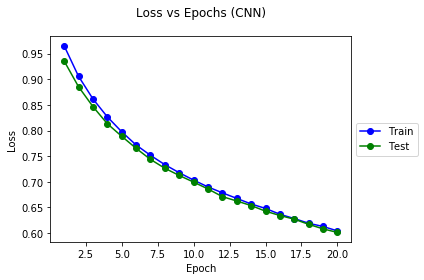

In [16]:
cnn_model = SimpleConvNetwork(in_channels=1, 
                          num_classes=n_classes, 
                          widen_factor=2, 
                          kernel_size=1,
                          stride=1)

grouped_parameters = [
        {'params': [p for n, p in cnn_model.named_parameters() if not any(
            nd in n for nd in no_decay)], 'weight_decay': wdecay},
        {'params': [p for n, p in cnn_model.named_parameters() if any(
            nd in n for nd in no_decay)], 'weight_decay': 0.0}
]

# opt_supervised = optim.SGD(grouped_parameters, lr=lr,
#                           momentum=0.9, nesterov=nesterov)

opt_supervised = torch.optim.SGD(cnn_model.parameters(), lr = 0.00001)

cnn_train_loss_list, cnn_test_loss_list = train_supervised(cnn_model, train_loader, test_loader, opt_supervised, loss_func, epochs=epochs)

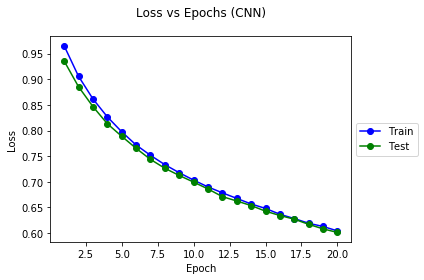

In [17]:
plot_multi_curves(epoch_list, [cnn_train_loss_list, cnn_test_loss_list], 'Epoch', 'Loss', ['Train', 'Test'], 'Loss vs Epochs (CNN)')

In [18]:
print(supervised_test_loss_list)
print(cnn_test_loss_list)

[array(0.3084369, dtype=float32), array(0.25000784, dtype=float32), array(0.21600924, dtype=float32), array(0.18463324, dtype=float32), array(0.16017896, dtype=float32), array(0.12746204, dtype=float32), array(0.10766523, dtype=float32), array(0.09646035, dtype=float32), array(0.08921027, dtype=float32), array(0.07969158, dtype=float32), array(0.07387228, dtype=float32), array(0.06957489, dtype=float32), array(0.06513364, dtype=float32), array(0.06386577, dtype=float32), array(0.05976546, dtype=float32), array(0.0569561, dtype=float32), array(0.05464508, dtype=float32), array(0.05333235, dtype=float32), array(0.0509966, dtype=float32), array(0.04981865, dtype=float32)]
[array(0.93569106, dtype=float32), array(0.88553536, dtype=float32), array(0.84680253, dtype=float32), array(0.81339854, dtype=float32), array(0.78892785, dtype=float32), array(0.76543266, dtype=float32), array(0.743803, dtype=float32), array(0.72650903, dtype=float32), array(0.7124566, dtype=float32), array(0.69949543, 